In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import gvar as gv

In [2]:
import h5py
import lsqfit

In [3]:
# Constants

#Physical constants
hbarc = 197.3 # MeV fm
#a = 0.12

# Pion mass
mpi = 0.1885

# Plot constants
t_min_plt = 1
t_max_plt = 25

In [4]:
def En(n, p):
    En = p['E0']
    for i in range(n):
        En += p['dE{}'.format(i)]
        
    #print(En)    
    return En

In [5]:
# Get the data
file = h5py.File("a12m310_a_avg.h5", "r")
# First, work to replicate Jinchen's results
data_proton_dn = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_dn'])
data_proton_up = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_up'])
data_np_proton_dn = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_dn'])
data_np_proton_up = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_up'])



In [6]:
num_zs = 1 #Order number of the n's
# Log E: log of the energy.  
# P is point (in the context of )

# Define the 2-point fit function, for P-S and P-P
def C_2pt(t, p):
    
    z = np.array([])
    ztilde = np.array([])
    E = np.array([])
    for i in range(num_zs):
        z = np.append(z, p['Z{}'.format(i)])
        ztilde = np.append(ztilde, p['Ztilde{}'.format(i)])
        E = np.append(E, En(i, p))
        
    
    sum_pp = sum([z[i]*z[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    sum_ps = sum([z[i]*ztilde[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    
    return np.transpose(np.array([[sum_pp], [sum_ps]]), axes=[2,0,1])



In [7]:
# Set up the data set, average over the spin up, spin down, negative and positive parity proton, over all 1054 points
protons = (data_proton_dn + data_proton_up + data_np_proton_dn + data_np_proton_up)/4.
proton_timeavg = gv.dataset.avg_data(protons)


/Users/ivan/miniconda3/envs/thesis2020/lib/python3.8/site-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


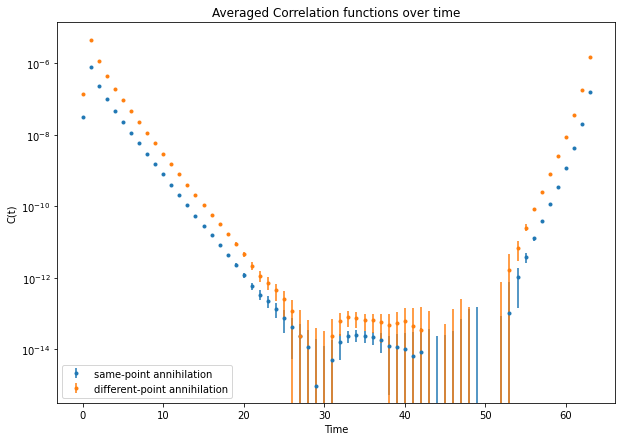

In [8]:
# Plot Correlation functions
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(len(proton_timeavg))], [proton_timeavg[i][0][0].mean for i in range(len(proton_timeavg))], yerr=[proton_timeavg[i][0][0].sdev for i in range(len(proton_timeavg))], fmt='.', label="same-point annihilation")
ax.errorbar([i for i in range(len(proton_timeavg))], [proton_timeavg[i][1][0].mean for i in range(len(proton_timeavg))], yerr=[proton_timeavg[i][1][0].sdev for i in range(len(proton_timeavg))], fmt='.', label="different-point annihilation")

plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time")
plt.legend()
plt.show()

In [9]:
tau = 1
# Effective mass data (same annihilation, different annihilation)
eff_mass = [[np.log(proton_timeavg[t][0][0]/proton_timeavg[t+tau][0][0])/tau for t in range(len(proton_timeavg)-tau)],\
            [np.log(proton_timeavg[t][1][0]/proton_timeavg[t+tau][1][0])/tau for t in range(len(proton_timeavg)-tau)]]
log_eff_mass = np.log(eff_mass)

<ipython-input-9-0aa53cc0f47d>:3: RuntimeWarning: invalid value encountered in log
  eff_mass = [[np.log(proton_timeavg[t][0][0]/proton_timeavg[t+tau][0][0])/tau for t in range(len(proton_timeavg)-tau)],\
<ipython-input-9-0aa53cc0f47d>:4: RuntimeWarning: invalid value encountered in log
  [np.log(proton_timeavg[t][1][0]/proton_timeavg[t+tau][1][0])/tau for t in range(len(proton_timeavg)-tau)]]
<ipython-input-9-0aa53cc0f47d>:5: RuntimeWarning: invalid value encountered in log
  log_eff_mass = np.log(eff_mass)


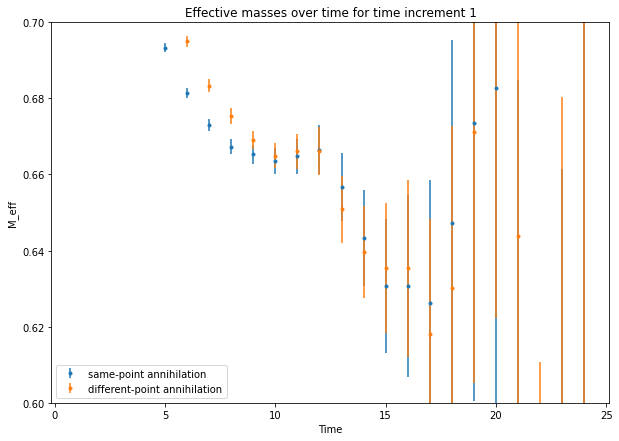

In [42]:
# Plot the effective masses
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([eff_mass[0][i].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([eff_mass[0][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="same-point annihilation")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([eff_mass[1][i].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([eff_mass[1][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="different-point annihilation")

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.7)
#plt.yticks(np.arange(0.6,0.8, 0.02))
plt.title("Effective masses over time for time increment {}".format(tau))
plt.legend()
plt.show()


<ipython-input-11-c4ea0d24c56e>:2: RuntimeWarning: invalid value encountered in sqrt
  zS_eff = np.array([np.sqrt(np.exp(eff_mass[0][t]*t)*proton_timeavg[t][0][0]) for t in range(len(proton_timeavg)-tau)])
No handles with labels found to put in legend.


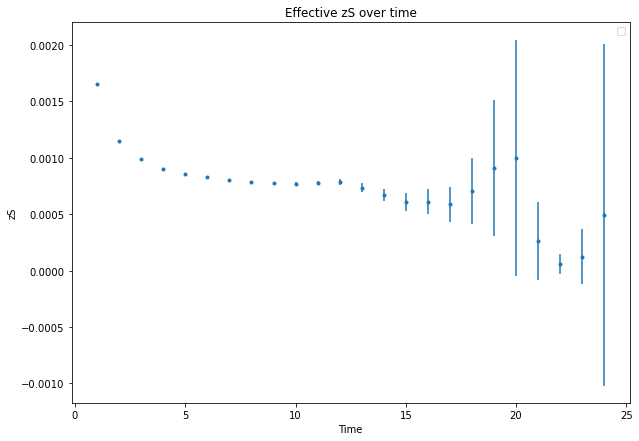

In [11]:
# Plot effective zSS
zS_eff = np.array([np.sqrt(np.exp(eff_mass[0][t]*t)*proton_timeavg[t][0][0]) for t in range(len(proton_timeavg)-tau)])


fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.')

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.legend()
plt.show()

No handles with labels found to put in legend.


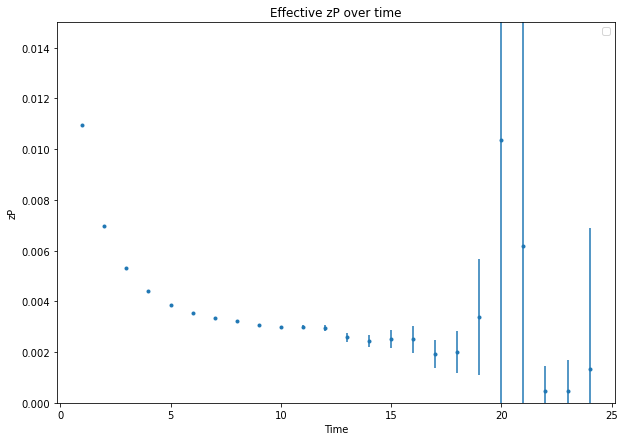

In [12]:
zP_eff = np.array([np.exp(eff_mass[1][t]*t)*proton_timeavg[t][1][0]/zS_eff[t] for t in range(len(proton_timeavg)-tau)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.')

plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.ylim(0, 0.015)
plt.legend()
plt.show()

In [13]:
# Make an order-of magnitude estimate of the priors
p=gv.BufferDict()
p['E0'] = gv.gvar(0.67, 0.02)
p['Z0'] = gv.gvar(0.0008, 0.0003)
p['Ztilde0'] = gv.gvar(0.003, 0.003)

#proton_timeavg[10]

#z_ests = np.array([np.sqrt(proton_timeavg[9][0][0]*np.exp(eff_mass[0][9]*9)), \
#                   np.sqrt(proton_timeavg[10][0][0]*np.exp(eff_mass[0][10]*10)), \
#                   np.sqrt(proton_timeavg[11][0][0]*np.exp(eff_mass[0][11]*11)), \
#                   np.sqrt(proton_timeavg[12][0][0]*np.exp(eff_mass[0][12]*12))])
#ztilde_ests = np.array([proton_timeavg[9+i][1][0]*np.exp(eff_mass[0][9+i]*(9+i))/z_ests[i] for i in range(len(z_ests))])

#print("Z0 estimates (t = 9-12): ", z_ests[0], " ", z_ests[1], " ", z_ests[2], " ", z_ests[3])
     
#print("Z0tilde estimates (t = 9-12): ", ztilde_ests[0], " ", ztilde_ests[1], " ", ztilde_ests[2], \
#      " ", ztilde_ests[3])
np.shape(np.array([proton_timeavg[i] for i in range(2, 22)]) )

(20, 2, 1)

In [14]:
# First-order fit for tsep = 8 to 12 (approximately linear region)
num_zs = 1
fit1 = lsqfit.nonlinear_fit(data=(np.array([i for i in range(10, 21)]), np.array([proton_timeavg[i] for i in range(10, 21)])), prior=p,fcn=C_2pt,debug=True)
print(fit1.format(pstyle='vv'))
test = fit1.logGBF
testE = fit1.p['E0']
print("Testval: ", test)
print("Testparam: ", testE)
fit1.chi2/fit1.dof

Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 587.95

Parameters:
             E0      0.664756 +- 0.00302689            [     0.67 +- 0.02 ]  
             Z0   0.000775279 +- 1.0619e-05            [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00294875 +- 4.2447e-05            [   0.003 +- 0.003 ]  

Settings:
  svdcut/n = 1e-12/0    tol = (1e-08,1e-10,1e-10*)    (itns/time = 5/0.0)
  fitter = scipy_least_squares    method = trf

Testval:  587.945202366018
Testparam:  0.6648(30)


0.9601358863659503

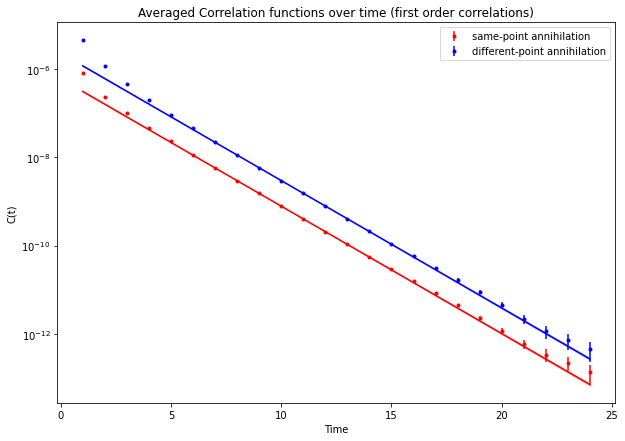

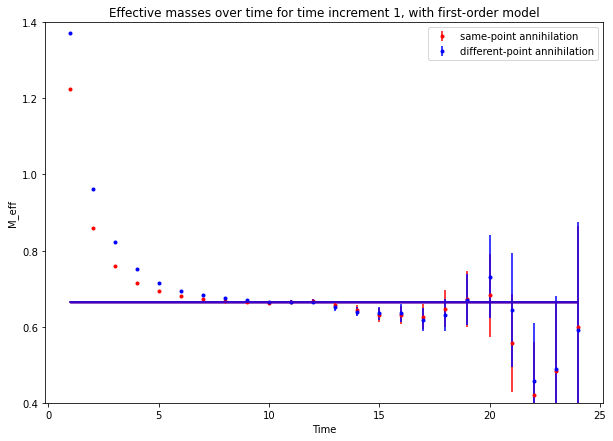

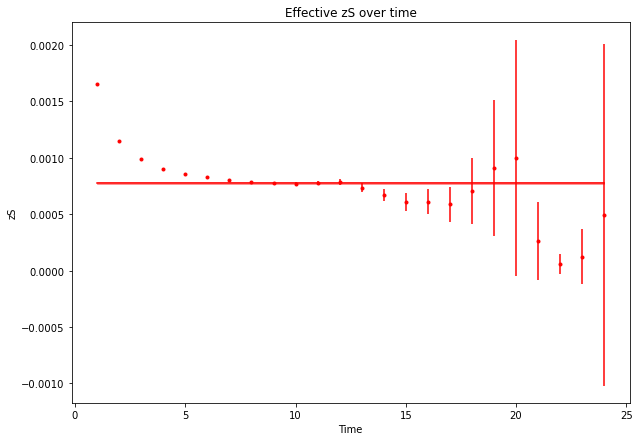

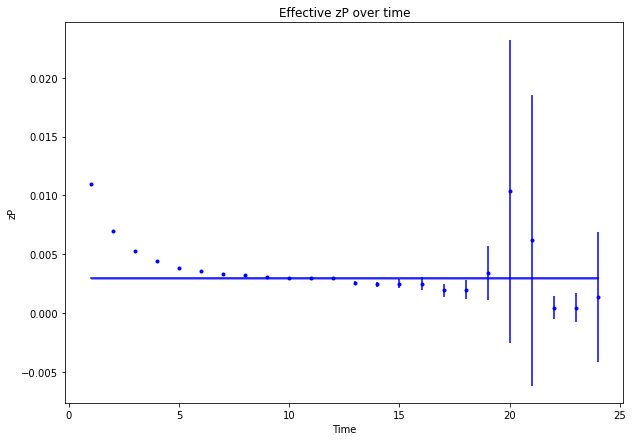

In [15]:
# Plot the first-order fit
y_sample1 = C_2pt(np.array([i for i in range(0,26)]), fit1.p)
model_eff_mass1 = np.array([np.log(y_sample1[i]/y_sample1[i+1]) for i in range(0,25)])

# Plot Correlation function and effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][0][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][1][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample1[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample1[i][0][0].mean + y_sample1[i][0][0].sdev for i in range(1,25)], [y_sample1[i][0][0].mean - y_sample1[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample1[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample1[i][1][0].mean + y_sample1[i][1][0].sdev for i in range(1,25)], [y_sample1[i][1][0].mean - y_sample1[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time (first order correlations)")
plt.legend()
plt.show()


# Plot effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([eff_mass[0][i].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([eff_mass[0][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([eff_mass[1][i].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([eff_mass[1][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass1[i][0][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass1[i][0][0].mean + model_eff_mass1[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass1[i][0][0].mean - model_eff_mass1[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass1[i][1][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass1[i][1][0].mean + model_eff_mass1[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass1[i][1][0].mean - model_eff_mass1[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.4, 1.4)
plt.title("Effective masses over time for time increment {}, with first-order model".format(tau))
plt.legend()
plt.show()

# Plot effective zSS
model_zS_eff1 = np.array([np.sqrt(np.exp(model_eff_mass1[t][0][0]*t)*y_sample1[t][0][0]) for t in range(0, 25)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff1[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff1[i].mean + model_zS_eff1[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zS_eff1[i].mean - model_zS_eff1[i].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff1 = np.array([np.exp(model_eff_mass1[t][1][0]*t)*y_sample1[t][1][0]/model_zS_eff1[t] for t in range(0, 25)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff1[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff1[i].mean + model_zP_eff1[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zP_eff1[i].mean - model_zP_eff1[i].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

In [16]:
# Higher-order fit: plan: the priors on the excited states will be log-normal distributions, starting with a 
# 2-pion splitting (first noninteracting excited state) with a sigma that b is set to
# That's for the first excited state. For subsequent states, the gap between the nth and the (n-1)th excited
# state will be 2*mpi/n^a, where a is the other parameter

# For escited states, the z and the z-tilde will be given an agnostic, flat prior centered at zero with 
# a standard deviation of 2 or whatever other value that is orders of magnitude higher than the actual value

# This will essentially be an optimization problem of a and b: which values will obtain the highest logGBF
# fit 

num_fitsamples = np.arange(1,12,1)
a = np.linspace(0,2,11)
a_select_indices = np.array([0, 5, 10])
b = np.linspace(0.3,1.3,6)

len(num_fitsamples)
print(b)

[0.3 0.5 0.7 0.9 1.1 1.3]


#### The optimization must fulfill the following criteria:
- Maximize LogGBF
- Maximize precision on the lowest-energy state
- Not trigger an unexpected shift in lowest-order energy
- Not overfit noise


In [17]:
print(a[2])

np.power(9, a[0])

0.4


1.0

In [18]:
# Find up to 9 excited priors for each pair of a,b

# Initialize the principal values of the excited energy-priors
dE0 = 2*mpi
energyvals = np.array([[None]*(len(num_fitsamples) + 1)]*len(a))
dEvals = np.array([[None]*len(num_fitsamples)]*len(a))



for i in range(len(a)):
    energyvals[i][0] = p['E0'].mean
    for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        dEvals[i][k-1] = dE0/np.power(k, a[i])
        energyvals[i][k] = energyvals[i][k-1] + dEvals[i][k-1]
        
#print("dE = ", dEvals)   
#print("dE vals for a = 0: ", dEvals[0])
#print("E vals for a = 0: ", energyvals[0])

#print("dE vals for a = 1: ", dEvals[5])
#print("E vals for a = 1: ", energyvals[5])

#print("dE vals for a = 2: ", dEvals[10])
#print("E vals for a = 2: ", energyvals[10])

priors = []
p_adj = gv.BufferDict()
for i in range(len(a)):
    priors.append([])
    
    for j in range(len(b)):
        #print("i = ", i, " j = ", j)
        priors[i].append(gv.BufferDict())
        
        priors[i][j]['E0'] = p['E0']
        priors[i][j]['Z0'] = p['Z0']
        priors[i][j]['Ztilde0'] = p['Ztilde0']
        
        for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
            #print(priors[i][j])
            #print("k = ", k)
            #print("Current last energy: ", priors[i][j]['E{}'.format(k-1)])
            #print("Change in energy: ", dE)
            err_ratio = energyvals[i][k]/(energyvals[i][k] - (b[j] * dEvals[i][k-1]) )
            #print("k = ", k)
            
            priors[i][j]['Z{}'.format(k)] = gv.gvar(0.0008, 0.0004)
            priors[i][j]['Ztilde{}'.format(k)] = gv.gvar(0, 0.005)
            priors[i][j]['log(dE{})'.format(k-1)] = gv.gvar(np.log(dEvals[i][k-1]), b[j])
    #print(priors[i])
        

In [19]:
print(priors[0][2]['E0'] + priors[0][2]['dE0']) 
print(priors[0][1]['dE0'])
priors

1.05(26)
0.38(19)


[[BufferDict([('E0', 0.670(20)), ('Z0', 0.00080(30)), ('Ztilde0', 0.0030(30)), ('Z1', 0.00080(40)), ('Ztilde1', 0.0000(50)), ('log(dE0)', -0.98(30)), ('Z2', 0.00080(40)), ('Ztilde2', 0.0000(50)), ('log(dE1)', -0.98(30)), ('Z3', 0.00080(40)), ('Ztilde3', 0.0000(50)), ('log(dE2)', -0.98(30)), ('Z4', 0.00080(40)), ('Ztilde4', 0.0000(50)), ('log(dE3)', -0.98(30)), ('Z5', 0.00080(40)), ('Ztilde5', 0.0000(50)), ('log(dE4)', -0.98(30)), ('Z6', 0.00080(40)), ('Ztilde6', 0.0000(50)), ('log(dE5)', -0.98(30)), ('Z7', 0.00080(40)), ('Ztilde7', 0.0000(50)), ('log(dE6)', -0.98(30)), ('Z8', 0.00080(40)), ('Ztilde8', 0.0000(50)), ('log(dE7)', -0.98(30)), ('Z9', 0.00080(40)), ('Ztilde9', 0.0000(50)), ('log(dE8)', -0.98(30)), ('Z10', 0.00080(40)), ('Ztilde10', 0.0000(50)), ('log(dE9)', -0.98(30)), ('Z11', 0.00080(40)), ('Ztilde11', 0.0000(50)), ('log(dE10)', -0.98(30))]),
  BufferDict([('E0', 0.670(20)), ('Z0', 0.00080(30)), ('Ztilde0', 0.0030(30)), ('Z1', 0.00080(40)), ('Ztilde1', 0.0000(50)), ('log(dE

In [66]:
num_zs = 9
aa = 5
bb = 3
fit_check = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, 22)]), np.array([proton_timeavg[l] for l in range(2,22)])), prior=priors[aa][bb],fcn=C_2pt,debug=True)
print("a = ", a[aa], "; b = ", b[bb])
print("Q= ", fit_check.Q)
print(fit_check.format(pstyle='vv'))

a =  1.0 ; b =  0.9000000000000001
Q=  0.3329894621694947
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 990.16

Parameters:
             E0        0.660194 +- 0.0029214             [           0.67 +- 0.02 ]  
             Z0   0.000753503 +- 1.10122e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284904 +- 4.92251e-05             [         0.003 +- 0.003 ]  
             Z1   0.000680775 +- 6.78911e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00447161 +- 0.000652401             [             0 +- 0.005 ]  
       log(dE0)         -0.812677 +- 0.12207             [        -0.97551 +- 0.9 ]  
             Z2   0.000499866 +- 0.000349203             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00470343 +- 0.00292349             [             0 +- 0.005 ]  
       log(dE1)        -0.605177 +- 0.384309             [        -1.66866 +- 0.9 ]  *
             Z3   0.000483423 +- 0.000367467             [       0.0008 +- 0.

In [21]:
# Log GBF value list
list_LogGBF = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))

#Q-value
list_Q = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))

# E0 result list 
list_E0 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))


In [82]:
#Do the fit

i = 0
while i < len(a):
    j = 0
    while j < len(b):
        #print("Current LogGBF list: ", list_LogGBF)
        k = np.min(num_fitsamples)
        while k < np.max(num_fitsamples)+1:
            num_zs = k + 1
            fit = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, 22)]), np.array([proton_timeavg[l] for l in range(2,22)])), prior=priors[i][j],fcn=C_2pt,debug=True)
            list_LogGBF[i][j][k-1] = fit.logGBF
            list_Q[i][j][k-1] = fit.Q
            list_E0[i][j][k-1] = fit.p['E0']
            print("Fit for a = ", a[i], ", b = ", b[j], ", ", k, " excited states: ")
            print("LogGBF: ", fit.logGBF)
            print("Q: ", fit.Q)
            print(fit.format(pstyle='vv'))
            
            k += 1
            
        j += 1
        
    i += 1
        

Fit for a =  0.0 , b =  0.3 ,  1  excited states: 
LogGBF:  746.5107147449512
Q:  5.450118091513815e-91
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 5.5e-91    logGBF = 746.51

Parameters:
             E0       0.667411 +- 0.00107212             [     0.67 +- 0.02 ]  
             Z0   0.000785098 +- 2.50338e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303492 +- 1.2079e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125263 +- 3.72373e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917145 +- 4.21995e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128577 +- 0.00669193             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             Z3             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  


Fit for a =  0.0 , b =  0.3 ,  4  excited states: 
LogGBF:  993.746359040403
Q:  0.5277117069810907
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 993.75

Parameters:
             E0       0.659388 +- 0.00357027             [     0.67 +- 0.02 ]  
             Z0   0.000749261 +- 1.45967e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282903 +- 6.31558e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595832 +- 9.08545e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00371438 +- 0.000854763             [       0 +- 0.005 ]  
       log(dE0)         -0.939344 +- 0.18561             [  -0.97551 +- 0.3 ]  
             Z2   0.000573684 +- 0.000240453             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522967 +- 0.00179435             [       0 +- 0.005 ]  *
       log(dE1)        -0.858443 +- 0.265447             [  -0.97551 +- 0.3 ]  
             Z3    0.000780396 +- 0.00029573             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  0.3 ,  6  excited states: 
LogGBF:  993.7076826408965
Q:  0.5492797344628317
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 993.71

Parameters:
             E0       0.659329 +- 0.00375343             [     0.67 +- 0.02 ]  
             Z0   0.000748673 +- 1.57617e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282546 +- 6.75336e-05             [   0.003 +- 0.003 ]  
             Z1   0.000545796 +- 0.000113725             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00337091 +- 0.000983003             [       0 +- 0.005 ]  
       log(dE0)          -1.0027 +- 0.228885             [  -0.97551 +- 0.3 ]  
             Z2    0.00061283 +- 0.000216347             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00507186 +- 0.00166305             [       0 +- 0.005 ]  *
       log(dE1)        -0.937569 +- 0.276291             [  -0.97551 +- 0.3 ]  
             Z3   0.000699868 +- 0.000295258             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  0.3 ,  8  excited states: 
LogGBF:  993.2735128298301
Q:  0.5035509127964858
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 993.27

Parameters:
             E0       0.659714 +- 0.00361582             [     0.67 +- 0.02 ]  
             Z0   0.000750428 +- 1.49799e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283242 +- 6.44605e-05             [   0.003 +- 0.003 ]  
             Z1   0.000539815 +- 0.000119393             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340848 +- 0.00100684             [       0 +- 0.005 ]  
       log(dE0)          -0.991878 +- 0.2267             [  -0.97551 +- 0.3 ]  
             Z2   0.000638505 +- 0.000207958             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0049903 +- 0.00165843             [       0 +- 0.005 ]  
       log(dE1)        -0.937301 +- 0.278357             [  -0.97551 +- 0.3 ]  
             Z3     0.0006998 +- 0.000290853             [ 0.0008 +- 0.0004 ]  
        Z

Fit for a =  0.0 , b =  0.3 ,  10  excited states: 
LogGBF:  993.0889049307413
Q:  0.4813575071089208
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 993.09

Parameters:
             E0       0.659919 +- 0.00352911             [     0.67 +- 0.02 ]  
             Z0   0.000751397 +- 1.44777e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283646 +- 6.24906e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542096 +- 0.000120082             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346586 +- 0.00100852             [       0 +- 0.005 ]  
       log(dE0)         -0.978908 +- 0.22107             [  -0.97551 +- 0.3 ]  
             Z2    0.000651903 +- 0.00020367             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00497892 +- 0.00166698             [       0 +- 0.005 ]  
       log(dE1)        -0.928418 +- 0.278631             [  -0.97551 +- 0.3 ]  
             Z3    0.000700644 +- 0.00029027             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  0.5 ,  3  excited states: 
LogGBF:  992.6552390127541
Q:  0.46424919214967114
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 992.66

Parameters:
             E0       0.660565 +- 0.00277601             [     0.67 +- 0.02 ]  
             Z0   0.000754893 +- 1.02576e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285427 +- 4.61366e-05             [   0.003 +- 0.003 ]  
             Z1    0.000673665 +- 6.3924e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00448083 +- 0.000569607             [       0 +- 0.005 ]  
       log(dE0)         -0.812201 +- 0.11185             [  -0.97551 +- 0.5 ]  
             Z2   0.000736572 +- 0.000286765             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00590998 +- 0.00211112             [       0 +- 0.005 ]  *
       log(dE1)         -0.47985 +- 0.261881             [  -0.97551 +- 0.5 ]  
             Z3      0.001182 +- 0.000158217             [ 0.0008 +- 0.0004 ]  
        Z

Fit for a =  0.0 , b =  0.5 ,  6  excited states: 
LogGBF:  993.1769500468816
Q:  0.5509218133665255
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 993.18

Parameters:
             E0       0.659132 +- 0.00416482             [     0.67 +- 0.02 ]  
             Z0   0.000747724 +- 1.82529e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282115 +- 7.92058e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544203 +- 0.000145005             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00333846 +- 0.00128125             [       0 +- 0.005 ]  
       log(dE0)         -1.01579 +- 0.302577             [  -0.97551 +- 0.5 ]  
             Z2    0.000632037 +- 0.00024598             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00527305 +- 0.00197448             [       0 +- 0.005 ]  *
       log(dE1)        -0.900492 +- 0.403798             [  -0.97551 +- 0.5 ]  
             Z3   0.000698713 +- 0.000307042             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  0.5 ,  8  excited states: 
LogGBF:  992.7767219730748
Q:  0.505052919042656
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.78

Parameters:
             E0       0.659603 +- 0.00391177             [     0.67 +- 0.02 ]  
             Z0   0.000749912 +- 1.67779e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283004 +- 7.33466e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542706 +- 0.000150926             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00341693 +- 0.0012904             [       0 +- 0.005 ]  
       log(dE0)        -0.995418 +- 0.289667             [  -0.97551 +- 0.5 ]  
             Z2   0.000657936 +- 0.000238515             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517845 +- 0.00200887             [       0 +- 0.005 ]  *
       log(dE1)        -0.894341 +- 0.410942             [  -0.97551 +- 0.5 ]  
             Z3   0.000700445 +- 0.000301284             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  0.5 ,  10  excited states: 
LogGBF:  992.6227103451696
Q:  0.4854616042685944
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.62

Parameters:
             E0       0.659873 +- 0.00373205             [     0.67 +- 0.02 ]  
             Z0   0.000751218 +- 1.56995e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283565 +- 6.89435e-05             [   0.003 +- 0.003 ]  
             Z1   0.000550922 +- 0.000148201             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352548 +- 0.00125085             [       0 +- 0.005 ]  
       log(dE0)        -0.972035 +- 0.268962             [  -0.97551 +- 0.5 ]  
             Z2   0.000676095 +- 0.000234424             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517911 +- 0.00203439             [       0 +- 0.005 ]  *
       log(dE1)        -0.872349 +- 0.410495             [  -0.97551 +- 0.5 ]  
             Z3   0.000707369 +- 0.000300132             [ 0.0008 +- 0.0004 ]  
      

Fit for a =  0.0 , b =  0.7 ,  4  excited states: 
LogGBF:  992.7838796393308
Q:  0.553605249685787
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 992.78

Parameters:
             E0       0.659644 +- 0.00353007             [     0.67 +- 0.02 ]  
             Z0   0.000750535 +- 1.44881e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283421 +- 6.43542e-05             [   0.003 +- 0.003 ]  
             Z1    0.000607204 +- 0.00012998             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00386741 +- 0.00113536             [       0 +- 0.005 ]  
       log(dE0)         -0.915337 +- 0.22514             [  -0.97551 +- 0.7 ]  
             Z2   0.000674941 +- 0.000290877             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00563302 +- 0.0020889             [       0 +- 0.005 ]  *
       log(dE1)        -0.731893 +- 0.448315             [  -0.97551 +- 0.7 ]  
             Z3   0.000865481 +- 0.000285843             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  0.7 ,  6  excited states: 
LogGBF:  992.647549691132
Q:  0.5521848914680432
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 992.65

Parameters:
             E0       0.659034 +- 0.00436741             [     0.67 +- 0.02 ]  
             Z0   0.000747261 +- 1.95113e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281904 +- 8.51798e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544521 +- 0.000169443             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00333214 +- 0.00148469             [       0 +- 0.005 ]  
       log(dE0)         -1.02079 +- 0.347914             [  -0.97551 +- 0.7 ]  
             Z2   0.000645444 +- 0.000269712             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00539704 +- 0.00218088             [       0 +- 0.005 ]  *
       log(dE1)        -0.876532 +- 0.485953             [  -0.97551 +- 0.7 ]  
             Z3   0.000697131 +- 0.000316585             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  0.7 ,  8  excited states: 
LogGBF:  992.270233746863
Q:  0.5065969688935912
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.27

Parameters:
             E0       0.659585 +- 0.00398709             [     0.67 +- 0.02 ]  
             Z0   0.000749856 +- 1.72531e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282975 +- 7.60493e-05             [   0.003 +- 0.003 ]  
             Z1   0.000548328 +- 0.000172582             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345824 +- 0.00145248             [       0 +- 0.005 ]  
       log(dE0)        -0.990098 +- 0.317768             [  -0.97551 +- 0.7 ]  
             Z2   0.000673925 +- 0.000265634             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530859 +- 0.00225507             [       0 +- 0.005 ]  *
       log(dE1)        -0.859484 +- 0.497513             [  -0.97551 +- 0.7 ]  
             Z3   0.000703565 +- 0.000310482             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  0.7 ,  10  excited states: 
LogGBF:  992.140033510765
Q:  0.4903997208975672
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.14

Parameters:
             E0          0.6599 +- 0.0037193             [     0.67 +- 0.02 ]  
             Z0   0.000751404 +- 1.56302e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283654 +- 6.92414e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562285 +- 0.000164261             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00361369 +- 0.00135411             [       0 +- 0.005 ]  
       log(dE0)        -0.957781 +- 0.280279             [  -0.97551 +- 0.7 ]  
             Z2   0.000697334 +- 0.000262641             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532961 +- 0.00229627             [       0 +- 0.005 ]  *
       log(dE1)        -0.823494 +- 0.492293             [  -0.97551 +- 0.7 ]  
             Z3   0.000719202 +- 0.000309057             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  992.1418989942935
Q:  0.513795343171481
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.14

Parameters:
             E0       0.660712 +- 0.00260599             [     0.67 +- 0.02 ]  
             Z0   0.000755701 +- 9.40553e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285851 +- 4.26345e-05             [   0.003 +- 0.003 ]  
             Z1   0.000693692 +- 6.25698e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00464945 +- 0.000538646             [       0 +- 0.005 ]  
       log(dE0)        -0.785189 +- 0.102494             [  -0.97551 +- 0.9 ]  
             Z2    0.000891039 +- 0.00027194             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00706905 +- 0.00209003             [       0 +- 0.005 ]  *
       log(dE1)        -0.329389 +- 0.226047             [  -0.97551 +- 0.9 ]  
             Z3    0.00106725 +- 0.000223671             [ 0.0008 +- 0.00

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  992.3133667197238
Q:  0.5690517769108734
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 992.31

Parameters:
             E0        0.659087 +- 0.0042425             [     0.67 +- 0.02 ]  
             Z0   0.000747685 +- 1.87437e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282123 +- 8.24006e-05             [   0.003 +- 0.003 ]  
             Z1   0.000564116 +- 0.000177044             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347923 +- 0.00154504             [       0 +- 0.005 ]  
       log(dE0)        -0.991753 +- 0.339302             [  -0.97551 +- 0.9 ]  
             Z2    0.000665627 +- 0.00028793             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560472 +- 0.00220073             [       0 +- 0.005 ]  *
       log(dE1)        -0.823035 +- 0.527084             [  -0.97551 +- 0.9 ]  
             Z3   0.000745121 +- 0.000314887             [ 0.0008 +- 0.0

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  991.9346992137763
Q:  0.5276042886772373
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.93

Parameters:
             E0       0.659226 +- 0.00432242             [     0.67 +- 0.02 ]  
             Z0   0.000748129 +- 1.93206e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282237 +- 8.50137e-05             [   0.003 +- 0.003 ]  
             Z1   0.000541908 +- 0.000192796             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00335282 +- 0.0016389             [       0 +- 0.005 ]  
       log(dE0)         -1.01608 +- 0.372772             [  -0.97551 +- 0.9 ]  
             Z2    0.00066184 +- 0.000286646             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00538398 +- 0.00237738             [       0 +- 0.005 ]  *
       log(dE1)        -0.866172 +- 0.552727             [  -0.97551 +- 0.9 ]  
             Z3   0.000691231 +- 0.000321715             [ 0.0008 +- 0.0

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  991.7101314049629
Q:  0.49947318285747133
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.71

Parameters:
             E0       0.659847 +- 0.00374002             [     0.67 +- 0.02 ]  
             Z0   0.000751187 +- 1.57728e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283567 +- 7.01431e-05             [   0.003 +- 0.003 ]  
             Z1   0.000566846 +- 0.000177382             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00363753 +- 0.00144441             [       0 +- 0.005 ]  
       log(dE0)         -0.95508 +- 0.294126             [  -0.97551 +- 0.9 ]  
             Z2   0.000704549 +- 0.000284494             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00542062 +- 0.0024548             [       0 +- 0.005 ]  *
       log(dE1)        -0.801833 +- 0.545284             [  -0.97551 +- 0.9 ]  
             Z3    0.000725609 +- 0.00031665             [ 0.0008 +- 0.0

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  991.6562537159147
Q:  0.4940456665200268
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 991.66

Parameters:
             E0       0.659964 +- 0.00362977             [     0.67 +- 0.02 ]  
             Z0   0.000751767 +- 1.51055e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283828 +- 6.72716e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573869 +- 0.000171662             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00370793 +- 0.00138511             [       0 +- 0.005 ]  
       log(dE0)        -0.941252 +- 0.276199             [  -0.97551 +- 0.9 ]  
             Z2   0.000714724 +- 0.000283494             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543702 +- 0.00247601             [       0 +- 0.005 ]  *
       log(dE1)        -0.783556 +- 0.538527             [  -0.97551 +- 0.9 ]  
             Z3   0.000734661 +- 0.000316383             [ 0.0008 +- 0.

Fit for a =  0.0 , b =  1.1 ,  4  excited states: 
LogGBF:  991.8693534725011
Q:  0.5627815082520642
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 991.87

Parameters:
             E0       0.659755 +- 0.00343426             [     0.67 +- 0.02 ]  
             Z0    0.00075106 +- 1.40508e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283638 +- 6.30961e-05             [   0.003 +- 0.003 ]  
             Z1    0.00060946 +- 0.000158566             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390948 +- 0.00131196             [       0 +- 0.005 ]  
       log(dE0)        -0.908044 +- 0.248724             [  -0.97551 +- 1.1 ]  
             Z2   0.000716797 +- 0.000307502             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00579729 +- 0.00221882             [       0 +- 0.005 ]  *
       log(dE1)        -0.696858 +- 0.525691             [  -0.97551 +- 1.1 ]  
             Z3   0.000886638 +- 0.000288455             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.1 ,  6  excited states: 
LogGBF:  991.6855654838813
Q:  0.5539172736490416
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 991.69

Parameters:
             E0       0.658953 +- 0.00454653             [     0.67 +- 0.02 ]  
             Z0   0.000746886 +- 2.06752e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281734 +- 9.07613e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544753 +- 0.000202718             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332761 +- 0.00174434             [       0 +- 0.005 ]  
       log(dE0)         -1.02457 +- 0.402052             [  -0.97551 +- 1.1 ]  
             Z2   0.000659775 +- 0.000295941             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00550951 +- 0.00238649             [       0 +- 0.005 ]  *
       log(dE1)        -0.856736 +- 0.578193             [  -0.97551 +- 1.1 ]  
             Z3   0.000693623 +- 0.000329132             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.1 ,  8  excited states: 
LogGBF:  991.3370927883747
Q:  0.5104116221500219
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.34

Parameters:
             E0       0.659702 +- 0.00385974             [     0.67 +- 0.02 ]  
             Z0     0.0007505 +- 1.65206e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283268 +- 7.35364e-05             [   0.003 +- 0.003 ]  
             Z1    0.000563697 +- 0.00019277             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00359019 +- 0.0015703             [       0 +- 0.005 ]  
       log(dE0)        -0.965785 +- 0.322269             [  -0.97551 +- 1.1 ]  
             Z2   0.000699942 +- 0.000300026             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00546543 +- 0.00253579             [       0 +- 0.005 ]  *
       log(dE1)         -0.80483 +- 0.588478             [  -0.97551 +- 1.1 ]  
             Z3   0.000722343 +- 0.000323031             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.1 ,  10  excited states: 
LogGBF:  991.2419319379513
Q:  0.5012914969696473
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.24

Parameters:
             E0       0.659953 +- 0.00360395             [     0.67 +- 0.02 ]  
             Z0    0.00075175 +- 1.49665e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283833 +- 6.68357e-05             [   0.003 +- 0.003 ]  
             Z1   0.000579499 +- 0.000179248             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00374534 +- 0.00143167             [       0 +- 0.005 ]  
       log(dE0)        -0.935144 +- 0.280181             [  -0.97551 +- 1.1 ]  
             Z2   0.000721776 +- 0.000298451             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0055093 +- 0.00257495             [       0 +- 0.005 ]  *
       log(dE1)         -0.76439 +- 0.571569             [  -0.97551 +- 1.1 ]  
             Z3   0.000745708 +- 0.000321972             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.3 ,  3  excited states: 
LogGBF:  991.5490646450477
Q:  0.5281469183596622
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.55

Parameters:
             E0        0.660737 +- 0.0025688             [     0.67 +- 0.02 ]  
             Z0   0.000755861 +- 9.22589e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285943 +- 4.19145e-05             [   0.003 +- 0.003 ]  
             Z1    0.00069872 +- 6.59053e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00468976 +- 0.000555501             [       0 +- 0.005 ]  
       log(dE0)        -0.778653 +- 0.103148             [  -0.97551 +- 1.3 ]  
             Z2    0.00092488 +- 0.000272432             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00733538 +- 0.00205695             [       0 +- 0.005 ]  *
       log(dE1)        -0.299031 +- 0.233662             [  -0.97551 +- 1.3 ]  
             Z3    0.00103506 +- 0.000238083             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.3 ,  5  excited states: 
LogGBF:  991.4330203044389
Q:  0.571513494160006
Least Square Fit:
  chi2/dof [dof] = 0.94 [40]    Q = 0.57    logGBF = 991.43

Parameters:
             E0        0.659106 +- 0.0042718             [     0.67 +- 0.02 ]  
             Z0    0.00074778 +- 1.90117e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282155 +- 8.40352e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562971 +- 0.000205435             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347989 +- 0.00174622             [       0 +- 0.005 ]  
       log(dE0)        -0.991882 +- 0.374698             [  -0.97551 +- 1.3 ]  
             Z2   0.000683759 +- 0.000299676             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.00566406 +- 0.002276             [       0 +- 0.005 ]  *
       log(dE1)        -0.813692 +- 0.595924             [  -0.97551 +- 1.3 ]  
             Z3   0.000752666 +- 0.000319335             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  1.3 ,  7  excited states: 
LogGBF:  991.0491921668053
Q:  0.5283779978089383
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.05

Parameters:
             E0         0.6592 +- 0.00438813             [     0.67 +- 0.02 ]  
             Z0   0.000748019 +- 1.97818e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282186 +- 8.74287e-05             [   0.003 +- 0.003 ]  
             Z1   0.000543728 +- 0.000216592             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00336446 +- 0.00181485             [       0 +- 0.005 ]  
       log(dE0)         -1.01524 +- 0.405274             [  -0.97551 +- 1.3 ]  
             Z2   0.000670012 +- 0.000308821             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054553 +- 0.00255092             [       0 +- 0.005 ]  *
       log(dE1)        -0.850764 +- 0.623435             [  -0.97551 +- 1.3 ]  
             Z3     0.000689217 +- 0.0003325             [ 0.0008 +- 0.0004 ]  
       

Fit for a =  0.0 , b =  1.3 ,  9  excited states: 
LogGBF:  990.864529642313
Q:  0.5090512310021377
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.86

Parameters:
             E0       0.659893 +- 0.00362708             [     0.67 +- 0.02 ]  
             Z0   0.000751496 +- 1.51201e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283733 +- 6.76196e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581354 +- 0.000188352             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00374701 +- 0.00150044             [       0 +- 0.005 ]  
       log(dE0)        -0.935417 +- 0.291138             [  -0.97551 +- 1.3 ]  
             Z2   0.000723077 +- 0.000308864             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00556499 +- 0.00261325             [       0 +- 0.005 ]  *
       log(dE1)        -0.758478 +- 0.601649             [  -0.97551 +- 1.3 ]  
             Z3   0.000754533 +- 0.000325104             [ 0.0008 +- 0.0004 ]  
        

Fit for a =  0.0 , b =  1.3 ,  11  excited states: 
LogGBF:  990.8291227782971
Q:  0.5067533358130752
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.83

Parameters:
             E0       0.659918 +- 0.00359914             [     0.67 +- 0.02 ]  
             Z0     0.000751623 +- 1.495e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283793 +- 6.68778e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583823 +- 0.000186258             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00376822 +- 0.00148212             [       0 +- 0.005 ]  
       log(dE0)         -0.93138 +- 0.285923             [  -0.97551 +- 1.3 ]  
             Z2   0.000726008 +- 0.000308812             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00558008 +- 0.00261144             [       0 +- 0.005 ]  *
       log(dE1)        -0.752127 +- 0.598174             [  -0.97551 +- 1.3 ]  
             Z3   0.000760167 +- 0.000324262             [ 0.0008 +- 0.0004 ]  
      


Fit for a =  0.2 , b =  0.3 ,  3  excited states: 
LogGBF:  991.4798792720836
Q:  0.282349692590461
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.28    logGBF = 991.48

Parameters:
             E0        0.660792 +- 0.0028054             [          0.67 +- 0.02 ]  
             Z0    0.00075563 +- 1.03847e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00285706 +- 4.62671e-05             [        0.003 +- 0.003 ]  
             Z1   0.000673487 +- 5.33432e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1    0.00449175 +- 0.000517001             [            0 +- 0.005 ]  
       log(dE0)        -0.811458 +- 0.103786             [       -0.97551 +- 0.3 ]  
             Z2   0.000490503 +- 0.000308718             [      0.0008 +- 0.0004 ]  
        Ztilde2       0.00421908 +- 0.002153             [            0 +- 0.005 ]  
       log(dE1)        -0.614451 +- 0.205822             [       -1.11414 +- 0.3 ]  *
             Z3    0.00126299 +- 9.84231e-0

Fit for a =  0.2 , b =  0.3 ,  5  excited states: 
LogGBF:  993.6080388872939
Q:  0.5208495690200126
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 993.61

Parameters:
             E0       0.659337 +- 0.00370486             [          0.67 +- 0.02 ]  
             Z0   0.000748956 +- 1.53421e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282804 +- 6.56151e-05             [        0.003 +- 0.003 ]  
             Z1   0.000582876 +- 0.000100602             [      0.0008 +- 0.0004 ]  
        Ztilde1    0.00358871 +- 0.000945081             [            0 +- 0.005 ]  
       log(dE0)        -0.954656 +- 0.201048             [       -0.97551 +- 0.3 ]  
             Z2    0.00051209 +- 0.000254618             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00481178 +- 0.00202784             [            0 +- 0.005 ]  
       log(dE1)        -0.987291 +- 0.274049             [       -1.11414 +- 0.3 ]  
             Z3   0.000598436 +- 0.00032273

Fit for a =  0.2 , b =  0.3 ,  7  excited states: 
LogGBF:  993.3075625992911
Q:  0.5174355413285961
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 993.31

Parameters:
             E0       0.659356 +- 0.00381014             [          0.67 +- 0.02 ]  
             Z0   0.000748825 +- 1.60348e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282654 +- 6.80569e-05             [        0.003 +- 0.003 ]  
             Z1   0.000539659 +- 0.000121422             [      0.0008 +- 0.0004 ]  
        Ztilde1      0.0033159 +- 0.00104509             [            0 +- 0.005 ]  
       log(dE0)         -1.00409 +- 0.233565             [       -0.97551 +- 0.3 ]  
             Z2   0.000543678 +- 0.000241449             [      0.0008 +- 0.0004 ]  
        Ztilde2      0.00452508 +- 0.0018759             [            0 +- 0.005 ]  
       log(dE1)         -1.06188 +- 0.283133             [       -1.11414 +- 0.3 ]  
             Z3   0.000590195 +- 0.00031321

Fit for a =  0.2 , b =  0.3 ,  9  excited states: 
LogGBF:  992.5953986979672
Q:  0.4524144123748299
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.45    logGBF = 992.6

Parameters:
             E0        0.659725 +- 0.0036987             [          0.67 +- 0.02 ]  
             Z0    0.00075048 +- 1.54157e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00283286 +- 6.56029e-05             [        0.003 +- 0.003 ]  
             Z1   0.000526164 +- 0.000130166             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00330847 +- 0.00108276             [            0 +- 0.005 ]  
       log(dE0)          -1.00262 +- 0.23694             [       -0.97551 +- 0.3 ]  
             Z2   0.000567822 +- 0.000235257             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00439765 +- 0.00186712             [            0 +- 0.005 ]  
       log(dE1)         -1.07166 +- 0.285162             [       -1.11414 +- 0.3 ]  
             Z3   0.000605986 +- 0.000305857   

Fit for a =  0.2 , b =  0.3 ,  11  excited states: 
LogGBF:  992.0490553314581
Q:  0.39709515789515554
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.4    logGBF = 992.05

Parameters:
             E0       0.660086 +- 0.00356193             [          0.67 +- 0.02 ]  
             Z0   0.000752169 +- 1.46284e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00283978 +- 6.25235e-05             [        0.003 +- 0.003 ]  
             Z1   0.000526312 +- 0.000133154             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00338847 +- 0.00110155             [            0 +- 0.005 ]  
       log(dE0)        -0.983867 +- 0.230852             [       -0.97551 +- 0.3 ]  
             Z2   0.000591068 +- 0.000228621             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00438539 +- 0.00188023             [            0 +- 0.005 ]  
       log(dE1)         -1.05886 +- 0.285244             [       -1.11414 +- 0.3 ]  
             Z3   0.000615467 +- 0.000303302 

Fit for a =  0.2 , b =  0.5 ,  3  excited states: 
LogGBF:  992.2321642449918
Q:  0.4155293666126732
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 992.23

Parameters:
             E0       0.660766 +- 0.00267225             [         0.67 +- 0.02 ]  
             Z0   0.000755785 +- 9.72178e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00285849 +- 4.37979e-05             [       0.003 +- 0.003 ]  
             Z1   0.000687781 +- 5.36183e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00460676 +- 0.000496995             [           0 +- 0.005 ]  
       log(dE0)       -0.792466 +- 0.0988527             [      -0.97551 +- 0.5 ]  
             Z2   0.000738572 +- 0.000291462             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00599159 +- 0.00223724             [           0 +- 0.005 ]  *
       log(dE1)        -0.405241 +- 0.213627             [      -1.11414 +- 0.5 ]  *
             Z3    0.00115682 +- 0.000174878         

Fit for a =  0.2 , b =  0.5 ,  6  excited states: 
LogGBF:  993.1079075471308
Q:  0.5418477496924805
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.54    logGBF = 993.11

Parameters:
             E0       0.659091 +- 0.00419529             [         0.67 +- 0.02 ]  
             Z0   0.000747666 +- 1.82976e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282174 +- 7.88188e-05             [       0.003 +- 0.003 ]  
             Z1   0.000555149 +- 0.000139169             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00338594 +- 0.00127484             [           0 +- 0.005 ]  
       log(dE0)        -0.999794 +- 0.289118             [      -0.97551 +- 0.5 ]  
             Z2   0.000573278 +- 0.000261666             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00501201 +- 0.00210584             [           0 +- 0.005 ]  *
       log(dE1)        -0.958918 +- 0.413644             [      -1.11414 +- 0.5 ]  
             Z3   0.000614623 +- 0.000327142       

Fit for a =  0.2 , b =  0.5 ,  8  excited states: 
LogGBF:  992.4944661681574
Q:  0.4885474668185886
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.49

Parameters:
             E0       0.659295 +- 0.00420714             [         0.67 +- 0.02 ]  
             Z0   0.000748431 +- 1.84904e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.00282412 +- 7.9657e-05             [       0.003 +- 0.003 ]  
             Z1   0.000527462 +- 0.000157813             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00324283 +- 0.00137485             [           0 +- 0.005 ]  
       log(dE0)         -1.02583 +- 0.319866             [      -0.97551 +- 0.5 ]  
             Z2   0.000580429 +- 0.000254684             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00471569 +- 0.0021227             [           0 +- 0.005 ]  
       log(dE1)         -1.01511 +- 0.428874             [      -1.11414 +- 0.5 ]  
             Z3   0.000606181 +- 0.000319236        

Fit for a =  0.2 , b =  0.5 ,  10  excited states: 
LogGBF:  991.8960470477465
Q:  0.4259888943941932
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.9

Parameters:
             E0       0.659792 +- 0.00393721             [         0.67 +- 0.02 ]  
             Z0   0.000750773 +- 1.68985e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00283371 +- 7.33778e-05             [       0.003 +- 0.003 ]  
             Z1   0.000528761 +- 0.000162532             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.00335152 +- 0.0013817             [           0 +- 0.005 ]  
       log(dE0)        -0.999472 +- 0.302767             [      -0.97551 +- 0.5 ]  
             Z2   0.000610208 +- 0.000247573             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00468156 +- 0.00215634             [           0 +- 0.005 ]  
       log(dE1)        -0.995789 +- 0.430269             [      -1.11414 +- 0.5 ]  
             Z3   0.000621895 +- 0.000312194           

Fit for a =  0.2 , b =  0.7 ,  3  excited states: 
LogGBF:  992.2675612307206
Q:  0.47179158705972535
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 992.27

Parameters:
             E0        0.660794 +- 0.0025839             [         0.67 +- 0.02 ]  
             Z0   0.000756035 +- 9.28688e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00286003 +- 4.20289e-05             [       0.003 +- 0.003 ]  
             Z1    0.000697848 +- 5.3506e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00468723 +- 0.000483758             [           0 +- 0.005 ]  
       log(dE0)       -0.779439 +- 0.0947142             [      -0.97551 +- 0.7 ]  
             Z2   0.000850285 +- 0.000274938             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00683328 +- 0.00218924             [           0 +- 0.005 ]  *
       log(dE1)         -0.319602 +- 0.19664             [      -1.11414 +- 0.7 ]  *
             Z3    0.00107949 +- 0.000214198        

Fit for a =  0.2 , b =  0.7 ,  6  excited states: 
LogGBF:  992.6196407746105
Q:  0.547051728554399
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 992.62

Parameters:
             E0       0.658998 +- 0.00437624             [         0.67 +- 0.02 ]  
             Z0   0.000747222 +- 1.94313e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281956 +- 8.43348e-05             [       0.003 +- 0.003 ]  
             Z1   0.000554466 +- 0.000162864             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.0033809 +- 0.00146667             [           0 +- 0.005 ]  
       log(dE0)          -1.0062 +- 0.332022             [      -0.97551 +- 0.7 ]  
             Z2    0.00060588 +- 0.000277212             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00524213 +- 0.00223957             [           0 +- 0.005 ]  *
       log(dE1)         -0.90994 +- 0.498642             [      -1.11414 +- 0.7 ]  
             Z3   0.000634245 +- 0.000331603        

Fit for a =  0.2 , b =  0.7 ,  8  excited states: 
LogGBF:  992.0289958286991
Q:  0.4904718034599773
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.03

Parameters:
             E0       0.659165 +- 0.00443667             [         0.67 +- 0.02 ]  
             Z0   0.000747794 +- 1.99297e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282116 +- 8.65679e-05             [       0.003 +- 0.003 ]  
             Z1    0.00052799 +- 0.000182138             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00323425 +- 0.00157621             [           0 +- 0.005 ]  
       log(dE0)         -1.03409 +- 0.370077             [      -0.97551 +- 0.7 ]  
             Z2   0.000603173 +- 0.000272718             [     0.0008 +- 0.0004 ]  
        Ztilde2       0.0049386 +- 0.0023343             [           0 +- 0.005 ]  
       log(dE1)        -0.966413 +- 0.522246             [      -1.11414 +- 0.7 ]  
             Z3   0.000613585 +- 0.000327548        

Fit for a =  0.2 , b =  0.7 ,  10  excited states: 
LogGBF:  991.4965032614404
Q:  0.43217904196445894
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.5

Parameters:
             E0       0.659807 +- 0.00395968             [         0.67 +- 0.02 ]  
             Z0   0.000750878 +- 1.70499e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00283408 +- 7.49268e-05             [       0.003 +- 0.003 ]  
             Z1   0.000540273 +- 0.000180689             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00344137 +- 0.00150359             [           0 +- 0.005 ]  
       log(dE0)        -0.987065 +- 0.321263             [      -0.97551 +- 0.7 ]  
             Z2   0.000647269 +- 0.000265497             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00496826 +- 0.00237763             [           0 +- 0.005 ]  
       log(dE1)        -0.917317 +- 0.518832             [      -1.11414 +- 0.7 ]  
             Z3   0.000638113 +- 0.000318777          

Fit for a =  0.2 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  992.0768060536014
Q:  0.4982563272840651
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 992.08

Parameters:
             E0       0.660799 +- 0.00255118             [         0.67 +- 0.02 ]  
             Z0   0.000756113 +- 9.12892e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00286058 +- 4.13929e-05             [       0.003 +- 0.003 ]  
             Z1    0.00070193 +- 5.47521e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00471874 +- 0.00048742             [           0 +- 0.005 ]  
       log(dE0)       -0.774262 +- 0.0941127             [      -0.97551 +- 0.9 ]  
             Z2   0.000892745 +- 0.000268414             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00715763 +- 0.00214883             [           0 +- 0.005 ]  *
       log(dE1)         -0.29076 +- 0.197979             [      -1.11414 +- 0.9 ]  
             Z3     0.0010454 +- 0.00

Fit for a =  0.2 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  992.2743602700581
Q:  0.5600123783121453
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 992.27

Parameters:
             E0        0.659218 +- 0.0040769             [         0.67 +- 0.02 ]  
             Z0   0.000748437 +- 1.76833e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282496 +- 7.77257e-05             [       0.003 +- 0.003 ]  
             Z1    0.000578199 +- 0.00016954             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00359123 +- 0.00149254             [           0 +- 0.005 ]  
       log(dE0)        -0.966104 +- 0.310066             [      -0.97551 +- 0.9 ]  
             Z2   0.000645834 +- 0.000293802             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00550258 +- 0.0022085             [           0 +- 0.005 ]  *
       log(dE1)        -0.826259 +- 0.541371             [      -1.11414 +- 0.9 ]  
             Z3   0.000714093 +- 0.0

Fit for a =  0.2 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  991.8833822778164
Q:  0.524983516702443
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 991.88

Parameters:
             E0       0.658929 +- 0.00462157             [         0.67 +- 0.02 ]  
             Z0   0.000746737 +- 2.10514e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281687 +- 9.16463e-05             [       0.003 +- 0.003 ]  
             Z1   0.000536541 +- 0.000193599             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00325719 +- 0.00168945             [           0 +- 0.005 ]  
       log(dE0)          -1.03482 +- 0.39659             [      -0.97551 +- 0.9 ]  
             Z2   0.000617151 +- 0.000287312             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00520015 +- 0.0024222             [           0 +- 0.005 ]  *
       log(dE1)        -0.921732 +- 0.568277             [      -1.11414 +- 0.9 ]  
             Z3   0.000621564 +- 0.00

Fit for a =  0.2 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  991.2930518965248
Q:  0.46087322299472744
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 991.29

Parameters:
             E0       0.659521 +- 0.00418901             [         0.67 +- 0.02 ]  
             Z0   0.000749506 +- 1.84829e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282813 +- 8.13804e-05             [       0.003 +- 0.003 ]  
             Z1   0.000537463 +- 0.000199196             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00337213 +- 0.00166017             [           0 +- 0.005 ]  
       log(dE0)         -1.00619 +- 0.365154             [      -0.97551 +- 0.9 ]  
             Z2   0.000646505 +- 0.000286278             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00510773 +- 0.0025132             [           0 +- 0.005 ]  *
       log(dE1)        -0.902226 +- 0.577536             [      -1.11414 +- 0.9 ]  
             Z3   0.000639175 +- 0.000

Fit for a =  0.2 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  990.9794472755394
Q:  0.43004935839247593
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 990.98

Parameters:
             E0       0.660121 +- 0.00362537             [         0.67 +- 0.02 ]  
             Z0   0.000752472 +- 1.50351e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00284123 +- 6.67694e-05             [       0.003 +- 0.003 ]  
             Z1   0.000568698 +- 0.000176405             [     0.0008 +- 0.0004 ]  
        Ztilde1       0.0037026 +- 0.0014051             [           0 +- 0.005 ]  
       log(dE0)        -0.939085 +- 0.276794             [      -0.97551 +- 0.9 ]  
             Z2   0.000703366 +- 0.000277766             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00523442 +- 0.00255501             [           0 +- 0.005 ]  *
       log(dE1)        -0.812725 +- 0.549744             [      -1.11414 +- 0.9 ]  
             Z3    0.00067666 +- 0.00

Fit for a =  0.2 , b =  1.1 ,  3  excited states: 
LogGBF:  991.826353113243
Q:  0.5123470297172018
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.83

Parameters:
             E0       0.660799 +- 0.00253698             [         0.67 +- 0.02 ]  
             Z0   0.000756139 +- 9.06253e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.0028608 +- 4.11388e-05             [       0.003 +- 0.003 ]  
             Z1   0.000703795 +- 5.66867e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00473284 +- 0.000497925             [           0 +- 0.005 ]  
       log(dE0)       -0.771919 +- 0.0948652             [      -0.97551 +- 1.1 ]  
             Z2    0.000912846 +- 0.00026694             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00731016 +- 0.00212427             [           0 +- 0.005 ]  *
       log(dE1)        -0.278362 +- 0.206426             [      -1.11414 +- 1.1 ]  
             Z3     0.00102866 +- 0.00023552        

Fit for a =  0.2 , b =  1.1 ,  5  excited states: 
LogGBF:  991.8345819912603
Q:  0.5646990843108554
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 991.83

Parameters:
             E0       0.659201 +- 0.00412356             [         0.67 +- 0.02 ]  
             Z0   0.000748334 +- 1.80302e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282435 +- 7.95222e-05             [       0.003 +- 0.003 ]  
             Z1   0.000573914 +- 0.000189272             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.0035642 +- 0.00163062             [           0 +- 0.005 ]  
       log(dE0)          -0.97205 +- 0.33736             [      -0.97551 +- 1.1 ]  
             Z2   0.000664094 +- 0.000297459             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00556573 +- 0.00222753             [           0 +- 0.005 ]  *
       log(dE1)        -0.820409 +- 0.583438             [      -1.11414 +- 1.1 ]  
             Z3   0.000727141 +- 0.000322037       

Fit for a =  0.2 , b =  1.1 ,  7  excited states: 
LogGBF:  991.437244481329
Q:  0.5262323762721227
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.44

Parameters:
             E0       0.658894 +- 0.00470038             [         0.67 +- 0.02 ]  
             Z0   0.000746557 +- 2.15869e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281598 +- 9.42637e-05             [       0.003 +- 0.003 ]  
             Z1   0.000535884 +- 0.000208616             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00325177 +- 0.00180283             [           0 +- 0.005 ]  
       log(dE0)         -1.03813 +- 0.422694             [      -0.97551 +- 1.1 ]  
             Z2   0.000628512 +- 0.000297002             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00528241 +- 0.00250702             [           0 +- 0.005 ]  *
       log(dE1)        -0.905728 +- 0.605094             [      -1.11414 +- 1.1 ]  
             Z3   0.000627123 +- 0.000340825        

Fit for a =  0.2 , b =  1.1 ,  9  excited states: 
LogGBF:  990.8773857765749
Q:  0.4649891653765726
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 990.88

Parameters:
             E0        0.659659 +- 0.0040281             [         0.67 +- 0.02 ]  
             Z0   0.000750213 +- 1.75246e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.0028312 +- 7.76797e-05             [       0.003 +- 0.003 ]  
             Z1   0.000549066 +- 0.000204292             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.00348039 +- 0.0016692             [           0 +- 0.005 ]  
       log(dE0)        -0.985654 +- 0.352083             [      -0.97551 +- 1.1 ]  
             Z2   0.000672238 +- 0.000298649             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00525725 +- 0.00261754             [           0 +- 0.005 ]  *
       log(dE1)        -0.854358 +- 0.606844             [      -1.11414 +- 1.1 ]  
             Z3   0.000660494 +- 0.000329193          

Fit for a =  0.2 , b =  1.1 ,  11  excited states: 
LogGBF:  990.6386752177826
Q:  0.4448794351662563
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 990.64

Parameters:
             E0       0.660166 +- 0.00351383             [         0.67 +- 0.02 ]  
             Z0    0.000752747 +- 1.4381e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.00284267 +- 6.4109e-05             [       0.003 +- 0.003 ]  
             Z1   0.000582526 +- 0.000175517             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00380709 +- 0.00137674             [           0 +- 0.005 ]  
       log(dE0)        -0.921457 +- 0.263128             [      -0.97551 +- 1.1 ]  
             Z2    0.000724002 +- 0.00029223             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.0053815 +- 0.00266273             [           0 +- 0.005 ]  *
       log(dE1)        -0.765276 +- 0.569253             [      -1.11414 +- 1.1 ]  
             Z3   0.000705231 +- 0.000328626         

Fit for a =  0.2 , b =  1.3 ,  3  excited states: 
LogGBF:  991.5673028005093
Q:  0.5206536005870878
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 991.57

Parameters:
             E0       0.660797 +- 0.00253029             [         0.67 +- 0.02 ]  
             Z0   0.000756147 +- 9.03327e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00286089 +- 4.10413e-05             [       0.003 +- 0.003 ]  
             Z1   0.000704719 +- 5.89938e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00473966 +- 0.000511794             [           0 +- 0.005 ]  
       log(dE0)       -0.770772 +- 0.0962517             [      -0.97551 +- 1.3 ]  
             Z2   0.000924014 +- 0.000267932             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00739331 +- 0.0021081             [           0 +- 0.005 ]  *
       log(dE1)        -0.272255 +- 0.217634             [      -1.11414 +- 1.3 ]  
             Z3    0.00101947 +- 0.000239457       

Fit for a =  0.2 , b =  1.3 ,  5  excited states: 
LogGBF:  991.4268556473934
Q:  0.5678663348223381
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 991.43

Parameters:
             E0       0.659194 +- 0.00415264             [         0.67 +- 0.02 ]  
             Z0   0.000748278 +- 1.82622e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282399 +- 8.07562e-05             [       0.003 +- 0.003 ]  
             Z1   0.000570288 +- 0.000204657             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00354154 +- 0.00173686             [           0 +- 0.005 ]  
       log(dE0)        -0.976811 +- 0.358749             [      -0.97551 +- 1.3 ]  
             Z2   0.000677006 +- 0.000299185             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00560547 +- 0.00223924             [           0 +- 0.005 ]  *
       log(dE1)        -0.818244 +- 0.613099             [      -1.11414 +- 1.3 ]  
             Z3   0.000735882 +- 0.000322054       

Fit for a =  0.2 , b =  1.3 ,  7  excited states: 
LogGBF:  991.0210150670908
Q:  0.5271144710213396
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.02

Parameters:
             E0       0.658873 +- 0.00475386             [         0.67 +- 0.02 ]  
             Z0    0.000746443 +- 2.1962e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.00281539 +- 9.6108e-05             [       0.003 +- 0.003 ]  
             Z1   0.000535131 +- 0.000220004             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00324635 +- 0.00188742             [           0 +- 0.005 ]  
       log(dE0)         -1.04073 +- 0.442438             [      -0.97551 +- 1.3 ]  
             Z2   0.000636375 +- 0.000304156             [     0.0008 +- 0.0004 ]  
        Ztilde2       0.0053367 +- 0.0025677             [           0 +- 0.005 ]  *
       log(dE1)        -0.895393 +- 0.630535             [      -1.11414 +- 1.3 ]  
             Z3   0.000631454 +- 0.000343787       

Fit for a =  0.2 , b =  1.3 ,  9  excited states: 
LogGBF:  990.4903357577106
Q:  0.4710534793422111
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 990.49

Parameters:
             E0       0.659857 +- 0.00378143             [         0.67 +- 0.02 ]  
             Z0   0.000751237 +- 1.60268e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00283588 +- 7.14268e-05             [       0.003 +- 0.003 ]  
             Z1   0.000566899 +- 0.000199283             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00364092 +- 0.00159277             [           0 +- 0.005 ]  
       log(dE0)        -0.954495 +- 0.317481             [      -0.97551 +- 1.3 ]  
             Z2   0.000700764 +- 0.000307579             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.0053941 +- 0.00268734             [           0 +- 0.005 ]  *
       log(dE1)        -0.800799 +- 0.620073             [      -1.11414 +- 1.3 ]  
             Z3   0.000692484 +- 0.000331538          

Fit for a =  0.2 , b =  1.3 ,  11  excited states: 
LogGBF:  990.2842116588657
Q:  0.4608840452481512
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 990.28

Parameters:
             E0       0.660062 +- 0.00352399             [         0.67 +- 0.02 ]  
             Z0   0.000752333 +- 1.44543e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00284121 +- 6.45586e-05             [       0.003 +- 0.003 ]  
             Z1   0.000590484 +- 0.000181335             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00383912 +- 0.00143402             [           0 +- 0.005 ]  
       log(dE0)        -0.916392 +- 0.269133             [      -0.97551 +- 1.3 ]  
             Z2   0.000725808 +- 0.000307352             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00551501 +- 0.00265532             [           0 +- 0.005 ]  *
       log(dE1)        -0.748286 +- 0.600752             [      -1.11414 +- 1.3 ]  
             Z3   0.000736278 +- 0.000327799         

Fit for a =  0.4 , b =  0.3 ,  3  excited states: 
LogGBF:  989.8659859524297
Q:  0.17217010147697867
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 989.87

Parameters:
             E0       0.661198 +- 0.00266954             [          0.67 +- 0.02 ]  
             Z0   0.000757243 +- 9.72039e-06             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00286399 +- 4.35266e-05             [        0.003 +- 0.003 ]  
             Z1    0.000680974 +- 4.8059e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.0045982 +- 0.000474762             [            0 +- 0.005 ]  
       log(dE0)        -0.794802 +- 0.095151             [       -0.97551 +- 0.3 ]  
             Z2    0.000470486 +- 0.00032436             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00396088 +- 0.00252348             [            0 +- 0.005 ]  
       log(dE1)        -0.530371 +- 0.173798             [       -1.25277 +- 0.3 ]  **
             Z3     0.0012551 +- 0.000109

Fit for a =  0.4 , b =  0.3 ,  5  excited states: 
LogGBF:  992.7732085474237
Q:  0.4165820241304005
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 992.77

Parameters:
             E0       0.659836 +- 0.00342846             [          0.67 +- 0.02 ]  
             Z0     0.0007513 +- 1.37359e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00283846 +- 5.93358e-05             [        0.003 +- 0.003 ]  
             Z1   0.000618886 +- 8.67904e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1    0.00390305 +- 0.000852877             [            0 +- 0.005 ]  
       log(dE0)        -0.897289 +- 0.165497             [       -0.97551 +- 0.3 ]  
             Z2   0.000421033 +- 0.000292835             [      0.0008 +- 0.0004 ]  
        Ztilde2      0.00436797 +- 0.0025428             [            0 +- 0.005 ]  
       log(dE1)         -0.99907 +- 0.265421             [       -1.25277 +- 0.3 ]  
             Z3   0.000502445 +- 0.000339279  

Fit for a =  0.4 , b =  0.3 ,  7  excited states: 
LogGBF:  992.9594613297996
Q:  0.4709133484789422
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 992.96

Parameters:
             E0       0.659334 +- 0.00380044             [          0.67 +- 0.02 ]  
             Z0   0.000748885 +- 1.58734e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282785 +- 6.71712e-05             [        0.003 +- 0.003 ]  
             Z1   0.000565287 +- 0.000113925             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00345104 +- 0.00104336             [            0 +- 0.005 ]  
       log(dE0)        -0.971309 +- 0.215525             [       -0.97551 +- 0.3 ]  
             Z2   0.000462107 +- 0.000272138             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00422171 +- 0.00224355             [            0 +- 0.005 ]  
       log(dE1)         -1.14158 +- 0.282677             [       -1.25277 +- 0.3 ]  
             Z3    0.000476518 +- 0.00033346  

Fit for a =  0.4 , b =  0.3 ,  9  excited states: 
LogGBF:  992.167664299482
Q:  0.41863084677606216
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 992.17

Parameters:
             E0       0.659422 +- 0.00382795             [          0.67 +- 0.02 ]  
             Z0   0.000749183 +- 1.60902e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282827 +- 6.78493e-05             [        0.003 +- 0.003 ]  
             Z1   0.000533644 +- 0.000129918             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00328188 +- 0.00110813             [            0 +- 0.005 ]  
       log(dE0)         -1.00214 +- 0.235022             [       -0.97551 +- 0.3 ]  
             Z2   0.000485311 +- 0.000266459             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00392348 +- 0.00216032             [            0 +- 0.005 ]  
       log(dE1)         -1.19499 +- 0.288133             [       -1.25277 +- 0.3 ]  
             Z3   0.000497384 +- 0.000324415  

Fit for a =  0.4 , b =  0.3 ,  11  excited states: 
LogGBF:  991.1061192177102
Q:  0.33439160464039874
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 991.11

Parameters:
             E0       0.659721 +- 0.00374378             [          0.67 +- 0.02 ]  
             Z0   0.000750524 +- 1.56315e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00283324 +- 6.60298e-05             [        0.003 +- 0.003 ]  
             Z1   0.000517567 +- 0.000139397             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00325496 +- 0.00114544             [            0 +- 0.005 ]  
       log(dE0)         -1.00571 +- 0.240252             [       -0.97551 +- 0.3 ]  
             Z2   0.000505146 +- 0.000262317             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00376519 +- 0.00216065             [            0 +- 0.005 ]  
       log(dE1)         -1.20966 +- 0.289876             [       -1.25277 +- 0.3 ]  
             Z3   0.000519025 +- 0.0003182

Fit for a =  0.4 , b =  0.5 ,  3  excited states: 
LogGBF:  991.7079269910058
Q:  0.35946465270045785
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 991.71

Parameters:
             E0       0.660955 +- 0.00256469             [          0.67 +- 0.02 ]  
             Z0     0.0007566 +- 9.19345e-06             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00286227 +- 4.15399e-05             [        0.003 +- 0.003 ]  
             Z1    0.000697761 +- 4.7711e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1    0.00470224 +- 0.000449635             [            0 +- 0.005 ]  
       log(dE0)       -0.777541 +- 0.0900402             [       -0.97551 +- 0.5 ]  
             Z2   0.000760379 +- 0.000290969             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00620589 +- 0.00238757             [            0 +- 0.005 ]  *
       log(dE1)         -0.330068 +- 0.16532             [       -1.25277 +- 0.5 ]  *
             Z3    0.00112386 +- 0.000194

Fit for a =  0.4 , b =  0.5 ,  5  excited states: 
LogGBF:  992.7501220163225
Q:  0.48331661992202046
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 992.75

Parameters:
             E0         0.6597 +- 0.00354285             [          0.67 +- 0.02 ]  
             Z0   0.000750834 +- 1.44003e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0     0.0028363 +- 6.29846e-05             [        0.003 +- 0.003 ]  
             Z1   0.000619087 +- 9.94489e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.0039239 +- 0.000963358             [            0 +- 0.005 ]  
       log(dE0)         -0.899155 +- 0.18975             [       -0.97551 +- 0.5 ]  
             Z2   0.000522643 +- 0.000300715             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00489534 +- 0.00238044             [            0 +- 0.005 ]  
       log(dE1)        -0.854178 +- 0.383259             [       -1.25277 +- 0.5 ]  
             Z3    0.00061432 +- 0.0003378

Fit for a =  0.4 , b =  0.5 ,  7  excited states: 
LogGBF:  992.5779847019768
Q:  0.48803334246907504
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.58

Parameters:
             E0       0.659166 +- 0.00416517             [          0.67 +- 0.02 ]  
             Z0     0.00074811 +- 1.8021e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282415 +- 7.72431e-05             [        0.003 +- 0.003 ]  
             Z1   0.000562133 +- 0.000136532             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00342971 +- 0.00127859             [            0 +- 0.005 ]  
       log(dE0)        -0.984234 +- 0.276565             [       -0.97551 +- 0.5 ]  
             Z2    0.00051736 +- 0.000277002             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00463346 +- 0.00230717             [            0 +- 0.005 ]  
       log(dE1)         -1.03521 +- 0.425393             [       -1.25277 +- 0.5 ]  
             Z3   0.000523374 +- 0.0003416

Fit for a =  0.4 , b =  0.5 ,  9  excited states: 
LogGBF:  991.7574300797979
Q:  0.4240719933914152
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 991.76

Parameters:
             E0       0.659214 +- 0.00428003             [          0.67 +- 0.02 ]  
             Z0    0.00074815 +- 1.88145e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282353 +- 8.03394e-05             [        0.003 +- 0.003 ]  
             Z1   0.000528594 +- 0.000158289             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00322397 +- 0.00140418             [            0 +- 0.005 ]  
       log(dE0)         -1.02212 +- 0.316991             [       -0.97551 +- 0.5 ]  
             Z2   0.000518635 +- 0.000270909             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00425156 +- 0.00230032             [            0 +- 0.005 ]  
       log(dE1)         -1.11972 +- 0.443659             [       -1.25277 +- 0.5 ]  
             Z3   0.000519992 +- 0.000333829  

Fit for a =  0.4 , b =  0.5 ,  11  excited states: 
LogGBF:  990.739571537158
Q:  0.33845655130090024
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.74

Parameters:
             E0       0.659556 +- 0.00414697             [          0.67 +- 0.02 ]  
             Z0   0.000749683 +- 1.80944e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00282934 +- 7.75831e-05             [        0.003 +- 0.003 ]  
             Z1   0.000513713 +- 0.000170801             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00320298 +- 0.00146217             [            0 +- 0.005 ]  
       log(dE0)         -1.02339 +- 0.325312             [       -0.97551 +- 0.5 ]  
             Z2    0.000532704 +- 0.00026749             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00406114 +- 0.00233968             [            0 +- 0.005 ]  
       log(dE1)         -1.14098 +- 0.449787             [       -1.25277 +- 0.5 ]  
             Z3    0.00053649 +- 0.00032558

Fit for a =  0.4 , b =  0.7 ,  3  excited states: 
LogGBF:  992.0539397440579
Q:  0.4414783734302108
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 992.05

Parameters:
             E0       0.660916 +- 0.00250685             [         0.67 +- 0.02 ]  
             Z0   0.000756572 +- 8.91352e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.0028626 +- 4.04131e-05             [       0.003 +- 0.003 ]  
             Z1   0.000705451 +- 4.81224e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00475656 +- 0.000444283             [           0 +- 0.005 ]  
       log(dE0)       -0.768512 +- 0.0877832             [      -0.97551 +- 0.7 ]  
             Z2   0.000859709 +- 0.000272961             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00697899 +- 0.00230265             [           0 +- 0.005 ]  *
       log(dE1)        -0.272172 +- 0.160574             [      -1.25277 +- 0.7 ]  *
             Z3    0.00105409 +- 0.000224594         

Fit for a =  0.4 , b =  0.7 ,  5  excited states: 
LogGBF:  992.4851954469435
Q:  0.5177554504462204
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 992.49

Parameters:
             E0       0.659597 +- 0.00362166             [         0.67 +- 0.02 ]  
             Z0   0.000750397 +- 1.49077e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0        0.0028342 +- 6.56e-05             [       0.003 +- 0.003 ]  
             Z1   0.000613383 +- 0.000122482             [     0.0008 +- 0.0004 ]  
        Ztilde1       0.0038859 +- 0.0011281             [           0 +- 0.005 ]  
       log(dE0)        -0.908187 +- 0.218607             [      -0.97551 +- 0.7 ]  
             Z2    0.000587548 +- 0.00030516             [     0.0008 +- 0.0004 ]  
        Ztilde2        0.00521 +- 0.00229275             [           0 +- 0.005 ]  *
       log(dE1)        -0.804512 +- 0.472329             [      -1.25277 +- 0.7 ]  
             Z3   0.000665636 +- 0.000333159       

Fit for a =  0.4 , b =  0.7 ,  7  excited states: 
LogGBF:  992.164548371513
Q:  0.5002178628320338
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 992.16

Parameters:
             E0       0.659031 +- 0.00437263             [         0.67 +- 0.02 ]  
             Z0    0.000747454 +- 1.9312e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282098 +- 8.33855e-05             [       0.003 +- 0.003 ]  
             Z1      0.00055774 +- 0.0001604             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00339715 +- 0.00146814             [           0 +- 0.005 ]  
       log(dE0)        -0.997253 +- 0.322411             [      -0.97551 +- 0.7 ]  
             Z2   0.000561715 +- 0.000284762             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00494055 +- 0.00236981             [           0 +- 0.005 ]  
       log(dE1)          -0.96932 +- 0.52098             [      -1.25277 +- 0.7 ]  
             Z3   0.000554362 +- 0.000345497          

Fit for a =  0.4 , b =  0.7 ,  9  excited states: 
LogGBF:  991.3456026920063
Q:  0.4292041297128646
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.35

Parameters:
             E0         0.65907 +- 0.0045428             [         0.67 +- 0.02 ]  
             Z0   0.000747418 +- 2.04612e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282005 +- 8.81165e-05             [       0.003 +- 0.003 ]  
             Z1   0.000525878 +- 0.000182515             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00319434 +- 0.00160259             [           0 +- 0.005 ]  
       log(dE0)         -1.03627 +- 0.372194             [      -0.97551 +- 0.7 ]  
             Z2   0.000550637 +- 0.000280036             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00454299 +- 0.00245389             [           0 +- 0.005 ]  
       log(dE1)         -1.05177 +- 0.549527             [      -1.25277 +- 0.7 ]  
             Z3   0.000539456 +- 0.000340883           

Fit for a =  0.4 , b =  0.7 ,  11  excited states: 
LogGBF:  990.390745620177
Q:  0.34388808999838577
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.39

Parameters:
             E0        0.659504 +- 0.0043171             [         0.67 +- 0.02 ]  
             Z0    0.000749395 +- 1.9177e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.00282778 +- 8.3188e-05             [       0.003 +- 0.003 ]  
             Z1   0.000516075 +- 0.000194471             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00321736 +- 0.00164376             [           0 +- 0.005 ]  
       log(dE0)         -1.02789 +- 0.371216             [      -0.97551 +- 0.7 ]  
             Z2   0.000568614 +- 0.000277023             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00438911 +- 0.00252104             [           0 +- 0.005 ]  
       log(dE1)         -1.05693 +- 0.556364             [      -1.25277 +- 0.7 ]  
             Z3    0.00055737 +- 0.000331184        

Fit for a =  0.4 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  991.9887553559796
Q:  0.47941229500024396
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 991.99

Parameters:
             E0       0.660898 +- 0.00248692             [         0.67 +- 0.02 ]  
             Z0    0.00075655 +- 8.81897e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0      0.0028627 +- 4.0042e-05             [       0.003 +- 0.003 ]  
             Z1    0.000708486 +- 4.9178e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00477751 +- 0.000448815             [           0 +- 0.005 ]  
       log(dE0)        -0.76497 +- 0.0876723             [      -0.97551 +- 0.9 ]  
             Z2   0.000896634 +- 0.000266249             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00726533 +- 0.0022564             [           0 +- 0.005 ]  *
       log(dE1)        -0.253275 +- 0.167987             [      -1.25277 +- 0.9 ]  *
             Z3    0.00102516 +- 0

Fit for a =  0.4 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  992.1130771347347
Q:  0.5369758356669809
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.54    logGBF = 992.11

Parameters:
             E0       0.659474 +- 0.00376469             [         0.67 +- 0.02 ]  
             Z0    0.000749791 +- 1.5803e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.0028313 +- 6.97289e-05             [       0.003 +- 0.003 ]  
             Z1   0.000600731 +- 0.000154148             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00378645 +- 0.00135881             [           0 +- 0.005 ]  
       log(dE0)        -0.926758 +- 0.262334             [      -0.97551 +- 0.9 ]  
             Z2   0.000627391 +- 0.000304006             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00537105 +- 0.00222894             [           0 +- 0.005 ]  *
       log(dE1)        -0.806212 +- 0.549305             [      -1.25277 +- 0.9 ]  
             Z3   0.000694389 +- 0.0

Fit for a =  0.4 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  991.7395730192587
Q:  0.5082416642919733
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.74

Parameters:
             E0       0.658944 +- 0.00452137             [         0.67 +- 0.02 ]  
             Z0    0.000747003 +- 2.0285e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281875 +- 8.79775e-05             [       0.003 +- 0.003 ]  
             Z1   0.000552241 +- 0.000183936             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00335711 +- 0.00164235             [           0 +- 0.005 ]  
       log(dE0)         -1.00932 +- 0.364104             [      -0.97551 +- 0.9 ]  
             Z2    0.00059166 +- 0.000291226             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00512082 +- 0.00242753             [           0 +- 0.005 ]  *
       log(dE1)        -0.936934 +- 0.582527             [      -1.25277 +- 0.9 ]  
             Z3   0.000574565 +- 0.0

Fit for a =  0.4 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  990.9379123680131
Q:  0.4335133254576909
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 990.94

Parameters:
             E0       0.659003 +- 0.00468087             [         0.67 +- 0.02 ]  
             Z0   0.000747049 +- 2.13876e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281815 +- 9.27096e-05             [       0.003 +- 0.003 ]  
             Z1   0.000524153 +- 0.000203163             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00318172 +- 0.00175476             [           0 +- 0.005 ]  
       log(dE0)         -1.04484 +- 0.412442             [      -0.97551 +- 0.9 ]  
             Z2     0.00057567 +- 0.00029031             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00474948 +- 0.0025949             [           0 +- 0.005 ]  
       log(dE1)         -1.00329 +- 0.611474             [      -1.25277 +- 0.9 ]  
             Z3   0.000555809 +- 0.00034

Fit for a =  0.4 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  990.0632951158944
Q:  0.35160812951315634
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.35    logGBF = 990.06

Parameters:
             E0       0.659648 +- 0.00419887             [         0.67 +- 0.02 ]  
             Z0   0.000750081 +- 1.85096e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00283046 +- 8.12844e-05             [       0.003 +- 0.003 ]  
             Z1    0.000527246 +- 0.00020787             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00332828 +- 0.00170647             [           0 +- 0.005 ]  
       log(dE0)         -1.01052 +- 0.373883             [      -0.97551 +- 0.9 ]  
             Z2    0.000617392 +- 0.00028611             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00474231 +- 0.00266216             [           0 +- 0.005 ]  
       log(dE1)         -0.959932 +- 0.60045             [      -1.25277 +- 0.9 ]  
             Z3   0.000587382 +- 0.0

Fit for a =  0.4 , b =  1.1 ,  3  excited states: 
LogGBF:  991.8015051394594
Q:  0.4994564924719157
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.8

Parameters:
             E0       0.660884 +- 0.00248082             [         0.67 +- 0.02 ]  
             Z0   0.000756521 +- 8.79164e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00286266 +- 3.99503e-05             [       0.003 +- 0.003 ]  
             Z1   0.000709756 +- 5.07094e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00478567 +- 0.000458118             [           0 +- 0.005 ]  
       log(dE0)       -0.763556 +- 0.0884949             [      -0.97551 +- 1.1 ]  
             Z2    0.000914326 +- 0.00026419             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00739839 +- 0.00222724             [           0 +- 0.005 ]  *
       log(dE1)        -0.245981 +- 0.180355             [      -1.25277 +- 1.1 ]  
             Z3    0.00101134 +- 0.000240413         

Fit for a =  0.4 , b =  1.1 ,  5  excited states: 
LogGBF:  991.7180891182398
Q:  0.5487801952139033
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 991.72

Parameters:
             E0       0.659384 +- 0.00388804             [         0.67 +- 0.02 ]  
             Z0   0.000749315 +- 1.66002e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0     0.00282898 +- 7.3413e-05             [       0.003 +- 0.003 ]  
             Z1   0.000588653 +- 0.000182618             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00369377 +- 0.00156417             [           0 +- 0.005 ]  
       log(dE0)        -0.944289 +- 0.304434             [      -0.97551 +- 1.1 ]  
             Z2   0.000653987 +- 0.000301387             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00546532 +- 0.00219915             [           0 +- 0.005 ]  *
       log(dE1)           -0.814541 +- 0.603             [      -1.25277 +- 1.1 ]  
             Z3   0.000713254 +- 0.000326251       

Fit for a =  0.4 , b =  1.1 ,  7  excited states: 
LogGBF:  991.3239097123234
Q:  0.5136233681010703
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.32

Parameters:
             E0       0.658886 +- 0.00463778             [         0.67 +- 0.02 ]  
             Z0   0.000746681 +- 2.10695e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281713 +- 9.16553e-05             [       0.003 +- 0.003 ]  
             Z1   0.000546833 +- 0.000203494             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00331802 +- 0.00178396             [           0 +- 0.005 ]  
       log(dE0)          -1.01997 +- 0.39996             [      -0.97551 +- 1.1 ]  
             Z2   0.000611428 +- 0.000296095             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00522747 +- 0.00247734             [           0 +- 0.005 ]  *
       log(dE1)         -0.92044 +- 0.621691             [      -1.25277 +- 1.1 ]  
             Z3   0.000588715 +- 0.000348075       

Fit for a =  0.4 , b =  1.1 ,  9  excited states: 
LogGBF:  990.5424373972975
Q:  0.4371282966172006
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 990.54

Parameters:
             E0       0.658988 +- 0.00474591             [         0.67 +- 0.02 ]  
             Z0    0.00074693 +- 2.18776e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281734 +- 9.53367e-05             [       0.003 +- 0.003 ]  
             Z1   0.000522685 +- 0.000218988             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00317644 +- 0.00186537             [           0 +- 0.005 ]  
       log(dE0)         -1.05006 +- 0.441537             [      -0.97551 +- 1.1 ]  
             Z2   0.000593688 +- 0.000299821             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.00488509 +- 0.0027074             [           0 +- 0.005 ]  
       log(dE1)        -0.970091 +- 0.645742             [      -1.25277 +- 1.1 ]  
             Z3   0.000570652 +- 0.000347476           

Fit for a =  0.4 , b =  1.1 ,  11  excited states: 
LogGBF:  989.747313114461
Q:  0.3668244465111805
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.37    logGBF = 989.75

Parameters:
             E0       0.660176 +- 0.00362274             [         0.67 +- 0.02 ]  
             Z0   0.000752712 +- 1.50075e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00284213 +- 6.67188e-05             [       0.003 +- 0.003 ]  
             Z1    0.000567143 +- 0.00018718             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00370674 +- 0.00145485             [           0 +- 0.005 ]  
       log(dE0)        -0.938884 +- 0.285175             [      -0.97551 +- 1.1 ]  
             Z2   0.000707497 +- 0.000285151             [     0.0008 +- 0.0004 ]  
        Ztilde2      0.0051956 +- 0.00272963             [           0 +- 0.005 ]  *
       log(dE1)        -0.803793 +- 0.573923             [      -1.25277 +- 1.1 ]  
             Z3   0.000654811 +- 0.000331191        

Fit for a =  0.4 , b =  1.3 ,  3  excited states: 
LogGBF:  991.5783409912666
Q:  0.5112360314728733
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.58

Parameters:
             E0       0.660872 +- 0.00248077             [         0.67 +- 0.02 ]  
             Z0   0.000756486 +- 8.79395e-06             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00286255 +- 3.99843e-05             [       0.003 +- 0.003 ]  
             Z1   0.000710218 +- 5.26513e-05             [     0.0008 +- 0.0004 ]  
        Ztilde1    0.00478796 +- 0.000470699             [           0 +- 0.005 ]  
       log(dE0)       -0.763124 +- 0.0898743             [      -0.97551 +- 1.3 ]  
             Z2   0.000924279 +- 0.000264463             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00746885 +- 0.00220543             [           0 +- 0.005 ]  *
       log(dE1)        -0.243427 +- 0.195062             [      -1.25277 +- 1.3 ]  
             Z3    0.00100413 +- 0.000243002       

Fit for a =  0.4 , b =  1.3 ,  5  excited states: 
LogGBF:  991.338697574539
Q:  0.5564891192427183
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 991.34

Parameters:
             E0       0.659336 +- 0.00396382             [         0.67 +- 0.02 ]  
             Z0    0.00074904 +- 1.71167e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00282757 +- 7.58664e-05             [       0.003 +- 0.003 ]  
             Z1   0.000580026 +- 0.000203174             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00363042 +- 0.00170973             [           0 +- 0.005 ]  
       log(dE0)           -0.956626 +- 0.336             [      -0.97551 +- 1.3 ]  
             Z2   0.000672213 +- 0.000299418             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00552787 +- 0.00219155             [           0 +- 0.005 ]  *
       log(dE1)        -0.818873 +- 0.635497             [      -1.25277 +- 1.3 ]  
             Z3    0.000725641 +- 0.00032481        

Fit for a =  0.4 , b =  1.3 ,  7  excited states: 
LogGBF:  990.930008892179
Q:  0.5173708740382488
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 990.93

Parameters:
             E0       0.658848 +- 0.00472496             [         0.67 +- 0.02 ]  
             Z0   0.000746453 +- 2.16738e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281594 +- 9.45083e-05             [       0.003 +- 0.003 ]  
             Z1     0.0005425 +- 0.000217891             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.0032872 +- 0.00188719             [           0 +- 0.005 ]  
       log(dE0)         -1.02849 +- 0.428155             [      -0.97551 +- 1.3 ]  
             Z2    0.000624796 +- 0.00030037             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00529885 +- 0.00252585             [           0 +- 0.005 ]  *
       log(dE1)        -0.909139 +- 0.645426             [      -1.25277 +- 1.3 ]  
             Z3   0.000599265 +- 0.000348985        

Fit for a =  0.4 , b =  1.3 ,  9  excited states: 
LogGBF:  990.1676333037977
Q:  0.44030113943562404
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 990.17

Parameters:
             E0       0.659022 +- 0.00474181             [         0.67 +- 0.02 ]  
             Z0   0.000747052 +- 2.19355e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00281761 +- 9.60656e-05             [       0.003 +- 0.003 ]  
             Z1    0.000522656 +- 0.00022957             [     0.0008 +- 0.0004 ]  
        Ztilde1     0.00318683 +- 0.00193395             [           0 +- 0.005 ]  
       log(dE0)         -1.05066 +- 0.457931             [      -0.97551 +- 1.3 ]  
             Z2   0.000608163 +- 0.000308428             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00498655 +- 0.00279586             [           0 +- 0.005 ]  
       log(dE1)        -0.942311 +- 0.663344             [      -1.25277 +- 1.3 ]  
             Z3   0.000585451 +- 0.000348534          

Fit for a =  0.4 , b =  1.3 ,  11  excited states: 
LogGBF:  989.4643047037108
Q:  0.3986565386044534
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.4    logGBF = 989.46

Parameters:
             E0       0.660137 +- 0.00348768             [         0.67 +- 0.02 ]  
             Z0   0.000752745 +- 1.41913e-05             [     0.0008 +- 0.0003 ]  
        Ztilde0    0.00284331 +- 6.32558e-05             [       0.003 +- 0.003 ]  
             Z1    0.00059775 +- 0.000179475             [     0.0008 +- 0.0004 ]  
        Ztilde1      0.00390107 +- 0.0014198             [           0 +- 0.005 ]  
       log(dE0)        -0.903266 +- 0.258832             [      -0.97551 +- 1.3 ]  
             Z2   0.000719684 +- 0.000306545             [     0.0008 +- 0.0004 ]  
        Ztilde2     0.00545036 +- 0.00265045             [           0 +- 0.005 ]  *
       log(dE1)        -0.751502 +- 0.613429             [      -1.25277 +- 1.3 ]  
             Z3     0.0007168 +- 0.000330333          

Fit for a =  0.6000000000000001 , b =  0.3 ,  2  excited states: 
LogGBF:  972.065656396644
Q:  4.2076722946121873e-05
Least Square Fit:
  chi2/dof [dof] = 2.1 [40]    Q = 4.2e-05    logGBF = 972.07

Parameters:
             E0        0.66175 +- 0.00186516             [           0.67 +- 0.02 ]  
             Z0   0.000759485 +- 5.92188e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287385 +- 2.81758e-05             [         0.003 +- 0.003 ]  
             Z1   0.000691887 +- 4.28613e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00475161 +- 0.000316767             [             0 +- 0.005 ]  
       log(dE0)       -0.770131 +- 0.0668977             [        -0.97551 +- 0.3 ]  
             Z2   -0.00131444 +- 1.81624e-05             [       0.0008 +- 0.0004 ]  *****
        Ztilde2   -0.00971039 +- 0.000192326             [             0 +- 0.005 ]  *
       log(dE1)       -0.141885 +- 0.0490964             [         -1.3914 +- 0.3 ]  ****
    

Fit for a =  0.6000000000000001 , b =  0.3 ,  4  excited states: 
LogGBF:  989.8608904018646
Q:  0.1728226240663897
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 989.86

Parameters:
             E0       0.661145 +- 0.00278414             [           0.67 +- 0.02 ]  
             Z0   0.000756913 +- 1.03106e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286239 +- 4.59053e-05             [         0.003 +- 0.003 ]  
             Z1    0.000670577 +- 5.3989e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00450053 +- 0.000542773             [             0 +- 0.005 ]  
       log(dE0)         -0.80822 +- 0.105256             [        -0.97551 +- 0.3 ]  
             Z2    0.00035477 +- 0.000343135             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00344581 +- 0.00302745             [             0 +- 0.005 ]  
       log(dE1)        -0.713143 +- 0.203209             [         -1.3914 +- 0.3 ]  **
             Z3  

Fit for a =  0.6000000000000001 , b =  0.3 ,  6  excited states: 
LogGBF:  991.6754705414734
Q:  0.31479877254061767
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 991.68

Parameters:
             E0       0.659997 +- 0.00338392             [           0.67 +- 0.02 ]  
             Z0     0.00075186 +- 1.3504e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00284069 +- 5.8372e-05             [         0.003 +- 0.003 ]  
             Z1   0.000624393 +- 8.40817e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00394125 +- 0.000840737             [             0 +- 0.005 ]  
       log(dE0)        -0.890917 +- 0.159099             [        -0.97551 +- 0.3 ]  
             Z2   0.000342219 +- 0.000317975             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00403244 +- 0.00298671             [             0 +- 0.005 ]  
       log(dE1)         -1.07966 +- 0.262104             [         -1.3914 +- 0.3 ]  *
             Z3  

Fit for a =  0.6000000000000001 , b =  0.3 ,  8  excited states: 
LogGBF:  991.8110859031436
Q:  0.35107778841291043
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.35    logGBF = 991.81

Parameters:
             E0       0.659583 +- 0.00366773             [           0.67 +- 0.02 ]  
             Z0   0.000750089 +- 1.50592e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028335 +- 6.39785e-05             [         0.003 +- 0.003 ]  
             Z1    0.000592535 +- 0.00010456             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0036506 +- 0.00101173             [             0 +- 0.005 ]  
       log(dE0)        -0.931566 +- 0.192365             [        -0.97551 +- 0.3 ]  
             Z2   0.000386842 +- 0.000300609             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00391509 +- 0.00271729             [             0 +- 0.005 ]  
       log(dE1)         -1.19877 +- 0.279223             [         -1.3914 +- 0.3 ]  
             Z3   

Fit for a =  0.6000000000000001 , b =  0.3 ,  10  excited states: 
LogGBF:  990.9876416872179
Q:  0.307584834363317
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 990.99

Parameters:
             E0       0.659393 +- 0.00381251             [           0.67 +- 0.02 ]  
             Z0   0.000749188 +- 1.59049e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282933 +- 6.69549e-05             [         0.003 +- 0.003 ]  
             Z1   0.000561789 +- 0.000120851             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00342807 +- 0.00110404             [             0 +- 0.005 ]  
       log(dE0)        -0.968316 +- 0.215791             [        -0.97551 +- 0.3 ]  
             Z2   0.000410458 +- 0.000294779             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.0036506 +- 0.00256448             [             0 +- 0.005 ]  
       log(dE1)         -1.27948 +- 0.286844             [         -1.3914 +- 0.3 ]  
             Z3    0

Fit for a =  0.6000000000000001 , b =  0.5 ,  3  excited states: 
LogGBF:  991.0908541291218
Q:  0.30080206516434804
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 991.09

Parameters:
             E0       0.661118 +- 0.00246047             [           0.67 +- 0.02 ]  
             Z0   0.000757272 +- 8.70188e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286532 +- 3.94718e-05             [         0.003 +- 0.003 ]  
             Z1   0.000703557 +- 4.50868e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00476415 +- 0.000421368             [             0 +- 0.005 ]  
       log(dE0)        -0.767714 +- 0.084388             [        -0.97551 +- 0.5 ]  
             Z2    0.00078605 +- 0.000289434             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00641866 +- 0.00257297             [             0 +- 0.005 ]  *
       log(dE1)        -0.273092 +- 0.129116             [         -1.3914 +- 0.5 ]  **
             Z3  

Fit for a =  0.6000000000000001 , b =  0.5 ,  5  excited states: 
LogGBF:  992.0226831764948
Q:  0.39982934730471664
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.4    logGBF = 992.02

Parameters:
             E0       0.660304 +- 0.00304458             [           0.67 +- 0.02 ]  
             Z0    0.000753657 +- 1.1662e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284889 +- 5.17837e-05             [         0.003 +- 0.003 ]  
             Z1   0.000660291 +- 6.87606e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00432184 +- 0.000677309             [             0 +- 0.005 ]  
       log(dE0)        -0.835586 +- 0.130869             [        -0.97551 +- 0.5 ]  
             Z2     0.0004876 +- 0.000330139             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00460027 +- 0.00271422             [             0 +- 0.005 ]  
       log(dE1)         -0.704552 +- 0.31844             [         -1.3914 +- 0.5 ]  *
             Z3   0.0

Fit for a =  0.6000000000000001 , b =  0.5 ,  7  excited states: 
LogGBF:  991.9637544995527
Q:  0.41339850838379444
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 991.96

Parameters:
             E0       0.659546 +- 0.00373712             [           0.67 +- 0.02 ]  
             Z0   0.000750097 +- 1.54569e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283334 +- 6.69306e-05             [         0.003 +- 0.003 ]  
             Z1    0.00060774 +- 0.000107263             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00380038 +- 0.00105993             [             0 +- 0.005 ]  
       log(dE0)        -0.916034 +- 0.208158             [        -0.97551 +- 0.5 ]  
             Z2   0.000462416 +- 0.000306454             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00450947 +- 0.00263884             [             0 +- 0.005 ]  
       log(dE1)        -0.979404 +- 0.403523             [         -1.3914 +- 0.5 ]  
             Z3   0.0

Fit for a =  0.6000000000000001 , b =  0.5 ,  9  excited states: 
LogGBF:  991.2142242873555
Q:  0.36411747948754963
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 991.21

Parameters:
             E0       0.659249 +- 0.00411166             [           0.67 +- 0.02 ]  
             Z0   0.000748591 +- 1.76224e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282664 +- 7.52618e-05             [         0.003 +- 0.003 ]  
             Z1   0.000570094 +- 0.000133299             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0034856 +- 0.00127449             [             0 +- 0.005 ]  
       log(dE0)        -0.967562 +- 0.261973             [        -0.97551 +- 0.5 ]  
             Z2   0.000462406 +- 0.000293493             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00420884 +- 0.00256442             [             0 +- 0.005 ]  
       log(dE1)         -1.11899 +- 0.434256             [         -1.3914 +- 0.5 ]  
             Z3   0

Fit for a =  0.6000000000000001 , b =  0.5 ,  11  excited states: 
LogGBF:  990.0445517178595
Q:  0.283662013221773
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.28    logGBF = 990.04

Parameters:
             E0       0.659212 +- 0.00425042             [           0.67 +- 0.02 ]  
             Z0   0.000748306 +- 1.84992e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028249 +- 7.85871e-05             [         0.003 +- 0.003 ]  
             Z1    0.000541167 +- 0.00015282             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00329646 +- 0.00139793             [             0 +- 0.005 ]  
       log(dE0)         -1.00045 +- 0.296486             [        -0.97551 +- 0.5 ]  
             Z2     0.000465031 +- 0.0002883             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00386364 +- 0.00253818             [             0 +- 0.005 ]  
       log(dE1)         -1.20734 +- 0.451453             [         -1.3914 +- 0.5 ]  
             Z3    0

Fit for a =  0.6000000000000001 , b =  0.7 ,  2  excited states: 
LogGBF:  977.8922962315941
Q:  0.0022111714799608047
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.0022    logGBF = 977.89

Parameters:
             E0       0.661555 +- 0.00183374             [           0.67 +- 0.02 ]  
             Z0   0.000759139 +- 5.77668e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287392 +- 2.75567e-05             [         0.003 +- 0.003 ]  
             Z1    0.000714994 +- 4.3017e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00490667 +- 0.00032143             [             0 +- 0.005 ]  
       log(dE0)       -0.743097 +- 0.0647064             [        -0.97551 +- 0.7 ]  
             Z2     -0.00132447 +- 2.201e-05             [       0.0008 +- 0.0004 ]  *****
        Ztilde2    -0.0098156 +- 0.000223582             [             0 +- 0.005 ]  *
       log(dE1)       -0.110735 +- 0.0548488             [         -1.3914 +- 0.7 ]  *
        

Fit for a =  0.6000000000000001 , b =  0.7 ,  4  excited states: 
LogGBF:  992.0696339549437
Q:  0.45010495920815363
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.45    logGBF = 992.07

Parameters:
             E0       0.660686 +- 0.00266311             [           0.67 +- 0.02 ]  
             Z0   0.000755558 +- 9.68416e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285791 +- 4.36633e-05             [         0.003 +- 0.003 ]  
             Z1      0.00069423 +- 5.358e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00464244 +- 0.000503978             [             0 +- 0.005 ]  
       log(dE0)        -0.786494 +- 0.098712             [        -0.97551 +- 0.7 ]  
             Z2   0.000671771 +- 0.000315444             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00571121 +- 0.00262215             [             0 +- 0.005 ]  *
       log(dE1)        -0.403908 +- 0.232388             [         -1.3914 +- 0.7 ]  *
             Z3   0

Fit for a =  0.6000000000000001 , b =  0.7 ,  6  excited states: 
LogGBF:  992.0077196757778
Q:  0.46720771854495735
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 992.01

Parameters:
             E0       0.659652 +- 0.00356151             [           0.67 +- 0.02 ]  
             Z0   0.000750721 +- 1.45211e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283593 +- 6.37769e-05             [         0.003 +- 0.003 ]  
             Z1   0.000622997 +- 0.000111931             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0039562 +- 0.00106023             [             0 +- 0.005 ]  
       log(dE0)        -0.894436 +- 0.201666             [        -0.97551 +- 0.7 ]  
             Z2   0.000538968 +- 0.000316557             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00495162 +- 0.00248245             [             0 +- 0.005 ]  
       log(dE1)         -0.827742 +- 0.47292             [         -1.3914 +- 0.7 ]  
             Z3   0.0

Fit for a =  0.6000000000000001 , b =  0.7 ,  8  excited states: 
LogGBF:  991.3794076710345
Q:  0.421681582227139
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 991.38

Parameters:
             E0       0.659167 +- 0.00417751             [           0.67 +- 0.02 ]  
             Z0   0.000748273 +- 1.80432e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00282508 +- 7.7868e-05             [         0.003 +- 0.003 ]  
             Z1   0.000577638 +- 0.000145746             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00354752 +- 0.00137297             [             0 +- 0.005 ]  
       log(dE0)        -0.963845 +- 0.282105             [        -0.97551 +- 0.7 ]  
             Z2   0.000520151 +- 0.000298394             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.00472135 +- 0.0025189             [             0 +- 0.005 ]  
       log(dE1)        -0.991396 +- 0.528028             [         -1.3914 +- 0.7 ]  
             Z3   0.000

Fit for a =  0.6000000000000001 , b =  0.7 ,  10  excited states: 
LogGBF:  990.3328266940106
Q:  0.34015620468434765
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.33

Parameters:
             E0       0.659054 +- 0.00445494             [           0.67 +- 0.02 ]  
             Z0   0.000747569 +- 1.97392e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028216 +- 8.45912e-05             [         0.003 +- 0.003 ]  
             Z1   0.000545512 +- 0.000168666             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.00331182 +- 0.0015372             [             0 +- 0.005 ]  
       log(dE0)          -1.0061 +- 0.334005             [        -0.97551 +- 0.7 ]  
             Z2   0.000508558 +- 0.000290618             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00434071 +- 0.00256829             [             0 +- 0.005 ]  
       log(dE1)         -1.09452 +- 0.561286             [         -1.3914 +- 0.7 ]  
             Z3   

Fit for a =  0.6000000000000001 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  991.8766538528374
Q:  0.45802264741188886
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 991.88

Parameters:
             E0       0.661006 +- 0.00241075             [           0.67 +- 0.02 ]  
             Z0    0.000757007 +- 8.4638e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286483 +- 3.85314e-05             [         0.003 +- 0.003 ]  
             Z1    0.00071317 +- 4.59787e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00482423 +- 0.000422121             [             0 +- 0.005 ]  
       log(dE0)       -0.757474 +- 0.0828818             [        -0.97551 +- 0.9 ]  
             Z2   0.000901412 +- 0.000266029             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00736387 +- 0.00241397             [             0 +- 0.005 ]  *
       log(dE1)        -0.220829 +- 0.140433             [         -1.3914 +- 0.9 ]  *
    

Fit for a =  0.6000000000000001 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  991.8756138680802
Q:  0.5024375442723353
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.88

Parameters:
             E0        0.65989 +- 0.00329331             [           0.67 +- 0.02 ]  
             Z0   0.000751889 +- 1.30911e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284101 +- 5.82842e-05             [         0.003 +- 0.003 ]  
             Z1   0.000638184 +- 0.000118659             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00411943 +- 0.00104685             [             0 +- 0.005 ]  
       log(dE0)        -0.868653 +- 0.189756             [        -0.97551 +- 0.9 ]  
             Z2   0.000610876 +- 0.000320619             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00525101 +- 0.00234441             [             0 +- 0.005 ]  *
       log(dE1)        -0.715066 +- 0.506754             [         -1.3914 +- 0.9 ]  
    

Fit for a =  0.6000000000000001 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  991.436948613347
Q:  0.4729162770501769
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 991.44

Parameters:
             E0        0.65917 +- 0.00416033             [           0.67 +- 0.02 ]  
             Z0   0.000748327 +- 1.80101e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282517 +- 7.83163e-05             [         0.003 +- 0.003 ]  
             Z1   0.000581634 +- 0.000165005             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00359081 +- 0.00150143             [             0 +- 0.005 ]  
       log(dE0)        -0.959333 +- 0.301112             [        -0.97551 +- 0.9 ]  
             Z2   0.000572561 +- 0.000301702             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00506544 +- 0.00240037             [             0 +- 0.005 ]  *
       log(dE1)        -0.917572 +- 0.590564             [         -1.3914 +- 0.9 ]  
       

Fit for a =  0.6000000000000001 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  990.5505314304377
Q:  0.3969625657613893
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.4    logGBF = 990.55

Parameters:
             E0       0.658962 +- 0.00454552             [           0.67 +- 0.02 ]  
             Z0   0.000747144 +- 2.03396e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00281963 +- 8.7729e-05             [         0.003 +- 0.003 ]  
             Z1   0.000549167 +- 0.000185561             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00333266 +- 0.00166412             [             0 +- 0.005 ]  
       log(dE0)         -1.00816 +- 0.361607             [        -0.97551 +- 0.9 ]  
             Z2   0.000549206 +- 0.000294969             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00473198 +- 0.00257866             [             0 +- 0.005 ]  
       log(dE1)         -1.01316 +- 0.623028             [         -1.3914 +- 0.9 ]  
        

Fit for a =  0.6000000000000001 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  989.3750574547474
Q:  0.3029563268402281
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 989.38

Parameters:
             E0       0.659023 +- 0.00467336             [           0.67 +- 0.02 ]  
             Z0   0.000747256 +- 2.12147e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00281944 +- 9.14384e-05             [         0.003 +- 0.003 ]  
             Z1   0.000523694 +- 0.000204261             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.00317909 +- 0.0017697             [             0 +- 0.005 ]  
       log(dE0)         -1.03794 +- 0.402963             [        -0.97551 +- 0.9 ]  
             Z2   0.000536322 +- 0.000293014             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00435375 +- 0.00271069             [             0 +- 0.005 ]  
       log(dE1)         -1.08093 +- 0.652866             [         -1.3914 +- 0.9 ]  
     

Fit for a =  0.6000000000000001 , b =  1.1 ,  3  excited states: 
LogGBF:  991.7625775893727
Q:  0.4846346975372551
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 991.76

Parameters:
             E0        0.660983 +- 0.0024111             [           0.67 +- 0.02 ]  
             Z0   0.000756943 +- 8.46586e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286464 +- 3.85568e-05             [         0.003 +- 0.003 ]  
             Z1   0.000714326 +- 4.68703e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00483043 +- 0.000428696             [             0 +- 0.005 ]  
       log(dE0)       -0.756374 +- 0.0835106             [        -0.97551 +- 1.1 ]  
             Z2   0.000916686 +- 0.000263491             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00748315 +- 0.00237929             [             0 +- 0.005 ]  *
       log(dE1)        -0.216332 +- 0.153465             [         -1.3914 +- 1.1 ]  *
             Z3  

Fit for a =  0.6000000000000001 , b =  1.1 ,  5  excited states: 
LogGBF:  991.5077738556676
Q:  0.5242824985994088
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 991.51

Parameters:
             E0       0.659605 +- 0.00361308             [           0.67 +- 0.02 ]  
             Z0    0.00075046 +- 1.49756e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028343 +- 6.65349e-05             [         0.003 +- 0.003 ]  
             Z1     0.000606799 +- 0.0001713             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00385615 +- 0.00144989             [             0 +- 0.005 ]  
       log(dE0)        -0.912747 +- 0.265556             [        -0.97551 +- 1.1 ]  
             Z2   0.000644229 +- 0.000307176             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00534945 +- 0.00218265             [             0 +- 0.005 ]  *
       log(dE1)        -0.794693 +- 0.616773             [         -1.3914 +- 1.1 ]  
             Z3   

Fit for a =  0.6000000000000001 , b =  1.1 ,  7  excited states: 
LogGBF:  991.0829596952207
Q:  0.48713350917382914
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 991.08

Parameters:
             E0       0.659047 +- 0.00435924             [           0.67 +- 0.02 ]  
             Z0   0.000747669 +- 1.92702e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282202 +- 8.38809e-05             [         0.003 +- 0.003 ]  
             Z1   0.000567229 +- 0.000194911             [       0.0008 +- 0.0004 ]  
        Ztilde1       0.003479 +- 0.00171944             [             0 +- 0.005 ]  
       log(dE0)        -0.982304 +- 0.353075             [        -0.97551 +- 1.1 ]  
             Z2    0.000603183 +- 0.00029808             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00519094 +- 0.00237211             [             0 +- 0.005 ]  *
       log(dE1)        -0.917062 +- 0.643898             [         -1.3914 +- 1.1 ]  
             Z3  

Fit for a =  0.6000000000000001 , b =  1.1 ,  9  excited states: 
LogGBF:  990.1996602886437
Q:  0.4065121816282119
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 990.2

Parameters:
             E0       0.658889 +- 0.00470745             [           0.67 +- 0.02 ]  
             Z0   0.000746698 +- 2.14354e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028173 +- 9.27852e-05             [         0.003 +- 0.003 ]  
             Z1   0.000538416 +- 0.000209589             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00325746 +- 0.00183056             [             0 +- 0.005 ]  
       log(dE0)         -1.02749 +- 0.409618             [        -0.97551 +- 1.1 ]  
             Z2   0.000572509 +- 0.000297738             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00484496 +- 0.00265922             [             0 +- 0.005 ]  
       log(dE1)        -0.992443 +- 0.668743             [         -1.3914 +- 1.1 ]  
             Z3   0.000

Fit for a =  0.6000000000000001 , b =  1.1 ,  11  excited states: 
LogGBF:  989.0571327618244
Q:  0.3107767953433297
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 989.06

Parameters:
             E0       0.659037 +- 0.00474923             [           0.67 +- 0.02 ]  
             Z0   0.000747209 +- 2.18258e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00281867 +- 9.47791e-05             [         0.003 +- 0.003 ]  
             Z1    0.00051677 +- 0.000225283             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0031458 +- 0.00189985             [             0 +- 0.005 ]  
       log(dE0)         -1.05093 +- 0.443815             [        -0.97551 +- 1.1 ]  
             Z2    0.000561312 +- 0.00029962             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00450257 +- 0.00285023             [             0 +- 0.005 ]  
       log(dE1)         -1.03448 +- 0.688781             [         -1.3914 +- 1.1 ]  
             Z3   0

Fit for a =  0.6000000000000001 , b =  1.3 ,  3  excited states: 
LogGBF:  991.5813376728373
Q:  0.5002830923958903
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.58

Parameters:
             E0       0.660964 +- 0.00241715             [          0.67 +- 0.02 ]  
             Z0   0.000756879 +- 8.49545e-06             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00286441 +- 3.86989e-05             [        0.003 +- 0.003 ]  
             Z1   0.000714715 +- 4.80855e-05             [      0.0008 +- 0.0004 ]  
        Ztilde1    0.00483123 +- 0.000437952             [            0 +- 0.005 ]  
       log(dE0)       -0.756186 +- 0.0846001             [       -0.97551 +- 1.3 ]  
             Z2   0.000925333 +- 0.000262944             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00754569 +- 0.00235117             [            0 +- 0.005 ]  *
       log(dE1)        -0.215611 +- 0.168852             [        -1.3914 +- 1.3 ]  
             Z3   0.00099057

Fit for a =  0.6000000000000001 , b =  1.3 ,  5  excited states: 
LogGBF:  991.1680811445111
Q:  0.5386336988222673
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.54    logGBF = 991.17

Parameters:
             E0       0.659495 +- 0.00375728             [          0.67 +- 0.02 ]  
             Z0   0.000749867 +- 1.58887e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00283141 +- 7.06705e-05             [        0.003 +- 0.003 ]  
             Z1   0.000590415 +- 0.000200947             [      0.0008 +- 0.0004 ]  
        Ztilde1      0.00372817 +- 0.0016684             [            0 +- 0.005 ]  
       log(dE0)        -0.935772 +- 0.311808             [       -0.97551 +- 1.3 ]  
             Z2    0.000667954 +- 0.00030018             [      0.0008 +- 0.0004 ]  
        Ztilde2      0.00543651 +- 0.0021454             [            0 +- 0.005 ]  *
       log(dE1)        -0.816701 +- 0.659944             [        -1.3914 +- 1.3 ]  
             Z3    0.000721

Fit for a =  0.6000000000000001 , b =  1.3 ,  7  excited states: 
LogGBF:  990.7321208603279
Q:  0.4967609393929301
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.5    logGBF = 990.73

Parameters:
             E0       0.658966 +- 0.00450718             [          0.67 +- 0.02 ]  
             Z0   0.000747205 +- 2.02418e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00281975 +- 8.82401e-05             [        0.003 +- 0.003 ]  
             Z1   0.000556614 +- 0.000216069             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00339862 +- 0.00187074             [            0 +- 0.005 ]  
       log(dE0)          -1.00006 +- 0.39433             [       -0.97551 +- 1.3 ]  
             Z2   0.000623394 +- 0.000296753             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00527797 +- 0.00238889             [            0 +- 0.005 ]  *
       log(dE1)        -0.913317 +- 0.671113             [        -1.3914 +- 1.3 ]  
             Z3   0.00057755

Fit for a =  0.6000000000000001 , b =  1.3 ,  9  excited states: 
LogGBF:  989.8614407061535
Q:  0.4138526346469304
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 989.86

Parameters:
             E0       0.658855 +- 0.00481596             [          0.67 +- 0.02 ]  
             Z0    0.00074643 +- 2.22265e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0    0.00281573 +- 9.66034e-05             [        0.003 +- 0.003 ]  
             Z1   0.000530611 +- 0.000226045             [      0.0008 +- 0.0004 ]  
        Ztilde1      0.00320664 +- 0.0019409             [            0 +- 0.005 ]  
       log(dE0)         -1.04232 +- 0.447351             [       -0.97551 +- 1.3 ]  
             Z2   0.000587777 +- 0.000302555             [      0.0008 +- 0.0004 ]  
        Ztilde2      0.0049219 +- 0.00276696             [            0 +- 0.005 ]  
       log(dE1)        -0.971553 +- 0.688139             [        -1.3914 +- 1.3 ]  
             Z3   0.000540469 +

Fit for a =  0.6000000000000001 , b =  1.3 ,  11  excited states: 
LogGBF:  988.7555143954013
Q:  0.3187553844368212
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.32    logGBF = 988.76

Parameters:
             E0        0.65918 +- 0.00466206             [          0.67 +- 0.02 ]  
             Z0   0.000747777 +- 2.14498e-05             [      0.0008 +- 0.0003 ]  
        Ztilde0     0.00282046 +- 9.4096e-05             [        0.003 +- 0.003 ]  
             Z1   0.000514792 +- 0.000236723             [      0.0008 +- 0.0004 ]  
        Ztilde1     0.00316574 +- 0.00194786             [            0 +- 0.005 ]  
       log(dE0)          -1.0522 +- 0.460232             [       -0.97551 +- 1.3 ]  
             Z2   0.000588868 +- 0.000307537             [      0.0008 +- 0.0004 ]  
        Ztilde2     0.00466488 +- 0.00297638             [            0 +- 0.005 ]  
       log(dE1)        -0.975763 +- 0.681828             [        -1.3914 +- 1.3 ]  
             Z3   0.00055690

Fit for a =  0.8 , b =  0.3 ,  2  excited states: 
LogGBF:  970.0374467886396
Q:  1.2979631504812988e-05
Least Square Fit:
  chi2/dof [dof] = 2.2 [40]    Q = 1.3e-05    logGBF = 970.04

Parameters:
             E0       0.661788 +- 0.00186784             [           0.67 +- 0.02 ]  
             Z0   0.000759598 +- 5.93429e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00287423 +- 2.8232e-05             [         0.003 +- 0.003 ]  
             Z1   0.000689666 +- 4.30054e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00473814 +- 0.000317446             [             0 +- 0.005 ]  
       log(dE0)       -0.772245 +- 0.0672767             [        -0.97551 +- 0.3 ]  
             Z2   -0.00131342 +- 1.78609e-05             [       0.0008 +- 0.0004 ]  *****
        Ztilde2   -0.00969871 +- 0.000189866             [             0 +- 0.005 ]  *
       log(dE1)       -0.145176 +- 0.0487278             [        -1.53003 +- 0.3 ]  ****
             Z3   

Fit for a =  0.8 , b =  0.3 ,  4  excited states: 
LogGBF:  987.340873610371
Q:  0.07211116973893221
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.072    logGBF = 987.34

Parameters:
             E0       0.661615 +- 0.00258572             [           0.67 +- 0.02 ]  
             Z0   0.000758792 +- 9.32632e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287044 +- 4.18884e-05             [         0.003 +- 0.003 ]  
             Z1   0.000679333 +- 4.70505e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00463429 +- 0.000465033             [             0 +- 0.005 ]  
       log(dE0)       -0.788187 +- 0.0922164             [        -0.97551 +- 0.3 ]  
             Z2   0.000365593 +- 0.000351558             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00311957 +- 0.00337324             [             0 +- 0.005 ]  
       log(dE1)        -0.548846 +- 0.154751             [        -1.53003 +- 0.3 ]  ***
             Z3     0.00063952

Fit for a =  0.8 , b =  0.3 ,  6  excited states: 
LogGBF:  989.0117606066545
Q:  0.13894722205111237
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.14    logGBF = 989.01

Parameters:
             E0       0.660494 +- 0.00312116             [           0.67 +- 0.02 ]  
             Z0    0.000753732 +- 1.2147e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284747 +- 5.33774e-05             [         0.003 +- 0.003 ]  
             Z1   0.000638318 +- 6.67211e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0041296 +- 0.00067619             [             0 +- 0.005 ]  
       log(dE0)        -0.871573 +- 0.133735             [        -0.97551 +- 0.3 ]  
             Z2   0.000274138 +- 0.000345576             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00375879 +- 0.00335864             [             0 +- 0.005 ]  
       log(dE1)        -0.977424 +- 0.234622             [        -1.53003 +- 0.3 ]  *
             Z3    0.000311805 +

Fit for a =  0.8 , b =  0.3 ,  8  excited states: 
LogGBF:  989.686829029679
Q:  0.1779656687413572
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.18    logGBF = 989.69

Parameters:
             E0        0.66027 +- 0.00330953             [           0.67 +- 0.02 ]  
             Z0   0.000752877 +- 1.31277e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284477 +- 5.69009e-05             [         0.003 +- 0.003 ]  
             Z1    0.00062793 +- 8.13718e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00398684 +- 0.00082899             [             0 +- 0.005 ]  
       log(dE0)        -0.883393 +- 0.153141             [        -0.97551 +- 0.3 ]  
             Z2   0.000283028 +- 0.000334309             [       0.0008 +- 0.0004 ]  *
        Ztilde2      0.00373412 +- 0.0033806             [             0 +- 0.005 ]  
       log(dE1)         -1.14674 +- 0.258239             [        -1.53003 +- 0.3 ]  *
             Z3   0.000274756 +- 0

Fit for a =  0.8 , b =  0.3 ,  10  excited states: 
LogGBF:  989.3628609944616
Q:  0.17059757016081473
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 989.36

Parameters:
             E0       0.660004 +- 0.00347669             [           0.67 +- 0.02 ]  
             Z0   0.000751846 +- 1.40006e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284098 +- 5.99687e-05             [         0.003 +- 0.003 ]  
             Z1   0.000615545 +- 9.38503e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00384743 +- 0.000948419             [             0 +- 0.005 ]  
       log(dE0)        -0.898144 +- 0.169682             [        -0.97551 +- 0.3 ]  
             Z2   0.000304073 +- 0.000328143             [       0.0008 +- 0.0004 ]  *
        Ztilde2      0.00360386 +- 0.0032647             [             0 +- 0.005 ]  
       log(dE1)           -1.25294 +- 0.2721             [        -1.53003 +- 0.3 ]  
             Z3   0.000280293 +-

Fit for a =  0.8 , b =  0.5 ,  2  excited states: 
LogGBF:  976.1578842432631
Q:  0.0006660355579321108
Least Square Fit:
  chi2/dof [dof] = 1.9 [40]    Q = 0.00067    logGBF = 976.16

Parameters:
             E0       0.661604 +- 0.00184279             [           0.67 +- 0.02 ]  
             Z0    0.000759214 +- 5.8192e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028738 +- 2.77442e-05             [         0.003 +- 0.003 ]  
             Z1   0.000708545 +- 4.30337e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00486297 +- 0.000320667             [             0 +- 0.005 ]  
       log(dE0)       -0.750655 +- 0.0654157             [        -0.97551 +- 0.5 ]  
             Z2   -0.00132143 +- 2.08164e-05             [       0.0008 +- 0.0004 ]  *****
        Ztilde2    -0.00978449 +- 0.00021403             [             0 +- 0.005 ]  *
       log(dE1)       -0.119709 +- 0.0531992             [        -1.53003 +- 0.5 ]  **
             Z3      

Fit for a =  0.8 , b =  0.5 ,  5  excited states: 
LogGBF:  991.1071272066614
Q:  0.31157138825796626
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 991.11

Parameters:
             E0       0.660781 +- 0.00270893             [           0.67 +- 0.02 ]  
             Z0   0.000755793 +- 9.91641e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285854 +- 4.45357e-05             [         0.003 +- 0.003 ]  
             Z1   0.000687969 +- 5.07241e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.00459984 +- 0.0004986             [             0 +- 0.005 ]  
       log(dE0)       -0.793421 +- 0.0992512             [        -0.97551 +- 0.5 ]  
             Z2    0.00049983 +- 0.000342016             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00455934 +- 0.00303009             [             0 +- 0.005 ]  
       log(dE1)        -0.502543 +- 0.217809             [        -1.53003 +- 0.5 ]  **
             Z3    0.000614175 +

Fit for a =  0.8 , b =  0.5 ,  7  excited states: 
LogGBF:  990.9588970105075
Q:  0.31046585949084043
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 990.96

Parameters:
             E0       0.660245 +- 0.00309256             [           0.67 +- 0.02 ]  
             Z0   0.000753389 +- 1.19129e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284782 +- 5.27372e-05             [         0.003 +- 0.003 ]  
             Z1   0.000659174 +- 6.89394e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00429668 +- 0.000694225             [             0 +- 0.005 ]  
       log(dE0)        -0.838856 +- 0.133429             [        -0.97551 +- 0.5 ]  
             Z2   0.000418475 +- 0.000342091             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00422956 +- 0.00303565             [             0 +- 0.005 ]  
       log(dE1)        -0.775392 +- 0.325126             [        -1.53003 +- 0.5 ]  *
             Z3   0.000450828 +- 

Fit for a =  0.8 , b =  0.5 ,  9  excited states: 
LogGBF:  990.2201446248706
Q:  0.2669522902346272
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.27    logGBF = 990.22

Parameters:
             E0       0.659783 +- 0.00350533             [           0.67 +- 0.02 ]  
             Z0     0.00075126 +- 1.4138e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283863 +- 6.15712e-05             [         0.003 +- 0.003 ]  
             Z1   0.000629213 +- 9.22906e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00398936 +- 0.00093272             [             0 +- 0.005 ]  
       log(dE0)         -0.88397 +- 0.176909             [        -0.97551 +- 0.5 ]  
             Z2   0.000406762 +- 0.000327003             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00416728 +- 0.00297618             [             0 +- 0.005 ]  
       log(dE1)        -0.971955 +- 0.386927             [        -1.53003 +- 0.5 ]  *
             Z3   0.000390804 +- 0

Fit for a =  0.8 , b =  0.5 ,  11  excited states: 
LogGBF:  989.0677796557678
Q:  0.2010270754794132
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 989.07

Parameters:
             E0        0.65953 +- 0.00384222             [           0.67 +- 0.02 ]  
             Z0   0.000749997 +- 1.59912e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283324 +- 6.85769e-05             [         0.003 +- 0.003 ]  
             Z1   0.000602653 +- 0.000113796             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00373488 +- 0.00114179             [             0 +- 0.005 ]  
       log(dE0)        -0.920116 +- 0.215582             [        -0.97551 +- 0.5 ]  
             Z2   0.000385911 +- 0.000321814             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00387899 +- 0.00297748             [             0 +- 0.005 ]  
       log(dE1)         -1.15507 +- 0.423205             [        -1.53003 +- 0.5 ]  
             Z3   0.000352048 +- 0

Fit for a =  0.8 , b =  0.7 ,  3  excited states: 
LogGBF:  991.4910210947472
Q:  0.371829127030864
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.37    logGBF = 991.49

Parameters:
             E0        0.66116 +- 0.00232711             [           0.67 +- 0.02 ]  
             Z0   0.000757576 +- 8.08214e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286718 +- 3.69202e-05             [         0.003 +- 0.003 ]  
             Z1   0.000713545 +- 4.40647e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00484451 +- 0.000399571             [             0 +- 0.005 ]  
       log(dE0)         -0.7543 +- 0.0790559             [        -0.97551 +- 0.7 ]  
             Z2   0.000879559 +- 0.000273702             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00719541 +- 0.00266775             [             0 +- 0.005 ]  *
       log(dE1)        -0.204189 +- 0.108689             [        -1.53003 +- 0.7 ]  *
             Z3    0.00101533 +- 0

Fit for a =  0.8 , b =  0.7 ,  5  excited states: 
LogGBF:  991.7077496883577
Q:  0.4145505629800723
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 991.71

Parameters:
             E0       0.660643 +- 0.00268195             [           0.67 +- 0.02 ]  
             Z0   0.000755383 +- 9.77899e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028572 +- 4.40334e-05             [         0.003 +- 0.003 ]  
             Z1    0.000694503 +- 5.2363e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00463648 +- 0.000502609             [             0 +- 0.005 ]  
       log(dE0)       -0.787485 +- 0.0987861             [        -0.97551 +- 0.7 ]  
             Z2   0.000585396 +- 0.000333095             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00518941 +- 0.00288838             [             0 +- 0.005 ]  *
       log(dE1)        -0.439206 +- 0.238573             [        -1.53003 +- 0.7 ]  *
             Z3    0.000653117 +- 0

Fit for a =  0.8 , b =  0.7 ,  7  excited states: 
LogGBF:  991.1925899036413
Q:  0.383401936439884
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 991.19

Parameters:
             E0       0.660012 +- 0.00316928             [           0.67 +- 0.02 ]  
             Z0   0.000752501 +- 1.23374e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284412 +- 5.46937e-05             [         0.003 +- 0.003 ]  
             Z1   0.000656062 +- 8.09057e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00425446 +- 0.000786197             [             0 +- 0.005 ]  
       log(dE0)        -0.846166 +- 0.147747             [        -0.97551 +- 0.7 ]  
             Z2    0.00049427 +- 0.000338387             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00468192 +- 0.00279955             [             0 +- 0.005 ]  
       log(dE1)        -0.732228 +- 0.407196             [        -1.53003 +- 0.7 ]  *
             Z3   0.000501684 +- 0.

Fit for a =  0.8 , b =  0.7 ,  9  excited states: 
LogGBF:  990.2312469232237
Q:  0.3154864414806651
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.32    logGBF = 990.23

Parameters:
             E0       0.659497 +- 0.00370441             [           0.67 +- 0.02 ]  
             Z0    0.000750047 +- 1.5266e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283331 +- 6.65022e-05             [         0.003 +- 0.003 ]  
             Z1    0.000618224 +- 0.00011274             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00388705 +- 0.00110065             [             0 +- 0.005 ]  
       log(dE0)         -0.90333 +- 0.209293             [        -0.97551 +- 0.7 ]  
             Z2   0.000476391 +- 0.000322655             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00456119 +- 0.00273817             [             0 +- 0.005 ]  
       log(dE1)        -0.927306 +- 0.496273             [        -1.53003 +- 0.7 ]  
             Z3    0.000436441 +- 0

Fit for a =  0.8 , b =  0.7 ,  11  excited states: 
LogGBF:  988.9455606996322
Q:  0.23165968524756758
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 988.95

Parameters:
             E0       0.659241 +- 0.00404656             [           0.67 +- 0.02 ]  
             Z0   0.000748771 +- 1.71952e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028277 +- 7.40969e-05             [         0.003 +- 0.003 ]  
             Z1   0.000591473 +- 0.000133964             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00365093 +- 0.00129275             [             0 +- 0.005 ]  
       log(dE0)        -0.941081 +- 0.253578             [        -0.97551 +- 0.7 ]  
             Z2   0.000469554 +- 0.000311414             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00435451 +- 0.00274001             [             0 +- 0.005 ]  
       log(dE1)         -1.04208 +- 0.536864             [        -1.53003 +- 0.7 ]  
             Z3   0.000410511 +- 

Fit for a =  0.8 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  991.7348867564571
Q:  0.4346733888258861
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.73

Parameters:
             E0       0.661119 +- 0.00232126             [           0.67 +- 0.02 ]  
             Z0   0.000757471 +- 8.05357e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286694 +- 3.68139e-05             [         0.003 +- 0.003 ]  
             Z1    0.000716355 +- 4.4348e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00486106 +- 0.000401896             [             0 +- 0.005 ]  
       log(dE0)         -0.751434 +- 0.07897             [        -0.97551 +- 0.9 ]  
             Z2   0.000906388 +- 0.000267594             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00742897 +- 0.00261014             [             0 +- 0.005 ]  *
       log(dE1)        -0.194438 +- 0.117582             [        -1.53003 +- 0.9 ]  *
             Z3   0.

Fit for a =  0.8 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  991.7444127252419
Q:  0.46477766591415887
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 991.74

Parameters:
             E0        0.660548 +- 0.0027036             [           0.67 +- 0.02 ]  
             Z0   0.000755041 +- 9.89222e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285583 +- 4.45668e-05             [         0.003 +- 0.003 ]  
             Z1   0.000694385 +- 5.74224e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00462564 +- 0.000538573             [             0 +- 0.005 ]  
       log(dE0)        -0.788953 +- 0.103342             [        -0.97551 +- 0.9 ]  
             Z2   0.000622161 +- 0.000329034             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00544368 +- 0.00277186             [             0 +- 0.005 ]  *
       log(dE1)        -0.436376 +- 0.281799             [        -1.53003 +- 0.9 ]  *
             Z3   0

Fit for a =  0.8 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  991.001981376039
Q:  0.42395489353197297
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 991

Parameters:
             E0       0.659559 +- 0.00363137             [           0.67 +- 0.02 ]  
             Z0   0.000750381 +- 1.49132e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283463 +- 6.54999e-05             [         0.003 +- 0.003 ]  
             Z1   0.000621133 +- 0.000133644             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00393403 +- 0.00122213             [             0 +- 0.005 ]  
       log(dE0)        -0.896909 +- 0.223024             [        -0.97551 +- 0.9 ]  
             Z2   0.000550734 +- 0.000319677             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00493174 +- 0.00239525             [             0 +- 0.005 ]  
       log(dE1)        -0.847713 +- 0.575035             [        -1.53003 +- 0.9 ]  
             Z3   0.00053

Fit for a =  0.8 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  990.0171419586817
Q:  0.34480453694765106
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.02

Parameters:
             E0       0.659228 +- 0.00405083             [           0.67 +- 0.02 ]  
             Z0    0.000748743 +- 1.7276e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282744 +- 7.49228e-05             [         0.003 +- 0.003 ]  
             Z1   0.000593169 +- 0.000153935             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00367518 +- 0.00142654             [             0 +- 0.005 ]  
       log(dE0)        -0.939899 +- 0.273711             [        -0.97551 +- 0.9 ]  
             Z2   0.000530573 +- 0.000310158             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.00477946 +- 0.0025196             [             0 +- 0.005 ]  
       log(dE1)         -0.958305 +- 0.61277             [        -1.53003 +- 0.9 ]  
             Z3   0

Fit for a =  0.8 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  988.7108770822705
Q:  0.25122129523286424
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.25    logGBF = 988.71

Parameters:
             E0       0.659071 +- 0.00431895             [           0.67 +- 0.02 ]  
             Z0    0.000747896 +- 1.8841e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282357 +- 8.11425e-05             [         0.003 +- 0.003 ]  
             Z1   0.000570126 +- 0.000169797             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0034886 +- 0.00155835             [             0 +- 0.005 ]  
       log(dE0)        -0.972092 +- 0.312717             [        -0.97551 +- 0.9 ]  
             Z2   0.000515965 +- 0.000303656             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00452611 +- 0.00264582             [             0 +- 0.005 ]  
       log(dE1)          -1.04105 +- 0.64293             [        -1.53003 +- 0.9 ]  
             Z3   

Fit for a =  0.8 , b =  1.1 ,  3  excited states: 
LogGBF:  991.7047312818878
Q:  0.46829616309956307
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 991.7

Parameters:
             E0       0.661092 +- 0.00232598             [           0.67 +- 0.02 ]  
             Z0   0.000757392 +- 8.07501e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286669 +- 3.69137e-05             [         0.003 +- 0.003 ]  
             Z1    0.00071761 +- 4.47855e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00486741 +- 0.000406447             [             0 +- 0.005 ]  
       log(dE0)       -0.750312 +- 0.0794181             [        -0.97551 +- 1.1 ]  
             Z2   0.000919485 +- 0.000264792             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00754065 +- 0.00257043             [             0 +- 0.005 ]  *
       log(dE1)        -0.191172 +- 0.129266             [        -1.53003 +- 1.1 ]  *
             Z3   0.000984462 +- 0.

Fit for a =  0.8 , b =  1.1 ,  5  excited states: 
LogGBF:  991.2535787842879
Q:  0.4933819753268529
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 991.25

Parameters:
             E0       0.659871 +- 0.00330595             [           0.67 +- 0.02 ]  
             Z0   0.000751811 +- 1.32007e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284062 +- 5.89921e-05             [         0.003 +- 0.003 ]  
             Z1   0.000632803 +- 0.000146642             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00408315 +- 0.00123192             [             0 +- 0.005 ]  
       log(dE0)        -0.873513 +- 0.214992             [        -0.97551 +- 1.1 ]  
             Z2   0.000632691 +- 0.000317413             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00525731 +- 0.00223184             [             0 +- 0.005 ]  *
       log(dE1)        -0.734904 +- 0.597289             [        -1.53003 +- 1.1 ]  
             Z3    0.000702003 +-

Fit for a =  0.8 , b =  1.1 ,  7  excited states: 
LogGBF:  990.7074110311254
Q:  0.450669448129546
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.45    logGBF = 990.71

Parameters:
             E0       0.659286 +- 0.00400403             [           0.67 +- 0.02 ]  
             Z0   0.000748985 +- 1.71118e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282822 +- 7.48172e-05             [         0.003 +- 0.003 ]  
             Z1    0.00058835 +- 0.000188127             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00366363 +- 0.00163692             [             0 +- 0.005 ]  
       log(dE0)        -0.942827 +- 0.305881             [        -0.97551 +- 1.1 ]  
             Z2   0.000598314 +- 0.000300508             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00508871 +- 0.00219276             [             0 +- 0.005 ]  *
       log(dE1)         -0.91028 +- 0.676802             [        -1.53003 +- 1.1 ]  
             Z3   0.000553483 +- 0.00

Fit for a =  0.8 , b =  1.1 ,  9  excited states: 
LogGBF:  989.7422321398845
Q:  0.364495788547188
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 989.74

Parameters:
             E0        0.659059 +- 0.0043375             [           0.67 +- 0.02 ]  
             Z0   0.000747834 +- 1.90266e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282316 +- 8.23779e-05             [         0.003 +- 0.003 ]  
             Z1   0.000569973 +- 0.000193219             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00349365 +- 0.00171671             [             0 +- 0.005 ]  
       log(dE0)        -0.973854 +- 0.339842             [        -0.97551 +- 1.1 ]  
             Z2     0.00056846 +- 0.00030029             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00490894 +- 0.00245303             [             0 +- 0.005 ]  
       log(dE1)         -0.976948 +- 0.68967             [        -1.53003 +- 1.1 ]  
             Z3   0.000488237 +- 0.0

Fit for a =  0.8 , b =  1.1 ,  11  excited states: 
LogGBF:  988.4471202165663
Q:  0.26556195668732435
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.27    logGBF = 988.45

Parameters:
             E0        0.65897 +- 0.00455827             [           0.67 +- 0.02 ]  
             Z0   0.000747274 +- 2.03813e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282035 +- 8.79077e-05             [         0.003 +- 0.003 ]  
             Z1   0.000548107 +- 0.000205337             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00333274 +- 0.00180214             [             0 +- 0.005 ]  
       log(dE0)         -1.00458 +- 0.377356             [        -0.97551 +- 1.1 ]  
             Z2   0.000546463 +- 0.000298824             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00459704 +- 0.00269816             [             0 +- 0.005 ]  
       log(dE1)         -1.04192 +- 0.713923             [        -1.53003 +- 1.1 ]  
             Z3   0.000469652 +- 

Fit for a =  0.8 , b =  1.3 ,  3  excited states: 
LogGBF:  991.5725876554853
Q:  0.48812687059830884
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 991.57

Parameters:
             E0       0.661069 +- 0.00233672             [           0.67 +- 0.02 ]  
             Z0   0.000757314 +- 8.12498e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286641 +- 3.71334e-05             [         0.003 +- 0.003 ]  
             Z1     0.000718111 +- 4.541e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.0048685 +- 0.000412932             [             0 +- 0.005 ]  
       log(dE0)        -0.75009 +- 0.0802376             [        -0.97551 +- 1.3 ]  
             Z2   0.000926913 +- 0.000263581             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00760129 +- 0.00253652             [             0 +- 0.005 ]  *
       log(dE1)        -0.190993 +- 0.143157             [        -1.53003 +- 1.3 ]  *
             Z3    0.00097935 +

Fit for a =  0.8 , b =  1.3 ,  5  excited states: 
LogGBF:  990.9278737837091
Q:  0.5158244698197192
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 990.93

Parameters:
             E0       0.659628 +- 0.00359203             [           0.67 +- 0.02 ]  
             Z0   0.000750549 +- 1.49145e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00283458 +- 6.6546e-05             [         0.003 +- 0.003 ]  
             Z1   0.000599646 +- 0.000198077             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0038142 +- 0.00162416             [             0 +- 0.005 ]  
       log(dE0)        -0.918396 +- 0.291515             [        -0.97551 +- 1.3 ]  
             Z2   0.000662178 +- 0.000301547             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.0053448 +- 0.00211638             [             0 +- 0.005 ]  *
       log(dE1)         -0.813745 +- 0.68203             [        -1.53003 +- 1.3 ]  
             Z3   0.000721414 +- 

Fit for a =  0.8 , b =  1.3 ,  7  excited states: 
LogGBF:  990.4159823726035
Q:  0.46856278605394247
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 990.42

Parameters:
             E0       0.659171 +- 0.00418495             [           0.67 +- 0.02 ]  
             Z0   0.000748348 +- 1.82624e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282513 +- 7.98913e-05             [         0.003 +- 0.003 ]  
             Z1   0.000570201 +- 0.000219718             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00352517 +- 0.00186389             [             0 +- 0.005 ]  
       log(dE0)        -0.969109 +- 0.359582             [        -0.97551 +- 1.3 ]  
             Z2   0.000629125 +- 0.000290915             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00520996 +- 0.00214773             [             0 +- 0.005 ]  *
       log(dE1)         -0.920514 +- 0.71182             [        -1.53003 +- 1.3 ]  
             Z3    0.000567553 +- 0

Fit for a =  0.8 , b =  1.3 ,  9  excited states: 
LogGBF:  989.4620344685219
Q:  0.37865158066701443
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 989.46

Parameters:
             E0       0.658953 +- 0.00455389             [           0.67 +- 0.02 ]  
             Z0   0.000747191 +- 2.04382e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00281993 +- 8.86082e-05             [         0.003 +- 0.003 ]  
             Z1    0.00055221 +- 0.000219996             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00336206 +- 0.00190656             [             0 +- 0.005 ]  
       log(dE0)         -1.00234 +- 0.396245             [        -0.97551 +- 1.3 ]  
             Z2   0.000590588 +- 0.000297271             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00498838 +- 0.00254533             [             0 +- 0.005 ]  
       log(dE1)           -0.975 +- 0.720315             [        -1.53003 +- 1.3 ]  
             Z3   0.000508952 +- 0

Fit for a =  0.8 , b =  1.3 ,  11  excited states: 
LogGBF:  988.1723793395289
Q:  0.27737421184282357
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.28    logGBF = 988.17

Parameters:
             E0       0.658946 +- 0.00473099             [           0.67 +- 0.02 ]  
             Z0    0.000746943 +- 2.1638e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00281811 +- 9.38715e-05             [         0.003 +- 0.003 ]  
             Z1   0.000527256 +- 0.000233796             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00320056 +- 0.00197465             [             0 +- 0.005 ]  
       log(dE0)         -1.03703 +- 0.441837             [        -0.97551 +- 1.3 ]  
             Z2   0.000564716 +- 0.000299562             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00459155 +- 0.00290866             [             0 +- 0.005 ]  
       log(dE1)         -1.02611 +- 0.734559             [        -1.53003 +- 1.3 ]  
             Z3    0.000505232 +-

Fit for a =  1.0 , b =  0.3 ,  2  excited states: 
LogGBF:  980.9357021038186
Q:  0.004323674336699726
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0043    logGBF = 980.94

Parameters:
             E0       0.661815 +- 0.00186629             [           0.67 +- 0.02 ]  
             Z0   0.000759657 +- 5.92633e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287444 +- 2.81941e-05             [         0.003 +- 0.003 ]  
             Z1   0.000690393 +- 4.27731e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00474429 +- 0.000315727             [             0 +- 0.005 ]  
       log(dE0)       -0.771778 +- 0.0669201             [        -0.97551 +- 0.3 ]  
             Z2    0.00131554 +- 1.81264e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00971407 +- 0.000191756             [             0 +- 0.005 ]  *
       log(dE1)       -0.141736 +- 0.0488111             [        -1.66866 +- 0.3 ]  *****
             Z3         

Fit for a =  1.0 , b =  0.3 ,  4  excited states: 
LogGBF:  644.9063277314509
Q:  7.891149028425487e-130
Least Square Fit:
  chi2/dof [dof] = 19 [40]    Q = 7.9e-130    logGBF = 644.91

Parameters:
             E0       0.661932 +- 0.00143565             [           0.67 +- 0.02 ]  
             Z0   0.000768639 +- 3.88135e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00291204 +- 1.86609e-05             [         0.003 +- 0.003 ]  
             Z1   8.47343e-05 +- 6.69801e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde1     0.00950492 +- 0.00494749             [             0 +- 0.005 ]  *
       log(dE0)        -0.971602 +- 0.158914             [        -0.97551 +- 0.3 ]  
             Z2   0.000138382 +- 0.000111789             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0108337 +- 0.00495084             [             0 +- 0.005 ]  **
       log(dE1)         -1.66659 +- 0.261472             [        -1.66866 +- 0.3 ]  
             Z3   8.158

Fit for a =  1.0 , b =  0.3 ,  6  excited states: 
LogGBF:  984.6106801130453
Q:  0.027382595566622918
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.027    logGBF = 984.61

Parameters:
             E0       0.660601 +- 0.00305786             [           0.67 +- 0.02 ]  
             Z0    0.00075338 +- 1.19511e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284256 +- 5.31204e-05             [         0.003 +- 0.003 ]  
             Z1    0.00061932 +- 5.26259e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00402543 +- 0.000533176             [             0 +- 0.005 ]  
       log(dE0)        -0.913151 +- 0.125423             [        -0.97551 +- 0.3 ]  
             Z2   0.000227809 +- 0.000361122             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00377815 +- 0.00356257             [             0 +- 0.005 ]  
       log(dE1)        -0.834506 +- 0.192505             [        -1.66866 +- 0.3 ]  **
             Z3   0.000253272

Fit for a =  1.0 , b =  0.3 ,  8  excited states: 
LogGBF:  985.1977083529555
Q:  0.037549200945387703
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.038    logGBF = 985.2

Parameters:
             E0       0.660033 +- 0.00332171             [           0.67 +- 0.02 ]  
             Z0   0.000751098 +- 1.33633e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283427 +- 5.85336e-05             [         0.003 +- 0.003 ]  
             Z1   0.000614137 +- 6.45935e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00386618 +- 0.00066434             [             0 +- 0.005 ]  
       log(dE0)        -0.931411 +- 0.147749             [        -0.97551 +- 0.3 ]  
             Z2   0.000236155 +- 0.000333384             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00428587 +- 0.00364182             [             0 +- 0.005 ]  
       log(dE1)           -1.015 +- 0.227193             [        -1.66866 +- 0.3 ]  **
             Z3   0.000215267 

Fit for a =  1.0 , b =  0.3 ,  10  excited states: 
LogGBF:  985.7254494517937
Q:  0.043599940636982644
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.044    logGBF = 985.73

Parameters:
             E0       0.660679 +- 0.00313751             [           0.67 +- 0.02 ]  
             Z0   0.000754263 +- 1.22819e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 5.39026e-05             [         0.003 +- 0.003 ]  
             Z1    0.000630519 +- 6.8896e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00407102 +- 0.000712206             [             0 +- 0.005 ]  
       log(dE0)        -0.880319 +- 0.138632             [        -0.97551 +- 0.3 ]  
             Z2   0.000227413 +- 0.000347674             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00359691 +- 0.00374897             [             0 +- 0.005 ]  
       log(dE1)          -1.08017 +- 0.23607             [        -1.66866 +- 0.3 ]  *
             Z3   0.000211851

Fit for a =  1.0 , b =  0.5 ,  2  excited states: 
LogGBF:  988.5677848996407
Q:  0.1300848072851676
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.13    logGBF = 988.57

Parameters:
             E0       0.661606 +- 0.00183685             [           0.67 +- 0.02 ]  
             Z0   0.000759229 +- 5.78993e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287401 +- 2.76058e-05             [         0.003 +- 0.003 ]  
             Z1   0.000712198 +- 4.26582e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00488878 +- 0.000318259             [             0 +- 0.005 ]  
       log(dE0)       -0.746844 +- 0.0645704             [        -0.97551 +- 0.5 ]  
             Z2    0.00132529 +- 2.16835e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00981677 +- 0.000220549             [             0 +- 0.005 ]  *
       log(dE1)       -0.111851 +- 0.0539059             [        -1.66866 +- 0.5 ]  ***
             Z3             0.

Fit for a =  1.0 , b =  0.5 ,  5  excited states: 
LogGBF:  990.1283324914017
Q:  0.23370391532258594
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 990.13

Parameters:
             E0       0.661045 +- 0.00253104             [           0.67 +- 0.02 ]  
             Z0    0.00075692 +- 9.04689e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286366 +- 4.09015e-05             [         0.003 +- 0.003 ]  
             Z1     0.000699492 +- 4.566e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00472091 +- 0.000438357             [             0 +- 0.005 ]  
       log(dE0)       -0.774729 +- 0.0878988             [        -0.97551 +- 0.5 ]  
             Z2   0.000527416 +- 0.000342897             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00469008 +- 0.00326604             [             0 +- 0.005 ]  
       log(dE1)        -0.375656 +- 0.152631             [        -1.66866 +- 0.5 ]  **
             Z3   0.000628628 +-

Fit for a =  1.0 , b =  0.5 ,  7  excited states: 
LogGBF:  989.7629135648361
Q:  0.2168585820745438
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.22    logGBF = 989.76

Parameters:
             E0       0.660777 +- 0.00270022             [           0.67 +- 0.02 ]  
             Z0   0.000755771 +- 9.87694e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028585 +- 4.43577e-05             [         0.003 +- 0.003 ]  
             Z1   0.000689634 +- 4.96025e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00460893 +- 0.00049187             [             0 +- 0.005 ]  
       log(dE0)       -0.792211 +- 0.0980981             [        -0.97551 +- 0.5 ]  
             Z2   0.000422054 +- 0.000357127             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00407621 +- 0.00336279             [             0 +- 0.005 ]  
       log(dE1)        -0.529615 +- 0.211351             [        -1.66866 +- 0.5 ]  **
             Z3   0.000471612 +- 

Fit for a =  1.0 , b =  0.5 ,  9  excited states: 
LogGBF:  988.7783533747744
Q:  0.1637004071980592
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.16    logGBF = 988.78

Parameters:
             E0       0.660625 +- 0.00293855             [           0.67 +- 0.02 ]  
             Z0   0.000754792 +- 1.11252e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285329 +- 4.95374e-05             [         0.003 +- 0.003 ]  
             Z1   0.000666274 +- 5.83343e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00439468 +- 0.000596468             [             0 +- 0.005 ]  
       log(dE0)        -0.827052 +- 0.117637             [        -0.97551 +- 0.5 ]  
             Z2   0.000310365 +- 0.000369884             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00357572 +- 0.00355722             [             0 +- 0.005 ]  
       log(dE1)        -0.768765 +- 0.280803             [        -1.66866 +- 0.5 ]  *
             Z3   0.000333701 +- 

Fit for a =  1.0 , b =  0.5 ,  11  excited states: 
LogGBF:  987.6482507212401
Q:  0.11733169931853223
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.12    logGBF = 987.65

Parameters:
             E0       0.660598 +- 0.00297985             [           0.67 +- 0.02 ]  
             Z0   0.000754989 +- 1.12879e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285546 +- 4.99976e-05             [         0.003 +- 0.003 ]  
             Z1    0.000672601 +- 6.6456e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00443738 +- 0.000678381             [             0 +- 0.005 ]  
       log(dE0)        -0.811507 +- 0.123576             [        -0.97551 +- 0.5 ]  
             Z2    0.00034734 +- 0.000353481             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00346783 +- 0.00341071             [             0 +- 0.005 ]  
       log(dE1)        -0.837868 +- 0.324518             [        -1.66866 +- 0.5 ]  *
             Z3    0.00034917 +

Fit for a =  1.0 , b =  0.7 ,  3  excited states: 
LogGBF:  991.1303645753372
Q:  0.3345715523639342
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 991.13

Parameters:
             E0        0.66127 +- 0.00222626             [           0.67 +- 0.02 ]  
             Z0   0.000758017 +- 7.62127e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286914 +- 3.50146e-05             [         0.003 +- 0.003 ]  
             Z1   0.000715464 +- 4.34264e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00487207 +- 0.000382581             [             0 +- 0.005 ]  
       log(dE0)       -0.749689 +- 0.0756318             [        -0.97551 +- 0.7 ]  
             Z2    0.00088825 +- 0.000275972             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00723122 +- 0.00288086             [             0 +- 0.005 ]  *
       log(dE1)       -0.181726 +- 0.0923115             [        -1.66866 +- 0.7 ]  **
             Z3    0.00100126 +-

Fit for a =  1.0 , b =  0.7 ,  5  excited states: 
LogGBF:  991.2728512319933
Q:  0.36463361655183485
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 991.27

Parameters:
             E0       0.660883 +- 0.00251446             [           0.67 +- 0.02 ]  
             Z0   0.000756427 +- 8.96137e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286204 +- 4.05804e-05             [         0.003 +- 0.003 ]  
             Z1   0.000706719 +- 4.60509e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00475748 +- 0.000438372             [             0 +- 0.005 ]  
       log(dE0)         -0.768572 +- 0.08707             [        -0.97551 +- 0.7 ]  
             Z2    0.000601324 +- 0.00033322             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00534064 +- 0.00312782             [             0 +- 0.005 ]  *
       log(dE1)        -0.332272 +- 0.166725             [        -1.66866 +- 0.7 ]  *
             Z3   0.000655002 +-

Fit for a =  1.0 , b =  0.7 ,  7  excited states: 
LogGBF:  990.6003673605202
Q:  0.3203987838927073
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.32    logGBF = 990.6

Parameters:
             E0       0.660575 +- 0.00269813             [           0.67 +- 0.02 ]  
             Z0   0.000755115 +- 9.86059e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285613 +- 4.43474e-05             [         0.003 +- 0.003 ]  
             Z1    0.00069556 +- 5.11011e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00463286 +- 0.000499579             [             0 +- 0.005 ]  
       log(dE0)       -0.788213 +- 0.0985838             [        -0.97551 +- 0.7 ]  
             Z2   0.000492271 +- 0.000350699             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00462823 +- 0.00319148             [             0 +- 0.005 ]  
       log(dE1)        -0.479777 +- 0.242138             [        -1.66866 +- 0.7 ]  *
             Z3    0.00051189 +- 0.

Fit for a =  1.0 , b =  0.7 ,  9  excited states: 
LogGBF:  989.4818974326469
Q:  0.2461536247695094
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.25    logGBF = 989.48

Parameters:
             E0        0.660276 +- 0.0028918             [           0.67 +- 0.02 ]  
             Z0   0.000753796 +- 1.08509e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285021 +- 4.84708e-05             [         0.003 +- 0.003 ]  
             Z1   0.000681619 +- 5.96908e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00448472 +- 0.000591966             [             0 +- 0.005 ]  
       log(dE0)         -0.81092 +- 0.114582             [        -0.97551 +- 0.7 ]  
             Z2    0.00044239 +- 0.000355663             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00434739 +- 0.00318185             [             0 +- 0.005 ]  
       log(dE1)        -0.624255 +- 0.319031             [        -1.66866 +- 0.7 ]  *
             Z3   0.000434102 +- 0

Fit for a =  1.0 , b =  0.7 ,  11  excited states: 
LogGBF:  988.0335471569489
Q:  0.1675687710719872
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 988.03

Parameters:
             E0       0.659899 +- 0.00319805             [           0.67 +- 0.02 ]  
             Z0   0.000752073 +- 1.24641e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284256 +- 5.50703e-05             [         0.003 +- 0.003 ]  
             Z1   0.000659757 +- 7.68694e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00425979 +- 0.000767968             [             0 +- 0.005 ]  
       log(dE0)        -0.844784 +- 0.144446             [        -0.97551 +- 0.7 ]  
             Z2   0.000422905 +- 0.000349631             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00426542 +- 0.00306101             [             0 +- 0.005 ]  
       log(dE1)        -0.795556 +- 0.411843             [        -1.66866 +- 0.7 ]  *
             Z3   0.000386918 +- 

Fit for a =  1.0 , b =  0.9000000000000001 ,  3  excited states: 
LogGBF:  991.555910838565
Q:  0.4098310746464334
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 991.56

Parameters:
             E0       0.661229 +- 0.00222234             [           0.67 +- 0.02 ]  
             Z0   0.000757911 +- 7.60162e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028689 +- 3.49404e-05             [         0.003 +- 0.003 ]  
             Z1   0.000718475 +- 4.35412e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00488995 +- 0.00038422             [             0 +- 0.005 ]  
       log(dE0)       -0.746595 +- 0.0754691             [        -0.97551 +- 0.9 ]  
             Z2   0.000911148 +- 0.000270424             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00744721 +- 0.00282238             [             0 +- 0.005 ]  *
       log(dE1)       -0.173608 +- 0.0998307             [        -1.66866 +- 0.9 ]  *
             Z3   0.0

Fit for a =  1.0 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  991.5373885140874
Q:  0.4304527348801787
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.54

Parameters:
             E0       0.660803 +- 0.00252192             [           0.67 +- 0.02 ]  
             Z0   0.000756169 +- 8.99534e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286113 +- 4.07428e-05             [         0.003 +- 0.003 ]  
             Z1   0.000709019 +- 4.71388e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00476584 +- 0.00044722             [             0 +- 0.005 ]  
       log(dE0)       -0.767034 +- 0.0879681             [        -0.97551 +- 0.9 ]  
             Z2   0.000631992 +- 0.000328729             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00560199 +- 0.00303707             [             0 +- 0.005 ]  *
       log(dE1)         -0.32355 +- 0.191211             [        -1.66866 +- 0.9 ]  *
             Z3   0.

Fit for a =  1.0 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  990.7402290148069
Q:  0.37423740279219325
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.37    logGBF = 990.74

Parameters:
             E0       0.660441 +- 0.00274225             [           0.67 +- 0.02 ]  
             Z0   0.000754613 +- 1.00847e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285408 +- 4.53309e-05             [         0.003 +- 0.003 ]  
             Z1   0.000694516 +- 5.61069e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00460967 +- 0.000540417             [             0 +- 0.005 ]  
       log(dE0)        -0.791523 +- 0.104118             [        -0.97551 +- 0.9 ]  
             Z2   0.000525559 +- 0.000347011             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00487079 +- 0.00303539             [             0 +- 0.005 ]  
       log(dE1)        -0.489382 +- 0.299003             [        -1.66866 +- 0.9 ]  *
             Z3   

Fit for a =  1.0 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  989.4464376671236
Q:  0.2882348200282781
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.29    logGBF = 989.45

Parameters:
             E0       0.659788 +- 0.00330292             [           0.67 +- 0.02 ]  
             Z0   0.000751608 +- 1.30475e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00284051 +- 5.76376e-05             [         0.003 +- 0.003 ]  
             Z1   0.000652206 +- 9.91349e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00419491 +- 0.000937755             [             0 +- 0.005 ]  
       log(dE0)        -0.854468 +- 0.168042             [        -0.97551 +- 0.9 ]  
             Z2   0.000495584 +- 0.000339702             [       0.0008 +- 0.0004 ]  
        Ztilde2       0.00464491 +- 0.002639             [             0 +- 0.005 ]  
       log(dE1)        -0.785247 +- 0.523321             [        -1.66866 +- 0.9 ]  
             Z3   0.

Fit for a =  1.0 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  987.992948033156
Q:  0.1979984708860772
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 987.99

Parameters:
             E0       0.659522 +- 0.00358346             [           0.67 +- 0.02 ]  
             Z0    0.00075036 +- 1.45684e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283507 +- 6.37344e-05             [         0.003 +- 0.003 ]  
             Z1   0.000632988 +- 0.000117247             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00400814 +- 0.00111558             [             0 +- 0.005 ]  
       log(dE0)         -0.882642 +- 0.20041             [        -0.97551 +- 0.9 ]  
             Z2    0.000484009 +- 0.00033226             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00454514 +- 0.00265751             [             0 +- 0.005 ]  
       log(dE1)        -0.894319 +- 0.579196             [        -1.66866 +- 0.9 ]  
             Z3   0.0

Fit for a =  1.0 , b =  1.1 ,  2  excited states: 
LogGBF:  990.9932243221853
Q:  0.37514365766809127
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 990.99

Parameters:
             E0       0.661532 +- 0.00181998             [           0.67 +- 0.02 ]  
             Z0   0.000759147 +- 5.71007e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287448 +- 2.72487e-05             [         0.003 +- 0.003 ]  
             Z1   0.000723889 +- 4.25981e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00496904 +- 0.000319315             [             0 +- 0.005 ]  
       log(dE0)       -0.732951 +- 0.0632338             [        -0.97551 +- 1.1 ]  
             Z2    0.00133124 +- 2.40565e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987594 +- 0.000239314             [             0 +- 0.005 ]  *
       log(dE1)      -0.0952398 +- 0.0569737             [        -1.66866 +- 1.1 ]  *
             Z3             0.0

Fit for a =  1.0 , b =  1.1 ,  4  excited states: 
LogGBF:  991.7024335861591
Q:  0.4730622824082287
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 991.7

Parameters:
             E0        0.66095 +- 0.00241508             [           0.67 +- 0.02 ]  
             Z0   0.000756813 +- 8.49091e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286414 +- 3.86433e-05             [         0.003 +- 0.003 ]  
             Z1    0.00071512 +- 4.57008e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00483046 +- 0.000424823             [             0 +- 0.005 ]  
       log(dE0)       -0.756458 +- 0.0830542             [        -0.97551 +- 1.1 ]  
             Z2   0.000747461 +- 0.000307015             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.0064212 +- 0.00291863             [             0 +- 0.005 ]  *
       log(dE1)        -0.247513 +- 0.165709             [        -1.66866 +- 1.1 ]  *
             Z3   0.000781722 +- 0.0

Fit for a =  1.0 , b =  1.1 ,  6  excited states: 
LogGBF:  990.616065482122
Q:  0.44180999174660757
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 990.62

Parameters:
             E0       0.659658 +- 0.00353887             [           0.67 +- 0.02 ]  
             Z0   0.000750824 +- 1.44631e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028364 +- 6.40603e-05             [         0.003 +- 0.003 ]  
             Z1   0.000615104 +- 0.000172708             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00391799 +- 0.00145425             [             0 +- 0.005 ]  
       log(dE0)        -0.897523 +- 0.251194             [        -0.97551 +- 1.1 ]  
             Z2   0.000603113 +- 0.000308197             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00501299 +- 0.00209148             [             0 +- 0.005 ]  *
       log(dE1)         -0.848707 +- 0.68618             [        -1.66866 +- 1.1 ]  
             Z3   0.000616941 +- 0.0

Fit for a =  1.0 , b =  1.1 ,  8  excited states: 
LogGBF:  989.7346738602533
Q:  0.36792118689359593
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.37    logGBF = 989.73

Parameters:
             E0        0.65936 +- 0.00388756             [           0.67 +- 0.02 ]  
             Z0   0.000749438 +- 1.63696e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283056 +- 7.15073e-05             [         0.003 +- 0.003 ]  
             Z1   0.000594447 +- 0.000190627             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00371517 +- 0.00163864             [             0 +- 0.005 ]  
       log(dE0)        -0.928761 +- 0.290454             [        -0.97551 +- 1.1 ]  
             Z2   0.000581928 +- 0.000299301             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00490113 +- 0.00206773             [             0 +- 0.005 ]  
       log(dE1)        -0.949858 +- 0.722673             [        -1.66866 +- 1.1 ]  
             Z3   0.000509643 +- 0

Fit for a =  1.0 , b =  1.1 ,  10  excited states: 
LogGBF:  988.4794368193271
Q:  0.26963030175639247
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.27    logGBF = 988.48

Parameters:
             E0       0.659223 +- 0.00405607             [           0.67 +- 0.02 ]  
             Z0   0.000748814 +- 1.72759e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282803 +- 7.48948e-05             [         0.003 +- 0.003 ]  
             Z1      0.00058824 +- 0.0001899             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00364387 +- 0.00166431             [             0 +- 0.005 ]  
       log(dE0)        -0.939687 +- 0.299743             [        -0.97551 +- 1.1 ]  
             Z2   0.000560772 +- 0.000300309             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00479217 +- 0.00219364             [             0 +- 0.005 ]  
       log(dE1)        -0.996306 +- 0.734044             [        -1.66866 +- 1.1 ]  
             Z3    0.000450506 +-

Fit for a =  1.0 , b =  1.3 ,  2  excited states: 
LogGBF:  990.9592773898968
Q:  0.3998164689742323
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.4    logGBF = 990.96

Parameters:
             E0       0.661527 +- 0.00181862             [           0.67 +- 0.02 ]  
             Z0    0.000759144 +- 5.7036e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287453 +- 2.72195e-05             [         0.003 +- 0.003 ]  
             Z1   0.000724816 +- 4.25931e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00497548 +- 0.000319389             [             0 +- 0.005 ]  
       log(dE0)       -0.731839 +- 0.0631264             [        -0.97551 +- 1.3 ]  
             Z2    0.00133174 +- 2.42603e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988078 +- 0.000240915             [             0 +- 0.005 ]  *
       log(dE1)      -0.0939006 +- 0.0572268             [        -1.66866 +- 1.3 ]  *
             Z3             0.0008 

Fit for a =  1.0 , b =  1.3 ,  4  excited states: 
LogGBF:  991.5893727446706
Q:  0.49595469393316216
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.5    logGBF = 991.59

Parameters:
             E0       0.660906 +- 0.00243703             [           0.67 +- 0.02 ]  
             Z0   0.000756653 +- 8.59447e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286348 +- 3.90915e-05             [         0.003 +- 0.003 ]  
             Z1   0.000715079 +- 4.69705e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00482511 +- 0.00043706             [             0 +- 0.005 ]  
       log(dE0)        -0.757267 +- 0.084736             [        -0.97551 +- 1.3 ]  
             Z2    0.000755659 +- 0.00030576             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00648542 +- 0.00285626             [             0 +- 0.005 ]  *
       log(dE1)        -0.252507 +- 0.191898             [        -1.66866 +- 1.3 ]  *
             Z3   0.000782486 +-

Fit for a =  1.0 , b =  1.3 ,  6  excited states: 
LogGBF:  990.4104303084567
Q:  0.4718266848237219
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 990.41

Parameters:
             E0       0.659481 +- 0.00376621             [           0.67 +- 0.02 ]  
             Z0   0.000749882 +- 1.58586e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283187 +- 7.01849e-05             [         0.003 +- 0.003 ]  
             Z1   0.000586599 +- 0.000217265             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00369445 +- 0.00178712             [             0 +- 0.005 ]  
       log(dE0)        -0.935491 +- 0.319486             [        -0.97551 +- 1.3 ]  
             Z2    0.00064116 +- 0.000291527             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.00517065 +- 0.0020058             [             0 +- 0.005 ]  *
       log(dE1)         -0.89201 +- 0.737873             [        -1.66866 +- 1.3 ]  
             Z3    0.00063095 +- 0.0

Fit for a =  1.0 , b =  1.3 ,  8  excited states: 
LogGBF:  989.5243841617579
Q:  0.39293158499773456
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.39    logGBF = 989.52

Parameters:
             E0       0.659238 +- 0.00407308             [           0.67 +- 0.02 ]  
             Z0   0.000748756 +- 1.75438e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282723 +- 7.66654e-05             [         0.003 +- 0.003 ]  
             Z1   0.000571206 +- 0.000228294             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00354067 +- 0.00190781             [             0 +- 0.005 ]  
       log(dE0)        -0.960077 +- 0.350728             [        -0.97551 +- 1.3 ]  
             Z2    0.00062136 +- 0.000284721             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.00506613 +- 0.0020044             [             0 +- 0.005 ]  *
       log(dE1)        -0.963395 +- 0.757766             [        -1.66866 +- 1.3 ]  
             Z3   0.000521974 +- 0.

Fit for a =  1.0 , b =  1.3 ,  10  excited states: 
LogGBF:  988.256268148648
Q:  0.2887844246104961
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.29    logGBF = 988.26

Parameters:
             E0       0.659115 +- 0.00425401             [           0.67 +- 0.02 ]  
             Z0   0.000748193 +- 1.85181e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282498 +- 8.02774e-05             [         0.003 +- 0.003 ]  
             Z1     0.0005646 +- 0.000228184             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00346998 +- 0.00193012             [             0 +- 0.005 ]  
       log(dE0)        -0.971063 +- 0.360288             [        -0.97551 +- 1.3 ]  
             Z2   0.000601099 +- 0.000285931             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00494481 +- 0.00213078             [             0 +- 0.005 ]  
       log(dE1)         -1.00796 +- 0.777307             [        -1.66866 +- 1.3 ]  
             Z3   0.000464523 +- 0.

Fit for a =  1.2000000000000002 , b =  0.3 ,  2  excited states: 
LogGBF:  978.4803264367965
Q:  0.0013182434085277943
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.0013    logGBF = 978.48

Parameters:
             E0       0.661855 +- 0.00186905             [            0.67 +- 0.02 ]  
             Z0   0.000759773 +- 5.93914e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00287483 +- 2.82521e-05             [          0.003 +- 0.003 ]  
             Z1   0.000688106 +- 4.29211e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.00473043 +- 0.00031642             [              0 +- 0.005 ]  
       log(dE0)       -0.773959 +- 0.0673104             [         -0.97551 +- 0.3 ]  
             Z2    0.00131448 +- 1.78171e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde2    0.00970204 +- 0.000189239             [              0 +- 0.005 ]  *
       log(dE1)       -0.145117 +- 0.0484348             [         -1.80729 +- 0.3 ]  *****

Fit for a =  1.2000000000000002 , b =  0.3 ,  4  excited states: 
LogGBF:  206.2896906195141
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 41 [40]    Q = 0    logGBF = 206.29

Parameters:
             E0       0.668776 +- 0.00156972             [            0.67 +- 0.02 ]  
             Z0   0.000771913 +- 4.22331e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00295754 +- 2.05719e-05             [          0.003 +- 0.003 ]  
             Z1   3.34382e-05 +- 8.85547e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde1     0.00369301 +- 0.00496438             [              0 +- 0.005 ]  
       log(dE0)           -0.974 +- 0.144424             [         -0.97551 +- 0.3 ]  
             Z2   5.39666e-05 +- 0.000101012             [        0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0103955 +- 0.0049915             [              0 +- 0.005 ]  **
       log(dE1)         -1.80661 +- 0.276658             [         -1.80729 +- 0.3 ]  
             Z3   5.56128e

Fit for a =  1.2000000000000002 , b =  0.3 ,  6  excited states: 
LogGBF:  979.550858214213
Q:  0.002859560588110951
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0029    logGBF = 979.55

Parameters:
             E0       0.660614 +- 0.00301748             [            0.67 +- 0.02 ]  
             Z0     0.00075273 +- 1.1844e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0      0.0028366 +- 5.3076e-05             [          0.003 +- 0.003 ]  
             Z1   0.000600586 +- 4.44433e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.00391175 +- 0.00043737             [              0 +- 0.005 ]  
       log(dE0)        -0.954297 +- 0.119877             [         -0.97551 +- 0.3 ]  
             Z2   0.000213208 +- 0.000369213             [        0.0008 +- 0.0004 ]  *
        Ztilde2     0.00389226 +- 0.00376269             [              0 +- 0.005 ]  
       log(dE1)        -0.683587 +- 0.151802             [         -1.80729 +- 0.3 ]  ***
    

Fit for a =  1.2000000000000002 , b =  0.3 ,  8  excited states: 
LogGBF:  978.8392610500546
Q:  0.0022253115851094806
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.0022    logGBF = 978.84

Parameters:
             E0        0.660169 +- 0.0032799             [            0.67 +- 0.02 ]  
             Z0   0.000750498 +- 1.33217e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00282678 +- 5.91702e-05             [          0.003 +- 0.003 ]  
             Z1   0.000588248 +- 4.80978e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.0037373 +- 0.000491638             [              0 +- 0.005 ]  
       log(dE0)         -0.99157 +- 0.137988             [         -0.97551 +- 0.3 ]  
             Z2   0.000200338 +- 0.000333893             [        0.0008 +- 0.0004 ]  *
        Ztilde2     0.00444534 +- 0.00392555             [              0 +- 0.005 ]  
       log(dE1)        -0.819441 +- 0.178101             [         -1.80729 +- 0.3 ]  ***
  

Fit for a =  1.2000000000000002 , b =  0.3 ,  10  excited states: 
LogGBF:  978.7036084327343
Q:  0.0019638000907775985
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.002    logGBF = 978.7

Parameters:
             E0       0.660006 +- 0.00325967             [            0.67 +- 0.02 ]  
             Z0   0.000750023 +- 1.31638e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00282504 +- 5.83787e-05             [          0.003 +- 0.003 ]  
             Z1   0.000594545 +- 4.92952e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.00378453 +- 0.00048723             [              0 +- 0.005 ]  
       log(dE0)        -0.983007 +- 0.133133             [         -0.97551 +- 0.3 ]  
             Z2   0.000161526 +- 0.000376227             [        0.0008 +- 0.0004 ]  *
        Ztilde2      0.00251327 +- 0.0039568             [              0 +- 0.005 ]  
       log(dE1)        -0.925161 +- 0.192541             [         -1.80729 +- 0.3 ]  **
    

Fit for a =  1.2000000000000002 , b =  0.5 ,  2  excited states: 
LogGBF:  987.665755581544
Q:  0.09726682556714455
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.097    logGBF = 987.67

Parameters:
             E0       0.661618 +- 0.00183827             [           0.67 +- 0.02 ]  
             Z0   0.000759257 +- 5.79676e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287407 +- 2.76377e-05             [         0.003 +- 0.003 ]  
             Z1   0.000711164 +- 4.27126e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00488205 +- 0.000318517             [             0 +- 0.005 ]  
       log(dE0)       -0.747951 +- 0.0647423             [        -0.97551 +- 0.5 ]  
             Z2    0.00132474 +- 2.14957e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00981106 +- 0.000219065             [             0 +- 0.005 ]  *
       log(dE1)       -0.113403 +- 0.0536945             [        -1.80729 +- 0.5 ]  ***
             Z

Fit for a =  1.2000000000000002 , b =  0.5 ,  5  excited states: 
LogGBF:  989.1119043636619
Q:  0.16896978954611727
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 989.11

Parameters:
             E0       0.661229 +- 0.00239033             [           0.67 +- 0.02 ]  
             Z0   0.000757676 +- 8.38853e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286704 +- 3.81668e-05             [         0.003 +- 0.003 ]  
             Z1    0.00070467 +- 4.40272e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00478273 +- 0.000408165             [             0 +- 0.005 ]  
       log(dE0)       -0.764852 +- 0.0817731             [        -0.97551 +- 0.5 ]  
             Z2   0.000552447 +- 0.000342945             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00481423 +- 0.00349583             [             0 +- 0.005 ]  
       log(dE1)         -0.29875 +- 0.114918             [        -1.80729 +- 0.5 ]  ***
             Z3 

Fit for a =  1.2000000000000002 , b =  0.5 ,  7  excited states: 
LogGBF:  988.5714388187486
Q:  0.146718059250867
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 988.57

Parameters:
             E0       0.661054 +- 0.00250646             [           0.67 +- 0.02 ]  
             Z0   0.000756953 +- 8.93669e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00286384 +- 4.0444e-05             [         0.003 +- 0.003 ]  
             Z1   0.000700926 +- 4.50452e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00473103 +- 0.000431996             [             0 +- 0.005 ]  
       log(dE0)       -0.773341 +- 0.0866978             [        -0.97551 +- 0.5 ]  
             Z2   0.000442119 +- 0.000358976             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00412845 +- 0.00359846             [             0 +- 0.005 ]  
       log(dE1)        -0.388891 +- 0.145002             [        -1.80729 +- 0.5 ]  **
             Z3   0

Fit for a =  1.2000000000000002 , b =  0.5 ,  9  excited states: 
LogGBF:  987.4943259048354
Q:  0.10583033547523855
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.11    logGBF = 987.49

Parameters:
             E0        0.66089 +- 0.00260137             [           0.67 +- 0.02 ]  
             Z0   0.000756262 +- 9.39589e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286077 +- 4.23544e-05             [         0.003 +- 0.003 ]  
             Z1    0.00069667 +- 4.65023e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00467606 +- 0.000456423             [             0 +- 0.005 ]  
       log(dE0)       -0.782208 +- 0.0915742             [        -0.97551 +- 0.5 ]  
             Z2    0.000382493 +- 0.00036661             [       0.0008 +- 0.0004 ]  *
        Ztilde2     0.00379906 +- 0.00362318             [             0 +- 0.005 ]  
       log(dE1)        -0.475464 +- 0.175114             [        -1.80729 +- 0.5 ]  **
             Z3 

Fit for a =  1.2000000000000002 , b =  0.5 ,  11  excited states: 
LogGBF:  984.9940925088632
Q:  0.047457632171850186
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.047    logGBF = 984.99

Parameters:
             E0       0.659718 +- 0.00321873             [           0.67 +- 0.02 ]  
             Z0   0.000750402 +- 1.27136e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028321 +- 5.64326e-05             [         0.003 +- 0.003 ]  
             Z1   0.000640416 +- 5.65036e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00408607 +- 0.000584123             [             0 +- 0.005 ]  
       log(dE0)         -0.89738 +- 0.133364             [        -0.97551 +- 0.5 ]  
             Z2   0.000278826 +- 0.000371992             [       0.0008 +- 0.0004 ]  *
        Ztilde2       0.0043225 +- 0.0034913             [             0 +- 0.005 ]  
       log(dE1)          -0.7847 +- 0.268904             [        -1.80729 +- 0.5 ]  **
             

Fit for a =  1.2000000000000002 , b =  0.7 ,  2  excited states: 
LogGBF:  989.8904159665113
Q:  0.2311392441637156
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 989.89

Parameters:
             E0       0.661564 +- 0.00182756             [           0.67 +- 0.02 ]  
             Z0   0.000759181 +- 5.74613e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287426 +- 2.74116e-05             [         0.003 +- 0.003 ]  
             Z1    0.00071867 +- 4.26509e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00493315 +- 0.000319057             [             0 +- 0.005 ]  
       log(dE0)       -0.739132 +- 0.0638631             [        -0.97551 +- 0.7 ]  
             Z2     0.00132848 +- 2.2956e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00984875 +- 0.000230651             [             0 +- 0.005 ]  *
       log(dE1)       -0.102772 +- 0.0556024             [        -1.80729 +- 0.7 ]  **
             Z3 

Fit for a =  1.2000000000000002 , b =  0.7 ,  4  excited states: 
LogGBF:  956.7295827578372
Q:  2.816037765812732e-08
Least Square Fit:
  chi2/dof [dof] = 2.7 [40]    Q = 2.8e-08    logGBF = 956.73

Parameters:
             E0        0.650324 +- 0.0028876             [           0.67 +- 0.02 ]  
             Z0   0.000715769 +- 1.07548e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00268356 +- 4.81027e-05             [         0.003 +- 0.003 ]  
             Z1     0.0007724 +- 2.22146e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00457045 +- 0.000216653             [             0 +- 0.005 ]  
       log(dE0)       -0.897349 +- 0.0636527             [        -0.97551 +- 0.7 ]  
             Z2    0.00131295 +- 0.000121526             [       0.0008 +- 0.0004 ]  *
        Ztilde2      0.0189911 +- 0.00316309             [             0 +- 0.005 ]  ***
       log(dE1)         0.15833 +- 0.0475336             [        -1.80729 +- 0.7 ]  **
        

Fit for a =  1.2000000000000002 , b =  0.7 ,  6  excited states: 
LogGBF:  990.5036285528944
Q:  0.2979009928039275
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 990.5

Parameters:
             E0       0.660954 +- 0.00244764             [           0.67 +- 0.02 ]  
             Z0   0.000756731 +- 8.65114e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286346 +- 3.92829e-05             [         0.003 +- 0.003 ]  
             Z1   0.000710275 +- 4.46752e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00479194 +- 0.000421609             [             0 +- 0.005 ]  
       log(dE0)       -0.763156 +- 0.0837684             [        -0.97551 +- 0.7 ]  
             Z2   0.000546997 +- 0.000345349             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00500507 +- 0.00342237             [             0 +- 0.005 ]  *
       log(dE1)        -0.312588 +- 0.145765             [        -1.80729 +- 0.7 ]  **
             Z3    

Fit for a =  1.2000000000000002 , b =  0.7 ,  8  excited states: 
LogGBF:  989.4677246246052
Q:  0.23213440357667614
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 989.47

Parameters:
             E0       0.660767 +- 0.00254828             [           0.67 +- 0.02 ]  
             Z0   0.000755965 +- 9.12955e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028601 +- 4.12769e-05             [         0.003 +- 0.003 ]  
             Z1   0.000706541 +- 4.59814e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.0047393 +- 0.000444434             [             0 +- 0.005 ]  
       log(dE0)       -0.771727 +- 0.0884427             [        -0.97551 +- 0.7 ]  
             Z2   0.000466467 +- 0.000357807             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00448892 +- 0.00348577             [             0 +- 0.005 ]  
       log(dE1)        -0.390162 +- 0.179618             [        -1.80729 +- 0.7 ]  **
             Z3  

Fit for a =  1.2000000000000002 , b =  0.7 ,  10  excited states: 
LogGBF:  988.0520437697527
Q:  0.15700251100592913
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.16    logGBF = 988.05

Parameters:
             E0       0.660604 +- 0.00262996             [           0.67 +- 0.02 ]  
             Z0   0.000755286 +- 9.52625e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285712 +- 4.29303e-05             [         0.003 +- 0.003 ]  
             Z1   0.000702827 +- 4.75787e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00468924 +- 0.000467274             [             0 +- 0.005 ]  
       log(dE0)       -0.779733 +- 0.0928946             [        -0.97551 +- 0.7 ]  
             Z2   0.000419973 +- 0.000364477             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00420558 +- 0.00350906             [             0 +- 0.005 ]  
       log(dE1)        -0.459672 +- 0.210931             [        -1.80729 +- 0.7 ]  *
             Z3  

Fit for a =  1.2000000000000002 , b =  0.9000000000000001 ,  2  excited states: 
LogGBF:  990.5929835904041
Q:  0.3128274766354115
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 990.59

Parameters:
             E0       0.661544 +- 0.00182281             [           0.67 +- 0.02 ]  
             Z0   0.000759159 +- 5.72358e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0       0.0028744 +- 2.731e-05             [         0.003 +- 0.003 ]  
             Z1   0.000721945 +- 4.26239e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00495566 +- 0.000319268             [             0 +- 0.005 ]  
       log(dE0)       -0.735247 +- 0.0634754             [        -0.97551 +- 0.9 ]  
             Z2    0.00133019 +- 2.36388e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986564 +- 0.000236033             [             0 +- 0.005 ]  *
       log(dE1)       -0.098071 +- 0.0564641             [        -1.80729 +- 0.9 ]  *
  

Fit for a =  1.2000000000000002 , b =  0.9000000000000001 ,  4  excited states: 
LogGBF:  274.4409372476349
Q:  1.0874254461767676e-285
Least Square Fit:
  chi2/dof [dof] = 37 [40]    Q = 1.1e-285    logGBF = 274.44

Parameters:
             E0        0.661068 +- 0.00150179             [           0.67 +- 0.02 ]  
             Z0    0.000757439 +- 3.97188e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00289393 +- 1.82459e-05             [         0.003 +- 0.003 ]  
             Z1   -3.10163e-06 +- 7.09554e-05             [       0.0008 +- 0.0004 ]  **
        Ztilde1     -0.00228186 +- 0.00499929             [             0 +- 0.005 ]  
       log(dE0)         -0.972448 +- 0.428655             [        -0.97551 +- 0.9 ]  
             Z2    1.51876e-05 +- 0.000385778             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00103706 +- 0.00499606             [             0 +- 0.005 ]  
       log(dE1)          -1.80596 +- 0.831743             [        -1.80

Fit for a =  1.2000000000000002 , b =  0.9000000000000001 ,  6  excited states: 
LogGBF:  990.9500738058952
Q:  0.3720929021755179
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.37    logGBF = 990.95

Parameters:
             E0        0.660872 +- 0.0024549             [           0.67 +- 0.02 ]  
             Z0    0.00075647 +- 8.68256e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286257 +- 3.94259e-05             [         0.003 +- 0.003 ]  
             Z1   0.000713149 +- 4.51586e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00480406 +- 0.000426841             [             0 +- 0.005 ]  
       log(dE0)          -0.761 +- 0.0841901             [        -0.97551 +- 0.9 ]  
             Z2   0.000572979 +- 0.000341745             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00525788 +- 0.00334124             [             0 +- 0.005 ]  *
       log(dE1)        -0.304288 +- 0.167057             [        -1.80729 +- 0.9 ]  *
   

Fit for a =  1.2000000000000002 , b =  0.9000000000000001 ,  8  excited states: 
LogGBF:  989.833426396771
Q:  0.2916911363730433
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.29    logGBF = 989.83

Parameters:
             E0       0.660661 +- 0.00256608             [           0.67 +- 0.02 ]  
             Z0   0.000755606 +- 9.21233e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285877 +- 4.16382e-05             [         0.003 +- 0.003 ]  
             Z1   0.000708734 +- 4.70773e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00474352 +- 0.000455151             [             0 +- 0.005 ]  
       log(dE0)       -0.770804 +- 0.0897172             [        -0.97551 +- 0.9 ]  
             Z2   0.000492755 +- 0.000354717             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00473019 +- 0.00337915             [             0 +- 0.005 ]  
       log(dE1)        -0.386524 +- 0.212098             [        -1.80729 +- 0.9 ]  *
     

Fit for a =  1.2000000000000002 , b =  0.9000000000000001 ,  10  excited states: 
LogGBF:  988.3572830515299
Q:  0.20003579940377914
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 988.36

Parameters:
             E0       0.660479 +- 0.00265933             [           0.67 +- 0.02 ]  
             Z0   0.000754849 +- 9.66759e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285544 +- 4.35388e-05             [         0.003 +- 0.003 ]  
             Z1    0.00070412 +- 4.95742e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00468448 +- 0.000486084             [             0 +- 0.005 ]  
       log(dE0)       -0.780137 +- 0.0953411             [        -0.97551 +- 0.9 ]  
             Z2   0.000446697 +- 0.000361716             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00443233 +- 0.00338233             [             0 +- 0.005 ]  
       log(dE1)         -0.46239 +- 0.255304             [        -1.80729 +- 0.9 ]  *
   

Fit for a =  1.2000000000000002 , b =  1.1 ,  2  excited states: 
LogGBF:  990.8047381364435
Q:  0.35991783521813203
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 990.8

Parameters:
             E0       0.661534 +- 0.00182033             [           0.67 +- 0.02 ]  
             Z0   0.000759151 +- 5.71175e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287448 +- 2.72566e-05             [         0.003 +- 0.003 ]  
             Z1   0.000723648 +- 4.26098e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00496742 +- 0.000319371             [             0 +- 0.005 ]  
       log(dE0)        -0.73322 +- 0.0632731             [        -0.97551 +- 1.1 ]  
             Z2     0.0013311 +- 2.40052e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987454 +- 0.000238914             [             0 +- 0.005 ]  *
       log(dE1)      -0.0956106 +- 0.0569192             [        -1.80729 +- 1.1 ]  *
             Z3  

Fit for a =  1.2000000000000002 , b =  1.1 ,  4  excited states: 
LogGBF:  270.5756485712526
Q:  2.987383665664403e-287
Least Square Fit:
  chi2/dof [dof] = 37 [40]    Q = 3e-287    logGBF = 270.58

Parameters:
             E0          0.66164 +- 0.0015125             [           0.67 +- 0.02 ]  
             Z0    0.000758546 +- 4.01634e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00289848 +- 1.87038e-05             [         0.003 +- 0.003 ]  
             Z1   -8.54193e-06 +- 9.29691e-05             [       0.0008 +- 0.0004 ]  **
        Ztilde1      -0.0021309 +- 0.00499367             [             0 +- 0.005 ]  
       log(dE0)         -0.972627 +- 0.522323             [        -0.97551 +- 1.1 ]  
             Z2    3.35222e-05 +- 0.000352024             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00193249 +- 0.00498325             [             0 +- 0.005 ]  
       log(dE1)            -1.80603 +- 1.0159             [        -1.80729 +- 1.1 ]  
   

Fit for a =  1.2000000000000002 , b =  1.1 ,  6  excited states: 
LogGBF:  991.0201358548558
Q:  0.41356755274784596
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.41    logGBF = 991.02

Parameters:
             E0       0.660809 +- 0.00247566             [           0.67 +- 0.02 ]  
             Z0    0.00075625 +- 8.77973e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286172 +- 3.98424e-05             [         0.003 +- 0.003 ]  
             Z1   0.000713915 +- 4.60846e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00480241 +- 0.000436951             [             0 +- 0.005 ]  
       log(dE0)       -0.761145 +- 0.0855406             [        -0.97551 +- 1.1 ]  
             Z2   0.000586687 +- 0.000339644             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00538524 +- 0.00326231             [             0 +- 0.005 ]  *
       log(dE1)        -0.307996 +- 0.196372             [        -1.80729 +- 1.1 ]  *
             Z3   0

Fit for a =  1.2000000000000002 , b =  1.1 ,  8  excited states: 
LogGBF:  989.1594462461159
Q:  0.32577919934989125
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 989.16

Parameters:
             E0       0.659481 +- 0.00373861             [           0.67 +- 0.02 ]  
             Z0    0.000750047 +- 1.5497e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283337 +- 6.78854e-05             [         0.003 +- 0.003 ]  
             Z1   0.000599788 +- 0.000193863             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00377147 +- 0.00163512             [             0 +- 0.005 ]  
       log(dE0)        -0.915764 +- 0.277139             [        -0.97551 +- 1.1 ]  
             Z2   0.000576258 +- 0.000298109             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.00478078 +- 0.0019351             [             0 +- 0.005 ]  
       log(dE1)        -0.969599 +- 0.757746             [        -1.80729 +- 1.1 ]  
             Z3   0

Fit for a =  1.2000000000000002 , b =  1.1 ,  10  excited states: 
LogGBF:  987.788154113836
Q:  0.2301559030609907
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 987.79

Parameters:
             E0       0.659359 +- 0.00387211             [           0.67 +- 0.02 ]  
             Z0   0.000749517 +- 1.61938e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00283132 +- 7.04277e-05             [         0.003 +- 0.003 ]  
             Z1    0.000592352 +- 0.00019956             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00369312 +- 0.00169682             [             0 +- 0.005 ]  
       log(dE0)        -0.925673 +- 0.287994             [        -0.97551 +- 1.1 ]  
             Z2   0.000564008 +- 0.000295043             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00470188 +- 0.00192587             [             0 +- 0.005 ]  
       log(dE1)         -1.02587 +- 0.775175             [        -1.80729 +- 1.1 ]  
             Z3   0.

Fit for a =  1.2000000000000002 , b =  1.3 ,  2  excited states: 
LogGBF:  990.8242022991034
Q:  0.3885566710520381
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.39    logGBF = 990.82

Parameters:
             E0       0.661529 +- 0.00181887             [           0.67 +- 0.02 ]  
             Z0   0.000759147 +- 5.70482e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287453 +- 2.72252e-05             [         0.003 +- 0.003 ]  
             Z1   0.000724641 +- 4.26015e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.0049743 +- 0.00031943             [             0 +- 0.005 ]  
       log(dE0)       -0.732034 +- 0.0631548             [        -0.97551 +- 1.3 ]  
             Z2    0.00133163 +- 2.42228e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987977 +- 0.000240623             [             0 +- 0.005 ]  *
       log(dE1)      -0.0941693 +- 0.0571871             [        -1.80729 +- 1.3 ]  *
             Z3    

Fit for a =  1.2000000000000002 , b =  1.3 ,  4  excited states: 
LogGBF:  258.5790435097264
Q:  2.7422151708400623e-292
Least Square Fit:
  chi2/dof [dof] = 38 [40]    Q = 2.7e-292    logGBF = 258.58

Parameters:
             E0        0.663162 +- 0.00152272             [           0.67 +- 0.02 ]  
             Z0    0.000761469 +- 4.05283e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00291136 +- 1.89713e-05             [         0.003 +- 0.003 ]  
             Z1   -9.19097e-06 +- 0.000104069             [       0.0008 +- 0.0004 ]  **
        Ztilde1     -0.00204475 +- 0.00499211             [             0 +- 0.005 ]  
       log(dE0)         -0.973163 +- 0.616466             [        -0.97551 +- 1.3 ]  
             Z2    3.72795e-05 +- 0.000331837             [       0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0023709 +- 0.00498021             [             0 +- 0.005 ]  
       log(dE1)           -1.80627 +- 1.20002             [        -1.80729 +- 1.3 ]  


Fit for a =  1.2000000000000002 , b =  1.3 ,  6  excited states: 
LogGBF:  990.9297498199129
Q:  0.4387940754462008
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 990.93

Parameters:
             E0       0.660732 +- 0.00251741             [           0.67 +- 0.02 ]  
             Z0     0.000755955 +- 8.979e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286047 +- 4.06925e-05             [         0.003 +- 0.003 ]  
             Z1   0.000712904 +- 4.81558e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00478565 +- 0.000457832             [             0 +- 0.005 ]  
       log(dE0)        -0.76374 +- 0.0885739             [        -0.97551 +- 1.3 ]  
             Z2   0.000595361 +- 0.000338159             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00545395 +- 0.00314895             [             0 +- 0.005 ]  *
       log(dE1)        -0.324859 +- 0.241311             [        -1.80729 +- 1.3 ]  *
             Z3   0.

Fit for a =  1.2000000000000002 , b =  1.3 ,  8  excited states: 
LogGBF:  989.0773413865153
Q:  0.36047064349063085
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 989.08

Parameters:
             E0       0.659353 +- 0.00391349             [           0.67 +- 0.02 ]  
             Z0   0.000749337 +- 1.66042e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028299 +- 7.27683e-05             [         0.003 +- 0.003 ]  
             Z1   0.000574216 +- 0.000233433             [       0.0008 +- 0.0004 ]  
        Ztilde1      0.00357933 +- 0.0019217             [             0 +- 0.005 ]  
       log(dE0)        -0.949082 +- 0.338639             [        -0.97551 +- 1.3 ]  
             Z2   0.000620016 +- 0.000281522             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00498622 +- 0.00187751             [             0 +- 0.005 ]  
       log(dE1)         -0.98264 +- 0.787723             [        -1.80729 +- 1.3 ]  
             Z3   0

Fit for a =  1.2000000000000002 , b =  1.3 ,  10  excited states: 
LogGBF:  987.6947794658666
Q:  0.25698861055969335
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.26    logGBF = 987.69

Parameters:
             E0       0.659252 +- 0.00403164             [           0.67 +- 0.02 ]  
             Z0   0.000748908 +- 1.72153e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00282831 +- 7.49395e-05             [         0.003 +- 0.003 ]  
             Z1    0.00056785 +- 0.000237458             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00351389 +- 0.00196419             [             0 +- 0.005 ]  
       log(dE0)        -0.957205 +- 0.346716             [        -0.97551 +- 1.3 ]  
             Z2   0.000608811 +- 0.000278655             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00490887 +- 0.00187368             [             0 +- 0.005 ]  
       log(dE1)         -1.02801 +- 0.803212             [        -1.80729 +- 1.3 ]  
             Z3   

Fit for a =  1.4000000000000001 , b =  0.3 ,  2  excited states: 
LogGBF:  975.8168295520188
Q:  0.000333310948043341
Least Square Fit:
  chi2/dof [dof] = 1.9 [40]    Q = 0.00033    logGBF = 975.82

Parameters:
             E0       0.661896 +- 0.00187171             [            0.67 +- 0.02 ]  
             Z0   0.000759894 +- 5.95138e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00287525 +- 2.83072e-05             [          0.003 +- 0.003 ]  
             Z1   0.000685867 +- 4.30702e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00471699 +- 0.000317121             [              0 +- 0.005 ]  
       log(dE0)       -0.776055 +- 0.0676944             [         -0.97551 +- 0.3 ]  
             Z2    0.00131345 +- 1.75231e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde2     0.0096903 +- 0.000186839             [              0 +- 0.005 ]  *
       log(dE1)       -0.148429 +- 0.0480744             [         -1.94592 +- 0.3 ]  *****

Fit for a =  1.4000000000000001 , b =  0.3 ,  4  excited states: 
LogGBF:  -317.9908911190299
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 67 [40]    Q = 0    logGBF = -317.99

Parameters:
             E0       0.670598 +- 0.00171827             [            0.67 +- 0.02 ]  
             Z0   0.000764773 +- 4.70608e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00293508 +- 2.1843e-05             [          0.003 +- 0.003 ]  
             Z1   -2.7957e-06 +- 0.000176406             [        0.0008 +- 0.0004 ]  **
        Ztilde1    -0.00168423 +- 0.00499912             [              0 +- 0.005 ]  
       log(dE0)         -0.973755 +- 0.12534             [         -0.97551 +- 0.3 ]  
             Z2    0.000101882 +- 0.00010729             [        0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0096825 +- 0.00496962             [              0 +- 0.005 ]  *
       log(dE1)         -1.94525 +- 0.281686             [         -1.94592 +- 0.3 ]  
             Z3   5.7874

Fit for a =  1.4000000000000001 , b =  0.3 ,  6  excited states: 
LogGBF:  975.6139548876484
Q:  0.000324064353706247
Least Square Fit:
  chi2/dof [dof] = 1.9 [40]    Q = 0.00032    logGBF = 975.61

Parameters:
             E0       0.662374 +- 0.00263051             [            0.67 +- 0.02 ]  
             Z0   0.000760001 +- 9.76635e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00286799 +- 4.41709e-05             [          0.003 +- 0.003 ]  
             Z1   0.000598653 +- 4.47193e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00411567 +- 0.000406196             [              0 +- 0.005 ]  
       log(dE0)        -0.902715 +- 0.102602             [         -0.97551 +- 0.3 ]  
             Z2   0.000170145 +- 0.000389329             [        0.0008 +- 0.0004 ]  *
        Ztilde2      0.0017928 +- 0.00424423             [              0 +- 0.005 ]  
       log(dE1)        -0.627794 +- 0.118729             [         -1.94592 +- 0.3 ]  ****
 

Fit for a =  1.4000000000000001 , b =  0.3 ,  8  excited states: 
LogGBF:  974.3498817632044
Q:  0.000190723432532503
Least Square Fit:
  chi2/dof [dof] = 2 [40]    Q = 0.00019    logGBF = 974.35

Parameters:
             E0       0.660974 +- 0.00297842             [            0.67 +- 0.02 ]  
             Z0   0.000753651 +- 1.17042e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00283829 +- 5.26782e-05             [          0.003 +- 0.003 ]  
             Z1   0.000583619 +- 4.24439e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00383062 +- 0.000403332             [              0 +- 0.005 ]  
       log(dE0)        -0.979797 +- 0.118761             [         -0.97551 +- 0.3 ]  
             Z2    0.00018836 +- 0.000373204             [        0.0008 +- 0.0004 ]  *
        Ztilde2       0.003623 +- 0.00402192             [              0 +- 0.005 ]  
       log(dE1)         -0.639296 +- 0.12971             [         -1.94592 +- 0.3 ]  ****
   

Fit for a =  1.4000000000000001 , b =  0.3 ,  10  excited states: 
LogGBF:  972.880967033237
Q:  9.26210694221119e-05
Least Square Fit:
  chi2/dof [dof] = 2.1 [40]    Q = 9.3e-05    logGBF = 972.88

Parameters:
             E0       0.660463 +- 0.00317071             [            0.67 +- 0.02 ]  
             Z0   0.000751313 +- 1.27743e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00282806 +- 5.71814e-05             [          0.003 +- 0.003 ]  
             Z1   0.000579279 +- 4.29176e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00372868 +- 0.000422588             [              0 +- 0.005 ]  
       log(dE0)          -1.0058 +- 0.128805             [         -0.97551 +- 0.3 ]  
             Z2   0.000188107 +- 0.000348553             [        0.0008 +- 0.0004 ]  *
        Ztilde2     0.00420133 +- 0.00403346             [              0 +- 0.005 ]  
       log(dE1)        -0.700506 +- 0.145339             [         -1.94592 +- 0.3 ]  ****
 

Fit for a =  1.4000000000000001 , b =  0.5 ,  2  excited states: 
LogGBF:  986.6877653472382
Q:  0.06961026178695094
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.07    logGBF = 986.69

Parameters:
             E0        0.66163 +- 0.00183968             [            0.67 +- 0.02 ]  
             Z0   0.000759285 +- 5.80348e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00287413 +- 2.76691e-05             [          0.003 +- 0.003 ]  
             Z1     0.00071014 +- 4.2767e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00487541 +- 0.000318776             [              0 +- 0.005 ]  
       log(dE0)       -0.749043 +- 0.0649129             [         -0.97551 +- 0.5 ]  
             Z2      0.0013242 +- 2.1312e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde2    0.00980542 +- 0.000217613             [              0 +- 0.005 ]  *
       log(dE1)       -0.114939 +- 0.0534867             [         -1.94592 +- 0.5 ]  ***
     

Fit for a =  1.4000000000000001 , b =  0.5 ,  4  excited states: 
LogGBF:  988.0506872023278
Q:  0.1163090239024427
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.12    logGBF = 988.05

Parameters:
             E0       0.661446 +- 0.00218562             [            0.67 +- 0.02 ]  
             Z0   0.000758544 +- 7.44199e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00287086 +- 3.4269e-05             [          0.003 +- 0.003 ]  
             Z1   0.000707972 +- 4.32143e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00483497 +- 0.000373561             [              0 +- 0.005 ]  
       log(dE0)       -0.756104 +- 0.0748635             [         -0.97551 +- 0.5 ]  
             Z2   0.000674589 +- 0.000327659             [        0.0008 +- 0.0004 ]  
        Ztilde2     0.00552726 +- 0.00361764             [              0 +- 0.005 ]  *
       log(dE1)       -0.213177 +- 0.0816732             [         -1.94592 +- 0.5 ]  ***
       

Fit for a =  1.4000000000000001 , b =  0.5 ,  6  excited states: 
LogGBF:  987.7965005636685
Q:  0.10944589219901446
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.11    logGBF = 987.8

Parameters:
             E0       0.661309 +- 0.00231204             [            0.67 +- 0.02 ]  
             Z0   0.000757987 +- 8.03012e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00286842 +- 3.66903e-05             [          0.003 +- 0.003 ]  
             Z1   0.000706314 +- 4.35397e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00480417 +- 0.000394542             [              0 +- 0.005 ]  
       log(dE0)       -0.761416 +- 0.0790391             [         -0.97551 +- 0.5 ]  
             Z2    0.000506594 +- 0.00035338             [        0.0008 +- 0.0004 ]  
        Ztilde2       0.00446548 +- 0.003785             [              0 +- 0.005 ]  
       log(dE1)         -0.28007 +- 0.101207             [         -1.94592 +- 0.5 ]  ***
        

Fit for a =  1.4000000000000001 , b =  0.5 ,  8  excited states: 
LogGBF:  986.8434045347182
Q:  0.08038179312942173
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.08    logGBF = 986.84

Parameters:
             E0         0.6612 +- 0.00238153             [            0.67 +- 0.02 ]  
             Z0   0.000757549 +- 8.35594e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00286651 +- 3.80407e-05             [          0.003 +- 0.003 ]  
             Z1   0.000705174 +- 4.38115e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00478093 +- 0.000406764             [              0 +- 0.005 ]  
       log(dE0)       -0.765404 +- 0.0815678             [         -0.97551 +- 0.5 ]  
             Z2    0.00042621 +- 0.000364417             [        0.0008 +- 0.0004 ]  
        Ztilde2      0.00398183 +- 0.0038601             [              0 +- 0.005 ]  
       log(dE1)        -0.329775 +- 0.115341             [         -1.94592 +- 0.5 ]  ***
       

Fit for a =  1.4000000000000001 , b =  0.5 ,  10  excited states: 
LogGBF:  979.0601954940487
Q:  0.005510506041719354
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0055    logGBF = 979.06

Parameters:
             E0       0.654612 +- 0.00442214             [            0.67 +- 0.02 ]  
             Z0   0.000725582 +- 1.99323e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00271808 +- 8.7453e-05             [          0.003 +- 0.003 ]  
             Z1   0.000596217 +- 3.53936e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.00339141 +- 0.00034308             [              0 +- 0.005 ]  
       log(dE0)         -1.15729 +- 0.157495             [         -0.97551 +- 0.5 ]  
             Z2   0.000393034 +- 0.000352598             [        0.0008 +- 0.0004 ]  *
        Ztilde2        0.0074042 +- 0.003135             [              0 +- 0.005 ]  *
       log(dE1)         -0.505613 +- 0.17738             [         -1.94592 +- 0.5 ]  **
  

Fit for a =  1.4000000000000001 , b =  0.7 ,  2  excited states: 
LogGBF:  989.3881182248014
Q:  0.2015224751051839
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 989.39

Parameters:
             E0        0.66157 +- 0.00182836             [            0.67 +- 0.02 ]  
             Z0   0.000759192 +- 5.74998e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00287427 +- 2.74297e-05             [          0.003 +- 0.003 ]  
             Z1   0.000718105 +- 4.26791e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.0049294 +- 0.000319192             [              0 +- 0.005 ]  
       log(dE0)        -0.739751 +- 0.063956             [         -0.97551 +- 0.7 ]  
             Z2    0.00132817 +- 2.28441e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde2    0.00984556 +- 0.000229773             [              0 +- 0.005 ]  *
       log(dE1)        -0.10363 +- 0.0554801             [         -1.94592 +- 0.7 ]  **
        

Fit for a =  1.4000000000000001 , b =  0.7 ,  5  excited states: 
LogGBF:  138.12215030818834
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 44 [40]    Q = 0    logGBF = 138.12

Parameters:
             E0         0.661121 +- 0.0015503             [            0.67 +- 0.02 ]  
             Z0    0.000754398 +- 4.13912e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00288242 +- 1.90117e-05             [          0.003 +- 0.003 ]  
             Z1    8.41699e-06 +- 8.02697e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde1     -0.00285643 +- 0.00499686             [              0 +- 0.005 ]  
       log(dE0)         -0.972491 +- 0.297436             [         -0.97551 +- 0.7 ]  
             Z2    4.20553e-05 +- 0.000336205             [        0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00214784 +- 0.00497432             [              0 +- 0.005 ]  
       log(dE1)          -1.94478 +- 0.657469             [         -1.94592 +- 0.7 ]  
             Z3   

Fit for a =  1.4000000000000001 , b =  0.7 ,  7  excited states: 
LogGBF:  989.4904051097009
Q:  0.22274248743997127
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.22    logGBF = 989.49

Parameters:
             E0       0.661071 +- 0.00234398             [            0.67 +- 0.02 ]  
             Z0   0.000757214 +- 8.17423e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00286566 +- 3.7306e-05             [          0.003 +- 0.003 ]  
             Z1     0.0007139 +- 4.36695e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00483298 +- 0.000402122             [              0 +- 0.005 ]  
       log(dE0)        -0.756512 +- 0.079714             [         -0.97551 +- 0.7 ]  
             Z2   0.000508483 +- 0.000354552             [        0.0008 +- 0.0004 ]  
        Ztilde2     0.00474871 +- 0.00371894             [              0 +- 0.005 ]  
       log(dE1)         -0.279435 +- 0.12183             [         -1.94592 +- 0.7 ]  **
        

Fit for a =  1.4000000000000001 , b =  0.7 ,  9  excited states: 
LogGBF:  988.1782569243554
Q:  0.15422918126044696
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 988.18

Parameters:
             E0       0.660953 +- 0.00240351             [            0.67 +- 0.02 ]  
             Z0   0.000756744 +- 8.45315e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00286365 +- 3.84645e-05             [          0.003 +- 0.003 ]  
             Z1    0.000713047 +- 4.3963e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.0048109 +- 0.000412621             [              0 +- 0.005 ]  
       log(dE0)        -0.760266 +- 0.081914             [         -0.97551 +- 0.7 ]  
             Z2   0.000444763 +- 0.000363825             [        0.0008 +- 0.0004 ]  
        Ztilde2     0.00436303 +- 0.00377224             [              0 +- 0.005 ]  
       log(dE1)         -0.32136 +- 0.137305             [         -1.94592 +- 0.7 ]  **
        

Fit for a =  1.4000000000000001 , b =  0.7 ,  11  excited states: 
LogGBF:  977.7419292109195
Q:  0.004513793709738015
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0045    logGBF = 977.74

Parameters:
             E0        0.653455 +- 0.00485444             [            0.67 +- 0.02 ]  
             Z0    0.000721086 +- 2.22708e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00270106 +- 9.65853e-05             [          0.003 +- 0.003 ]  
             Z1    0.000611229 +- 3.42205e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1      0.0034116 +- 0.000396913             [              0 +- 0.005 ]  
       log(dE0)          -1.15429 +- 0.172393             [         -0.97551 +- 0.7 ]  
             Z2   -0.000229114 +- 0.000281323             [        0.0008 +- 0.0004 ]  **
        Ztilde2     -0.00781417 +- 0.00447798             [              0 +- 0.005 ]  *
       log(dE1)         -0.597713 +- 0.258989             [         -1.94592 +- 0.

Fit for a =  1.4000000000000001 , b =  0.9000000000000001 ,  2  excited states: 
LogGBF:  990.2882294552386
Q:  0.29063577310903443
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.29    logGBF = 990.29

Parameters:
             E0       0.661547 +- 0.00182332             [           0.67 +- 0.02 ]  
             Z0   0.000759166 +- 5.72601e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028744 +- 2.73215e-05             [         0.003 +- 0.003 ]  
             Z1   0.000721591 +- 4.26412e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.0049533 +- 0.000319351             [             0 +- 0.005 ]  
       log(dE0)       -0.735639 +- 0.0635333             [        -0.97551 +- 0.9 ]  
             Z2    0.00132999 +- 2.35656e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986361 +- 0.000235461             [             0 +- 0.005 ]  *
       log(dE1)      -0.0986117 +- 0.0563855             [        -1.94592 +- 0.9 ]  **


Fit for a =  1.4000000000000001 , b =  0.9000000000000001 ,  4  excited states: 
LogGBF:  991.2196731203945
Q:  0.37520845210704384
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 991.22

Parameters:
             E0       0.661269 +- 0.00216563             [           0.67 +- 0.02 ]  
             Z0   0.000758069 +- 7.34469e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286963 +- 3.38828e-05             [         0.003 +- 0.003 ]  
             Z1    0.000719612 +- 4.3163e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00490251 +- 0.000374725             [             0 +- 0.005 ]  
       log(dE0)       -0.744536 +- 0.0736267             [        -0.97551 +- 0.9 ]  
             Z2   0.000744407 +- 0.000315584             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00630945 +- 0.00346698             [             0 +- 0.005 ]  *
       log(dE1)       -0.183983 +- 0.0968611             [        -1.94592 +- 0.9 ]  *
  

Fit for a =  1.4000000000000001 , b =  0.9000000000000001 ,  6  excited states: 
LogGBF:  305.3279753158937
Q:  5.670919546670356e-273
Least Square Fit:
  chi2/dof [dof] = 36 [40]    Q = 5.7e-273    logGBF = 305.33

Parameters:
             E0        0.665967 +- 0.00151791             [           0.67 +- 0.02 ]  
             Z0    0.000768662 +- 4.05666e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00294341 +- 1.90424e-05             [         0.003 +- 0.003 ]  
             Z1   -1.04133e-05 +- 0.000225387             [       0.0008 +- 0.0004 ]  **
        Ztilde1     -0.00104286 +- 0.00496946             [             0 +- 0.005 ]  
       log(dE0)          -0.97412 +- 0.387665             [        -0.97551 +- 0.9 ]  
             Z2    2.62892e-05 +- 0.000210822             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00314803 +- 0.00498418             [             0 +- 0.005 ]  
       log(dE1)          -1.94539 +- 0.845363             [        -1.945

Fit for a =  1.4000000000000001 , b =  0.9000000000000001 ,  8  excited states: 
LogGBF:  989.5175498985394
Q:  0.25785171250252115
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.26    logGBF = 989.52

Parameters:
             E0       0.660923 +- 0.00238529             [           0.67 +- 0.02 ]  
             Z0    0.000756698 +- 8.3642e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.0028637 +- 3.81014e-05             [         0.003 +- 0.003 ]  
             Z1   0.000716721 +- 4.40353e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.0048359 +- 0.000411689             [             0 +- 0.005 ]  
       log(dE0)       -0.755927 +- 0.0811418             [        -0.97551 +- 0.9 ]  
             Z2   0.000493298 +- 0.000357355             [       0.0008 +- 0.0004 ]  
        Ztilde2      0.0047676 +- 0.00367747             [             0 +- 0.005 ]  
       log(dE1)        -0.294697 +- 0.149484             [        -1.94592 +- 0.9 ]  *
   

Fit for a =  1.4000000000000001 , b =  0.9000000000000001 ,  10  excited states: 
LogGBF:  987.97168127937
Q:  0.17009739981511632
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 987.97

Parameters:
             E0       0.660775 +- 0.00246001             [           0.67 +- 0.02 ]  
             Z0   0.000756105 +- 8.71588e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286114 +- 3.95631e-05             [         0.003 +- 0.003 ]  
             Z1    0.000715037 +- 4.4696e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00480372 +- 0.000426966             [             0 +- 0.005 ]  
       log(dE0)       -0.761273 +- 0.0842103             [        -0.97551 +- 0.9 ]  
             Z2   0.000442292 +- 0.000364593             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00447922 +- 0.00364307             [             0 +- 0.005 ]  
       log(dE1)        -0.346439 +- 0.177349             [        -1.94592 +- 0.9 ]  *
    

Fit for a =  1.4000000000000001 , b =  1.1 ,  2  excited states: 
LogGBF:  990.600414977968
Q:  0.34375674272807305
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.6

Parameters:
             E0       0.661536 +- 0.00182067             [           0.67 +- 0.02 ]  
             Z0   0.000759155 +- 5.71342e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287448 +- 2.72645e-05             [         0.003 +- 0.003 ]  
             Z1   0.000723406 +- 4.26214e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00496581 +- 0.000319427             [             0 +- 0.005 ]  
       log(dE0)       -0.733488 +- 0.0633124             [        -0.97551 +- 1.1 ]  
             Z2    0.00133096 +- 2.39543e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987315 +- 0.000238517             [             0 +- 0.005 ]  *
       log(dE1)       -0.0959803 +- 0.056865             [        -1.94592 +- 1.1 ]  *
             Z3   

Fit for a =  1.4000000000000001 , b =  1.1 ,  4  excited states: 
LogGBF:  -175.46337800128174
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 60 [40]    Q = 0    logGBF = -175.46

Parameters:
             E0        0.658821 +- 0.00163429             [           0.67 +- 0.02 ]  
             Z0     0.000742246 +- 4.4053e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00283792 +- 1.99412e-05             [         0.003 +- 0.003 ]  
             Z1     3.3934e-05 +- 7.85684e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde1     -0.00529575 +- 0.00498532             [             0 +- 0.005 ]  *
       log(dE0)         -0.971198 +- 0.443767             [        -0.97551 +- 1.1 ]  
             Z2    3.16689e-05 +- 0.000378824             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00168314 +- 0.00499188             [             0 +- 0.005 ]  
       log(dE1)            -1.9443 +- 0.99599             [        -1.94592 +- 1.1 ]  
             Z3   -0.000

Fit for a =  1.4000000000000001 , b =  1.1 ,  6  excited states: 
LogGBF:  298.77607661063666
Q:  1.0142256895959485e-275
Least Square Fit:
  chi2/dof [dof] = 36 [40]    Q = 1e-275    logGBF = 298.78

Parameters:
             E0        0.666659 +- 0.00151048             [           0.67 +- 0.02 ]  
             Z0    0.000769934 +- 4.01847e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00294975 +- 1.84394e-05             [         0.003 +- 0.003 ]  
             Z1     -5.943e-06 +- 0.000285392             [       0.0008 +- 0.0004 ]  **
        Ztilde1    -0.000711757 +- 0.00498511             [             0 +- 0.005 ]  
       log(dE0)         -0.974251 +- 0.473611             [        -0.97551 +- 1.1 ]  
             Z2    2.32548e-05 +- 0.000171672             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00368181 +- 0.00498909             [             0 +- 0.005 ]  
       log(dE1)           -1.94544 +- 1.03351             [        -1.94592 +- 1.1 ]  
 

Fit for a =  1.4000000000000001 , b =  1.1 ,  8  excited states: 
LogGBF:  989.6894092197584
Q:  0.29890933037407336
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 989.69

Parameters:
             E0       0.660863 +- 0.00240336             [           0.67 +- 0.02 ]  
             Z0   0.000756496 +- 8.44702e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286295 +- 3.84505e-05             [         0.003 +- 0.003 ]  
             Z1   0.000718027 +- 4.44379e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00483856 +- 0.000418043             [             0 +- 0.005 ]  
       log(dE0)       -0.755376 +- 0.0819635             [        -0.97551 +- 1.1 ]  
             Z2   0.000504529 +- 0.000355824             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00489532 +- 0.00361178             [             0 +- 0.005 ]  
       log(dE1)        -0.296814 +- 0.174378             [        -1.94592 +- 1.1 ]  *
             Z3   0

Fit for a =  1.4000000000000001 , b =  1.1 ,  10  excited states: 
LogGBF:  988.1225954910452
Q:  0.20048435973079462
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 988.12

Parameters:
             E0       0.660702 +- 0.00248174             [           0.67 +- 0.02 ]  
             Z0    0.00075585 +- 8.81713e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00286015 +- 3.99917e-05             [         0.003 +- 0.003 ]  
             Z1   0.000716059 +- 4.53465e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00480275 +- 0.000435584             [             0 +- 0.005 ]  
       log(dE0)       -0.761332 +- 0.0853795             [        -0.97551 +- 1.1 ]  
             Z2    0.000454326 +- 0.00036324             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00460884 +- 0.00357236             [             0 +- 0.005 ]  
       log(dE1)        -0.350062 +- 0.209046             [        -1.94592 +- 1.1 ]  *
             Z3   

Fit for a =  1.4000000000000001 , b =  1.3 ,  2  excited states: 
LogGBF:  990.677779379775
Q:  0.3765079353579003
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 990.68

Parameters:
             E0        0.66153 +- 0.00181912             [           0.67 +- 0.02 ]  
             Z0    0.00075915 +- 5.70603e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00287453 +- 2.72309e-05             [         0.003 +- 0.003 ]  
             Z1   0.000724467 +- 4.26099e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00497313 +- 0.00031947             [             0 +- 0.005 ]  
       log(dE0)       -0.732229 +- 0.0631832             [        -0.97551 +- 1.3 ]  
             Z2    0.00133153 +- 2.41855e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987876 +- 0.000240331             [             0 +- 0.005 ]  *
       log(dE1)      -0.0944374 +- 0.0571475             [        -1.94592 +- 1.3 ]  *
             Z3   

Fit for a =  1.4000000000000001 , b =  1.3 ,  4  excited states: 
LogGBF:  -177.87621782502777
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 60 [40]    Q = 0    logGBF = -177.88

Parameters:
             E0         0.659283 +- 0.0016395             [           0.67 +- 0.02 ]  
             Z0    0.000743133 +- 4.42213e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00284119 +- 2.01444e-05             [         0.003 +- 0.003 ]  
             Z1     2.9804e-05 +- 9.21109e-05             [       0.0008 +- 0.0004 ]  *
        Ztilde1     -0.00482768 +- 0.00498656             [             0 +- 0.005 ]  
       log(dE0)         -0.971285 +- 0.527064             [        -0.97551 +- 1.3 ]  
             Z2     5.1112e-05 +- 0.000341647             [       0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00321834 +- 0.00498339             [             0 +- 0.005 ]  
       log(dE1)           -1.94433 +- 1.18463             [        -1.94592 +- 1.3 ]  
             Z3   -0.0001

Fit for a =  1.4000000000000001 , b =  1.3 ,  6  excited states: 
LogGBF:  945.4462669940601
Q:  4.1216037781084634e-12
Least Square Fit:
  chi2/dof [dof] = 3.4 [40]    Q = 4.1e-12    logGBF = 945.45

Parameters:
             E0       0.673562 +- 0.00219771             [           0.67 +- 0.02 ]  
             Z0    0.00080302 +- 7.61543e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00304234 +- 3.29745e-05             [         0.003 +- 0.003 ]  
             Z1    0.000277185 +- 0.00011784             [       0.0008 +- 0.0004 ]  *
        Ztilde1     0.00662345 +- 0.00349103             [             0 +- 0.005 ]  *
       log(dE0)        -0.818619 +- 0.164548             [        -0.97551 +- 1.3 ]  
             Z2   0.000228008 +- 0.000249489             [       0.0008 +- 0.0004 ]  *
        Ztilde2    -0.00731304 +- 0.00488991             [             0 +- 0.005 ]  *
       log(dE1)         -1.23993 +- 0.611878             [        -1.94592 +- 1.3 ]  
         

Fit for a =  1.4000000000000001 , b =  1.3 ,  8  excited states: 
LogGBF:  858.609050981415
Q:  3.4725838736725965e-41
Least Square Fit:
  chi2/dof [dof] = 7.5 [40]    Q = 3.5e-41    logGBF = 858.61

Parameters:
             E0        0.62176 +- 0.00685893             [           0.67 +- 0.02 ]  **
             Z0   0.000572629 +- 3.07435e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00206706 +- 0.00012793             [         0.003 +- 0.003 ]  
             Z1   0.000760157 +- 1.72295e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00361975 +- 5.9276e-05             [             0 +- 0.005 ]  
       log(dE0)        -1.47602 +- 0.0640672             [        -0.97551 +- 1.3 ]  
             Z2     0.0012368 +- 0.000126133             [       0.0008 +- 0.0004 ]  *
        Ztilde2      0.0282384 +- 0.00425412             [             0 +- 0.005 ]  *****
       log(dE1)        0.189637 +- 0.0236558             [        -1.94592 +- 1.3 ]  *
     

Fit for a =  1.4000000000000001 , b =  1.3 ,  10  excited states: 
LogGBF:  987.9986351717265
Q:  0.21945343785655932
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.22    logGBF = 988

Parameters:
             E0       0.660472 +- 0.00262468             [           0.67 +- 0.02 ]  
             Z0   0.000754914 +- 9.50459e-06             [       0.0008 +- 0.0003 ]  
        Ztilde0     0.00285604 +- 4.2878e-05             [         0.003 +- 0.003 ]  
             Z1   0.000710615 +- 5.08032e-05             [       0.0008 +- 0.0004 ]  
        Ztilde1    0.00473241 +- 0.000496752             [             0 +- 0.005 ]  
       log(dE0)       -0.772386 +- 0.0947887             [        -0.97551 +- 1.3 ]  
             Z2   0.000469859 +- 0.000360079             [       0.0008 +- 0.0004 ]  
        Ztilde2     0.00473543 +- 0.00319368             [             0 +- 0.005 ]  
       log(dE1)         -0.424301 +- 0.32603             [        -1.94592 +- 1.3 ]  *
             Z3    0

Fit for a =  1.6 , b =  0.3 ,  2  excited states: 
LogGBF:  972.9450990584859
Q:  6.92341239177469e-05
Least Square Fit:
  chi2/dof [dof] = 2.1 [40]    Q = 6.9e-05    logGBF = 972.95

Parameters:
             E0       0.661938 +- 0.00187425             [             0.67 +- 0.02 ]  
             Z0    0.00076002 +- 5.96305e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028757 +- 2.83595e-05             [           0.003 +- 0.003 ]  
             Z1   0.000683673 +- 4.32206e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00470395 +- 0.000317829             [               0 +- 0.005 ]  
       log(dE0)        -0.77807 +- 0.0680726             [          -0.97551 +- 0.3 ]  
             Z2    0.00131246 +- 1.72433e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00967882 +- 0.000184547             [               0 +- 0.005 ]  *
       log(dE1)       -0.151678 +- 0.0477292             [          -2.08455 +- 0.3 ]  *****
     

Fit for a =  1.6 , b =  0.3 ,  4  excited states: 
LogGBF:  949.2923745581345
Q:  7.883601664122099e-12
Least Square Fit:
  chi2/dof [dof] = 3.3 [40]    Q = 7.9e-12    logGBF = 949.29

Parameters:
             E0       0.673423 +- 0.00180446             [             0.67 +- 0.02 ]  
             Z0   0.000802391 +- 5.59617e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00305906 +- 2.3906e-05             [           0.003 +- 0.003 ]  
             Z1   0.000487506 +- 0.000109077             [         0.0008 +- 0.0004 ]  
        Ztilde1      0.0084798 +- 0.00212056             [               0 +- 0.005 ]  *
       log(dE0)       -0.531572 +- 0.0809101             [          -0.97551 +- 0.3 ]  *
             Z2   0.000611135 +- 0.000193855             [         0.0008 +- 0.0004 ]  
        Ztilde2     -0.0128969 +- 0.00467261             [               0 +- 0.005 ]  **
       log(dE1)         -1.06876 +- 0.174407             [          -2.08455 +- 0.3 ]  ***
    

Fit for a =  1.6 , b =  0.3 ,  6  excited states: 
LogGBF:  975.7060278529893
Q:  0.0003328126313713368
Least Square Fit:
  chi2/dof [dof] = 1.9 [40]    Q = 0.00033    logGBF = 975.71

Parameters:
             E0       0.662111 +- 0.00221466             [             0.67 +- 0.02 ]  
             Z0    0.00076064 +- 7.57889e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287822 +- 3.47307e-05             [           0.003 +- 0.003 ]  
             Z1   0.000681216 +- 4.38225e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00470722 +- 0.000375305             [               0 +- 0.005 ]  
       log(dE0)       -0.776913 +- 0.0773787             [          -0.97551 +- 0.3 ]  
             Z2   0.000397681 +- 0.000363935             [         0.0008 +- 0.0004 ]  *
        Ztilde2      0.0026003 +- 0.00424249             [               0 +- 0.005 ]  
       log(dE1)       -0.310904 +- 0.0749254             [          -2.08455 +- 0.3 ]  *****
     

Fit for a =  1.6 , b =  0.3 ,  8  excited states: 
LogGBF:  975.0994930826553
Q:  0.0002410205519404973
Least Square Fit:
  chi2/dof [dof] = 2 [40]    Q = 0.00024    logGBF = 975.1

Parameters:
             E0       0.662121 +- 0.00225464             [             0.67 +- 0.02 ]  
             Z0   0.000760665 +- 7.76735e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028783 +- 3.54952e-05             [           0.003 +- 0.003 ]  
             Z1   0.000680697 +- 4.39233e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00470387 +- 0.00038371             [               0 +- 0.005 ]  
       log(dE0)       -0.777451 +- 0.0787524             [          -0.97551 +- 0.3 ]  
             Z2   0.000328015 +- 0.000370626             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00217011 +- 0.00432249             [               0 +- 0.005 ]  
       log(dE1)       -0.350237 +- 0.0807899             [          -2.08455 +- 0.3 ]  *****
        

Fit for a =  1.6 , b =  0.3 ,  10  excited states: 
LogGBF:  969.7547677828882
Q:  1.297019639383866e-05
Least Square Fit:
  chi2/dof [dof] = 2.2 [40]    Q = 1.3e-05    logGBF = 969.75

Parameters:
             E0       0.661443 +- 0.00275623             [             0.67 +- 0.02 ]  
             Z0   0.000755751 +- 1.05118e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00284758 +- 4.76516e-05             [           0.003 +- 0.003 ]  
             Z1    0.000588451 +- 4.1821e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00393057 +- 0.000374035             [               0 +- 0.005 ]  
       log(dE0)        -0.955568 +- 0.107575             [          -0.97551 +- 0.3 ]  
             Z2   0.000186193 +- 0.000389582             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00295914 +- 0.00420025             [               0 +- 0.005 ]  
       log(dE1)         -0.548607 +- 0.10168             [          -2.08455 +- 0.3 ]  *****
    

Fit for a =  1.6 , b =  0.5 ,  2  excited states: 
LogGBF:  985.6338035154757
Q:  0.04750881513640538
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.048    logGBF = 985.63

Parameters:
             E0       0.661642 +- 0.00184106             [             0.67 +- 0.02 ]  
             Z0    0.000759315 +- 5.8101e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028742 +- 2.76999e-05             [           0.003 +- 0.003 ]  
             Z1   0.000709127 +- 4.28214e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00486884 +- 0.000319034             [               0 +- 0.005 ]  
       log(dE0)       -0.750119 +- 0.0650824             [          -0.97551 +- 0.5 ]  
             Z2    0.00132367 +- 2.11323e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979986 +- 0.000216191             [               0 +- 0.005 ]  *
       log(dE1)       -0.116457 +- 0.0532824             [          -2.08455 +- 0.5 ]  ***
          

Fit for a =  1.6 , b =  0.5 ,  4  excited states: 
LogGBF:  986.9481619701776
Q:  0.07881391795531068
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.079    logGBF = 986.95

Parameters:
             E0       0.661528 +- 0.00208757             [             0.67 +- 0.02 ]  
             Z0   0.000758856 +- 6.98684e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028722 +- 3.24149e-05             [           0.003 +- 0.003 ]  
             Z1   0.000708338 +- 4.30397e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00484761 +- 0.000357937             [               0 +- 0.005 ]  
       log(dE0)       -0.753936 +- 0.0719682             [          -0.97551 +- 0.5 ]  
             Z2    0.00068964 +- 0.000329021             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.0055367 +- 0.00378951             [               0 +- 0.005 ]  *
       log(dE1)       -0.190548 +- 0.0718287             [          -2.08455 +- 0.5 ]  ***
           

Fit for a =  1.6 , b =  0.5 ,  6  excited states: 
LogGBF:  986.616753264342
Q:  0.07109377312682223
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.071    logGBF = 986.62

Parameters:
             E0       0.661439 +- 0.00218168             [             0.67 +- 0.02 ]  
             Z0   0.000758502 +- 7.42797e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287067 +- 3.42184e-05             [           0.003 +- 0.003 ]  
             Z1   0.000707914 +- 4.31367e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00483242 +- 0.000373185             [               0 +- 0.005 ]  
       log(dE0)       -0.756673 +- 0.0748414             [          -0.97551 +- 0.5 ]  
             Z2   0.000522236 +- 0.000354799             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00447292 +- 0.00399899             [               0 +- 0.005 ]  
       log(dE1)       -0.236506 +- 0.0834516             [          -2.08455 +- 0.5 ]  ***
             

Fit for a =  1.6 , b =  0.5 ,  8  excited states: 
LogGBF:  985.5849656902717
Q:  0.04919904811962595
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.049    logGBF = 985.58

Parameters:
             E0         0.66137 +- 0.0022305             [             0.67 +- 0.02 ]  
             Z0   0.000758227 +- 7.65742e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286949 +- 3.51645e-05             [           0.003 +- 0.003 ]  
             Z1   0.000707817 +- 4.31797e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00482219 +- 0.000381239             [               0 +- 0.005 ]  
       log(dE0)       -0.758539 +- 0.0764096             [          -0.97551 +- 0.5 ]  
             Z2   0.000440045 +- 0.000365674             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00397612 +- 0.00408592             [               0 +- 0.005 ]  
       log(dE1)         -0.268719 +- 0.09124             [          -2.08455 +- 0.5 ]  ***
            

Fit for a =  1.6 , b =  0.5 ,  10  excited states: 
LogGBF:  984.1340245435545
Q:  0.028208208899133735
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.028    logGBF = 984.13

Parameters:
             E0       0.661329 +- 0.00226532             [             0.67 +- 0.02 ]  
             Z0   0.000758028 +- 7.82477e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286849 +- 3.58657e-05             [           0.003 +- 0.003 ]  
             Z1   0.000705877 +- 4.32424e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.0048018 +- 0.000386531             [               0 +- 0.005 ]  
       log(dE0)       -0.762308 +- 0.0777838             [          -0.97551 +- 0.5 ]  
             Z2   0.000384183 +- 0.000372575             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00362924 +- 0.00414727             [               0 +- 0.005 ]  
       log(dE1)       -0.297535 +- 0.0969371             [          -2.08455 +- 0.5 ]  ***
         

Fit for a =  1.6 , b =  0.7 ,  2  excited states: 
LogGBF:  988.8468589402529
Q:  0.1726933276294135
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 988.85

Parameters:
             E0       0.661575 +- 0.00182916             [             0.67 +- 0.02 ]  
             Z0   0.000759205 +- 5.75379e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287429 +- 2.74476e-05             [           0.003 +- 0.003 ]  
             Z1   0.000717543 +- 4.27074e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00492569 +- 0.000319327             [               0 +- 0.005 ]  
       log(dE0)       -0.740365 +- 0.0640486             [          -0.97551 +- 0.7 ]  
             Z2    0.00132786 +- 2.27336e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00984238 +- 0.000228905             [               0 +- 0.005 ]  *
       log(dE1)       -0.104482 +- 0.0553591             [          -2.08455 +- 0.7 ]  **
             

Fit for a =  1.6 , b =  0.7 ,  5  excited states: 
LogGBF:  989.7719929800729
Q:  0.23129416110444737
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 989.77

Parameters:
             E0       0.661348 +- 0.00212693             [             0.67 +- 0.02 ]  
             Z0    0.000758311 +- 7.1693e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287045 +- 3.31644e-05             [           0.003 +- 0.003 ]  
             Z1   0.000716837 +- 4.29836e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00489037 +- 0.000366995             [               0 +- 0.005 ]  
       log(dE0)       -0.746713 +- 0.0726078             [          -0.97551 +- 0.7 ]  
             Z2   0.000629899 +- 0.000339633             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00540802 +- 0.00384463             [               0 +- 0.005 ]  *
       log(dE1)       -0.195309 +- 0.0854299             [          -2.08455 +- 0.7 ]  **
             

Fit for a =  1.6 , b =  0.7 ,  7  excited states: 
LogGBF:  988.9094119272307
Q:  0.18336293268814155
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.18    logGBF = 988.91

Parameters:
             E0       0.661249 +- 0.00219637             [             0.67 +- 0.02 ]  
             Z0   0.000757924 +- 7.49392e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028688 +- 3.45008e-05             [           0.003 +- 0.003 ]  
             Z1   0.000716717 +- 4.30583e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00487627 +- 0.000378159             [               0 +- 0.005 ]  
       log(dE0)       -0.749243 +- 0.0747689             [          -0.97551 +- 0.7 ]  
             Z2      0.000514584 +- 0.000357             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00470729 +- 0.00397295             [               0 +- 0.005 ]  
       log(dE1)       -0.231258 +- 0.0972003             [          -2.08455 +- 0.7 ]  **
             Z

Fit for a =  1.6 , b =  0.7 ,  9  excited states: 
LogGBF:  987.5567225411586
Q:  0.12215480764631724
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.12    logGBF = 987.56

Parameters:
             E0       0.661172 +- 0.00223618             [             0.67 +- 0.02 ]  
             Z0   0.000757626 +- 7.68071e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286755 +- 3.52741e-05             [           0.003 +- 0.003 ]  
             Z1   0.000716899 +- 4.30909e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00486728 +- 0.000384653             [               0 +- 0.005 ]  
       log(dE0)       -0.750873 +- 0.0760427             [          -0.97551 +- 0.7 ]  
             Z2   0.000448895 +- 0.000366055             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00432384 +- 0.00403891             [               0 +- 0.005 ]  
       log(dE1)        -0.257732 +- 0.105583             [          -2.08455 +- 0.7 ]  **
             Z

Fit for a =  1.6 , b =  0.7 ,  11  excited states: 
LogGBF:  977.4582622913124
Q:  0.0034883998276076223
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0035    logGBF = 977.46

Parameters:
             E0       0.653859 +- 0.00414976             [             0.67 +- 0.02 ]  
             Z0   0.000721863 +- 1.84547e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00269808 +- 8.1964e-05             [           0.003 +- 0.003 ]  
             Z1   0.000602931 +- 2.93218e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00345174 +- 0.000257284             [               0 +- 0.005 ]  
       log(dE0)         -1.17499 +- 0.132859             [          -0.97551 +- 0.7 ]  
             Z2    0.000495707 +- 0.00034835             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00923887 +- 0.00335098             [               0 +- 0.005 ]  *
       log(dE1)       -0.292068 +- 0.0993407             [          -2.08455 +- 0.7 ]  **
        

Fit for a =  1.6 , b =  0.9000000000000001 ,  2  excited states: 
LogGBF:  989.9598488738587
Q:  0.26779100270546813
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.27    logGBF = 989.96

Parameters:
             E0       0.661551 +- 0.00182382             [             0.67 +- 0.02 ]  
             Z0   0.000759172 +- 5.72844e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287441 +- 2.73329e-05             [           0.003 +- 0.003 ]  
             Z1   0.000721238 +- 4.26584e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00495095 +- 0.000319434             [               0 +- 0.005 ]  
       log(dE0)        -0.736028 +- 0.063591             [          -0.97551 +- 0.9 ]  
             Z2    0.00132979 +- 2.34931e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986159 +- 0.000234894             [               0 +- 0.005 ]  *
       log(dE1)      -0.0991501 +- 0.0563074             [          -2.08455 +- 0.9 ]  

Fit for a =  1.6 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  -373.828334945253
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 69 [40]    Q = 0    logGBF = -373.83

Parameters:
             E0        0.658761 +- 0.00169047             [             0.67 +- 0.02 ]  
             Z0    0.000737958 +- 4.59453e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00282658 +- 2.08758e-05             [           0.003 +- 0.003 ]  
             Z1    5.13775e-05 +- 8.13114e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1     -0.00686448 +- 0.00497963             [               0 +- 0.005 ]  *
       log(dE0)         -0.971191 +- 0.300843             [          -0.97551 +- 0.9 ]  
             Z2    3.59648e-05 +- 0.000361416             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00214766 +- 0.00498847             [               0 +- 0.005 ]  
       log(dE1)          -2.08314 +- 0.798987             [          -2.08455 +- 0.9 ]  
        

Fit for a =  1.6 , b =  0.9000000000000001 ,  7  excited states: 
LogGBF:  989.8340151090352
Q:  0.2697297648075412
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.27    logGBF = 989.83

Parameters:
             E0       0.661178 +- 0.00220088             [             0.67 +- 0.02 ]  
             Z0   0.000757717 +- 7.51308e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286817 +- 3.45827e-05             [           0.003 +- 0.003 ]  
             Z1   0.000720403 +- 4.30771e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00489574 +- 0.000380477             [               0 +- 0.005 ]  
       log(dE0)       -0.745904 +- 0.0747218             [          -0.97551 +- 0.9 ]  
             Z2   0.000531553 +- 0.000354792             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00493941 +- 0.00391688             [               0 +- 0.005 ]  
       log(dE1)        -0.224888 +- 0.109737             [          -2.08455 +- 0.9 ]  **


Fit for a =  1.6 , b =  0.9000000000000001 ,  9  excited states: 
LogGBF:  979.2442240894217
Q:  0.010335686361196809
Least Square Fit:
  chi2/dof [dof] = 1.6 [40]    Q = 0.01    logGBF = 979.24

Parameters:
             E0       0.653526 +- 0.00426302             [             0.67 +- 0.02 ]  
             Z0   0.000720028 +- 1.91485e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00268933 +- 8.4982e-05             [           0.003 +- 0.003 ]  
             Z1   0.000600696 +- 2.89838e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00342108 +- 0.000250935             [               0 +- 0.005 ]  
       log(dE0)         -1.19306 +- 0.135366             [          -0.97551 +- 0.9 ]  
             Z2   0.000527791 +- 0.000344867             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.00944457 +- 0.0034706             [               0 +- 0.005 ]  *
       log(dE1)       -0.274574 +- 0.0991719             [          -2.08455 +- 0.9 ]  

Fit for a =  1.6 , b =  0.9000000000000001 ,  11  excited states: 
LogGBF:  974.6796095825479
Q:  0.001354034494949351
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.0014    logGBF = 974.68

Parameters:
             E0        0.651017 +- 0.0048949             [             0.67 +- 0.02 ]  
             Z0   0.000706899 +- 2.30927e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00263089 +- 0.000101553             [           0.003 +- 0.003 ]  
             Z1   0.000598975 +- 2.72671e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00327839 +- 0.00020649             [               0 +- 0.005 ]  
       log(dE0)           -1.28732 +- 0.1432             [          -0.97551 +- 0.9 ]  
             Z2   0.000549597 +- 0.000336409             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.0102012 +- 0.00344434             [               0 +- 0.005 ]  **
       log(dE1)       -0.255057 +- 0.0944113             [          -2.08455 +- 0.9

Fit for a =  1.6 , b =  1.1 ,  2  excited states: 
LogGBF:  990.3802546607784
Q:  0.3267659623746167
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 990.38

Parameters:
             E0       0.661539 +- 0.00182102             [             0.67 +- 0.02 ]  
             Z0   0.000759159 +- 5.71509e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287448 +- 2.72723e-05             [           0.003 +- 0.003 ]  
             Z1    0.000723166 +- 4.2633e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.0049642 +- 0.000319483             [               0 +- 0.005 ]  
       log(dE0)       -0.733755 +- 0.0633516             [          -0.97551 +- 1.1 ]  
             Z2    0.00133082 +- 2.39036e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987176 +- 0.000238121             [               0 +- 0.005 ]  *
       log(dE1)      -0.0963489 +- 0.0568109             [          -2.08455 +- 1.1 ]  *
             Z

Fit for a =  1.6 , b =  1.1 ,  5  excited states: 
LogGBF:  -378.3296789212201
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 70 [40]    Q = 0    logGBF = -378.33

Parameters:
             E0        0.659468 +- 0.00170249             [             0.67 +- 0.02 ]  
             Z0    0.000739315 +- 4.63534e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00283116 +- 2.12568e-05             [           0.003 +- 0.003 ]  
             Z1    4.34064e-05 +- 0.000101354             [         0.0008 +- 0.0004 ]  *
        Ztilde1       -0.0062415 +- 0.0049828             [               0 +- 0.005 ]  *
       log(dE0)         -0.971288 +- 0.378108             [          -0.97551 +- 1.1 ]  
             Z2    7.67562e-05 +- 0.000272541             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00443222 +- 0.00496404             [               0 +- 0.005 ]  
       log(dE1)           -2.08317 +- 0.99799             [          -2.08455 +- 1.1 ]  
             Z3   -7.7

Fit for a =  1.6 , b =  1.1 ,  7  excited states: 
LogGBF:  990.1614778757681
Q:  0.3223384223194756
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.32    logGBF = 990.16

Parameters:
             E0       0.661145 +- 0.00220389             [             0.67 +- 0.02 ]  
             Z0    0.00075763 +- 7.52569e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286795 +- 3.46348e-05             [           0.003 +- 0.003 ]  
             Z1    0.00072247 +- 4.31311e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00490741 +- 0.000382385             [               0 +- 0.005 ]  
       log(dE0)        -0.743854 +- 0.074743             [          -0.97551 +- 1.1 ]  
             Z2   0.000540704 +- 0.000353604             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00505366 +- 0.00388996             [               0 +- 0.005 ]  *
       log(dE1)        -0.221382 +- 0.122697             [          -2.08455 +- 1.1 ]  *
             Z3

Fit for a =  1.6 , b =  1.1 ,  9  excited states: 
LogGBF:  988.7667487218979
Q:  0.22660900055667232
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 988.77

Parameters:
             E0       0.661086 +- 0.00222458             [             0.67 +- 0.02 ]  
             Z0    0.00075741 +- 7.62309e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286707 +- 3.50392e-05             [           0.003 +- 0.003 ]  
             Z1   0.000723218 +- 4.31013e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00490496 +- 0.000385741             [               0 +- 0.005 ]  
       log(dE0)        -0.744347 +- 0.075351             [          -0.97551 +- 1.1 ]  
             Z2   0.000473513 +- 0.000363815             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00463795 +- 0.00400502             [               0 +- 0.005 ]  
       log(dE1)         -0.240313 +- 0.12946             [          -2.08455 +- 1.1 ]  *
             Z3

Fit for a =  1.6 , b =  1.1 ,  11  excited states: 
LogGBF:  982.2321133419798
Q:  0.0376899971797395
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.038    logGBF = 982.23

Parameters:
             E0       0.656044 +- 0.00370507             [             0.67 +- 0.02 ]  
             Z0   0.000733606 +- 1.56084e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00275381 +- 6.95389e-05             [           0.003 +- 0.003 ]  
             Z1   0.000623199 +- 3.57302e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00372017 +- 0.000355255             [               0 +- 0.005 ]  
       log(dE0)         -1.04912 +- 0.129849             [          -0.97551 +- 1.1 ]  
             Z2    0.000453405 +- 0.00036488             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00750613 +- 0.00347839             [               0 +- 0.005 ]  *
       log(dE1)        -0.370083 +- 0.166006             [          -2.08455 +- 1.1 ]  *
             

Fit for a =  1.6 , b =  1.3 ,  2  excited states: 
LogGBF:  990.5200087210366
Q:  0.3637184244771893
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 990.52

Parameters:
             E0       0.661532 +- 0.00181937             [            0.67 +- 0.02 ]  
             Z0   0.000759153 +- 5.70724e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00287454 +- 2.72366e-05             [          0.003 +- 0.003 ]  
             Z1   0.000724293 +- 4.26182e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1     0.00497196 +- 0.00031951             [              0 +- 0.005 ]  
       log(dE0)       -0.732423 +- 0.0632115             [         -0.97551 +- 1.3 ]  
             Z2    0.00133143 +- 2.41483e-05             [        0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987775 +- 0.000240041             [              0 +- 0.005 ]  *
       log(dE1)      -0.0947049 +- 0.0571081             [         -2.08455 +- 1.3 ]  *
             Z3        

Fit for a =  1.6 , b =  1.3 ,  5  excited states: 
LogGBF:  -383.32088369732685
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 70 [40]    Q = 0    logGBF = -383.32

Parameters:
             E0        0.660148 +- 0.00170612             [            0.67 +- 0.02 ]  
             Z0    0.000740631 +- 4.64542e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0     0.00283625 +- 2.13592e-05             [          0.003 +- 0.003 ]  
             Z1     3.9813e-05 +- 0.000120446             [        0.0008 +- 0.0004 ]  *
        Ztilde1     -0.00555909 +- 0.00498231             [              0 +- 0.005 ]  *
       log(dE0)         -0.971428 +- 0.449577             [         -0.97551 +- 1.3 ]  
             Z2     8.6368e-05 +- 0.000231077             [        0.0008 +- 0.0004 ]  *
        Ztilde2     -0.00576627 +- 0.00496387             [              0 +- 0.005 ]  *
       log(dE1)           -2.08321 +- 1.18651             [         -2.08455 +- 1.3 ]  
             Z3    -6.39716e-

Fit for a =  1.6 , b =  1.3 ,  7  excited states: 
LogGBF:  990.240357036426
Q:  0.355201631656976
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.36    logGBF = 990.24

Parameters:
             E0       0.661113 +- 0.00221792             [            0.67 +- 0.02 ]  
             Z0   0.000757523 +- 7.59024e-06             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00286757 +- 3.49028e-05             [          0.003 +- 0.003 ]  
             Z1   0.000723364 +- 4.32531e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00491019 +- 0.000386112             [              0 +- 0.005 ]  
       log(dE0)       -0.743356 +- 0.0752354             [         -0.97551 +- 1.3 ]  
             Z2   0.000546045 +- 0.000352683             [        0.0008 +- 0.0004 ]  
        Ztilde2     0.00513465 +- 0.00385038             [              0 +- 0.005 ]  *
       log(dE1)        -0.222831 +- 0.139526             [         -2.08455 +- 1.3 ]  *
             Z3   0.000541

Fit for a =  1.6 , b =  1.3 ,  9  excited states: 
LogGBF:  970.5129500833658
Q:  0.00025032072396469267
Least Square Fit:
  chi2/dof [dof] = 2 [40]    Q = 0.00025    logGBF = 970.51

Parameters:
             E0       0.648927 +- 0.00558256             [            0.67 +- 0.02 ]  *
             Z0   0.000692773 +- 2.79529e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00256329 +- 0.000122549             [          0.003 +- 0.003 ]  
             Z1   0.000588339 +- 2.90935e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00312287 +- 0.000146486             [              0 +- 0.005 ]  
       log(dE0)         -1.42074 +- 0.148618             [         -0.97551 +- 1.3 ]  
             Z2   0.000603189 +- 0.000320342             [        0.0008 +- 0.0004 ]  
        Ztilde2      0.0115926 +- 0.00385487             [              0 +- 0.005 ]  **
       log(dE1)       -0.188596 +- 0.0652229             [         -2.08455 +- 1.3 ]  *
             Z3  

Fit for a =  1.6 , b =  1.3 ,  11  excited states: 
LogGBF:  914.926617901658
Q:  6.962083709055208e-21
Least Square Fit:
  chi2/dof [dof] = 4.7 [40]    Q = 7e-21    logGBF = 914.93

Parameters:
             E0       0.632973 +- 0.00608071             [            0.67 +- 0.02 ]  *
             Z0    0.00062353 +- 2.85212e-05             [        0.0008 +- 0.0003 ]  
        Ztilde0    0.00227308 +- 0.000121296             [          0.003 +- 0.003 ]  
             Z1   0.000703617 +- 1.99058e-05             [        0.0008 +- 0.0004 ]  
        Ztilde1    0.00348512 +- 8.09889e-05             [              0 +- 0.005 ]  
       log(dE0)          -1.443 +- 0.0857292             [         -0.97551 +- 1.3 ]  
             Z2     0.000947813 +- 0.0002226             [        0.0008 +- 0.0004 ]  
        Ztilde2      0.0244347 +- 0.00444028             [              0 +- 0.005 ]  ****
       log(dE1)       0.0717111 +- 0.0236224             [         -2.08455 +- 1.3 ]  *
             Z3 

Fit for a =  1.8 , b =  0.3 ,  2  excited states: 
LogGBF:  969.8650271078665
Q:  1.172144735055307e-05
Least Square Fit:
  chi2/dof [dof] = 2.2 [40]    Q = 1.2e-05    logGBF = 969.87

Parameters:
             E0         0.66198 +- 0.0018767             [             0.67 +- 0.02 ]  
             Z0    0.000760149 +- 5.9742e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287616 +- 2.84092e-05             [           0.003 +- 0.003 ]  
             Z1   0.000681521 +- 4.33722e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00469128 +- 0.000318547             [               0 +- 0.005 ]  
       log(dE0)       -0.780008 +- 0.0684454             [          -0.97551 +- 0.3 ]  
             Z2    0.00131149 +- 1.69767e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00966759 +- 0.000182355             [               0 +- 0.005 ]  *
       log(dE1)       -0.154869 +- 0.0473979             [          -2.22318 +- 0.3 ]  *****
    

Fit for a =  1.8 , b =  0.3 ,  4  excited states: 
LogGBF:  855.4812296372796
Q:  1.2723283250807536e-45
Least Square Fit:
  chi2/dof [dof] = 8 [40]    Q = 1.3e-45    logGBF = 855.48

Parameters:
             E0       0.670074 +- 0.00128767             [             0.67 +- 0.02 ]  
             Z0   0.000794633 +- 3.30019e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00303785 +- 1.51914e-05             [           0.003 +- 0.003 ]  
             Z1   0.000197019 +- 0.000113199             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0212297 +- 0.00494564             [               0 +- 0.005 ]  ****
       log(dE0)       -0.473982 +- 0.0837845             [          -0.97551 +- 0.3 ]  *
             Z2   0.000413159 +- 0.000182562             [         0.0008 +- 0.0004 ]  
        Ztilde2      -0.0241354 +- 0.0049239             [               0 +- 0.005 ]  ****
       log(dE1)         -1.71278 +- 0.224758             [          -2.22318 +- 0.3 ]  *
 

Fit for a =  1.8 , b =  0.3 ,  6  excited states: 
LogGBF:  894.3369587214355
Q:  9.894663297572193e-31
Least Square Fit:
  chi2/dof [dof] = 6.1 [40]    Q = 9.9e-31    logGBF = 894.34

Parameters:
             E0       0.671462 +- 0.00132795             [             0.67 +- 0.02 ]  
             Z0   0.000798795 +- 3.52326e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00303728 +- 1.57291e-05             [           0.003 +- 0.003 ]  
             Z1   0.000166986 +- 9.36624e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0170543 +- 0.0049168             [               0 +- 0.005 ]  ***
       log(dE0)        -0.634375 +- 0.107623             [          -0.97551 +- 0.3 ]  *
             Z2   0.000315486 +- 0.000183252             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0184594 +- 0.00492418             [               0 +- 0.005 ]  ***
       log(dE1)         -1.46073 +- 0.202773             [          -2.22318 +- 0.3 ]  **


Fit for a =  1.8 , b =  0.3 ,  8  excited states: 
LogGBF:  855.9491298241248
Q:  8.132030543354603e-45
Least Square Fit:
  chi2/dof [dof] = 7.9 [40]    Q = 8.1e-45    logGBF = 855.95

Parameters:
             E0       0.669477 +- 0.00133207             [             0.67 +- 0.02 ]  
             Z0   0.000793299 +- 3.53396e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00300202 +- 1.6081e-05             [           0.003 +- 0.003 ]  
             Z1   0.000134617 +- 7.94303e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0171227 +- 0.00494617             [               0 +- 0.005 ]  ***
       log(dE0)        -0.740083 +- 0.118149             [          -0.97551 +- 0.3 ]  
             Z2   0.000149987 +- 0.000214566             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0200317 +- 0.00498472             [               0 +- 0.005 ]  ****
       log(dE1)         -1.47907 +- 0.219319             [          -2.22318 +- 0.3 ]  **


Fit for a =  1.8 , b =  0.3 ,  10  excited states: 
LogGBF:  970.052983882708
Q:  1.3348332623275533e-05
Least Square Fit:
  chi2/dof [dof] = 2.2 [40]    Q = 1.3e-05    logGBF = 970.05

Parameters:
             E0       0.662408 +- 0.00215902             [             0.67 +- 0.02 ]  
             Z0   0.000761736 +- 7.31067e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00288305 +- 3.35907e-05             [           0.003 +- 0.003 ]  
             Z1   0.000678493 +- 4.43359e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00471613 +- 0.00037092             [               0 +- 0.005 ]  
       log(dE0)        -0.77336 +- 0.0760721             [          -0.97551 +- 0.3 ]  
             Z2   0.000301282 +- 0.000373179             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00151811 +- 0.00451615             [               0 +- 0.005 ]  
       log(dE1)        -0.32983 +- 0.0716323             [          -2.22318 +- 0.3 ]  *****
    

Fit for a =  1.8 , b =  0.5 ,  2  excited states: 
LogGBF:  984.503859561358
Q:  0.03081254104974092
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.031    logGBF = 984.5

Parameters:
             E0       0.661654 +- 0.00184243             [             0.67 +- 0.02 ]  
             Z0   0.000759345 +- 5.81661e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287427 +- 2.77303e-05             [           0.003 +- 0.003 ]  
             Z1   0.000708123 +- 4.28758e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00486236 +- 0.000319292             [               0 +- 0.005 ]  
       log(dE0)        -0.75118 +- 0.0652506             [          -0.97551 +- 0.5 ]  
             Z2    0.00132315 +- 2.09565e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979437 +- 0.000214799             [               0 +- 0.005 ]  *
       log(dE1)       -0.117959 +- 0.0530815             [          -2.22318 +- 0.5 ]  ****
           

Fit for a =  1.8 , b =  0.5 ,  5  excited states: 
LogGBF:  955.7603460951364
Q:  1.8440764059201693e-09
Least Square Fit:
  chi2/dof [dof] = 2.9 [40]    Q = 1.8e-09    logGBF = 955.76

Parameters:
             E0       0.672463 +- 0.00215671             [             0.67 +- 0.02 ]  
             Z0   0.000798847 +- 7.23431e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00303604 +- 3.14774e-05             [           0.003 +- 0.003 ]  
             Z1   0.000434875 +- 9.53034e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00645603 +- 0.00185635             [               0 +- 0.005 ]  *
       log(dE0)         -0.671224 +- 0.11581             [          -0.97551 +- 0.5 ]  
             Z2     0.00044203 +- 0.00021408             [         0.0008 +- 0.0004 ]  
        Ztilde2     -0.0100803 +- 0.00475992             [               0 +- 0.005 ]  **
       log(dE1)        -0.978774 +- 0.226871             [          -2.22318 +- 0.5 ]  **
     

Fit for a =  1.8 , b =  0.5 ,  7  excited states: 
LogGBF:  984.8922435900745
Q:  0.03678985180936404
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.037    logGBF = 984.89

Parameters:
             E0       0.661511 +- 0.00209039             [             0.67 +- 0.02 ]  
             Z0   0.000758777 +- 7.00395e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287186 +- 3.24921e-05             [           0.003 +- 0.003 ]  
             Z1   0.000708641 +- 4.29381e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00484639 +- 0.000358545             [               0 +- 0.005 ]  
       log(dE0)       -0.754345 +- 0.0720909             [          -0.97551 +- 0.5 ]  
             Z2   0.000487272 +- 0.000362728             [         0.0008 +- 0.0004 ]  
        Ztilde2       0.0041472 +- 0.0042332             [               0 +- 0.005 ]  
       log(dE1)       -0.218098 +- 0.0749086             [          -2.22318 +- 0.5 ]  ****
           

Fit for a =  1.8 , b =  0.5 ,  9  excited states: 
LogGBF:  983.5756404842512
Q:  0.02178273172674857
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.022    logGBF = 983.58

Parameters:
             E0       0.661474 +- 0.00211134             [             0.67 +- 0.02 ]  
             Z0   0.000758634 +- 7.10417e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287127 +- 3.29046e-05             [           0.003 +- 0.003 ]  
             Z1   0.000709105 +- 4.28919e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00484468 +- 0.000361979             [               0 +- 0.005 ]  
       log(dE0)       -0.754773 +- 0.0727022             [          -0.97551 +- 0.5 ]  
             Z2   0.000422811 +- 0.000370715             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.00375916 +- 0.0043128             [               0 +- 0.005 ]  
       log(dE1)       -0.236139 +- 0.0785534             [          -2.22318 +- 0.5 ]  ***
            

Fit for a =  1.8 , b =  0.5 ,  11  excited states: 
LogGBF:  971.4717412939075
Q:  0.00010081954689902726
Least Square Fit:
  chi2/dof [dof] = 2.1 [40]    Q = 0.0001    logGBF = 971.47

Parameters:
             E0        0.655652 +- 0.0036623             [             0.67 +- 0.02 ]  
             Z0   0.000731291 +- 1.54664e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00274128 +- 6.89765e-05             [           0.003 +- 0.003 ]  
             Z1   0.000617807 +- 3.10651e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00367033 +- 0.000299405             [               0 +- 0.005 ]  
       log(dE0)         -1.07911 +- 0.121038             [          -0.97551 +- 0.5 ]  
             Z2   -0.000195099 +- 0.00028684             [         0.0008 +- 0.0004 ]  **
        Ztilde2      -0.00730549 +- 0.004599             [               0 +- 0.005 ]  *
       log(dE1)        -0.401555 +- 0.127916             [          -2.22318 +- 0.5 ]  ***
    

Fit for a =  1.8 , b =  0.7 ,  2  excited states: 
LogGBF:  988.2666360722093
Q:  0.14526535672037436
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 988.27

Parameters:
             E0       0.661581 +- 0.00182994             [             0.67 +- 0.02 ]  
             Z0   0.000759217 +- 5.75758e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287431 +- 2.74653e-05             [           0.003 +- 0.003 ]  
             Z1   0.000716984 +- 4.27356e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1      0.004922 +- 0.000319462             [               0 +- 0.005 ]  
       log(dE0)       -0.740975 +- 0.0641408             [          -0.97551 +- 0.7 ]  
             Z2    0.00132755 +- 2.26244e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00983923 +- 0.000228048             [               0 +- 0.005 ]  *
       log(dE1)        -0.105329 +- 0.055239             [          -2.22318 +- 0.7 ]  ***
           

Fit for a =  1.8 , b =  0.7 ,  5  excited states: 
LogGBF:  989.1741011293665
Q:  0.19307732024985222
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.19    logGBF = 989.17

Parameters:
             E0       0.661438 +- 0.00202945             [             0.67 +- 0.02 ]  
             Z0   0.000758663 +- 6.71415e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287198 +- 3.13078e-05             [           0.003 +- 0.003 ]  
             Z1   0.000717614 +- 4.28085e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00490744 +- 0.000351475             [               0 +- 0.005 ]  
       log(dE0)       -0.743779 +- 0.0696736             [          -0.97551 +- 0.7 ]  
             Z2   0.000635653 +- 0.000342138             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00532764 +- 0.00401758             [               0 +- 0.005 ]  *
       log(dE1)       -0.173568 +- 0.0750868             [          -2.22318 +- 0.7 ]  **
             

Fit for a =  1.8 , b =  0.7 ,  7  excited states: 
LogGBF:  988.2847518324562
Q:  0.14908986005620126
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 988.28

Parameters:
             E0       0.661379 +- 0.00207282             [             0.67 +- 0.02 ]  
             Z0    0.000758436 +- 6.9195e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287104 +- 3.21472e-05             [           0.003 +- 0.003 ]  
             Z1   0.000718186 +- 4.27854e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00490361 +- 0.000358549             [               0 +- 0.005 ]  
       log(dE0)       -0.744571 +- 0.0709207             [          -0.97551 +- 0.7 ]  
             Z2    0.00051933 +- 0.000359455             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.00460772 +- 0.0041803             [               0 +- 0.005 ]  
       log(dE1)       -0.198141 +- 0.0821918             [          -2.22318 +- 0.7 ]  **
             Z

Fit for a =  1.8 , b =  0.7 ,  9  excited states: 
LogGBF:  983.7367971675678
Q:  0.03829618937192945
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.038    logGBF = 983.74

Parameters:
             E0       0.658465 +- 0.00282483             [             0.67 +- 0.02 ]  
             Z0   0.000744662 +- 1.09007e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00280214 +- 4.97261e-05             [           0.003 +- 0.003 ]  
             Z1   0.000640126 +- 3.63961e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00406056 +- 0.000332038             [               0 +- 0.005 ]  
       log(dE0)       -0.947837 +- 0.0997735             [          -0.97551 +- 0.7 ]  
             Z2   0.000526951 +- 0.000352718             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00817925 +- 0.00369305             [               0 +- 0.005 ]  *
       log(dE1)       -0.244838 +- 0.0724653             [          -2.22318 +- 0.7 ]  **
            

Fit for a =  1.8 , b =  0.7 ,  11  excited states: 
LogGBF:  977.3576995279583
Q:  0.002860452242519798
Least Square Fit:
  chi2/dof [dof] = 1.7 [40]    Q = 0.0029    logGBF = 977.36

Parameters:
             E0       0.656125 +- 0.00374907             [             0.67 +- 0.02 ]  
             Z0   0.000731952 +- 1.61984e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00274095 +- 7.26569e-05             [           0.003 +- 0.003 ]  
             Z1    0.000592812 +- 3.1629e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00352158 +- 0.000284874             [               0 +- 0.005 ]  
       log(dE0)          -1.1286 +- 0.129702             [          -0.97551 +- 0.7 ]  
             Z2   0.000425299 +- 0.000354147             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00853225 +- 0.00357048             [               0 +- 0.005 ]  *
       log(dE1)        -0.316699 +- 0.100069             [          -2.22318 +- 0.7 ]  **
         

Fit for a =  1.8 , b =  0.9000000000000001 ,  2  excited states: 
LogGBF:  989.6078404878548
Q:  0.24457412866586617
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.24    logGBF = 989.61

Parameters:
             E0       0.661554 +- 0.00182433             [             0.67 +- 0.02 ]  
             Z0   0.000759179 +- 5.73086e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287441 +- 2.73443e-05             [           0.003 +- 0.003 ]  
             Z1   0.000720887 +- 4.26757e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00494861 +- 0.000319517             [               0 +- 0.005 ]  
       log(dE0)       -0.736416 +- 0.0636485             [          -0.97551 +- 0.9 ]  
             Z2     0.00132959 +- 2.3421e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00985958 +- 0.00023433             [               0 +- 0.005 ]  *
       log(dE1)      -0.0996864 +- 0.0562297             [          -2.22318 +- 0.9 ]  

Fit for a =  1.8 , b =  0.9000000000000001 ,  5  excited states: 
LogGBF:  990.4080217270042
Q:  0.30378234976646845
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 990.41

Parameters:
             E0       0.661394 +- 0.00202278             [             0.67 +- 0.02 ]  
             Z0   0.000758563 +- 6.68185e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287183 +- 3.11719e-05             [           0.003 +- 0.003 ]  
             Z1    0.000721724 +- 4.2758e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00493337 +- 0.000351804             [               0 +- 0.005 ]  
       log(dE0)       -0.739331 +- 0.0691963             [          -0.97551 +- 0.9 ]  
             Z2   0.000650201 +- 0.000339994             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.0055149 +- 0.00398847             [               0 +- 0.005 ]  *
       log(dE1)       -0.165907 +- 0.0810991             [          -2.22318 +- 0.9 ]  **

Fit for a =  1.8 , b =  0.9000000000000001 ,  8  excited states: 
LogGBF:  988.8241284615987
Q:  0.20152478674779145
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.2    logGBF = 988.82

Parameters:
             E0       0.661303 +- 0.00208054             [             0.67 +- 0.02 ]  
             Z0    0.00075822 +- 6.95516e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287043 +- 3.22915e-05             [           0.003 +- 0.003 ]  
             Z1   0.000722757 +- 4.27214e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00492872 +- 0.000361363             [               0 +- 0.005 ]  
       log(dE0)       -0.740308 +- 0.0708572             [          -0.97551 +- 0.9 ]  
             Z2   0.000495226 +- 0.000363067             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00457545 +- 0.00420064             [               0 +- 0.005 ]  
       log(dE1)        -0.199513 +- 0.093547             [          -2.22318 +- 0.9 ]  **


Fit for a =  1.8 , b =  0.9000000000000001 ,  10  excited states: 
LogGBF:  982.3749175978782
Q:  0.031028804563754866
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.031    logGBF = 982.37

Parameters:
             E0       0.656795 +- 0.00322255             [             0.67 +- 0.02 ]  
             Z0   0.000737159 +- 1.30235e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00276821 +- 5.8789e-05             [           0.003 +- 0.003 ]  
             Z1   0.000632731 +- 3.33411e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00387446 +- 0.00031233             [               0 +- 0.005 ]  
       log(dE0)         -1.01098 +- 0.108943             [          -0.97551 +- 0.9 ]  
             Z2    0.00056855 +- 0.000340753             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00955499 +- 0.00356672             [               0 +- 0.005 ]  *
       log(dE1)       -0.235298 +- 0.0796985             [          -2.22318 +- 0.9 ]

Fit for a =  1.8 , b =  1.1 ,  1  excited states: 
LogGBF:  748.9033432438662
Q:  1.6915934556266147e-89
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.7e-89    logGBF = 748.9

Parameters:
             E0       0.66744 +- 0.00107202            [             0.67 +- 0.02 ]  
             Z0    0.000785175 +- 2.503e-06            [         0.0008 +- 0.0003 ]  
        Ztilde0   0.00303532 +- 1.20779e-05            [           0.003 +- 0.003 ]  
             Z1   0.00125281 +- 3.72784e-06            [         0.0008 +- 0.0004 ]  *
        Ztilde1   0.00917358 +- 4.22411e-05            [               0 +- 0.005 ]  *
       log(dE0)     -0.128106 +- 0.00669599            [          -0.97551 +- 1.1 ]  
             Z2            0.0008 +- 0.0004            [         0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [               0 +- 0.005 ]  
       log(dE1)             -2.22318 +- 1.1            [          -2.22318 +- 1.1 ]  
             Z3            0

Fit for a =  1.8 , b =  1.1 ,  3  excited states: 
LogGBF:  737.8642194025988
Q:  1.0717876507276295e-92
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.1e-92    logGBF = 737.86

Parameters:
             E0       0.665451 +- 0.00131052             [             0.67 +- 0.02 ]  
             Z0    0.000780483 +- 3.3407e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00299512 +- 1.48553e-05             [           0.003 +- 0.003 ]  
             Z1   -9.16362e-05 +- 0.00010768             [         0.0008 +- 0.0004 ]  **
        Ztilde1     -0.0104368 +- 0.00496249             [               0 +- 0.005 ]  **
       log(dE0)        -0.413745 +- 0.172843             [          -0.97551 +- 1.1 ]  
             Z2   5.33013e-05 +- 0.000391176             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0022809 +- 0.00499412             [               0 +- 0.005 ]  
       log(dE1)         -2.12713 +- 0.903524             [          -2.22318 +- 1.1 ]  
      

Fit for a =  1.8 , b =  1.1 ,  6  excited states: 
LogGBF:  990.4930606799118
Q:  0.3408186105041214
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.49

Parameters:
             E0       0.661333 +- 0.00204918             [             0.67 +- 0.02 ]  
             Z0   0.000758368 +- 6.80598e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287117 +- 3.16768e-05             [           0.003 +- 0.003 ]  
             Z1   0.000724188 +- 4.27463e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00494412 +- 0.000357083             [               0 +- 0.005 ]  
       log(dE0)       -0.737541 +- 0.0698281             [          -0.97551 +- 1.1 ]  
             Z2   0.000589721 +- 0.000349658             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00519967 +- 0.00406747             [               0 +- 0.005 ]  *
       log(dE1)       -0.175885 +- 0.0942826             [          -2.22318 +- 1.1 ]  *
             Z3

Fit for a =  1.8 , b =  1.1 ,  8  excited states: 
LogGBF:  822.907309447006
Q:  7.881647868016904e-57
Least Square Fit:
  chi2/dof [dof] = 9.5 [40]    Q = 7.9e-57    logGBF = 822.91

Parameters:
             E0       0.667493 +- 0.00141464             [             0.67 +- 0.02 ]  
             Z0   0.000787437 +- 3.88431e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00298579 +- 1.64476e-05             [           0.003 +- 0.003 ]  
             Z1   0.000147728 +- 0.000133597             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0184864 +- 0.00496789             [               0 +- 0.005 ]  ***
       log(dE0)        -0.677309 +- 0.171494             [          -0.97551 +- 1.1 ]  
             Z2   0.000172562 +- 0.000267113             [         0.0008 +- 0.0004 ]  *
        Ztilde2       -0.020275 +- 0.0049886             [               0 +- 0.005 ]  ****
       log(dE1)         -1.65711 +- 0.586305             [          -2.22318 +- 1.1 ]  
   

Fit for a =  1.8 , b =  1.1 ,  10  excited states: 
LogGBF:  987.6325125326197
Q:  0.1617071741034542
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.16    logGBF = 987.63

Parameters:
             E0       0.661149 +- 0.00216697             [             0.67 +- 0.02 ]  
             Z0   0.000757658 +- 7.36015e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286819 +- 3.39576e-05             [           0.003 +- 0.003 ]  
             Z1   0.000724472 +- 4.29086e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00492158 +- 0.000377629             [               0 +- 0.005 ]  
       log(dE0)         -0.741541 +- 0.07358             [          -0.97551 +- 1.1 ]  
             Z2    0.000448185 +- 0.00036797             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00450038 +- 0.00407482             [               0 +- 0.005 ]  
       log(dE1)        -0.237098 +- 0.131823             [          -2.22318 +- 1.1 ]  *
             Z3

Fit for a =  1.8 , b =  1.3 ,  2  excited states: 
LogGBF:  990.3508897991961
Q:  0.3502429552772555
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.35    logGBF = 990.35

Parameters:
             E0       0.661533 +- 0.00181962             [             0.67 +- 0.02 ]  
             Z0   0.000759156 +- 5.70845e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287454 +- 2.72423e-05             [           0.003 +- 0.003 ]  
             Z1   0.000724119 +- 4.26266e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00497079 +- 0.000319551             [               0 +- 0.005 ]  
       log(dE0)       -0.732616 +- 0.0632398             [          -0.97551 +- 1.3 ]  
             Z2    0.00133133 +- 2.41112e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987674 +- 0.000239752             [               0 +- 0.005 ]  *
       log(dE1)      -0.0949719 +- 0.0570687             [          -2.22318 +- 1.3 ]  *
             Z

Fit for a =  1.8 , b =  1.3 ,  4  excited states: 
LogGBF:  793.2242781999097
Q:  3.910886253648915e-70
Least Square Fit:
  chi2/dof [dof] = 11 [40]    Q = 3.9e-70    logGBF = 793.22

Parameters:
             E0       0.668205 +- 0.00128594             [             0.67 +- 0.02 ]  
             Z0   0.000788729 +- 3.26026e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00302818 +- 1.48432e-05             [           0.003 +- 0.003 ]  
             Z1   9.51234e-05 +- 8.53409e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0111321 +- 0.00496247             [               0 +- 0.005 ]  **
       log(dE0)        -0.463734 +- 0.169202             [          -0.97551 +- 1.3 ]  
             Z2   4.23669e-05 +- 0.000399133             [         0.0008 +- 0.0004 ]  *
        Ztilde2   -0.000137241 +- 0.00499465             [               0 +- 0.005 ]  
       log(dE1)          -1.94605 +- 0.81282             [          -2.22318 +- 1.3 ]  
        

Fit for a =  1.8 , b =  1.3 ,  6  excited states: 
LogGBF:  990.6608142427345
Q:  0.3811532688698389
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 990.66

Parameters:
             E0       0.661314 +- 0.00205341             [             0.67 +- 0.02 ]  
             Z0   0.000758318 +- 6.82549e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287104 +- 3.17555e-05             [           0.003 +- 0.003 ]  
             Z1   0.000725388 +- 4.27605e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00495095 +- 0.000358495             [               0 +- 0.005 ]  
       log(dE0)       -0.736368 +- 0.0699019             [          -0.97551 +- 1.3 ]  
             Z2   0.000594124 +- 0.000348919             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00526662 +- 0.00404853             [               0 +- 0.005 ]  *
       log(dE1)        -0.174806 +- 0.103704             [          -2.22318 +- 1.3 ]  *
             Z3

Fit for a =  1.8 , b =  1.3 ,  8  excited states: 
LogGBF:  832.1365344277975
Q:  5.495250249694682e-53
Least Square Fit:
  chi2/dof [dof] = 9 [40]    Q = 5.5e-53    logGBF = 832.14

Parameters:
             E0        0.668165 +- 0.00141217             [             0.67 +- 0.02 ]  
             Z0    0.000789526 +- 3.88142e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00298988 +- 1.63148e-05             [           0.003 +- 0.003 ]  
             Z1    0.000142591 +- 0.000129087             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0192233 +- 0.00497273             [               0 +- 0.005 ]  ***
       log(dE0)         -0.692821 +- 0.175193             [          -0.97551 +- 1.3 ]  
             Z2     0.00015239 +- 0.000270217             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0218742 +- 0.00499226             [               0 +- 0.005 ]  ****
       log(dE1)          -1.60341 +- 0.645436             [          -2.22318 +- 1.3

Fit for a =  1.8 , b =  1.3 ,  10  excited states: 
LogGBF:  974.9489942314563
Q:  0.0020509910606475897
Least Square Fit:
  chi2/dof [dof] = 1.8 [40]    Q = 0.0021    logGBF = 974.95

Parameters:
             E0       0.653014 +- 0.00431484             [             0.67 +- 0.02 ]  
             Z0    0.00071634 +- 1.96721e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00266889 +- 8.76321e-05             [           0.003 +- 0.003 ]  
             Z1   0.000592724 +- 2.76497e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00336049 +- 0.00021297             [               0 +- 0.005 ]  
       log(dE0)         -1.24223 +- 0.131637             [          -0.97551 +- 1.3 ]  
             Z2   0.000616815 +- 0.000317099             [         0.0008 +- 0.0004 ]  
        Ztilde2       0.011951 +- 0.00392206             [               0 +- 0.005 ]  **
       log(dE1)       -0.191077 +- 0.0582142             [          -2.22318 +- 1.3 ]  *
        

Fit for a =  2.0 , b =  0.3 ,  2  excited states: 
LogGBF:  966.5765255993599
Q:  1.606988520142712e-06
Least Square Fit:
  chi2/dof [dof] = 2.4 [40]    Q = 1.6e-06    logGBF = 966.58

Parameters:
             E0       0.662024 +- 0.00187904             [             0.67 +- 0.02 ]  
             Z0    0.000760282 +- 5.9848e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287665 +- 2.84562e-05             [           0.003 +- 0.003 ]  
             Z1   0.000679412 +- 4.35253e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00467899 +- 0.000319274             [               0 +- 0.005 ]  
       log(dE0)       -0.781865 +- 0.0688124             [          -0.97551 +- 0.3 ]  
             Z2    0.00131056 +- 1.67228e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00965659 +- 0.000180261             [               0 +- 0.005 ]  *
       log(dE1)       -0.158002 +- 0.0470809             [           -2.3618 +- 0.3 ]  *****
    

Fit for a =  2.0 , b =  0.3 ,  4  excited states: 
LogGBF:  -1592.313759925758
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 1.3e+02 [40]    Q = 0    logGBF = -1592.3

Parameters:
             E0        0.650501 +- 0.0020445             [             0.67 +- 0.02 ]  
             Z0    0.00069451 +- 5.71772e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00267033 +- 2.56191e-05             [           0.003 +- 0.003 ]  
             Z1   4.71837e-05 +- 6.23815e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1     -0.0127126 +- 0.00499463             [               0 +- 0.005 ]  **
       log(dE0)       -0.958555 +- 0.0797335             [          -0.97551 +- 0.3 ]  
             Z2   0.000192432 +- 0.000115378             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0182441 +- 0.00497323             [               0 +- 0.005 ]  ***
       log(dE1)         -2.35766 +- 0.290326             [           -2.3618 +- 0.3 ]  
             Z3   7.45

Fit for a =  2.0 , b =  0.3 ,  6  excited states: 
LogGBF:  369.07884055245336
Q:  7.397739047579726e-245
Least Square Fit:
  chi2/dof [dof] = 32 [40]    Q = 7.4e-245    logGBF = 369.08

Parameters:
             E0        0.669039 +- 0.00147829             [             0.67 +- 0.02 ]  
             Z0    0.000777788 +- 3.89379e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0      0.00297637 +- 1.8154e-05             [           0.003 +- 0.003 ]  
             Z1    0.000110684 +- 9.27595e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0138811 +- 0.00497045             [               0 +- 0.005 ]  **
       log(dE0)        -0.649528 +- 0.0861261             [          -0.97551 +- 0.3 ]  *
             Z2       0.00010806 +- 0.0001238             [         0.0008 +- 0.0004 ]  *
        Ztilde2       -0.041507 +- 0.00499775             [               0 +- 0.005 ]  *****
       log(dE1)           -1.99383 +- 0.28389             [           -2.3618 +

Fit for a =  2.0 , b =  0.3 ,  8  excited states: 
LogGBF:  461.1264318138916
Q:  1.0059296270928147e-205
Least Square Fit:
  chi2/dof [dof] = 28 [40]    Q = 1e-205    logGBF = 461.13

Parameters:
             E0        0.659692 +- 0.00144096             [             0.67 +- 0.02 ]  
             Z0    0.000759764 +- 3.80697e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0      0.0028747 +- 1.76461e-05             [           0.003 +- 0.003 ]  
             Z1      0.0001335 +- 8.55428e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1         0.020257 +- 0.0049752             [               0 +- 0.005 ]  ****
       log(dE0)        -0.726115 +- 0.0983587             [          -0.97551 +- 0.3 ]  
             Z2     0.00015419 +- 0.000177025             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0358602 +- 0.00499432             [               0 +- 0.005 ]  *****
       log(dE1)          -1.88801 +- 0.265091             [           -2.3618 +-

Fit for a =  2.0 , b =  0.3 ,  10  excited states: 
LogGBF:  419.1620905697981
Q:  2.2984418819565176e-223
Least Square Fit:
  chi2/dof [dof] = 30 [40]    Q = 2.3e-223    logGBF = 419.16

Parameters:
             E0        0.660603 +- 0.00146641             [             0.67 +- 0.02 ]  
             Z0     0.00076028 +- 3.90302e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00287603 +- 1.82895e-05             [           0.003 +- 0.003 ]  
             Z1    0.000125468 +- 8.70469e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0169057 +- 0.00496695             [               0 +- 0.005 ]  ***
       log(dE0)         -0.781492 +- 0.105308             [          -0.97551 +- 0.3 ]  
             Z2    9.74882e-05 +- 0.000197521             [         0.0008 +- 0.0004 ]  *
        Ztilde2       -0.0320687 +- 0.0049973             [               0 +- 0.005 ]  *****
       log(dE1)          -1.86293 +- 0.266325             [           -2.3618 

Fit for a =  2.0 , b =  0.5 ,  2  excited states: 
LogGBF:  983.2979235684313
Q:  0.018925674816329015
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.019    logGBF = 983.3

Parameters:
             E0       0.661666 +- 0.00184377             [             0.67 +- 0.02 ]  
             Z0   0.000759375 +- 5.82303e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287435 +- 2.77602e-05             [           0.003 +- 0.003 ]  
             Z1   0.000707128 +- 4.29302e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00485596 +- 0.000319551             [               0 +- 0.005 ]  
       log(dE0)       -0.752226 +- 0.0654177             [          -0.97551 +- 0.5 ]  
             Z2    0.00132263 +- 2.07845e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00978894 +- 0.000213434             [               0 +- 0.005 ]  *
       log(dE1)        -0.119445 +- 0.052884             [           -2.3618 +- 0.5 ]  ****
         

Fit for a =  2.0 , b =  0.5 ,  4  excited states: 
LogGBF:  -2162.8881532988603
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 1.6e+02 [40]    Q = 0    logGBF = -2162.9

Parameters:
             E0        0.69718 +- 0.00218065             [             0.67 +- 0.02 ]  *
             Z0   0.000793222 +- 6.35732e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00308427 +- 2.6442e-05             [           0.003 +- 0.003 ]  
             Z1   2.00082e-06 +- 0.000384773             [         0.0008 +- 0.0004 ]  *
        Ztilde1   -0.000821589 +- 0.00499983             [               0 +- 0.005 ]  
       log(dE0)        -0.848759 +- 0.119397             [          -0.97551 +- 0.5 ]  
             Z2   0.000103628 +- 6.66847e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0415095 +- 0.00499771             [               0 +- 0.005 ]  *****
       log(dE1)          -2.3371 +- 0.487842             [           -2.3618 +- 0.5 ]  
             Z3    0

Fit for a =  2.0 , b =  0.5 ,  6  excited states: 
LogGBF:  984.0628581443012
Q:  0.026136000687803564
Least Square Fit:
  chi2/dof [dof] = 1.5 [40]    Q = 0.026    logGBF = 984.06

Parameters:
             E0       0.661596 +- 0.00199249             [             0.67 +- 0.02 ]  
             Z0   0.000759099 +- 6.54113e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287321 +- 3.06177e-05             [           0.003 +- 0.003 ]  
             Z1   0.000708344 +- 4.28746e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00485489 +- 0.00034273             [               0 +- 0.005 ]  
       log(dE0)       -0.752779 +- 0.0692836             [          -0.97551 +- 0.5 ]  
             Z2   0.000544824 +- 0.000357788             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00440458 +- 0.00429401             [               0 +- 0.005 ]  
       log(dE1)        -0.18525 +- 0.0656021             [           -2.3618 +- 0.5 ]  ****
          

Fit for a =  2.0 , b =  0.5 ,  8  excited states: 
LogGBF:  631.3461002505757
Q:  3.286958230756842e-134
Least Square Fit:
  chi2/dof [dof] = 19 [40]    Q = 3.3e-134    logGBF = 631.35

Parameters:
             E0         0.66124 +- 0.00140534             [             0.67 +- 0.02 ]  
             Z0    0.000768405 +- 3.74832e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00288631 +- 1.72087e-05             [           0.003 +- 0.003 ]  
             Z1    0.000100633 +- 7.59492e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1        0.019611 +- 0.00498443             [               0 +- 0.005 ]  ***
       log(dE0)         -0.862984 +- 0.172839             [          -0.97551 +- 0.5 ]  
             Z2    0.000142427 +- 0.000172985             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0334991 +- 0.00499461             [               0 +- 0.005 ]  *****
       log(dE1)           -1.5013 +- 0.336677             [           -2.3618 +-

Fit for a =  2.0 , b =  0.5 ,  10  excited states: 
LogGBF:  639.8608379778799
Q:  1.4345789343429752e-130
Least Square Fit:
  chi2/dof [dof] = 19 [40]    Q = 1.4e-130    logGBF = 639.86

Parameters:
             E0        0.661972 +- 0.00138526             [             0.67 +- 0.02 ]  
             Z0    0.000770621 +- 3.65952e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00288772 +- 1.75976e-05             [           0.003 +- 0.003 ]  
             Z1    7.89425e-05 +- 6.05457e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0199887 +- 0.00499107             [               0 +- 0.005 ]  ***
       log(dE0)         -0.943902 +- 0.194216             [          -0.97551 +- 0.5 ]  
             Z2    9.77153e-05 +- 0.000187655             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0306306 +- 0.00499698             [               0 +- 0.005 ]  *****
       log(dE1)           -1.4212 +- 0.330471             [           -2.3618 

Fit for a =  2.0 , b =  0.7 ,  2  excited states: 
LogGBF:  987.6474480548328
Q:  0.11978525293884595
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.12    logGBF = 987.65

Parameters:
             E0       0.661587 +- 0.00183073             [             0.67 +- 0.02 ]  
             Z0   0.000759229 +- 5.76133e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287433 +- 2.74829e-05             [           0.003 +- 0.003 ]  
             Z1   0.000716428 +- 4.27638e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00491833 +- 0.000319597             [               0 +- 0.005 ]  
       log(dE0)        -0.74158 +- 0.0642326             [          -0.97551 +- 0.7 ]  
             Z2    0.00132724 +- 2.25165e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2      0.00983611 +- 0.0002272             [               0 +- 0.005 ]  *
       log(dE1)       -0.106171 +- 0.0551201             [           -2.3618 +- 0.7 ]  ***
           

Fit for a =  2.0 , b =  0.7 ,  4  excited states: 
LogGBF:  -1889.045509136708
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 1.5e+02 [40]    Q = 0    logGBF = -1889

Parameters:
             E0        0.695408 +- 0.00211201             [             0.67 +- 0.02 ]  *
             Z0    0.000793818 +- 6.10228e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00308269 +- 2.55819e-05             [           0.003 +- 0.003 ]  
             Z1   -7.53062e-06 +- 0.000393543             [         0.0008 +- 0.0004 ]  **
        Ztilde1    -0.000563223 +- 0.00499769             [               0 +- 0.005 ]  
       log(dE0)          -0.81653 +- 0.161989             [          -0.97551 +- 0.7 ]  
             Z2    9.47201e-05 +- 7.45586e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0418087 +- 0.00499812             [               0 +- 0.005 ]  *****
       log(dE1)          -2.33145 +- 0.683779             [           -2.3618 +- 0.7 ]  
             

Fit for a =  2.0 , b =  0.7 ,  6  excited states: 
LogGBF:  627.5791437364667
Q:  1.4277086408375918e-135
Least Square Fit:
  chi2/dof [dof] = 19 [40]    Q = 1.4e-135    logGBF = 627.58

Parameters:
             E0       0.660979 +- 0.00143496             [             0.67 +- 0.02 ]  
             Z0   0.000767553 +- 3.88388e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00288918 +- 1.71275e-05             [           0.003 +- 0.003 ]  
             Z1    0.000121779 +- 0.00010378             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0203366 +- 0.00498105             [               0 +- 0.005 ]  ****
       log(dE0)        -0.792553 +- 0.176923             [          -0.97551 +- 0.7 ]  
             Z2   0.000186982 +- 0.000152252             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0379757 +- 0.00499302             [               0 +- 0.005 ]  *****
       log(dE1)         -1.58771 +- 0.443949             [           -2.3618 +- 0.7 ] 

Fit for a =  2.0 , b =  0.7 ,  8  excited states: 
LogGBF:  791.6785420721307
Q:  7.698101799633668e-69
Least Square Fit:
  chi2/dof [dof] = 11 [40]    Q = 7.7e-69    logGBF = 791.68

Parameters:
             E0       0.667294 +- 0.00135282             [             0.67 +- 0.02 ]  
             Z0   0.000786992 +- 3.59414e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00295627 +- 1.74089e-05             [           0.003 +- 0.003 ]  
             Z1   8.11487e-05 +- 6.42567e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1      0.0157083 +- 0.00498301             [               0 +- 0.005 ]  ***
       log(dE0)        -0.978755 +- 0.231157             [          -0.97551 +- 0.7 ]  
             Z2   9.21722e-05 +- 0.000163152             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.028506 +- 0.00499686             [               0 +- 0.005 ]  *****
       log(dE1)         -1.22299 +- 0.376691             [           -2.3618 +- 0.7 ]  *
 

Fit for a =  2.0 , b =  0.7 ,  10  excited states: 
LogGBF:  985.3865779887444
Q:  0.05548806075498774
Least Square Fit:
  chi2/dof [dof] = 1.4 [40]    Q = 0.055    logGBF = 985.39

Parameters:
             E0        0.661434 +- 0.0019901             [             0.67 +- 0.02 ]  
             Z0   0.000758658 +- 6.53153e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287207 +- 3.05696e-05             [           0.003 +- 0.003 ]  
             Z1    0.00072013 +- 4.25288e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00492454 +- 0.00034511             [               0 +- 0.005 ]  
       log(dE0)       -0.741179 +- 0.0682918             [          -0.97551 +- 0.7 ]  
             Z2    0.00042991 +- 0.000373306             [         0.0008 +- 0.0004 ]  
        Ztilde2       0.0039046 +- 0.0044665             [               0 +- 0.005 ]  
       log(dE1)       -0.189199 +- 0.0762907             [           -2.3618 +- 0.7 ]  ***
           

Fit for a =  2.0 , b =  0.9000000000000001 ,  2  excited states: 
LogGBF:  989.2322047732001
Q:  0.2212823756471418
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.22    logGBF = 989.23

Parameters:
             E0       0.661557 +- 0.00182482             [             0.67 +- 0.02 ]  
             Z0   0.000759186 +- 5.73326e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287442 +- 2.73556e-05             [           0.003 +- 0.003 ]  
             Z1   0.000720536 +- 4.26929e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00494628 +- 0.000319599             [               0 +- 0.005 ]  
       log(dE0)       -0.736802 +- 0.0637059             [          -0.97551 +- 0.9 ]  
             Z2    0.00132939 +- 2.33496e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00985758 +- 0.000233771             [               0 +- 0.005 ]  *
       log(dE1)        -0.10022 +- 0.0561525             [           -2.3618 +- 0.9 ]  *

Fit for a =  2.0 , b =  0.9000000000000001 ,  4  excited states: 
LogGBF:  -1615.9973246039294
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 1.3e+02 [40]    Q = 0    logGBF = -1616

Parameters:
             E0        0.694275 +- 0.00203855             [             0.67 +- 0.02 ]  *
             Z0    0.000796013 +- 5.82987e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0      0.0030883 +- 2.46175e-05             [           0.003 +- 0.003 ]  
             Z1   -8.87101e-06 +- 0.000398783             [         0.0008 +- 0.0004 ]  **
        Ztilde1    -0.000265157 +- 0.00499705             [               0 +- 0.005 ]  
       log(dE0)         -0.779871 +- 0.201641             [          -0.97551 +- 0.9 ]  
             Z2    8.37602e-05 +- 8.15646e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0421683 +- 0.00499857             [               0 +- 0.005 ]  *****
       log(dE1)          -2.32554 +- 0.880347             [           -2.3618 +- 0.9 ]

Fit for a =  2.0 , b =  0.9000000000000001 ,  6  excited states: 
LogGBF:  688.7900938470714
Q:  3.8282138717412003e-110
Least Square Fit:
  chi2/dof [dof] = 16 [40]    Q = 3.8e-110    logGBF = 688.79

Parameters:
             E0        0.663034 +- 0.00143342             [             0.67 +- 0.02 ]  
             Z0    0.000774057 +- 3.91951e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00291188 +- 1.72474e-05             [           0.003 +- 0.003 ]  
             Z1    0.000111487 +- 0.000104649             [         0.0008 +- 0.0004 ]  *
        Ztilde1        0.0191149 +- 0.0049818             [               0 +- 0.005 ]  ***
       log(dE0)           -0.836542 +- 0.2035             [          -0.97551 +- 0.9 ]  
             Z2    0.000144821 +- 0.000147174             [         0.0008 +- 0.0004 ]  *
        Ztilde2      -0.0367239 +- 0.00499544             [               0 +- 0.005 ]  *****
       log(dE1)          -1.53207 +- 0.556934             [     

Fit for a =  2.0 , b =  0.9000000000000001 ,  8  excited states: 
LogGBF:  979.8138342276643
Q:  0.009073985240936827
Least Square Fit:
  chi2/dof [dof] = 1.6 [40]    Q = 0.0091    logGBF = 979.81

Parameters:
             E0       0.659429 +- 0.00334112             [             0.67 +- 0.02 ]  
             Z0     0.0007461 +- 1.39266e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00280149 +- 6.31519e-05             [           0.003 +- 0.003 ]  
             Z1   0.000570302 +- 3.71149e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00360225 +- 0.000352967             [               0 +- 0.005 ]  
       log(dE0)         -1.07007 +- 0.133073             [          -0.97551 +- 0.9 ]  
             Z2   0.000288503 +- 0.000369799             [         0.0008 +- 0.0004 ]  *
        Ztilde2     0.00584663 +- 0.00385554             [               0 +- 0.005 ]  *
       log(dE1)        -0.423871 +- 0.173862             [           -2.3618 +- 0.9 

Fit for a =  2.0 , b =  0.9000000000000001 ,  10  excited states: 
LogGBF:  790.4421223210669
Q:  1.4735089692033858e-69
Least Square Fit:
  chi2/dof [dof] = 11 [40]    Q = 1.5e-69    logGBF = 790.44

Parameters:
             E0        0.665905 +- 0.00148232             [             0.67 +- 0.02 ]  
             Z0    0.000782649 +- 4.24757e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00294327 +- 1.98246e-05             [           0.003 +- 0.003 ]  
             Z1    8.69448e-05 +- 8.29836e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde1       0.0133894 +- 0.00497305             [               0 +- 0.005 ]  **
       log(dE0)          -1.03788 +- 0.258881             [          -0.97551 +- 0.9 ]  
             Z2   -0.000130614 +- 0.000101191             [         0.0008 +- 0.0004 ]  **
        Ztilde2       0.0154014 +- 0.00497851             [               0 +- 0.005 ]  ***
       log(dE1)          -1.57856 +- 0.698241             [        

Fit for a =  2.0 , b =  1.1 ,  2  excited states: 
LogGBF:  989.8924212286826
Q:  0.2907839903979766
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.29    logGBF = 989.89

Parameters:
             E0       0.661543 +- 0.00182171             [             0.67 +- 0.02 ]  
             Z0    0.000759168 +- 5.7184e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00287449 +- 2.72879e-05             [           0.003 +- 0.003 ]  
             Z1   0.000722686 +- 4.26563e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00496099 +- 0.000319595             [               0 +- 0.005 ]  
       log(dE0)       -0.734287 +- 0.0634298             [          -0.97551 +- 1.1 ]  
             Z2     0.00133054 +- 2.3803e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986899 +- 0.000237335             [               0 +- 0.005 ]  *
       log(dE1)      -0.0970833 +- 0.0567035             [           -2.3618 +- 1.1 ]  **
             

Fit for a =  2.0 , b =  1.1 ,  4  excited states: 
LogGBF:  -1269.8725641394653
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 1.1e+02 [40]    Q = 0    logGBF = -1269.9

Parameters:
             E0        0.69227 +- 0.00194558             [             0.67 +- 0.02 ]  *
             Z0   0.000797495 +- 5.49166e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00309044 +- 2.33815e-05             [           0.003 +- 0.003 ]  
             Z1   1.40828e-05 +- 0.000399856             [         0.0008 +- 0.0004 ]  *
        Ztilde1     9.56288e-05 +- 0.0049932             [               0 +- 0.005 ]  
       log(dE0)        -0.733933 +- 0.237251             [          -0.97551 +- 1.1 ]  
             Z2   6.91593e-05 +- 8.50141e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0425613 +- 0.00499904             [               0 +- 0.005 ]  *****
       log(dE1)          -2.31927 +- 1.07776             [           -2.3618 +- 1.1 ]  
             Z3    0

Fit for a =  2.0 , b =  1.1 ,  6  excited states: 
LogGBF:  990.2442449724259
Q:  0.3183433031761149
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.32    logGBF = 990.24

Parameters:
             E0       0.661418 +- 0.00196189             [             0.67 +- 0.02 ]  
             Z0   0.000758702 +- 6.39435e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 2.9998e-05             [           0.003 +- 0.003 ]  
             Z1     0.0007251 +- 4.25832e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00496171 +- 0.000342657             [               0 +- 0.005 ]  
       log(dE0)        -0.73453 +- 0.0671353             [          -0.97551 +- 1.1 ]  
             Z2   0.000590186 +- 0.000352375             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00504995 +- 0.00422056             [               0 +- 0.005 ]  *
       log(dE1)       -0.155478 +- 0.0815832             [           -2.3618 +- 1.1 ]  **
             Z

Fit for a =  2.0 , b =  1.1 ,  8  excited states: 
LogGBF:  986.6140063869087
Q:  0.17043826871333217
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.17    logGBF = 986.61

Parameters:
             E0       0.659665 +- 0.00367942             [             0.67 +- 0.02 ]  
             Z0   0.000750902 +- 1.50137e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00283755 +- 6.53516e-05             [           0.003 +- 0.003 ]  
             Z1   0.000596056 +- 0.000204003             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00375046 +- 0.00170067             [               0 +- 0.005 ]  
       log(dE0)        -0.906264 +- 0.264094             [          -0.97551 +- 1.1 ]  
             Z2    0.000535115 +- 0.00029719             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00438596 +- 0.00173464             [               0 +- 0.005 ]  
       log(dE1)         -1.12133 +- 0.856113             [           -2.3618 +- 1.1 ]  *
             Z3

Fit for a =  2.0 , b =  1.1 ,  10  excited states: 
LogGBF:  985.133282032668
Q:  0.10833442324048109
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.11    logGBF = 985.13

Parameters:
             E0       0.659617 +- 0.00376354             [             0.67 +- 0.02 ]  
             Z0   0.000750729 +- 1.54028e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00283723 +- 6.65376e-05             [           0.003 +- 0.003 ]  
             Z1   0.000585633 +- 0.000212495             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00365198 +- 0.00177445             [               0 +- 0.005 ]  
       log(dE0)        -0.912721 +- 0.269358             [          -0.97551 +- 1.1 ]  
             Z2   0.000526084 +- 0.000293056             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00430677 +- 0.00165692             [               0 +- 0.005 ]  
       log(dE1)          -1.2218 +- 0.877575             [           -2.3618 +- 1.1 ]  *
             Z3

Fit for a =  2.0 , b =  1.3 ,  2  excited states: 
LogGBF:  990.1704232443839
Q:  0.336143200455449
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.34    logGBF = 990.17

Parameters:
             E0       0.661535 +- 0.00181987             [             0.67 +- 0.02 ]  
             Z0   0.000759158 +- 5.70965e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.00287454 +- 2.7248e-05             [           0.003 +- 0.003 ]  
             Z1   0.000723945 +- 4.26349e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00496963 +- 0.000319591             [               0 +- 0.005 ]  
       log(dE0)       -0.732809 +- 0.0632681             [          -0.97551 +- 1.3 ]  
             Z2    0.00133123 +- 2.40743e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987573 +- 0.000239464             [               0 +- 0.005 ]  *
       log(dE1)      -0.0952383 +- 0.0570295             [           -2.3618 +- 1.3 ]  *
             Z3

Fit for a =  2.0 , b =  1.3 ,  4  excited states: 
LogGBF:  -856.2616735313019
Q:  0.0
Least Square Fit:
  chi2/dof [dof] = 94 [40]    Q = 0    logGBF = -856.26

Parameters:
             E0       0.689583 +- 0.00183451             [             0.67 +- 0.02 ]  
             Z0   0.000798788 +- 5.09569e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00309153 +- 2.19295e-05             [           0.003 +- 0.003 ]  
             Z1   2.03331e-05 +- 0.000396407             [         0.0008 +- 0.0004 ]  *
        Ztilde1    0.000548891 +- 0.00498725             [               0 +- 0.005 ]  
       log(dE0)        -0.675592 +- 0.267649             [          -0.97551 +- 1.3 ]  
             Z2   4.97691e-05 +- 8.21626e-05             [         0.0008 +- 0.0004 ]  *
        Ztilde2     -0.0430043 +- 0.00499951             [               0 +- 0.005 ]  *****
       log(dE1)          -2.31432 +- 1.27607             [           -2.3618 +- 1.3 ]  
             Z3    0.001105

Fit for a =  2.0 , b =  1.3 ,  6  excited states: 
LogGBF:  988.3183252484258
Q:  0.3018356725805519
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.3    logGBF = 988.32

Parameters:
             E0         0.6597 +- 0.00358161             [             0.67 +- 0.02 ]  
             Z0    0.000750983 +- 1.4677e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00283716 +- 6.48476e-05             [           0.003 +- 0.003 ]  
             Z1   0.000599633 +- 0.000216521             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00380933 +- 0.00176758             [               0 +- 0.005 ]  
       log(dE0)         -0.908301 +- 0.28704             [          -0.97551 +- 1.3 ]  
             Z2   0.000594594 +- 0.000296913             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00478199 +- 0.00190755             [               0 +- 0.005 ]  
       log(dE1)        -0.956969 +- 0.848156             [           -2.3618 +- 1.3 ]  *
             Z3  

Fit for a =  2.0 , b =  1.3 ,  8  excited states: 
LogGBF:  987.2376529616274
Q:  0.23275446307932723
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.23    logGBF = 987.24

Parameters:
             E0       0.659536 +- 0.00377011             [             0.67 +- 0.02 ]  
             Z0   0.000750254 +- 1.56395e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00283438 +- 6.83001e-05             [           0.003 +- 0.003 ]  
             Z1    0.000579615 +- 0.00023499             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00362942 +- 0.00192648             [               0 +- 0.005 ]  
       log(dE0)        -0.929898 +- 0.310361             [          -0.97551 +- 1.3 ]  
             Z2   0.000582568 +- 0.000285081             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00467024 +- 0.00173948             [               0 +- 0.005 ]  
       log(dE1)          -1.0743 +- 0.880146             [           -2.3618 +- 1.3 ]  
             Z3 

Fit for a =  2.0 , b =  1.3 ,  10  excited states: 
LogGBF:  985.7481569731358
Q:  0.15303732638242784
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 985.75

Parameters:
             E0       0.659467 +- 0.00383913             [             0.67 +- 0.02 ]  
             Z0   0.000749989 +- 1.59609e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0     0.0028336 +- 6.92914e-05             [           0.003 +- 0.003 ]  
             Z1   0.000572344 +- 0.000239662             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00355786 +- 0.00197057             [               0 +- 0.005 ]  
       log(dE0)        -0.935762 +- 0.313768             [          -0.97551 +- 1.3 ]  
             Z2   0.000574276 +- 0.000281769             [         0.0008 +- 0.0004 ]  
        Ztilde2      0.00460744 +- 0.0016691             [               0 +- 0.005 ]  
       log(dE1)         -1.13623 +- 0.893597             [           -2.3618 +- 1.3 ]  
             Z3

In [83]:
# Write the list_LogGBF to a file
F_GBF = open("LogGBF_data.csv","w")
F_Q = open("Q_data.csv","w")
F_E0 = open("E0_data.csv","w")
F_E0_fracerr = open("E0error_data.csv","w")


for i in range(len(a)):
    for j in range(len(b)):
        
        F_GBF.write("{}".format(list_LogGBF[i][j][0]))
        F_Q.write("{}".format(list_Q[i][j][0]))
        F_E0.write("{}".format(list_E0[i][j][0].mean))
        F_E0_fracerr.write("{}".format(list_E0[i][j][0].sdev/list_E0[i][j][0].mean))
        for k in range(1, len(num_fitsamples)):
            F_GBF.write(", {}".format(list_LogGBF[i][j][k]))
            F_Q.write(", {}".format(list_Q[i][j][k]))
            F_E0.write(", {}".format(list_E0[i][j][k].mean))
            F_E0_fracerr.write(", {}".format(list_E0[i][j][k].sdev/list_E0[i][j][k].mean))
            
        F_GBF.write("; ")
        F_Q.write("; ")
        F_E0.write("; ")
        F_E0_fracerr.write("; ")
        
    F_GBF.write("\n")
    F_Q.write("\n")
    F_E0.write("\n")
    F_E0_fracerr.write("\n")
    
F_GBF.close()
F_Q.close()
F_E0.close()
F_E0_fracerr.close()

In [84]:
np.shape(list_LogGBF)

(11, 6, 11)

In [85]:
len(num_fitsamples)

11

In [86]:
# Readout test
read_GBF = open("LogGBF_data.csv","r")
read_Q = open("Q_data.csv","r")
read_E0 = open("E0_data.csv","r")
read_E0_fracerr = open("E0error_data.csv","r")

LogGBF_readout = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
Q_readout = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
E0_mean_readout = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
E0_err_readout = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))

E0_readout = [[[None]*len(num_fitsamples)]*len(b)]*len(a)


i = 0
j = 0
for line in read_GBF:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            LogGBF_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
i = 0
j = 0
for line in read_Q:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
i = 0
j = 0      
for line in read_E0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_mean_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
i = 0
j = 0      
for line in read_E0_fracerr:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_err_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
for i in range(len(a)):
    for j in range(len(b)):
        for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
            E0_readout[i][j][k-1] = gv.gvar(E0_mean_readout[i][j][k-1], E0_mean_readout[i][j][k-1]*E0_err_readout[i][j][k-1])

In [87]:
len(vals)

11

In [88]:
# Table with original data


#First, find the best fit in each a, b pair, and put the best logGBF and E0, E0 fractional uncertainty, and number of excited states
# into dictionaries to be made into tables
max_logGBFS = {}
optimal_E0 = {}
optimal_E0_err = {}
optimal_E0_with_err = {}
k_max = {}

for j in range(len(b)):
    col_logGBF = []
    col_E0 = []
    col_E0_err = [] 
    col_E0_with_err = []
    col_k_max = []
    for i in range(len(a)):
        
        #max_k = np.where(list_LogGBF[i][j] == np.amax(list_LogGBF[i][j]))
        #col_logGBF.append(list_LogGBF[i][j][max_k][0])
        #col_E0.append(list_E0[i][j][max_k][0].mean)
        #col_E0_err.append(list_E0[i][j][max_k][0].sdev/list_E0[i][j][max_k][0].mean)
        
        max_k = np.where(LogGBF_readout[i][j] == np.amax(LogGBF_readout[i][j]))
        col_logGBF.append(LogGBF_readout[i][j][max_k][0])
        col_E0.append(E0_mean_readout[i][j][max_k][0])
        col_E0_err.append(E0_err_readout[i][j][max_k][0]*E0_mean_readout[i][j][max_k][0])
        col_E0_with_err.append("{0:.4f}+/-{1:.4f}".format(E0_mean_readout[i][j][max_k][0], E0_err_readout[i][j][max_k][0]*E0_mean_readout[i][j][max_k][0]))
        
        col_k_max.append(max_k[0][0])
        
        
    max_logGBFS.update({'{0:.1f}'.format(b[j]):col_logGBF})
    optimal_E0.update({'{0:.1f}'.format(b[j]):col_E0})
    optimal_E0_err.update({'{0:.1f}'.format(b[j]):col_E0_err})
    optimal_E0_with_err.update({'{0:.1f}'.format(b[j]):col_E0_with_err})
    k_max.update({'{0:.1f}'.format(b[j]):col_k_max})

In [89]:
logGBF_tab = pd.DataFrame(max_logGBFS)

logGBF_tab.index = a
print("Table of LogGBF values; rows represent a-values, columns, b-values")
logGBF_tab

Table of LogGBF values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,993.892398,993.352631,992.816138,992.313367,991.869353,991.549065
0.2,993.608039,993.192997,992.735310,992.274360,991.834582,991.567303
0.4,993.063860,992.781312,992.485195,992.126187,991.801505,991.578341
0.6,991.926591,992.099614,992.123042,992.015025,991.801525,991.581338
0.8,989.686829,991.119973,991.725777,991.864251,991.770656,991.577036
1.0,985.874780,990.128332,991.345909,991.686131,991.702434,991.589373
1.2,980.807687,989.111904,990.814752,991.333789,991.501184,991.488957
1.4,977.637942,988.050687,990.441367,991.219673,991.344219,991.398202
1.6,975.706028,986.948162,989.906853,990.920551,991.289781,991.397394
1.8,970.052984,985.765634,989.174101,990.408022,991.075645,991.064449


In [90]:
E0_with_err_tab = pd.DataFrame(optimal_E0_with_err)
E0_with_err_tab.index = a
print("Table of E0 values; rows represent a-values, columns, b-values")
E0_with_err_tab

Table of E0 values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,0.6592+/-0.0038,0.6591+/-0.0041,0.6591+/-0.0042,0.6591+/-0.0042,0.6598+/-0.0034,0.6607+/-0.0026
0.2,0.6593+/-0.0037,0.6593+/-0.0039,0.6592+/-0.0040,0.6592+/-0.0041,0.6592+/-0.0041,0.6608+/-0.0025
0.4,0.6595+/-0.0037,0.6593+/-0.0039,0.6596+/-0.0036,0.6603+/-0.0029,0.6609+/-0.0025,0.6609+/-0.0025
0.6,0.6598+/-0.0035,0.6599+/-0.0034,0.6602+/-0.0030,0.6606+/-0.0027,0.6606+/-0.0027,0.6610+/-0.0024
0.8,0.6603+/-0.0033,0.6605+/-0.0029,0.6609+/-0.0025,0.6608+/-0.0025,0.6608+/-0.0025,0.6607+/-0.0026
1.0,0.6608+/-0.0031,0.6610+/-0.0025,0.6611+/-0.0024,0.6610+/-0.0024,0.6609+/-0.0024,0.6609+/-0.0024
1.2,0.6613+/-0.0027,0.6612+/-0.0024,0.6611+/-0.0024,0.6613+/-0.0021,0.6613+/-0.0021,0.6613+/-0.0021
1.4,0.6620+/-0.0021,0.6614+/-0.0022,0.6613+/-0.0022,0.6613+/-0.0022,0.6614+/-0.0020,0.6614+/-0.0020
1.6,0.6621+/-0.0022,0.6615+/-0.0021,0.6614+/-0.0021,0.6614+/-0.0021,0.6613+/-0.0021,0.6613+/-0.0021
1.8,0.6624+/-0.0022,0.6616+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020


In [91]:
k_max_tab = pd.DataFrame(k_max)
k_max_tab.index = a
print("Table of max-logGBF k-values; rows represent a-values, columns, b-values")
k_max_tab

Table of max-logGBF k-values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,4,4,4,4,3,2
0.2,4,4,4,4,4,2
0.4,5,5,4,3,2,2
0.6,6,5,4,3,3,2
0.8,7,5,3,3,3,3
1.0,8,4,3,3,3,3
1.2,4,4,4,2,2,2
1.4,2,3,3,3,2,2
1.6,5,3,3,3,3,3
1.8,9,3,4,4,3,4


In [92]:
# Now, create the same tables, but with maximum-Q values
#First, find the best fit in each a, b pair, and put the best Q and E0, E0 fractional uncertainty, and number of excited states
# into dictionaries to be made into tables
max_Q = {}
optimalQ_E0 = {}
optimalQ_E0_err = {}
optimalQ_E0_with_err = {}
k_maxQ = {}

for j in range(len(b)):
    col_Q = []
    colQ_E0 = []
    colQ_E0_err = [] 
    colQ_E0_with_err = []
    colQ_k_max = []
    for i in range(len(a)):
        
        max_k = np.where(Q_readout[i][j] == np.amax(Q_readout[i][j]))
        col_Q.append(Q_readout[i][j][max_k][0])
        colQ_E0.append(E0_mean_readout[i][j][max_k][0])
        colQ_E0_err.append(E0_err_readout[i][j][max_k][0]*E0_mean_readout[i][j][max_k][0])
        colQ_E0_with_err.append("{0:.4f}+/-{1:.4f}".format(E0_mean_readout[i][j][max_k][0], E0_err_readout[i][j][max_k][0]*E0_mean_readout[i][j][max_k][0]))
        
        colQ_k_max.append(max_k[0][0])
        

        
    max_Q.update({'{0:.1f}'.format(b[j]):col_Q})
    optimalQ_E0.update({'{0:.1f}'.format(b[j]):colQ_E0})
    optimalQ_E0_err.update({'{0:.1f}'.format(b[j]):colQ_E0_err})
    optimalQ_E0_with_err.update({'{0:.1f}'.format(b[j]):colQ_E0_with_err})
    k_maxQ.update({'{0:.1f}'.format(b[j]):colQ_k_max})

In [93]:
Q_tab = pd.DataFrame(max_Q)

Q_tab.index = a
print("Table of Q values; rows represent a-values, columns, b-values")
Q_tab

Table of Q values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,0.561212,0.564667,0.567229,0.569052,0.570423,0.571513
0.2,0.534910,0.541848,0.552673,0.560012,0.564699,0.567866
0.4,0.470913,0.497912,0.518556,0.536976,0.548780,0.556489
0.6,0.351078,0.416405,0.467391,0.502438,0.524282,0.538634
0.8,0.179417,0.317623,0.414551,0.464778,0.494044,0.515824
1.0,0.045318,0.233704,0.364634,0.434522,0.473062,0.495955
1.2,0.004789,0.168970,0.317369,0.397548,0.441874,0.468471
1.4,0.000905,0.117395,0.278233,0.375208,0.413051,0.446833
1.6,0.000333,0.078814,0.238184,0.345383,0.408304,0.446621
1.8,0.000013,0.050859,0.193077,0.303782,0.386233,0.414399


In [94]:
E0Q_with_err_tab = pd.DataFrame(optimalQ_E0_with_err)
E0Q_with_err_tab.index = a
print("Table of E0 values; rows represent a-values, columns, b-values")
E0Q_with_err_tab

Table of E0 values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,0.6592+/-0.0038,0.6591+/-0.0041,0.6591+/-0.0042,0.6591+/-0.0042,0.6591+/-0.0043,0.6591+/-0.0043
0.2,0.6593+/-0.0038,0.6591+/-0.0042,0.6592+/-0.0040,0.6592+/-0.0041,0.6592+/-0.0041,0.6592+/-0.0042
0.4,0.6593+/-0.0038,0.6593+/-0.0039,0.6592+/-0.0041,0.6595+/-0.0038,0.6594+/-0.0039,0.6593+/-0.0040
0.6,0.6596+/-0.0037,0.6599+/-0.0034,0.6602+/-0.0030,0.6599+/-0.0033,0.6596+/-0.0036,0.6595+/-0.0038
0.8,0.6601+/-0.0034,0.6605+/-0.0029,0.6606+/-0.0027,0.6605+/-0.0027,0.6608+/-0.0025,0.6596+/-0.0036
1.0,0.6608+/-0.0031,0.6610+/-0.0025,0.6609+/-0.0025,0.6610+/-0.0024,0.6609+/-0.0024,0.6609+/-0.0024
1.2,0.6613+/-0.0027,0.6612+/-0.0024,0.6611+/-0.0024,0.6610+/-0.0024,0.6609+/-0.0024,0.6609+/-0.0024
1.4,0.6620+/-0.0021,0.6614+/-0.0023,0.6613+/-0.0022,0.6613+/-0.0022,0.6614+/-0.0020,0.6614+/-0.0020
1.6,0.6621+/-0.0022,0.6615+/-0.0021,0.6614+/-0.0021,0.6614+/-0.0021,0.6613+/-0.0021,0.6613+/-0.0021
1.8,0.6624+/-0.0022,0.6616+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020,0.6614+/-0.0020


In [95]:
kQ_max_tab = pd.DataFrame(k_maxQ)
kQ_max_tab.index = a
print("Table of max-Q k-values; rows represent a-values, columns, b-values")
kQ_max_tab


Table of max-Q k-values; rows represent a-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
0.0,4,4,4,4,4,4
0.2,5,5,4,4,4,4
0.4,6,5,5,4,4,4
0.6,7,5,4,4,4,4
0.8,8,5,4,4,3,4
1.0,8,4,4,3,3,3
1.2,4,4,4,4,4,4
1.4,2,4,3,3,2,2
1.6,5,3,3,3,3,3
1.8,9,3,4,4,3,4


Log Bayes Factor list:  [[993.89239825 993.35263058 992.81613767 992.31336672 991.86935347
  991.54906465]
 [993.60803889 993.19299728 992.73530985 992.27436027 991.83458199
  991.5673028 ]
 [993.06386035 992.78131237 992.48519545 992.12618729 991.80150514
  991.57834099]
 [991.92659139 992.09961403 992.12304207 992.01502458 991.80152498
  991.58133767]
 [989.68682903 991.11997259 991.72577674 991.86425065 991.77065574
  991.57703618]
 [985.87477976 990.12833249 991.34590913 991.68613057 991.70243359
  991.58937274]
 [980.80768719 989.11190436 990.81475166 991.33378932 991.5011837
  991.48895656]
 [977.63794173 988.0506872  990.44136678 991.21967312 991.3442191
  991.39820206]
 [975.70602785 986.94816197 989.90685266 990.92055103 991.28978094
  991.39739383]
 [970.05298388 985.76563438 989.17410113 990.40802173 991.07564536
  991.06444882]
 [966.5765256  984.06285814 987.64744805 989.23220477 990.24424497
  990.9512145 ]]
Bayes Factor list:  [[3.52502441e+19 2.05467913e+19 1.20156729e+

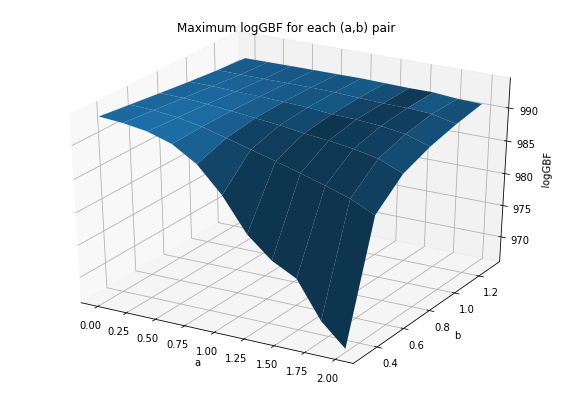

<Figure size 432x288 with 0 Axes>

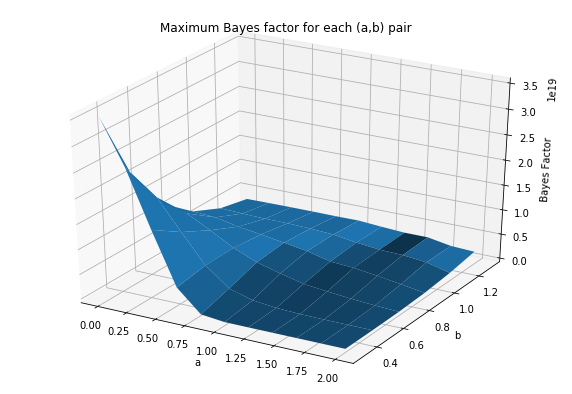

In [96]:
# Make 2D plots
# re-construct the E0 data
read_E0_data_list = gv.gvar(E0_mean_readout, E0_err_readout*E0_mean_readout)


#"Duplicate" the a and b values to make a 3-d grid. a must vary wth the first index, b with the second
# So, for a, make every element an array consisting of len(b) copies of itself. For b, make len(a) copies of the array
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

logGBF_vals = np.transpose(np.array([v for v in max_logGBFS.values()]))
print("Log Bayes Factor list: ", logGBF_vals)
print("Bayes Factor list: ", np.exp(logGBF_vals - 948.8833941223021))
ax.plot_surface(x_samp, y_samp, logGBF_vals)
ax.set_title("Maximum logGBF for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("logGBF")
plt.show()

#x_samp = np.array([[None]*len(b)]*7)
#y_samp = np.array([[None]*len(b)]*7)
#for i in range(7):
    #for j in range(len(b)):
        #x_samp[i][j] = a[i]
        #y_samp[i][j] = b[j]

plt.clf()
fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(x_samp, y_samp, np.exp(logGBF_vals - 948.8833941223021))
ax.set_title("Maximum Bayes factor for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("Bayes Factor")
#ax.set_xlim(0,1.2)
plt.show()

As far as logGBF values go, for the a-values we're gonna use (0,1, 2). For b, the quality of the fit seems to generally slope up with increasing b (though there are exceptions, like with sudden dips at some b-values). For our choices of a-values, the sweets spots are b = 0.9 for a = 0, b = 0.9 for a = 1, and b = 0.8 for a = 2. Highest LogGBF is at a = 0.2, b = 0.9. Note, however, that there is a pretty big gulf between the a = 0.2 fits, especially the optimal ones, and all the other ones. (and by "pretty big", I mean mesaured in orders of magnitude). a = 0 is 2 - 3 orders of magnitude below at best, a = 1, 3 orders of magnitude, a = 2, 8 orders of magnitude).

In [97]:
adsf = np.transpose(np.array([v for v in optimal_E0_err.values()]))

np.shape(adsf)

(11, 6)

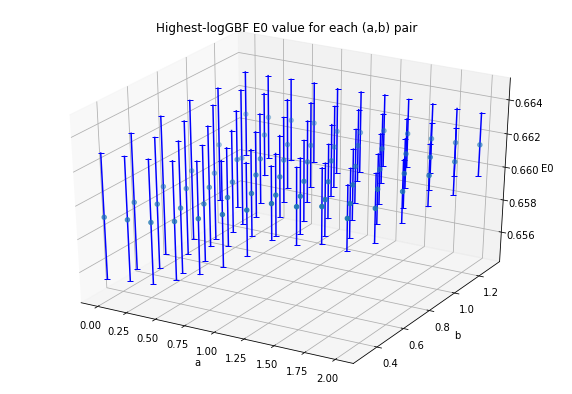

<Figure size 432x288 with 0 Axes>

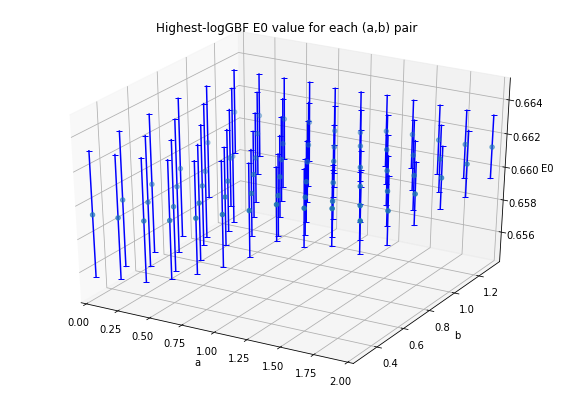

<Figure size 432x288 with 0 Axes>

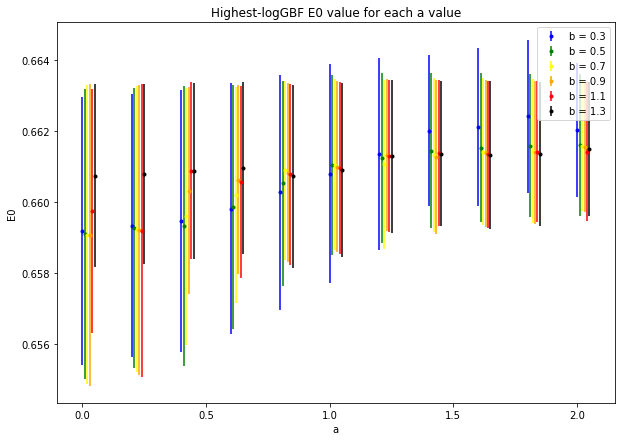

In [99]:
# Now, for E0
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]

#Obtain the E0 array from the tables
np.array([[None]*len(b)]*len(a))


E0_samp = np.array([[[float(E0_with_err_tab.values.tolist()[i][j].split('+/-')[0]), float(E0_with_err_tab.values.tolist()[i][j].split('+/-')[1])] for j in range(len(b))] for i in range(len(a))])

E0_samp_mean = np.transpose(np.array([v for v in optimal_E0.values()]))

E0_samp_sdev = np.transpose(np.array([v for v in optimal_E0_err.values()]))


fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.scatter(x_samp, y_samp, E0_samp_mean)
# the error-bar plot
for i in range(len(a)):
    for j in range(len(b)):
        ax.plot([x_samp[i][j], x_samp[i][j]], [y_samp[i][j], y_samp[i][j]], [E0_samp_mean[i][j]+E0_samp_sdev[i][j], E0_samp_mean[i][j]-E0_samp_sdev[i][j]], marker="_", c='blue')
ax.set_title("Highest-logGBF E0 value for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("E0")
plt.show()

plt.clf()
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]
        
fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.scatter(x_samp, y_samp, E0_samp_mean[0:11])
# the error-bar plot
for i in range(11):
    for j in range(len(b)):
        ax.plot([x_samp[i][j], x_samp[i][j]], [y_samp[i][j], y_samp[i][j]], [E0_samp_mean[i][j]+E0_samp_sdev[i][j], E0_samp_mean[i][j]-E0_samp_sdev[i][j]], marker="_", c='blue')
ax.set_title("Highest-logGBF E0 value for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("E0")
ax.set_xlim(0,2)
plt.show()

plt.clf()
plt.figure(figsize=(10,7))

plt.errorbar(a[0],E0_samp_mean[0][0], yerr=E0_samp_sdev[0][0],fmt=".", color = 'blue', label = 'b = 0.3')
plt.errorbar(a[0]+0.01,E0_samp_mean[0][1], yerr=E0_samp_sdev[0][1],fmt=".", color = 'green', label = 'b = 0.5')
plt.errorbar(a[0]+0.02,E0_samp_mean[0][2], yerr=E0_samp_sdev[0][2],fmt=".", color = 'yellow', label = 'b = 0.7')
plt.errorbar(a[0]+0.03,E0_samp_mean[0][3], yerr=E0_samp_sdev[0][3],fmt=".", color = 'orange', label = 'b = 0.9')
plt.errorbar(a[0]+0.04,E0_samp_mean[0][4], yerr=E0_samp_sdev[0][4],fmt=".", color = 'red', label = 'b = 1.1')
plt.errorbar(a[0]+0.05,E0_samp_mean[0][5], yerr=E0_samp_sdev[0][5],fmt=".", color = 'black', label = 'b = 1.3')

for i in range(1, len(a)):
    plt.errorbar(a[i],E0_samp_mean[i][0], yerr=E0_samp_sdev[i][0],fmt=".", color = 'blue')
    plt.errorbar(a[i]+0.01,E0_samp_mean[i][1], yerr=E0_samp_sdev[i][1],fmt=".", color = 'green')
    plt.errorbar(a[i]+0.02,E0_samp_mean[i][2], yerr=E0_samp_sdev[i][2],fmt=".", color = 'yellow')
    plt.errorbar(a[i]+0.03,E0_samp_mean[i][3], yerr=E0_samp_sdev[i][3],fmt=".", color = 'orange')
    plt.errorbar(a[i]+0.04,E0_samp_mean[i][4], yerr=E0_samp_sdev[i][4],fmt=".", color = 'red')
    plt.errorbar(a[i]+0.05,E0_samp_mean[i][5], yerr=E0_samp_sdev[i][5],fmt=".", color = 'black')
    
plt.title("Highest-logGBF E0 value for each a value")
plt.xlabel("a")
plt.ylabel("E0")
plt.legend()
plt.show()

a = 0 is mostly at E0 = 0.6728 +/- 0.0007
a = 1 is mostly at 
Between these two, there's a transition.

As you go to a = 2, the central value tends to be the same as a = 1, but there's more spread and error bars tend to get bigger.

For less-optimal fit-values, solutions can vary.

Q-value list:  [[5.61211964e-01 5.64667293e-01 5.67229146e-01 5.69051777e-01
  5.70422729e-01 5.71513494e-01]
 [5.34909717e-01 5.41847750e-01 5.52673102e-01 5.60012378e-01
  5.64699084e-01 5.67866335e-01]
 [4.70913348e-01 4.97911613e-01 5.18555999e-01 5.36975836e-01
  5.48780195e-01 5.56489119e-01]
 [3.51077788e-01 4.16404607e-01 4.67390716e-01 5.02437544e-01
  5.24282499e-01 5.38633699e-01]
 [1.79416815e-01 3.17622929e-01 4.14550563e-01 4.64777666e-01
  4.94044260e-01 5.15824470e-01]
 [4.53180975e-02 2.33703915e-01 3.64633617e-01 4.34521557e-01
  4.73062282e-01 4.95954694e-01]
 [4.78932497e-03 1.68969790e-01 3.17369123e-01 3.97548241e-01
  4.41874368e-01 4.68470725e-01]
 [9.04716309e-04 1.17395232e-01 2.78233098e-01 3.75208452e-01
  4.13050934e-01 4.46832515e-01]
 [3.32812631e-04 7.88139180e-02 2.38184017e-01 3.45383248e-01
  4.08304317e-01 4.46620856e-01]
 [1.33483326e-05 5.08585734e-02 1.93077320e-01 3.03782350e-01
  3.86232627e-01 4.14398620e-01]
 [1.60698852e-06 2.61360007e-02 1.1

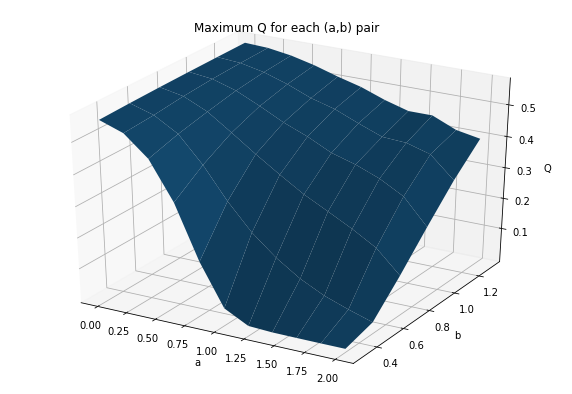

<Figure size 432x288 with 0 Axes>

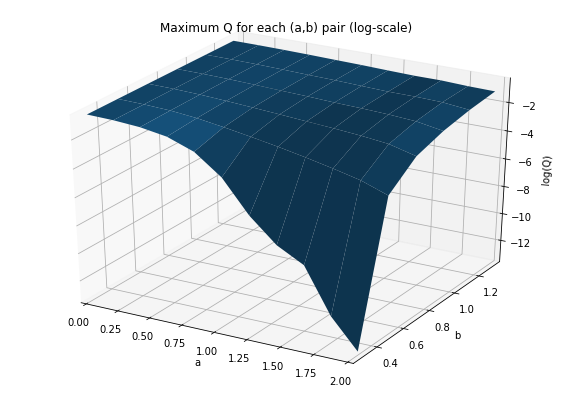

In [102]:
# Make 2D plots


#"Duplicate" the a and b values to make a 3-d grid. a must vary wth the first index, b with the second
# So, for a, make every element an array consisting of len(b) copies of itself. For b, make len(a) copies of the array
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

max_Q_values_array = np.transpose(np.array([v for v in max_Q.values()]))
print("Q-value list: ", max_Q_values_array)
print("log Q-value list: ", np.log(max_Q_values_array))
print("max Q-value: ", np.max(max_Q_values_array))


ax.plot_surface(x_samp, y_samp, max_Q_values_array)
ax.set_title("Maximum Q for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("Q")
plt.show()

x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(11):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]

plt.clf()
fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(x_samp, y_samp, np.log(max_Q_values_array))
ax.set_title("Maximum Q for each (a,b) pair (log-scale)")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("log(Q)")
ax.set_xlim(0,2)
plt.show()

The maximum Q value point for a = 0, 1, and 2 (the ones we use) seems to be b = 0.8 for a = 0, 0.9 for a = 1, and 0.8 for a = 2. Highest Q-value overall is at a = 0.2, for b = 0.3. Log-plot looks similar to that of the Bayes Factor, but at the non-log plot, instead of the rest of the results paling in comparison to the peak, the results are the highest near a = 0, but then dramatically slump down.

(11, 6)
(11, 6)
(11, 6)


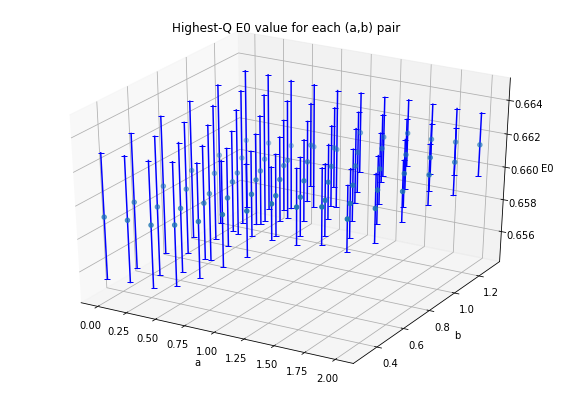

<Figure size 432x288 with 0 Axes>

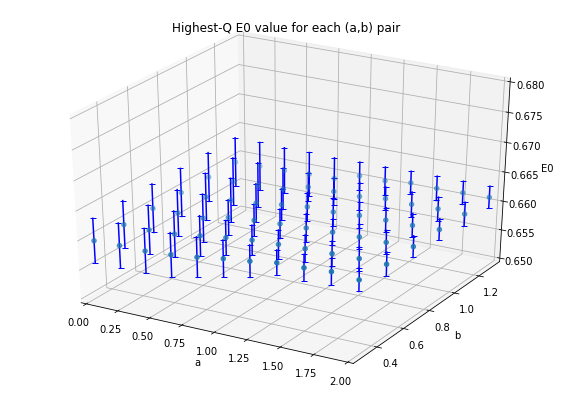

In [103]:
# Now, for E0
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]

#Obtain the E0 array from the tables
np.array([[None]*len(b)]*len(a))

E0Q_samp = np.array([[[float(E0Q_with_err_tab.values.tolist()[i][j].split('+/-')[0]), float(E0Q_with_err_tab.values.tolist()[i][j].split('+/-')[1])] for j in range(len(b))] for i in range(len(a))])

E0Q_samp_mean = E0Q_samp[:,:,0]

E0Q_samp_sdev = E0Q_samp[:,:,1]


print(np.shape(E0Q_samp_mean))

print(np.shape(E0Q_samp_sdev))
print(np.shape(x_samp))

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.scatter(x_samp, y_samp, E0Q_samp_mean)
# the error-bar plot
for i in range(len(a)):
    for j in range(len(b)):
        ax.plot([x_samp[i][j], x_samp[i][j]], [y_samp[i][j], y_samp[i][j]], [E0Q_samp_mean[i][j]+E0Q_samp_sdev[i][j], E0Q_samp_mean[i][j]-E0Q_samp_sdev[i][j]], marker="_", c='blue')
ax.set_title("Highest-Q E0 value for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("E0")
plt.show()

plt.clf()
x_samp = np.array([[None]*len(b)]*len(a))
y_samp = np.array([[None]*len(b)]*len(a))
for i in range(len(a)):
    for j in range(len(b)):
        x_samp[i][j] = a[i]
        y_samp[i][j] = b[j]
        
fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.scatter(x_samp, y_samp, E0Q_samp_mean[0:len(a)])
# the error-bar plot
for i in range(11):
    for j in range(len(b)):
        ax.plot([x_samp[i][j], x_samp[i][j]], [y_samp[i][j], y_samp[i][j]], [E0Q_samp_mean[i][j]+E0Q_samp_sdev[i][j], E0Q_samp_mean[i][j]-E0Q_samp_sdev[i][j]], marker="_", c='blue')
ax.set_title("Highest-Q E0 value for each (a,b) pair")
ax.set_xlabel("a")
ax.set_ylabel("b")
ax.set_zlabel("E0")
ax.set_xlim(0,2)
ax.set_zlim(0.65, 0.68)
plt.show()

<Figure size 432x288 with 0 Axes>

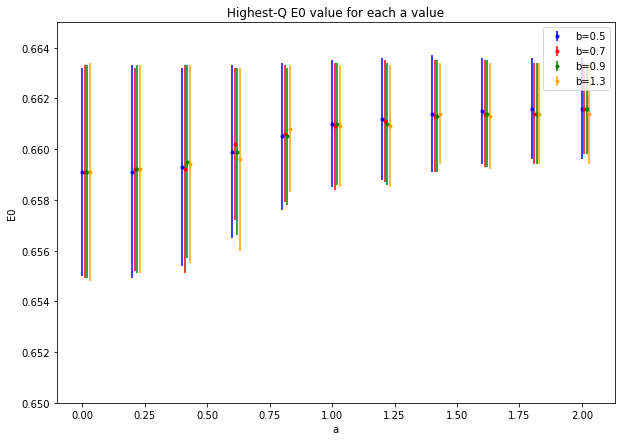

In [104]:
plt.clf()
plt.figure(figsize=(10,7))
plt.errorbar(a[0],E0Q_samp_mean[0][1], yerr=E0Q_samp_sdev[0][1],fmt=".", color="blue", label="b=0.5")
plt.errorbar(a[0]+0.01,E0Q_samp_mean[0][2], yerr=E0Q_samp_sdev[0][2],fmt=".", color="red", label="b=0.7")
plt.errorbar(a[0]+0.02,E0Q_samp_mean[0][3], yerr=E0Q_samp_sdev[0][3],fmt=".", color="green", label="b=0.9")
plt.errorbar(a[0]+0.03,E0Q_samp_mean[0][5], yerr=E0Q_samp_sdev[0][5],fmt=".", color="orange", label="b=1.3")
for i in range(1, len(a)):
    plt.errorbar(a[i],E0Q_samp_mean[i][1], yerr=E0Q_samp_sdev[i][1],fmt=".", color="blue")
    plt.errorbar(a[i]+0.01,E0Q_samp_mean[i][2], yerr=E0Q_samp_sdev[i][2],fmt=".", color="red")
    plt.errorbar(a[i]+0.02,E0Q_samp_mean[i][3], yerr=E0Q_samp_sdev[i][3],fmt=".", color="green")
    plt.errorbar(a[i]+0.03,E0Q_samp_mean[i][4], yerr=E0Q_samp_sdev[i][4],fmt=".", color="orange")
    
plt.title("Highest-Q E0 value for each a value")
plt.xlabel("a")
plt.ylabel("E0")
plt.ylim(0.65,0.665)
plt.legend()
plt.show()



<Figure size 432x288 with 0 Axes>

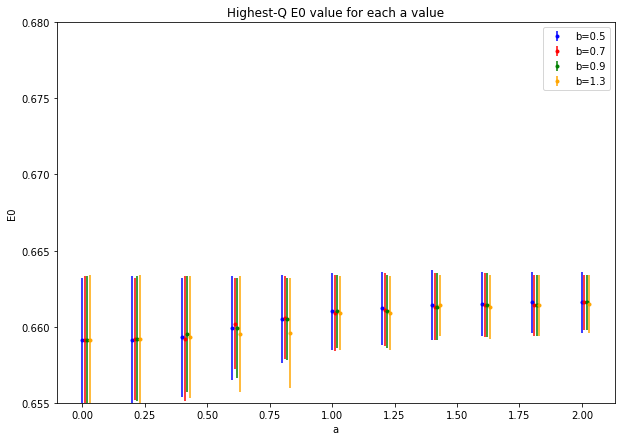

In [105]:
plt.clf()
plt.figure(figsize=(10,7))
plt.errorbar(a[0],E0Q_samp_mean[0][1], yerr=E0Q_samp_sdev[0][1],fmt=".", color="blue", label="b=0.5")
plt.errorbar(a[0]+0.01,E0Q_samp_mean[0][2], yerr=E0Q_samp_sdev[0][2],fmt=".", color="red", label="b=0.7")
plt.errorbar(a[0]+0.02,E0Q_samp_mean[0][3], yerr=E0Q_samp_sdev[0][3],fmt=".", color="green", label="b=0.9")
plt.errorbar(a[0]+0.03,E0Q_samp_mean[0][5], yerr=E0Q_samp_sdev[0][5],fmt=".", color="orange", label="b=1.3")
for i in range(1, len(a)):
    plt.errorbar(a[i],E0Q_samp_mean[i][1], yerr=E0Q_samp_sdev[i][1],fmt=".", color="blue")
    plt.errorbar(a[i]+0.01,E0Q_samp_mean[i][2], yerr=E0Q_samp_sdev[i][2],fmt=".", color="red")
    plt.errorbar(a[i]+0.02,E0Q_samp_mean[i][3], yerr=E0Q_samp_sdev[i][3],fmt=".", color="green")
    plt.errorbar(a[i]+0.03,E0Q_samp_mean[i][5], yerr=E0Q_samp_sdev[i][5],fmt=".", color="orange")
    
plt.title("Highest-Q E0 value for each a value")
plt.xlabel("a")
plt.ylabel("E0")
plt.ylim(0.655,0.68)
plt.legend()
plt.show()


### Now, switch from comparing different values of a, b, and k, to just using a = 0, 1, and 2

In [106]:
a_select_indices = np.array([0, 5, 10])
#np.shape(Q_readout[0])
a[a_select_indices]

array([0., 1., 2.])

In [107]:
print(np.shape(LogGBF_readout))
print(np.shape(b))
print(np.shape(a))

(11, 6, 11)
(6,)
(11,)


In [108]:
#First, find the best fit in each a, b, k combinateion, and put the Bayes Factor, Q, and E0, and E0 fractional uncertainty
# into dictionaries to be made into tables

print(np.max(LogGBF_readout[0]))
max_LogGBF_a0 = np.max(LogGBF_readout[0])
BF_a0 = {}
max_Q_a0 = {}
optimal_E0_a0 = {}
optimal_E0_err_a0 = {}
optimal_E0_with_err_a0 = {}

print(np.max(LogGBF_readout[5]))
max_LogGBF_a1 = np.max(LogGBF_readout[5])
BF_a1 = {}
max_Q_a1 = {}
optimal_E0_a1 = {}
optimal_E0_err_a1 = {}
optimal_E0_with_err_a1 = {}

print(np.max(LogGBF_readout[10]))
max_LogGBF_a2 = np.max(LogGBF_readout[10])
BF_a2 = {}
max_Q_a2 = {}
optimal_E0_a2 = {}
optimal_E0_err_a2 = {}
optimal_E0_with_err_a2 = {}

for j in range(len(b)):
    col_BF_a0 = []
    col_Q_a0 = []
    col_E0_a0 = []
    col_E0_err_a0 = [] 
    col_E0_with_err_a0 = []
    
    col_BF_a1 = []
    col_Q_a1 = []
    col_E0_a1 = []
    col_E0_err_a1 = [] 
    col_E0_with_err_a1 = []
    
    col_BF_a2 = []
    col_Q_a2 = []
    col_E0_a2 = []
    col_E0_err_a2 = [] 
    col_E0_with_err_a2 = []

    for k in range(len(num_fitsamples)):
        col_BF_a0.append(np.exp(LogGBF_readout[a_select_indices[0]][j][k] - max_LogGBF_a0))
        col_Q_a0.append(Q_readout[a_select_indices[0]][j][k])
        col_E0_a0.append(E0_mean_readout[a_select_indices[0]][j][k])
        col_E0_err_a0.append(E0_err_readout[a_select_indices[0]][j][k]*E0_mean_readout[a_select_indices[0]][j][k])
        col_E0_with_err_a0.append("{0:.4f}+/-{1:.4f}".format(E0_mean_readout[a_select_indices[0]][j][k], E0_err_readout[a_select_indices[0]][j][k]*E0_mean_readout[a_select_indices[0]][j][k]))
        
        col_BF_a1.append(np.exp(LogGBF_readout[a_select_indices[1]][j][k] - max_LogGBF_a1))
        col_Q_a1.append(Q_readout[a_select_indices[1]][j][k])
        col_E0_a1.append(E0_mean_readout[a_select_indices[1]][j][k])
        col_E0_err_a1.append(E0_err_readout[a_select_indices[1]][j][k]*E0_mean_readout[a_select_indices[1]][j][k])
        col_E0_with_err_a1.append("{0:.4f}+/-{1:.4f}".format(E0_mean_readout[a_select_indices[1]][j][k], E0_err_readout[a_select_indices[1]][j][k]*E0_mean_readout[a_select_indices[1]][j][k]))
        
        col_BF_a2.append(np.exp(LogGBF_readout[a_select_indices[2]][j][k] - max_LogGBF_a2))
        col_Q_a2.append(Q_readout[a_select_indices[2]][j][k])
        col_E0_a2.append(E0_mean_readout[a_select_indices[2]][j][k])
        col_E0_err_a2.append(E0_err_readout[a_select_indices[2]][j][k]*E0_mean_readout[a_select_indices[2]][j][k])
        col_E0_with_err_a2.append("{0:.4f}+/-{1:.4f}".format(E0_mean_readout[a_select_indices[2]][j][k], E0_err_readout[a_select_indices[2]][j][k]*E0_mean_readout[a_select_indices[2]][j][k]))
        
    
    BF_a0.update({'{0:.1f}'.format(b[j]):col_BF_a0})
    max_Q_a0.update({'{0:.1f}'.format(b[j]):col_Q_a0})
    optimal_E0_a0.update({'{0:.1f}'.format(b[j]):col_E0_a0})
    optimal_E0_err_a0.update({'{0:.1f}'.format(b[j]):col_E0_err_a0})
    optimal_E0_with_err_a0.update({'{0:.1f}'.format(b[j]):col_E0_with_err_a0})
    
    BF_a1.update({'{0:.1f}'.format(b[j]):col_BF_a1})
    max_Q_a1.update({'{0:.1f}'.format(b[j]):col_Q_a1})
    optimal_E0_a1.update({'{0:.1f}'.format(b[j]):col_E0_a1})
    optimal_E0_err_a1.update({'{0:.1f}'.format(b[j]):col_E0_err_a1})
    optimal_E0_with_err_a1.update({'{0:.1f}'.format(b[j]):col_E0_with_err_a1})
    
    BF_a2.update({'{0:.1f}'.format(b[j]):col_BF_a2})
    max_Q_a2.update({'{0:.1f}'.format(b[j]):col_Q_a2})
    optimal_E0_a2.update({'{0:.1f}'.format(b[j]):col_E0_a2})
    optimal_E0_err_a2.update({'{0:.1f}'.format(b[j]):col_E0_err_a2})
    optimal_E0_with_err_a2.update({'{0:.1f}'.format(b[j]):col_E0_with_err_a2})

993.8923982504829
991.7024335861591
990.9512145036966


In [109]:
BF_tab_a0 = pd.DataFrame(BF_a0)

BF_tab_a0.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Bayes Factors for a = 0; rows represent k-values, columns, b-values")
BF_tab_a0

Table of Bayes Factors for a = 0; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,3.660159e-108,2.818911e-107,4.068993e-107,4.227615e-107,4.005025e-107,3.686972e-107
2,2.243406e-02,1.417788e-01,1.642621e-01,1.398710e-01,1.114370e-01,8.821611e-02
3,2.859073e-01,2.902075e-01,2.335233e-01,1.736872e-01,1.281900e-01,9.600705e-02
4,8.641238e-01,5.383768e-01,3.300475e-01,2.058455e-01,1.322522e-01,8.795525e-02
5,1.000000e+00,5.828837e-01,3.408678e-01,2.061747e-01,1.300285e-01,8.548811e-02
6,8.313407e-01,4.889729e-01,2.879845e-01,1.746688e-01,1.100486e-01,7.204540e-02
7,6.518450e-01,3.889065e-01,2.314789e-01,1.411829e-01,8.895691e-02,5.823865e-02
8,5.385444e-01,3.276936e-01,1.974708e-01,1.218545e-01,7.766850e-02,5.131159e-02
9,4.781122e-01,2.963927e-01,1.810812e-01,1.127856e-01,7.271281e-02,4.841873e-02
10,4.477621e-01,2.809193e-01,1.733635e-01,1.087257e-01,7.061828e-02,4.726017e-02


In [110]:
Q_tab_a0 = pd.DataFrame(max_Q_a0)

Q_tab_a0.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Q values for a = 0; rows represent k-values, columns, b-values")
Q_tab_a0

Table of Q values for a = 0; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,5.450118e-91,5.860351e-90,1.127538e-89,1.476016e-89,1.691593e-89,1.829565e-89
2,1.538944e-01,3.271261e-01,3.914331e-01,4.197498e-01,4.344532e-01,4.430149e-01
3,3.887379e-01,4.642492e-01,4.973281e-01,5.137953e-01,5.227841e-01,5.281469e-01
4,5.277117e-01,5.441727e-01,5.536052e-01,5.592084e-01,5.627815e-01,5.652218e-01
5,5.612120e-01,5.646673e-01,5.672291e-01,5.690518e-01,5.704227e-01,5.715135e-01
6,5.492797e-01,5.509218e-01,5.521849e-01,5.531436e-01,5.539173e-01,5.545753e-01
7,5.250127e-01,5.261824e-01,5.270241e-01,5.276043e-01,5.280295e-01,5.283780e-01
8,5.035509e-01,5.050529e-01,5.065970e-01,5.083006e-01,5.104116e-01,5.132818e-01
9,4.893609e-01,4.921540e-01,4.955668e-01,4.994732e-01,5.038785e-01,5.090512e-01
10,4.813575e-01,4.854616e-01,4.903997e-01,4.957189e-01,5.012915e-01,5.074474e-01


In [111]:
E0_tab_a0 = pd.DataFrame(optimal_E0_with_err_a0)

E0_tab_a0.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of E values for a = 0; rows represent k-values, columns, b-values")
E0_tab_a0

Table of E values for a = 0; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011
2,0.6616+/-0.0019,0.6615+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018
3,0.6604+/-0.0029,0.6606+/-0.0028,0.6607+/-0.0027,0.6607+/-0.0026,0.6607+/-0.0026,0.6607+/-0.0026
4,0.6594+/-0.0036,0.6595+/-0.0036,0.6596+/-0.0035,0.6597+/-0.0035,0.6598+/-0.0034,0.6598+/-0.0034
5,0.6592+/-0.0038,0.6591+/-0.0041,0.6591+/-0.0042,0.6591+/-0.0042,0.6591+/-0.0043,0.6591+/-0.0043
6,0.6593+/-0.0038,0.6591+/-0.0042,0.6590+/-0.0044,0.6590+/-0.0045,0.6590+/-0.0045,0.6589+/-0.0046
7,0.6595+/-0.0037,0.6594+/-0.0041,0.6593+/-0.0042,0.6592+/-0.0043,0.6592+/-0.0044,0.6592+/-0.0044
8,0.6597+/-0.0036,0.6596+/-0.0039,0.6596+/-0.0040,0.6596+/-0.0039,0.6597+/-0.0039,0.6598+/-0.0037
9,0.6598+/-0.0036,0.6598+/-0.0038,0.6598+/-0.0038,0.6598+/-0.0037,0.6599+/-0.0037,0.6599+/-0.0036
10,0.6599+/-0.0035,0.6599+/-0.0037,0.6599+/-0.0037,0.6599+/-0.0037,0.6600+/-0.0036,0.6599+/-0.0036


In [112]:
BF_tab_a1 = pd.DataFrame(BF_a1)

BF_tab_a1.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Bayes Factors for a = 1; rows represent k-values, columns, b-values")
BF_tab_a1

Table of Bayes Factors for a = 1; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,3.270314e-107,2.518668e-106,3.635604e-106,3.777330e-106,3.578449e-106,3.294272e-106
2,2.108958e-05,4.351504e-02,2.595827e-01,4.367811e-01,4.920331e-01,4.756104e-01
3,0.000000e+00,1.200291e-01,5.643566e-01,8.637061e-01,9.210900e-01,8.543220e-01
4,2.445484e-151,1.848960e-01,7.001054e-01,9.838292e-01,1.000000e+00,8.930963e-01
5,2.319904e-04,2.071937e-01,6.507808e-01,8.478555e-01,8.235465e-01,6.913452e-01
6,8.319373e-04,1.871579e-01,4.986496e-01,6.087267e-01,3.374398e-01,2.747199e-01
7,7.218351e-04,1.437729e-01,3.321840e-01,3.820497e-01,2.295100e-01,1.874611e-01
8,1.496352e-03,9.727406e-02,1.976827e-01,2.135810e-01,1.397696e-01,1.132622e-01
9,2.944978e-03,5.371407e-02,1.085509e-01,1.047692e-01,7.735513e-02,6.221369e-02
10,2.536464e-03,3.229983e-02,5.494782e-02,5.248158e-02,3.983550e-02,3.186760e-02


In [113]:
Q_tab_a1 = pd.DataFrame(max_Q_a1)

Q_tab_a1.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Q values for a = 1; rows represent k-values, columns, b-values")
Q_tab_a1

Table of Q values for a = 1; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,5.450118e-91,5.860351e-90,1.127538e-89,1.476016e-89,1.691593e-89,1.829565e-89
2,4.323674e-03,1.300848e-01,2.609015e-01,3.341077e-01,3.751437e-01,3.998165e-01
3,0.000000e+00,1.895449e-01,3.345716e-01,4.098311e-01,4.507651e-01,4.750368e-01
4,7.891149e-130,2.218571e-01,3.632134e-01,4.345216e-01,4.730623e-01,4.959547e-01
5,1.641463e-02,2.337039e-01,3.646336e-01,4.304527e-01,4.663184e-01,4.880759e-01
6,2.738260e-02,2.305764e-01,3.483508e-01,4.082432e-01,4.418100e-01,4.718267e-01
7,2.853439e-02,2.168586e-01,3.203988e-01,3.742374e-01,4.100776e-01,4.377564e-01
8,3.754920e-02,1.960304e-01,2.851487e-01,3.329895e-01,3.679212e-01,3.929316e-01
9,4.531810e-02,1.637004e-01,2.461536e-01,2.882348e-01,3.198413e-01,3.419674e-01
10,4.359994e-02,1.443212e-01,2.062189e-01,2.425588e-01,2.696303e-01,2.887844e-01


In [114]:
E0_tab_a1 = pd.DataFrame(optimal_E0_with_err_a1)

E0_tab_a1.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of E values for a = 1; rows represent k-values, columns, b-values")
E0_tab_a1

Table of E values for a = 1; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011
2,0.6618+/-0.0019,0.6616+/-0.0018,0.6616+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018
3,0.6633+/-0.0016,0.6614+/-0.0022,0.6613+/-0.0022,0.6612+/-0.0022,0.6612+/-0.0022,0.6612+/-0.0022
4,0.6619+/-0.0014,0.6612+/-0.0024,0.6611+/-0.0024,0.6610+/-0.0024,0.6609+/-0.0024,0.6609+/-0.0024
5,0.6603+/-0.0031,0.6610+/-0.0025,0.6609+/-0.0025,0.6608+/-0.0025,0.6607+/-0.0025,0.6606+/-0.0026
6,0.6606+/-0.0031,0.6609+/-0.0026,0.6607+/-0.0026,0.6606+/-0.0026,0.6597+/-0.0035,0.6595+/-0.0038
7,0.6598+/-0.0034,0.6608+/-0.0027,0.6606+/-0.0027,0.6604+/-0.0027,0.6595+/-0.0038,0.6593+/-0.0039
8,0.6600+/-0.0033,0.6607+/-0.0028,0.6604+/-0.0028,0.6602+/-0.0029,0.6594+/-0.0039,0.6592+/-0.0041
9,0.6608+/-0.0031,0.6606+/-0.0029,0.6603+/-0.0029,0.6598+/-0.0033,0.6593+/-0.0040,0.6592+/-0.0042
10,0.6607+/-0.0031,0.6604+/-0.0030,0.6601+/-0.0030,0.6596+/-0.0034,0.6592+/-0.0041,0.6591+/-0.0043


In [115]:
BF_tab_a2 = pd.DataFrame(BF_a2)

BF_tab_a2.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Bayes Factors for a = 2; rows represent k-values, columns, b-values")
BF_tab_a2

Table of Bayes Factors for a = 2; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,6.931701e-107,5.338524e-106,7.705962e-106,8.006363e-106,7.584818e-106,6.982480e-106
2,2.595417e-11,4.744801e-04,3.674451e-02,1.792436e-01,3.468741e-01,4.580434e-01
3,0.000000e+00,0.000000e+00,1.677754e-302,0.000000e+00,2.647816e-209,1.000000e+00
4,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5,0.000000e+00,2.539830e-43,0.000000e+00,2.223445e-50,0.000000e+00,0.000000e+00
6,8.399618e-271,1.019588e-03,1.547087e-158,5.930518e-132,4.931364e-01,7.187051e-02
7,7.524471e-234,1.045281e-169,1.448030e-112,3.466261e-70,2.414706e-02,4.448228e-02
8,7.943657e-231,6.690880e-157,2.864033e-87,1.455785e-05,1.307298e-02,2.439050e-02
9,2.559111e-234,3.446281e-148,8.747350e-03,6.421173e-57,6.490564e-03,1.207278e-02
10,4.733024e-249,3.337235e-153,3.830973e-03,8.317785e-88,2.973747e-03,5.499723e-03


In [116]:
Q_tab_a2 = pd.DataFrame(max_Q_a2)

Q_tab_a2.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of Q values for a = 2; rows represent k-values, columns, b-values")
Q_tab_a2

Table of Q values for a = 2; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,5.450118e-91,5.860351e-90,1.127538e-89,1.476016e-89,1.691593e-89,1.829565e-89
2,1.606989e-06,1.892567e-02,1.197853e-01,2.212824e-01,2.907840e-01,3.361432e-01
3,0.000000e+00,0.000000e+00,6.708663e-277,0.000000e+00,1.609814e-186,4.004344e-01
4,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5,1.751882e-311,3.136264e-30,9.069854e-299,8.063339e-37,0.000000e+00,0.000000e+00
6,7.397739e-245,2.613600e-02,1.427709e-135,3.828214e-110,3.183433e-01,3.018357e-01
7,8.974365e-209,1.815159e-146,3.206578e-92,2.363955e-53,2.010522e-01,2.708059e-01
8,1.005930e-205,3.286958e-134,7.698102e-69,9.073985e-03,1.704383e-01,2.327545e-01
9,5.037153e-209,7.095823e-126,7.461236e-02,6.163038e-42,1.385839e-01,1.923256e-01
10,2.298442e-223,1.434579e-130,5.548806e-02,1.473509e-69,1.083344e-01,1.530373e-01


In [117]:
E0_tab_a2 = pd.DataFrame(optimal_E0_with_err_a2)

E0_tab_a2.index = [k for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1)]
print("Table of E values for a = 2; rows represent k-values, columns, b-values")
E0_tab_a2

Table of E values for a = 2; rows represent k-values, columns, b-values


,0.3,0.5,0.7,0.9,1.1,1.3
1,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011,0.6674+/-0.0011
2,0.6620+/-0.0019,0.6617+/-0.0018,0.6616+/-0.0018,0.6616+/-0.0018,0.6615+/-0.0018,0.6615+/-0.0018
3,0.6503+/-0.0015,0.6513+/-0.0015,0.6538+/-0.0015,0.6503+/-0.0015,0.6854+/-0.0012,0.6615+/-0.0019
4,0.6505+/-0.0020,0.6972+/-0.0022,0.6954+/-0.0021,0.6943+/-0.0020,0.6923+/-0.0019,0.6896+/-0.0018
5,0.6771+/-0.0015,0.6492+/-0.0112,0.6792+/-0.0015,0.6710+/-0.0014,0.6851+/-0.0018,0.6822+/-0.0017
6,0.6690+/-0.0015,0.6616+/-0.0020,0.6610+/-0.0014,0.6630+/-0.0014,0.6614+/-0.0020,0.6597+/-0.0036
7,0.6613+/-0.0014,0.6603+/-0.0014,0.6646+/-0.0014,0.6684+/-0.0014,0.6597+/-0.0036,0.6596+/-0.0037
8,0.6597+/-0.0014,0.6612+/-0.0014,0.6673+/-0.0014,0.6594+/-0.0033,0.6597+/-0.0037,0.6595+/-0.0038
9,0.6587+/-0.0014,0.6623+/-0.0014,0.6614+/-0.0020,0.6694+/-0.0014,0.6596+/-0.0037,0.6595+/-0.0038
10,0.6606+/-0.0015,0.6620+/-0.0014,0.6614+/-0.0020,0.6659+/-0.0015,0.6596+/-0.0038,0.6595+/-0.0038


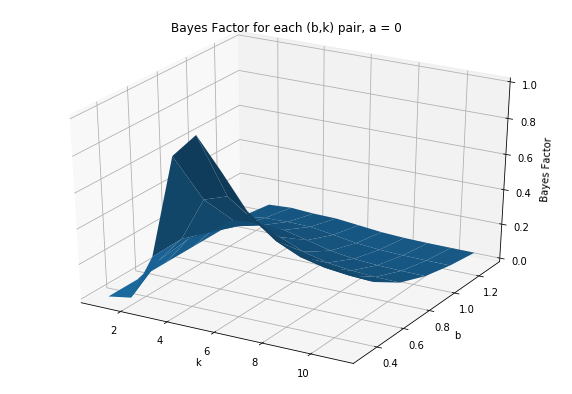

<Figure size 432x288 with 0 Axes>

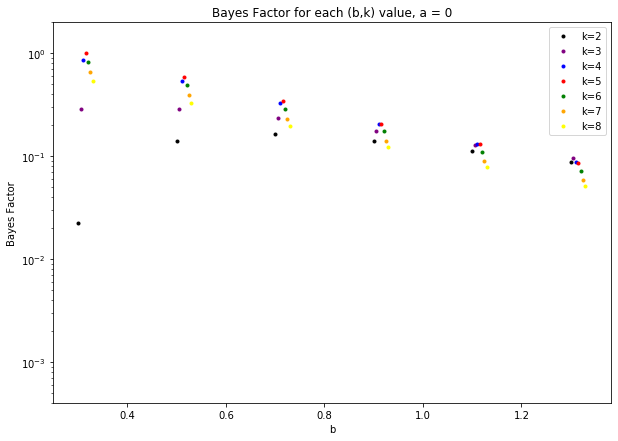

In [118]:
#Now, 3D plots 
x_samp = np.array([[None]*len(num_fitsamples)]*len(b))
y_samp = np.array([[None]*len(num_fitsamples)]*len(b))

for i in range(len(b)):
    for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        x_samp[i][k-1] = b[i]
        y_samp[i][k-1] = k

# Bayes Factor

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in BF_a0.values()]))
ax.set_title("Bayes Factor for each (b,k) pair, a = 0")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Bayes Factor")
plt.show()

BF_a0_list = np.array(BF_tab_a0.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.semilogy(b[0], BF_a0_list[1][0], ".", color="black", label="k=2")
plt.semilogy(b[0]+0.005, BF_a0_list[2][0], ".", color="purple", label="k=3")
plt.semilogy(b[0]+0.01, BF_a0_list[3][0], ".", color="blue", label="k=4")
plt.semilogy(b[0]+0.015, BF_a0_list[4][0], ".", color="red", label="k=5")
plt.semilogy(b[0]+0.02, BF_a0_list[5][0], ".", color="green", label="k=6")
plt.semilogy(b[0]+0.025, BF_a0_list[6][0], ".", color="orange", label="k=7")
plt.semilogy(b[0]+0.03, BF_a0_list[7][0], ".", color="yellow", label="k=8")
#plt.semilogy(b[0]+0.035, BF_a0_list[8][0], ".", color="grey", label="k=9")
#plt.semilogy(b[0]+0.04, BF_a0_list[9][0], ".", color="brown", label="k=10")

for i in range(1,len(b)):
    plt.semilogy(b[i], BF_a0_list[1][i], ".", color="black")
    plt.semilogy(b[i]+0.005, BF_a0_list[2][i], ".", color="purple")
    plt.semilogy(b[i]+0.01,BF_a0_list[3][i], ".", color="blue")
    plt.semilogy(b[i]+0.015,BF_a0_list[4][i], ".", color="red")
    plt.semilogy(b[i]+0.02,BF_a0_list[5][i], ".", color="green")
    plt.semilogy(b[i]+0.025,BF_a0_list[6][i], ".", color="orange")
    plt.semilogy(b[i]+0.03,BF_a0_list[7][i], ".", color="yellow")
    #plt.semilogy(b[i]+0.035,BF_a0_list[8][i], ".", color="grey")
    #plt.semilogy(b[i]+0.04, BF_a0_list[9][i], ".", color="brown")
        
plt.title("Bayes Factor for each (b,k) value, a = 0")
plt.xlabel("b")
plt.ylabel("Bayes Factor")
plt.ylim(4e-4, 2)
plt.legend()
plt.show()




The maximum Bayes factor for a = 0 is at b = 0.2, k = 3, and there's a gap measured in orders of magnitude in the fit qualities of the fits. Except at b = 0.2, the best fit seems to be at k = 2

<Figure size 432x288 with 0 Axes>

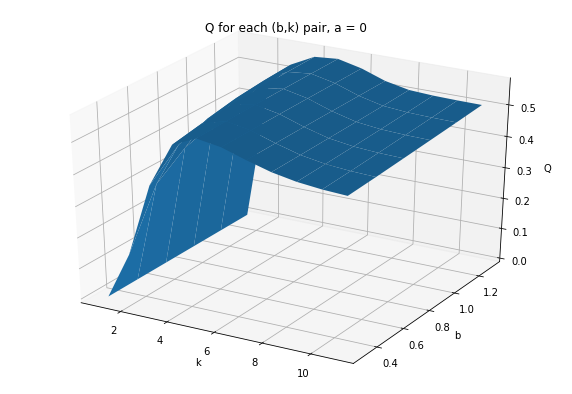

<Figure size 432x288 with 0 Axes>

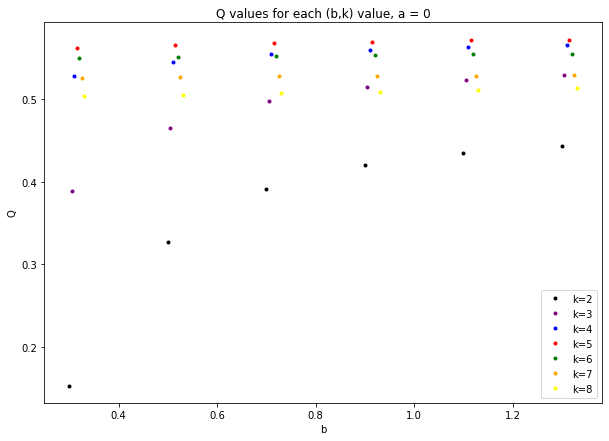

In [119]:
plt.clf()

# Q value

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in max_Q_a0.values()]))
ax.set_title("Q for each (b,k) pair, a = 0")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Q")
plt.show()

Q_a0 = np.array(Q_tab_a0.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.plot(b[0], Q_a0[1][0], ".", color="black", label="k=2")
plt.plot(b[0]+0.005, Q_a0[2][0], ".", color="purple", label="k=3")
plt.plot(b[0]+0.01,Q_a0[3][0], ".", color="blue", label="k=4")
plt.plot(b[0]+0.015,Q_a0[4][0], ".", color="red", label="k=5")
plt.plot(b[0]+0.02,Q_a0[5][0], ".", color="green", label="k=6")
plt.plot(b[0]+0.025,Q_a0[6][0], ".", color="orange", label="k=7")
plt.plot(b[0]+0.03,Q_a0[7][0], ".", color="yellow", label="k=8")
#plt.plot(b[0]+0.035,Q_a0[8][0], ".", color="grey", label="k=9")

for i in range(1,len(b)):
    plt.plot(b[i], Q_a0[1][i], ".", color="black")
    plt.plot(b[i]+0.005, Q_a0[2][i], ".", color="purple")
    plt.plot(b[i]+0.01,Q_a0[3][i], ".", color="blue")
    plt.plot(b[i]+0.015,Q_a0[4][i], ".", color="red")
    plt.plot(b[i]+0.02,Q_a0[5][i], ".", color="green")
    plt.plot(b[i]+0.025,Q_a0[6][i], ".", color="orange")
    plt.plot(b[i]+0.03,Q_a0[7][i], ".", color="yellow")
    #plt.plot(b[i]+0.035,Q_a0[8][i], ".", color="grey")
        
plt.title("Q values for each (b,k) value, a = 0")
plt.xlabel("b")
plt.ylabel("Q")
#plt.ylim(0.655,0.68)
plt.legend()
plt.show()



For a = 0, aside from Q equalling zero at k-values 3 or less, there's no definitive range of where peaks and valleys in Q happen. Generally, Q is highest in the region of 0.6 <= b <= 0.9 and 5 <= k <= 7, but other than that the distribution of peaks and valleys is largely stochastic.

<Figure size 432x288 with 0 Axes>

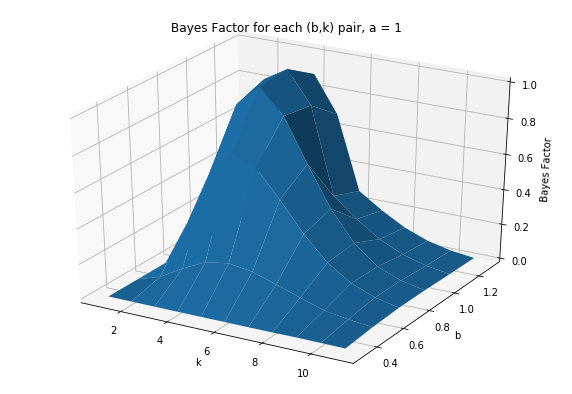

<Figure size 432x288 with 0 Axes>

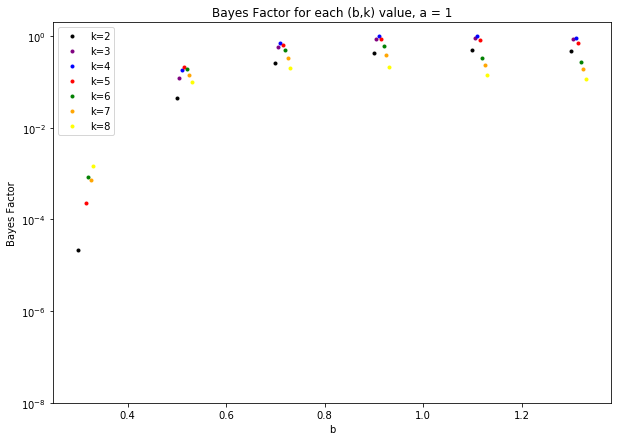

In [125]:
plt.clf()

# Bayes values

x_samp = np.array([[None]*len(num_fitsamples)]*len(b))
y_samp = np.array([[None]*len(num_fitsamples)]*len(b))

for i in range(len(b)):
    for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        x_samp[i][k-1] = b[i]
        y_samp[i][k-1] = k
        
fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in BF_a1.values()]))
ax.set_title("Bayes Factor for each (b,k) pair, a = 1")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Bayes Factor")
plt.show()

BF_a1_list = np.array(BF_tab_a1.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.semilogy(b[0], BF_a1_list[1][0], ".", color="black", label="k=2")
plt.semilogy(b[0]+0.005, BF_a1_list[2][0], ".", color="purple", label="k=3")
plt.semilogy(b[0]+0.01, BF_a1_list[3][0], ".", color="blue", label="k=4")
plt.semilogy(b[0]+0.015, BF_a1_list[4][0], ".", color="red", label="k=5")
plt.semilogy(b[0]+0.02, BF_a1_list[5][0], ".", color="green", label="k=6")
plt.semilogy(b[0]+0.025, BF_a1_list[6][0], ".", color="orange", label="k=7")
plt.semilogy(b[0]+0.03, BF_a1_list[7][0], ".", color="yellow", label="k=8")
#plt.semilogy(b[0]+0.035, BF_a1_list[8][0], ".", color="grey", label="k=9")

for i in range(1,len(b)):
    plt.semilogy(b[i], BF_a1_list[1][i], ".", color="black")
    plt.semilogy(b[i]+0.005, BF_a1_list[2][i], ".", color="purple")
    plt.semilogy(b[i]+0.01,BF_a1_list[3][i], ".", color="blue")
    plt.semilogy(b[i]+0.015,BF_a1_list[4][i], ".", color="red")
    plt.semilogy(b[i]+0.02,BF_a1_list[5][i], ".", color="green")
    plt.semilogy(b[i]+0.025,BF_a1_list[6][i], ".", color="orange")
    plt.semilogy(b[i]+0.03,BF_a1_list[7][i], ".", color="yellow")
    #plt.semilogy(b[i]+0.035,BF_a1_list[8][i], ".", color="grey")
        
plt.title("Bayes Factor for each (b,k) value, a = 1")
plt.xlabel("b")
plt.ylabel("Bayes Factor")
plt.ylim(1e-8, 2)
plt.legend()
plt.show()


Bayes factor: same deal with a = 1 as with a = 0

<Figure size 432x288 with 0 Axes>

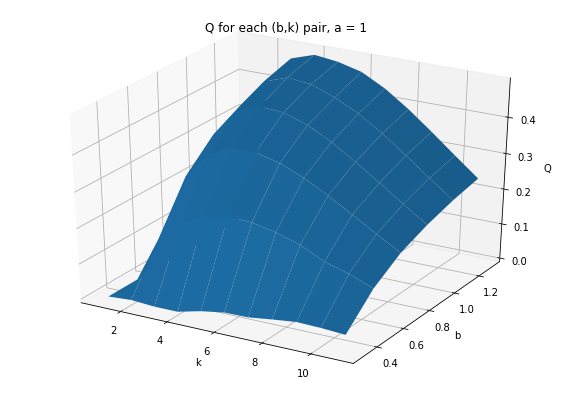

<Figure size 432x288 with 0 Axes>

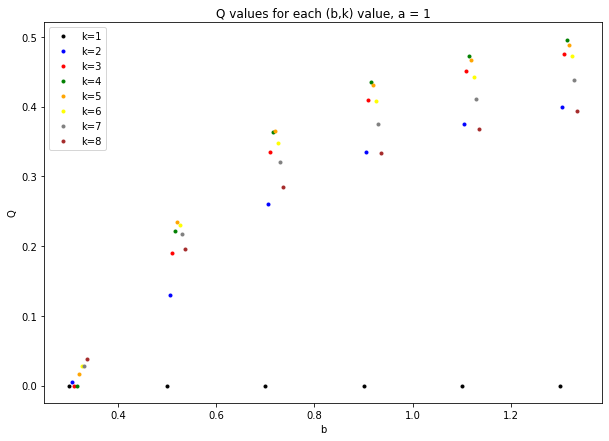

In [126]:
plt.clf()

# Q-values


fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in max_Q_a1.values()]))
ax.set_title("Q for each (b,k) pair, a = 1")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Q")
plt.show()

plt.clf()

Q_a1 = np.array(Q_tab_a1.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.plot(b[0], Q_a1[0][0], ".", color="black", label="k=1")
plt.plot(b[0]+0.005,Q_a1[1][0], ".", color="blue", label="k=2")
plt.plot(b[0]+0.01,Q_a1[2][0], ".", color="red", label="k=3")
plt.plot(b[0]+0.015,Q_a1[3][0], ".", color="green", label="k=4")
plt.plot(b[0]+0.02,Q_a1[4][0], ".", color="orange", label="k=5")
plt.plot(b[0]+0.025,Q_a1[5][0], ".", color="yellow", label="k=6")
plt.plot(b[0]+0.03,Q_a1[6][0], ".", color="grey", label="k=7")
plt.plot(b[0]+0.035,Q_a1[7][0], ".", color="brown", label="k=8")

for i in range(1,len(b)):
    plt.plot(b[i], Q_a1[0][i], ".", color="black")
    plt.plot(b[i]+0.005,Q_a1[1][i], ".", color="blue")
    plt.plot(b[i]+0.01,Q_a1[2][i], ".", color="red")
    plt.plot(b[i]+0.015,Q_a1[3][i], ".", color="green")
    plt.plot(b[i]+0.02,Q_a1[4][i], ".", color="orange")
    plt.plot(b[i]+0.025,Q_a1[5][i], ".", color="yellow")
    plt.plot(b[i]+0.03,Q_a1[6][i], ".", color="grey")
    plt.plot(b[i]+0.035,Q_a1[7][i], ".", color="brown")


        
plt.title("Q values for each (b,k) value, a = 1")
plt.xlabel("b")
plt.ylabel("Q")
#plt.ylim(0.655,0.68)
plt.legend()
plt.show()



There is somewhat more of a pattern here than with a = 0, with the best fits being clearly confined to 5 <= k <= 7, best fit overall being at k = 6, b = 0.4, and the best fits are in 0.4 <= b <= 0.6.

Still, as far as b is concerned, the distribution is largely k-dependent. 

<Figure size 432x288 with 0 Axes>

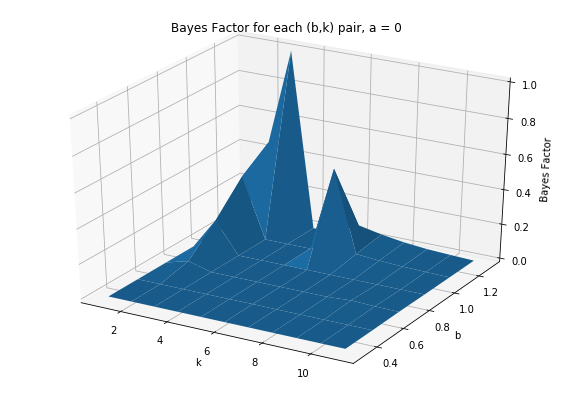

<Figure size 432x288 with 0 Axes>

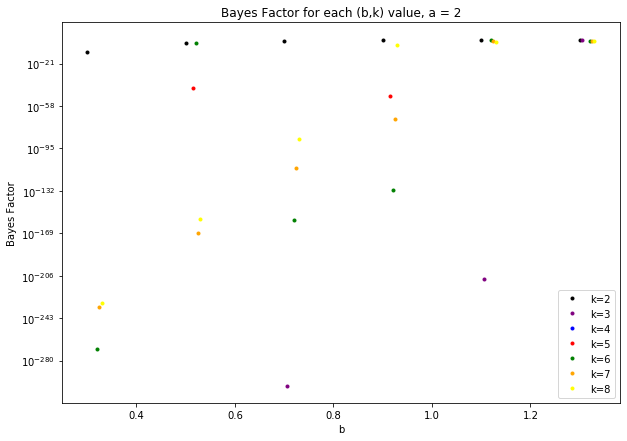

In [127]:
plt.clf()

#Bayes Factor

fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in BF_a2.values()]))
ax.set_title("Bayes Factor for each (b,k) pair, a = 0")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Bayes Factor")
plt.show()

BF_a2_list = np.array(BF_tab_a2.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.semilogy(b[0], BF_a2_list[1][0], ".", color="black", label="k=2")
plt.semilogy(b[0]+0.005, BF_a2_list[2][0], ".", color="purple", label="k=3")
plt.semilogy(b[0]+0.01, BF_a2_list[3][0], ".", color="blue", label="k=4")
plt.semilogy(b[0]+0.015, BF_a2_list[4][0], ".", color="red", label="k=5")
plt.semilogy(b[0]+0.02, BF_a2_list[5][0], ".", color="green", label="k=6")
plt.semilogy(b[0]+0.025, BF_a2_list[6][0], ".", color="orange", label="k=7")
plt.semilogy(b[0]+0.03, BF_a2_list[7][0], ".", color="yellow", label="k=8")
#plt.semilogy(b[0]+0.035, BF_a2_list[8][0], ".", color="grey", label="k=9")

for i in range(1,len(b)):
    plt.semilogy(b[i], BF_a2_list[1][i], ".", color="black")
    plt.semilogy(b[i]+0.005, BF_a2_list[2][i], ".", color="purple")
    plt.semilogy(b[i]+0.01,BF_a2_list[3][i], ".", color="blue")
    plt.semilogy(b[i]+0.015,BF_a2_list[4][i], ".", color="red")
    plt.semilogy(b[i]+0.02,BF_a2_list[5][i], ".", color="green")
    plt.semilogy(b[i]+0.025,BF_a2_list[6][i], ".", color="orange")
    plt.semilogy(b[i]+0.03,BF_a2_list[7][i], ".", color="yellow")
    #plt.semilogy(b[i]+0.035,BF_a2_list[8][i], ".", color="grey")
        
plt.title("Bayes Factor for each (b,k) value, a = 2")
plt.xlabel("b")
plt.ylabel("Bayes Factor")
#plt.ylim(1e-30, 2)
plt.legend()
plt.show()

For a = 2, the highest Bayes factor is at b = 0.4, k = 3. The best Bayes factors are at k = 3 for b = 0.4 and b > 0.6 and k = 2 for the others.

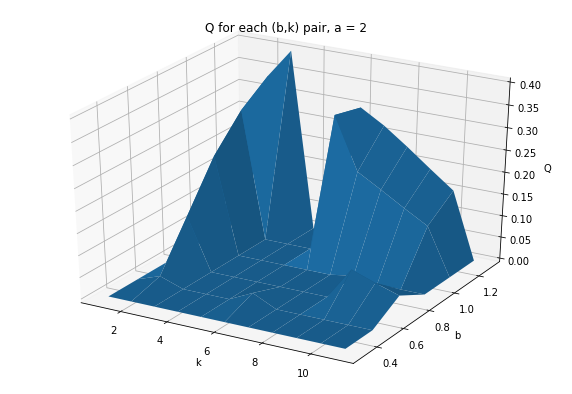

<Figure size 432x288 with 0 Axes>

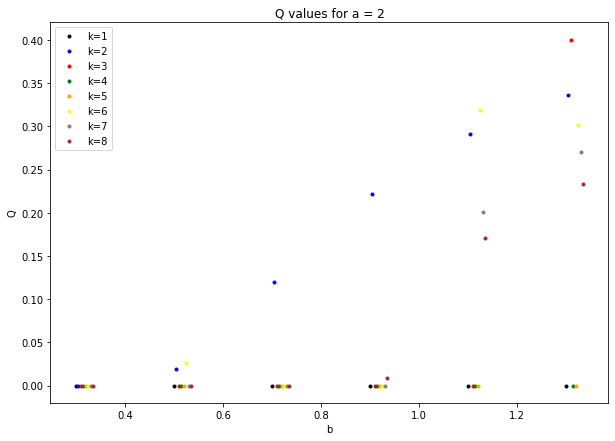

In [128]:
x_samp = np.array([[None]*len(num_fitsamples)]*len(b))
y_samp = np.array([[None]*len(num_fitsamples)]*len(b))

for i in range(len(b)):
    for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        x_samp[i][k-1] = b[i]
        y_samp[i][k-1] = k


fig = plt.figure(figsize=(10,7))
ax = plt.axes(projection='3d')

ax.plot_surface(y_samp, x_samp, np.array([v for v in max_Q_a2.values()]))
ax.set_title("Q for each (b,k) pair, a = 2")
ax.set_xlabel("k")
ax.set_ylabel("b")
ax.set_zlabel("Q")
plt.show()

plt.clf()

Q_a2 = np.array(Q_tab_a2.values.tolist())

plt.clf()
plt.figure(figsize=(10,7))
plt.plot(b[0], Q_a2[0][0], ".", color="black", label="k=1")
plt.plot(b[0]+0.005,Q_a2[1][0], ".", color="blue", label="k=2")
plt.plot(b[0]+0.01,Q_a2[2][0], ".", color="red", label="k=3")
plt.plot(b[0]+0.015,Q_a2[3][0], ".", color="green", label="k=4")
plt.plot(b[0]+0.02,Q_a2[4][0], ".", color="orange", label="k=5")
plt.plot(b[0]+0.025,Q_a2[5][0], ".", color="yellow", label="k=6")
plt.plot(b[0]+0.03,Q_a2[6][0], ".", color="grey", label="k=7")
plt.plot(b[0]+0.035,Q_a2[7][0], ".", color="brown", label="k=8")

for i in range(1,len(b)):
    plt.plot(b[i], Q_a2[0][i], ".", color="black")
    plt.plot(b[i]+0.005,Q_a2[1][i], ".", color="blue")
    plt.plot(b[i]+0.01,Q_a2[2][i], ".", color="red")
    plt.plot(b[i]+0.015,Q_a2[3][i], ".", color="green")
    plt.plot(b[i]+0.02,Q_a2[4][i], ".", color="orange")
    plt.plot(b[i]+0.025,Q_a2[5][i], ".", color="yellow")
    plt.plot(b[i]+0.03,Q_a2[6][i], ".", color="grey")
    plt.plot(b[i]+0.035,Q_a2[7][i], ".", color="brown")
        
plt.title("Q values for a = 2")
plt.xlabel("b")
plt.ylabel("Q")
#plt.ylim(0.655,0.68)
plt.legend()
plt.show()



Here, 5 is objectively the best k-value, with k = 4 being better in limited cases. b = 0.9 seems to have the best fit, but there doesn't appear to be a set "best" b-value.

The Bayes factors seem to be the highest at low-k values, k = 2 to 3 and sometimes 4 to 5. The Q-values seem to peak at slightly higher k-values, usually k = 5 to 7.

### List priors for all 3 a-values

In [21]:
print("Priors for constant dE: \n \
             E0  0.671692\n \
             E1  1.04869 \n \
             E2  1.42569 \n \
             E3  1.80269 \n \
             E4  2.17969 \n \
             E5  2.55669 \n \
             E6  2.93369 \n \
             E7  3.31069 \n \
             E8  3.68769 \n \
             E9  4.06469 \n") 

print("Priors for dE proportional to 1/n: \n \
             E0  0.671692\n \
             E1  1.04869 \n \
             E2  1.23719 \n \
             E3  1.36286 \n \
             E4  1.45711 \n \
             E5  1.53251 \n \
             E6  1.59534 \n \
             E7  1.6492 \n \
             E8  1.69632 \n \
             E9  1.73821 \n ")

print("Priors for dE proportional to 1/n^2: \n \
             E0  0.671692 \n \
             E1  1.04869 \n \
             E2  1.14294 \n \
             E3  1.18483 \n \
             E4  1.20839 \n \
             E5  1.22347 \n \
             E6  1.23395 \n \
             E7  1.24164 \n \
             E8  1.24753 \n \
             E9  1.25218  \n ")


Priors for constant dE: 
              E0  0.671692
              E1  1.04869 
              E2  1.42569 
              E3  1.80269 
              E4  2.17969 
              E5  2.55669 
              E6  2.93369 
              E7  3.31069 
              E8  3.68769 
              E9  4.06469 

Priors for dE proportional to 1/n: 
              E0  0.671692
              E1  1.04869 
              E2  1.23719 
              E3  1.36286 
              E4  1.45711 
              E5  1.53251 
              E6  1.59534 
              E7  1.6492 
              E8  1.69632 
              E9  1.73821 
 
Priors for dE proportional to 1/n^2: 
              E0  0.671692 
              E1  1.04869 
              E2  1.14294 
              E3  1.18483 
              E4  1.20839 
              E5  1.22347 
              E6  1.23395 
              E7  1.24164 
              E8  1.24753 
              E9  1.25218  
 


In [22]:
# Re-take the data above, with a = 0, 1, and 2,
# Log GBF value list
list_LogGBF_a0 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_LogGBF_a1 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_LogGBF_a2 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))

# Q value list
list_Q_a0 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_Q_a1 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_Q_a2 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))

# E0 result list 
list_E0_a0 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_E0_a1 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))
list_E0_a2 = np.array([[[None]*len(num_fitsamples)]*len(b)]*len(a))


In [23]:
tmin = np.arange(1,10,1)

list_LogGBF_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

In [25]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([proton_timeavg[l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([proton_timeavg[l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([proton_timeavg[l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            #fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            #fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            #fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_Q_a0[i][j][k] = fit_a0.Q
            list_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a0[i][j][k])
            print("list Q: ", list_Q_a0[i][j][k])
            print("list E0: ", list_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_Q_a1[i][j][k] = fit_a1.Q
            list_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a1[i][j][k])
            print("list Q: ", list_Q_a1[i][j][k])
            print("list E0: ", list_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_Q_a2[i][j][k] = fit_a2.Q
            list_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a2[i][j][k])
            print("list Q: ", list_Q_a2[i][j][k])
            print("list E0: ", list_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))
            #print(list_LogGBF_a0)
            #a = 0, b = 0.7, k = 5 fit


i =  0  j =  0  k =  0 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  1
list logGBF:  -2948.400758539987
list Q:  0.0
list E0:  0.69179(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2948.4

Parameters:
             E0      0.691793 +- 0.000903903             [     0.67 +- 0.02 ]  *
             Z0   0.000821699 +- 1.95686e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00328402 +- 1.01556e-05             [   0.003 +- 0.003 ]  
             Z1    0.00204885 +- 2.62312e-06             [ 0.0008 +- 0.0004 ]  ***
        Ztilde1     0.0133835 +- 1.87848e-05             [       0 +- 0.005 ]  **
       log(dE0)       0.518496 +- 0.00223921             [  -0.97551 +- 0.3 ]  ****
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             Z3         


i =  0  j =  0  k =  3 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  4
list logGBF:  408.8457800312516
list Q:  0.04513175152643803
list E0:  0.6623(18)
Least Square Fit:
  chi2/dof [dof] = 1.6 [18]    Q = 0.045    logGBF = 408.85

Parameters:
             E0       0.662263 +- 0.00176143             [     0.67 +- 0.02 ]  
             Z0   0.000763891 +- 5.24867e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00290387 +- 2.42751e-05             [   0.003 +- 0.003 ]  
             Z1   0.000890527 +- 1.63478e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00625871 +- 0.000165379             [       0 +- 0.005 ]  *
       log(dE0)       -0.548831 +- 0.0295839             [  -0.97551 +- 0.3 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             Z3    


Fit for a =  2.0 , b =  0.3 ,  1  excited states, tmin =  7
list logGBF:  281.57540923545747
list Q:  0.5097620916542633
list E0:  0.6577(44)
Least Square Fit:
  chi2/dof [dof] = 0.94 [12]    Q = 0.51    logGBF = 281.58

Parameters:
             E0       0.657651 +- 0.00440792             [             0.67 +- 0.02 ]  
             Z0   0.000741486 +- 1.86214e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00278979 +- 8.05396e-05             [           0.003 +- 0.003 ]  
             Z1   0.000641435 +- 7.84119e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00398422 +- 0.000623022             [               0 +- 0.005 ]  
       log(dE0)        -0.972479 +- 0.174485             [          -0.97551 +- 0.3 ]  
             Z2             0.0008 +- 0.0004             [         0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [               0 +- 0.005 ]  
       log(dE1)               -2.3618 +- 0.3             [    


i =  0  j =  1  k =  0 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  1
list logGBF:  439.9520088463313
list Q:  2.0573219900524955e-27
list E0:  0.6685(12)
Least Square Fit:
  chi2/dof [dof] = 7.8 [24]    Q = 2.1e-27    logGBF = 439.95

Parameters:
             E0        0.668453 +- 0.00120199             [     0.67 +- 0.02 ]  
             Z0      0.000784834 +- 2.947e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00300992 +- 1.40986e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000993921 +- 1.18805e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1    -0.00747599 +- 8.25858e-05             [       0 +- 0.005 ]  *
       log(dE0)          -0.361867 +- 0.01356             [  -0.97551 +- 0.3 ]  **
             Z2      0.00242554 +- 2.6298e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2      0.0152841 +- 0.000156809             [       0 +- 0.005 ]  ***
       log(dE1)         0.619123 +- 0.0169073             [  -0.97551 +- 0


i =  0  j =  1  k =  1 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  2
list logGBF:  483.6508237539421
list Q:  0.08780417403586187
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 1.4 [22]    Q = 0.088    logGBF = 483.65

Parameters:
             E0       0.661473 +- 0.00189287             [     0.67 +- 0.02 ]  
             Z0   0.000758715 +- 6.03339e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286886 +- 2.88173e-05             [   0.003 +- 0.003 ]  
             Z1   0.000696584 +- 4.17609e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00477159 +- 0.000310573             [       0 +- 0.005 ]  
       log(dE0)       -0.774115 +- 0.0665186             [  -0.97551 +- 0.3 ]  
             Z2    0.00132185 +- 1.94219e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979892 +- 0.000203164             [       0 +- 0.005 ]  *
       log(dE1)       -0.124636 +- 0.0493448             [  -0.97551 +- 0.3 ]  **
             Z3  


i =  0  j =  1  k =  2 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  3
list logGBF:  450.6035138970984
list Q:  0.3601881234698552
list E0:  0.6621(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [20]    Q = 0.36    logGBF = 450.6

Parameters:
             E0        0.66207 +- 0.00270651             [     0.67 +- 0.02 ]  
             Z0   0.000759945 +- 9.94766e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286848 +- 4.53083e-05             [   0.003 +- 0.003 ]  
             Z1   0.000533848 +- 0.000106352             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00368679 +- 0.000732082             [       0 +- 0.005 ]  
       log(dE0)        -0.952859 +- 0.173843             [  -0.97551 +- 0.3 ]  
             Z2    0.00110345 +- 3.51784e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00790262 +- 0.000370263             [       0 +- 0.005 ]  *
       log(dE1)          -0.50085 +- 0.11307             [  -0.97551 +- 0.3 ]  *
             Z3       


i =  0  j =  1  k =  4 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  5
list logGBF:  369.9939361771591
list Q:  0.4671919562321677
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.99 [16]    Q = 0.47    logGBF = 369.99

Parameters:
             E0       0.659665 +- 0.00409877             [     0.67 +- 0.02 ]  
             Z0   0.000750524 +- 1.70742e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283145 +- 7.17245e-05             [   0.003 +- 0.003 ]  
             Z1    0.000522869 +- 0.00016011             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00331008 +- 0.00114823             [       0 +- 0.005 ]  
       log(dE0)         -1.00609 +- 0.252854             [  -0.97551 +- 0.3 ]  
             Z2   0.000784016 +- 0.000175324             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00575278 +- 0.00111051             [       0 +- 0.005 ]  *
       log(dE1)         -0.90444 +- 0.280698             [  -0.97551 +- 0.3 ]  
             Z3      


i =  0  j =  1  k =  6 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  7
list logGBF:  281.9996195553688
list Q:  0.6244215900666079
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.83 [12]    Q = 0.62    logGBF = 282

Parameters:
             E0        0.65947 +- 0.00387454             [     0.67 +- 0.02 ]  
             Z0   0.000751011 +- 1.55786e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282376 +- 6.63754e-05             [   0.003 +- 0.003 ]  
             Z1   0.000596774 +- 0.000135725             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00494173 +- 0.0014535             [       0 +- 0.005 ]  
       log(dE0)        -0.876941 +- 0.174805             [  -0.97551 +- 0.3 ]  
             Z2   0.000889309 +- 0.000365301             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000546198 +- 0.00427474             [       0 +- 0.005 ]  
       log(dE1)        -0.966017 +- 0.291422             [  -0.97551 +- 0.3 ]  
             Z3          


i =  0  j =  1  k =  7 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  8
list logGBF:  236.99214048371806
list Q:  0.7525974923907117
list E0:  0.6619(40)
Least Square Fit:
  chi2/dof [dof] = 0.67 [10]    Q = 0.75    logGBF = 236.99

Parameters:
             E0       0.661862 +- 0.00396406             [     0.67 +- 0.02 ]  
             Z0   0.000762282 +- 1.58125e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287215 +- 6.66243e-05             [   0.003 +- 0.003 ]  
             Z1   0.000589314 +- 0.000207235             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00585738 +- 0.00208222             [       0 +- 0.005 ]  *
       log(dE0)        -0.749957 +- 0.199768             [  -0.97551 +- 0.3 ]  
             Z2   0.000704732 +- 0.000396606             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00169915 +- 0.00489977             [       0 +- 0.005 ]  
       log(dE1)        -0.943306 +- 0.299109             [  -0.97551 +- 0.3 ]  
             Z3     


i =  0  j =  2  k =  0 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  1
list logGBF:  -22225.136142999654
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22225

Parameters:
             E0        0.67031 +- 0.00158969             [     0.67 +- 0.02 ]  
             Z0   0.000737537 +- 4.32531e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281641 +- 1.90654e-05             [   0.003 +- 0.003 ]  
             Z1   8.09033e-05 +- 9.45857e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00423858 +- 0.00416236             [       0 +- 0.005 ]  
       log(dE0)           -0.97396 +- 0.2096             [  -0.97551 +- 0.3 ]  
             Z2   1.10064e-05 +- 6.59238e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499744             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.235699             [  -0.97551 +- 0.3 ]  
             Z3    0.00180643 +- 


i =  0  j =  2  k =  1 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  2
list logGBF:  486.13968289673085
list Q:  0.32081050521740073
list E0:  0.6610(29)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.32    logGBF = 486.14

Parameters:
             E0       0.661032 +- 0.00286034             [     0.67 +- 0.02 ]  
             Z0    0.000756778 +- 1.0634e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285965 +- 4.74476e-05             [   0.003 +- 0.003 ]  
             Z1   0.000661341 +- 5.93837e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0044619 +- 0.000557561             [       0 +- 0.005 ]  
       log(dE0)        -0.819228 +- 0.109833             [  -0.97551 +- 0.3 ]  
             Z2   0.000561306 +- 0.000278775             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0042848 +- 0.00207319             [       0 +- 0.005 ]  
       log(dE1)        -0.653858 +- 0.224625             [  -0.97551 +- 0.3 ]  *
             Z3     


i =  0  j =  2  k =  2 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  3
list logGBF:  451.46593614409
list Q:  0.5671600047208685
list E0:  0.6600(39)
Least Square Fit:
  chi2/dof [dof] = 0.92 [20]    Q = 0.57    logGBF = 451.47

Parameters:
             E0       0.660038 +- 0.00392908             [     0.67 +- 0.02 ]  
             Z0     0.0007509 +- 1.68297e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283126 +- 7.28318e-05             [   0.003 +- 0.003 ]  
             Z1   0.000529136 +- 0.000103393             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328994 +- 0.000854341             [       0 +- 0.005 ]  
       log(dE0)         -1.04161 +- 0.237774             [  -0.97551 +- 0.3 ]  
             Z2   0.000636377 +- 0.000256883             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00576861 +- 0.00178696             [       0 +- 0.005 ]  *
       log(dE1)        -0.774346 +- 0.233366             [  -0.97551 +- 0.3 ]  
             Z3    0.00


i =  0  j =  2  k =  4 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  5
list logGBF:  369.7723597664759
list Q:  0.43906281872177877
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 369.77

Parameters:
             E0       0.659618 +- 0.00419059             [     0.67 +- 0.02 ]  
             Z0    0.00074995 +- 1.77126e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282795 +- 7.46281e-05             [   0.003 +- 0.003 ]  
             Z1   0.000521501 +- 0.000146969             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003277 +- 0.00109395             [       0 +- 0.005 ]  
       log(dE0)           -1.02644 +- 0.2556             [  -0.97551 +- 0.3 ]  
             Z2   0.000679655 +- 0.000226184             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520523 +- 0.00187013             [       0 +- 0.005 ]  *
       log(dE1)        -0.925785 +- 0.281288             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  2  k =  6 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  7
list logGBF:  282.0856661422879
list Q:  0.6367099632714386
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.09

Parameters:
             E0       0.659579 +- 0.00383873             [     0.67 +- 0.02 ]  
             Z0   0.000751535 +- 1.53783e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282577 +- 6.54286e-05             [   0.003 +- 0.003 ]  
             Z1   0.000591648 +- 0.000137764             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495434 +- 0.00145769             [       0 +- 0.005 ]  
       log(dE0)        -0.875073 +- 0.172982             [  -0.97551 +- 0.3 ]  
             Z2     0.000870781 +- 0.0003683             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000352365 +- 0.00430565             [       0 +- 0.005 ]  
       log(dE1)        -0.971182 +- 0.290146             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  2  k =  8 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  9
list logGBF:  189.01803416334758
list Q:  0.889649226982088
list E0:  0.6597(60)
Least Square Fit:
  chi2/dof [dof] = 0.45 [8]    Q = 0.89    logGBF = 189.02

Parameters:
             E0        0.659674 +- 0.0059796             [     0.67 +- 0.02 ]  
             Z0   0.000750762 +- 2.67638e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283203 +- 0.000107737             [   0.003 +- 0.003 ]  
             Z1   0.000654282 +- 0.000259744             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00413985 +- 0.001411             [       0 +- 0.005 ]  
       log(dE0)        -0.893456 +- 0.251927             [  -0.97551 +- 0.3 ]  
             Z2   0.000771123 +- 0.000398233             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.000767739 +- 0.0049473             [       0 +- 0.005 ]  
       log(dE1)         -0.95924 +- 0.299197             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  3  k =  0 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  1
list logGBF:  492.45961548314256
list Q:  5.834705936347553e-07
list E0:  0.6595(31)
Least Square Fit:
  chi2/dof [dof] = 3.1 [24]    Q = 5.8e-07    logGBF = 492.46

Parameters:
             E0       0.659535 +- 0.00310499             [     0.67 +- 0.02 ]  
             Z0   0.000749963 +- 1.22901e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028294 +- 5.54138e-05             [   0.003 +- 0.003 ]  
             Z1   0.000519936 +- 0.000128307             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00330539 +- 0.000901993             [       0 +- 0.005 ]  
       log(dE0)         -1.02368 +- 0.229291             [  -0.97551 +- 0.3 ]  
             Z2   0.000957764 +- 4.63218e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00701324 +- 0.000500568             [       0 +- 0.005 ]  *
       log(dE1)        -0.671924 +- 0.155696             [  -0.97551 +- 0.3 ]  *
             Z


i =  0  j =  3  k =  1 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  2
list logGBF:  487.2015714242334
list Q:  0.4876087763807154
list E0:  0.6601(35)
Least Square Fit:
  chi2/dof [dof] = 0.98 [22]    Q = 0.49    logGBF = 487.2

Parameters:
             E0       0.660146 +- 0.00347304             [     0.67 +- 0.02 ]  
             Z0   0.000752586 +- 1.40143e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284062 +- 6.10733e-05             [   0.003 +- 0.003 ]  
             Z1   0.000594614 +- 9.12231e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00382092 +- 0.000866515             [       0 +- 0.005 ]  
       log(dE0)        -0.921488 +- 0.179367             [  -0.97551 +- 0.3 ]  
             Z2    0.000580088 +- 0.00024103             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499159 +- 0.00187709             [       0 +- 0.005 ]  
       log(dE1)         -0.864913 +- 0.26706             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  3  k =  2 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  3
list logGBF:  451.63698213150064
list Q:  0.6158408665212498
list E0:  0.6593(41)
Least Square Fit:
  chi2/dof [dof] = 0.88 [20]    Q = 0.62    logGBF = 451.64

Parameters:
             E0       0.659346 +- 0.00411549             [     0.67 +- 0.02 ]  
             Z0   0.000747936 +- 1.78262e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281899 +- 7.66533e-05             [   0.003 +- 0.003 ]  
             Z1   0.000529876 +- 0.000105764             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00322816 +- 0.000847499             [       0 +- 0.005 ]  
       log(dE0)          -1.0609 +- 0.241771             [  -0.97551 +- 0.3 ]  
             Z2   0.000590722 +- 0.000247324             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00498741 +- 0.00195573             [       0 +- 0.005 ]  
       log(dE1)        -0.859824 +- 0.254914             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  3  k =  3 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  4
list logGBF:  411.8081652846006
list Q:  0.5212390796503552
list E0:  0.6592(41)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.81

Parameters:
             E0       0.659203 +- 0.00408777             [     0.67 +- 0.02 ]  
             Z0   0.000747555 +- 1.76381e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281719 +- 7.54238e-05             [   0.003 +- 0.003 ]  
             Z1   0.000516521 +- 0.000124974             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00316942 +- 0.000958843             [       0 +- 0.005 ]  
       log(dE0)         -1.07018 +- 0.255958             [  -0.97551 +- 0.3 ]  
             Z2   0.000622238 +- 0.000240454             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00464548 +- 0.00205843             [       0 +- 0.005 ]  
       log(dE1)        -0.920496 +- 0.271523             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  3  k =  4 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  5
list logGBF:  369.6492894939663
list Q:  0.4137962715639085
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.65

Parameters:
             E0       0.659676 +- 0.00417913             [     0.67 +- 0.02 ]  
             Z0   0.000750164 +- 1.76888e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282928 +- 7.46074e-05             [   0.003 +- 0.003 ]  
             Z1     0.0005294 +- 0.000143166             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00330891 +- 0.00110722             [       0 +- 0.005 ]  
       log(dE0)         -1.01802 +- 0.256101             [  -0.97551 +- 0.3 ]  
             Z2   0.000671673 +- 0.000233409             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054345 +- 0.00187194             [       0 +- 0.005 ]  *
       log(dE1)         -0.90229 +- 0.278652             [  -0.97551 +- 0.3 ]  
             Z3   0.0006


i =  0  j =  3  k =  5 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  6
list logGBF:  327.901705696392
list Q:  0.6764058011833678
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660091 +- 0.00371838             [     0.67 +- 0.02 ]  
             Z0   0.000753509 +- 1.50082e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283805 +- 6.40099e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595695 +- 0.000134259             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453125 +- 0.00127302             [       0 +- 0.005 ]  
       log(dE0)         -0.873939 +- 0.18198             [  -0.97551 +- 0.3 ]  
             Z2   0.000719976 +- 0.000331011             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182194 +- 0.00364598             [       0 +- 0.005 ]  
       log(dE1)        -0.951608 +- 0.290953             [  -0.97551 +- 0.3 ]  
             Z3    0.000


i =  0  j =  3  k =  6 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  7
list logGBF:  282.0962537071245
list Q:  0.6383424755465603
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.659589 +- 0.003836             [     0.67 +- 0.02 ]  
             Z0   0.000751585 +- 1.53636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282595 +- 6.53522e-05             [   0.003 +- 0.003 ]  
             Z1   0.000591007 +- 0.000137999             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495364 +- 0.00145825             [       0 +- 0.005 ]  
       log(dE0)        -0.875094 +- 0.172869             [  -0.97551 +- 0.3 ]  
             Z2    0.000868708 +- 0.00036856             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000328861 +- 0.00430706             [       0 +- 0.005 ]  
       log(dE1)        -0.972229 +- 0.290005             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  3  k =  7 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  8
list logGBF:  236.97011910934924
list Q:  0.747082225120554
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394235             [     0.67 +- 0.02 ]  
             Z0   0.000762392 +- 1.56921e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287264 +- 6.61311e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590966 +- 0.000208616             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592287 +- 0.00208873             [       0 +- 0.005 ]  *
       log(dE0)        -0.745309 +- 0.197767             [  -0.97551 +- 0.3 ]  
             Z2   0.000706005 +- 0.000396765             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165253 +- 0.00490603             [       0 +- 0.005 ]  
       log(dE1)        -0.935865 +- 0.298903             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  4  k =  0 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  1
list logGBF:  497.6718815897324
list Q:  1.4388269095351786e-05
list E0:  0.6602(27)
Least Square Fit:
  chi2/dof [dof] = 2.7 [24]    Q = 1.4e-05    logGBF = 497.67

Parameters:
             E0       0.660174 +- 0.00268566             [     0.67 +- 0.02 ]  
             Z0   0.000754343 +- 9.85354e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285411 +- 4.4526e-05             [   0.003 +- 0.003 ]  
             Z1   0.000634594 +- 0.000118246             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00420558 +- 0.000884247             [       0 +- 0.005 ]  
       log(dE0)        -0.825941 +- 0.154943             [  -0.97551 +- 0.3 ]  
             Z2   0.000894947 +- 8.22363e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.0064406 +- 0.000946571             [       0 +- 0.005 ]  *
       log(dE1)        -0.657364 +- 0.243941             [  -0.97551 +- 0.3 ]  *
             Z


i =  0  j =  4  k =  1 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  2
list logGBF:  487.30480768349554
list Q:  0.5273011367743683
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 487.3

Parameters:
             E0       0.659953 +- 0.00369532             [     0.67 +- 0.02 ]  
             Z0   0.000751471 +- 1.53393e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283503 +- 6.61868e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555596 +- 0.000108319             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0035185 +- 0.000980078             [       0 +- 0.005 ]  
       log(dE0)         -0.97614 +- 0.216362             [  -0.97551 +- 0.3 ]  
             Z2   0.000607541 +- 0.000221887             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503204 +- 0.00173403             [       0 +- 0.005 ]  *
       log(dE1)        -0.926867 +- 0.275276             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  4  k =  2 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  3
list logGBF:  451.6298663997273
list Q:  0.6227379151160239
list E0:  0.6591(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.63

Parameters:
             E0       0.659072 +- 0.00415207             [     0.67 +- 0.02 ]  
             Z0   0.000746828 +- 1.79813e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281418 +- 7.72766e-05             [   0.003 +- 0.003 ]  
             Z1   0.000530951 +- 0.000107139             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0032293 +- 0.000836429             [       0 +- 0.005 ]  
       log(dE0)         -1.06494 +- 0.239302             [  -0.97551 +- 0.3 ]  
             Z2   0.000582798 +- 0.000239419             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00460241 +- 0.00204177             [       0 +- 0.005 ]  
       log(dE1)        -0.891346 +- 0.261458             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  4  k =  3 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  4
list logGBF:  411.7129957157106
list Q:  0.505470727716532
list E0:  0.6591(41)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.51    logGBF = 411.71

Parameters:
             E0       0.659056 +- 0.00413505             [     0.67 +- 0.02 ]  
             Z0   0.000746876 +- 1.79315e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281482 +- 7.6699e-05             [   0.003 +- 0.003 ]  
             Z1   0.000523658 +- 0.000120634             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318199 +- 0.000947525             [       0 +- 0.005 ]  
       log(dE0)         -1.06837 +- 0.255727             [  -0.97551 +- 0.3 ]  
             Z2   0.000616107 +- 0.000241737             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00473985 +- 0.00207603             [       0 +- 0.005 ]  
       log(dE1)        -0.905663 +- 0.269528             [  -0.97551 +- 0.3 ]  
             Z3    0.00


i =  0  j =  4  k =  4 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  5
list logGBF:  369.619266543644
list Q:  0.407094377835393
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.62

Parameters:
             E0       0.659695 +- 0.00417206             [     0.67 +- 0.02 ]  
             Z0   0.000750249 +- 1.76576e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282979 +- 7.45036e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532061 +- 0.000142363             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332226 +- 0.00111248             [       0 +- 0.005 ]  
       log(dE0)         -1.01454 +- 0.256066             [  -0.97551 +- 0.3 ]  
             Z2   0.000672584 +- 0.000234571             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00551538 +- 0.00186309             [       0 +- 0.005 ]  *
       log(dE1)        -0.893475 +- 0.277688             [  -0.97551 +- 0.3 ]  
             Z3     0.0006


i =  0  j =  4  k =  5 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  6
list logGBF:  327.9003430899617
list Q:  0.6759216572826087
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660096 +- 0.00371625             [     0.67 +- 0.02 ]  
             Z0   0.000753533 +- 1.49968e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283816 +- 6.39614e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595859 +- 0.000134115             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453225 +- 0.00127272             [       0 +- 0.005 ]  
       log(dE0)        -0.873639 +- 0.181838             [  -0.97551 +- 0.3 ]  
             Z2   0.000719548 +- 0.000331326             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182371 +- 0.00365057             [       0 +- 0.005 ]  
       log(dE1)         -0.95097 +- 0.290859             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  4  k =  6 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  7
list logGBF:  282.09731452279993
list Q:  0.6385140603734578
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0        0.65959 +- 0.00383581             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53465e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590941 +- 0.000138024             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495347 +- 0.00145832             [       0 +- 0.005 ]  
       log(dE0)        -0.875109 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868503 +- 0.000368582             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000326429 +- 0.00430711             [       0 +- 0.005 ]  
       log(dE1)        -0.972359 +- 0.289992             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  4  k =  7 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  8
list logGBF:  236.97003545375037
list Q:  0.7470615921006238
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394227             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287264 +- 6.61291e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592311 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)         -0.74529 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165235 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935835 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  5  k =  0 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  1
list logGBF:  500.69757545041955
list Q:  8.080562639965552e-05
list E0:  0.6608(24)
Least Square Fit:
  chi2/dof [dof] = 2.5 [24]    Q = 8.1e-05    logGBF = 500.7

Parameters:
             E0       0.660777 +- 0.00241722             [     0.67 +- 0.02 ]  
             Z0   0.000757493 +- 8.39938e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028714 +- 3.79736e-05             [   0.003 +- 0.003 ]  
             Z1   0.000720697 +- 8.71581e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00488889 +- 0.000696582             [       0 +- 0.005 ]  
       log(dE0)        -0.715361 +- 0.105163             [  -0.97551 +- 0.3 ]  
             Z2   0.000841677 +- 0.000123972             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0058713 +- 0.00145426             [       0 +- 0.005 ]  *
       log(dE1)        -0.572109 +- 0.267434             [  -0.97551 +- 0.3 ]  *
             Z3


i =  0  j =  5  k =  1 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  2
list logGBF:  487.08603708162826
list Q:  0.5075783359627069
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 487.09

Parameters:
             E0        0.660069 +- 0.0036973             [     0.67 +- 0.02 ]  
             Z0   0.000751896 +- 1.53823e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283623 +- 6.62861e-05             [   0.003 +- 0.003 ]  
             Z1   0.000538268 +- 0.000116619             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342969 +- 0.00101446             [       0 +- 0.005 ]  
       log(dE0)        -0.992549 +- 0.227394             [  -0.97551 +- 0.3 ]  
             Z2   0.000624845 +- 0.000214176             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00495184 +- 0.00168451             [       0 +- 0.005 ]  
       log(dE1)        -0.947687 +- 0.278137             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  5  k =  2 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  3
list logGBF:  451.6101119573309
list Q:  0.6219919759219315
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.61

Parameters:
             E0       0.658973 +- 0.00415115             [     0.67 +- 0.02 ]  
             Z0   0.000746452 +- 1.79452e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281247 +- 7.71524e-05             [   0.003 +- 0.003 ]  
             Z1   0.000531816 +- 0.000107618             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00323934 +- 0.000828438             [       0 +- 0.005 ]  
       log(dE0)         -1.06483 +- 0.236711             [  -0.97551 +- 0.3 ]  
             Z2    0.000582647 +- 0.00023503             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00444123 +- 0.00207546             [       0 +- 0.005 ]  
       log(dE1)        -0.901898 +- 0.263431             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  5  k =  3 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  4
list logGBF:  411.6859344046329
list Q:  0.5008887147837
list E0:  0.6590(41)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.69

Parameters:
             E0       0.659012 +- 0.00414892             [     0.67 +- 0.02 ]  
             Z0   0.000746678 +- 1.80163e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281413 +- 7.70719e-05             [   0.003 +- 0.003 ]  
             Z1   0.000525809 +- 0.000119289             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318673 +- 0.000943183             [       0 +- 0.005 ]  
       log(dE0)         -1.06772 +- 0.255486             [  -0.97551 +- 0.3 ]  
             Z2   0.000615182 +- 0.000241882             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0047716 +- 0.00208281             [       0 +- 0.005 ]  
       log(dE1)        -0.900068 +- 0.268593             [  -0.97551 +- 0.3 ]  
             Z3   0.000737


i =  0  j =  5  k =  4 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  5
list logGBF:  369.6134424806185
list Q:  0.40579457294205706
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659698 +- 0.00417054             [     0.67 +- 0.02 ]  
             Z0   0.000750266 +- 1.76507e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282989 +- 7.44803e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532616 +- 0.000142213             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0033252 +- 0.00111354             [       0 +- 0.005 ]  
       log(dE0)         -1.01379 +- 0.256045             [  -0.97551 +- 0.3 ]  
             Z2   0.000672915 +- 0.000234764             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00553143 +- 0.0018612             [       0 +- 0.005 ]  *
       log(dE1)        -0.891637 +- 0.277487             [  -0.97551 +- 0.3 ]  
             Z3    0.00


i =  0  j =  5  k =  5 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  6
list logGBF:  327.9001263562001
list Q:  0.6758541865587412
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371598             [     0.67 +- 0.02 ]  
             Z0   0.000753535 +- 1.49954e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283817 +- 6.39555e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595885 +- 0.000134095             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0045324 +- 0.00127268             [       0 +- 0.005 ]  
       log(dE0)         -0.873598 +- 0.18182             [  -0.97551 +- 0.3 ]  
             Z2   0.000719502 +- 0.000331365             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365117             [       0 +- 0.005 ]  
       log(dE1)         -0.95088 +- 0.290847             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  5  k =  6 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  7
list logGBF:  282.0974083706934
list Q:  0.6385296476435793
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868485 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000326209 +- 0.00430711             [       0 +- 0.005 ]  
       log(dE1)        -0.972372 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  5  k =  7 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  8
list logGBF:  236.97003081604183
list Q:  0.7470604496543333
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  6  k =  0 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  1
list logGBF:  502.7742117760514
list Q:  0.0003192607422077845
list E0:  0.6630(23)
Least Square Fit:
  chi2/dof [dof] = 2.3 [24]    Q = 0.00032    logGBF = 502.77

Parameters:
             E0        0.662972 +- 0.0023156             [     0.67 +- 0.02 ]  
             Z0    0.000766197 +- 7.7968e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00290817 +- 3.44627e-05             [   0.003 +- 0.003 ]  
             Z1   0.000701948 +- 0.000116017             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0053744 +- 0.00095422             [       0 +- 0.005 ]  *
       log(dE0)          -0.64841 +- 0.10518             [  -0.97551 +- 0.3 ]  *
             Z2     0.0007028 +- 0.000169997             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00284218 +- 0.00245925             [       0 +- 0.005 ]  
       log(dE1)         -1.02138 +- 0.286376             [  -0.97551 +- 0.3 ]  
             Z3


i =  0  j =  6  k =  1 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  2
list logGBF:  486.8177129511265
list Q:  0.4725654177936195
list E0:  0.6603(36)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 486.82

Parameters:
             E0       0.660255 +- 0.00363687             [     0.67 +- 0.02 ]  
             Z0   0.000752727 +- 1.50439e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283942 +- 6.49256e-05             [   0.003 +- 0.003 ]  
             Z1    0.000532152 +- 0.00012062             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00343073 +- 0.0010285             [       0 +- 0.005 ]  
       log(dE0)        -0.991117 +- 0.228099             [  -0.97551 +- 0.3 ]  
             Z2   0.000639291 +- 0.000209168             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00490261 +- 0.00167347             [       0 +- 0.005 ]  
       log(dE1)        -0.951072 +- 0.279315             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  6  k =  2 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  3
list logGBF:  451.5997695052855
list Q:  0.621092658617522
list E0:  0.6589(41)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.6

Parameters:
             E0        0.65894 +- 0.00414616             [     0.67 +- 0.02 ]  
             Z0   0.000746339 +- 1.79025e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281194 +- 7.69904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532255 +- 0.000107778             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324572 +- 0.000824622             [       0 +- 0.005 ]  
       log(dE0)         -1.06423 +- 0.235287             [  -0.97551 +- 0.3 ]  
             Z2   0.000583234 +- 0.000233099             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00437877 +- 0.00208804             [       0 +- 0.005 ]  
       log(dE1)        -0.905517 +- 0.264034             [  -0.97551 +- 0.3 ]  
             Z3   0.0007


i =  0  j =  6  k =  3 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  4
list logGBF:  411.67854181581885
list Q:  0.49976589990710574
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.68

Parameters:
             E0       0.659001 +- 0.00415288             [     0.67 +- 0.02 ]  
             Z0   0.000746626 +- 1.80398e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281394 +- 7.71736e-05             [   0.003 +- 0.003 ]  
             Z1   0.000526287 +- 0.000118974             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318769 +- 0.000941972             [       0 +- 0.005 ]  
       log(dE0)         -1.06763 +- 0.255418             [  -0.97551 +- 0.3 ]  
             Z2   0.000614747 +- 0.000241968             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00477519 +- 0.00208498             [       0 +- 0.005 ]  
       log(dE1)        -0.899128 +- 0.268384             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  6  k =  4 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  5
list logGBF:  369.6124170960913
list Q:  0.4055668903483644
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659699 +- 0.00417027             [     0.67 +- 0.02 ]  
             Z0   0.000750269 +- 1.76494e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282991 +- 7.44761e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532717 +- 0.000142187             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332574 +- 0.00111373             [       0 +- 0.005 ]  
       log(dE0)          -1.01366 +- 0.25604             [  -0.97551 +- 0.3 ]  
             Z2   0.000672985 +- 0.000234795             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553422 +- 0.00186086             [       0 +- 0.005 ]  *
       log(dE1)        -0.891306 +- 0.277451             [  -0.97551 +- 0.3 ]  
             Z3     0.00


i =  0  j =  6  k =  5 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  6
list logGBF:  327.9000972367045
list Q:  0.675845694109425
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371595             [     0.67 +- 0.02 ]  
             Z0   0.000753536 +- 1.49952e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283818 +- 6.39548e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595889 +- 0.000134092             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453242 +- 0.00127267             [       0 +- 0.005 ]  
       log(dE0)        -0.873593 +- 0.181817             [  -0.97551 +- 0.3 ]  
             Z2    0.000719497 +- 0.00033137             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365125             [       0 +- 0.005 ]  
       log(dE1)        -0.950868 +- 0.290846             [  -0.97551 +- 0.3 ]  
             Z3   0.0007


i =  0  j =  6  k =  6 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  7
list logGBF:  282.09741607418823
list Q:  0.6385309469088174
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868484 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000326191 +- 0.00430711             [       0 +- 0.005 ]  
       log(dE1)        -0.972373 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  6  k =  7 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  8
list logGBF:  236.97003056962913
list Q:  0.7470603889863505
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  7  k =  0 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  1
list logGBF:  505.92604744940525
list Q:  0.0022955081231672758
list E0:  0.6627(25)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0023    logGBF = 505.93

Parameters:
             E0       0.662723 +- 0.00247218             [     0.67 +- 0.02 ]  
             Z0   0.000764862 +- 8.59543e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00289961 +- 3.78984e-05             [   0.003 +- 0.003 ]  
             Z1   0.000642361 +- 0.000128457             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0048545 +- 0.000986428             [       0 +- 0.005 ]  
       log(dE0)        -0.715433 +- 0.127095             [  -0.97551 +- 0.3 ]  
             Z2   0.000761371 +- 0.000155162             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00378796 +- 0.00204373             [       0 +- 0.005 ]  
       log(dE1)         -0.977129 +- 0.28244             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  0  j =  7  k =  1 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  2
list logGBF:  486.6104449594734
list Q:  0.44268809710045876
list E0:  0.6604(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 486.61

Parameters:
             E0        0.660425 +- 0.0035672             [     0.67 +- 0.02 ]  
             Z0   0.000753523 +- 1.46448e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284267 +- 6.33405e-05             [   0.003 +- 0.003 ]  
             Z1   0.000531695 +- 0.000122195             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346635 +- 0.00103303             [       0 +- 0.005 ]  
       log(dE0)        -0.982941 +- 0.224816             [  -0.97551 +- 0.3 ]  
             Z2   0.000651285 +- 0.000205245             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00488065 +- 0.0016767             [       0 +- 0.005 ]  
       log(dE1)        -0.946898 +- 0.279743             [  -0.97551 +- 0.3 ]  
             Z3    0.000


i =  0  j =  7  k =  2 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  3
list logGBF:  451.595584025426
list Q:  0.6207052608463522
list E0:  0.6589(41)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.6

Parameters:
             E0       0.658929 +- 0.00414343             [     0.67 +- 0.02 ]  
             Z0   0.000746305 +- 1.78814e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281177 +- 7.6909e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532423 +- 0.000107831             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324845 +- 0.000823067             [       0 +- 0.005 ]  
       log(dE0)         -1.06393 +- 0.234689             [  -0.97551 +- 0.3 ]  
             Z2   0.000583607 +- 0.000232343             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00435649 +- 0.00209248             [       0 +- 0.005 ]  
       log(dE1)        -0.906705 +- 0.264222             [  -0.97551 +- 0.3 ]  
             Z3   0.0007


i =  0  j =  7  k =  3 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  4
list logGBF:  411.6768079933374
list Q:  0.49950589594036887
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.68

Parameters:
             E0       0.658998 +- 0.00415387             [     0.67 +- 0.02 ]  
             Z0   0.000746613 +- 1.80457e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281389 +- 7.71993e-05             [   0.003 +- 0.003 ]  
             Z1   0.000526407 +- 0.000118892             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318793 +- 0.000941635             [       0 +- 0.005 ]  
       log(dE0)         -1.06762 +- 0.255398             [  -0.97551 +- 0.3 ]  
             Z2   0.000614675 +- 0.000241977             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00477637 +- 0.00208552             [       0 +- 0.005 ]  
       log(dE1)        -0.898841 +- 0.268325             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  7  k =  4 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  5
list logGBF:  369.6122460791411
list Q:  0.40552898948479793
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659699 +- 0.00417022             [     0.67 +- 0.02 ]  
             Z0   0.000750269 +- 1.76492e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282992 +- 7.44754e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532734 +- 0.000142182             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332583 +- 0.00111376             [       0 +- 0.005 ]  
       log(dE0)         -1.01364 +- 0.256039             [  -0.97551 +- 0.3 ]  
             Z2     0.000672997 +- 0.0002348             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00553468 +- 0.0018608             [       0 +- 0.005 ]  *
       log(dE1)        -0.891251 +- 0.277444             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  7  k =  5 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  6
list logGBF:  327.9000936695305
list Q:  0.6758446909414981
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371595             [     0.67 +- 0.02 ]  
             Z0   0.000753536 +- 1.49952e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283818 +- 6.39547e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595889 +- 0.000134092             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453242 +- 0.00127267             [       0 +- 0.005 ]  
       log(dE0)        -0.873593 +- 0.181817             [  -0.97551 +- 0.3 ]  
             Z2    0.000719497 +- 0.00033137             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365125             [       0 +- 0.005 ]  
       log(dE1)        -0.950867 +- 0.290846             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  7  k =  6 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  7
list logGBF:  282.09741667754656
list Q:  0.6385310496312215
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868484 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000326189 +- 0.00430711             [       0 +- 0.005 ]  
       log(dE1)        -0.972373 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  7  k =  7 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  8
list logGBF:  236.97003055688512
list Q:  0.7470603858497098
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  8  k =  0 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  1
list logGBF:  507.8055042057126
list Q:  0.0069872363523822015
list E0:  0.6625(26)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.007    logGBF = 507.81

Parameters:
             E0       0.662505 +- 0.00261236             [     0.67 +- 0.02 ]  
             Z0    0.000763708 +- 9.3187e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00289252 +- 4.09466e-05             [   0.003 +- 0.003 ]  
             Z1   0.000598869 +- 0.000138601             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00447383 +- 0.00102111             [       0 +- 0.005 ]  
       log(dE0)        -0.771011 +- 0.147409             [  -0.97551 +- 0.3 ]  
             Z2    0.00079179 +- 0.000145747             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00434225 +- 0.00179445             [       0 +- 0.005 ]  
       log(dE1)        -0.956101 +- 0.277314             [  -0.97551 +- 0.3 ]  
             Z3    


i =  0  j =  8  k =  1 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  2
list logGBF:  486.4821261678194
list Q:  0.4233732306841575
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 486.48

Parameters:
             E0       0.660546 +- 0.00351347             [     0.67 +- 0.02 ]  
             Z0   0.000754094 +- 1.43358e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284507 +- 6.21141e-05             [   0.003 +- 0.003 ]  
             Z1   0.000533142 +- 0.000122551             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350366 +- 0.00103247             [       0 +- 0.005 ]  
       log(dE0)        -0.974879 +- 0.221084             [  -0.97551 +- 0.3 ]  
             Z2   0.000659619 +- 0.000202522             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00487023 +- 0.00168367             [       0 +- 0.005 ]  
       log(dE1)        -0.941474 +- 0.279843             [  -0.97551 +- 0.3 ]  
             Z3   0.00069


i =  0  j =  8  k =  2 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  3
list logGBF:  451.5940943740041
list Q:  0.6205710292383251
list E0:  0.6589(41)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.59

Parameters:
             E0       0.658926 +- 0.00414226             [     0.67 +- 0.02 ]  
             Z0   0.000746295 +- 1.78727e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281171 +- 7.68751e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532482 +- 0.000107851             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324948 +- 0.00082251             [       0 +- 0.005 ]  
       log(dE0)          -1.0638 +- 0.234464             [  -0.97551 +- 0.3 ]  
             Z2   0.000583768 +- 0.000232067             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00434872 +- 0.00209401             [       0 +- 0.005 ]  
       log(dE1)         -0.90711 +- 0.264285             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  8  k =  3 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  4
list logGBF:  411.6764175244042
list Q:  0.4994470048211822
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.68

Parameters:
             E0        0.658997 +- 0.0041541             [     0.67 +- 0.02 ]  
             Z0   0.000746609 +- 1.80471e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281388 +- 7.72052e-05             [   0.003 +- 0.003 ]  
             Z1   0.000526436 +- 0.000118873             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.003188 +- 0.000941555             [       0 +- 0.005 ]  
       log(dE0)         -1.06761 +- 0.255393             [  -0.97551 +- 0.3 ]  
             Z2   0.000614658 +- 0.000241979             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00477663 +- 0.00208566             [       0 +- 0.005 ]  
       log(dE1)        -0.898773 +- 0.268311             [  -0.97551 +- 0.3 ]  
             Z3    0.00


i =  0  j =  8  k =  4 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  5
list logGBF:  369.61221845841374
list Q:  0.4055228736661748
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659699 +- 0.00417022             [     0.67 +- 0.02 ]  
             Z0   0.000750269 +- 1.76492e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282992 +- 7.44753e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532737 +- 0.000142182             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332585 +- 0.00111376             [       0 +- 0.005 ]  
       log(dE0)         -1.01363 +- 0.256039             [  -0.97551 +- 0.3 ]  
             Z2      0.000673 +- 0.000234801             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553476 +- 0.00186079             [       0 +- 0.005 ]  *
       log(dE1)        -0.891242 +- 0.277443             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  8  k =  5 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  6
list logGBF:  327.9000932562905
list Q:  0.6758445772399395
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371595             [     0.67 +- 0.02 ]  
             Z0   0.000753536 +- 1.49952e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283818 +- 6.39547e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595889 +- 0.000134092             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453242 +- 0.00127267             [       0 +- 0.005 ]  
       log(dE0)        -0.873593 +- 0.181817             [  -0.97551 +- 0.3 ]  
             Z2    0.000719496 +- 0.00033137             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365126             [       0 +- 0.005 ]  
       log(dE1)        -0.950867 +- 0.290846             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  8  k =  6 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  7
list logGBF:  282.09741672339
list Q:  0.6385310574828253
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868484 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000326189 +- 0.0043071             [       0 +- 0.005 ]  
       log(dE1)        -0.972373 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.00082


i =  0  j =  8  k =  7 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmin =  8
list logGBF:  236.97003055623725
list Q:  0.7470603856903225
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  9  k =  0 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  1
list logGBF:  509.07958034464525
list Q:  0.018600115476124664
list E0:  0.6615(33)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.019    logGBF = 509.08

Parameters:
             E0       0.661493 +- 0.00331294             [     0.67 +- 0.02 ]  
             Z0    0.00075831 +- 1.30695e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286169 +- 5.60724e-05             [   0.003 +- 0.003 ]  
             Z1   0.000456616 +- 0.000158935             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00322912 +- 0.000984553             [       0 +- 0.005 ]  
       log(dE0)           -1.0157 +- 0.23017             [  -0.97551 +- 0.3 ]  
             Z2   0.000862641 +- 0.000113169             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560538 +- 0.00112684             [       0 +- 0.005 ]  *
       log(dE1)        -0.889569 +- 0.238253             [  -0.97551 +- 0.3 ]  
             Z3  


i =  0  j =  9  k =  1 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  2
list logGBF:  486.4116895046709
list Q:  0.41263389424642216
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.41

Parameters:
             E0       0.660617 +- 0.00348077             [     0.67 +- 0.02 ]  
             Z0    0.00075443 +- 1.41476e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028465 +- 6.13663e-05             [   0.003 +- 0.003 ]  
             Z1    0.000534525 +- 0.00012251             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352925 +- 0.00103065             [       0 +- 0.005 ]  
       log(dE0)         -0.969495 +- 0.21845             [  -0.97551 +- 0.3 ]  
             Z2   0.000664473 +- 0.000200932             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00486469 +- 0.0016893             [       0 +- 0.005 ]  
       log(dE1)        -0.937568 +- 0.279838             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  9  k =  2 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  3
list logGBF:  451.59356354252077
list Q:  0.6205276813026739
list E0:  0.6589(41)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.59

Parameters:
             E0       0.658925 +- 0.00414183             [     0.67 +- 0.02 ]  
             Z0   0.000746291 +- 1.78696e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028117 +- 7.68628e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532498 +- 0.000107859             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324983 +- 0.000822316             [       0 +- 0.005 ]  
       log(dE0)         -1.06376 +- 0.234386             [  -0.97551 +- 0.3 ]  
             Z2    0.000583826 +- 0.00023197             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00434601 +- 0.00209453             [       0 +- 0.005 ]  
       log(dE1)        -0.907256 +- 0.264307             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  9  k =  3 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  4
list logGBF:  411.676328092694
list Q:  0.4994337990634111
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.68

Parameters:
             E0       0.658997 +- 0.00415415             [     0.67 +- 0.02 ]  
             Z0   0.000746609 +- 1.80474e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281388 +- 7.72066e-05             [   0.003 +- 0.003 ]  
             Z1   0.000526442 +- 0.000118868             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318801 +- 0.000941536             [       0 +- 0.005 ]  
       log(dE0)         -1.06761 +- 0.255391             [  -0.97551 +- 0.3 ]  
             Z2    0.000614654 +- 0.00024198             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00477669 +- 0.00208569             [       0 +- 0.005 ]  
       log(dE1)        -0.898758 +- 0.268308             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  9  k =  4 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  5
list logGBF:  369.6122140880172
list Q:  0.4055219064460956
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659699 +- 0.00417022             [     0.67 +- 0.02 ]  
             Z0   0.000750269 +- 1.76492e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282992 +- 7.44753e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532737 +- 0.000142181             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332585 +- 0.00111376             [       0 +- 0.005 ]  
       log(dE0)         -1.01363 +- 0.256039             [  -0.97551 +- 0.3 ]  
             Z2      0.000673 +- 0.000234801             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553477 +- 0.00186079             [       0 +- 0.005 ]  *
       log(dE1)         -0.89124 +- 0.277443             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  9  k =  5 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  6
list logGBF:  327.90009321008836
list Q:  0.675844564700918
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371595             [     0.67 +- 0.02 ]  
             Z0   0.000753536 +- 1.49952e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283818 +- 6.39547e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595889 +- 0.000134092             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453242 +- 0.00127267             [       0 +- 0.005 ]  
       log(dE0)        -0.873593 +- 0.181817             [  -0.97551 +- 0.3 ]  
             Z2    0.000719496 +- 0.00033137             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365126             [       0 +- 0.005 ]  
       log(dE1)        -0.950867 +- 0.290846             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  9  k =  6 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  7
list logGBF:  282.0974167268019
list Q:  0.6385310580694876
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868484 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000326189 +- 0.0043071             [       0 +- 0.005 ]  
       log(dE1)        -0.972373 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  9  k =  7 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmin =  8
list logGBF:  236.9700305562074
list Q:  0.7470603856827955
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  10  k =  0 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  1
list logGBF:  509.62085837450934
list Q:  0.02471306003257529
list E0:  0.6615(33)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.025    logGBF = 509.62

Parameters:
             E0       0.661492 +- 0.00334509             [     0.67 +- 0.02 ]  
             Z0   0.000758257 +- 1.32536e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286129 +- 5.67739e-05             [   0.003 +- 0.003 ]  
             Z1   0.000452322 +- 0.000159272             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00319467 +- 0.000992633             [       0 +- 0.005 ]  
       log(dE0)         -1.02304 +- 0.234138             [  -0.97551 +- 0.3 ]  
             Z2   0.000851565 +- 0.000119279             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00554405 +- 0.00116369             [       0 +- 0.005 ]  *
       log(dE1)        -0.900513 +- 0.240198             [  -0.97551 +- 0.3 ]  
             Z3  


i =  0  j =  10  k =  1 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  2
list logGBF:  486.3755129011529
list Q:  0.4071109660471142
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.38

Parameters:
             E0       0.660654 +- 0.00346321             [     0.67 +- 0.02 ]  
             Z0   0.000754608 +- 1.40467e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284727 +- 6.09647e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535406 +- 0.000122411             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354379 +- 0.00102918             [       0 +- 0.005 ]  
       log(dE0)        -0.966481 +- 0.216933             [  -0.97551 +- 0.3 ]  
             Z2   0.000667045 +- 0.000200091             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00486197 +- 0.0016927             [       0 +- 0.005 ]  
       log(dE1)        -0.935256 +- 0.279812             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  10  k =  2 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  3
list logGBF:  451.59339062706005
list Q:  0.6205139574013874
list E0:  0.6589(41)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.62    logGBF = 451.59

Parameters:
             E0       0.658925 +- 0.00414168             [     0.67 +- 0.02 ]  
             Z0    0.00074629 +- 1.78685e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281169 +- 7.68584e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532504 +- 0.000107862             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324995 +- 0.000822251             [       0 +- 0.005 ]  
       log(dE0)         -1.06374 +- 0.234359             [  -0.97551 +- 0.3 ]  
             Z2   0.000583846 +- 0.000231937             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0043451 +- 0.00209471             [       0 +- 0.005 ]  
       log(dE1)        -0.907305 +- 0.264315             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  0  j =  10  k =  3 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  4
list logGBF:  411.6763432896032
list Q:  0.49943085303935597
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [18]    Q = 0.5    logGBF = 411.68

Parameters:
             E0       0.658997 +- 0.00415413             [     0.67 +- 0.02 ]  
             Z0   0.000746609 +- 1.80473e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281388 +- 7.72062e-05             [   0.003 +- 0.003 ]  
             Z1   0.000526447 +- 0.000118868             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00318804 +- 0.000941545             [       0 +- 0.005 ]  
       log(dE0)           -1.0676 +- 0.25539             [  -0.97551 +- 0.3 ]  
             Z2    0.00061465 +- 0.000241982             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00477673 +- 0.00208571             [       0 +- 0.005 ]  
       log(dE1)        -0.898755 +- 0.268308             [  -0.97551 +- 0.3 ]  
             Z3    0


i =  0  j =  10  k =  4 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  5
list logGBF:  369.61221340573536
list Q:  0.405521755495882
list E0:  0.6597(42)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 369.61

Parameters:
             E0       0.659699 +- 0.00417022             [     0.67 +- 0.02 ]  
             Z0   0.000750269 +- 1.76492e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282992 +- 7.44753e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532737 +- 0.000142181             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332585 +- 0.00111376             [       0 +- 0.005 ]  
       log(dE0)         -1.01363 +- 0.256039             [  -0.97551 +- 0.3 ]  
             Z2      0.000673 +- 0.000234801             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553477 +- 0.00186079             [       0 +- 0.005 ]  *
       log(dE1)         -0.89124 +- 0.277443             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  10  k =  5 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  6
list logGBF:  327.90009320503833
list Q:  0.6758445633428171
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.9

Parameters:
             E0       0.660097 +- 0.00371595             [     0.67 +- 0.02 ]  
             Z0   0.000753536 +- 1.49952e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283818 +- 6.39547e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595889 +- 0.000134092             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00453242 +- 0.00127267             [       0 +- 0.005 ]  
       log(dE0)        -0.873593 +- 0.181817             [  -0.97551 +- 0.3 ]  
             Z2    0.000719496 +- 0.00033137             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00182381 +- 0.00365126             [       0 +- 0.005 ]  
       log(dE1)        -0.950867 +- 0.290846             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  10  k =  6 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  7
list logGBF:  282.0974167270522
list Q:  0.6385310581127115
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 282.1

Parameters:
             E0         0.65959 +- 0.0038358             [     0.67 +- 0.02 ]  
             Z0   0.000751589 +- 1.53625e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282597 +- 6.53461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590935 +- 0.000138026             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00495345 +- 0.00145833             [       0 +- 0.005 ]  
       log(dE0)        -0.875111 +- 0.172865             [  -0.97551 +- 0.3 ]  
             Z2   0.000868484 +- 0.000368584             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000326189 +- 0.0043071             [       0 +- 0.005 ]  
       log(dE1)        -0.972373 +- 0.289991             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  10  k =  7 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmin =  8
list logGBF:  236.9700305562051
list Q:  0.7470603856823218
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.68 [10]    Q = 0.75    logGBF = 236.97

Parameters:
             E0       0.661881 +- 0.00394226             [     0.67 +- 0.02 ]  
             Z0   0.000762393 +- 1.56916e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287264 +- 6.6129e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590975 +- 0.000208621             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00592313 +- 0.00208876             [       0 +- 0.005 ]  *
       log(dE0)        -0.745289 +- 0.197759             [  -0.97551 +- 0.3 ]  
             Z2   0.000706011 +- 0.000396766             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00165233 +- 0.00490606             [       0 +- 0.005 ]  
       log(dE1)        -0.935833 +- 0.298902             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  1  j =  0  k =  0 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  1
list logGBF:  -2940.9748462820444
list Q:  0.0
list E0:  0.69180(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2941

Parameters:
             E0      0.691803 +- 0.000903909             [     0.67 +- 0.02 ]  *
             Z0   0.000821718 +- 1.95687e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00328412 +- 1.01558e-05             [   0.003 +- 0.003 ]  
             Z1    0.00204891 +- 2.62364e-06             [ 0.0008 +- 0.0004 ]  ***
        Ztilde1     0.0133838 +- 1.87872e-05             [       0 +- 0.005 ]  **
       log(dE0)        0.51856 +- 0.00223945             [  -0.97551 +- 0.5 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z3            


i =  1  j =  0  k =  3 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  4
list logGBF:  408.9957438037293
list Q:  0.06250637791009438
list E0:  0.6623(18)
Least Square Fit:
  chi2/dof [dof] = 1.6 [18]    Q = 0.063    logGBF = 409

Parameters:
             E0       0.662349 +- 0.00175938             [     0.67 +- 0.02 ]  
             Z0   0.000764219 +- 5.24006e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00290553 +- 2.42445e-05             [   0.003 +- 0.003 ]  
             Z1   0.000891754 +- 1.64711e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00627448 +- 0.000166969             [       0 +- 0.005 ]  *
       log(dE0)       -0.545891 +- 0.0296874             [  -0.97551 +- 0.5 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z3        


i =  1  j =  0  k =  6 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  7
list logGBF:  281.18786962215245
list Q:  0.5097689385598958
list E0:  0.6577(46)
Least Square Fit:
  chi2/dof [dof] = 0.94 [12]    Q = 0.51    logGBF = 281.19

Parameters:
             E0        0.65766 +- 0.00459877             [     0.67 +- 0.02 ]  
             Z0    0.000741533 +- 1.9786e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279001 +- 8.64072e-05             [   0.003 +- 0.003 ]  
             Z1   0.000641666 +- 8.29486e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00398673 +- 0.000701568             [       0 +- 0.005 ]  
       log(dE0)        -0.971764 +- 0.197078             [  -0.97551 +- 0.5 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z3      


i =  1  j =  1  k =  0 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  1
list logGBF:  449.3496363756313
list Q:  1.9064581504552603e-23
list E0:  0.6684(12)
Least Square Fit:
  chi2/dof [dof] = 7 [24]    Q = 1.9e-23    logGBF = 449.35

Parameters:
             E0        0.668409 +- 0.00120058             [     0.67 +- 0.02 ]  
             Z0      0.00078477 +- 2.9418e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0030099 +- 1.40747e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000996662 +- 1.18877e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1    -0.00749337 +- 8.26813e-05             [       0 +- 0.005 ]  *
       log(dE0)        -0.359325 +- 0.0135302             [  -0.97551 +- 0.5 ]  *
             Z2     0.00243185 +- 2.68845e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2      0.0153196 +- 0.000160228             [       0 +- 0.005 ]  ***
       log(dE1)         0.623101 +- 0.0171064             [  -0.97551 +- 0.5 


i =  1  j =  1  k =  1 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  2
list logGBF:  485.45808079077193
list Q:  0.2581302931962231
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.26    logGBF = 485.46

Parameters:
             E0       0.661386 +- 0.00187229             [     0.67 +- 0.02 ]  
             Z0   0.000758642 +- 5.93757e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286964 +- 2.84126e-05             [   0.003 +- 0.003 ]  
             Z1   0.000710742 +- 4.21408e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00486901 +- 0.000315579             [       0 +- 0.005 ]  
       log(dE0)       -0.756298 +- 0.0654555             [  -0.97551 +- 0.5 ]  
             Z2    0.00132805 +- 2.18909e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986284 +- 0.000223291             [       0 +- 0.005 ]  *
       log(dE1)       -0.106217 +- 0.0530726             [  -0.97551 +- 0.5 ]  *
             Z3    


i =  1  j =  1  k =  3 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  4
list logGBF:  411.58026540422514
list Q:  0.5606804143620345
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.56    logGBF = 411.58

Parameters:
             E0       0.658958 +- 0.00422082             [     0.67 +- 0.02 ]  
             Z0    0.00074602 +- 1.89268e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280905 +- 8.50979e-05             [   0.003 +- 0.003 ]  
             Z1   0.000506305 +- 0.000157746             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308761 +- 0.00117981             [       0 +- 0.005 ]  
       log(dE0)         -1.11445 +- 0.359725             [  -0.97551 +- 0.5 ]  
             Z2   0.000953756 +- 8.40677e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00736795 +- 0.000983375             [       0 +- 0.005 ]  *
       log(dE1)        -0.615635 +- 0.219613             [  -0.97551 +- 0.5 ]  
             Z3     


i =  1  j =  1  k =  5 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  6
list logGBF:  327.58844976790243
list Q:  0.6961348788452564
list E0:  0.6600(39)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.7    logGBF = 327.59

Parameters:
             E0       0.659997 +- 0.00392433             [     0.67 +- 0.02 ]  
             Z0   0.000753237 +- 1.61078e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283762 +- 6.9062e-05             [   0.003 +- 0.003 ]  
             Z1   0.000614755 +- 0.000142165             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00470203 +- 0.00145835             [       0 +- 0.005 ]  
       log(dE0)        -0.853797 +- 0.198386             [  -0.97551 +- 0.5 ]  
             Z2    0.00075893 +- 0.000326383             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00114793 +- 0.00390235             [       0 +- 0.005 ]  
       log(dE1)        -0.953633 +- 0.474668             [  -0.97551 +- 0.5 ]  
             Z3       


i =  1  j =  1  k =  7 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  8
list logGBF:  237.02074653797257
list Q:  0.7971887788643576
list E0:  0.6622(39)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.8    logGBF = 237.02

Parameters:
             E0       0.662177 +- 0.00386123             [     0.67 +- 0.02 ]  
             Z0   0.000763862 +- 1.52678e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288086 +- 6.51163e-05             [   0.003 +- 0.003 ]  
             Z1   0.000640093 +- 0.000229943             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00657901 +- 0.00270808             [       0 +- 0.005 ]  *
       log(dE0)         -0.682604 +- 0.21724             [  -0.97551 +- 0.5 ]  
             Z2   0.000727617 +- 0.000397949             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00113118 +- 0.00494896             [       0 +- 0.005 ]  
       log(dE1)        -0.886258 +- 0.496703             [  -0.97551 +- 0.5 ]  
             Z3      


i =  1  j =  2  k =  0 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  1
list logGBF:  -22225.85032517944
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22226

Parameters:
             E0        0.67031 +- 0.00159668             [     0.67 +- 0.02 ]  
             Z0   0.000737538 +- 4.34427e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281642 +- 1.93384e-05             [   0.003 +- 0.003 ]  
             Z1    8.0896e-05 +- 9.68637e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde1       0.00423856 +- 0.004205             [       0 +- 0.005 ]  
       log(dE0)          -0.97396 +- 0.28694             [  -0.97551 +- 0.5 ]  
             Z2   1.10309e-05 +- 8.22708e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499746             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.379142             [  -0.97551 +- 0.5 ]  
             Z3    0.00180643 +- 2


i =  1  j =  2  k =  1 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  2
list logGBF:  486.14523714745576
list Q:  0.4130808691709239
list E0:  0.6611(27)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.15

Parameters:
             E0       0.661094 +- 0.00273101             [     0.67 +- 0.02 ]  
             Z0   0.000757209 +- 9.99593e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286217 +- 4.51119e-05             [   0.003 +- 0.003 ]  
             Z1   0.000673955 +- 6.14945e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00456755 +- 0.000548895             [       0 +- 0.005 ]  
       log(dE0)        -0.801738 +- 0.106578             [  -0.97551 +- 0.5 ]  
             Z2   0.000753192 +- 0.000282959             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00565674 +- 0.00221645             [       0 +- 0.005 ]  *
       log(dE1)        -0.466898 +- 0.251552             [  -0.97551 +- 0.5 ]  *
             Z3    0.0


i =  1  j =  2  k =  2 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  3
list logGBF:  451.0346247415314
list Q:  0.6124265933744925
list E0:  0.6590(44)
Least Square Fit:
  chi2/dof [dof] = 0.88 [20]    Q = 0.61    logGBF = 451.03

Parameters:
             E0       0.658979 +- 0.00444994             [     0.67 +- 0.02 ]  
             Z0   0.000746002 +- 2.01967e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280949 +- 8.96191e-05             [   0.003 +- 0.003 ]  
             Z1    0.000542042 +- 0.00010663             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328445 +- 0.000936014             [       0 +- 0.005 ]  
       log(dE0)         -1.07457 +- 0.295144             [  -0.97551 +- 0.5 ]  
             Z2   0.000795044 +- 0.000237832             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00743014 +- 0.00209451             [       0 +- 0.005 ]  *
       log(dE1)        -0.576478 +- 0.214663             [  -0.97551 +- 0.5 ]  
             Z3    0.


i =  1  j =  2  k =  3 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  4
list logGBF:  411.6208926437036
list Q:  0.5654366977075631
list E0:  0.6589(46)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 411.62

Parameters:
             E0       0.658925 +- 0.00459968             [     0.67 +- 0.02 ]  
             Z0   0.000745885 +- 2.10486e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280822 +- 9.2121e-05             [   0.003 +- 0.003 ]  
             Z1   0.000497943 +- 0.000161624             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00303258 +- 0.00122653             [       0 +- 0.005 ]  
       log(dE0)         -1.12244 +- 0.369532             [  -0.97551 +- 0.5 ]  
             Z2   0.000699449 +- 0.000237506             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523771 +- 0.00244306             [       0 +- 0.005 ]  *
       log(dE1)        -0.821263 +- 0.347469             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  2  k =  4 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  5
list logGBF:  369.3908514841402
list Q:  0.44468820322850566
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 369.39

Parameters:
             E0       0.659169 +- 0.00475133             [     0.67 +- 0.02 ]  
             Z0    0.000747613 +- 2.1323e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281727 +- 9.19247e-05             [   0.003 +- 0.003 ]  
             Z1   0.000517255 +- 0.000179555             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00318147 +- 0.00141949             [       0 +- 0.005 ]  
       log(dE0)         -1.06454 +- 0.365642             [  -0.97551 +- 0.5 ]  
             Z2   0.000709134 +- 0.000241514             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00562234 +- 0.00216645             [       0 +- 0.005 ]  *
       log(dE1)          -0.84665 +- 0.40562             [  -0.97551 +- 0.5 ]  
             Z3    0.00


i =  1  j =  2  k =  6 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  7
list logGBF:  281.7184458113579
list Q:  0.6446262495174373
list E0:  0.6597(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 281.72

Parameters:
             E0       0.659746 +- 0.00395343             [     0.67 +- 0.02 ]  
             Z0   0.000752412 +- 1.61131e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283019 +- 6.88273e-05             [   0.003 +- 0.003 ]  
             Z1   0.000602049 +- 0.000146622             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513019 +- 0.00183193             [       0 +- 0.005 ]  *
       log(dE0)        -0.852585 +- 0.195091             [  -0.97551 +- 0.5 ]  
             Z2   0.000883669 +- 0.000376623             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000672118 +- 0.00451639             [       0 +- 0.005 ]  
       log(dE1)        -0.978549 +- 0.463263             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  2  k =  7 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  8
list logGBF:  237.00444608193897
list Q:  0.7941339831526045
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0        0.662187 +- 0.0038475             [     0.67 +- 0.02 ]  
             Z0    0.000763917 +- 1.5193e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288111 +- 6.47937e-05             [   0.003 +- 0.003 ]  
             Z1   0.000641403 +- 0.000230633             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00661975 +- 0.00270929             [       0 +- 0.005 ]  *
       log(dE0)        -0.680107 +- 0.215582             [  -0.97551 +- 0.5 ]  
             Z2   0.000729518 +- 0.000398084             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00109219 +- 0.00495261             [       0 +- 0.005 ]  
       log(dE1)        -0.874056 +- 0.496116             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  3  k =  0 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  1
list logGBF:  498.8473911695555
list Q:  0.00012843976770303455
list E0:  0.6588(35)
Least Square Fit:
  chi2/dof [dof] = 2.4 [24]    Q = 0.00013    logGBF = 498.85

Parameters:
             E0       0.658804 +- 0.00346515             [     0.67 +- 0.02 ]  
             Z0   0.000745775 +- 1.49927e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280769 +- 6.96371e-05             [   0.003 +- 0.003 ]  
             Z1   0.000501781 +- 0.000129873             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00310491 +- 0.000954477             [       0 +- 0.005 ]  
       log(dE0)         -1.11314 +- 0.305658             [  -0.97551 +- 0.5 ]  
             Z2   0.000991669 +- 4.21049e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00735333 +- 0.00048017             [       0 +- 0.005 ]  *
       log(dE1)        -0.598294 +- 0.128623             [  -0.97551 +- 0.5 ]  
             Z3


i =  1  j =  3  k =  1 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  2
list logGBF:  486.7283444790605
list Q:  0.5082837042700061
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.73

Parameters:
             E0       0.660317 +- 0.00344091             [     0.67 +- 0.02 ]  
             Z0   0.000753455 +- 1.38745e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284439 +- 6.15289e-05             [   0.003 +- 0.003 ]  
             Z1   0.000605288 +- 0.000108058             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00394408 +- 0.000986683             [       0 +- 0.005 ]  
       log(dE0)        -0.901799 +- 0.194962             [  -0.97551 +- 0.5 ]  
             Z2   0.000637468 +- 0.000274592             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520166 +- 0.00207378             [       0 +- 0.005 ]  *
       log(dE1)        -0.778911 +- 0.380675             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  3  k =  2 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  3
list logGBF:  451.19501099633385
list Q:  0.6398055604894999
list E0:  0.6585(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.2

Parameters:
             E0        0.65845 +- 0.00470652             [     0.67 +- 0.02 ]  
             Z0    0.000743665 +- 2.1666e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280014 +- 9.53575e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540387 +- 0.000111916             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00321469 +- 0.000971472             [       0 +- 0.005 ]  
       log(dE0)          -1.0929 +- 0.312031             [  -0.97551 +- 0.5 ]  
             Z2   0.000719897 +- 0.000250866             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0065572 +- 0.00227901             [       0 +- 0.005 ]  *
       log(dE1)        -0.654717 +- 0.266251             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  3  k =  3 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  4
list logGBF:  411.415546823083
list Q:  0.5351557526385922
list E0:  0.6584(48)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 411.42

Parameters:
             E0       0.658435 +- 0.00481426             [     0.67 +- 0.02 ]  
             Z0   0.000743654 +- 2.24777e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028003 +- 9.82636e-05             [   0.003 +- 0.003 ]  
             Z1   0.000521899 +- 0.000145422             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00309435 +- 0.0012127             [       0 +- 0.005 ]  
       log(dE0)         -1.11224 +- 0.369957             [  -0.97551 +- 0.5 ]  
             Z2   0.000704147 +- 0.000239143             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00590066 +- 0.00240031             [       0 +- 0.005 ]  *
       log(dE1)        -0.752403 +- 0.327792             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  3  k =  4 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  5
list logGBF:  369.2823444172481
list Q:  0.42239747184654775
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.28

Parameters:
             E0       0.659163 +- 0.00474986             [     0.67 +- 0.02 ]  
             Z0   0.000747597 +- 2.13649e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281775 +- 9.2276e-05             [   0.003 +- 0.003 ]  
             Z1   0.000530692 +- 0.000173194             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324874 +- 0.00143168             [       0 +- 0.005 ]  
       log(dE0)         -1.05016 +- 0.362911             [  -0.97551 +- 0.5 ]  
             Z2   0.000721111 +- 0.000251145             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00607372 +- 0.00212114             [       0 +- 0.005 ]  *
       log(dE1)        -0.793572 +- 0.391163             [  -0.97551 +- 0.5 ]  
             Z3    0.00


i =  1  j =  3  k =  5 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  6
list logGBF:  327.5533294260673
list Q:  0.6849413325669749
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0       0.660267 +- 0.00384375             [     0.67 +- 0.02 ]  
             Z0   0.000754404 +- 1.56634e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284274 +- 6.71104e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616507 +- 0.000136407             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472706 +- 0.00140905             [       0 +- 0.005 ]  
       log(dE0)        -0.844827 +- 0.190855             [  -0.97551 +- 0.5 ]  
             Z2   0.000733342 +- 0.000345422             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127934 +- 0.00411325             [       0 +- 0.005 ]  
       log(dE1)        -0.915196 +- 0.459912             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  3  k =  7 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  8
list logGBF:  237.0033884676148
list Q:  0.7939389003507
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0        0.662188 +- 0.0038466             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51882e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47725e-05             [   0.003 +- 0.003 ]  
             Z1   0.000641503 +- 0.000230668             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00662228 +- 0.0027094             [       0 +- 0.005 ]  *
       log(dE0)        -0.679941 +- 0.215474             [  -0.97551 +- 0.5 ]  
             Z2   0.000729647 +- 0.000398093             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108965 +- 0.00495284             [       0 +- 0.005 ]  
       log(dE1)        -0.873249 +- 0.496078             [  -0.97551 +- 0.5 ]  
             Z3   0.0007932


i =  1  j =  4  k =  0 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  1
list logGBF:  502.06033765945756
list Q:  0.0008792567358563898
list E0:  0.6596(34)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00088    logGBF = 502.06

Parameters:
             E0       0.659561 +- 0.00342911             [     0.67 +- 0.02 ]  
             Z0   0.000749015 +- 1.44385e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282078 +- 6.65733e-05             [   0.003 +- 0.003 ]  
             Z1   0.000482755 +- 0.000141375             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00305613 +- 0.000989849             [       0 +- 0.005 ]  
       log(dE0)         -1.11298 +- 0.309248             [  -0.97551 +- 0.5 ]  
             Z2    0.000986783 +- 4.2451e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00718347 +- 0.000491412             [       0 +- 0.005 ]  *
       log(dE1)        -0.634653 +- 0.139878             [  -0.97551 +- 0.5 ]  
             Z3


i =  1  j =  4  k =  1 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  2
list logGBF:  486.77587929349005
list Q:  0.5309437917435395
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 486.78

Parameters:
             E0       0.659919 +- 0.00394667             [     0.67 +- 0.02 ]  
             Z0   0.000751341 +- 1.68281e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283434 +- 7.37251e-05             [   0.003 +- 0.003 ]  
             Z1   0.000559154 +- 0.000136047             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354865 +- 0.00123785             [       0 +- 0.005 ]  
       log(dE0)        -0.973994 +- 0.268516             [  -0.97551 +- 0.5 ]  
             Z2   0.000633554 +- 0.000253995             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520239 +- 0.00200445             [       0 +- 0.005 ]  *
       log(dE1)        -0.882448 +- 0.404322             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  4  k =  2 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  3
list logGBF:  451.1841770212324
list Q:  0.6401525728494246
list E0:  0.6583(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.18

Parameters:
             E0        0.658276 +- 0.0047452             [     0.67 +- 0.02 ]  
             Z0   0.000742972 +- 2.18248e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279734 +- 9.58447e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540065 +- 0.000114812             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00320338 +- 0.000976094             [       0 +- 0.005 ]  
       log(dE0)         -1.09577 +- 0.312428             [  -0.97551 +- 0.5 ]  
             Z2   0.000694193 +- 0.000248512             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00606982 +- 0.00240341             [       0 +- 0.005 ]  *
       log(dE1)        -0.694718 +- 0.291041             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  4  k =  3 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  4
list logGBF:  411.325274524474
list Q:  0.5235604829456857
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.94 [18]    Q = 0.52    logGBF = 411.33

Parameters:
             E0       0.658247 +- 0.00488776             [     0.67 +- 0.02 ]  
             Z0    0.000742832 +- 2.2937e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279738 +- 0.000100276             [   0.003 +- 0.003 ]  
             Z1   0.000532782 +- 0.000137357             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031364 +- 0.00118872             [       0 +- 0.005 ]  
       log(dE0)         -1.10533 +- 0.364961             [  -0.97551 +- 0.5 ]  
             Z2   0.000729229 +- 0.000230664             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00639553 +- 0.00232274             [       0 +- 0.005 ]  *
       log(dE1)        -0.699942 +- 0.303317             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  4  k =  4 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  5
list logGBF:  369.25760516104395
list Q:  0.41739018084456336
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.26

Parameters:
             E0       0.659162 +- 0.00474546             [     0.67 +- 0.02 ]  
             Z0   0.000747604 +- 2.13458e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281792 +- 9.22381e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534088 +- 0.000172063             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00326789 +- 0.00143471             [       0 +- 0.005 ]  
       log(dE0)          -1.04605 +- 0.36176             [  -0.97551 +- 0.5 ]  
             Z2    0.000726693 +- 0.00025252             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00618758 +- 0.00210774             [       0 +- 0.005 ]  *
       log(dE1)        -0.779914 +- 0.387485             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  4  k =  5 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  6
list logGBF:  327.5512535669064
list Q:  0.6845568829625865
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384262             [     0.67 +- 0.02 ]  
             Z0   0.000754417 +- 1.56565e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284281 +- 6.70807e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616756 +- 0.000136136             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472781 +- 0.00140725             [       0 +- 0.005 ]  
       log(dE0)         -0.84458 +- 0.190624             [  -0.97551 +- 0.5 ]  
             Z2   0.000733208 +- 0.000345776             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127872 +- 0.00411769             [       0 +- 0.005 ]  
       log(dE1)        -0.913897 +- 0.459551             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  4  k =  7 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  8
list logGBF:  237.003326574548
list Q:  0.7939275326694264
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47712e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662242 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679932 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873201 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3    0.0007


i =  1  j =  5  k =  0 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  1
list logGBF:  504.2346900922013
list Q:  0.0029082413365434565
list E0:  0.6601(34)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0029    logGBF = 504.23

Parameters:
             E0       0.660067 +- 0.00342297             [     0.67 +- 0.02 ]  
             Z0    0.000751292 +- 1.4156e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283035 +- 6.46723e-05             [   0.003 +- 0.003 ]  
             Z1    0.00047353 +- 0.000150946             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00305491 +- 0.00102423             [       0 +- 0.005 ]  
       log(dE0)         -1.10255 +- 0.307664             [  -0.97551 +- 0.5 ]  
             Z2   0.000980094 +- 4.49206e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00704409 +- 0.00052554             [       0 +- 0.005 ]  *
       log(dE1)         -0.66303 +- 0.153773             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  5  k =  1 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  2
list logGBF:  486.5658536284252
list Q:  0.5090202872265106
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.57

Parameters:
             E0       0.659937 +- 0.00405446             [     0.67 +- 0.02 ]  
             Z0    0.000751265 +- 1.7523e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283334 +- 7.6613e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537514 +- 0.000148889             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340735 +- 0.00131855             [       0 +- 0.005 ]  
       log(dE0)         -1.00123 +- 0.296874             [  -0.97551 +- 0.5 ]  
             Z2   0.000638962 +- 0.000245229             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00509823 +- 0.00199401             [       0 +- 0.005 ]  *
       log(dE1)        -0.920222 +- 0.413066             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  5  k =  2 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  3
list logGBF:  451.15439551288534
list Q:  0.6374750998215934
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.15

Parameters:
             E0       0.658224 +- 0.00473122             [     0.67 +- 0.02 ]  
             Z0   0.000742804 +- 2.16969e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279664 +- 9.52574e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054035 +- 0.000115755             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00320723 +- 0.000970981             [       0 +- 0.005 ]  
       log(dE0)         -1.09489 +- 0.309371             [  -0.97551 +- 0.5 ]  
             Z2    0.000686993 +- 0.00024537             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00586547 +- 0.00245934             [       0 +- 0.005 ]  *
       log(dE1)         -0.709973 +- 0.30031             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  5  k =  3 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  4
list logGBF:  411.2990761184059
list Q:  0.520707753320043
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.3

Parameters:
             E0       0.658203 +- 0.00490573             [     0.67 +- 0.02 ]  
             Z0   0.000742642 +- 2.30417e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279669 +- 0.000100726             [   0.003 +- 0.003 ]  
             Z1    0.00053527 +- 0.000135374             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314675 +- 0.00118109             [       0 +- 0.005 ]  
       log(dE0)         -1.10369 +- 0.363281             [  -0.97551 +- 0.5 ]  
             Z2   0.000735781 +- 0.000228111             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.006514 +- 0.00229959             [       0 +- 0.005 ]  *
       log(dE1)        -0.687594 +- 0.297012             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  5  k =  4 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  5
list logGBF:  369.25294069835496
list Q:  0.4164792237830219
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474454             [     0.67 +- 0.02 ]  
             Z0   0.000747605 +- 2.13413e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281795 +- 9.22272e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534714 +- 0.000171868             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327152 +- 0.00143521             [       0 +- 0.005 ]  
       log(dE0)         -1.04527 +- 0.361522             [  -0.97551 +- 0.5 ]  
             Z2   0.000727804 +- 0.000252726             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00620767 +- 0.00210549             [       0 +- 0.005 ]  *
       log(dE1)        -0.777434 +- 0.386825             [  -0.97551 +- 0.5 ]  
             Z3    0.00


i =  1  j =  5  k =  5 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  6
list logGBF:  327.55095186493554
list Q:  0.6845035372834947
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384248             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.56557e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284282 +- 6.70771e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616793 +- 0.000136098             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00472791 +- 0.001407             [       0 +- 0.005 ]  
       log(dE0)        -0.844548 +- 0.190593             [  -0.97551 +- 0.5 ]  
             Z2    0.000733201 +- 0.00034582             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127853 +- 0.00411827             [       0 +- 0.005 ]  
       log(dE1)        -0.913717 +- 0.459505             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  5  k =  6 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  7
list logGBF:  281.7299027202737
list Q:  0.646535782476642
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601174 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2   0.000880832 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000642764 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)         -0.981105 +- 0.46277             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  5  k =  7 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  8
list logGBF:  237.0033231717621
list Q:  0.7939269087295044
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.0007


i =  1  j =  6  k =  0 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  1
list logGBF:  505.8673362520765
list Q:  0.0065727304516577136
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0066    logGBF = 505.87

Parameters:
             E0       0.660509 +- 0.00345989             [     0.67 +- 0.02 ]  
             Z0   0.000753376 +- 1.41379e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283934 +- 6.37373e-05             [   0.003 +- 0.003 ]  
             Z1    0.00046674 +- 0.000162785             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00307396 +- 0.00106871             [       0 +- 0.005 ]  
       log(dE0)         -1.08606 +- 0.304248             [  -0.97551 +- 0.5 ]  
             Z2   0.000966201 +- 5.25032e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00683429 +- 0.00062478             [       0 +- 0.005 ]  *
       log(dE1)        -0.700729 +- 0.179259             [  -0.97551 +- 0.5 ]  
             Z3  


i =  1  j =  6  k =  1 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  2
list logGBF:  486.3085956659621
list Q:  0.4734284366435123
list E0:  0.6601(40)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 486.31

Parameters:
             E0       0.660136 +- 0.00396815             [     0.67 +- 0.02 ]  
             Z0   0.000752156 +- 1.70381e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028368 +- 7.46822e-05             [   0.003 +- 0.003 ]  
             Z1   0.000531757 +- 0.000154055             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341079 +- 0.00133442             [       0 +- 0.005 ]  
       log(dE0)        -0.998976 +- 0.297007             [  -0.97551 +- 0.5 ]  
             Z2   0.000650884 +- 0.000240523             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503244 +- 0.00200659             [       0 +- 0.005 ]  *
       log(dE1)        -0.925672 +- 0.417105             [  -0.97551 +- 0.5 ]  
             Z3    0.


i =  1  j =  6  k =  2 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  3
list logGBF:  451.13765100108486
list Q:  0.6360395134013446
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.14

Parameters:
             E0       0.658211 +- 0.00471874             [     0.67 +- 0.02 ]  
             Z0   0.000742772 +- 2.16034e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027965 +- 9.48513e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540583 +- 0.000116018             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321084 +- 0.00096749             [       0 +- 0.005 ]  
       log(dE0)         -1.09404 +- 0.307483             [  -0.97551 +- 0.5 ]  
             Z2    0.000685253 +- 0.00024379             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00579265 +- 0.00248001             [       0 +- 0.005 ]  *
       log(dE1)        -0.714978 +- 0.303362             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  6  k =  3 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  4
list logGBF:  411.2924998579175
list Q:  0.5200454898031337
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.29

Parameters:
             E0       0.658193 +- 0.00491009             [     0.67 +- 0.02 ]  
             Z0   0.000742597 +- 2.30664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279653 +- 0.000100831             [   0.003 +- 0.003 ]  
             Z1   0.000535841 +- 0.000134902             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314915 +- 0.00117909             [       0 +- 0.005 ]  
       log(dE0)         -1.10332 +- 0.362845             [  -0.97551 +- 0.5 ]  
             Z2   0.000737306 +- 0.000227483             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00654081 +- 0.00229413             [       0 +- 0.005 ]  *
       log(dE1)        -0.684775 +- 0.295534             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  6  k =  4 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  5
list logGBF:  369.2521329945368
list Q:  0.41632286930407403
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474438             [     0.67 +- 0.02 ]  
             Z0   0.000747606 +- 2.13405e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281795 +- 9.2225e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534824 +- 0.000171835             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327216 +- 0.00143529             [       0 +- 0.005 ]  
       log(dE0)         -1.04514 +- 0.361478             [  -0.97551 +- 0.5 ]  
             Z2   0.000728003 +- 0.000252758             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0062111 +- 0.00210512             [       0 +- 0.005 ]  *
       log(dE1)        -0.777004 +- 0.386711             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  6  k =  5 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  6
list logGBF:  327.5509131701527
list Q:  0.6844968327282852
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384247             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.56556e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284282 +- 6.70767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616798 +- 0.000136093             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472792 +- 0.00140697             [       0 +- 0.005 ]  
       log(dE0)         -0.844544 +- 0.19059             [  -0.97551 +- 0.5 ]  
             Z2   0.000733201 +- 0.000345825             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127849 +- 0.00411834             [       0 +- 0.005 ]  
       log(dE1)        -0.913694 +- 0.459499             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  6  k =  6 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  7
list logGBF:  281.7299105272516
list Q:  0.6465371490665424
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601173 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2    0.00088083 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000642742 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)        -0.981108 +- 0.462769             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  6  k =  7 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  8
list logGBF:  237.00332299187556
list Q:  0.7939268757730198
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  7  k =  0 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  1
list logGBF:  507.16026626819985
list Q:  0.012150928264186237
list E0:  0.6609(36)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.012    logGBF = 507.16

Parameters:
             E0       0.660933 +- 0.00356846             [     0.67 +- 0.02 ]  
             Z0   0.000755448 +- 1.45714e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284827 +- 6.45132e-05             [   0.003 +- 0.003 ]  
             Z1   0.000460104 +- 0.000176499             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311389 +- 0.00111898             [       0 +- 0.005 ]  
       log(dE0)          -1.06436 +- 0.29902             [  -0.97551 +- 0.5 ]  
             Z2   0.000934335 +- 7.98583e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00641731 +- 0.000924838             [       0 +- 0.005 ]  *
       log(dE1)        -0.762007 +- 0.229887             [  -0.97551 +- 0.5 ]  
             Z3   


i =  1  j =  7  k =  1 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  2
list logGBF:  486.1172399479738
list Q:  0.4440430244789703
list E0:  0.6604(38)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 486.12

Parameters:
             E0       0.660367 +- 0.00382065             [     0.67 +- 0.02 ]  
             Z0    0.000753262 +- 1.6164e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284148 +- 7.11066e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535716 +- 0.000153792             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00348736 +- 0.00131233             [       0 +- 0.005 ]  
       log(dE0)        -0.982156 +- 0.282582             [  -0.97551 +- 0.5 ]  
             Z2   0.000665709 +- 0.000236735             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00500925 +- 0.00203078             [       0 +- 0.005 ]  *
       log(dE1)         -0.913207 +- 0.41792             [  -0.97551 +- 0.5 ]  
             Z3   0.0006


i =  1  j =  7  k =  2 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  3
list logGBF:  451.13069876560627
list Q:  0.6354882319197837
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.13

Parameters:
             E0       0.658207 +- 0.00471295             [     0.67 +- 0.02 ]  
             Z0   0.000742768 +- 2.15618e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 9.46722e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540676 +- 0.000116104             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00321246 +- 0.000966037             [       0 +- 0.005 ]  
       log(dE0)         -1.09365 +- 0.306693             [  -0.97551 +- 0.5 ]  
             Z2   0.000684771 +- 0.000243174             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00576703 +- 0.00248736             [       0 +- 0.005 ]  *
       log(dE1)        -0.716687 +- 0.304405             [  -0.97551 +- 0.5 ]  
             Z3    0


i =  1  j =  7  k =  3 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  4
list logGBF:  411.29094655941174
list Q:  0.5198945695948345
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.29

Parameters:
             E0        0.65819 +- 0.00491112             [     0.67 +- 0.02 ]  
             Z0   0.000742587 +- 2.30721e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279649 +- 0.000100855             [   0.003 +- 0.003 ]  
             Z1    0.000535975 +- 0.00013479             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00314972 +- 0.0011786             [       0 +- 0.005 ]  
       log(dE0)         -1.10323 +- 0.362735             [  -0.97551 +- 0.5 ]  
             Z2   0.000737651 +- 0.000227337             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00654686 +- 0.00229291             [       0 +- 0.005 ]  *
       log(dE1)        -0.684131 +- 0.295195             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  7  k =  4 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  5
list logGBF:  369.2519991993877
list Q:  0.41629705504133074
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474435             [     0.67 +- 0.02 ]  
             Z0   0.000747606 +- 2.13404e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281795 +- 9.22247e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534842 +- 0.000171829             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327227 +- 0.00143531             [       0 +- 0.005 ]  
       log(dE0)         -1.04511 +- 0.361471             [  -0.97551 +- 0.5 ]  
             Z2   0.000728037 +- 0.000252763             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00621166 +- 0.00210506             [       0 +- 0.005 ]  *
       log(dE1)        -0.776932 +- 0.386692             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  7  k =  6 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  7
list logGBF:  281.72991114109067
list Q:  0.6465372570376229
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601173 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2    0.00088083 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00064274 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)        -0.981108 +- 0.462769             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  7  k =  7 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  8
list logGBF:  237.0033229826037
list Q:  0.7939268740751071
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.0007


i =  1  j =  8  k =  0 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  1
list logGBF:  508.0661608506372
list Q:  0.018994313826988574
list E0:  0.6610(36)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.019    logGBF = 508.07

Parameters:
             E0       0.661028 +- 0.00362323             [     0.67 +- 0.02 ]  
             Z0   0.000755879 +- 1.48758e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285004 +- 6.56083e-05             [   0.003 +- 0.003 ]  
             Z1   0.000456357 +- 0.000179835             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00310771 +- 0.00114347             [       0 +- 0.005 ]  
       log(dE0)         -1.06312 +- 0.303366             [  -0.97551 +- 0.5 ]  
             Z2   0.000917226 +- 9.42919e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00624863 +- 0.00105523             [       0 +- 0.005 ]  *
       log(dE1)        -0.785587 +- 0.246501             [  -0.97551 +- 0.5 ]  
             Z3    


i =  1  j =  8  k =  1 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  2
list logGBF:  486.0060426405778
list Q:  0.4265483787142498
list E0:  0.6605(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 486.01

Parameters:
             E0       0.660529 +- 0.00370637             [     0.67 +- 0.02 ]  
             Z0   0.000754051 +- 1.54833e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284494 +- 6.82818e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054165 +- 0.000151369             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00356331 +- 0.00127961             [       0 +- 0.005 ]  
       log(dE0)        -0.966492 +- 0.268125             [  -0.97551 +- 0.5 ]  
             Z2   0.000677113 +- 0.000234089             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00500137 +- 0.00205398             [       0 +- 0.005 ]  *
       log(dE1)         -0.89846 +- 0.417123             [  -0.97551 +- 0.5 ]  
             Z3   0.0006


i =  1  j =  8  k =  2 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  3
list logGBF:  451.12813776446376
list Q:  0.6352982160764122
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.13

Parameters:
             E0        0.658206 +- 0.0047107             [     0.67 +- 0.02 ]  
             Z0   0.000742768 +- 2.15458e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 9.46039e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540705 +- 0.000116136             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00321305 +- 0.000965514             [       0 +- 0.005 ]  
       log(dE0)          -1.0935 +- 0.306403             [  -0.97551 +- 0.5 ]  
             Z2   0.000684611 +- 0.000242955             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00575797 +- 0.00248995             [       0 +- 0.005 ]  *
       log(dE1)        -0.717295 +- 0.304774             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  8  k =  3 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  4
list logGBF:  411.29055536865786
list Q:  0.5198605511220626
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.29

Parameters:
             E0        0.65819 +- 0.00491143             [     0.67 +- 0.02 ]  
             Z0   0.000742584 +- 2.30739e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 0.000100863             [   0.003 +- 0.003 ]  
             Z1   0.000536003 +- 0.000134763             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314982 +- 0.00117848             [       0 +- 0.005 ]  
       log(dE0)         -1.10322 +- 0.362715             [  -0.97551 +- 0.5 ]  
             Z2   0.000737722 +- 0.000227306             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00654823 +- 0.00229266             [       0 +- 0.005 ]  *
       log(dE1)        -0.683989 +- 0.295115             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  8  k =  4 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  5
list logGBF:  369.25197767272033
list Q:  0.4162929075253534
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474434             [     0.67 +- 0.02 ]  
             Z0   0.000747606 +- 2.13403e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281795 +- 9.22246e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534845 +- 0.000171829             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327229 +- 0.00143531             [       0 +- 0.005 ]  
       log(dE0)         -1.04511 +- 0.361469             [  -0.97551 +- 0.5 ]  
             Z2   0.000728042 +- 0.000252764             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00621175 +- 0.00210505             [       0 +- 0.005 ]  *
       log(dE1)         -0.77692 +- 0.386689             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  8  k =  5 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  6
list logGBF:  327.5509080288104
list Q:  0.6844959518635276
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384247             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.56556e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284282 +- 6.70767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616798 +- 0.000136093             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472792 +- 0.00140697             [       0 +- 0.005 ]  
       log(dE0)        -0.844544 +- 0.190589             [  -0.97551 +- 0.5 ]  
             Z2   0.000733201 +- 0.000345826             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127849 +- 0.00411835             [       0 +- 0.005 ]  
       log(dE1)        -0.913691 +- 0.459498             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  8  k =  6 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  7
list logGBF:  281.72991118784705
list Q:  0.6465372652867019
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601173 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2    0.00088083 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00064274 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)        -0.981108 +- 0.462769             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  8  k =  7 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmin =  8
list logGBF:  237.0033229821348
list Q:  0.7939268739891396
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.0007

Fit for a =  2.0 , b =  0.5 ,  9  excited states, tmin =  9
list logGBF:  187.11185794495958
list Q:  0.5018429349545643
list E0:  0.6589(51)
Least Square Fit:
  chi2/dof [dof] = 0.92 [8]    Q = 0.5    logGBF = 187.11

Parameters:
             E0       0.658943 +- 0.00512033             [             0.67 +- 0.02 ]  
             Z0   0.000749644 +- 2.09673e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00283408 +- 8.58897e-05             [           0.003 +- 0.003 ]  
             Z1   0.000725504 +- 0.000387585             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00755986 +- 0.00335966             [               0 +- 0.005 ]  *
       log(dE0)          -0.6098 +- 0.172014             [          -0.97551 +- 0.5 ]  
             Z2   0.000664697 +- 0.000394504             [         0.0008 +- 0.0004 ]  
        Ztilde2     0.00276046 +- 0.00482551             [               0 +- 0.005 ]  
       log(dE1)          -2.0587 +- 0.476475             [      


i =  1  j =  9  k =  1 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  2
list logGBF:  485.9493323975089
list Q:  0.4176224151015721
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.95

Parameters:
             E0        0.66062 +- 0.00363975             [     0.67 +- 0.02 ]  
             Z0   0.000754501 +- 1.50868e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284696 +- 6.66203e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054594 +- 0.000149271             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00361282 +- 0.0012554             [       0 +- 0.005 ]  
       log(dE0)        -0.956579 +- 0.258821             [  -0.97551 +- 0.5 ]  
             Z2    0.00068374 +- 0.000232622             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499628 +- 0.00206982             [       0 +- 0.005 ]  
       log(dE1)        -0.888536 +- 0.416231             [  -0.97551 +- 0.5 ]  
             Z3   0.0007


i =  1  j =  9  k =  2 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  3
list logGBF:  451.1272454964661
list Q:  0.6352352545757227
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.13

Parameters:
             E0       0.658206 +- 0.00470989             [     0.67 +- 0.02 ]  
             Z0   0.000742768 +- 2.15401e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 9.45794e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540713 +- 0.000116148             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00321326 +- 0.000965336             [       0 +- 0.005 ]  
       log(dE0)         -1.09345 +- 0.306302             [  -0.97551 +- 0.5 ]  
             Z2    0.000684555 +- 0.00024288             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00575481 +- 0.00249085             [       0 +- 0.005 ]  *
       log(dE1)         -0.71751 +- 0.304904             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  9  k =  3 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  4
list logGBF:  411.29047131392355
list Q:  0.5198529350396492
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.29

Parameters:
             E0       0.658189 +- 0.00491149             [     0.67 +- 0.02 ]  
             Z0   0.000742583 +- 2.30742e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 0.000100864             [   0.003 +- 0.003 ]  
             Z1    0.00053601 +- 0.000134757             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314985 +- 0.00117845             [       0 +- 0.005 ]  
       log(dE0)         -1.10321 +- 0.362709             [  -0.97551 +- 0.5 ]  
             Z2   0.000737739 +- 0.000227298             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00654853 +- 0.00229259             [       0 +- 0.005 ]  *
       log(dE1)        -0.683956 +- 0.295097             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  9  k =  4 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  5
list logGBF:  369.2519742745423
list Q:  0.4162922533263971
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474434             [     0.67 +- 0.02 ]  
             Z0   0.000747606 +- 2.13403e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281795 +- 9.22246e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534846 +- 0.000171828             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327229 +- 0.00143531             [       0 +- 0.005 ]  
       log(dE0)         -1.04511 +- 0.361469             [  -0.97551 +- 0.5 ]  
             Z2   0.000728043 +- 0.000252764             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00621177 +- 0.00210504             [       0 +- 0.005 ]  *
       log(dE1)        -0.776919 +- 0.386688             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  9  k =  5 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  6
list logGBF:  327.55090797061064
list Q:  0.6844959419847136
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384247             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.56556e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284282 +- 6.70767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616798 +- 0.000136093             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472792 +- 0.00140697             [       0 +- 0.005 ]  
       log(dE0)        -0.844544 +- 0.190589             [  -0.97551 +- 0.5 ]  
             Z2   0.000733201 +- 0.000345826             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127849 +- 0.00411835             [       0 +- 0.005 ]  
       log(dE1)        -0.913691 +- 0.459498             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  9  k =  6 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  7
list logGBF:  281.7299111913323
list Q:  0.64653726590274
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601173 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2    0.00088083 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00064274 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)        -0.981108 +- 0.462769             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  9  k =  7 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmin =  8
list logGBF:  237.00332298211038
list Q:  0.7939268739847973
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  10  k =  0 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  1
list logGBF:  509.1210284154116
list Q:  0.02728319647894186
list E0:  0.6606(32)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.027    logGBF = 509.12

Parameters:
             E0       0.660641 +- 0.00320307             [     0.67 +- 0.02 ]  
             Z0   0.000754931 +- 1.26046e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284998 +- 5.66733e-05             [   0.003 +- 0.003 ]  
             Z1   0.000545447 +- 0.000160243             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00364694 +- 0.00113605             [       0 +- 0.005 ]  
       log(dE0)        -0.946084 +- 0.241565             [  -0.97551 +- 0.5 ]  
             Z2   0.000914206 +- 0.000107756             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00642832 +- 0.00119642             [       0 +- 0.005 ]  *
       log(dE1)        -0.697502 +- 0.269383             [  -0.97551 +- 0.5 ]  
             Z3   


i =  1  j =  10  k =  1 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  2
list logGBF:  485.91922051938786
list Q:  0.41329327984403336
list E0:  0.6607(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 485.92

Parameters:
             E0       0.660658 +- 0.00361237             [     0.67 +- 0.02 ]  
             Z0   0.000754684 +- 1.49242e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284778 +- 6.59363e-05             [   0.003 +- 0.003 ]  
             Z1   0.000547772 +- 0.000148295             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00363375 +- 0.00124423             [       0 +- 0.005 ]  
       log(dE0)        -0.952491 +- 0.254876             [  -0.97551 +- 0.5 ]  
             Z2   0.000686712 +- 0.000231955             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499532 +- 0.00207643             [       0 +- 0.005 ]  
       log(dE1)        -0.883961 +- 0.415674             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  10  k =  2 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  3
list logGBF:  451.1269439397529
list Q:  0.6352147012414461
list E0:  0.6582(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [20]    Q = 0.64    logGBF = 451.13

Parameters:
             E0       0.658206 +- 0.00470961             [     0.67 +- 0.02 ]  
             Z0   0.000742768 +- 2.15382e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00279648 +- 9.4571e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540715 +- 0.000116152             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00321333 +- 0.000965277             [       0 +- 0.005 ]  
       log(dE0)         -1.09343 +- 0.306268             [  -0.97551 +- 0.5 ]  
             Z2   0.000684535 +- 0.000242855             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00575373 +- 0.00249115             [       0 +- 0.005 ]  *
       log(dE1)        -0.717584 +- 0.304949             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  10  k =  3 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  4
list logGBF:  411.29045227777436
list Q:  0.519851237040817
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.95 [18]    Q = 0.52    logGBF = 411.29

Parameters:
             E0       0.658189 +- 0.00491151             [     0.67 +- 0.02 ]  
             Z0   0.000742583 +- 2.30743e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279648 +- 0.000100864             [   0.003 +- 0.003 ]  
             Z1   0.000536012 +- 0.000134756             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314985 +- 0.00117844             [       0 +- 0.005 ]  
       log(dE0)         -1.10321 +- 0.362707             [  -0.97551 +- 0.5 ]  
             Z2   0.000737743 +- 0.000227297             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0065486 +- 0.00229258             [       0 +- 0.005 ]  *
       log(dE1)        -0.683949 +- 0.295093             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  10  k =  4 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  5
list logGBF:  369.2519737448404
list Q:  0.41629215140484427
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.42    logGBF = 369.25

Parameters:
             E0       0.659161 +- 0.00474434             [     0.67 +- 0.02 ]  
             Z0   0.000747606 +- 2.13403e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281795 +- 9.22246e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534846 +- 0.000171828             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327229 +- 0.00143531             [       0 +- 0.005 ]  
       log(dE0)         -1.04511 +- 0.361469             [  -0.97551 +- 0.5 ]  
             Z2   0.000728043 +- 0.000252764             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00621177 +- 0.00210504             [       0 +- 0.005 ]  *
       log(dE1)        -0.776918 +- 0.386688             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  10  k =  5 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  6
list logGBF:  327.55090796429454
list Q:  0.6844959409152818
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 327.55

Parameters:
             E0        0.66027 +- 0.00384247             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.56556e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284282 +- 6.70767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000616798 +- 0.000136093             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472792 +- 0.00140697             [       0 +- 0.005 ]  
       log(dE0)        -0.844544 +- 0.190589             [  -0.97551 +- 0.5 ]  
             Z2   0.000733201 +- 0.000345826             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00127849 +- 0.00411835             [       0 +- 0.005 ]  
       log(dE1)        -0.913691 +- 0.459498             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  10  k =  6 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  7
list logGBF:  281.7299111915946
list Q:  0.6465372659491049
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.73

Parameters:
             E0       0.659761 +- 0.00395065             [     0.67 +- 0.02 ]  
             Z0   0.000752482 +- 1.60981e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 6.87485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601173 +- 0.000147091             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00513233 +- 0.00183496             [       0 +- 0.005 ]  *
       log(dE0)        -0.852402 +- 0.194995             [  -0.97551 +- 0.5 ]  
             Z2    0.00088083 +- 0.000376871             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00064274 +- 0.00451685             [       0 +- 0.005 ]  
       log(dE1)        -0.981108 +- 0.462769             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  10  k =  7 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  8
list logGBF:  237.00332298211103
list Q:  0.7939268739848493
list E0:  0.6622(38)
Least Square Fit:
  chi2/dof [dof] = 0.62 [10]    Q = 0.79    logGBF = 237

Parameters:
             E0       0.662188 +- 0.00384655             [     0.67 +- 0.02 ]  
             Z0   0.000763922 +- 1.51879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288113 +- 6.47711e-05             [   0.003 +- 0.003 ]  
             Z1    0.000641509 +- 0.00023067             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00662243 +- 0.00270941             [       0 +- 0.005 ]  *
       log(dE0)        -0.679931 +- 0.215468             [  -0.97551 +- 0.5 ]  
             Z2   0.000729655 +- 0.000398094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00108949 +- 0.00495286             [       0 +- 0.005 ]  
       log(dE1)        -0.873198 +- 0.496076             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  10  k =  8 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmin =  9
list logGBF:  188.96149835028228
list Q:  0.8963461523083704
list E0:  0.6601(62)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.96

Parameters:
             E0       0.660095 +- 0.00621503             [     0.67 +- 0.02 ]  
             Z0   0.000752954 +- 2.80301e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284191 +- 0.000114342             [   0.003 +- 0.003 ]  
             Z1   0.000690117 +- 0.000293703             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00444154 +- 0.00202183             [       0 +- 0.005 ]  
       log(dE0)        -0.840105 +- 0.324778             [  -0.97551 +- 0.5 ]  
             Z2   0.000777664 +- 0.000398916             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000622057 +- 0.00496642             [       0 +- 0.005 ]  
       log(dE1)        -0.938113 +- 0.497437             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  2  j =  0  k =  1 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  2
list logGBF:  245.80131810856864
list Q:  5.378836792382905e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 5.4e-96    logGBF = 245.8

Parameters:
             E0       0.667591 +- 0.0010805            [     0.67 +- 0.02 ]  
             Z0   0.000785829 +- 2.5226e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303865 +- 1.21832e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125271 +- 3.76719e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00918279 +- 4.29013e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127434 +- 0.00679367            [  -0.97551 +- 0.7 ]  *
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 0.7            [  -0.97551 +- 0.7 ]  
             Z3            0.0008


i =  2  j =  0  k =  4 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  5
list logGBF:  369.9382973999842
list Q:  0.36308697652236477
list E0:  0.6606(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.36    logGBF = 369.94

Parameters:
             E0       0.660572 +- 0.00242255             [     0.67 +- 0.02 ]  
             Z0   0.000756335 +- 8.25294e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00286346 +- 3.7231e-05             [   0.003 +- 0.003 ]  
             Z1   0.000791237 +- 2.91243e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00534555 +- 0.000291155             [       0 +- 0.005 ]  *
       log(dE0)       -0.689899 +- 0.0574824             [  -0.97551 +- 0.7 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.7             [  -0.97551 +- 0.7 ]  
             Z3      


i =  2  j =  0  k =  7 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  8
list logGBF:  237.02993979082373
list Q:  0.8427575768905315
list E0:  0.6623(40)
Least Square Fit:
  chi2/dof [dof] = 0.57 [10]    Q = 0.84    logGBF = 237.03

Parameters:
             E0       0.662273 +- 0.00396278             [     0.67 +- 0.02 ]  
             Z0   0.000764172 +- 1.58428e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288266 +- 6.77485e-05             [   0.003 +- 0.003 ]  
             Z1   0.000660696 +- 0.000223452             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00647327 +- 0.00289122             [       0 +- 0.005 ]  *
       log(dE0)         -0.67907 +- 0.235165             [  -0.97551 +- 0.7 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.7             [  -0.97551 +- 0.7 ]  
             Z3     


i =  2  j =  1  k =  0 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  1
list logGBF:  451.55737255249056
list Q:  2.3171426394635767e-22
list E0:  0.6684(12)
Least Square Fit:
  chi2/dof [dof] = 6.7 [24]    Q = 2.3e-22    logGBF = 451.56

Parameters:
             E0        0.668396 +- 0.00120019             [     0.67 +- 0.02 ]  
             Z0    0.000784752 +- 2.94035e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0030099 +- 1.40681e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000997428 +- 1.18898e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1     -0.00749823 +- 8.2708e-05             [       0 +- 0.005 ]  *
       log(dE0)        -0.358614 +- 0.0135218             [  -0.97551 +- 0.7 ]  
             Z2     0.00243364 +- 2.70517e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2      0.0153297 +- 0.000161203             [       0 +- 0.005 ]  ***
       log(dE1)         0.624221 +- 0.0171628             [  -0.97551 +- 0.


i =  2  j =  1  k =  1 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  2
list logGBF:  485.59273237088223
list Q:  0.3335323961275873
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.33    logGBF = 485.59

Parameters:
             E0       0.661365 +- 0.00186573             [     0.67 +- 0.02 ]  
             Z0   0.000758645 +- 5.90659e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286999 +- 2.82781e-05             [   0.003 +- 0.003 ]  
             Z1   0.000715103 +- 4.22496e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0048995 +- 0.000316983             [       0 +- 0.005 ]  
       log(dE0)       -0.750751 +- 0.0650937             [  -0.97551 +- 0.7 ]  
             Z2    0.00133012 +- 2.27524e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988343 +- 0.000230212             [       0 +- 0.005 ]  *
       log(dE1)       -0.100396 +- 0.0543008             [  -0.97551 +- 0.7 ]  *
             Z3    


i =  2  j =  1  k =  2 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  3
list logGBF:  450.2403733149634
list Q:  0.49936608494653945
list E0:  0.6616(27)
Least Square Fit:
  chi2/dof [dof] = 0.97 [20]    Q = 0.5    logGBF = 450.24

Parameters:
             E0       0.661611 +- 0.00266266             [     0.67 +- 0.02 ]  
             Z0   0.000758332 +- 9.80589e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286242 +- 4.55529e-05             [   0.003 +- 0.003 ]  
             Z1   0.000571544 +- 0.000115731             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00390537 +- 0.000826708             [       0 +- 0.005 ]  
       log(dE0)        -0.917156 +- 0.183045             [  -0.97551 +- 0.7 ]  
             Z2    0.00111871 +- 4.86764e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00808306 +- 0.000489859             [       0 +- 0.005 ]  *
       log(dE1)        -0.441736 +- 0.143329             [  -0.97551 +- 0.7 ]  
             Z3      


i =  2  j =  1  k =  4 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  5
list logGBF:  369.2206756542379
list Q:  0.4794881160747969
list E0:  0.6588(50)
Least Square Fit:
  chi2/dof [dof] = 0.98 [16]    Q = 0.48    logGBF = 369.22

Parameters:
             E0       0.658823 +- 0.00501983             [     0.67 +- 0.02 ]  
             Z0   0.000746151 +- 2.29879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281122 +- 0.000100344             [   0.003 +- 0.003 ]  
             Z1    0.00051944 +- 0.000219837             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00317219 +- 0.00167332             [       0 +- 0.005 ]  
       log(dE0)         -1.07278 +- 0.432214             [  -0.97551 +- 0.7 ]  
             Z2   0.000831653 +- 0.000199785             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00635663 +- 0.00189281             [       0 +- 0.005 ]  *
       log(dE1)        -0.763952 +- 0.466747             [  -0.97551 +- 0.7 ]  
             Z3      


i =  2  j =  1  k =  6 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  7
list logGBF:  281.30943349687834
list Q:  0.6344932781888577
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 281.31

Parameters:
             E0       0.659685 +- 0.00411839             [     0.67 +- 0.02 ]  
             Z0   0.000752131 +- 1.71048e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282944 +- 7.29268e-05             [   0.003 +- 0.003 ]  
             Z1   0.000610861 +- 0.000149395             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00515893 +- 0.00210334             [       0 +- 0.005 ]  *
       log(dE0)        -0.848399 +- 0.211695             [  -0.97551 +- 0.7 ]  
             Z2   0.000908309 +- 0.000378398             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000970321 +- 0.00456682             [       0 +- 0.005 ]  
       log(dE1)        -0.970158 +- 0.621956             [  -0.97551 +- 0.7 ]  
             Z3     


i =  2  j =  1  k =  8 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  9
list logGBF:  188.81486895414005
list Q:  0.90047911009954
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0        0.660297 +- 0.0063703             [     0.67 +- 0.02 ]  
             Z0    0.00075397 +- 2.88358e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028465 +- 0.000118077             [   0.003 +- 0.003 ]  
             Z1   0.000707374 +- 0.000309816             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00457564 +- 0.00235597             [       0 +- 0.005 ]  
       log(dE0)        -0.817087 +- 0.356695             [  -0.97551 +- 0.7 ]  
             Z2   0.000781056 +- 0.000399191             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000546047 +- 0.00497442             [       0 +- 0.005 ]  
       log(dE1)         -0.915076 +- 0.69504             [  -0.97551 +- 0.7 ]  
             Z3          


i =  2  j =  2  k =  0 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  1
list logGBF:  -22226.38742933531
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22226

Parameters:
             E0        0.67031 +- 0.00160146             [     0.67 +- 0.02 ]  
             Z0    0.000737538 +- 4.3573e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281642 +- 1.95223e-05             [   0.003 +- 0.003 ]  
             Z1   8.08939e-05 +- 9.83905e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00423856 +- 0.00423351             [       0 +- 0.005 ]  
       log(dE0)         -0.97396 +- 0.329374             [  -0.97551 +- 0.7 ]  
             Z2    1.10377e-05 +- 9.1737e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499747             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.517359             [  -0.97551 +- 0.7 ]  
             Z3    0.00180643 +- 2


i =  2  j =  2  k =  1 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  2
list logGBF:  485.9287796474238
list Q:  0.45621471267601543
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.46    logGBF = 485.93

Parameters:
             E0       0.661118 +- 0.00262704             [     0.67 +- 0.02 ]  
             Z0   0.000757437 +- 9.47623e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286371 +- 4.29674e-05             [   0.003 +- 0.003 ]  
             Z1   0.000686788 +- 5.98573e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0046648 +- 0.000522214             [       0 +- 0.005 ]  
       log(dE0)        -0.786575 +- 0.100291             [  -0.97551 +- 0.7 ]  
             Z2   0.000860302 +- 0.000272173             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00646502 +- 0.00219108             [       0 +- 0.005 ]  *
       log(dE1)        -0.361781 +- 0.225305             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  2  k =  3 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  4
list logGBF:  411.18217772524963
list Q:  0.5763214351020198
list E0:  0.6584(51)
Least Square Fit:
  chi2/dof [dof] = 0.9 [18]    Q = 0.58    logGBF = 411.18

Parameters:
             E0       0.658356 +- 0.00505192             [     0.67 +- 0.02 ]  
             Z0    0.00074302 +- 2.42794e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00279584 +- 0.00010783             [   0.003 +- 0.003 ]  
             Z1   0.000507385 +- 0.000170977             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00301989 +- 0.00136982             [       0 +- 0.005 ]  
       log(dE0)          -1.14442 +- 0.44413             [  -0.97551 +- 0.7 ]  
             Z2   0.000750415 +- 0.000234094             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00605416 +- 0.00256518             [       0 +- 0.005 ]  *
       log(dE1)        -0.716374 +- 0.335236             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  2  k =  4 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  5
list logGBF:  368.98944473001075
list Q:  0.4497593666013844
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 368.99

Parameters:
             E0       0.658797 +- 0.00517283             [     0.67 +- 0.02 ]  
             Z0   0.000745679 +- 2.41256e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280848 +- 0.000105325             [   0.003 +- 0.003 ]  
             Z1   0.000517708 +- 0.000199101             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313754 +- 0.00160467             [       0 +- 0.005 ]  
       log(dE0)         -1.08994 +- 0.439826             [  -0.97551 +- 0.7 ]  
             Z2   0.000736278 +- 0.000260512             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00600331 +- 0.00243033             [       0 +- 0.005 ]  *
       log(dE1)        -0.779335 +- 0.463015             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  2  k =  5 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  6
list logGBF:  327.220247832475
list Q:  0.6908008104500921
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.22

Parameters:
             E0         0.66025 +- 0.0040094             [     0.67 +- 0.02 ]  
             Z0   0.000754361 +- 1.65131e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284288 +- 7.04426e-05             [   0.003 +- 0.003 ]  
             Z1     0.00062469 +- 0.00013947             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477369 +- 0.00145277             [       0 +- 0.005 ]  
       log(dE0)        -0.838085 +- 0.194115             [  -0.97551 +- 0.7 ]  
             Z2   0.000745759 +- 0.000353958             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00106483 +- 0.00424449             [       0 +- 0.005 ]  
       log(dE1)        -0.888428 +- 0.602312             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  2  k =  7 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  8
list logGBF:  236.8561192291226
list Q:  0.8128896579746729
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662291 +- 0.00382956             [     0.67 +- 0.02 ]  
             Z0   0.000764404 +- 1.51042e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288376 +- 6.45989e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659532 +- 0.000236899             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00682163 +- 0.00293662             [       0 +- 0.005 ]  *
       log(dE0)          -0.6615 +- 0.221234             [  -0.97551 +- 0.7 ]  
             Z2    0.000744848 +- 0.00039881             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000821649 +- 0.00497135             [       0 +- 0.005 ]  
       log(dE1)        -0.794508 +- 0.691568             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  3  k =  0 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  1
list logGBF:  500.20753758987894
list Q:  0.000585588842593204
list E0:  0.6586(37)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00059    logGBF = 500.21

Parameters:
             E0       0.658634 +- 0.00365593             [     0.67 +- 0.02 ]  
             Z0    0.00074457 +- 1.64548e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280087 +- 7.7279e-05             [   0.003 +- 0.003 ]  
             Z1   0.000491007 +- 0.000133566             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00301723 +- 0.000990767             [       0 +- 0.005 ]  
       log(dE0)         -1.15062 +- 0.347464             [  -0.97551 +- 0.7 ]  
             Z2     0.000999273 +- 4.099e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00740325 +- 0.000479142             [       0 +- 0.005 ]  *
       log(dE1)        -0.585169 +- 0.121648             [  -0.97551 +- 0.7 ]  
             Z3 


i =  2  j =  3  k =  1 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  2
list logGBF:  486.245193213225
list Q:  0.520382919696028
list E0:  0.6604(33)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.52    logGBF = 486.25

Parameters:
             E0       0.660443 +- 0.00331184             [     0.67 +- 0.02 ]  
             Z0    0.000754094 +- 1.3196e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284726 +- 5.91029e-05             [   0.003 +- 0.003 ]  
             Z1   0.000614795 +- 0.000120887             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00404246 +- 0.00104383             [       0 +- 0.005 ]  
       log(dE0)        -0.885819 +- 0.197106             [  -0.97551 +- 0.7 ]  
             Z2   0.000679305 +- 0.000295237             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053796 +- 0.00221377             [       0 +- 0.005 ]  *
       log(dE1)        -0.716939 +- 0.445208             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  3  k =  2 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  3
list logGBF:  450.7092542988318
list Q:  0.6586647245925157
list E0:  0.6580(50)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.66    logGBF = 450.71

Parameters:
             E0       0.658029 +- 0.00495909             [     0.67 +- 0.02 ]  
             Z0   0.000741734 +- 2.33061e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279156 +- 0.000103395             [   0.003 +- 0.003 ]  
             Z1   0.000548322 +- 0.000111916             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324008 +- 0.000997384             [       0 +- 0.005 ]  
       log(dE0)         -1.10001 +- 0.333123             [  -0.97551 +- 0.7 ]  
             Z2   0.000784732 +- 0.000245288             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0073217 +- 0.00229286             [       0 +- 0.005 ]  *
       log(dE1)        -0.572006 +- 0.238364             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  3  k =  3 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  4
list logGBF:  410.95715946588564
list Q:  0.549584583161532
list E0:  0.6579(53)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.96

Parameters:
             E0       0.657898 +- 0.00533521             [     0.67 +- 0.02 ]  
             Z0   0.000741045 +- 2.60145e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278894 +- 0.000114834             [   0.003 +- 0.003 ]  
             Z1   0.000532141 +- 0.000152223             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311085 +- 0.00133796             [       0 +- 0.005 ]  
       log(dE0)         -1.12638 +- 0.433117             [  -0.97551 +- 0.7 ]  
             Z2     0.00077531 +- 0.00023089             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00690627 +- 0.0023979             [       0 +- 0.005 ]  *
       log(dE1)        -0.639913 +- 0.303708             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  3  k =  4 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  5
list logGBF:  368.8824088504484
list Q:  0.43044009185019666
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.88

Parameters:
             E0       0.658763 +- 0.00515983             [     0.67 +- 0.02 ]  
             Z0     0.000745607 +- 2.408e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280882 +- 0.000105232             [   0.003 +- 0.003 ]  
             Z1   0.000533118 +- 0.000191927             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322154 +- 0.00161288             [       0 +- 0.005 ]  
       log(dE0)         -1.07109 +- 0.431545             [  -0.97551 +- 0.7 ]  
             Z2   0.000762542 +- 0.000269209             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00655813 +- 0.00234618             [       0 +- 0.005 ]  *
       log(dE1)        -0.719842 +- 0.438828             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  3  k =  5 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  6
list logGBF:  327.2039236153966
list Q:  0.6888373008937193
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660264 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754417 +- 1.64987e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028432 +- 7.03744e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626361 +- 0.000137074             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477569 +- 0.00143496             [       0 +- 0.005 ]  
       log(dE0)        -0.836851 +- 0.192427             [  -0.97551 +- 0.7 ]  
             Z2   0.000745239 +- 0.000356644             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00106172 +- 0.00427438             [       0 +- 0.005 ]  
       log(dE1)         -0.876967 +- 0.59667             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  3  k =  7 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  8
list logGBF:  236.85528418042983
list Q:  0.8127596004659278
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382903             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51014e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288377 +- 6.45862e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659604 +- 0.000236908             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00682303 +- 0.00293676             [       0 +- 0.005 ]  *
       log(dE0)        -0.661406 +- 0.221166             [  -0.97551 +- 0.7 ]  
             Z2   0.000744996 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000819111 +- 0.00497152             [       0 +- 0.005 ]  
       log(dE1)        -0.793459 +- 0.691505             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  4  k =  0 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  1
list logGBF:  503.0750449349623
list Q:  0.002963324132820127
list E0:  0.6593(36)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.003    logGBF = 503.08

Parameters:
             E0        0.659259 +- 0.0035902             [     0.67 +- 0.02 ]  
             Z0   0.000747266 +- 1.57549e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281174 +- 7.37763e-05             [   0.003 +- 0.003 ]  
             Z1   0.000476658 +- 0.000142418             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00298292 +- 0.00101813             [       0 +- 0.005 ]  
       log(dE0)         -1.14994 +- 0.350218             [  -0.97551 +- 0.7 ]  
             Z2   0.000996683 +- 4.13964e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00728532 +- 0.000487442             [       0 +- 0.005 ]  *
       log(dE1)        -0.609868 +- 0.129771             [  -0.97551 +- 0.7 ]  
             Z3    0.


i =  2  j =  4  k =  1 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  2
list logGBF:  486.24813343866776
list Q:  0.5338726529989328
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.53    logGBF = 486.25

Parameters:
             E0         0.65992 +- 0.0040106             [     0.67 +- 0.02 ]  
             Z0    0.000751371 +- 1.7239e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028344 +- 7.6122e-05             [   0.003 +- 0.003 ]  
             Z1   0.000561795 +- 0.000159373             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00357477 +- 0.00141126             [       0 +- 0.005 ]  
       log(dE0)        -0.970752 +- 0.297433             [  -0.97551 +- 0.7 ]  
             Z2   0.000652868 +- 0.000277346             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530762 +- 0.00215655             [       0 +- 0.005 ]  *
       log(dE1)        -0.855368 +- 0.493176             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  4  k =  2 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  3
list logGBF:  450.6849275865384
list Q:  0.6571364952857828
list E0:  0.6579(50)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.66    logGBF = 450.68

Parameters:
             E0        0.657851 +- 0.0049778             [     0.67 +- 0.02 ]  
             Z0    0.00074105 +- 2.33471e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278892 +- 0.000103444             [   0.003 +- 0.003 ]  
             Z1   0.000551142 +- 0.000113403             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00324796 +- 0.000998488             [       0 +- 0.005 ]  
       log(dE0)         -1.09877 +- 0.330941             [  -0.97551 +- 0.7 ]  
             Z2   0.000773298 +- 0.000240063             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00706007 +- 0.00239035             [       0 +- 0.005 ]  *
       log(dE1)        -0.586027 +- 0.252076             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  4  k =  3 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  4
list logGBF:  410.86607713079275
list Q:  0.5416199455979995
list E0:  0.6578(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.87

Parameters:
             E0        0.65778 +- 0.00539873             [     0.67 +- 0.02 ]  
             Z0   0.000740561 +- 2.63348e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278724 +- 0.000116064             [   0.003 +- 0.003 ]  
             Z1   0.000539026 +- 0.000145852             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00314185 +- 0.0013095             [       0 +- 0.005 ]  
       log(dE0)         -1.12051 +- 0.424533             [  -0.97551 +- 0.7 ]  
             Z2   0.000794531 +- 0.000222816             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00722963 +- 0.00229316             [       0 +- 0.005 ]  *
       log(dE1)        -0.610271 +- 0.285957             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  4  k =  4 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  5
list logGBF:  368.8609900195847
list Q:  0.42675047339224786
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658759 +- 0.00515304             [     0.67 +- 0.02 ]  
             Z0    0.000745613 +- 2.4038e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280897 +- 0.000105066             [   0.003 +- 0.003 ]  
             Z1   0.000536004 +- 0.000191095             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00323888 +- 0.00161504             [       0 +- 0.005 ]  
       log(dE0)         -1.06709 +- 0.429572             [  -0.97551 +- 0.7 ]  
             Z2   0.000769217 +- 0.000269674             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00665555 +- 0.00233343             [       0 +- 0.005 ]  *
       log(dE1)          -0.709202 +- 0.4349             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  4  k =  5 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  6
list logGBF:  327.2011728611421
list Q:  0.6885194438334152
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660265 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.64973e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284322 +- 7.03683e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626653 +- 0.000136695             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477587 +- 0.00143218             [       0 +- 0.005 ]  
       log(dE0)        -0.836688 +- 0.192182             [  -0.97551 +- 0.7 ]  
             Z2      0.000745317 +- 0.000357             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00105995 +- 0.00427862             [       0 +- 0.005 ]  
       log(dE1)        -0.875174 +- 0.595894             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  4  k =  7 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  8
list logGBF:  236.8552534462685
list Q:  0.8127521087352643
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682317 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745005 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000818978 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793399 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  5  k =  0 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  1
list logGBF:  504.97100015074886
list Q:  0.007938872370512736
list E0:  0.6597(35)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0079    logGBF = 504.97

Parameters:
             E0       0.659652 +- 0.00354743             [     0.67 +- 0.02 ]  
             Z0   0.000749038 +- 1.52922e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281915 +- 7.13192e-05             [   0.003 +- 0.003 ]  
             Z1     0.0004706 +- 0.000148526             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00298459 +- 0.00104066             [       0 +- 0.005 ]  
       log(dE0)         -1.14182 +- 0.347987             [  -0.97551 +- 0.7 ]  
             Z2   0.000994338 +- 4.26092e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00721273 +- 0.00050058             [       0 +- 0.005 ]  *
       log(dE1)        -0.625264 +- 0.136846             [  -0.97551 +- 0.7 ]  
             Z3  


i =  2  j =  5  k =  1 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  2
list logGBF:  486.0455761530147
list Q:  0.5103172641589134
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.05

Parameters:
             E0       0.659864 +- 0.00422366             [     0.67 +- 0.02 ]  
             Z0   0.000750925 +- 1.85549e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283179 +- 8.16699e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537887 +- 0.000174529             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340178 +- 0.00152392             [       0 +- 0.005 ]  
       log(dE0)         -1.00485 +- 0.338881             [  -0.97551 +- 0.7 ]  
             Z2    0.000649328 +- 0.00026998             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00519287 +- 0.00219044             [       0 +- 0.005 ]  *
       log(dE1)        -0.901986 +- 0.506206             [  -0.97551 +- 0.7 ]  
             Z3    0.


i =  2  j =  5  k =  2 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  3
list logGBF:  450.64580812899186
list Q:  0.6543264424678844
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.65

Parameters:
             E0       0.657802 +- 0.00494723             [     0.67 +- 0.02 ]  
             Z0   0.000740902 +- 2.31253e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278839 +- 0.000102483             [   0.003 +- 0.003 ]  
             Z1   0.000553106 +- 0.000113349             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00326091 +- 0.000990989             [       0 +- 0.005 ]  
       log(dE0)         -1.09577 +- 0.326301             [  -0.97551 +- 0.7 ]  
             Z2   0.000774878 +- 0.000235005             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0069969 +- 0.00241778             [       0 +- 0.005 ]  *
       log(dE1)        -0.586569 +- 0.253898             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  5  k =  3 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  4
list logGBF:  410.84244485414166
list Q:  0.5398171709481507
list E0:  0.6578(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.84

Parameters:
             E0       0.657755 +- 0.00541203             [     0.67 +- 0.02 ]  
             Z0   0.000740456 +- 2.63957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278686 +- 0.000116291             [   0.003 +- 0.003 ]  
             Z1    0.00054043 +- 0.000144466             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314828 +- 0.00130199             [       0 +- 0.005 ]  
       log(dE0)         -1.11935 +- 0.422377             [  -0.97551 +- 0.7 ]  
             Z2   0.000798898 +- 0.000220631             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00729681 +- 0.00226992             [       0 +- 0.005 ]  *
       log(dE1)        -0.604031 +- 0.282036             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  5  k =  4 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  5
list logGBF:  368.8571644932543
list Q:  0.42611156206647405
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515177             [     0.67 +- 0.02 ]  
             Z0   0.000745615 +- 2.40298e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105033             [   0.003 +- 0.003 ]  
             Z1   0.000536493 +- 0.000190969             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324188 +- 0.00161539             [       0 +- 0.005 ]  
       log(dE0)          -1.0664 +- 0.429216             [  -0.97551 +- 0.7 ]  
             Z2   0.000770392 +- 0.000269699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00667114 +- 0.00233159             [       0 +- 0.005 ]  *
       log(dE1)         -0.70745 +- 0.434278             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  5  k =  5 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  6
list logGBF:  327.2007925525449
list Q:  0.6884755669111207
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660265 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.64971e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284322 +- 7.03677e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626695 +- 0.000136644             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00477589 +- 0.0014318             [       0 +- 0.005 ]  
       log(dE0)         -0.836668 +- 0.19215             [  -0.97551 +- 0.7 ]  
             Z2   0.000745338 +- 0.000357044             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00105962 +- 0.00427917             [       0 +- 0.005 ]  
       log(dE1)        -0.874929 +- 0.595796             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  5  k =  7 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  8
list logGBF:  236.85525084634548
list Q:  0.8127517000269922
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745005 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  6  k =  0 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  1
list logGBF:  506.2803662183999
list Q:  0.015041033120135166
list E0:  0.6599(35)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.015    logGBF = 506.28

Parameters:
             E0       0.659945 +- 0.00352217             [     0.67 +- 0.02 ]  
             Z0   0.000750386 +- 1.49858e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282491 +- 6.95854e-05             [   0.003 +- 0.003 ]  
             Z1    0.000467092 +- 0.00015373             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00299448 +- 0.00106225             [       0 +- 0.005 ]  
       log(dE0)         -1.13277 +- 0.345429             [  -0.97551 +- 0.7 ]  
             Z2   0.000991513 +- 4.42552e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00715151 +- 0.000517693             [       0 +- 0.005 ]  *
       log(dE1)         -0.638061 +- 0.14395             [  -0.97551 +- 0.7 ]  
             Z3    


i =  2  j =  6  k =  1 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  2
list logGBF:  485.79475383701447
list Q:  0.47413232300504404
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 485.79

Parameters:
             E0       0.660071 +- 0.00412054             [     0.67 +- 0.02 ]  
             Z0     0.00075185 +- 1.7965e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283541 +- 7.93058e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532721 +- 0.000179572             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340913 +- 0.00153254             [       0 +- 0.005 ]  
       log(dE0)         -1.00174 +- 0.336778             [  -0.97551 +- 0.7 ]  
             Z2   0.000659276 +- 0.000267068             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511785 +- 0.00222978             [       0 +- 0.005 ]  *
       log(dE1)        -0.907444 +- 0.513109             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  6  k =  2 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  3
list logGBF:  450.6254949089592
list Q:  0.6530315119344804
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.63

Parameters:
             E0       0.657789 +- 0.00492905             [     0.67 +- 0.02 ]  
             Z0   0.000740876 +- 2.30022e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278831 +- 0.000101959             [   0.003 +- 0.003 ]  
             Z1   0.000553946 +- 0.000113212             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00326727 +- 0.000986994             [       0 +- 0.005 ]  
       log(dE0)         -1.09425 +- 0.324013             [  -0.97551 +- 0.7 ]  
             Z2   0.000776571 +- 0.000232777             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00698312 +- 0.00242448             [       0 +- 0.005 ]  *
       log(dE1)        -0.585781 +- 0.253818             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  6  k =  3 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  4
list logGBF:  410.8366616955628
list Q:  0.5394103340299556
list E0:  0.6577(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.84

Parameters:
             E0       0.657748 +- 0.00541516             [     0.67 +- 0.02 ]  
             Z0    0.00074043 +- 2.64096e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278677 +- 0.000116342             [   0.003 +- 0.003 ]  
             Z1   0.000540749 +- 0.000144142             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00314973 +- 0.00130011             [       0 +- 0.005 ]  
       log(dE0)         -1.11909 +- 0.421849             [  -0.97551 +- 0.7 ]  
             Z2   0.000799889 +- 0.000220098             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0073117 +- 0.00226475             [       0 +- 0.005 ]  *
       log(dE1)        -0.602626 +- 0.281141             [  -0.97551 +- 0.7 ]  
             Z3    0.


i =  2  j =  6  k =  4 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  5
list logGBF:  368.8565207067672
list Q:  0.4260036476664685
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515151             [     0.67 +- 0.02 ]  
             Z0    0.000745615 +- 2.4028e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105026             [   0.003 +- 0.003 ]  
             Z1   0.000536578 +- 0.000190947             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324242 +- 0.00161543             [       0 +- 0.005 ]  
       log(dE0)         -1.06628 +- 0.429148             [  -0.97551 +- 0.7 ]  
             Z2       0.0007706 +- 0.0002697             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00667371 +- 0.00233129             [       0 +- 0.005 ]  *
       log(dE1)         -0.70715 +- 0.434176             [  -0.97551 +- 0.7 ]  
             Z3   0.0006


i =  2  j =  6  k =  5 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  6
list logGBF:  327.20074503332864
list Q:  0.6884700629180669
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660265 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.64971e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284322 +- 7.03676e-05             [   0.003 +- 0.003 ]  
             Z1     0.0006267 +- 0.000136638             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477589 +- 0.00143176             [       0 +- 0.005 ]  
       log(dE0)        -0.836666 +- 0.192146             [  -0.97551 +- 0.7 ]  
             Z2    0.000745341 +- 0.00035705             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00105957 +- 0.00427924             [       0 +- 0.005 ]  
       log(dE1)        -0.874898 +- 0.595784             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  6  k =  6 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  7
list logGBF:  281.3978616138254
list Q:  0.6498115691431148
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.4

Parameters:
             E0       0.659837 +- 0.00408732             [     0.67 +- 0.02 ]  
             Z0   0.000752876 +- 1.69334e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283233 +- 7.20912e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603684 +- 0.000154267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00520786 +- 0.00214558             [       0 +- 0.005 ]  *
       log(dE0)         -0.843868 +- 0.21018             [  -0.97551 +- 0.7 ]  
             Z2   0.000882396 +- 0.000381004             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000724394 +- 0.00457921             [       0 +- 0.005 ]  
       log(dE1)        -0.990675 +- 0.612055             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  6  k =  7 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  8
list logGBF:  236.8552507094372
list Q:  0.8127516785207427
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745006 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  6  k =  8 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  9
list logGBF:  188.81162693289218
list Q:  0.9000260987345997
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0       0.660304 +- 0.00635595             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 2.87497e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 0.000117759             [   0.003 +- 0.003 ]  
             Z1   0.000707724 +- 0.000310125             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00458728 +- 0.0023563             [       0 +- 0.005 ]  
       log(dE0)        -0.815961 +- 0.355328             [  -0.97551 +- 0.7 ]  
             Z2   0.000781239 +- 0.000399218             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000539464 +- 0.00497523             [       0 +- 0.005 ]  
       log(dE1)        -0.910656 +- 0.694432             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  7  k =  0 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  1
list logGBF:  507.2060430678589
list Q:  0.023055810914750056
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.023    logGBF = 507.21

Parameters:
             E0       0.660168 +- 0.00351053             [     0.67 +- 0.02 ]  
             Z0   0.000751421 +- 1.47992e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028294 +- 6.84327e-05             [   0.003 +- 0.003 ]  
             Z1     0.0004649 +- 0.000158301             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00300637 +- 0.00108314             [       0 +- 0.005 ]  
       log(dE0)         -1.12428 +- 0.343458             [  -0.97551 +- 0.7 ]  
             Z2   0.000988156 +- 4.62942e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00709551 +- 0.000538804             [       0 +- 0.005 ]  *
       log(dE1)         -0.649414 +- 0.15119             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  7  k =  1 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  2
list logGBF:  485.61447317632565
list Q:  0.44573943822739054
list E0:  0.6604(39)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 485.61

Parameters:
             E0       0.660372 +- 0.00386811             [     0.67 +- 0.02 ]  
             Z0   0.000753321 +- 1.64446e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028418 +- 7.29315e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542691 +- 0.000174737             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354031 +- 0.00145685             [       0 +- 0.005 ]  
       log(dE0)        -0.973863 +- 0.304289             [  -0.97551 +- 0.7 ]  
             Z2   0.000679322 +- 0.000264408             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510494 +- 0.00227644             [       0 +- 0.005 ]  *
       log(dE1)         -0.881396 +- 0.51198             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  7  k =  2 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  3
list logGBF:  450.61741583192116
list Q:  0.6525569962350023
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.62

Parameters:
             E0       0.657786 +- 0.00492156             [     0.67 +- 0.02 ]  
             Z0   0.000740872 +- 2.29525e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278831 +- 0.000101749             [   0.003 +- 0.003 ]  
             Z1   0.000554246 +- 0.000113158             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032697 +- 0.00098549             [       0 +- 0.005 ]  
       log(dE0)         -1.09366 +- 0.323144             [  -0.97551 +- 0.7 ]  
             Z2   0.000777287 +- 0.000231966             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00697905 +- 0.00242655             [       0 +- 0.005 ]  *
       log(dE1)        -0.585419 +- 0.253725             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  7  k =  3 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  4
list logGBF:  410.8352864438109
list Q:  0.5393188285365151
list E0:  0.6577(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.84

Parameters:
             E0       0.657747 +- 0.00541591             [     0.67 +- 0.02 ]  
             Z0   0.000740424 +- 2.64129e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278674 +- 0.000116354             [   0.003 +- 0.003 ]  
             Z1   0.000540822 +- 0.000144065             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00315006 +- 0.00129965             [       0 +- 0.005 ]  
       log(dE0)         -1.11904 +- 0.421723             [  -0.97551 +- 0.7 ]  
             Z2   0.000800112 +- 0.000219972             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00731504 +- 0.00226359             [       0 +- 0.005 ]  *
       log(dE1)        -0.602307 +- 0.280935             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  7  k =  4 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  5
list logGBF:  368.85641346207115
list Q:  0.4259859581242289
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515147             [     0.67 +- 0.02 ]  
             Z0   0.000745615 +- 2.40278e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105025             [   0.003 +- 0.003 ]  
             Z1   0.000536592 +- 0.000190944             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032425 +- 0.00161544             [       0 +- 0.005 ]  
       log(dE0)         -1.06626 +- 0.429137             [  -0.97551 +- 0.7 ]  
             Z2   0.000770634 +- 0.000269699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00667413 +- 0.00233125             [       0 +- 0.005 ]  *
       log(dE1)        -0.707101 +- 0.434159             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  7  k =  6 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  7
list logGBF:  281.39786226681684
list Q:  0.6498116898643644
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.4

Parameters:
             E0       0.659837 +- 0.00408732             [     0.67 +- 0.02 ]  
             Z0   0.000752876 +- 1.69334e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283233 +- 7.20912e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603684 +- 0.000154267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00520786 +- 0.00214558             [       0 +- 0.005 ]  *
       log(dE0)         -0.843868 +- 0.21018             [  -0.97551 +- 0.7 ]  
             Z2   0.000882396 +- 0.000381004             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000724391 +- 0.00457921             [       0 +- 0.005 ]  
       log(dE1)        -0.990675 +- 0.612055             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  7  k =  7 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  8
list logGBF:  236.8552507023943
list Q:  0.812751677414959
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745006 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  7  k =  8 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  9
list logGBF:  188.81162693261405
list Q:  0.9000260986989799
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0       0.660304 +- 0.00635595             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 2.87497e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 0.000117759             [   0.003 +- 0.003 ]  
             Z1   0.000707724 +- 0.000310125             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00458728 +- 0.0023563             [       0 +- 0.005 ]  
       log(dE0)        -0.815961 +- 0.355328             [  -0.97551 +- 0.7 ]  
             Z2   0.000781239 +- 0.000399218             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000539464 +- 0.00497523             [       0 +- 0.005 ]  
       log(dE1)        -0.910656 +- 0.694432             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  8  k =  0 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  1
list logGBF:  507.8693297908036
list Q:  0.03083339686876368
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.031    logGBF = 507.87

Parameters:
             E0       0.660334 +- 0.00351021             [     0.67 +- 0.02 ]  
             Z0   0.000752206 +- 1.47103e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283284 +- 6.77693e-05             [   0.003 +- 0.003 ]  
             Z1   0.000463384 +- 0.000162333             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003017 +- 0.00110332             [       0 +- 0.005 ]  
       log(dE0)         -1.11711 +- 0.342502             [  -0.97551 +- 0.7 ]  
             Z2   0.000984287 +- 4.87246e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00704247 +- 0.00056364             [       0 +- 0.005 ]  *
       log(dE1)        -0.659783 +- 0.158465             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  8  k =  1 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  2
list logGBF:  485.5161022228042
list Q:  0.4309068898629135
list E0:  0.6606(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 485.52

Parameters:
             E0       0.660564 +- 0.00369327             [     0.67 +- 0.02 ]  
             Z0   0.000754276 +- 1.53928e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284611 +- 6.84324e-05             [   0.003 +- 0.003 ]  
             Z1   0.000553446 +- 0.000167594             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00365523 +- 0.00137553             [       0 +- 0.005 ]  
       log(dE0)        -0.951079 +- 0.277099             [  -0.97551 +- 0.7 ]  
             Z2   0.000694602 +- 0.000262397             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510767 +- 0.00231623             [       0 +- 0.005 ]  *
       log(dE1)         -0.85496 +- 0.506626             [  -0.97551 +- 0.7 ]  
             Z3   0.0007


i =  2  j =  8  k =  2 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  3
list logGBF:  450.61450099297684
list Q:  0.6523950123637938
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.61

Parameters:
             E0        0.657785 +- 0.0049188             [     0.67 +- 0.02 ]  
             Z0   0.000740872 +- 2.29344e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278831 +- 0.000101673             [   0.003 +- 0.003 ]  
             Z1   0.000554347 +- 0.000113141             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00327055 +- 0.000984972             [       0 +- 0.005 ]  
       log(dE0)         -1.09345 +- 0.322838             [  -0.97551 +- 0.7 ]  
             Z2   0.000777541 +- 0.000231687             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0069776 +- 0.00242729             [       0 +- 0.005 ]  *
       log(dE1)        -0.585297 +- 0.253696             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  8  k =  3 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  4
list logGBF:  410.8349662771358
list Q:  0.5392983549026122
list E0:  0.6577(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.83

Parameters:
             E0       0.657747 +- 0.00541609             [     0.67 +- 0.02 ]  
             Z0   0.000740423 +- 2.64137e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278674 +- 0.000116357             [   0.003 +- 0.003 ]  
             Z1   0.000540839 +- 0.000144047             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00315014 +- 0.00129954             [       0 +- 0.005 ]  
       log(dE0)         -1.11903 +- 0.421693             [  -0.97551 +- 0.7 ]  
             Z2   0.000800163 +- 0.000219943             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00731579 +- 0.00226333             [       0 +- 0.005 ]  *
       log(dE1)        -0.602234 +- 0.280888             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  8  k =  4 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  5
list logGBF:  368.8563962766638
list Q:  0.42598312739987826
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515146             [     0.67 +- 0.02 ]  
             Z0   0.000745615 +- 2.40278e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105025             [   0.003 +- 0.003 ]  
             Z1   0.000536594 +- 0.000190943             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324252 +- 0.00161544             [       0 +- 0.005 ]  
       log(dE0)         -1.06625 +- 0.429136             [  -0.97551 +- 0.7 ]  
             Z2   0.000770639 +- 0.000269699             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0066742 +- 0.00233124             [       0 +- 0.005 ]  *
       log(dE1)        -0.707093 +- 0.434157             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  8  k =  6 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  7
list logGBF:  281.3978623167192
list Q:  0.6498116990985041
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.4

Parameters:
             E0       0.659837 +- 0.00408732             [     0.67 +- 0.02 ]  
             Z0   0.000752876 +- 1.69334e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283233 +- 7.20912e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603684 +- 0.000154267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00520786 +- 0.00214558             [       0 +- 0.005 ]  *
       log(dE0)         -0.843868 +- 0.21018             [  -0.97551 +- 0.7 ]  
             Z2   0.000882396 +- 0.000381004             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000724391 +- 0.00457921             [       0 +- 0.005 ]  
       log(dE1)        -0.990675 +- 0.612055             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  8  k =  7 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  8
list logGBF:  236.85525070203744
list Q:  0.8127516773589091
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745006 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  8  k =  8 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmin =  9
list logGBF:  188.81162693260268
list Q:  0.9000260986975707
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0       0.660304 +- 0.00635595             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 2.87497e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 0.000117759             [   0.003 +- 0.003 ]  
             Z1   0.000707724 +- 0.000310125             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00458728 +- 0.0023563             [       0 +- 0.005 ]  
       log(dE0)        -0.815961 +- 0.355328             [  -0.97551 +- 0.7 ]  
             Z2   0.000781239 +- 0.000399218             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000539464 +- 0.00497523             [       0 +- 0.005 ]  
       log(dE1)        -0.910656 +- 0.694432             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  9  k =  0 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  1
list logGBF:  508.35018861229935
list Q:  0.03767013152580958
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.038    logGBF = 508.35

Parameters:
             E0       0.660458 +- 0.00352123             [     0.67 +- 0.02 ]  
             Z0   0.000752795 +- 1.47097e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283545 +- 6.75419e-05             [   0.003 +- 0.003 ]  
             Z1   0.000462086 +- 0.000166024             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0030244 +- 0.00112346             [       0 +- 0.005 ]  
       log(dE0)         -1.11153 +- 0.342838             [  -0.97551 +- 0.7 ]  
             Z2   0.000979707 +- 5.17287e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00698872 +- 0.000593861             [       0 +- 0.005 ]  *
       log(dE1)        -0.669868 +- 0.166006             [  -0.97551 +- 0.7 ]  
             Z3   


i =  2  j =  9  k =  1 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  2
list logGBF:  485.4665261736793
list Q:  0.42410702030950265
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.47

Parameters:
             E0       0.660646 +- 0.00361817             [     0.67 +- 0.02 ]  
             Z0   0.000754687 +- 1.49431e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284799 +- 6.64877e-05             [   0.003 +- 0.003 ]  
             Z1     0.00055881 +- 0.00016371             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00370989 +- 0.00133402             [       0 +- 0.005 ]  
       log(dE0)        -0.940616 +- 0.264664             [  -0.97551 +- 0.7 ]  
             Z2   0.000701811 +- 0.000261405             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510992 +- 0.00233645             [       0 +- 0.005 ]  *
       log(dE1)        -0.841562 +- 0.502957             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  9  k =  2 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  3
list logGBF:  450.6134963694759
list Q:  0.6523411926821167
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.61

Parameters:
             E0       0.657785 +- 0.00491783             [     0.67 +- 0.02 ]  
             Z0    0.000740872 +- 2.2928e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278831 +- 0.000101646             [   0.003 +- 0.003 ]  
             Z1    0.00055438 +- 0.000113136             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00327083 +- 0.000984799             [       0 +- 0.005 ]  
       log(dE0)         -1.09338 +- 0.322735             [  -0.97551 +- 0.7 ]  
             Z2   0.000777625 +- 0.000231593             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00697706 +- 0.00242756             [       0 +- 0.005 ]  *
       log(dE1)         -0.58526 +- 0.253688             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  9  k =  3 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  4
list logGBF:  410.8348929209136
list Q:  0.5392937926719475
list E0:  0.6577(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.83

Parameters:
             E0       0.657747 +- 0.00541613             [     0.67 +- 0.02 ]  
             Z0   0.000740423 +- 2.64139e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278674 +- 0.000116358             [   0.003 +- 0.003 ]  
             Z1   0.000540842 +- 0.000144043             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00315015 +- 0.00129951             [       0 +- 0.005 ]  
       log(dE0)         -1.11902 +- 0.421686             [  -0.97551 +- 0.7 ]  
             Z2   0.000800174 +- 0.000219936             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00731596 +- 0.00226328             [       0 +- 0.005 ]  *
       log(dE1)        -0.602218 +- 0.280877             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  9  k =  4 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  5
list logGBF:  368.8563935704484
list Q:  0.4259826820314528
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515146             [     0.67 +- 0.02 ]  
             Z0   0.000745615 +- 2.40278e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105025             [   0.003 +- 0.003 ]  
             Z1   0.000536595 +- 0.000190943             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324252 +- 0.00161544             [       0 +- 0.005 ]  
       log(dE0)         -1.06625 +- 0.429135             [  -0.97551 +- 0.7 ]  
             Z2    0.00077064 +- 0.000269699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00667421 +- 0.00233124             [       0 +- 0.005 ]  *
       log(dE1)        -0.707092 +- 0.434156             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  9  k =  5 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  6
list logGBF:  327.2007387533037
list Q:  0.688469332526756
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660265 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.64971e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284322 +- 7.03676e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626701 +- 0.000136637             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477589 +- 0.00143175             [       0 +- 0.005 ]  
       log(dE0)        -0.836665 +- 0.192145             [  -0.97551 +- 0.7 ]  
             Z2    0.000745342 +- 0.00035705             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00105956 +- 0.00427925             [       0 +- 0.005 ]  
       log(dE1)        -0.874894 +- 0.595783             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  9  k =  6 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  7
list logGBF:  281.3978623204509
list Q:  0.6498116997893573
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.4

Parameters:
             E0       0.659837 +- 0.00408732             [     0.67 +- 0.02 ]  
             Z0   0.000752876 +- 1.69334e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283233 +- 7.20912e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603684 +- 0.000154267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00520786 +- 0.00214558             [       0 +- 0.005 ]  *
       log(dE0)         -0.843868 +- 0.21018             [  -0.97551 +- 0.7 ]  
             Z2   0.000882396 +- 0.000381004             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000724391 +- 0.00457921             [       0 +- 0.005 ]  
       log(dE1)        -0.990675 +- 0.612055             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  9  k =  7 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  8
list logGBF:  236.8552507020203
list Q:  0.8127516773563621
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745006 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  9  k =  8 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmin =  9
list logGBF:  188.81162693260487
list Q:  0.900026098697748
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0       0.660304 +- 0.00635595             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 2.87497e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 0.000117759             [   0.003 +- 0.003 ]  
             Z1   0.000707724 +- 0.000310125             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00458728 +- 0.0023563             [       0 +- 0.005 ]  
       log(dE0)        -0.815961 +- 0.355328             [  -0.97551 +- 0.7 ]  
             Z2   0.000781239 +- 0.000399218             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000539464 +- 0.00497523             [       0 +- 0.005 ]  
       log(dE1)        -0.910656 +- 0.694432             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  10  k =  0 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  1
list logGBF:  508.8730911343911
list Q:  0.041182353258748854
list E0:  0.6611(37)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.041    logGBF = 508.87

Parameters:
             E0        0.66106 +- 0.00367578             [     0.67 +- 0.02 ]  
             Z0   0.000756197 +- 1.52006e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285237 +- 6.75493e-05             [   0.003 +- 0.003 ]  
             Z1   0.000478699 +- 0.000193524             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00326548 +- 0.00131232             [       0 +- 0.005 ]  
       log(dE0)          -1.0247 +- 0.320887             [  -0.97551 +- 0.7 ]  
             Z2    0.000877876 +- 0.00014308             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00592902 +- 0.00155563             [       0 +- 0.005 ]  *
       log(dE1)        -0.800655 +- 0.300945             [  -0.97551 +- 0.7 ]  
             Z3  


i =  2  j =  10  k =  1 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  2
list logGBF:  485.44283837017394
list Q:  0.42098702394573256
list E0:  0.6607(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.44

Parameters:
             E0       0.660683 +- 0.00358468             [     0.67 +- 0.02 ]  
             Z0   0.000754869 +- 1.47433e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284883 +- 6.56199e-05             [   0.003 +- 0.003 ]  
             Z1   0.000561374 +- 0.000161797             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0037354 +- 0.00131414             [       0 +- 0.005 ]  
       log(dE0)        -0.935815 +- 0.258986             [  -0.97551 +- 0.7 ]  
             Z2    0.00070521 +- 0.000260953             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511175 +- 0.00234614             [       0 +- 0.005 ]  *
       log(dE1)        -0.835016 +- 0.500949             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  10  k =  2 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  3
list logGBF:  450.6131585682753
list Q:  0.6523235258197063
list E0:  0.6578(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.61

Parameters:
             E0        0.657785 +- 0.0049175             [     0.67 +- 0.02 ]  
             Z0   0.000740872 +- 2.29259e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278831 +- 0.000101637             [   0.003 +- 0.003 ]  
             Z1   0.000554391 +- 0.000113135             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00327093 +- 0.000984742             [       0 +- 0.005 ]  
       log(dE0)           -1.09336 +- 0.3227             [  -0.97551 +- 0.7 ]  
             Z2   0.000777653 +- 0.000231562             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00697687 +- 0.00242765             [       0 +- 0.005 ]  *
       log(dE1)        -0.585248 +- 0.253687             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  10  k =  3 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  4
list logGBF:  410.83487629790864
list Q:  0.5392927786927928
list E0:  0.6577(54)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 410.83

Parameters:
             E0       0.657747 +- 0.00541614             [     0.67 +- 0.02 ]  
             Z0   0.000740423 +- 2.64139e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278674 +- 0.000116358             [   0.003 +- 0.003 ]  
             Z1   0.000540843 +- 0.000144042             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00315016 +- 0.00129951             [       0 +- 0.005 ]  
       log(dE0)         -1.11902 +- 0.421685             [  -0.97551 +- 0.7 ]  
             Z2   0.000800176 +- 0.000219935             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00731599 +- 0.00226326             [       0 +- 0.005 ]  *
       log(dE1)        -0.602214 +- 0.280875             [  -0.97551 +- 0.7 ]  
             Z3   


i =  2  j =  10  k =  4 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  5
list logGBF:  368.85639314927096
list Q:  0.425982612759617
list E0:  0.6588(52)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.86

Parameters:
             E0       0.658758 +- 0.00515146             [     0.67 +- 0.02 ]  
             Z0   0.000745615 +- 2.40278e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.002809 +- 0.000105025             [   0.003 +- 0.003 ]  
             Z1   0.000536595 +- 0.000190943             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324252 +- 0.00161544             [       0 +- 0.005 ]  
       log(dE0)         -1.06625 +- 0.429135             [  -0.97551 +- 0.7 ]  
             Z2    0.00077064 +- 0.000269699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00667421 +- 0.00233124             [       0 +- 0.005 ]  *
       log(dE1)        -0.707092 +- 0.434156             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  10  k =  5 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  6
list logGBF:  327.200738745826
list Q:  0.6884693316520373
list E0:  0.6603(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 327.2

Parameters:
             E0       0.660265 +- 0.00400856             [     0.67 +- 0.02 ]  
             Z0   0.000754419 +- 1.64971e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284322 +- 7.03676e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626701 +- 0.000136637             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00477589 +- 0.00143175             [       0 +- 0.005 ]  
       log(dE0)        -0.836665 +- 0.192145             [  -0.97551 +- 0.7 ]  
             Z2    0.000745342 +- 0.00035705             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00105956 +- 0.00427925             [       0 +- 0.005 ]  
       log(dE1)        -0.874894 +- 0.595783             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  10  k =  6 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  7
list logGBF:  281.39786232072385
list Q:  0.6498116998399306
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.4

Parameters:
             E0       0.659837 +- 0.00408732             [     0.67 +- 0.02 ]  
             Z0   0.000752876 +- 1.69334e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283233 +- 7.20912e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603684 +- 0.000154267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00520786 +- 0.00214558             [       0 +- 0.005 ]  *
       log(dE0)         -0.843868 +- 0.21018             [  -0.97551 +- 0.7 ]  
             Z2   0.000882396 +- 0.000381004             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000724391 +- 0.00457921             [       0 +- 0.005 ]  
       log(dE1)        -0.990675 +- 0.612055             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  10  k =  7 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  8
list logGBF:  236.85525070201834
list Q:  0.812751677355897
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.6 [10]    Q = 0.81    logGBF = 236.86

Parameters:
             E0       0.662292 +- 0.00382898             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.51011e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288378 +- 6.45849e-05             [   0.003 +- 0.003 ]  
             Z1   0.000659608 +- 0.000236909             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00682318 +- 0.0029368             [       0 +- 0.005 ]  *
       log(dE0)         -0.661396 +- 0.22116             [  -0.97551 +- 0.7 ]  
             Z2   0.000745006 +- 0.000398818             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00081897 +- 0.00497153             [       0 +- 0.005 ]  
       log(dE1)        -0.793396 +- 0.691501             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  10  k =  8 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmin =  9
list logGBF:  188.81162693260254
list Q:  0.9000260986975238
list E0:  0.6603(64)
Least Square Fit:
  chi2/dof [dof] = 0.44 [8]    Q = 0.9    logGBF = 188.81

Parameters:
             E0       0.660304 +- 0.00635595             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 2.87497e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 0.000117759             [   0.003 +- 0.003 ]  
             Z1   0.000707724 +- 0.000310125             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00458728 +- 0.0023563             [       0 +- 0.005 ]  
       log(dE0)        -0.815961 +- 0.355328             [  -0.97551 +- 0.7 ]  
             Z2   0.000781239 +- 0.000399218             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000539464 +- 0.00497523             [       0 +- 0.005 ]  
       log(dE1)        -0.910656 +- 0.694432             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  3  j =  0  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  1
list logGBF:  -2938.475941461217
list Q:  0.0
list E0:  0.69181(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2938.5

Parameters:
             E0      0.691807 +- 0.000903911             [     0.67 +- 0.02 ]  *
             Z0   0.000821725 +- 1.95688e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00328416 +- 1.01559e-05             [   0.003 +- 0.003 ]  
             Z1    0.00204893 +- 2.62384e-06             [ 0.0008 +- 0.0004 ]  ***
        Ztilde1     0.0133839 +- 1.87882e-05             [       0 +- 0.005 ]  **
       log(dE0)       0.518585 +- 0.00223954             [  -0.97551 +- 0.9 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  
            


i =  3  j =  0  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  3
list logGBF:  421.8199124824483
list Q:  3.7331822811087053e-10
list E0:  0.6633(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 3.7e-10    logGBF = 421.82

Parameters:
             E0       0.663321 +- 0.00138776             [     0.67 +- 0.02 ]  
             Z0   0.000769746 +- 3.65686e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00294462 +- 1.72281e-05             [   0.003 +- 0.003 ]  
             Z1    0.00103689 +- 8.06037e-06             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0073774 +- 8.82676e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.377708 +- 0.0143517             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  


list E0:  0.6606(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.37    logGBF = 369.72

Parameters:
             E0       0.660592 +- 0.00242208             [             0.67 +- 0.02 ]  
             Z0   0.000756418 +- 8.25065e-06             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00286386 +- 3.72257e-05             [           0.003 +- 0.003 ]  
             Z1   0.000791539 +- 2.91905e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1    0.00534958 +- 0.000292084             [               0 +- 0.005 ]  *
       log(dE0)       -0.689082 +- 0.0575564             [          -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [         0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [               0 +- 0.005 ]  
       log(dE1)               -2.3618 +- 0.9             [           -2.3618 +- 0.9 ]  
             Z3             0.0008 +- 0.0004             [         0.0008 +- 0.0004 ]  
        


i =  3  j =  0  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  8
list logGBF:  236.85567893001326
list Q:  0.8484817494419225
list E0:  0.6623(39)
Least Square Fit:
  chi2/dof [dof] = 0.56 [10]    Q = 0.85    logGBF = 236.86

Parameters:
             E0        0.66232 +- 0.00394506             [     0.67 +- 0.02 ]  
             Z0   0.000764407 +- 1.57468e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288392 +- 6.74225e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667368 +- 0.000227604             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00658466 +- 0.00300316             [       0 +- 0.005 ]  *
       log(dE0)         -0.66971 +- 0.237073             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  1  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  1
list logGBF:  452.24149179688925
list Q:  6.458505569975083e-22
list E0:  0.6684(12)
Least Square Fit:
  chi2/dof [dof] = 6.6 [24]    Q = 6.5e-22    logGBF = 452.24

Parameters:
             E0        0.668391 +- 0.00120003             [     0.67 +- 0.02 ]  
             Z0    0.000784745 +- 2.93975e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0030099 +- 1.40653e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000997744 +- 1.18907e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1     -0.00750024 +- 8.2719e-05             [       0 +- 0.005 ]  *
       log(dE0)         -0.35832 +- 0.0135184             [  -0.97551 +- 0.9 ]  
             Z2     0.00243438 +- 2.71212e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2      0.0153338 +- 0.000161609             [       0 +- 0.005 ]  ***
       log(dE1)         0.624684 +- 0.0171862             [  


i =  3  j =  1  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  2
list logGBF:  485.4264508808259
list Q:  0.3683306044866572
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.37    logGBF = 485.43

Parameters:
             E0       0.661358 +- 0.00186291             [     0.67 +- 0.02 ]  
             Z0    0.000758649 +- 5.8932e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287016 +- 2.82194e-05             [   0.003 +- 0.003 ]  
             Z1   0.000716966 +- 4.22948e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00491258 +- 0.000317564             [       0 +- 0.005 ]  
       log(dE0)       -0.748377 +- 0.0649352             [  -0.97551 +- 0.9 ]  
             Z2    0.00133102 +- 2.31361e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00989237 +- 0.00023328             [       0 +- 0.005 ]  *
       log(dE1)      -0.0978868 +- 0.0548367             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  1  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  4
list logGBF:  410.7830281745037
list Q:  0.5930823599185231
list E0:  0.6583(47)
Least Square Fit:
  chi2/dof [dof] = 0.89 [18]    Q = 0.59    logGBF = 410.78

Parameters:
             E0      0.658303 +- 0.00473957            [     0.67 +- 0.02 ]  
             Z0   0.00074267 +- 2.28316e-05            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00279335 +- 0.000104514            [   0.003 +- 0.003 ]  
             Z1   0.00050485 +- 0.000176981            [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00302245 +- 0.00137141            [       0 +- 0.005 ]  
       log(dE0)        -1.15566 +- 0.464061            [  -0.97551 +- 0.9 ]  
             Z2   0.000965743 +- 9.0944e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00752442 +- 0.00115592            [       0 +- 0.005 ]  *
       log(dE1)       -0.579614 +- 0.224747            [  -0.97551 +- 0.9 ]  
             Z3         


i =  3  j =  1  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  6
list logGBF:  326.98855536109613
list Q:  0.6999222666806928
list E0:  0.6601(42)
Least Square Fit:
  chi2/dof [dof] = 0.77 [14]    Q = 0.7    logGBF = 326.99

Parameters:
             E0       0.660078 +- 0.00415987             [     0.67 +- 0.02 ]  
             Z0    0.00075364 +- 1.73333e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283978 +- 7.36361e-05             [   0.003 +- 0.003 ]  
             Z1   0.000625292 +- 0.000152544             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00478293 +- 0.00156714             [       0 +- 0.005 ]  
       log(dE0)        -0.841045 +- 0.203491             [  -0.97551 +- 0.9 ]  
             Z2   0.000766781 +- 0.000344088             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000895461 +- 0.00413837             [       0 +- 0.005 ]  
       log(dE1)        -0.923536 +- 0.765451             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  1  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  8
list logGBF:  236.70538616678365
list Q:  0.824445078807337
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.71

Parameters:
             E0       0.662334 +- 0.00383912             [     0.67 +- 0.02 ]  
             Z0   0.000764582 +- 1.51614e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288475 +- 6.49152e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667035 +- 0.000238298             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686061 +- 0.00304058             [       0 +- 0.005 ]  *
       log(dE0)        -0.656078 +- 0.225553             [  -0.97551 +- 0.9 ]  
             Z2   0.000754911 +- 0.000399194             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000661017 +- 0.00498058             [       0 +- 0.005 ]  
       log(dE1)        -0.728298 +- 0.887681             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  2  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  1
list logGBF:  -22226.820999828313
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22227

Parameters:
             E0         0.67031 +- 0.0016045             [     0.67 +- 0.02 ]  
             Z0   0.000737539 +- 4.36561e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281642 +- 1.96365e-05             [   0.003 +- 0.003 ]  
             Z1    8.08931e-05 +- 9.9344e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00423856 +- 0.00425122             [       0 +- 0.005 ]  
       log(dE0)         -0.97396 +- 0.353331             [  -0.97551 +- 0.9 ]  
             Z2   1.10404e-05 +- 9.71742e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499748             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.654138             [  -0.97551 +- 0.9 ]  
             Z3   


i =  3  j =  2  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  2
list logGBF:  485.64002475171253
list Q:  0.47801750842100066
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 485.64

Parameters:
             E0        0.661118 +- 0.0025829             [     0.67 +- 0.02 ]  
             Z0   0.000757506 +- 9.25856e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286429 +- 4.20618e-05             [   0.003 +- 0.003 ]  
             Z1   0.000692791 +- 6.00475e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00470874 +- 0.000517344             [       0 +- 0.005 ]  
       log(dE0)       -0.779652 +- 0.0982502             [  -0.97551 +- 0.9 ]  
             Z2   0.000903301 +- 0.000265835             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00680041 +- 0.00216018             [       0 +- 0.005 ]  *
       log(dE1)        -0.321433 +- 0.218672             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  2  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  3
list logGBF:  450.13351383275995
list Q:  0.649861557703277
list E0:  0.6584(48)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 450.13

Parameters:
             E0       0.658378 +- 0.00481052             [     0.67 +- 0.02 ]  
             Z0   0.000743233 +- 2.25211e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279714 +- 0.000100845             [   0.003 +- 0.003 ]  
             Z1   0.000548093 +- 0.000108341             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328122 +- 0.000975382             [       0 +- 0.005 ]  
       log(dE0)         -1.09157 +- 0.326875             [  -0.97551 +- 0.9 ]  
             Z2   0.000867354 +- 0.000237532             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00813253 +- 0.00209186             [       0 +- 0.005 ]  *
       log(dE1)         -0.505864 +- 0.19148             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  2  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  4
list logGBF:  410.78557099854595
list Q:  0.5835097746981203
list E0:  0.6581(53)
Least Square Fit:
  chi2/dof [dof] = 0.9 [18]    Q = 0.58    logGBF = 410.79

Parameters:
             E0       0.658105 +- 0.00533434             [     0.67 +- 0.02 ]  
             Z0   0.000741739 +- 2.63164e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279009 +- 0.000117581             [   0.003 +- 0.003 ]  
             Z1   0.000509726 +- 0.000177849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00301082 +- 0.00145689             [       0 +- 0.005 ]  
       log(dE0)         -1.15599 +- 0.489163             [  -0.97551 +- 0.9 ]  
             Z2   0.000763287 +- 0.000239143             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00628825 +- 0.00264379             [       0 +- 0.005 ]  *
       log(dE1)        -0.683709 +- 0.331224             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  2  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  5
list logGBF:  368.60864130130415
list Q:  0.4533372327185847
list E0:  0.6586(55)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 368.61

Parameters:
             E0       0.658562 +- 0.00545414             [     0.67 +- 0.02 ]  
             Z0   0.000744443 +- 2.60512e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280282 +- 0.000114497             [   0.003 +- 0.003 ]  
             Z1    0.000517654 +- 0.00021073             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311126 +- 0.00171449             [       0 +- 0.005 ]  
       log(dE0)         -1.10607 +- 0.488699             [  -0.97551 +- 0.9 ]  
             Z2   0.000750797 +- 0.000275707             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00620942 +- 0.00261884             [       0 +- 0.005 ]  *
       log(dE1)          -0.7429 +- 0.488872             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  2  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  7
list logGBF:  281.09630541109004
list Q:  0.6494741645297541
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.1

Parameters:
             E0       0.659861 +- 0.00422734             [     0.67 +- 0.02 ]  
             Z0   0.000753004 +- 1.77704e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283299 +- 7.53661e-05             [   0.003 +- 0.003 ]  
             Z1   0.000605499 +- 0.000159684             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00524283 +- 0.00240766             [       0 +- 0.005 ]  *
       log(dE0)        -0.840018 +- 0.223213             [  -0.97551 +- 0.9 ]  
             Z2   0.000885283 +- 0.000383735             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000783679 +- 0.00460753             [       0 +- 0.005 ]  
       log(dE1)        -0.993117 +- 0.737742             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  2  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  8
list logGBF:  236.69498369472186
list Q:  0.8229431437630693
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383404             [     0.67 +- 0.02 ]  
             Z0   0.000764608 +- 1.51349e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288486 +- 6.47931e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667752 +- 0.000238349             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687421 +- 0.00304363             [       0 +- 0.005 ]  *
       log(dE0)         -0.655185 +- 0.22489             [  -0.97551 +- 0.9 ]  
             Z2   0.000757263 +- 0.000399284             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000623151 +- 0.00498272             [       0 +- 0.005 ]  
       log(dE1)        -0.709431 +- 0.886338             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  3  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  1
list logGBF:  500.4077568065883
list Q:  0.0010929056934902662
list E0:  0.6586(38)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0011    logGBF = 500.41

Parameters:
             E0       0.658569 +- 0.00376826             [     0.67 +- 0.02 ]  
             Z0    0.00074402 +- 1.73296e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279761 +- 8.18617e-05             [   0.003 +- 0.003 ]  
             Z1   0.000484387 +- 0.000136123             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00296683 +- 0.00101294             [       0 +- 0.005 ]  
       log(dE0)          -1.17172 +- 0.37331             [  -0.97551 +- 0.9 ]  
             Z2    0.00100211 +- 4.04614e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.0074152 +- 0.000479017             [       0 +- 0.005 ]  *
       log(dE1)        -0.580989 +- 0.118764             [  -0.97551 +- 0.9 ]  
  


i =  3  j =  3  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  2
list logGBF:  485.78939644933797
list Q:  0.5276751711326502
list E0:  0.6605(32)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 485.79

Parameters:
             E0       0.660526 +- 0.00321023             [     0.67 +- 0.02 ]  
             Z0    0.000754517 +- 1.2659e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284923 +- 5.7043e-05             [   0.003 +- 0.003 ]  
             Z1   0.000621941 +- 0.000130077             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00411166 +- 0.0010815             [       0 +- 0.005 ]  
       log(dE0)        -0.874468 +- 0.198027             [  -0.97551 +- 0.9 ]  
             Z2   0.000707534 +- 0.000306274             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00551478 +- 0.00230148             [       0 +- 0.005 ]  *
       log(dE1)        -0.675199 +- 0.478225             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  3  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  3
list logGBF:  450.2617958943453
list Q:  0.6686457999698006
list E0:  0.6579(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 450.26

Parameters:
             E0       0.657859 +- 0.00508115             [     0.67 +- 0.02 ]  
             Z0    0.000740962 +- 2.4078e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278811 +- 0.000107113             [   0.003 +- 0.003 ]  
             Z1   0.000551112 +- 0.000112542             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00324872 +- 0.00101065             [       0 +- 0.005 ]  
       log(dE0)         -1.10298 +- 0.342686             [  -0.97551 +- 0.9 ]  
             Z2   0.000809723 +- 0.000248444             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00760028 +- 0.00227663             [       0 +- 0.005 ]  *
       log(dE1)        -0.544024 +- 0.227197             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  3  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  4
list logGBF:  410.54044920696373
list Q:  0.558580268347906
list E0:  0.6577(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.54

Parameters:
             E0       0.657671 +- 0.00565323             [     0.67 +- 0.02 ]  
             Z0   0.000739925 +- 2.81385e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278391 +- 0.000124638             [   0.003 +- 0.003 ]  
             Z1     0.00053426 +- 0.00015837             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00310813 +- 0.00141341             [       0 +- 0.005 ]  
       log(dE0)          -1.1349 +- 0.470636             [  -0.97551 +- 0.9 ]  
             Z2    0.00080316 +- 0.000233109             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00723824 +- 0.00237756             [       0 +- 0.005 ]  *
       log(dE1)        -0.605278 +- 0.296099             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  3  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  5
list logGBF:  368.5126298252325
list Q:  0.4363257604730173
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.51

Parameters:
             E0        0.65853 +- 0.00541628             [     0.67 +- 0.02 ]  
             Z0   0.000744467 +- 2.58077e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280375 +- 0.000113422             [   0.003 +- 0.003 ]  
             Z1   0.000534388 +- 0.000205321             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00320758 +- 0.00173265             [       0 +- 0.005 ]  
       log(dE0)           -1.082 +- 0.475785             [  -0.97551 +- 0.9 ]  
             Z2   0.000791823 +- 0.000278607             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00683514 +- 0.00248847             [       0 +- 0.005 ]  *
       log(dE1)        -0.683105 +- 0.462264             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  3  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  6
list logGBF:  326.8864876303808
list Q:  0.6910747998313761
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 326.89

Parameters:
             E0        0.660217 +- 0.0041771             [     0.67 +- 0.02 ]  
             Z0    0.00075421 +- 1.73445e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284257 +- 7.35966e-05             [   0.003 +- 0.003 ]  
             Z1    0.000632549 +- 0.00013716             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0047848 +- 0.00144078             [       0 +- 0.005 ]  
       log(dE0)        -0.834538 +- 0.193453             [  -0.97551 +- 0.9 ]  
             Z2   0.000754833 +- 0.000365859             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000942555 +- 0.00435769             [       0 +- 0.005 ]  
       log(dE1)         -0.84368 +- 0.700456             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  3  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  8
list logGBF:  236.69435757129565
list Q:  0.822853530297311
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383374             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51333e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47857e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667799 +- 0.000238347             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687495 +- 0.00304383             [       0 +- 0.005 ]  *
       log(dE0)        -0.655131 +- 0.224852             [  -0.97551 +- 0.9 ]  
             Z2   0.000757404 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620901 +- 0.00498284             [       0 +- 0.005 ]  
       log(dE1)        -0.708301 +- 0.886259             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  4  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  1
list logGBF:  503.14826940585806
list Q:  0.004919862046264594
list E0:  0.6591(37)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0049    logGBF = 503.15

Parameters:
             E0        0.659149 +- 0.0036858             [     0.67 +- 0.02 ]  
             Z0   0.000746558 +- 1.65193e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028079 +- 7.79022e-05             [   0.003 +- 0.003 ]  
             Z1   0.000472509 +- 0.000144279             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00294399 +- 0.00103846             [       0 +- 0.005 ]  
       log(dE0)         -1.16861 +- 0.374103             [  -0.97551 +- 0.9 ]  
             Z2    0.00100024 +- 4.12561e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00731553 +- 0.000491488             [       0 +- 0.005 ]  *
       log(dE1)        -0.601566 +- 0.126762             [  -0.97551 +- 0.9 ]  
  


i =  3  j =  4  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  2
list logGBF:  485.75345719155456
list Q:  0.5361123347246005
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 485.75

Parameters:
             E0       0.659929 +- 0.00402571             [     0.67 +- 0.02 ]  
             Z0     0.000751428 +- 1.737e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028346 +- 7.70788e-05             [   0.003 +- 0.003 ]  
             Z1     0.00056264 +- 0.00017948             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358681 +- 0.00155035             [       0 +- 0.005 ]  
       log(dE0)        -0.969067 +- 0.319311             [  -0.97551 +- 0.9 ]  
             Z2   0.000666226 +- 0.000291396             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00536694 +- 0.00224021             [       0 +- 0.005 ]  *
       log(dE1)        -0.842299 +- 0.557266             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  3
list logGBF:  450.2136890527514
list Q:  0.667078423546663
list E0:  0.6577(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 450.21

Parameters:
             E0       0.657703 +- 0.00507842             [     0.67 +- 0.02 ]  
             Z0   0.000740385 +- 2.39826e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278593 +- 0.000106589             [   0.003 +- 0.003 ]  
             Z1   0.000554653 +- 0.000113567             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00326375 +- 0.00100851             [       0 +- 0.005 ]  
       log(dE0)          -1.0999 +- 0.338437             [  -0.97551 +- 0.9 ]  
             Z2   0.000802344 +- 0.000239825             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00740013 +- 0.00235495             [       0 +- 0.005 ]  *
       log(dE1)        -0.551667 +- 0.236422             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  4  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  4
list logGBF:  410.4495032824913
list Q:  0.5525384329355452
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.45

Parameters:
             E0       0.657581 +- 0.00570284             [     0.67 +- 0.02 ]  
             Z0   0.000739563 +- 2.83527e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278264 +- 0.000125394             [   0.003 +- 0.003 ]  
             Z1   0.000539235 +- 0.000153251             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031311 +- 0.00138456             [       0 +- 0.005 ]  
       log(dE0)         -1.13046 +- 0.461706             [  -0.97551 +- 0.9 ]  
             Z2   0.000824879 +- 0.000222865             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.00752006 +- 0.002252             [       0 +- 0.005 ]  *
       log(dE1)        -0.581114 +- 0.279837             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  4  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  5
list logGBF:  368.4965500492736
list Q:  0.4336463785900675
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.5

Parameters:
             E0        0.658528 +- 0.0054067             [     0.67 +- 0.02 ]  
             Z0   0.000744489 +- 2.57396e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280397 +- 0.000113121             [   0.003 +- 0.003 ]  
             Z1    0.000536617 +- 0.00020526             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322177 +- 0.00173676             [       0 +- 0.005 ]  
       log(dE0)          -1.07835 +- 0.47382             [  -0.97551 +- 0.9 ]  
             Z2   0.000798989 +- 0.000277382             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00690646 +- 0.00247824             [       0 +- 0.005 ]  *
       log(dE1)         -0.67584 +- 0.459816             [  -0.97551 +- 0.9 ]  
          


i =  3  j =  4  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  6
list logGBF:  326.883253273384
list Q:  0.690806036891912
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 326.88

Parameters:
             E0       0.660216 +- 0.00417764             [     0.67 +- 0.02 ]  
             Z0   0.000754204 +- 1.73456e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284256 +- 7.36029e-05             [   0.003 +- 0.003 ]  
             Z1   0.000632853 +- 0.000136708             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00478456 +- 0.0014375             [       0 +- 0.005 ]  
       log(dE0)        -0.834444 +- 0.193217             [  -0.97551 +- 0.9 ]  
             Z2   0.000755039 +- 0.000366179             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000940125 +- 0.00436171             [       0 +- 0.005 ]  
       log(dE1)         -0.84166 +- 0.699291             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  4  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  8
list logGBF:  236.6943197453477
list Q:  0.822848417482082
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620796 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708239 +- 0.886255             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  5  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  1
list logGBF:  504.98200958540986
list Q:  0.012293281574812794
list E0:  0.6595(36)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.012    logGBF = 504.98

Parameters:
             E0       0.659493 +- 0.00362595             [     0.67 +- 0.02 ]  
             Z0   0.000748139 +- 1.59624e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281457 +- 7.50782e-05             [   0.003 +- 0.003 ]  
             Z1   0.000468575 +- 0.000149282             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00295388 +- 0.0010572             [       0 +- 0.005 ]  
       log(dE0)          -1.15901 +- 0.36975             [  -0.97551 +- 0.9 ]  
             Z2   0.000999034 +- 4.24914e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00726306 +- 0.000504174             [       0 +- 0.005 ]  *
       log(dE1)        -0.612722 +- 0.132642             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  5  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  2
list logGBF:  485.55381696660925
list Q:  0.511450988284135
list E0:  0.6598(43)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 485.55

Parameters:
             E0       0.659821 +- 0.00431335             [     0.67 +- 0.02 ]  
             Z0   0.000750727 +- 1.91207e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028309 +- 8.44806e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537964 +- 0.000195002             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339779 +- 0.00167815             [       0 +- 0.005 ]  
       log(dE0)         -1.00694 +- 0.368573             [  -0.97551 +- 0.9 ]  
             Z2    0.000656386 +- 0.00028654             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525001 +- 0.00231015             [       0 +- 0.005 ]  *
       log(dE1)        -0.892201 +- 0.571222             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  5  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  3
list logGBF:  450.1605908295746
list Q:  0.6647945625517503
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.16

Parameters:
             E0       0.657669 +- 0.00503815             [     0.67 +- 0.02 ]  
             Z0   0.000740301 +- 2.37059e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278566 +- 0.000105397             [   0.003 +- 0.003 ]  
             Z1   0.000556605 +- 0.000113366             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327759 +- 0.00100041             [       0 +- 0.005 ]  
       log(dE0)         -1.09657 +- 0.333372             [  -0.97551 +- 0.9 ]  
             Z2   0.000805651 +- 0.000233622             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00736414 +- 0.00236822             [       0 +- 0.005 ]  *
       log(dE1)        -0.550095 +- 0.236203             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  5  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  4
list logGBF:  410.42744112642134
list Q:  0.5512712533686182
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.43

Parameters:
             E0       0.657563 +- 0.00571186             [     0.67 +- 0.02 ]  
             Z0   0.000739489 +- 2.83865e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278238 +- 0.000125506             [   0.003 +- 0.003 ]  
             Z1   0.000540142 +- 0.000152274             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313532 +- 0.00137789             [       0 +- 0.005 ]  
       log(dE0)          -1.1297 +- 0.459752             [  -0.97551 +- 0.9 ]  
             Z2    0.000829445 +- 0.00022026             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00757344 +- 0.00222717             [       0 +- 0.005 ]  *
       log(dE1)        -0.576418 +- 0.276583             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  5  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  5
list logGBF:  368.49378709939407
list Q:  0.4332033687162744
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540512             [     0.67 +- 0.02 ]  
             Z0   0.000744493 +- 2.57282e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0       0.002804 +- 0.00011307             [   0.003 +- 0.003 ]  
             Z1   0.000536961 +- 0.000205266             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003224 +- 0.00173741             [       0 +- 0.005 ]  
       log(dE0)         -1.07778 +- 0.473504             [  -0.97551 +- 0.9 ]  
             Z2   0.000800133 +- 0.000277131             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691664 +- 0.00247699             [       0 +- 0.005 ]  *
       log(dE1)        -0.674756 +- 0.459483             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  5  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  7
list logGBF:  281.1078362320096
list Q:  0.6517750274406897
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0   0.000753129 +- 1.77443e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52563e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604117 +- 0.000160773             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00525209 +- 0.00241551             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2      0.0008807 +- 0.00038407             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740425 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)         -0.998478 +- 0.73547             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  5  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  8
list logGBF:  236.69431767870933
list Q:  0.8228481400280743
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620789 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  6  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  1
list logGBF:  506.2546911133776
list Q:  0.022326976565572757
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.022    logGBF = 506.25

Parameters:
             E0       0.659754 +- 0.00358231             [     0.67 +- 0.02 ]  
             Z0   0.000749351 +- 1.55552e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281978 +- 7.29575e-05             [   0.003 +- 0.003 ]  
             Z1    0.00046655 +- 0.000153333             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00296883 +- 0.00107429             [       0 +- 0.005 ]  
       log(dE0)          -1.1493 +- 0.365479             [  -0.97551 +- 0.9 ]  
             Z2   0.000997703 +- 4.38065e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00722231 +- 0.000515905             [       0 +- 0.005 ]  *
       log(dE1)         -0.62147 +- 0.137834             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  6  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  2
list logGBF:  485.3057619295939
list Q:  0.4746897216147832
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 485.31

Parameters:
             E0       0.660038 +- 0.00419094             [     0.67 +- 0.02 ]  
             Z0    0.000751701 +- 1.8407e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283474 +- 8.15877e-05             [   0.003 +- 0.003 ]  
             Z1   0.000533766 +- 0.000199006             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00341266 +- 0.0016737             [       0 +- 0.005 ]  
       log(dE0)         -1.00235 +- 0.362687             [  -0.97551 +- 0.9 ]  
             Z2   0.000664866 +- 0.000286162             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00516998 +- 0.00237645             [       0 +- 0.005 ]  *
       log(dE1)        -0.896091 +- 0.580021             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  6  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  3
list logGBF:  450.1357388086352
list Q:  0.6638141954104977
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.14

Parameters:
             E0       0.657662 +- 0.00501806             [     0.67 +- 0.02 ]  
             Z0   0.000740297 +- 2.35745e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278567 +- 0.000104839             [   0.003 +- 0.003 ]  
             Z1   0.000557337 +- 0.000113227             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328346 +- 0.000996779             [       0 +- 0.005 ]  
       log(dE0)         -1.09512 +- 0.331202             [  -0.97551 +- 0.9 ]  
             Z2   0.000807656 +- 0.000231227             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00735787 +- 0.00236977             [       0 +- 0.005 ]  *
       log(dE1)        -0.548927 +- 0.235588             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  6  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  4
list logGBF:  410.4220960914995
list Q:  0.5509920613310844
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.42

Parameters:
             E0        0.657559 +- 0.0057141             [     0.67 +- 0.02 ]  
             Z0   0.000739471 +- 2.83951e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278231 +- 0.000125535             [   0.003 +- 0.003 ]  
             Z1   0.000540337 +- 0.000152052             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313619 +- 0.00137627             [       0 +- 0.005 ]  
       log(dE0)         -1.12956 +- 0.459303             [  -0.97551 +- 0.9 ]  
             Z2    0.000830446 +- 0.00021964             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00758492 +- 0.00222185             [       0 +- 0.005 ]  *
       log(dE1)         -0.575393 +- 0.27586             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  6  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  5
list logGBF:  368.4933204139038
list Q:  0.4331296126114361
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540486             [     0.67 +- 0.02 ]  
             Z0   0.000744493 +- 2.57263e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280401 +- 0.000113062             [   0.003 +- 0.003 ]  
             Z1   0.000537018 +- 0.000205267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322438 +- 0.00173751             [       0 +- 0.005 ]  
       log(dE0)          -1.07769 +- 0.47345             [  -0.97551 +- 0.9 ]  
             Z2   0.000800324 +- 0.000277086             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691829 +- 0.00247679             [       0 +- 0.005 ]  *
       log(dE1)        -0.674577 +- 0.459429             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  6  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  7
list logGBF:  281.1078449154714
list Q:  0.6517767948582707
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0    0.00075313 +- 1.77442e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52562e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604115 +- 0.000160774             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0052521 +- 0.00241552             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2   0.000880696 +- 0.000384071             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740387 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)        -0.998483 +- 0.735469             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  6  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  8
list logGBF:  236.69431756989516
list Q:  0.8228481254775293
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620788 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  1
list logGBF:  507.1509268303422
list Q:  0.03329209955648679
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.033    logGBF = 507.15

Parameters:
             E0       0.659962 +- 0.00355114             [     0.67 +- 0.02 ]  
             Z0   0.000750329 +- 1.52552e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282404 +- 7.13477e-05             [   0.003 +- 0.003 ]  
             Z1     0.00046544 +- 0.00015687             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00298492 +- 0.00109063             [       0 +- 0.005 ]  
       log(dE0)         -1.14018 +- 0.361806             [  -0.97551 +- 0.9 ]  
             Z2   0.000996144 +- 4.52341e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00718684 +- 0.000528328             [       0 +- 0.005 ]  *
       log(dE1)        -0.629013 +- 0.142856             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  2
list logGBF:  485.1337253855926
list Q:  0.44796198501705886
list E0:  0.6604(38)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 485.13

Parameters:
             E0       0.660418 +- 0.00381431             [     0.67 +- 0.02 ]  
             Z0     0.00075359 +- 1.6122e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284311 +- 7.18529e-05             [   0.003 +- 0.003 ]  
             Z1     0.00055145 +- 0.00018702             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0036125 +- 0.00152236             [       0 +- 0.005 ]  
       log(dE0)        -0.960978 +- 0.307057             [  -0.97551 +- 0.9 ]  
             Z2   0.000691772 +- 0.000284843             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517357 +- 0.00244785             [       0 +- 0.005 ]  *
       log(dE1)         -0.85209 +- 0.572934             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  7  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  3
list logGBF:  450.12624419323686
list Q:  0.6634650100311384
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.13

Parameters:
             E0        0.65766 +- 0.00501037             [     0.67 +- 0.02 ]  
             Z0    0.000740299 +- 2.3525e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00278568 +- 0.00010463             [   0.003 +- 0.003 ]  
             Z1   0.000557585 +- 0.000113179             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328556 +- 0.000995501             [       0 +- 0.005 ]  
       log(dE0)          -1.0946 +- 0.330427             [  -0.97551 +- 0.9 ]  
             Z2   0.000808417 +- 0.000230403             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0073561 +- 0.00237014             [       0 +- 0.005 ]  *
       log(dE1)         -0.54849 +- 0.235342             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  4
list logGBF:  410.42088661343064
list Q:  0.5509299202085958
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.42

Parameters:
             E0       0.657558 +- 0.00571444             [     0.67 +- 0.02 ]  
             Z0   0.000739468 +- 2.83957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027823 +- 0.000125536             [   0.003 +- 0.003 ]  
             Z1   0.000540388 +- 0.000152002             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313645 +- 0.00137589             [       0 +- 0.005 ]  
       log(dE0)         -1.12951 +- 0.459179             [  -0.97551 +- 0.9 ]  
             Z2   0.000830677 +- 0.000219496             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00758752 +- 0.00222067             [       0 +- 0.005 ]  *
       log(dE1)        -0.575152 +- 0.275705             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  5
list logGBF:  368.4932429602253
list Q:  0.4331176035243455
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540482             [     0.67 +- 0.02 ]  
             Z0    0.000744494 +- 2.5726e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280401 +- 0.00011306             [   0.003 +- 0.003 ]  
             Z1   0.000537027 +- 0.000205266             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322444 +- 0.00173752             [       0 +- 0.005 ]  
       log(dE0)          -1.07767 +- 0.47344             [  -0.97551 +- 0.9 ]  
             Z2   0.000800352 +- 0.000277081             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691853 +- 0.00247677             [       0 +- 0.005 ]  *
       log(dE1)        -0.674549 +- 0.459421             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  7  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  6
list logGBF:  326.88276161927104
list Q:  0.6907639587046279
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 326.88

Parameters:
             E0       0.660215 +- 0.00417772             [     0.67 +- 0.02 ]  
             Z0   0.000754203 +- 1.73458e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284255 +- 7.3604e-05             [   0.003 +- 0.003 ]  
             Z1   0.000632901 +- 0.000136639             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00478451 +- 0.001437             [       0 +- 0.005 ]  
       log(dE0)        -0.834432 +- 0.193182             [  -0.97551 +- 0.9 ]  
             Z2   0.000755082 +- 0.000366224             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000939655 +- 0.00436229             [       0 +- 0.005 ]  
       log(dE1)        -0.841352 +- 0.699127             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  7  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  7
list logGBF:  281.10784560512417
list Q:  0.6517769351056328
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0    0.00075313 +- 1.77442e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52562e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604115 +- 0.000160774             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0052521 +- 0.00241552             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2   0.000880696 +- 0.000384071             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740384 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)        -0.998484 +- 0.735469             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  7  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  8
list logGBF:  236.6943175643008
list Q:  0.8228481247312989
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620788 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  7  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  9
list logGBF:  188.6477330439686
list Q:  0.9021084087164102
list E0:  0.6604(64)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.65

Parameters:
             E0        0.660408 +- 0.0064409             [     0.67 +- 0.02 ]  
             Z0   0.000754525 +- 2.91889e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284895 +- 0.000119716             [   0.003 +- 0.003 ]  
             Z1   0.000716503 +- 0.000317877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00465088 +- 0.00254041             [       0 +- 0.005 ]  
       log(dE0)        -0.805063 +- 0.371039             [  -0.97551 +- 0.9 ]  
             Z2   0.000783749 +- 0.000399402             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000476933 +- 0.00498079             [       0 +- 0.005 ]  
       log(dE1)        -0.877742 +- 0.890056             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  8  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  1
list logGBF:  507.469146772705
list Q:  0.036680463935657666
list E0:  0.6611(40)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.037    logGBF = 507.47

Parameters:
             E0       0.661069 +- 0.00403744             [     0.67 +- 0.02 ]  
             Z0    0.00075595 +- 1.72614e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284865 +- 7.63225e-05             [   0.003 +- 0.003 ]  
             Z1   0.000450655 +- 0.000196543             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311677 +- 0.00130118             [       0 +- 0.005 ]  
       log(dE0)         -1.07314 +- 0.354068             [  -0.97551 +- 0.9 ]  
             Z2   0.000828803 +- 0.000194626             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533557 +- 0.00207321             [       0 +- 0.005 ]  *
       log(dE1)        -0.848019 +- 0.343433             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  8  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  2
list logGBF:  485.0471833887714
list Q:  0.43635498501075903
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 485.05

Parameters:
             E0       0.660614 +- 0.00360999             [     0.67 +- 0.02 ]  
             Z0   0.000754576 +- 1.48927e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284767 +- 6.64972e-05             [   0.003 +- 0.003 ]  
             Z1   0.000565634 +- 0.000175347             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00375137 +- 0.00140102             [       0 +- 0.005 ]  
       log(dE0)        -0.934391 +- 0.271848             [  -0.97551 +- 0.9 ]  
             Z2    0.00070951 +- 0.000283224             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00518984 +- 0.00249895             [       0 +- 0.005 ]  *
       log(dE1)        -0.816374 +- 0.559404             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  8  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  3
list logGBF:  450.1228775224199
list Q:  0.6633470878040161
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.12

Parameters:
             E0        0.65766 +- 0.00500758             [     0.67 +- 0.02 ]  
             Z0   0.000740301 +- 2.35072e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027857 +- 0.000104555             [   0.003 +- 0.003 ]  
             Z1   0.000557667 +- 0.000113165             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328629 +- 0.000995075             [       0 +- 0.005 ]  
       log(dE0)          -1.09442 +- 0.33016             [  -0.97551 +- 0.9 ]  
             Z2    0.00080868 +- 0.000230125             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00735542 +- 0.0023703             [       0 +- 0.005 ]  *
       log(dE1)        -0.548346 +- 0.235262             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  8  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  4
list logGBF:  410.4205523318248
list Q:  0.5509160969050145
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.42

Parameters:
             E0       0.657558 +- 0.00571469             [     0.67 +- 0.02 ]  
             Z0    0.000739466 +- 2.8397e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278229 +- 0.000125541             [   0.003 +- 0.003 ]  
             Z1   0.000540395 +- 0.000151988             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313646 +- 0.00137579             [       0 +- 0.005 ]  
       log(dE0)         -1.12951 +- 0.459164             [  -0.97551 +- 0.9 ]  
             Z2    0.000830728 +- 0.00021946             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00758812 +- 0.00222037             [       0 +- 0.005 ]  *
       log(dE1)         -0.575102 +- 0.27566             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  8  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  5
list logGBF:  368.4932309343221
list Q:  0.4331156892629011
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540481             [     0.67 +- 0.02 ]  
             Z0   0.000744494 +- 2.57259e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280401 +- 0.00011306             [   0.003 +- 0.003 ]  
             Z1   0.000537028 +- 0.000205266             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322445 +- 0.00173752             [       0 +- 0.005 ]  
       log(dE0)         -1.07767 +- 0.473438             [  -0.97551 +- 0.9 ]  
             Z2   0.000800358 +- 0.000277079             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691857 +- 0.00247677             [       0 +- 0.005 ]  *
       log(dE1)        -0.674545 +- 0.459419             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  8  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  6
list logGBF:  326.8827609273405
list Q:  0.6907638971533074
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 326.88

Parameters:
             E0       0.660215 +- 0.00417772             [     0.67 +- 0.02 ]  
             Z0   0.000754203 +- 1.73458e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284255 +- 7.3604e-05             [   0.003 +- 0.003 ]  
             Z1   0.000632901 +- 0.000136639             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00478451 +- 0.001437             [       0 +- 0.005 ]  
       log(dE0)        -0.834432 +- 0.193182             [  -0.97551 +- 0.9 ]  
             Z2   0.000755082 +- 0.000366224             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.000939654 +- 0.0043623             [       0 +- 0.005 ]  
       log(dE1)        -0.841351 +- 0.699127             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  8  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  7
list logGBF:  281.1078456580039
list Q:  0.6517769458512324
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0    0.00075313 +- 1.77442e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52562e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604115 +- 0.000160774             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0052521 +- 0.00241552             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2   0.000880696 +- 0.000384071             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740384 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)        -0.998484 +- 0.735469             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  8  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  8
list logGBF:  236.6943175640168
list Q:  0.8228481246934242
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620788 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  8  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmin =  9
list logGBF:  188.64773304395874
list Q:  0.902108408715423
list E0:  0.6604(64)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.65

Parameters:
             E0        0.660408 +- 0.0064409             [     0.67 +- 0.02 ]  
             Z0   0.000754525 +- 2.91889e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284895 +- 0.000119716             [   0.003 +- 0.003 ]  
             Z1   0.000716503 +- 0.000317877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00465088 +- 0.00254041             [       0 +- 0.005 ]  
       log(dE0)        -0.805063 +- 0.371039             [  -0.97551 +- 0.9 ]  
             Z2   0.000783749 +- 0.000399402             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000476933 +- 0.00498079             [       0 +- 0.005 ]  
       log(dE1)        -0.877742 +- 0.890056             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  9  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  1
list logGBF:  507.97941403505274
list Q:  0.04648860114941794
list E0:  0.6610(41)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.046    logGBF = 507.98

Parameters:
             E0       0.660958 +- 0.00410838             [     0.67 +- 0.02 ]  
             Z0    0.00075533 +- 1.77698e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284582 +- 7.89016e-05             [   0.003 +- 0.003 ]  
             Z1   0.000447801 +- 0.000194777             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00306124 +- 0.00131956             [       0 +- 0.005 ]  
       log(dE0)         -1.08882 +- 0.372647             [  -0.97551 +- 0.9 ]  
             Z2   0.000822812 +- 0.000198204             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00539254 +- 0.00203302             [       0 +- 0.005 ]  *
       log(dE1)         -0.840288 +- 0.33206             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  9  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  2
list logGBF:  485.0069533488897
list Q:  0.43153607067688604
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 485.01

Parameters:
             E0       0.660684 +- 0.00353753             [     0.67 +- 0.02 ]  
             Z0   0.000754928 +- 1.44604e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 6.45964e-05             [   0.003 +- 0.003 ]  
             Z1    0.000571406 +- 0.00017034             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00380585 +- 0.00135165             [       0 +- 0.005 ]  
       log(dE0)        -0.924324 +- 0.258842             [  -0.97551 +- 0.9 ]  
             Z2   0.000716767 +- 0.000282436             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00519912 +- 0.00252032             [       0 +- 0.005 ]  *
       log(dE1)        -0.801145 +- 0.552204             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  9  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  3
list logGBF:  450.12172409458964
list Q:  0.6633080663361999
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.12

Parameters:
             E0        0.65766 +- 0.00500662             [     0.67 +- 0.02 ]  
             Z0    0.000740302 +- 2.3501e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027857 +- 0.000104529             [   0.003 +- 0.003 ]  
             Z1   0.000557694 +- 0.000113161             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328653 +- 0.000994934             [       0 +- 0.005 ]  
       log(dE0)          -1.09435 +- 0.33007             [  -0.97551 +- 0.9 ]  
             Z2   0.000808767 +- 0.000230032             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00735515 +- 0.00237038             [       0 +- 0.005 ]  *
       log(dE1)          -0.5483 +- 0.235237             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  9  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  4
list logGBF:  410.4204856425877
list Q:  0.5509130278461938
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.42

Parameters:
             E0       0.657558 +- 0.00571472             [     0.67 +- 0.02 ]  
             Z0   0.000739466 +- 2.83971e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278229 +- 0.000125541             [   0.003 +- 0.003 ]  
             Z1   0.000540398 +- 0.000151986             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313647 +- 0.00137577             [       0 +- 0.005 ]  
       log(dE0)         -1.12951 +- 0.459158             [  -0.97551 +- 0.9 ]  
             Z2   0.000830739 +- 0.000219453             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00758825 +- 0.00222032             [       0 +- 0.005 ]  *
       log(dE1)         -0.57509 +- 0.275652             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  9  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  5
list logGBF:  368.4932290464838
list Q:  0.433115388835732
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540481             [     0.67 +- 0.02 ]  
             Z0   0.000744494 +- 2.57259e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280401 +- 0.00011306             [   0.003 +- 0.003 ]  
             Z1   0.000537029 +- 0.000205266             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322445 +- 0.00173752             [       0 +- 0.005 ]  
       log(dE0)         -1.07767 +- 0.473438             [  -0.97551 +- 0.9 ]  
             Z2   0.000800358 +- 0.000277079             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691858 +- 0.00247677             [       0 +- 0.005 ]  *
       log(dE1)        -0.674544 +- 0.459419             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  9  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  6
list logGBF:  326.882760851595
list Q:  0.6907638903749718
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.78 [14]    Q = 0.69    logGBF = 326.88

Parameters:
             E0       0.660215 +- 0.00417772             [     0.67 +- 0.02 ]  
             Z0   0.000754203 +- 1.73458e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284255 +- 7.3604e-05             [   0.003 +- 0.003 ]  
             Z1   0.000632901 +- 0.000136639             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00478451 +- 0.001437             [       0 +- 0.005 ]  
       log(dE0)        -0.834432 +- 0.193182             [  -0.97551 +- 0.9 ]  
             Z2   0.000755082 +- 0.000366224             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.000939654 +- 0.0043623             [       0 +- 0.005 ]  
       log(dE1)        -0.841351 +- 0.699127             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  9  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  7
list logGBF:  281.1078456619642
list Q:  0.6517769466556735
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0    0.00075313 +- 1.77442e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52562e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604115 +- 0.000160774             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0052521 +- 0.00241552             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2   0.000880696 +- 0.000384071             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740384 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)        -0.998484 +- 0.735469             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  9  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  8
list logGBF:  236.69431756400317
list Q:  0.8228481246915802
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620788 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  9  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmin =  9
list logGBF:  188.64773304395897
list Q:  0.9021084087154382
list E0:  0.6604(64)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.65

Parameters:
             E0        0.660408 +- 0.0064409             [     0.67 +- 0.02 ]  
             Z0   0.000754525 +- 2.91889e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284895 +- 0.000119716             [   0.003 +- 0.003 ]  
             Z1   0.000716503 +- 0.000317877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00465088 +- 0.00254041             [       0 +- 0.005 ]  
       log(dE0)        -0.805063 +- 0.371039             [  -0.97551 +- 0.9 ]  
             Z2   0.000783749 +- 0.000399402             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000476933 +- 0.00498079             [       0 +- 0.005 ]  
       log(dE1)        -0.877742 +- 0.890056             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  10  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  1
list logGBF:  508.34114285967485
list Q:  0.05478360471153453
list E0:  0.6609(42)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.055    logGBF = 508.34

Parameters:
             E0        0.660859 +- 0.0041709             [     0.67 +- 0.02 ]  
             Z0   0.000754781 +- 1.82274e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284336 +- 8.12039e-05             [   0.003 +- 0.003 ]  
             Z1   0.000445766 +- 0.000193136             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00301631 +- 0.00133309             [       0 +- 0.005 ]  
       log(dE0)         -1.10186 +- 0.388408             [  -0.97551 +- 0.9 ]  
             Z2   0.000819332 +- 0.000200153             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00546066 +- 0.0019952             [       0 +- 0.005 ]  *
       log(dE1)          -0.83271 +- 0.32252             [  -0.97551 +- 0.9 ]  
  


i =  3  j =  10  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  2
list logGBF:  484.9885187256308
list Q:  0.4294063058290057
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 484.99

Parameters:
             E0       0.660713 +- 0.00350715             [     0.67 +- 0.02 ]  
             Z0   0.000755075 +- 1.42799e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285002 +- 6.38011e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573958 +- 0.000168094             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00382954 +- 0.00132998             [       0 +- 0.005 ]  
       log(dE0)         -0.92001 +- 0.253336             [  -0.97551 +- 0.9 ]  
             Z2   0.000720033 +- 0.000282074             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520428 +- 0.00252972             [       0 +- 0.005 ]  *
       log(dE1)         -0.794211 +- 0.54868             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  10  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  3
list logGBF:  450.1213371137342
list Q:  0.6632952768323161
list E0:  0.6577(50)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 450.12

Parameters:
             E0        0.65766 +- 0.00500629             [     0.67 +- 0.02 ]  
             Z0    0.000740302 +- 2.3499e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0027857 +- 0.00010452             [   0.003 +- 0.003 ]  
             Z1    0.000557703 +- 0.00011316             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00328661 +- 0.000994889             [       0 +- 0.005 ]  
       log(dE0)          -1.09433 +- 0.33004             [  -0.97551 +- 0.9 ]  
             Z2   0.000808796 +- 0.000230001             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00735505 +- 0.00237041             [       0 +- 0.005 ]  *
       log(dE1)         -0.548285 +- 0.23523             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  10  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  4
list logGBF:  410.42047053660355
list Q:  0.5509123473849447
list E0:  0.6576(57)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.55    logGBF = 410.42

Parameters:
             E0       0.657558 +- 0.00571472             [     0.67 +- 0.02 ]  
             Z0   0.000739466 +- 2.83972e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278229 +- 0.000125541             [   0.003 +- 0.003 ]  
             Z1   0.000540398 +- 0.000151985             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00313647 +- 0.00137576             [       0 +- 0.005 ]  
       log(dE0)         -1.12951 +- 0.459157             [  -0.97551 +- 0.9 ]  
             Z2   0.000830741 +- 0.000219451             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00758827 +- 0.00222031             [       0 +- 0.005 ]  *
       log(dE1)         -0.575088 +- 0.27565             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  10  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  5
list logGBF:  368.49322875326186
list Q:  0.4331153421844524
list E0:  0.6585(54)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.43    logGBF = 368.49

Parameters:
             E0       0.658527 +- 0.00540481             [     0.67 +- 0.02 ]  
             Z0   0.000744494 +- 2.57259e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00280401 +- 0.00011306             [   0.003 +- 0.003 ]  
             Z1   0.000537029 +- 0.000205266             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00322445 +- 0.00173752             [       0 +- 0.005 ]  
       log(dE0)         -1.07767 +- 0.473438             [  -0.97551 +- 0.9 ]  
             Z2   0.000800359 +- 0.000277079             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00691858 +- 0.00247677             [       0 +- 0.005 ]  *
       log(dE1)        -0.674544 +- 0.459419             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  10  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  7
list logGBF:  281.10784566225504
list Q:  0.6517769467146779
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 281.11

Parameters:
             E0       0.659886 +- 0.00422293             [     0.67 +- 0.02 ]  
             Z0    0.00075313 +- 1.77442e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283347 +- 7.52562e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604115 +- 0.000160774             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0052521 +- 0.00241552             [       0 +- 0.005 ]  *
       log(dE0)        -0.839288 +- 0.223004             [  -0.97551 +- 0.9 ]  
             Z2   0.000880696 +- 0.000384071             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.000740384 +- 0.0046071             [       0 +- 0.005 ]  
       log(dE1)        -0.998484 +- 0.735469             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  10  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  8
list logGBF:  236.6943175640024
list Q:  0.8228481246914907
list E0:  0.6623(38)
Least Square Fit:
  chi2/dof [dof] = 0.59 [10]    Q = 0.82    logGBF = 236.69

Parameters:
             E0       0.662339 +- 0.00383372             [     0.67 +- 0.02 ]  
             Z0    0.00076461 +- 1.51332e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288487 +- 6.47853e-05             [   0.003 +- 0.003 ]  
             Z1   0.000667803 +- 0.000238346             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687499 +- 0.00304384             [       0 +- 0.005 ]  *
       log(dE0)         -0.655128 +- 0.22485             [  -0.97551 +- 0.9 ]  
             Z2   0.000757411 +- 0.000399289             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000620788 +- 0.00498285             [       0 +- 0.005 ]  
       log(dE1)        -0.708235 +- 0.886254             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  10  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmin =  9
list logGBF:  188.64773304395953
list Q:  0.9021084087155349
list E0:  0.6604(64)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.65

Parameters:
             E0        0.660408 +- 0.0064409             [     0.67 +- 0.02 ]  
             Z0   0.000754525 +- 2.91889e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284895 +- 0.000119716             [   0.003 +- 0.003 ]  
             Z1   0.000716503 +- 0.000317877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00465088 +- 0.00254041             [       0 +- 0.005 ]  
       log(dE0)        -0.805063 +- 0.371039             [  -0.97551 +- 0.9 ]  
             Z2   0.000783749 +- 0.000399402             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000476933 +- 0.00498079             [       0 +- 0.005 ]  
       log(dE1)        -0.877742 +- 0.890056             [  -0.97551 +- 0.9 ]  
      


i =  4  j =  0  k =  0 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  1
list logGBF:  -2938.221070527885
list Q:  0.0
list E0:  0.69181(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2938.2

Parameters:
             E0      0.691807 +- 0.000903912             [     0.67 +- 0.02 ]  *
             Z0   0.000821727 +- 1.95688e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00328416 +- 1.01559e-05             [   0.003 +- 0.003 ]  
             Z1    0.00204894 +- 2.62387e-06             [ 0.0008 +- 0.0004 ]  ***
        Ztilde1     0.0133839 +- 1.87883e-05             [       0 +- 0.005 ]  **
       log(dE0)       0.518588 +- 0.00223956             [  -0.97551 +- 1.1 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3            


i =  4  j =  0  k =  2 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  3
list logGBF:  421.6923254675811
list Q:  3.9563761013198385e-10
list E0:  0.6633(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 4e-10    logGBF = 421.69

Parameters:
             E0       0.663323 +- 0.00138773             [     0.67 +- 0.02 ]  
             Z0   0.000769754 +- 3.65676e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00294467 +- 1.72277e-05             [   0.003 +- 0.003 ]  
             Z1     0.00103691 +- 8.0614e-06             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00737771 +- 8.82807e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.377652 +- 0.0143525             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3  


i =  4  j =  0  k =  4 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  5
list logGBF:  369.5407029333464
list Q:  0.36934760432746083
list E0:  0.6606(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.37    logGBF = 369.54

Parameters:
             E0       0.660602 +- 0.00242184             [     0.67 +- 0.02 ]  
             Z0    0.00075646 +- 8.24949e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286406 +- 3.72229e-05             [   0.003 +- 0.003 ]  
             Z1   0.000791693 +- 2.92242e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00535163 +- 0.000292557             [       0 +- 0.005 ]  *
       log(dE0)        -0.688667 +- 0.057594             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3      


i =  4  j =  0  k =  7 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  8
list logGBF:  236.69482918225205
list Q:  0.851481020824556
list E0:  0.6623(39)
Least Square Fit:
  chi2/dof [dof] = 0.56 [10]    Q = 0.85    logGBF = 236.69

Parameters:
             E0       0.662344 +- 0.00393575             [     0.67 +- 0.02 ]  
             Z0   0.000764526 +- 1.56963e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288456 +- 6.72476e-05             [   0.003 +- 0.003 ]  
             Z1   0.000670854 +- 0.000229753             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00664293 +- 0.00306113             [       0 +- 0.005 ]  *
       log(dE0)        -0.664918 +- 0.237961             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3      


i =  4  j =  1  k =  0 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  1
list logGBF:  452.4411668226969
list Q:  1.0844194949321429e-21
list E0:  0.6684(12)
Least Square Fit:
  chi2/dof [dof] = 6.6 [24]    Q = 1.1e-21    logGBF = 452.44

Parameters:
             E0        0.668389 +- 0.00119995             [     0.67 +- 0.02 ]  
             Z0    0.000784741 +- 2.93945e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0030099 +- 1.40639e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000997905 +- 1.18911e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1    -0.00750126 +- 8.27246e-05             [       0 +- 0.005 ]  *
       log(dE0)        -0.358171 +- 0.0135166             [  -0.97551 +- 1.1 ]  
             Z2     0.00243475 +- 2.71566e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2       0.015336 +- 0.000161815             [       0 +- 0.005 ]  ***
       log(dE1)         0.624919 +- 0.0171981             [  -0.97551 +- 1.1


i =  4  j =  1  k =  1 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  2
list logGBF:  485.1962972290989
list Q:  0.38673686237145966
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.39    logGBF = 485.2

Parameters:
             E0       0.661354 +- 0.00186145             [     0.67 +- 0.02 ]  
             Z0   0.000758652 +- 5.88626e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287025 +- 2.8189e-05             [   0.003 +- 0.003 ]  
             Z1   0.000717925 +- 4.23178e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00491932 +- 0.000317858             [       0 +- 0.005 ]  
       log(dE0)       -0.747154 +- 0.0648527             [  -0.97551 +- 1.1 ]  
             Z2    0.00133149 +- 2.33373e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989701 +- 0.000234887             [       0 +- 0.005 ]  *
       log(dE1)      -0.0965892 +- 0.0551153             [  -0.97551 +- 1.1 ]  
             Z3      


i =  4  j =  1  k =  2 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  3
list logGBF:  449.55426518762073
list Q:  0.5225534769171327
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.95 [20]    Q = 0.52    logGBF = 449.55

Parameters:
             E0       0.661569 +- 0.00264357             [     0.67 +- 0.02 ]  
             Z0    0.000758241 +- 9.7109e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286237 +- 4.52134e-05             [   0.003 +- 0.003 ]  
             Z1   0.000579804 +- 0.000117306             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00396007 +- 0.00084114             [       0 +- 0.005 ]  
       log(dE0)        -0.906989 +- 0.182362             [  -0.97551 +- 1.1 ]  
             Z2    0.00112229 +- 5.29582e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00811885 +- 0.000524639             [       0 +- 0.005 ]  *
       log(dE1)        -0.429771 +- 0.151947             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  1  k =  3 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  4
list logGBF:  410.4497279989494
list Q:  0.598572506802656
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.88 [18]    Q = 0.6    logGBF = 410.45

Parameters:
             E0        0.658185 +- 0.0048705             [     0.67 +- 0.02 ]  
             Z0   0.000742044 +- 2.38398e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027904 +- 0.000109499             [   0.003 +- 0.003 ]  
             Z1    0.000503901 +- 0.00018154             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00300641 +- 0.00141636             [       0 +- 0.005 ]  
       log(dE0)         -1.16447 +- 0.490011             [  -0.97551 +- 1.1 ]  
             Z2   0.000967477 +- 9.20613e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00754535 +- 0.00118738             [       0 +- 0.005 ]  *
       log(dE1)        -0.574642 +- 0.224825             [  -0.97551 +- 1.1 ]  
             Z3        


i =  4  j =  1  k =  5 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  6
list logGBF:  326.7338543136267
list Q:  0.7006114820533923
list E0:  0.6601(43)
Least Square Fit:
  chi2/dof [dof] = 0.77 [14]    Q = 0.7    logGBF = 326.73

Parameters:
             E0       0.660077 +- 0.00428348             [     0.67 +- 0.02 ]  
             Z0   0.000753638 +- 1.79673e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283988 +- 7.5928e-05             [   0.003 +- 0.003 ]  
             Z1    0.000627891 +- 0.00015696             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00479121 +- 0.00159808             [       0 +- 0.005 ]  
       log(dE0)        -0.839304 +- 0.205041             [  -0.97551 +- 1.1 ]  
             Z2   0.000769631 +- 0.000351737             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000847101 +- 0.00418486             [       0 +- 0.005 ]  
       log(dE1)        -0.910614 +- 0.872203             [  -0.97551 +- 1.1 ]  
             Z3        


i =  4  j =  1  k =  7 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  8
list logGBF:  236.55684716260959
list Q:  0.8305931512701383
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.56

Parameters:
             E0       0.662359 +- 0.00384787             [     0.67 +- 0.02 ]  
             Z0   0.000764686 +- 1.52136e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028853 +- 6.51647e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671479 +- 0.000238322             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687037 +- 0.00309946             [       0 +- 0.005 ]  *
       log(dE0)        -0.653569 +- 0.228171             [  -0.97551 +- 1.1 ]  
             Z2   0.000764944 +- 0.000399513             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000505966 +- 0.00498818             [       0 +- 0.005 ]  
       log(dE1)         -0.648063 +- 1.08298             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  2  k =  0 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  1
list logGBF:  -22227.183360689243
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22227

Parameters:
             E0        0.67031 +- 0.00160648             [     0.67 +- 0.02 ]  
             Z0   0.000737539 +- 4.37106e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281642 +- 1.97086e-05             [   0.003 +- 0.003 ]  
             Z1   8.08927e-05 +- 9.99562e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00423856 +- 0.00426243             [       0 +- 0.005 ]  
       log(dE0)         -0.97396 +- 0.367707             [  -0.97551 +- 1.1 ]  
             Z2   1.10419e-05 +- 0.000100451             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499749             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.790829             [  -0.97551 +- 1.1 ]  
             Z3    0.00180643 +- 


i =  4  j =  2  k =  1 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  2
list logGBF:  485.34916733292084
list Q:  0.4900222359156393
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 0.98 [22]    Q = 0.49    logGBF = 485.35

Parameters:
             E0       0.661117 +- 0.00255962             [     0.67 +- 0.02 ]  
             Z0   0.000757541 +- 9.14545e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028646 +- 4.1595e-05             [   0.003 +- 0.003 ]  
             Z1   0.000696105 +- 6.10971e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00473282 +- 0.000521119             [       0 +- 0.005 ]  
       log(dE0)        -0.77585 +- 0.0978521             [  -0.97551 +- 1.1 ]  
             Z2    0.000923185 +- 0.00026357             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00695968 +- 0.00214747             [       0 +- 0.005 ]  *
       log(dE1)        -0.301447 +- 0.222005             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  2  k =  2 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  3
list logGBF:  449.746822389991
list Q:  0.6566451728721975
list E0:  0.6583(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.66    logGBF = 449.75

Parameters:
             E0       0.658271 +- 0.00488259             [     0.67 +- 0.02 ]  
             Z0   0.000742734 +- 2.29799e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279491 +- 0.000103015             [   0.003 +- 0.003 ]  
             Z1   0.000548687 +- 0.000108974             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00327784 +- 0.000982121             [       0 +- 0.005 ]  
       log(dE0)         -1.09514 +- 0.332804             [  -0.97551 +- 1.1 ]  
             Z2   0.000880634 +- 0.000246805             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.0082258 +- 0.0020803             [       0 +- 0.005 ]  *
       log(dE1)        -0.496157 +- 0.187933             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  2  k =  3 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  4
list logGBF:  410.44350096611424
list Q:  0.588065357938919
list E0:  0.6580(55)
Least Square Fit:
  chi2/dof [dof] = 0.89 [18]    Q = 0.59    logGBF = 410.44

Parameters:
             E0       0.657994 +- 0.00550265             [     0.67 +- 0.02 ]  
             Z0   0.000741145 +- 2.75379e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278729 +- 0.000123452             [   0.003 +- 0.003 ]  
             Z1   0.000509627 +- 0.000183081             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00300175 +- 0.00151204             [       0 +- 0.005 ]  
       log(dE0)         -1.16329 +- 0.517574             [  -0.97551 +- 1.1 ]  
             Z2   0.000762163 +- 0.000246714             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00631224 +- 0.00272862             [       0 +- 0.005 ]  *
       log(dE1)          -0.673599 +- 0.3333             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  2  k =  4 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  5
list logGBF:  368.26533552528167
list Q:  0.45570752426812366
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.46    logGBF = 368.27

Parameters:
             E0       0.658421 +- 0.00564352             [     0.67 +- 0.02 ]  
             Z0   0.000743682 +- 2.73703e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279926 +- 0.000120764             [   0.003 +- 0.003 ]  
             Z1   0.000516639 +- 0.000217991             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.0030906 +- 0.0017814             [       0 +- 0.005 ]  
       log(dE0)          -1.1174 +- 0.521557             [  -0.97551 +- 1.1 ]  
             Z2    0.000755149 +- 0.00028719             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00628331 +- 0.00275838             [       0 +- 0.005 ]  *
       log(dE1)        -0.725614 +- 0.504586             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  2  k =  6 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  7
list logGBF:  280.8380684207911
list Q:  0.6507522094630096
list E0:  0.6599(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.84

Parameters:
             E0       0.659894 +- 0.00435186             [     0.67 +- 0.02 ]  
             Z0   0.000753173 +- 1.85041e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283373 +- 7.82118e-05             [   0.003 +- 0.003 ]  
             Z1   0.000605506 +- 0.000165166             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00527044 +- 0.00263438             [       0 +- 0.005 ]  *
       log(dE0)         -0.83723 +- 0.234211             [  -0.97551 +- 1.1 ]  
             Z2   0.000883389 +- 0.000386259             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000783559 +- 0.00462437             [       0 +- 0.005 ]  
       log(dE1)        -0.997721 +- 0.837949             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  2  k =  7 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  8
list logGBF:  236.5488762587798
list Q:  0.8295108830691624
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384503             [     0.67 +- 0.02 ]  
             Z0   0.000764703 +- 1.51994e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50952e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671956 +- 0.000238279             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687759 +- 0.00310292             [       0 +- 0.005 ]  *
       log(dE0)        -0.653046 +- 0.227811             [  -0.97551 +- 1.1 ]  
             Z2   0.000767001 +- 0.000399572             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047421 +- 0.00498959             [       0 +- 0.005 ]  
       log(dE1)          -0.62918 +- 1.08153             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  3  k =  0 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  1
list logGBF:  500.2503273670411
list Q:  0.0014990051103080217
list E0:  0.6585(38)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0015    logGBF = 500.25

Parameters:
             E0       0.658535 +- 0.00383851             [     0.67 +- 0.02 ]  
             Z0   0.000743708 +- 1.78844e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279574 +- 8.47767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000480303 +- 0.000137818             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00293624 +- 0.0010271             [       0 +- 0.005 ]  
       log(dE0)             -1.18457 +- 0.39             [  -0.97551 +- 1.1 ]  
             Z2    0.00100347 +- 4.02098e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00741896 +- 0.000479543             [       0 +- 0.005 ]  *
       log(dE1)        -0.579094 +- 0.117393             [  -0.97551 +- 1.1 ]  
             Z3  


i =  4  j =  3  k =  1 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  2
list logGBF:  485.3687326327815
list Q:  0.5323253602151441
list E0:  0.6606(31)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 485.37

Parameters:
             E0       0.660574 +- 0.00314825             [     0.67 +- 0.02 ]  
             Z0    0.00075476 +- 1.23331e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285038 +- 5.5787e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626298 +- 0.000137347             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00415278 +- 0.00111533             [       0 +- 0.005 ]  
       log(dE0)        -0.867699 +- 0.200286             [  -0.97551 +- 1.1 ]  
             Z2   0.000725847 +- 0.000312118             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560866 +- 0.00234789             [       0 +- 0.005 ]  *
       log(dE1)        -0.649996 +- 0.497821             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  3  k =  2 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  3
list logGBF:  449.8589565846416
list Q:  0.6742041605683934
list E0:  0.6578(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.86

Parameters:
             E0       0.657775 +- 0.00514805             [     0.67 +- 0.02 ]  
             Z0   0.000740578 +- 2.44931e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278637 +- 0.000109098             [   0.003 +- 0.003 ]  
             Z1   0.000552334 +- 0.000113317             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00325233 +- 0.00101867             [       0 +- 0.005 ]  
       log(dE0)         -1.10464 +- 0.347942             [  -0.97551 +- 1.1 ]  
             Z2   0.000823234 +- 0.000255083             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00773669 +- 0.00226098             [       0 +- 0.005 ]  *
       log(dE1)        -0.530619 +- 0.221612             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  3  k =  3 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  4
list logGBF:  410.1680817113732
list Q:  0.5642351209673784
list E0:  0.6576(59)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.56    logGBF = 410.17

Parameters:
             E0       0.657552 +- 0.00585284             [     0.67 +- 0.02 ]  
             Z0   0.000739322 +- 2.94724e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278116 +- 0.000130802             [   0.003 +- 0.003 ]  
             Z1   0.000534406 +- 0.000163154             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00310127 +- 0.00146114             [       0 +- 0.005 ]  
       log(dE0)         -1.14091 +- 0.495148             [  -0.97551 +- 1.1 ]  
             Z2    0.00082219 +- 0.000236636             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0074161 +- 0.00233875             [       0 +- 0.005 ]  *
       log(dE1)        -0.588006 +- 0.290807             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  3  k =  4 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  5
list logGBF:  368.19471795857675
list Q:  0.44116337542044304
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.19

Parameters:
             E0       0.658394 +- 0.00556662             [     0.67 +- 0.02 ]  
             Z0   0.000743841 +- 2.68181e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280106 +- 0.000118225             [   0.003 +- 0.003 ]  
             Z1   0.000535175 +- 0.000217763             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00320218 +- 0.00182841             [       0 +- 0.005 ]  
       log(dE0)         -1.08654 +- 0.505845             [  -0.97551 +- 1.1 ]  
             Z2   0.000819967 +- 0.000277192             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00699965 +- 0.00256812             [       0 +- 0.005 ]  *
       log(dE1)        -0.663788 +- 0.478775             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  3  k =  6 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  7
list logGBF:  280.8480163070946
list Q:  0.6530547766801214
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659923 +- 0.00434616             [     0.67 +- 0.02 ]  
             Z0   0.000753318 +- 1.84694e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283429 +- 7.8078e-05             [   0.003 +- 0.003 ]  
             Z1   0.000604017 +- 0.000166424             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528231 +- 0.00264302             [       0 +- 0.005 ]  *
       log(dE0)        -0.836269 +- 0.233892             [  -0.97551 +- 1.1 ]  
             Z2   0.000878333 +- 0.000386639             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000736959 +- 0.00462426             [       0 +- 0.005 ]  
       log(dE1)          -1.0034 +- 0.834421             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  3  k =  7 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  8
list logGBF:  236.54839453644328
list Q:  0.8294476794802798
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384489             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51987e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50916e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671986 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687792 +- 0.00310312             [       0 +- 0.005 ]  *
       log(dE0)        -0.653019 +- 0.227792             [  -0.97551 +- 1.1 ]  
             Z2   0.000767117 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000472429 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628091 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  4  k =  0 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  1
list logGBF:  502.9256945927501
list Q:  0.006373071846894975
list E0:  0.6591(37)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0064    logGBF = 502.93

Parameters:
             E0       0.659101 +- 0.00374495             [     0.67 +- 0.02 ]  
             Z0   0.000746216 +- 1.69842e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280597 +- 8.04007e-05             [   0.003 +- 0.003 ]  
             Z1   0.000469709 +- 0.000145891             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0029205 +- 0.00105257             [       0 +- 0.005 ]  
       log(dE0)          -1.17947 +- 0.38912             [  -0.97551 +- 1.1 ]  
             Z2    0.00100188 +- 4.13658e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.0073268 +- 0.000496512             [       0 +- 0.005 ]  *
       log(dE1)        -0.598001 +- 0.125824             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  4  k =  1 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  2
list logGBF:  485.29845328429394
list Q:  0.5378984809513168
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 485.3

Parameters:
             E0       0.659935 +- 0.00403266             [     0.67 +- 0.02 ]  
             Z0   0.000751463 +- 1.74495e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283471 +- 7.76915e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562052 +- 0.000196748             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0035868 +- 0.00166729             [       0 +- 0.005 ]  
       log(dE0)        -0.969167 +- 0.338037             [  -0.97551 +- 1.1 ]  
             Z2    0.00067588 +- 0.000299181             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00540205 +- 0.00228494             [       0 +- 0.005 ]  *
       log(dE1)         -0.837401 +- 0.60593             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  4  k =  2 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  3
list logGBF:  449.785246284019
list Q:  0.6729551723362206
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.79

Parameters:
             E0       0.657644 +- 0.00512852             [     0.67 +- 0.02 ]  
             Z0   0.000740112 +- 2.42939e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278464 +- 0.000108141             [   0.003 +- 0.003 ]  
             Z1    0.00055587 +- 0.000114198             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00326982 +- 0.00101486             [       0 +- 0.005 ]  
       log(dE0)          -1.1008 +- 0.342604             [  -0.97551 +- 1.1 ]  
             Z2   0.000816385 +- 0.000243675             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00755154 +- 0.00233463             [       0 +- 0.005 ]  *
       log(dE1)        -0.536349 +- 0.228868             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  4  k =  3 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  4
list logGBF:  410.0678822149132
list Q:  0.559700733174153
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.07

Parameters:
             E0        0.657475 +- 0.0058897             [     0.67 +- 0.02 ]  
             Z0   0.000739005 +- 2.96157e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0       0.00278 +- 0.000131308             [   0.003 +- 0.003 ]  
             Z1   0.000537858 +- 0.000159013             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00311702 +- 0.0014307             [       0 +- 0.005 ]  
       log(dE0)         -1.13834 +- 0.487041             [  -0.97551 +- 1.1 ]  
             Z2   0.000853695 +- 0.000220003             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00771981 +- 0.00215288             [       0 +- 0.005 ]  *
       log(dE1)        -0.562994 +- 0.270981             [  -0.97551 +- 1.1 ]  
             Z3    0.0


i =  4  j =  4  k =  4 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  5
list logGBF:  368.18433987206294
list Q:  0.43946231046238454
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555732             [     0.67 +- 0.02 ]  
             Z0   0.000743864 +- 2.67485e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280123 +- 0.000117914             [   0.003 +- 0.003 ]  
             Z1   0.000536285 +- 0.000218498             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321008 +- 0.00183343             [       0 +- 0.005 ]  
       log(dE0)          -1.0843 +- 0.504762             [  -0.97551 +- 1.1 ]  
             Z2   0.000825742 +- 0.000274269             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00702761 +- 0.00256499             [       0 +- 0.005 ]  *
       log(dE1)        -0.660626 +- 0.478412             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  4  k =  6 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  7
list logGBF:  280.8491249558233
list Q:  0.6533209140324792
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659926 +- 0.00434534             [     0.67 +- 0.02 ]  
             Z0   0.000753335 +- 1.84644e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283436 +- 7.80593e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603824 +- 0.000166593             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528377 +- 0.00264405             [       0 +- 0.005 ]  *
       log(dE0)         -0.83616 +- 0.233849             [  -0.97551 +- 1.1 ]  
             Z2   0.000877693 +- 0.000386682             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000730992 +- 0.00462414             [       0 +- 0.005 ]  
       log(dE1)          -1.00421 +- 0.83403             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  4  k =  7 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  8
list logGBF:  236.5483680132037
list Q:  0.8294441026565167
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000472326 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628028 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  5  k =  0 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  1
list logGBF:  504.74163019905006
list Q:  0.015425971765420269
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.015    logGBF = 504.74

Parameters:
             E0       0.659422 +- 0.00367524             [     0.67 +- 0.02 ]  
             Z0   0.000747717 +- 1.63613e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281236 +- 7.72745e-05             [   0.003 +- 0.003 ]  
             Z1   0.000467185 +- 0.000150467             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00293728 +- 0.00106974             [       0 +- 0.005 ]  
       log(dE0)         -1.16808 +- 0.382684             [  -0.97551 +- 1.1 ]  
             Z2    0.00100118 +- 4.28295e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00728371 +- 0.000512389             [       0 +- 0.005 ]  *
       log(dE1)        -0.607161 +- 0.131686             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  5  k =  1 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  2
list logGBF:  485.0989179191104
list Q:  0.5124671201123001
list E0:  0.6598(44)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 485.1

Parameters:
             E0       0.659792 +- 0.00437126             [     0.67 +- 0.02 ]  
             Z0   0.000750594 +- 1.94957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283031 +- 8.6339e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537488 +- 0.000211565             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339133 +- 0.00179976             [       0 +- 0.005 ]  
       log(dE0)         -1.00885 +- 0.391606             [  -0.97551 +- 1.1 ]  
             Z2   0.000661373 +- 0.000296925             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00528499 +- 0.00238189             [       0 +- 0.005 ]  *
       log(dE1)        -0.887938 +- 0.618892             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  5  k =  2 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  3
list logGBF:  449.7199139290463
list Q:  0.6712062390354144
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.72

Parameters:
             E0         0.657622 +- 0.005084             [     0.67 +- 0.02 ]  
             Z0   0.000740077 +- 2.39974e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278455 +- 0.000106873             [   0.003 +- 0.003 ]  
             Z1   0.000557505 +- 0.000114019             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328246 +- 0.00100716             [       0 +- 0.005 ]  
       log(dE0)          -1.0977 +- 0.337738             [  -0.97551 +- 1.1 ]  
             Z2   0.000819275 +- 0.000237268             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00751596 +- 0.00234668             [       0 +- 0.005 ]  *
       log(dE1)         -0.534859 +- 0.22818             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  5  k =  3 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  4
list logGBF:  410.0449433317573
list Q:  0.5588356901990719
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0        0.657462 +- 0.0058951             [     0.67 +- 0.02 ]  
             Z0   0.000738947 +- 2.96326e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277977 +- 0.000131368             [   0.003 +- 0.003 ]  
             Z1   0.000538302 +- 0.000158373             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00311903 +- 0.0014244             [       0 +- 0.005 ]  
       log(dE0)         -1.13816 +- 0.485579             [  -0.97551 +- 1.1 ]  
             Z2   0.000859989 +- 0.000215822             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00777106 +- 0.00211824             [       0 +- 0.005 ]  *
       log(dE1)        -0.558551 +- 0.267205             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  5  k =  4 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  5
list logGBF:  368.18257540323384
list Q:  0.43919090314957243
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555599             [     0.67 +- 0.02 ]  
             Z0   0.000743867 +- 2.67384e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117869             [   0.003 +- 0.003 ]  
             Z1   0.000536436 +- 0.000218609             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00321118 +- 0.0018341             [       0 +- 0.005 ]  
       log(dE0)         -1.08399 +- 0.504602             [  -0.97551 +- 1.1 ]  
             Z2   0.000826555 +- 0.000273812             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00703082 +- 0.00256475             [       0 +- 0.005 ]  *
       log(dE1)        -0.660217 +- 0.478394             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  5  k =  6 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  7
list logGBF:  280.84923124748354
list Q:  0.6533458894124855
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659927 +- 0.00434523             [     0.67 +- 0.02 ]  
             Z0   0.000753336 +- 1.84637e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283437 +- 7.80568e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603804 +- 0.000166613             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528393 +- 0.00264416             [       0 +- 0.005 ]  *
       log(dE0)        -0.836149 +- 0.233843             [  -0.97551 +- 1.1 ]  
             Z2   0.000877625 +- 0.000386685             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000730371 +- 0.00462411             [       0 +- 0.005 ]  
       log(dE1)          -1.0043 +- 0.833997             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  5  k =  8 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  9
list logGBF:  188.49424522572227
list Q:  0.9034510180773959
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.49

Parameters:
             E0       0.660465 +- 0.00650035             [     0.67 +- 0.02 ]  
             Z0   0.000754797 +- 2.95069e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285018 +- 0.000121062             [   0.003 +- 0.003 ]  
             Z1   0.000721378 +- 0.000321849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00467688 +- 0.00265316             [       0 +- 0.005 ]  
       log(dE0)        -0.799847 +- 0.380991             [  -0.97551 +- 1.1 ]  
             Z2   0.000785831 +- 0.000399536             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000422094 +- 0.00498496             [       0 +- 0.005 ]  
       log(dE1)          -0.841258 +- 1.0845             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  6  k =  0 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  1
list logGBF:  506.0191214369056
list Q:  0.02756653247312676
list E0:  0.6597(36)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.028    logGBF = 506.02

Parameters:
             E0       0.659659 +- 0.00362084             [     0.67 +- 0.02 ]  
             Z0   0.000748838 +- 1.58951e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281723 +- 7.49095e-05             [   0.003 +- 0.003 ]  
             Z1   0.000466387 +- 0.000153855             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00295759 +- 0.0010842             [       0 +- 0.005 ]  
       log(dE0)         -1.15722 +- 0.376678             [  -0.97551 +- 1.1 ]  
             Z2    0.00100056 +- 4.41451e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00725382 +- 0.00052382             [       0 +- 0.005 ]  *
       log(dE1)        -0.613673 +- 0.136248             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  6  k =  1 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  2
list logGBF:  484.8502538171875
list Q:  0.475156711415588
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 484.85

Parameters:
             E0       0.660018 +- 0.00422901             [     0.67 +- 0.02 ]  
             Z0   0.000751615 +- 1.86549e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283436 +- 8.28994e-05             [   0.003 +- 0.003 ]  
             Z1    0.000534418 +- 0.00021409             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341508 +- 0.00178011             [       0 +- 0.005 ]  
       log(dE0)         -1.00257 +- 0.381384             [  -0.97551 +- 1.1 ]  
             Z2   0.000668577 +- 0.000299269             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520266 +- 0.00247337             [       0 +- 0.005 ]  *
       log(dE1)        -0.889462 +- 0.628835             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  6  k =  2 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  3
list logGBF:  449.6916779791695
list Q:  0.6704901631315453
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.69

Parameters:
             E0        0.65762 +- 0.00506405             [     0.67 +- 0.02 ]  
             Z0   0.000740087 +- 2.38699e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278461 +- 0.000106334             [   0.003 +- 0.003 ]  
             Z1   0.000558066 +- 0.000113919             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328738 +- 0.00100409             [       0 +- 0.005 ]  
       log(dE0)         -1.09647 +- 0.335836             [  -0.97551 +- 1.1 ]  
             Z2   0.000820843 +- 0.000235074             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00750773 +- 0.00234875             [       0 +- 0.005 ]  *
       log(dE1)        -0.533988 +- 0.227585             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  6  k =  3 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  4
list logGBF:  410.039588635809
list Q:  0.5586499511683956
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0       0.657459 +- 0.00589629             [     0.67 +- 0.02 ]  
             Z0    0.000738934 +- 2.9636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277972 +- 0.000131379             [   0.003 +- 0.003 ]  
             Z1   0.000538394 +- 0.000158238             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311944 +- 0.00142295             [       0 +- 0.005 ]  
       log(dE0)         -1.13814 +- 0.485246             [  -0.97551 +- 1.1 ]  
             Z2   0.000861336 +- 0.000214862             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00778167 +- 0.00211106             [       0 +- 0.005 ]  *
       log(dE1)        -0.557611 +- 0.266406             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  6  k =  4 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  5
list logGBF:  368.18229750170735
list Q:  0.43914627546776386
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555571             [     0.67 +- 0.02 ]  
             Z0   0.000743868 +- 2.67363e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117859             [   0.003 +- 0.003 ]  
             Z1   0.000536462 +- 0.000218628             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00321139 +- 0.0018342             [       0 +- 0.005 ]  
       log(dE0)         -1.08394 +- 0.504567             [  -0.97551 +- 1.1 ]  
             Z2   0.000826696 +- 0.000273733             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00703131 +- 0.00256472             [       0 +- 0.005 ]  *
       log(dE1)        -0.660147 +- 0.478396             [  -0.97551 +- 1.1 ]  
             Z3    0.0


i =  4  j =  6  k =  6 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  7
list logGBF:  280.84924004310284
list Q:  0.6533479987001192
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659927 +- 0.00434522             [     0.67 +- 0.02 ]  
             Z0   0.000753337 +- 1.84636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283437 +- 7.80566e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603802 +- 0.000166614             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528394 +- 0.00264417             [       0 +- 0.005 ]  *
       log(dE0)        -0.836148 +- 0.233843             [  -0.97551 +- 1.1 ]  
             Z2   0.000877619 +- 0.000386685             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00073032 +- 0.00462411             [       0 +- 0.005 ]  
       log(dE1)         -1.00431 +- 0.833994             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  6  k =  7 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  8
list logGBF:  236.54836650446853
list Q:  0.8294438993689783
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047232 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628024 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  7  k =  0 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  1
list logGBF:  506.9265571126415
list Q:  0.04080570802326911
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.041    logGBF = 506.93

Parameters:
             E0       0.659854 +- 0.00357817             [     0.67 +- 0.02 ]  
             Z0   0.000749767 +- 1.55299e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028213 +- 7.30285e-05             [   0.003 +- 0.003 ]  
             Z1   0.000466177 +- 0.000156805             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00297784 +- 0.00109799             [       0 +- 0.005 ]  
       log(dE0)          -1.1472 +- 0.371523             [  -0.97551 +- 1.1 ]  
             Z2   0.000999789 +- 4.54332e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.0072282 +- 0.000533862             [       0 +- 0.005 ]  *
       log(dE1)        -0.619261 +- 0.140459             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  7  k =  1 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  2
list logGBF:  484.6887919194524
list Q:  0.45110910861126907
list E0:  0.6605(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.69

Parameters:
             E0         0.6605 +- 0.00369546             [     0.67 +- 0.02 ]  
             Z0   0.000754041 +- 1.54106e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284533 +- 6.89212e-05             [   0.003 +- 0.003 ]  
             Z1   0.000563105 +- 0.000191412             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00371078 +- 0.00152295             [       0 +- 0.005 ]  
       log(dE0)         -0.94287 +- 0.295522             [  -0.97551 +- 1.1 ]  
             Z2   0.000705407 +- 0.000298737             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523317 +- 0.00257187             [       0 +- 0.005 ]  *
       log(dE1)         -0.819479 +- 0.60955             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  7  k =  2 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  3
list logGBF:  449.68120905842375
list Q:  0.6702403100324852
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.68

Parameters:
             E0        0.65762 +- 0.00505664             [     0.67 +- 0.02 ]  
             Z0   0.000740094 +- 2.38233e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278465 +- 0.000106137             [   0.003 +- 0.003 ]  
             Z1    0.00055825 +- 0.000113888             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032891 +- 0.00100306             [       0 +- 0.005 ]  
       log(dE0)         -1.09603 +- 0.335178             [  -0.97551 +- 1.1 ]  
             Z2   0.000821412 +- 0.000234354             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00750498 +- 0.00234946             [       0 +- 0.005 ]  *
       log(dE1)        -0.533684 +- 0.227372             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  7  k =  3 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  4
list logGBF:  410.0383302471629
list Q:  0.5586090202584618
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0       0.657458 +- 0.00589662             [     0.67 +- 0.02 ]  
             Z0   0.000738931 +- 2.96371e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277971 +- 0.000131383             [   0.003 +- 0.003 ]  
             Z1   0.000538414 +- 0.000158206             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311952 +- 0.00142261             [       0 +- 0.005 ]  
       log(dE0)         -1.13814 +- 0.485171             [  -0.97551 +- 1.1 ]  
             Z2   0.000861629 +- 0.000214645             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00778397 +- 0.00210952             [       0 +- 0.005 ]  *
       log(dE1)        -0.557405 +- 0.266229             [  -0.97551 +- 1.1 ]  
             Z3    0.


i =  4  j =  7  k =  4 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  5
list logGBF:  368.18224700385866
list Q:  0.43913906092230237
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555567             [     0.67 +- 0.02 ]  
             Z0    0.000743868 +- 2.6736e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117858             [   0.003 +- 0.003 ]  
             Z1   0.000536466 +- 0.000218629             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321142 +- 0.00183421             [       0 +- 0.005 ]  
       log(dE0)         -1.08393 +- 0.504562             [  -0.97551 +- 1.1 ]  
             Z2   0.000826715 +- 0.000273723             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00703138 +- 0.00256472             [       0 +- 0.005 ]  *
       log(dE1)        -0.660136 +- 0.478395             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  7  k =  6 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  7
list logGBF:  280.8492407454247
list Q:  0.653348166672413
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659927 +- 0.00434522             [     0.67 +- 0.02 ]  
             Z0   0.000753337 +- 1.84636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283437 +- 7.80566e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603802 +- 0.000166614             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528394 +- 0.00264417             [       0 +- 0.005 ]  *
       log(dE0)        -0.836148 +- 0.233843             [  -0.97551 +- 1.1 ]  
             Z2   0.000877619 +- 0.000386686             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000730316 +- 0.00462411             [       0 +- 0.005 ]  
       log(dE1)         -1.00431 +- 0.833994             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  7  k =  7 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  8
list logGBF:  236.54836650062947
list Q:  0.8294438988520718
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047232 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628024 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  8  k =  0 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  1
list logGBF:  507.57159444579315
list Q:  0.05333500398270132
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.053    logGBF = 507.57

Parameters:
             E0       0.660017 +- 0.00354517             [     0.67 +- 0.02 ]  
             Z0   0.000750544 +- 1.52447e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282474 +- 7.15356e-05             [   0.003 +- 0.003 ]  
             Z1    0.000466319 +- 0.00015943             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00299725 +- 0.00111121             [       0 +- 0.005 ]  
       log(dE0)         -1.13812 +- 0.367187             [  -0.97551 +- 1.1 ]  
             Z2   0.000998879 +- 4.67336e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.0072054 +- 0.000543755             [       0 +- 0.005 ]  *
       log(dE1)        -0.624175 +- 0.144514             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  8  k =  1 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  2
list logGBF:  484.6162001285891
list Q:  0.4429017726912879
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.62

Parameters:
             E0       0.660659 +- 0.00351352             [     0.67 +- 0.02 ]  
             Z0   0.000754855 +- 1.43228e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284918 +- 6.41275e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577358 +- 0.000178264             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00384207 +- 0.00139611             [       0 +- 0.005 ]  
       log(dE0)        -0.918562 +- 0.262314             [  -0.97551 +- 1.1 ]  
             Z2   0.000722154 +- 0.000297199             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00526283 +- 0.00261798             [       0 +- 0.005 ]  *
       log(dE1)        -0.782163 +- 0.588866             [  -0.97551 +- 1.1 ]  
             Z3    0.000


i =  4  j =  8  k =  2 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  3
list logGBF:  449.6775340887419
list Q:  0.6701567306567912
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.68

Parameters:
             E0        0.65762 +- 0.00505401             [     0.67 +- 0.02 ]  
             Z0   0.000740098 +- 2.38068e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278466 +- 0.000106068             [   0.003 +- 0.003 ]  
             Z1     0.00055831 +- 0.00011388             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328969 +- 0.00100273             [       0 +- 0.005 ]  
       log(dE0)         -1.09588 +- 0.334955             [  -0.97551 +- 1.1 ]  
             Z2   0.000821604 +- 0.000234115             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00750397 +- 0.00234975             [       0 +- 0.005 ]  *
       log(dE1)        -0.533587 +- 0.227305             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  8  k =  3 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  4
list logGBF:  410.0380339443316
list Q:  0.5585999616642698
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0       0.657458 +- 0.00589664             [     0.67 +- 0.02 ]  
             Z0   0.000738931 +- 2.96369e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027797 +- 0.000131383             [   0.003 +- 0.003 ]  
             Z1   0.000538419 +- 0.000158199             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311955 +- 0.00142253             [       0 +- 0.005 ]  
       log(dE0)         -1.13813 +- 0.485149             [  -0.97551 +- 1.1 ]  
             Z2   0.000861712 +- 0.000214586             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00778459 +- 0.00210907             [       0 +- 0.005 ]  *
       log(dE1)        -0.557348 +- 0.266183             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  8  k =  4 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  5
list logGBF:  368.1822381566366
list Q:  0.43913791619363796
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0        0.658392 +- 0.0055557             [     0.67 +- 0.02 ]  
             Z0   0.000743868 +- 2.67362e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117859             [   0.003 +- 0.003 ]  
             Z1   0.000536466 +- 0.000218631             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321141 +- 0.00183423             [       0 +- 0.005 ]  
       log(dE0)         -1.08393 +- 0.504565             [  -0.97551 +- 1.1 ]  
             Z2    0.000826715 +- 0.00027372             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0070314 +- 0.00256472             [       0 +- 0.005 ]  *
       log(dE1)        -0.660137 +- 0.478395             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  8  k =  6 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  7
list logGBF:  280.84924079945506
list Q:  0.6533481795697209
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659927 +- 0.00434522             [     0.67 +- 0.02 ]  
             Z0   0.000753337 +- 1.84636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283437 +- 7.80566e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603802 +- 0.000166614             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528394 +- 0.00264417             [       0 +- 0.005 ]  *
       log(dE0)        -0.836148 +- 0.233843             [  -0.97551 +- 1.1 ]  
             Z2   0.000877619 +- 0.000386686             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000730316 +- 0.00462411             [       0 +- 0.005 ]  
       log(dE1)         -1.00431 +- 0.833994             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  8  k =  7 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  8
list logGBF:  236.54836650043464
list Q:  0.8294438988257162
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047232 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628024 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  8  k =  8 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmin =  9
list logGBF:  188.4942452172731
list Q:  0.9034510173716471
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.49

Parameters:
             E0       0.660465 +- 0.00650035             [     0.67 +- 0.02 ]  
             Z0   0.000754797 +- 2.95069e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285018 +- 0.000121062             [   0.003 +- 0.003 ]  
             Z1   0.000721378 +- 0.000321849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00467688 +- 0.00265316             [       0 +- 0.005 ]  
       log(dE0)        -0.799847 +- 0.380991             [  -0.97551 +- 1.1 ]  
             Z2   0.000785831 +- 0.000399536             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000422094 +- 0.00498496             [       0 +- 0.005 ]  
       log(dE1)          -0.841258 +- 1.0845             [  -0.97551 +- 1.1 ]  
             Z3   0.0007


i =  4  j =  9  k =  0 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  1
list logGBF:  507.6991000708182
list Q:  0.05536864190713663
list E0:  0.6609(42)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.055    logGBF = 507.7

Parameters:
             E0       0.660937 +- 0.00417584             [     0.67 +- 0.02 ]  
             Z0   0.000755222 +- 1.81654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284512 +- 8.07625e-05             [   0.003 +- 0.003 ]  
             Z1   0.000452096 +- 0.000195384             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00309567 +- 0.00134564             [       0 +- 0.005 ]  
       log(dE0)         -1.08496 +- 0.376669             [  -0.97551 +- 1.1 ]  
             Z2   0.000786285 +- 0.000223067             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00504129 +- 0.00232795             [       0 +- 0.005 ]  *
       log(dE1)        -0.852767 +- 0.359422             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  9  k =  1 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  2
list logGBF:  484.58526920129304
list Q:  0.43970833215693955
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.59

Parameters:
             E0       0.660706 +- 0.00346055             [     0.67 +- 0.02 ]  
             Z0   0.000755093 +- 1.40093e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285033 +- 6.2739e-05             [   0.003 +- 0.003 ]  
             Z1   0.000582011 +- 0.000173839             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388369 +- 0.00135549             [       0 +- 0.005 ]  
       log(dE0)        -0.911081 +- 0.252441             [  -0.97551 +- 1.1 ]  
             Z2    0.00072785 +- 0.000296602             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0052764 +- 0.00263259             [       0 +- 0.005 ]  *
       log(dE1)         -0.76922 +- 0.580545             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  9  k =  2 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  3
list logGBF:  449.676279877127
list Q:  0.670129208661806
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.68

Parameters:
             E0         0.65762 +- 0.0050531             [     0.67 +- 0.02 ]  
             Z0   0.000740099 +- 2.38012e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278467 +- 0.000106045             [   0.003 +- 0.003 ]  
             Z1    0.00055833 +- 0.000113877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328988 +- 0.00100262             [       0 +- 0.005 ]  
       log(dE0)          -1.09582 +- 0.33488             [  -0.97551 +- 1.1 ]  
             Z2   0.000821668 +- 0.000234036             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0075036 +- 0.00234987             [       0 +- 0.005 ]  *
       log(dE1)        -0.533557 +- 0.227284             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  9  k =  3 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  4
list logGBF:  410.03798722249286
list Q:  0.558597957429852
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0       0.657458 +- 0.00589666             [     0.67 +- 0.02 ]  
             Z0     0.00073893 +- 2.9637e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027797 +- 0.000131383             [   0.003 +- 0.003 ]  
             Z1   0.000538421 +- 0.000158198             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311956 +- 0.00142252             [       0 +- 0.005 ]  
       log(dE0)         -1.13813 +- 0.485146             [  -0.97551 +- 1.1 ]  
             Z2   0.000861713 +- 0.000214582             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00778462 +- 0.00210907             [       0 +- 0.005 ]  *
       log(dE1)        -0.557345 +- 0.266182             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  9  k =  4 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  5
list logGBF:  368.18225311653464
list Q:  0.43913773694519365
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555561             [     0.67 +- 0.02 ]  
             Z0   0.000743869 +- 2.67356e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117856             [   0.003 +- 0.003 ]  
             Z1   0.000536471 +- 0.000218628             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321145 +- 0.00183421             [       0 +- 0.005 ]  
       log(dE0)         -1.08392 +- 0.504551             [  -0.97551 +- 1.1 ]  
             Z2   0.000826722 +- 0.000273723             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00703144 +- 0.00256475             [       0 +- 0.005 ]  *
       log(dE1)        -0.660127 +- 0.478396             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  9  k =  6 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  7
list logGBF:  280.849240803515
list Q:  0.6533481805373065
list E0:  0.6599(43)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.85

Parameters:
             E0       0.659927 +- 0.00434522             [     0.67 +- 0.02 ]  
             Z0   0.000753337 +- 1.84636e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283437 +- 7.80566e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603802 +- 0.000166614             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00528394 +- 0.00264417             [       0 +- 0.005 ]  *
       log(dE0)        -0.836148 +- 0.233843             [  -0.97551 +- 1.1 ]  
             Z2   0.000877619 +- 0.000386686             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000730316 +- 0.00462411             [       0 +- 0.005 ]  
       log(dE1)         -1.00431 +- 0.833994             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  9  k =  7 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  8
list logGBF:  236.5483665004256
list Q:  0.8294438988245418
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047232 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628024 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  9  k =  8 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmin =  9
list logGBF:  188.4942452172739
list Q:  0.9034510173717433
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.49

Parameters:
             E0       0.660465 +- 0.00650035             [     0.67 +- 0.02 ]  
             Z0   0.000754797 +- 2.95069e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285018 +- 0.000121062             [   0.003 +- 0.003 ]  
             Z1   0.000721378 +- 0.000321849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00467688 +- 0.00265316             [       0 +- 0.005 ]  
       log(dE0)        -0.799847 +- 0.380991             [  -0.97551 +- 1.1 ]  
             Z2   0.000785831 +- 0.000399536             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000422094 +- 0.00498496             [       0 +- 0.005 ]  
       log(dE1)          -0.841258 +- 1.0845             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  10  k =  0 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  1
list logGBF:  508.0646999385335
list Q:  0.06529990975422148
list E0:  0.6608(42)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.065    logGBF = 508.06

Parameters:
             E0       0.660819 +- 0.00424844             [     0.67 +- 0.02 ]  
             Z0    0.000754568 +- 1.8705e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284218 +- 8.35083e-05             [   0.003 +- 0.003 ]  
             Z1   0.000449874 +- 0.000193311             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00304324 +- 0.00135998             [       0 +- 0.005 ]  
       log(dE0)         -1.10016 +- 0.395274             [  -0.97551 +- 1.1 ]  
             Z2    0.00078308 +- 0.000225311             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00514024 +- 0.00226917             [       0 +- 0.005 ]  *
       log(dE1)        -0.841585 +- 0.346138             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  10  k =  1 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  2
list logGBF:  484.5714458093644
list Q:  0.43831952972527777
list E0:  0.6607(34)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.57

Parameters:
             E0       0.660723 +- 0.00344093             [     0.67 +- 0.02 ]  
             Z0   0.000755181 +- 1.38937e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285076 +- 6.2226e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583808 +- 0.000172115             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00389959 +- 0.00133997             [       0 +- 0.005 ]  
       log(dE0)        -0.908251 +- 0.248754             [  -0.97551 +- 1.1 ]  
             Z2   0.000730083 +- 0.000296368             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00528232 +- 0.00263809             [       0 +- 0.005 ]  *
       log(dE1)         -0.764105 +- 0.57712             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  10  k =  2 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  3
list logGBF:  449.67585969003244
list Q:  0.6701202131877144
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 449.68

Parameters:
             E0        0.65762 +- 0.00505279             [     0.67 +- 0.02 ]  
             Z0   0.000740099 +- 2.37993e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278467 +- 0.000106037             [   0.003 +- 0.003 ]  
             Z1   0.000558337 +- 0.000113877             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328995 +- 0.00100258             [       0 +- 0.005 ]  
       log(dE0)         -1.09581 +- 0.334855             [  -0.97551 +- 1.1 ]  
             Z2   0.000821689 +- 0.000234009             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00750346 +- 0.00234991             [       0 +- 0.005 ]  *
       log(dE1)        -0.533547 +- 0.227278             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  10  k =  3 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  4
list logGBF:  410.0379723569274
list Q:  0.5585975138799402
list E0:  0.6575(59)
Least Square Fit:
  chi2/dof [dof] = 0.92 [18]    Q = 0.56    logGBF = 410.04

Parameters:
             E0       0.657458 +- 0.00589666             [     0.67 +- 0.02 ]  
             Z0     0.00073893 +- 2.9637e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027797 +- 0.000131383             [   0.003 +- 0.003 ]  
             Z1   0.000538421 +- 0.000158197             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00311956 +- 0.00142252             [       0 +- 0.005 ]  
       log(dE0)         -1.13813 +- 0.485145             [  -0.97551 +- 1.1 ]  
             Z2    0.000861717 +- 0.00021458             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00778465 +- 0.00210906             [       0 +- 0.005 ]  *
       log(dE1)         -0.557343 +- 0.26618             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  10  k =  4 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  5
list logGBF:  368.1822532732446
list Q:  0.4391377091821628
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.44    logGBF = 368.18

Parameters:
             E0       0.658392 +- 0.00555561             [     0.67 +- 0.02 ]  
             Z0   0.000743869 +- 2.67356e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280126 +- 0.000117856             [   0.003 +- 0.003 ]  
             Z1   0.000536471 +- 0.000218628             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321145 +- 0.00183421             [       0 +- 0.005 ]  
       log(dE0)         -1.08392 +- 0.504551             [  -0.97551 +- 1.1 ]  
             Z2   0.000826722 +- 0.000273723             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00703144 +- 0.00256475             [       0 +- 0.005 ]  *
       log(dE1)        -0.660127 +- 0.478396             [  -0.97551 +- 1.1 ]  
             Z3   0.00


Fit for a =  2.0 , b =  1.1 ,  11  excited states, tmin =  6
list logGBF:  323.7939627932758
list Q:  0.3651929239193723
list E0:  0.6609(43)
Least Square Fit:
  chi2/dof [dof] = 1.1 [14]    Q = 0.37    logGBF = 323.79

Parameters:
             E0        0.66092 +- 0.00426181             [             0.67 +- 0.02 ]  
             Z0   0.000757271 +- 1.74475e-05             [         0.0008 +- 0.0003 ]  
        Ztilde0    0.00285715 +- 7.41558e-05             [           0.003 +- 0.003 ]  
             Z1   0.000663468 +- 7.62499e-05             [         0.0008 +- 0.0004 ]  
        Ztilde1     0.00498554 +- 0.00114228             [               0 +- 0.005 ]  
       log(dE0)        -0.789957 +- 0.162526             [          -0.97551 +- 1.1 ]  
             Z2   0.000767349 +- 0.000399735             [         0.0008 +- 0.0004 ]  
        Ztilde2    0.000397833 +- 0.00496759             [               0 +- 0.005 ]  
       log(dE1)        -0.235723 +- 0.325683             [     


Fit for a =  1.0 , b =  1.1 ,  11  excited states, tmin =  7
list logGBF:  280.9470419385098
list Q:  0.6859954474686822
list E0:  0.6610(39)
Least Square Fit:
  chi2/dof [dof] = 0.77 [12]    Q = 0.69    logGBF = 280.95

Parameters:
             E0       0.660975 +- 0.00388342             [           0.67 +- 0.02 ]  
             Z0   0.000758575 +- 1.58784e-05             [       0.0008 +- 0.0003 ]  
        Ztilde0    0.00285601 +- 6.73149e-05             [         0.003 +- 0.003 ]  
             Z1   0.000570863 +- 0.000196483             [       0.0008 +- 0.0004 ]  
        Ztilde1     0.00608678 +- 0.00324484             [             0 +- 0.005 ]  *
       log(dE0)        -0.772249 +- 0.210032             [        -0.97551 +- 1.1 ]  
             Z2   0.000759027 +- 0.000395681             [       0.0008 +- 0.0004 ]  
        Ztilde2    0.000133141 +- 0.00475497             [             0 +- 0.005 ]  
       log(dE1)           -1.05549 +- 0.6786             [        -1.66866 +-


i =  4  j =  10  k =  7 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  8
list logGBF:  236.54836650042466
list Q:  0.8294438988244026
list E0:  0.6624(38)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.55

Parameters:
             E0       0.662363 +- 0.00384488             [     0.67 +- 0.02 ]  
             Z0   0.000764704 +- 1.51986e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288538 +- 6.50913e-05             [   0.003 +- 0.003 ]  
             Z1   0.000671988 +- 0.000238271             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00687794 +- 0.00310313             [       0 +- 0.005 ]  *
       log(dE0)        -0.653017 +- 0.227791             [  -0.97551 +- 1.1 ]  
             Z2   0.000767124 +- 0.000399575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00047232 +- 0.00498967             [       0 +- 0.005 ]  
       log(dE1)         -0.628024 +- 1.08144             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  10  k =  8 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmin =  9
list logGBF:  188.4942452172719
list Q:  0.903451017371512
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.49

Parameters:
             E0       0.660465 +- 0.00650035             [     0.67 +- 0.02 ]  
             Z0   0.000754797 +- 2.95069e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285018 +- 0.000121062             [   0.003 +- 0.003 ]  
             Z1   0.000721378 +- 0.000321849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00467688 +- 0.00265316             [       0 +- 0.005 ]  
       log(dE0)        -0.799847 +- 0.380991             [  -0.97551 +- 1.1 ]  
             Z2   0.000785831 +- 0.000399536             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000422094 +- 0.00498496             [       0 +- 0.005 ]  
       log(dE1)          -0.841258 +- 1.0845             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  5  j =  0  k =  0 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  1
list logGBF:  -2938.1261197806966
list Q:  0.0
list E0:  0.69181(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2938.1

Parameters:
             E0      0.691807 +- 0.000903912             [     0.67 +- 0.02 ]  *
             Z0   0.000821727 +- 1.95688e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00328417 +- 1.01559e-05             [   0.003 +- 0.003 ]  
             Z1    0.00204894 +- 2.62389e-06             [ 0.0008 +- 0.0004 ]  ***
        Ztilde1     0.0133839 +- 1.87884e-05             [       0 +- 0.005 ]  **
       log(dE0)        0.51859 +- 0.00223957             [  -0.97551 +- 1.3 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3           


i =  5  j =  0  k =  2 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  3
list logGBF:  421.56731150619066
list Q:  4.0907147076601355e-10
list E0:  0.6633(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 4.1e-10    logGBF = 421.57

Parameters:
             E0      0.663325 +- 0.00138771            [     0.67 +- 0.02 ]  
             Z0   0.000769759 +- 3.6567e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00294469 +- 1.72275e-05            [   0.003 +- 0.003 ]  
             Z1   0.00103692 +- 8.06199e-06            [ 0.0008 +- 0.0004 ]  
        Ztilde1   0.00737788 +- 8.82882e-05            [       0 +- 0.005 ]  *
       log(dE0)        -0.37762 +- 0.014353            [  -0.97551 +- 1.3 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.3            [  -0.97551 +- 1.3 ]  
             Z3            0.000


i =  5  j =  0  k =  4 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  5
list logGBF:  369.38421589113653
list Q:  0.370570856486982
list E0:  0.6606(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.37    logGBF = 369.38

Parameters:
             E0       0.660608 +- 0.00242171             [     0.67 +- 0.02 ]  
             Z0   0.000756484 +- 8.24881e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286418 +- 3.72213e-05             [   0.003 +- 0.003 ]  
             Z1   0.000791782 +- 2.92437e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00535282 +- 0.00029283             [       0 +- 0.005 ]  *
       log(dE0)       -0.688427 +- 0.0576156             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3       


i =  5  j =  0  k =  6 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  7
list logGBF:  280.30420121198
list Q:  0.5097735088307844
list E0:  0.6577(47)
Least Square Fit:
  chi2/dof [dof] = 0.94 [12]    Q = 0.51    logGBF = 280.3

Parameters:
             E0       0.657666 +- 0.00472835             [     0.67 +- 0.02 ]  
             Z0   0.000741565 +- 2.05647e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279016 +- 9.03014e-05             [   0.003 +- 0.003 ]  
             Z1    0.00064182 +- 8.60184e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00398841 +- 0.000752222             [       0 +- 0.005 ]  
       log(dE0)        -0.971286 +- 0.211542             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3          


i =  5  j =  0  k =  8 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  9
list logGBF:  188.41755421511817
list Q:  0.9104886412221306
list E0:  0.6605(68)
Least Square Fit:
  chi2/dof [dof] = 0.42 [8]    Q = 0.91    logGBF = 188.42

Parameters:
             E0        0.66046 +- 0.00677238             [     0.67 +- 0.02 ]  
             Z0   0.000754623 +- 3.11311e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284983 +- 0.000127153             [   0.003 +- 0.003 ]  
             Z1   0.000724136 +- 0.000318601             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00451996 +- 0.00271801             [       0 +- 0.005 ]  
       log(dE0)        -0.810771 +- 0.411446             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3       


i =  5  j =  1  k =  0 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  1
list logGBF:  452.45281968268904
list Q:  1.460678368027354e-21
list E0:  0.6684(12)
Least Square Fit:
  chi2/dof [dof] = 6.6 [24]    Q = 1.5e-21    logGBF = 452.45

Parameters:
             E0         0.668387 +- 0.0011999             [     0.67 +- 0.02 ]  
             Z0    0.000784739 +- 2.93927e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0030099 +- 1.40631e-05             [   0.003 +- 0.003 ]  
             Z1   -0.000997997 +- 1.18914e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde1    -0.00750185 +- 8.27278e-05             [       0 +- 0.005 ]  *
       log(dE0)        -0.358085 +- 0.0135156             [  -0.97551 +- 1.3 ]  
             Z2      0.00243497 +- 2.7177e-05             [ 0.0008 +- 0.0004 ]  ****
        Ztilde2      0.0153372 +- 0.000161934             [       0 +- 0.005 ]  ***
       log(dE1)         0.625055 +- 0.0172049             [  -0.97551 +- 1.3


i =  5  j =  1  k =  1 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  2
list logGBF:  484.9609360377225
list Q:  0.39755365167410384
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.4    logGBF = 484.96

Parameters:
             E0        0.661352 +- 0.0018606             [     0.67 +- 0.02 ]  
             Z0   0.000758654 +- 5.88223e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028703 +- 2.81712e-05             [   0.003 +- 0.003 ]  
             Z1    0.000718481 +- 4.2331e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00492324 +- 0.000318028             [       0 +- 0.005 ]  
       log(dE0)       -0.746444 +- 0.0648046             [  -0.97551 +- 1.3 ]  
             Z2    0.00133177 +- 2.34553e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989972 +- 0.000235828             [       0 +- 0.005 ]  *
       log(dE1)      -0.0958343 +- 0.0552778             [  -0.97551 +- 1.3 ]  
             Z3        


i =  5  j =  1  k =  2 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  3
list logGBF:  449.26401901796083
list Q:  0.5271983183943445
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.95 [20]    Q = 0.53    logGBF = 449.26

Parameters:
             E0       0.661562 +- 0.00263925             [     0.67 +- 0.02 ]  
             Z0    0.00075823 +- 9.68881e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028624 +- 4.51289e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581557 +- 0.000117615             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00397188 +- 0.000843928             [       0 +- 0.005 ]  
       log(dE0)         -0.904779 +- 0.18213             [  -0.97551 +- 1.3 ]  
             Z2    0.00112307 +- 5.39392e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00812645 +- 0.000532508             [       0 +- 0.005 ]  *
       log(dE1)        -0.427229 +- 0.153854             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  1  k =  3 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  4
list logGBF:  410.15687152042835
list Q:  0.6018252804666429
list E0:  0.6581(50)
Least Square Fit:
  chi2/dof [dof] = 0.88 [18]    Q = 0.6    logGBF = 410.16

Parameters:
             E0        0.658113 +- 0.0049592             [     0.67 +- 0.02 ]  
             Z0   0.000741656 +- 2.45252e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278856 +- 0.000112881             [   0.003 +- 0.003 ]  
             Z1   0.000503183 +- 0.000184522             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00299571 +- 0.00144578             [       0 +- 0.005 ]  
       log(dE0)         -1.17016 +- 0.507404             [  -0.97551 +- 1.3 ]  
             Z2    0.00096845 +- 9.26911e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00755669 +- 0.0012064             [       0 +- 0.005 ]  *
       log(dE1)        -0.571869 +- 0.224648             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  1  k =  4 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  5
list logGBF:  368.2369582007609
list Q:  0.48679008678851843
list E0:  0.6584(56)
Least Square Fit:
  chi2/dof [dof] = 0.97 [16]    Q = 0.49    logGBF = 368.24

Parameters:
             E0       0.658359 +- 0.00557053             [     0.67 +- 0.02 ]  
             Z0   0.000743682 +- 2.67756e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00279978 +- 0.00011853             [   0.003 +- 0.003 ]  
             Z1   0.000516135 +- 0.000251166             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00309855 +- 0.00193546             [       0 +- 0.005 ]  
       log(dE0)         -1.10977 +- 0.543138             [  -0.97551 +- 1.3 ]  
             Z2   0.000855559 +- 0.000220556             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00664757 +- 0.00236579             [       0 +- 0.005 ]  *
       log(dE1)        -0.707502 +- 0.521339             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  1  k =  6 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  7
list logGBF:  280.5421061104113
list Q:  0.6366435205221195
list E0:  0.6597(45)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 280.54

Parameters:
             E0       0.659734 +- 0.00449722             [     0.67 +- 0.02 ]  
             Z0   0.000752387 +- 1.93573e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028307 +- 8.15383e-05             [   0.003 +- 0.003 ]  
             Z1   0.000613298 +- 0.000162653             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00521093 +- 0.0027647             [       0 +- 0.005 ]  *
       log(dE0)         -0.842326 +- 0.24562             [  -0.97551 +- 1.3 ]  
             Z2   0.000911463 +- 0.000385606             [ 0.0008 +- 0.0004 ]  
        Ztilde2    -0.00104746 +- 0.00462573             [       0 +- 0.005 ]  
       log(dE1)        -0.975328 +- 0.951291             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  1  k =  7 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  8
list logGBF:  236.42587635655954
list Q:  0.835050812956575
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.84    logGBF = 236.43

Parameters:
             E0       0.662374 +- 0.00385816             [     0.67 +- 0.02 ]  
             Z0    0.000764737 +- 1.5273e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288558 +- 6.54311e-05             [   0.003 +- 0.003 ]  
             Z1   0.000673937 +- 0.000237865             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00686237 +- 0.003135             [       0 +- 0.005 ]  *
       log(dE0)        -0.652771 +- 0.230339             [  -0.97551 +- 1.3 ]  
             Z2   0.000772596 +- 0.000399702             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000391015 +- 0.00499271             [       0 +- 0.005 ]  
       log(dE1)         -0.576206 +- 1.27908             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  2  k =  0 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  1
list logGBF:  -22227.493645638373
list Q:  0.0
list E0:  0.6703(16)
Least Square Fit:
  chi2/dof [dof] = 1.9e+03 [24]    Q = 0    logGBF = -22227

Parameters:
             E0        0.67031 +- 0.00160784             [     0.67 +- 0.02 ]  
             Z0   0.000737539 +- 4.37487e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281642 +- 1.9756e-05             [   0.003 +- 0.003 ]  
             Z1   8.08924e-05 +- 0.000100372             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00423856 +- 0.00426983             [       0 +- 0.005 ]  
       log(dE0)         -0.97396 +- 0.376893             [  -0.97551 +- 1.3 ]  
             Z2   1.10427e-05 +- 0.000102538             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00441991 +- 0.00499749             [       0 +- 0.005 ]  
       log(dE1)        -0.973949 +- 0.927784             [  -0.97551 +- 1.3 ]  
             Z3       0.00180643 


i =  5  j =  2  k =  1 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  2
list logGBF:  485.07700169652173
list Q:  0.4972461726172437
list E0:  0.6611(25)
Least Square Fit:
  chi2/dof [dof] = 0.97 [22]    Q = 0.5    logGBF = 485.08

Parameters:
             E0       0.661118 +- 0.00254469             [     0.67 +- 0.02 ]  
             Z0   0.000757567 +- 9.07411e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286482 +- 4.13044e-05             [   0.003 +- 0.003 ]  
             Z1    0.000698276 +- 6.2461e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00474863 +- 0.000528188             [       0 +- 0.005 ]  
       log(dE0)       -0.773358 +- 0.0981043             [  -0.97551 +- 1.3 ]  
             Z2   0.000933769 +- 0.000263249             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00704694 +- 0.00214465             [       0 +- 0.005 ]  *
       log(dE1)        -0.289257 +- 0.229825             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  2  k =  2 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  3
list logGBF:  449.3997771398166
list Q:  0.6607946346763008
list E0:  0.6582(49)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 449.4

Parameters:
             E0       0.658205 +- 0.00492802             [     0.67 +- 0.02 ]  
             Z0   0.000742425 +- 2.32657e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279352 +- 0.000104352             [   0.003 +- 0.003 ]  
             Z1   0.000548969 +- 0.000109471             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00327545 +- 0.000985649             [       0 +- 0.005 ]  
       log(dE0)         -1.09744 +- 0.336315             [  -0.97551 +- 1.3 ]  
             Z2   0.000889844 +- 0.000257352             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00828003 +- 0.00206981             [       0 +- 0.005 ]  *
       log(dE1)        -0.490221 +- 0.185565             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  2  k =  3 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  4
list logGBF:  410.1458015053378
list Q:  0.5912223954037807
list E0:  0.6579(56)
Least Square Fit:
  chi2/dof [dof] = 0.89 [18]    Q = 0.59    logGBF = 410.15

Parameters:
             E0       0.657944 +- 0.00559714             [     0.67 +- 0.02 ]  
             Z0   0.000740861 +- 2.82413e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278584 +- 0.000126914             [   0.003 +- 0.003 ]  
             Z1    0.000508885 +- 0.00018688             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00299484 +- 0.00154723             [       0 +- 0.005 ]  
       log(dE0)         -1.16812 +- 0.535739             [  -0.97551 +- 1.3 ]  
             Z2   0.000756401 +- 0.000253823             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00626347 +- 0.00281151             [       0 +- 0.005 ]  *
       log(dE1)        -0.670565 +- 0.337578             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  2  k =  4 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  5
list logGBF:  367.95783602719695
list Q:  0.4573699209236267
list E0:  0.6583(58)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.46    logGBF = 367.96

Parameters:
             E0       0.658335 +- 0.00577588             [     0.67 +- 0.02 ]  
             Z0   0.000743187 +- 2.83043e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279685 +- 0.000125209             [   0.003 +- 0.003 ]  
             Z1   0.000514771 +- 0.000222618             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00307112 +- 0.00182078             [       0 +- 0.005 ]  
       log(dE0)          -1.1268 +- 0.544538             [  -0.97551 +- 1.3 ]  
             Z2   0.000751791 +- 0.000296403             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00626056 +- 0.00288015             [       0 +- 0.005 ]  *
       log(dE1)        -0.719018 +- 0.517647             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  2  k =  6 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  7
list logGBF:  280.60401834259073
list Q:  0.6518681254208072
list E0:  0.6599(45)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.6

Parameters:
             E0       0.659923 +- 0.00445899             [     0.67 +- 0.02 ]  
             Z0    0.00075332 +- 1.91274e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283436 +- 8.06339e-05             [   0.003 +- 0.003 ]  
             Z1   0.000605236 +- 0.000169885             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00529189 +- 0.00282201             [       0 +- 0.005 ]  *
       log(dE0)        -0.835103 +- 0.243378             [  -0.97551 +- 1.3 ]  
             Z2    0.000880981 +- 0.00038843             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000772447 +- 0.00463682             [       0 +- 0.005 ]  
       log(dE1)         -1.00067 +- 0.916797             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  2  k =  7 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  8
list logGBF:  236.41974976886996
list Q:  0.8342524603658175
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385661             [     0.67 +- 0.02 ]  
             Z0   0.000764749 +- 1.52656e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288563 +- 6.53921e-05             [   0.003 +- 0.003 ]  
             Z1    0.00067425 +- 0.000237795             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686621 +- 0.00313827             [       0 +- 0.005 ]  *
       log(dE0)         -0.65246 +- 0.230153             [  -0.97551 +- 1.3 ]  
             Z2   0.000774287 +- 0.000399739             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.000365591 +- 0.0049936             [       0 +- 0.005 ]  
       log(dE1)         -0.558258 +- 1.27764             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  3  k =  0 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  1
list logGBF:  499.968824173131
list Q:  0.0017979727816206505
list E0:  0.6585(39)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0018    logGBF = 499.97

Parameters:
             E0       0.658514 +- 0.00388466             [     0.67 +- 0.02 ]  
             Z0   0.000743513 +- 1.82525e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279456 +- 8.67154e-05             [   0.003 +- 0.003 ]  
             Z1   0.000477674 +- 0.000138983             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00291664 +- 0.00103665             [       0 +- 0.005 ]  
       log(dE0)         -1.19287 +- 0.401213             [  -0.97551 +- 1.3 ]  
             Z2    0.00100423 +- 4.00916e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00742035 +- 0.00048034             [       0 +- 0.005 ]  *
       log(dE1)        -0.578049 +- 0.116684             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  3  k =  1 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  2
list logGBF:  484.98130750027406
list Q:  0.5354714165083045
list E0:  0.6606(31)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 484.98

Parameters:
             E0       0.660597 +- 0.00311515             [     0.67 +- 0.02 ]  
             Z0   0.000754883 +- 1.21628e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285096 +- 5.5158e-05             [   0.003 +- 0.003 ]  
             Z1   0.000628292 +- 0.000144034             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00417223 +- 0.00115171             [       0 +- 0.005 ]  
       log(dE0)        -0.864466 +- 0.204243             [  -0.97551 +- 1.3 ]  
             Z2   0.000737522 +- 0.000315463             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00566922 +- 0.00237109             [       0 +- 0.005 ]  *
       log(dE1)         -0.63695 +- 0.513524             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  3  k =  2 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  3
list logGBF:  449.4937090253052
list Q:  0.6775892521544398
list E0:  0.6577(52)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.68    logGBF = 449.49

Parameters:
             E0        0.657729 +- 0.0051879             [     0.67 +- 0.02 ]  
             Z0   0.000740363 +- 2.47347e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027854 +- 0.000110251             [   0.003 +- 0.003 ]  
             Z1   0.000552943 +- 0.000114079             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00325416 +- 0.00102385             [       0 +- 0.005 ]  
       log(dE0)         -1.10566 +- 0.351104             [  -0.97551 +- 1.3 ]  
             Z2   0.000832044 +- 0.000262786             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00781618 +- 0.00224732             [       0 +- 0.005 ]  *
       log(dE1)        -0.522822 +- 0.218225             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  3  k =  3 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  4
list logGBF:  409.81523918436744
list Q:  0.568235436878096
list E0:  0.6575(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.82

Parameters:
             E0       0.657468 +- 0.00598462             [     0.67 +- 0.02 ]  
             Z0   0.000738895 +- 3.03597e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277921 +- 0.000134957             [   0.003 +- 0.003 ]  
             Z1   0.000534045 +- 0.000166285             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00309419 +- 0.00148576             [       0 +- 0.005 ]  
       log(dE0)          -1.14585 +- 0.51137             [  -0.97551 +- 1.3 ]  
             Z2    0.000851444 +- 0.00023376             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00763587 +- 0.00220131             [       0 +- 0.005 ]  *
       log(dE1)        -0.569524 +- 0.278121             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  3  k =  4 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  5
list logGBF:  367.9297697953645
list Q:  0.44644486702727976
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.93

Parameters:
             E0       0.658311 +- 0.00565463             [     0.67 +- 0.02 ]  
             Z0   0.000743475 +- 2.74031e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279943 +- 0.000121064             [   0.003 +- 0.003 ]  
             Z1   0.000533313 +- 0.000230497             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00318769 +- 0.00190548             [       0 +- 0.005 ]  
       log(dE0)         -1.09143 +- 0.529318             [  -0.97551 +- 1.3 ]  
             Z2   0.000842719 +- 0.000265761             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701819 +- 0.00261808             [       0 +- 0.005 ]  *
       log(dE1)        -0.659608 +- 0.494959             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  3  k =  6 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  7
list logGBF:  280.6132238732611
list Q:  0.6544725367221724
list E0:  0.6600(45)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659959 +- 0.00445058             [     0.67 +- 0.02 ]  
             Z0   0.000753501 +- 1.90756e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283507 +- 8.04442e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603461 +- 0.000171432             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0053078 +- 0.00283195             [       0 +- 0.005 ]  *
       log(dE0)        -0.833789 +- 0.242873             [  -0.97551 +- 1.3 ]  
             Z2   0.000874816 +- 0.000388896             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000716459 +- 0.00463725             [       0 +- 0.005 ]  
       log(dE1)         -1.00714 +- 0.911305             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  3  k =  7 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  8
list logGBF:  236.4193773143833
list Q:  0.8342065617523577
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53905e-05             [   0.003 +- 0.003 ]  
             Z1    0.00067427 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686634 +- 0.00313842             [       0 +- 0.005 ]  *
       log(dE0)        -0.652446 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2    0.00077438 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364189 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557243 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  4  k =  0 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  1
list logGBF:  502.60400907354074
list Q:  0.007408359440648351
list E0:  0.6591(38)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0074    logGBF = 502.6

Parameters:
             E0       0.659078 +- 0.00378317             [     0.67 +- 0.02 ]  
             Z0   0.000746033 +- 1.72806e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280488 +- 8.19922e-05             [   0.003 +- 0.003 ]  
             Z1   0.000467789 +- 0.000147163             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00290541 +- 0.00106256             [       0 +- 0.005 ]  
       log(dE0)         -1.18629 +- 0.399052             [  -0.97551 +- 1.3 ]  
             Z2    0.00100276 +- 4.15429e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00733149 +- 0.000501072             [       0 +- 0.005 ]  *
       log(dE1)         -0.596236 +- 0.12561             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  4  k =  1 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  2
list logGBF:  484.8825462690473
list Q:  0.5393880212150803
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 484.88

Parameters:
             E0       0.659939 +- 0.00403801             [     0.67 +- 0.02 ]  
             Z0   0.000751481 +- 1.75138e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283475 +- 7.81669e-05             [   0.003 +- 0.003 ]  
             Z1   0.000560674 +- 0.000211349             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358001 +- 0.00176525             [       0 +- 0.005 ]  
       log(dE0)         -0.970333 +- 0.35417             [  -0.97551 +- 1.3 ]  
             Z2   0.000683283 +- 0.000303227             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542448 +- 0.00230781             [       0 +- 0.005 ]  *
       log(dE1)         -0.836687 +- 0.64372             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  4  k =  2 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  3
list logGBF:  449.3944541930735
list Q:  0.6767608577602726
list E0:  0.6576(52)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.68    logGBF = 449.39

Parameters:
             E0       0.657623 +- 0.00515515             [     0.67 +- 0.02 ]  
             Z0   0.000740005 +- 2.44575e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278408 +- 0.000108975             [   0.003 +- 0.003 ]  
             Z1   0.000556209 +- 0.000114921             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327227 +- 0.00101956             [       0 +- 0.005 ]  
       log(dE0)         -1.10153 +- 0.345263             [  -0.97551 +- 1.3 ]  
             Z2   0.000823514 +- 0.000249481             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00762405 +- 0.00232907             [       0 +- 0.005 ]  *
       log(dE1)        -0.528465 +- 0.224887             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  4  k =  3 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  4
list logGBF:  409.67917826164125
list Q:  0.5656233121334644
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.68

Parameters:
             E0       0.657431 +- 0.00598687             [     0.67 +- 0.02 ]  
             Z0   0.000738694 +- 3.03373e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277819 +- 0.000135006             [   0.003 +- 0.003 ]  
             Z1   0.000532976 +- 0.000164154             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308945 +- 0.00144653             [       0 +- 0.005 ]  
       log(dE0)         -1.14969 +- 0.506796             [  -0.97551 +- 1.3 ]  
             Z2   0.000905145 +- 0.000191102             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00793851 +- 0.00189514             [       0 +- 0.005 ]  *
       log(dE1)        -0.542124 +- 0.247022             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  4  k =  4 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  5
list logGBF:  367.9229942611446
list Q:  0.44549579976706327
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0       0.658311 +- 0.00565098             [     0.67 +- 0.02 ]  
             Z0   0.000743485 +- 2.73741e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00279949 +- 0.000120934             [   0.003 +- 0.003 ]  
             Z1   0.000533492 +- 0.000230964             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00318951 +- 0.00190723             [       0 +- 0.005 ]  
       log(dE0)         -1.09087 +- 0.529018             [  -0.97551 +- 1.3 ]  
             Z2    0.00084472 +- 0.000263881             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701815 +- 0.00261841             [       0 +- 0.005 ]  *
       log(dE1)         -0.659209 +- 0.49531             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  4  k =  6 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  7
list logGBF:  280.614254673219
list Q:  0.6547887422710879
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659964 +- 0.00444924             [     0.67 +- 0.02 ]  
             Z0   0.000753525 +- 1.90674e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283516 +- 8.04146e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603211 +- 0.000171658             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00530994 +- 0.00283323             [       0 +- 0.005 ]  *
       log(dE0)        -0.833623 +- 0.242796             [  -0.97551 +- 1.3 ]  
             Z2   0.000873966 +- 0.000388953             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000708689 +- 0.00463718             [       0 +- 0.005 ]  
       log(dE1)         -1.00813 +- 0.910645             [  -0.97551 +- 1.3 ]  
             Z3    0.00

i =  5  j =  4  k =  7 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  8
list logGBF:  236.4193571016844
list Q:  0.8342039820699245
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313843             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774385 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364117 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557185 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  5  k =  0 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  1
list logGBF:  504.4139611999
list Q:  0.01763831802067658
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.018    logGBF = 504.41

Parameters:
             E0        0.65939 +- 0.00370736             [     0.67 +- 0.02 ]  
             Z0   0.000747512 +- 1.66064e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281124 +- 7.86047e-05             [   0.003 +- 0.003 ]  
             Z1   0.000466161 +- 0.000151661             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00292732 +- 0.00107932             [       0 +- 0.005 ]  
       log(dE0)         -1.17332 +- 0.390895             [  -0.97551 +- 1.3 ]  
             Z2    0.00100229 +- 4.32954e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00729272 +- 0.000521207             [       0 +- 0.005 ]  *
       log(dE1)        -0.604465 +- 0.131914             [  -0.97551 +- 1.3 ]  
             Z3    0.00


i =  5  j =  5  k =  1 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  2
list logGBF:  484.6808965797036
list Q:  0.5133952788284786
list E0:  0.6598(44)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 484.68

Parameters:
             E0       0.659771 +- 0.00441367             [     0.67 +- 0.02 ]  
             Z0   0.000750493 +- 1.97744e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282986 +- 8.77071e-05             [   0.003 +- 0.003 ]  
             Z1    0.000536648 +- 0.00022511             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003383 +- 0.00189768             [       0 +- 0.005 ]  
       log(dE0)           -1.01079 +- 0.4102             [  -0.97551 +- 1.3 ]  
             Z2      0.0006653 +- 0.00030328             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530863 +- 0.00242437             [       0 +- 0.005 ]  *
       log(dE1)        -0.886528 +- 0.655129             [  -0.97551 +- 1.3 ]  
             Z3    0.


i =  5  j =  5  k =  2 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  3
list logGBF:  449.3189543054847
list Q:  0.6754849067345676
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.68    logGBF = 449.32

Parameters:
             E0       0.657612 +- 0.00510928             [     0.67 +- 0.02 ]  
             Z0    0.00074001 +- 2.41591e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278413 +- 0.000107706             [   0.003 +- 0.003 ]  
             Z1    0.000557503 +- 0.00011479             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328336 +- 0.00101273             [       0 +- 0.005 ]  
       log(dE0)         -1.09877 +- 0.340798             [  -0.97551 +- 1.3 ]  
             Z2   0.000824763 +- 0.000243566             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00757759 +- 0.00234864             [       0 +- 0.005 ]  *
       log(dE1)        -0.527795 +- 0.224492             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  5  k =  3 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  4
list logGBF:  409.6616952421094
list Q:  0.5651818232075626
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657429 +- 0.00598797             [     0.67 +- 0.02 ]  
             Z0    0.00073868 +- 3.03352e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277811 +- 0.000135002             [   0.003 +- 0.003 ]  
             Z1   0.000532781 +- 0.000164084             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308858 +- 0.00144288             [       0 +- 0.005 ]  
       log(dE0)         -1.15016 +- 0.506342             [  -0.97551 +- 1.3 ]  
             Z2   0.000908634 +- 0.000186847             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795155 +- 0.00188129             [       0 +- 0.005 ]  *
       log(dE1)         -0.540567 +- 0.24521             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  5  k =  4 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  5
list logGBF:  367.9218631906961
list Q:  0.4453434999402103
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0       0.658311 +- 0.00565051             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73702e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120917             [   0.003 +- 0.003 ]  
             Z1   0.000533513 +- 0.000231036             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00318975 +- 0.00190748             [       0 +- 0.005 ]  
       log(dE0)          -1.0908 +- 0.528979             [  -0.97551 +- 1.3 ]  
             Z2    0.00084501 +- 0.000263588             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701792 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)         -0.659167 +- 0.49537             [  -0.97551 +- 1.3 ]  
             Z3     0.00


i =  5  j =  5  k =  6 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  7
list logGBF:  280.6143520087719
list Q:  0.654818999374376
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444909             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90665e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04112e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603185 +- 0.000171683             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531016 +- 0.00283336             [       0 +- 0.005 ]  *
       log(dE0)        -0.833606 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873881 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2     -0.0007079 +- 0.00463717             [       0 +- 0.005 ]  
       log(dE1)         -1.00824 +- 0.910582             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  5  k =  8 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  9
list logGBF:  188.35570798293293
list Q:  0.9044219315633
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.36

Parameters:
             E0       0.660499 +- 0.00654707             [     0.67 +- 0.02 ]  
             Z0     0.00075495 +- 2.9765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285088 +- 0.000122111             [   0.003 +- 0.003 ]  
             Z1   0.000724335 +- 0.000324026             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00468485 +- 0.0027284             [       0 +- 0.005 ]  
       log(dE0)        -0.797321 +- 0.388224             [  -0.97551 +- 1.3 ]  
             Z2    0.000787648 +- 0.00039964             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000372452 +- 0.00498826             [       0 +- 0.005 ]  
       log(dE1)         -0.803121 +- 1.27813             [  -0.97551 +- 1.3 ]  
             Z3   0.000799


i =  5  j =  6  k =  0 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  1
list logGBF:  505.7059511264107
list Q:  0.03129116584740446
list E0:  0.6596(36)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.031    logGBF = 505.71

Parameters:
             E0       0.659611 +- 0.00364656             [     0.67 +- 0.02 ]  
             Z0   0.000748577 +- 1.61018e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281591 +- 7.60641e-05             [   0.003 +- 0.003 ]  
             Z1    0.00046632 +- 0.000154672             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00295234 +- 0.00109217             [       0 +- 0.005 ]  
       log(dE0)         -1.16128 +- 0.383342             [  -0.97551 +- 1.3 ]  
             Z2    0.00100208 +- 4.47495e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00726936 +- 0.000534649             [       0 +- 0.005 ]  *
       log(dE1)        -0.609597 +- 0.136445             [  -0.97551 +- 1.3 ]  
             Z3    0


i =  5  j =  6  k =  1 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  2
list logGBF:  484.4306732478791
list Q:  0.4755752583048982
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 484.43

Parameters:
             E0       0.660021 +- 0.00423214             [     0.67 +- 0.02 ]  
             Z0   0.000751641 +- 1.86881e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283449 +- 8.32169e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535672 +- 0.000225514             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342548 +- 0.00185607             [       0 +- 0.005 ]  
       log(dE0)         -1.00074 +- 0.392624             [  -0.97551 +- 1.3 ]  
             Z2   0.000672534 +- 0.000308349             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522744 +- 0.00253997             [       0 +- 0.005 ]  *
       log(dE1)        -0.883364 +- 0.666144             [  -0.97551 +- 1.3 ]  
             Z3    0.


i =  5  j =  6  k =  2 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  3
list logGBF:  449.288106427895
list Q:  0.6749788578842425
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.29

Parameters:
             E0       0.657613 +- 0.00508998             [     0.67 +- 0.02 ]  
             Z0    0.000740031 +- 2.4038e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278423 +- 0.000107196             [   0.003 +- 0.003 ]  
             Z1    0.00055792 +- 0.000114726             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032875 +- 0.00101023             [       0 +- 0.005 ]  
       log(dE0)         -1.09772 +- 0.339148             [  -0.97551 +- 1.3 ]  
             Z2   0.000825564 +- 0.000241745             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00756399 +- 0.00235423             [       0 +- 0.005 ]  *
       log(dE1)         -0.527371 +- 0.22414             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  6  k =  3 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  4
list logGBF:  409.6577256722756
list Q:  0.5650881615642181
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657428 +- 0.00598837             [     0.67 +- 0.02 ]  
             Z0   0.000738676 +- 3.03354e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277809 +- 0.000135004             [   0.003 +- 0.003 ]  
             Z1   0.000532745 +- 0.000164068             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0030884 +- 0.00144208             [       0 +- 0.005 ]  
       log(dE0)         -1.15026 +- 0.506232             [  -0.97551 +- 1.3 ]  
             Z2   0.000909319 +- 0.000185957             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795406 +- 0.00187881             [       0 +- 0.005 ]  *
       log(dE1)        -0.540255 +- 0.244865             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  6  k =  4 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  5
list logGBF:  367.9216803632454
list Q:  0.4453186232355458
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0       0.658311 +- 0.00565042             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73694e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120913             [   0.003 +- 0.003 ]  
             Z1   0.000533518 +- 0.000231047             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00318979 +- 0.00190752             [       0 +- 0.005 ]  
       log(dE0)          -1.09079 +- 0.52897             [  -0.97551 +- 1.3 ]  
             Z2   0.000845058 +- 0.000263539             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701788 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)         -0.65916 +- 0.495381             [  -0.97551 +- 1.3 ]  
             Z3   0.0007


i =  5  j =  6  k =  6 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  7
list logGBF:  280.6143602931079
list Q:  0.6548215750850614
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444907             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603183 +- 0.000171685             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531018 +- 0.00283338             [       0 +- 0.005 ]  *
       log(dE0)        -0.833605 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873873 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000707832 +- 0.00463716             [       0 +- 0.005 ]  
       log(dE1)         -1.00825 +- 0.910577             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  6  k =  7 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  8
list logGBF:  236.4193559822716
list Q:  0.8342038360807085
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313844             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774386 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364112 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557182 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  7  k =  0 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  1
list logGBF:  506.6345163984606
list Q:  0.04624540688914126
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.046    logGBF = 506.63

Parameters:
             E0       0.659793 +- 0.00359631             [     0.67 +- 0.02 ]  
             Z0   0.000749454 +- 1.56964e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028198 +- 7.4015e-05             [   0.003 +- 0.003 ]  
             Z1   0.000466914 +- 0.000157161             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.00297639 +- 0.001104             [       0 +- 0.005 ]  
       log(dE0)         -1.15043 +- 0.376915             [  -0.97551 +- 1.3 ]  
             Z2    0.00100181 +- 4.60242e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00725067 +- 0.000544201             [       0 +- 0.005 ]  *
       log(dE1)         -0.613759 +- 0.14026             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  7  k =  1 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  2
list logGBF:  484.2796074992541
list Q:  0.4559342108786996
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.46    logGBF = 484.28

Parameters:
             E0       0.660578 +- 0.00355921             [     0.67 +- 0.02 ]  
             Z0    0.000754488 +- 1.4602e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284762 +- 6.54701e-05             [   0.003 +- 0.003 ]  
             Z1   0.000576586 +- 0.000190639             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00381986 +- 0.0014888             [       0 +- 0.005 ]  
       log(dE0)         -0.923005 +- 0.27827             [  -0.97551 +- 1.3 ]  
             Z2   0.000719344 +- 0.000307644             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530238 +- 0.00264972             [       0 +- 0.005 ]  *
       log(dE1)        -0.784117 +- 0.628162             [  -0.97551 +- 1.3 ]  
             Z3   0.0007


i =  5  j =  7  k =  2 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  3
list logGBF:  449.2768797913858
list Q:  0.6748051679854856
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.28

Parameters:
             E0       0.657614 +- 0.00508295             [     0.67 +- 0.02 ]  
             Z0   0.000740041 +- 2.39946e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00278428 +- 0.000107014             [   0.003 +- 0.003 ]  
             Z1   0.000558055 +- 0.000114708             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328893 +- 0.00100943             [       0 +- 0.005 ]  
       log(dE0)         -1.09734 +- 0.338587             [  -0.97551 +- 1.3 ]  
             Z2   0.000825852 +- 0.000241171             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00755934 +- 0.00235624             [       0 +- 0.005 ]  *
       log(dE1)         -0.52723 +- 0.224021             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  7  k =  3 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  4
list logGBF:  409.6568205662157
list Q:  0.5650677098487987
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657428 +- 0.00598841             [     0.67 +- 0.02 ]  
             Z0    0.000738675 +- 3.0335e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277808 +- 0.000135002             [   0.003 +- 0.003 ]  
             Z1   0.000532738 +- 0.000164066             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00308838 +- 0.0014419             [       0 +- 0.005 ]  
       log(dE0)         -1.15027 +- 0.506201             [  -0.97551 +- 1.3 ]  
             Z2   0.000909471 +- 0.000185757             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795461 +- 0.00187828             [       0 +- 0.005 ]  *
       log(dE1)        -0.540185 +- 0.244793             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  7  k =  4 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  5
list logGBF:  367.9216509232079
list Q:  0.4453146274200119
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0        0.658311 +- 0.0056504             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73693e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120913             [   0.003 +- 0.003 ]  
             Z1   0.000533518 +- 0.000231049             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031898 +- 0.00190752             [       0 +- 0.005 ]  
       log(dE0)         -1.09078 +- 0.528968             [  -0.97551 +- 1.3 ]  
             Z2   0.000845066 +- 0.000263531             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701787 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)        -0.659159 +- 0.495383             [  -0.97551 +- 1.3 ]  
             Z3   0.0007


i =  5  j =  7  k =  6 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  7
list logGBF:  280.6143609577248
list Q:  0.6548217810809929
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444907             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603183 +- 0.000171685             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531018 +- 0.00283338             [       0 +- 0.005 ]  *
       log(dE0)        -0.833605 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873873 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000707826 +- 0.00463716             [       0 +- 0.005 ]  
       log(dE1)         -1.00825 +- 0.910577             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  7  k =  7 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  8
list logGBF:  236.4193559794381
list Q:  0.8342038357109598
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313844             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774386 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364112 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557182 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  7  k =  8 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  9
list logGBF:  188.35570797487293
list Q:  0.9044219309767655
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.36

Parameters:
             E0       0.660499 +- 0.00654707             [     0.67 +- 0.02 ]  
             Z0     0.00075495 +- 2.9765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285088 +- 0.000122111             [   0.003 +- 0.003 ]  
             Z1   0.000724335 +- 0.000324026             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00468485 +- 0.0027284             [       0 +- 0.005 ]  
       log(dE0)        -0.797321 +- 0.388224             [  -0.97551 +- 1.3 ]  
             Z2    0.000787648 +- 0.00039964             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000372452 +- 0.00498826             [       0 +- 0.005 ]  
       log(dE1)         -0.803121 +- 1.27813             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  8  k =  0 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  1
list logGBF:  507.30010267690386
list Q:  0.06052604658278093
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.061    logGBF = 507.3

Parameters:
             E0       0.659951 +- 0.00355529             [     0.67 +- 0.02 ]  
             Z0   0.000750213 +- 1.53655e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282318 +- 7.23253e-05             [   0.003 +- 0.003 ]  
             Z1    0.00046767 +- 0.000159431             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00299912 +- 0.00111557             [       0 +- 0.005 ]  
       log(dE0)         -1.14054 +- 0.371439             [  -0.97551 +- 1.3 ]  
             Z2    0.00100139 +- 4.72579e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00723361 +- 0.000552722             [       0 +- 0.005 ]  *
       log(dE1)        -0.617516 +- 0.143922             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  8  k =  1 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  2
list logGBF:  484.2219636849836
list Q:  0.45103928510340247
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.22

Parameters:
             E0       0.660632 +- 0.00348656             [     0.67 +- 0.02 ]  
             Z0   0.000754772 +- 1.41716e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284905 +- 6.35706e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583675 +- 0.000184046             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00387896 +- 0.00143267             [       0 +- 0.005 ]  
       log(dE0)        -0.912338 +- 0.264277             [  -0.97551 +- 1.3 ]  
             Z2   0.000726395 +- 0.000307413             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533269 +- 0.00265721             [       0 +- 0.005 ]  *
       log(dE1)        -0.765309 +- 0.615642             [  -0.97551 +- 1.3 ]  
             Z3    0.00


i =  5  j =  8  k =  2 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  3
list logGBF:  449.27295876504195
list Q:  0.6747476194028138
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.27

Parameters:
             E0       0.657614 +- 0.00508048             [     0.67 +- 0.02 ]  
             Z0   0.000740045 +- 2.39794e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00278429 +- 0.00010695             [   0.003 +- 0.003 ]  
             Z1   0.000558099 +- 0.000114704             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328941 +- 0.00100917             [       0 +- 0.005 ]  
       log(dE0)         -1.09722 +- 0.338399             [  -0.97551 +- 1.3 ]  
             Z2   0.000825946 +- 0.000240985             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00755766 +- 0.00235699             [       0 +- 0.005 ]  *
       log(dE1)         -0.52719 +- 0.223988             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  8  k =  3 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  4
list logGBF:  409.65660737746765
list Q:  0.5650632156600309
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657428 +- 0.00598843             [     0.67 +- 0.02 ]  
             Z0    0.000738675 +- 3.0335e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277808 +- 0.000135002             [   0.003 +- 0.003 ]  
             Z1   0.000532737 +- 0.000164065             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308837 +- 0.00144186             [       0 +- 0.005 ]  
       log(dE0)         -1.15028 +- 0.506194             [  -0.97551 +- 1.3 ]  
             Z2   0.000909504 +- 0.000185712             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795473 +- 0.00187816             [       0 +- 0.005 ]  *
       log(dE1)         -0.54017 +- 0.244777             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  8  k =  4 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  5
list logGBF:  367.9216462708773
list Q:  0.44531399639303226
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0        0.658311 +- 0.0056504             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73693e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120913             [   0.003 +- 0.003 ]  
             Z1   0.000533518 +- 0.000231049             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031898 +- 0.00190752             [       0 +- 0.005 ]  
       log(dE0)         -1.09078 +- 0.528968             [  -0.97551 +- 1.3 ]  
             Z2    0.000845067 +- 0.00026353             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701787 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)        -0.659159 +- 0.495383             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  8  k =  6 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  7
list logGBF:  280.61436100902085
list Q:  0.6548217969405858
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444907             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603183 +- 0.000171685             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531018 +- 0.00283338             [       0 +- 0.005 ]  *
       log(dE0)        -0.833605 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873873 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000707826 +- 0.00463716             [       0 +- 0.005 ]  
       log(dE1)         -1.00825 +- 0.910577             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  8  k =  7 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  8
list logGBF:  236.41935597929302
list Q:  0.834203835692063
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313844             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774386 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364112 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557182 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  8  k =  8 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmin =  9
list logGBF:  188.35570797486338
list Q:  0.9044219309760931
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.36

Parameters:
             E0       0.660499 +- 0.00654707             [     0.67 +- 0.02 ]  
             Z0     0.00075495 +- 2.9765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285088 +- 0.000122111             [   0.003 +- 0.003 ]  
             Z1   0.000724335 +- 0.000324026             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00468485 +- 0.0027284             [       0 +- 0.005 ]  
       log(dE0)        -0.797321 +- 0.388224             [  -0.97551 +- 1.3 ]  
             Z2    0.000787648 +- 0.00039964             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000372452 +- 0.00498826             [       0 +- 0.005 ]  
       log(dE1)         -0.803121 +- 1.27813             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  9  k =  0 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  1
list logGBF:  507.18720493082594
list Q:  0.03847127558630022
list E0:  0.6614(29)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.038    logGBF = 507.19

Parameters:
             E0       0.661372 +- 0.00293803             [     0.67 +- 0.02 ]  
             Z0   0.000758404 +- 1.10378e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286803 +- 4.98759e-05             [   0.003 +- 0.003 ]  
             Z1   0.000568086 +- 0.000209441             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388129 +- 0.00142655             [       0 +- 0.005 ]  
       log(dE0)        -0.878148 +- 0.251628             [  -0.97551 +- 1.3 ]  
             Z2   0.000938467 +- 8.83738e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00661413 +- 0.00103683             [       0 +- 0.005 ]  *
       log(dE1)        -0.703131 +- 0.354328             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  9  k =  1 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  2
list logGBF:  484.19931382225326
list Q:  0.44914469362064313
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.2

Parameters:
             E0       0.660638 +- 0.00347569             [     0.67 +- 0.02 ]  
             Z0   0.000754811 +- 1.41072e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284926 +- 6.32864e-05             [   0.003 +- 0.003 ]  
             Z1   0.000585056 +- 0.000182813             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388962 +- 0.00142334             [       0 +- 0.005 ]  
       log(dE0)        -0.910442 +- 0.261979             [  -0.97551 +- 1.3 ]  
             Z2   0.000727585 +- 0.000307492             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534098 +- 0.00265629             [       0 +- 0.005 ]  *
       log(dE1)        -0.761619 +- 0.613136             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  9  k =  2 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  3
list logGBF:  449.271623170465
list Q:  0.6747287846867321
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.27

Parameters:
             E0       0.657614 +- 0.00507963             [     0.67 +- 0.02 ]  
             Z0   0.000740047 +- 2.39742e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027843 +- 0.000106929             [   0.003 +- 0.003 ]  
             Z1   0.000558113 +- 0.000114703             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328958 +- 0.00100909             [       0 +- 0.005 ]  
       log(dE0)         -1.09717 +- 0.338336             [  -0.97551 +- 1.3 ]  
             Z2   0.000825976 +- 0.000240923             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00755707 +- 0.00235726             [       0 +- 0.005 ]  *
       log(dE1)        -0.527179 +- 0.223978             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  9  k =  3 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  4
list logGBF:  409.6565587559858
list Q:  0.565062226073177
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657428 +- 0.00598844             [     0.67 +- 0.02 ]  
             Z0    0.000738675 +- 3.0335e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277808 +- 0.000135002             [   0.003 +- 0.003 ]  
             Z1   0.000532736 +- 0.000164065             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308837 +- 0.00144185             [       0 +- 0.005 ]  
       log(dE0)         -1.15028 +- 0.506193             [  -0.97551 +- 1.3 ]  
             Z2   0.000909512 +- 0.000185702             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795476 +- 0.00187814             [       0 +- 0.005 ]  *
       log(dE1)        -0.540166 +- 0.244773             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  9  k =  4 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  5
list logGBF:  367.9216455450182
list Q:  0.4453138979768898
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0        0.658311 +- 0.0056504             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73693e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120913             [   0.003 +- 0.003 ]  
             Z1   0.000533518 +- 0.000231049             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031898 +- 0.00190752             [       0 +- 0.005 ]  
       log(dE0)         -1.09078 +- 0.528968             [  -0.97551 +- 1.3 ]  
             Z2    0.000845068 +- 0.00026353             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701787 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)        -0.659158 +- 0.495384             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  9  k =  6 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  7
list logGBF:  280.6143610128817
list Q:  0.6548217981319948
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444907             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603183 +- 0.000171685             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531018 +- 0.00283338             [       0 +- 0.005 ]  *
       log(dE0)        -0.833605 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873873 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000707826 +- 0.00463716             [       0 +- 0.005 ]  
       log(dE1)         -1.00825 +- 0.910577             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  9  k =  7 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  8
list logGBF:  236.41935597928673
list Q:  0.8342038356910909
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313844             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774386 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364112 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557182 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  9  k =  8 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmin =  9
list logGBF:  188.3557079748627
list Q:  0.9044219309759135
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.36

Parameters:
             E0       0.660499 +- 0.00654707             [     0.67 +- 0.02 ]  
             Z0     0.00075495 +- 2.9765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285088 +- 0.000122111             [   0.003 +- 0.003 ]  
             Z1   0.000724335 +- 0.000324026             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00468485 +- 0.0027284             [       0 +- 0.005 ]  
       log(dE0)        -0.797321 +- 0.388224             [  -0.97551 +- 1.3 ]  
             Z2    0.000787648 +- 0.00039964             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000372452 +- 0.00498826             [       0 +- 0.005 ]  
       log(dE1)         -0.803121 +- 1.27813             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  10  k =  0 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  1
list logGBF:  507.7969198631296
list Q:  0.07379156822879879
list E0:  0.6608(43)
Least Square Fit:
  chi2/dof [dof] = 1.4 [24]    Q = 0.074    logGBF = 507.8

Parameters:
             E0       0.660794 +- 0.00425975             [     0.67 +- 0.02 ]  
             Z0   0.000754451 +- 1.87716e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284161 +- 8.39243e-05             [   0.003 +- 0.003 ]  
             Z1   0.000454988 +- 0.000192826             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00307704 +- 0.0013668             [       0 +- 0.005 ]  
       log(dE0)          -1.0951 +- 0.393226             [  -0.97551 +- 1.3 ]  
             Z2    0.000765143 +- 0.00023651             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00496462 +- 0.00243238             [       0 +- 0.005 ]  
       log(dE1)        -0.838502 +- 0.363552             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  10  k =  1 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  2
list logGBF:  484.189420272312
list Q:  0.4483175384300524
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.19

Parameters:
             E0        0.66064 +- 0.00347253             [     0.67 +- 0.02 ]  
             Z0   0.000754823 +- 1.40883e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 6.32028e-05             [   0.003 +- 0.003 ]  
             Z1   0.000585518 +- 0.000182416             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0038931 +- 0.00142049             [       0 +- 0.005 ]  
       log(dE0)        -0.909821 +- 0.261265             [  -0.97551 +- 1.3 ]  
             Z2   0.000727956 +- 0.000307532             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534399 +- 0.00265561             [       0 +- 0.005 ]  *
       log(dE1)        -0.760411 +- 0.612329             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  10  k =  2 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  3
list logGBF:  449.27117600898316
list Q:  0.6747226535190882
list E0:  0.6576(51)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 449.27

Parameters:
             E0       0.657614 +- 0.00507934             [     0.67 +- 0.02 ]  
             Z0   0.000740047 +- 2.39725e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027843 +- 0.000106921             [   0.003 +- 0.003 ]  
             Z1   0.000558118 +- 0.000114703             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328963 +- 0.00100906             [       0 +- 0.005 ]  
       log(dE0)         -1.09716 +- 0.338315             [  -0.97551 +- 1.3 ]  
             Z2   0.000825986 +- 0.000240903             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00755686 +- 0.00235736             [       0 +- 0.005 ]  *
       log(dE1)        -0.527176 +- 0.223976             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  10  k =  3 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  4
list logGBF:  409.65654776815734
list Q:  0.5650620079089674
list E0:  0.6574(60)
Least Square Fit:
  chi2/dof [dof] = 0.91 [18]    Q = 0.57    logGBF = 409.66

Parameters:
             E0       0.657428 +- 0.00598844             [     0.67 +- 0.02 ]  
             Z0    0.000738675 +- 3.0335e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00277808 +- 0.000135002             [   0.003 +- 0.003 ]  
             Z1   0.000532736 +- 0.000164064             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00308837 +- 0.00144184             [       0 +- 0.005 ]  
       log(dE0)         -1.15028 +- 0.506193             [  -0.97551 +- 1.3 ]  
             Z2     0.000909513 +- 0.0001857             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00795477 +- 0.00187814             [       0 +- 0.005 ]  *
       log(dE1)        -0.540166 +- 0.244772             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  10  k =  4 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  5
list logGBF:  367.9216454327435
list Q:  0.4453138827585837
list E0:  0.6583(57)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.45    logGBF = 367.92

Parameters:
             E0        0.658311 +- 0.0056504             [     0.67 +- 0.02 ]  
             Z0   0.000743486 +- 2.73693e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0027995 +- 0.000120913             [   0.003 +- 0.003 ]  
             Z1   0.000533518 +- 0.000231049             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0031898 +- 0.00190752             [       0 +- 0.005 ]  
       log(dE0)         -1.09078 +- 0.528968             [  -0.97551 +- 1.3 ]  
             Z2    0.000845068 +- 0.00026353             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00701787 +- 0.00261842             [       0 +- 0.005 ]  *
       log(dE1)        -0.659158 +- 0.495384             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  10  k =  6 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  7
list logGBF:  280.6143610131663
list Q:  0.6548217982199573
list E0:  0.6600(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [12]    Q = 0.65    logGBF = 280.61

Parameters:
             E0       0.659965 +- 0.00444907             [     0.67 +- 0.02 ]  
             Z0   0.000753527 +- 1.90664e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283517 +- 8.04108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000603183 +- 0.000171685             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00531018 +- 0.00283338             [       0 +- 0.005 ]  *
       log(dE0)        -0.833605 +- 0.242787             [  -0.97551 +- 1.3 ]  
             Z2   0.000873873 +- 0.000388958             [ 0.0008 +- 0.0004 ]  
        Ztilde2   -0.000707826 +- 0.00463716             [       0 +- 0.005 ]  
       log(dE1)         -1.00825 +- 0.910577             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  10  k =  7 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  8
list logGBF:  236.41935597928776
list Q:  0.8342038356912531
list E0:  0.6624(39)
Least Square Fit:
  chi2/dof [dof] = 0.58 [10]    Q = 0.83    logGBF = 236.42

Parameters:
             E0       0.662376 +- 0.00385655             [     0.67 +- 0.02 ]  
             Z0    0.00076475 +- 1.52654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00288564 +- 6.53904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000674271 +- 0.000237786             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00686635 +- 0.00313844             [       0 +- 0.005 ]  *
       log(dE0)        -0.652445 +- 0.230145             [  -0.97551 +- 1.3 ]  
             Z2   0.000774386 +- 0.000399741             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000364112 +- 0.00499365             [       0 +- 0.005 ]  
       log(dE1)         -0.557182 +- 1.27756             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  10  k =  8 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmin =  9
list logGBF:  188.3557283967091
list Q:  0.9044219310061821
list E0:  0.6605(65)
Least Square Fit:
  chi2/dof [dof] = 0.43 [8]    Q = 0.9    logGBF = 188.36

Parameters:
             E0       0.660499 +- 0.00654702             [     0.67 +- 0.02 ]  
             Z0   0.000754951 +- 2.97647e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285089 +- 0.00012211             [   0.003 +- 0.003 ]  
             Z1   0.000724337 +- 0.000324027             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00468489 +- 0.00272843             [       0 +- 0.005 ]  
       log(dE0)        -0.797315 +- 0.388221             [  -0.97551 +- 1.3 ]  
             Z2    0.000787647 +- 0.00039964             [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.000372467 +- 0.00498826             [       0 +- 0.005 ]  
       log(dE1)         -0.803118 +- 1.27813             [  -0.97551 +- 1.3 ]  
             Z3   0.00

In [26]:
# For a = 0, tack on some additional energy level to try and model the 

In [27]:
#b_max_BF_a0[1][1]

In [28]:
max_logGBF_a0 = np.array([np.max(list_LogGBF_a0[:,:,i]) for i in range(len(list_LogGBF_a0[0][0]))])
max_logGBF_a1 = np.array([np.max(list_LogGBF_a1[:,:,i]) for i in range(len(list_LogGBF_a1[0][0]))])
max_logGBF_a2 = np.array([np.max(list_LogGBF_a2[:,:,i]) for i in range(len(list_LogGBF_a2[0][0]))])

In [29]:
# Write the list_LogGBF to a file
F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data_oldprior.csv","w")
F_Q_tmin_a0 = open("Q_tmin_a0_data_oldprior.csv","w")
F_E0_tmin_a0 = open("E0_tmin_a0_data_oldprior.csv","w")
F_E0_tmin_err_a0 = open("E0error_tmin_a0_data_oldprior.csv","w")

F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data_oldprior.csv","w")
F_Q_tmin_a1 = open("Q_tmin_a1_data_oldprior.csv","w")
F_E0_tmin_a1 = open("E0_tmin_a1_data_oldprior.csv","w")
F_E0_tmin_err_a1 = open("E0error_tmin_a1_data_oldprior.csv","w")

F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data_oldprior.csv","w")
F_Q_tmin_a2 = open("Q_tmin_a2_data_oldprior.csv","w")
F_E0_tmin_a2 = open("E0_tmin_a2_data_oldprior.csv","w")
F_E0_tmin_err_a2 = open("E0error_tmin_a2_data_oldprior.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmin_a0.write("{}".format(list_LogGBF_a0[i][j][0]))
        F_Q_tmin_a0.write("{}".format(list_Q_a0[i][j][0]))
        F_E0_tmin_a0.write("{}".format(list_E0_a0[i][j][0].mean))
        F_E0_tmin_err_a0.write("{}".format(list_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmin_a1.write("{}".format(list_LogGBF_a1[i][j][0]))
        F_Q_tmin_a1.write("{}".format(list_Q_a1[i][j][0]))
        F_E0_tmin_a1.write("{}".format(list_E0_a1[i][j][0].mean))
        F_E0_tmin_err_a1.write("{}".format(list_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmin_a2.write("{}".format(list_LogGBF_a2[i][j][0]))
        F_Q_tmin_a2.write("{}".format(list_Q_a2[i][j][0]))
        F_E0_tmin_a2.write("{}".format(list_E0_a2[i][j][0].mean))
        F_E0_tmin_err_a2.write("{}".format(list_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmin)):
            F_logGBF_tmin_a0.write(", {}".format(list_LogGBF_a0[i][j][k]))
            F_Q_tmin_a0.write(", {}".format(list_Q_a0[i][j][k]))
            F_E0_tmin_a0.write(", {}".format(list_E0_a0[i][j][k].mean))
            F_E0_tmin_err_a0.write(", {}".format(list_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmin_a1.write(", {}".format(list_LogGBF_a1[i][j][k]))
            F_Q_tmin_a1.write(", {}".format(list_Q_a1[i][j][k]))
            F_E0_tmin_a1.write(", {}".format(list_E0_a1[i][j][k].mean))
            F_E0_tmin_err_a1.write(", {}".format(list_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmin_a2.write(", {}".format(list_LogGBF_a2[i][j][k]))
            F_Q_tmin_a2.write(", {}".format(list_Q_a2[i][j][k]))
            F_E0_tmin_a2.write(", {}".format(list_E0_a2[i][j][k].mean))
            F_E0_tmin_err_a2.write(", {}".format(list_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmin_a0.write("; ")
        F_Q_tmin_a0.write("; ")
        F_E0_tmin_a0.write("; ")
        F_E0_tmin_err_a0.write("; ")
        
        F_logGBF_tmin_a1.write("; ")
        F_Q_tmin_a1.write("; ")
        F_E0_tmin_a1.write("; ")
        F_E0_tmin_err_a1.write("; ")
        
        F_logGBF_tmin_a2.write("; ")
        F_Q_tmin_a2.write("; ")
        F_E0_tmin_a2.write("; ")
        F_E0_tmin_err_a2.write("; ")
        
    F_logGBF_tmin_a0.write("\n")
    F_Q_tmin_a0.write("\n")
    F_E0_tmin_a0.write("\n")
    F_E0_tmin_err_a0.write("\n")
    
    F_logGBF_tmin_a1.write("\n")
    F_Q_tmin_a1.write("\n")
    F_E0_tmin_a1.write("\n")
    F_E0_tmin_err_a1.write("\n")
    
    F_logGBF_tmin_a2.write("\n")
    F_Q_tmin_a2.write("\n")
    F_E0_tmin_a2.write("\n")
    F_E0_tmin_err_a2.write("\n")
    

F_logGBF_tmin_a0.close()
F_Q_tmin_a0.close()
F_E0_tmin_a0.close()
F_E0_tmin_err_a0.close()

F_logGBF_tmin_a1.close()
F_Q_tmin_a1.close()
F_E0_tmin_a1.close()
F_E0_tmin_err_a1.close()

F_logGBF_tmin_a2.close()
F_Q_tmin_a2.close()
F_E0_tmin_a2.close()
F_E0_tmin_err_a2.close()

In [30]:
tmin = np.arange(1,10,1)
# Readout test
read_F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data_oldprior.csv","r")
read_F_Q_tmin_a0 = open("Q_tmin_a0_data_oldprior.csv","r")
read_F_E0_tmin_a0 = open("E0_tmin_a0_data_oldprior.csv","r")
read_F_E0_tmin_err_a0 = open("E0error_tmin_a0_data_oldprior.csv","r")

read_F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data_oldprior.csv","r")
read_F_Q_tmin_a1 = open("Q_tmin_a1_data_oldprior.csv","r")
read_F_E0_tmin_a1 = open("E0_tmin_a1_data_oldprior.csv","r")
read_F_E0_tmin_err_a1 = open("E0error_tmin_a1_data_oldprior.csv","r")

read_F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data_oldprior.csv","r")
read_F_Q_tmin_a2 = open("Q_tmin_a2_data_oldprior.csv","r")
read_F_E0_tmin_a2 = open("E0_tmin_a2_data_oldprior.csv","r")
read_F_E0_tmin_err_a2 = open("E0error_tmin_a2_data_oldprior.csv","r")

logGBF_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))


E0_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmin_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            E0_tmin_a0_readout[i][j][k] = gv.gvar(E0_tmin_mean_a0_readout[i][j][k], E0_tmin_err_a0_readout[i][j][k])
            E0_tmin_a1_readout[i][j][k] = gv.gvar(E0_tmin_mean_a1_readout[i][j][k], E0_tmin_err_a1_readout[i][j][k])
            E0_tmin_a2_readout[i][j][k] = gv.gvar(E0_tmin_mean_a2_readout[i][j][k], E0_tmin_err_a2_readout[i][j][k])

In [31]:
logGBF_tmin_a0_readout

array([[[-2948.400758539987, 243.3872750633626, 421.15405860619705,
         408.8457800312516, 370.3935324926752, 328.0487134791772,
         281.57540923545747, 237.17177340365376, 189.05320643022765],
        [439.9520088463313, 483.6508237539421, 450.6035138970984,
         411.971139106963, 369.9939361771591, 327.91254383151744,
         281.9996195553688, 236.99214048371806, 189.0201512024694],
        [-22225.136142999654, 486.13968289673085, 451.46593614409,
         412.0343940277472, 369.7723597664759, 327.9075598361658,
         282.0856661422879, 236.97152588105618, 189.01803416334758],
        [492.45961548314256, 487.2015714242334, 451.63698213150064,
         411.8081652846006, 369.6492894939663, 327.901705696392,
         282.0962537071245, 236.97011910934924, 189.01793302335045],
        [497.6718815897324, 487.30480768349554, 451.6298663997273,
         411.7129957157106, 369.619266543644, 327.9003430899617,
         282.09731452279993, 236.97003545375037, 189.0179288

In [32]:
# Find the max Bayes factor b-values
# Find the max Bayes factor b-values
#logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout)
#b_max_BF_a0 = np.array([[np.where(logGBF_tmin_a0_readout_tp[i][j] == np.amax(logGBF_tmin_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])

#logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout)
#b_max_BF_a1 = np.array([[np.where(logGBF_tmin_a1_readout_tp[i][j] == np.amax(logGBF_tmin_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])

#logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout)
#b_max_BF_a2 = np.array([[np.where(logGBF_tmin_a2_readout_tp[i][j] == np.amax(logGBF_tmin_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout, axes=(0,2,1))
logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout, axes=(0,2,1))
logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout, axes=(0,2,1))

In [33]:
#log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[i]) for i in range(len(logGBF_tmin_a0_readout_tp))])

#log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[i]) for i in range(len(logGBF_tmin_a1_readout_tp))])

#log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[i]) for i in range(len(logGBF_tmin_a2_readout_tp))])

log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[2][i]) for i in range(len(logGBF_tmin_a0_readout_tp[2]))])

log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[2][i]) for i in range(len(logGBF_tmin_a1_readout_tp[2]))])

log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[2][i]) for i in range(len(logGBF_tmin_a2_readout_tp[2]))])

log_GBF_max = np.array([np.max(np.array([log_GBF_max_a0[i], log_GBF_max_a1[i], log_GBF_max_a2[i]])) for i in range(len(log_GBF_max_a0))])

In [34]:
#np.shape(Q_tmin_a0_readout)
#np.shape(E0_tmin_bmax_a2)

In [35]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
#choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])
#choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])
#choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout[0]))] for i in range(len(logGBF_tmin_a0_readout[0][0]))])
choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout[0]))] for i in range(len(logGBF_tmin_a1_readout[0][0]))])
choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout[0]))] for i in range(len(logGBF_tmin_a2_readout[0][0]))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmin_bmax_a0 = np.array([[logGBF_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmin_a0_readout[0][0]))] for j in range(len(logGBF_tmin_a0_readout[0]))])
BF_tmin_bmax_a0 = np.exp(np.array([[logGBF_tmin_bmax_a0[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a0[0])) ] for i in range(len(logGBF_tmin_bmax_a0)) ])) 
Q_tmin_bmax_a0 = np.array([[Q_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(Q_tmin_a0_readout[0][0]))] for j in range(len(Q_tmin_a0_readout[0]))])
E0_tmin_bmax_a0 = np.array([[E0_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(E0_tmin_a0_readout[0][0]))] for j in range(len(E0_tmin_a0_readout[0]))])


logGBF_tmin_bmax_a1 = np.array([[logGBF_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmin_a1_readout[0][0]))] for j in range(len(logGBF_tmin_a1_readout[0]))])
BF_tmin_bmax_a1 = np.exp(np.array([[logGBF_tmin_bmax_a1[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a1[0])) ] for i in range(len(logGBF_tmin_bmax_a1)) ])) 
Q_tmin_bmax_a1 = np.array([[Q_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(Q_tmin_a1_readout[0][0]))] for j in range(len(Q_tmin_a1_readout[0]))])
E0_tmin_bmax_a1 = np.array([[E0_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(E0_tmin_a1_readout[0][0]))] for j in range(len(E0_tmin_a1_readout[0]))])


logGBF_tmin_bmax_a2 = np.array([[logGBF_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmin_a2_readout[0][0]))] for j in range(len(logGBF_tmin_a2_readout[0]))])
BF_tmin_bmax_a2 = np.exp(np.array([[logGBF_tmin_bmax_a2[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a2[0])) ] for i in range(len(logGBF_tmin_bmax_a2)) ])) 
Q_tmin_bmax_a2 = np.array([[Q_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(Q_tmin_a2_readout[0][0]))] for j in range(len(Q_tmin_a2_readout[0]))])
E0_tmin_bmax_a2 = np.array([[E0_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(E0_tmin_a2_readout[0][0]))] for j in range(len(E0_tmin_a2_readout[0]))])

#logGBF_tmin_bmax_a0 = np.array([[logGBF_tmin_a0_readout[b_max_BF_a0[i][j]][j][i] for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])
#BF_tmin_bmax_a0 = np.transpose(np.exp(np.array([logGBF_tmin_bmax_a0[i] - log_GBF_max_a0[i] for i in range(len(log_GBF_max_a0))])))
#logGBF_tmin_bmax_a0 = np.transpose(logGBF_tmin_bmax_a0)
#Q_tmin_bmax_a0 = np.transpose(np.array([[Q_tmin_a0_readout[b_max_BF_a0[i][j]][j][i] for j in range(len(Q_tmin_a0_readout[0]))] for i in range(len(Q_tmin_a0_readout))]))
#E0_tmin_bmax_a0 = np.transpose(np.array([[E0_tmin_a0_readout[b_max_BF_a0[i][j]][j][i] for j in range(len(E0_tmin_a0_readout[0]))] for i in range(len(E0_tmin_a0_readout))]))

#logGBF_tmin_bmax_a1 = np.array([[logGBF_tmin_a1_readout[b_max_BF_a1[i][j]][j][i] for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])
#BF_tmin_bmax_a1 = np.transpose(np.exp(np.array([logGBF_tmin_bmax_a1[i] - log_GBF_max_a1[i] for i in range(len(log_GBF_max_a1))])))
#logGBF_tmin_bmax_a1 = np.transpose(logGBF_tmin_bmax_a1)
#Q_tmin_bmax_a1 = np.transpose(np.array([[Q_tmin_a1_readout[b_max_BF_a1[i][j]][j][i] for j in range(len(Q_tmin_a1_readout[0]))] for i in range(len(Q_tmin_a1_readout))]))
#E0_tmin_bmax_a1 = np.transpose(np.array([[E0_tmin_a1_readout[b_max_BF_a1[i][j]][j][i] for j in range(len(E0_tmin_a1_readout[0]))] for i in range(len(E0_tmin_a1_readout))]))

#logGBF_tmin_bmax_a2 = np.array([[logGBF_tmin_a2_readout[b_max_BF_a2[i][j]][j][i] for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])
#BF_tmin_bmax_a2 = np.transpose(np.exp(np.array([logGBF_tmin_bmax_a2[i] - log_GBF_max_a2[i] for i in range(len(log_GBF_max_a2))])))
#logGBF_tmin_bmax_a2 = np.transpose(logGBF_tmin_bmax_a2)
#Q_tmin_bmax_a2 = np.transpose(np.array([[Q_tmin_a2_readout[b_max_BF_a2[i][j]][j][i] for j in range(len(Q_tmin_a2_readout[0]))] for i in range(len(Q_tmin_a2_readout))]))
#E0_tmin_bmax_a2 = np.transpose(np.array([[E0_tmin_a2_readout[b_max_BF_a2[i][j]][j][i] for j in range(len(E0_tmin_a2_readout[0]))] for i in range(len(E0_tmin_a2_readout))]))




In [36]:
tmin_samp_line = np.linspace(0.9,9.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)

num_states_cap = 8

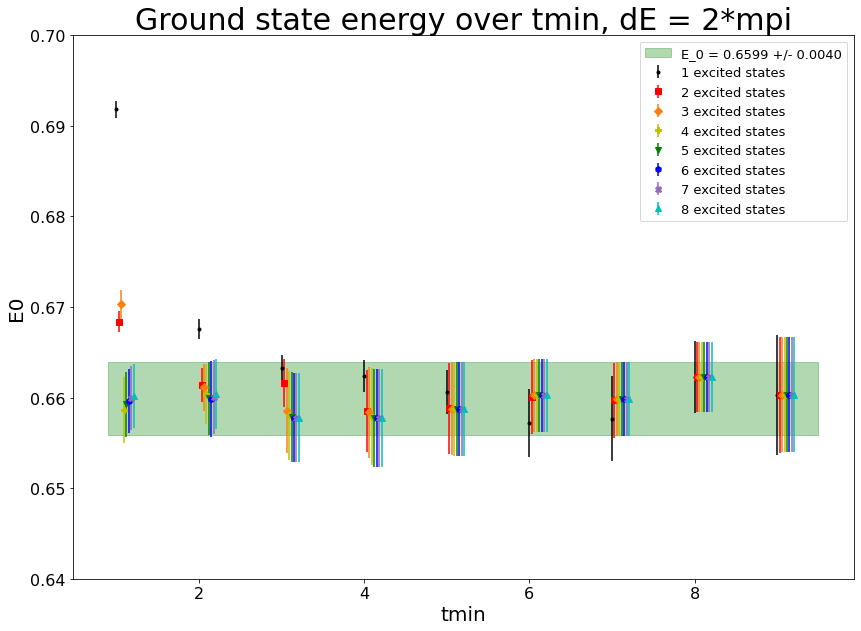

<Figure size 432x288 with 0 Axes>

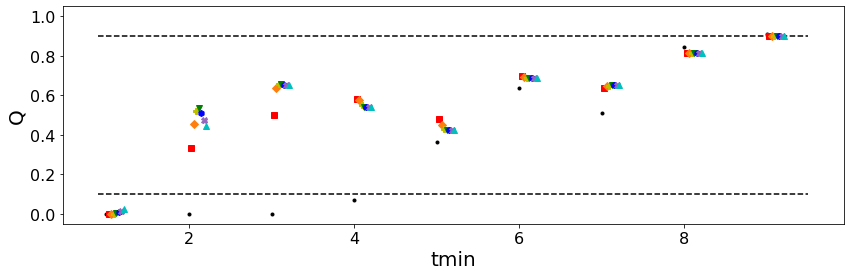

<Figure size 432x288 with 0 Axes>

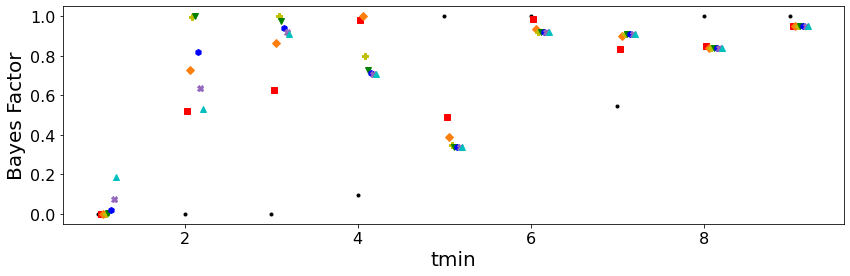

<Figure size 432x288 with 0 Axes>

In [37]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a0[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a0[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[4][1].mean + E0_tmin_bmax_a0[4][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[4][1].mean - E0_tmin_bmax_a0[4][1].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[4][1].mean, E0_tmin_bmax_a0[4][1].sdev))
plt.title("Ground state energy over tmin, dE = 2*mpi", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.ylim(0.64,0.7)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
fig.savefig("E0_tmin_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmin_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmin_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
#plt.figure(figsize=(14,4))
#for i in range(len(BF_tmin_bmax_a0)):
        
    #plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a0[i][k] for k in range(len(tmin))], '.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
#plt.xlabel("tmin")
#plt.ylabel("Bayes Factor (log-plot)")
#plt.ylim(1e-7, 2)
#plt.savefig('logBFa0.png')
#plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

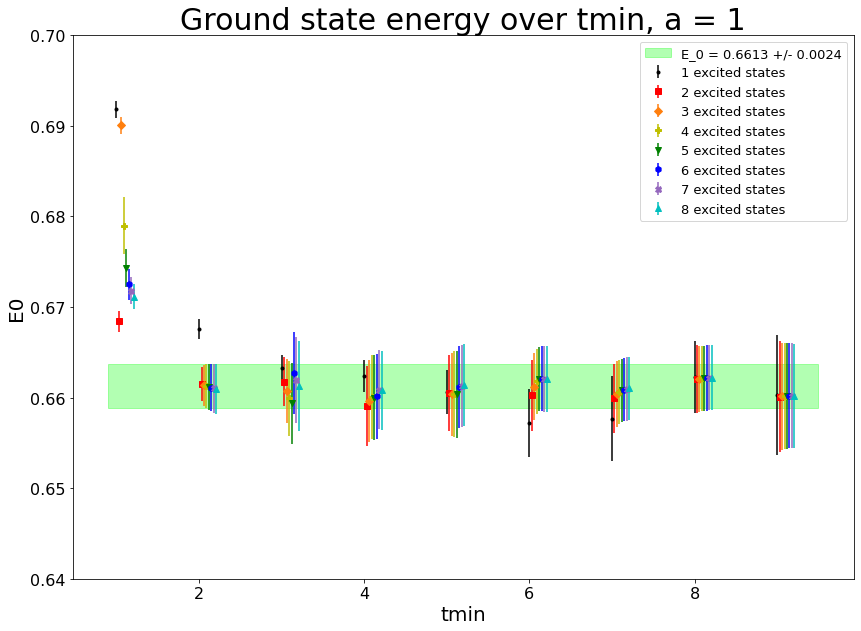

<Figure size 432x288 with 0 Axes>

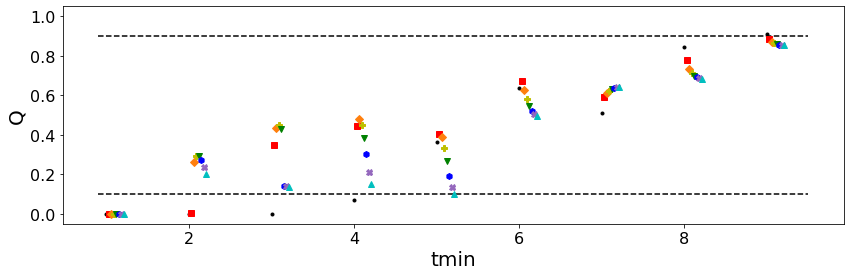

<Figure size 432x288 with 0 Axes>

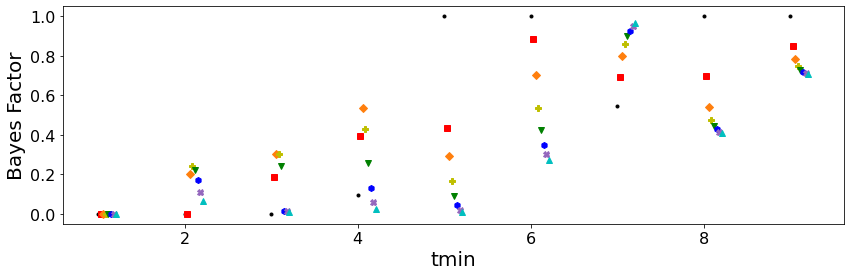

<Figure size 432x288 with 0 Axes>

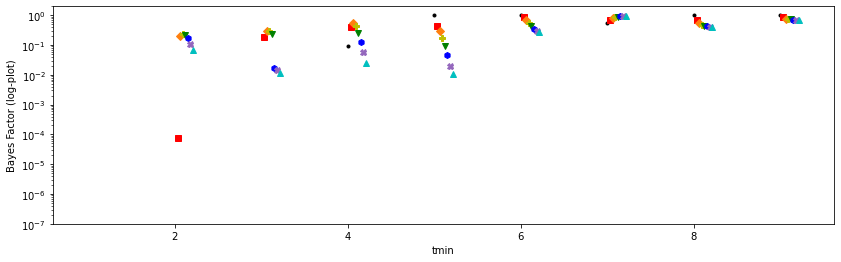

In [38]:
# Make a plot of E0 values vs tmin for a=1 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a1[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a1[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a1[3][1].mean + E0_tmin_bmax_a1[3][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a1[3][1].mean - E0_tmin_bmax_a1[3][1].sdev  for i in tmin_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a1[3][1].mean, E0_tmin_bmax_a1[3][1].sdev))
plt.title("Ground state energy over tmin, a = 1", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_tmin_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmin_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmin_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.show()


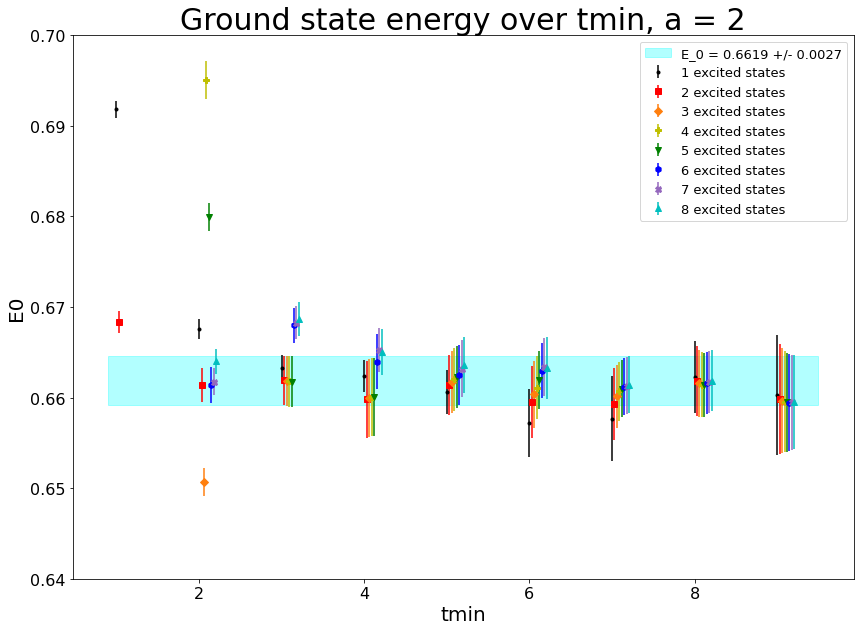

<Figure size 432x288 with 0 Axes>

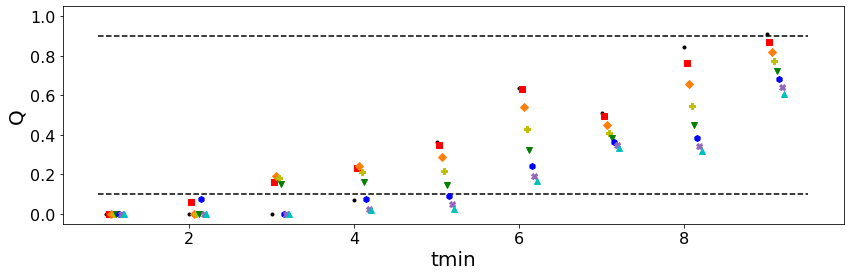

<Figure size 432x288 with 0 Axes>

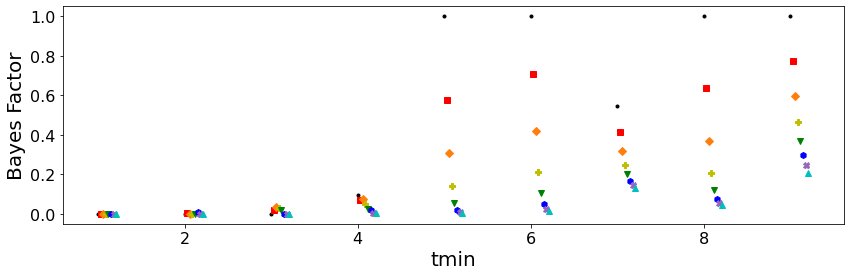

<Figure size 432x288 with 0 Axes>

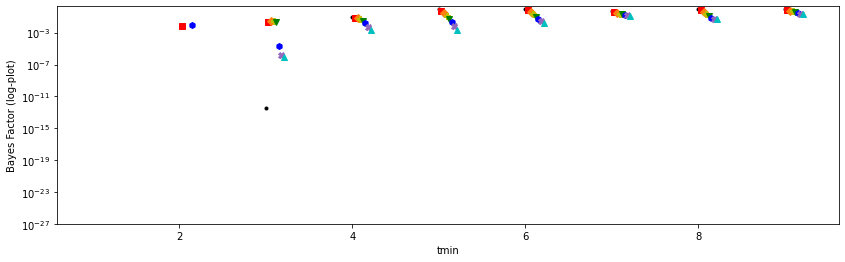

In [39]:
# Make a plot of E0 values vs tmin for a=2 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
    E0_tmin_bmax_a2[i]
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a2[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a2[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a2[1][2].mean + E0_tmin_bmax_a2[1][2].sdev for i in tmin_samp_line], [E0_tmin_bmax_a2[1][2].mean - E0_tmin_bmax_a2[1][2].sdev  for i in tmin_samp_line], color="cyan",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a2[1][2].mean, E0_tmin_bmax_a2[1][2].sdev))
plt.title("Ground state energy over tmin, a = 2", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_tmin_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmin_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmin_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-27, 2)
plt.show()
#print(Q_tmin_bmax_a2[0][4])

### The optimal fit from the tmin chart

Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.33    logGBF = 485.59

Parameters:
             E0       0.661365 +- 0.00186573             [     0.67 +- 0.02 ]  
             Z0   0.000758645 +- 5.90659e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286999 +- 2.82781e-05             [   0.003 +- 0.003 ]  
             Z1   0.000715103 +- 4.22496e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0048995 +- 0.000316983             [       0 +- 0.005 ]  
       log(dE0)       -0.750751 +- 0.0650937             [  -0.97551 +- 0.7 ]  
             Z2    0.00133012 +- 2.27524e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988343 +- 0.000230212             [       0 +- 0.005 ]  *
       log(dE1)       -0.100396 +- 0.0543008             [  -0.97551 +- 0.7 ]  *
             Z3             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde3                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE2)            

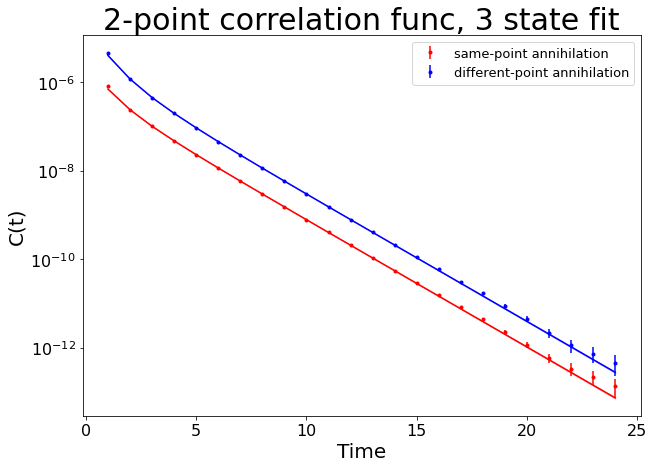

E0 =  0.6613652943416016 +/- 0.0018657347687142112


In [58]:
# Plot the results of the a = 0, k = 2 fit
# Compute function output
#print(b_max_BF_a0[1][1])
for i in range(len(priors)):
    for j in range(len(priors[0])):
        priors[i][j]['E0'] = gv.gvar(0.67, 0.02)

num_zs = 3

fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 13)]), np.array([proton_timeavg[l] for l in range(tmin[1],13)])), prior=priors[a_select_indices[0]][2],fcn=C_2pt,debug=True)
print(fit_a0.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a0.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][0][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][1][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("C(t)", fontsize = 20)
plt.title("2-point correlation func, 3 state fit", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2ptcorrelation_numzs3_oldprior.png')
plt.show()

print("E0 = ", fit_a0.p['E0'].mean, "+/-", fit_a0.p['E0'].sdev)

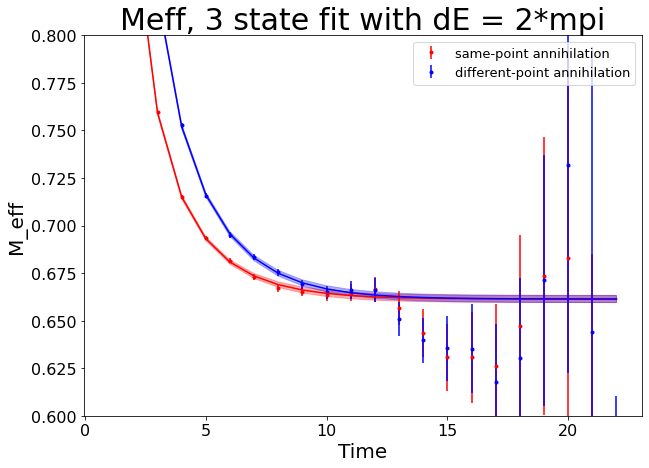

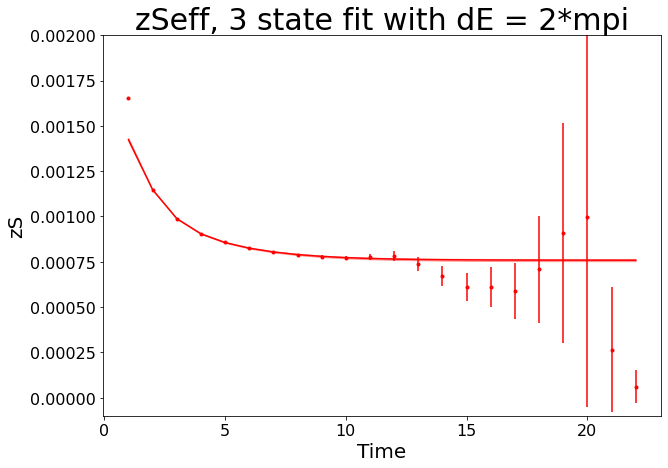

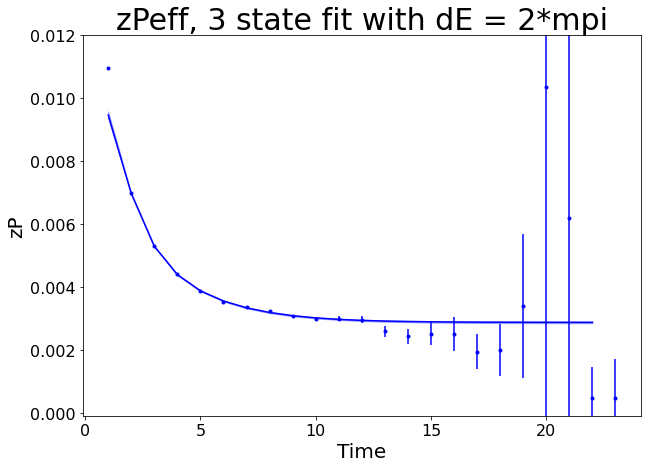

In [57]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time", fontsize = 20)
plt.ylabel("M_eff", fontsize = 20)
plt.ylim(0.6, 0.8)
plt.title("Meff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2pteffmass_numzs3_oldprior.png')
plt.show()


# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([zS_eff[i].mean for i in range(1, 23)]), np.array([zS_eff[i].sdev for i in range(1, 23)]), fmt='.', color = 'red')
ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("zS", fontsize = 20)
plt.ylim(-0.0001, 0.002)
plt.title("zSeff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzs_numzs3_oldprior.png')
plt.show()


model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([zP_eff[i].mean for i in range(1, 24)]), np.array([zP_eff[i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("zP", fontsize = 20)
plt.ylim(-0.0001, 0.012)
plt.title("zPeff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzp_numzs3_oldprior.png')
plt.show()

In [ ]:
# Plot the results of the a = 0, k = 5 fit
# Compute function output


num_zs = 6

fit_a0_b = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 22)]), np.array([proton_timeavg[l] for l in range(tmin[1],22)])), prior=priors[a_select_indices[0]][b_max_BF_a0[1][4]],fcn=C_2pt,debug=True)
print(fit_a0_b.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a0_b.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][0][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][1][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("a = 0 Averaged Correlation functions over time")
plt.legend()
plt.show()

print("E0 = ", fit_a0_b.p['E0'].mean, "+/-", fit_a0_b.p['E0'].sdev)

In [ ]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.8)
plt.title("Effective masses over time for time increment {}, with a = 0, k = 5".format(tau))
plt.legend()
plt.show()

# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([zS_eff[i].mean for i in range(1, 23)]), np.array([zS_eff[i].sdev for i in range(1, 23)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([zP_eff[i].mean for i in range(1, 24)]), np.array([zP_eff[i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

In [213]:
# a = 1, k = 2 and a = 0, k = 2 are essentially redundant.

0.665
1.042
1.2305000000000001
0.665
1.042
1.2305000000000001
0.665
1.042
1.2305000000000001
0.665
1.042
1.2305000000000001
1.330(15)
1.47(16)
1.51(16)
1.330(15)
1.47(16)
1.51(16)
1.330(15)
1.47(16)
1.51(16)
0.665
1.042
1.2305000000000001
0.665(0)
1.042(0)
1.2305(0)
0.7245992763449203
2.6805132659835964
2.7997461755880697
0.724599(0)
2.68051(0)
2.79975(0)
0.7230899128688791
3.895433665373681
20.53665716875743
0.72309(0)
3.89543(0)
20.5367(0)
0.7229936956905152
1.7817155495223618
1.9702155495221056
0.723020702610868
1.7892765260895986
13.398220484910045
0.7261410024050602
3.1048613321510863
19.731467880470564
0.7269223748190926
3.6810358581100484
20.319467265439805
0.726922(0)
3.68104(0)
20.3195(0)
0.7260158592396679
3.47790481994718
20.11510760850562
0.726016(0)
3.4779(0)
20.1151(0)
0.7244413260891933
3.1077650363742126
19.741366700281354
0.724441(0)
3.10777(0)
19.7414(0)
0.7201490049217243
2.7837619165473937
19.413989192634958
0.720149(0)
2.78376(0)
19.414(0)
0.710316171593516
2.25740

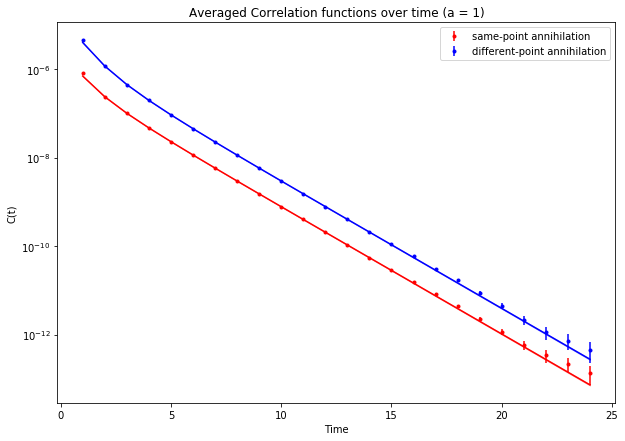

E0 =  0.6615129692085746 +/- 0.0018144537166253625


In [214]:
# Plot the results of the a = 1, k = 2 fit
# Compute function output
num_zs = 3

fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 22)]), np.array([proton_timeavg[l] for l in range(tmin[1],22)])), prior=priors[a_select_indices[1]][b_max_BF_a1[1][1]],fcn=C_2pt,debug=True)
print(fit_a1.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a1.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][0][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][1][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time (a = 1)")
plt.legend()
plt.show()

print("E0 = ", fit_a1.p['E0'].mean, "+/-", fit_a1.p['E0'].sdev)

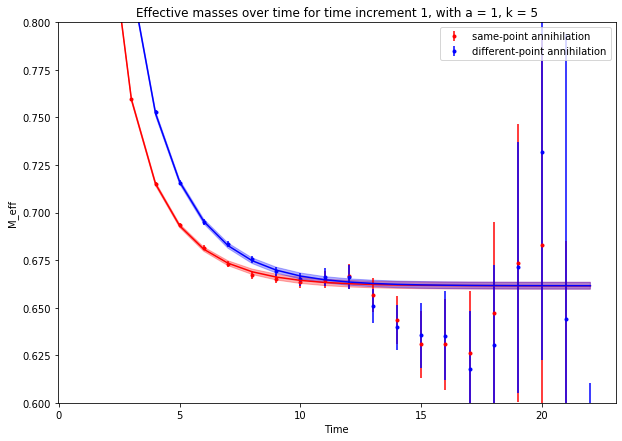

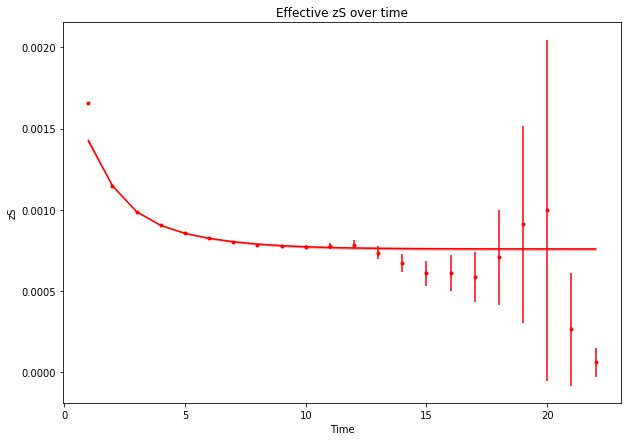

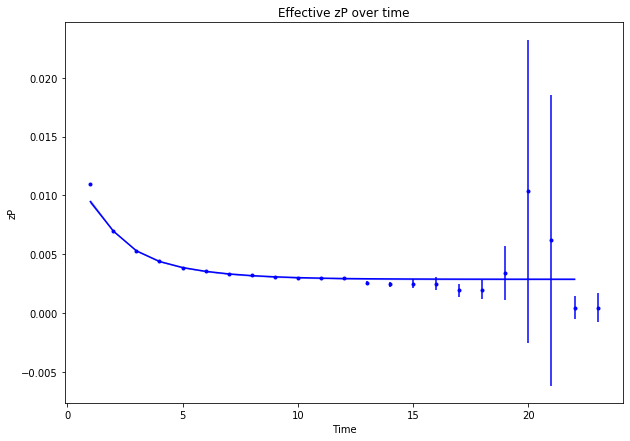

In [215]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.8)
plt.title("Effective masses over time for time increment {}, with a = 1, k = 5".format(tau))
plt.legend()
plt.show()

# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([zS_eff[i].mean for i in range(1, 23)]), np.array([zS_eff[i].sdev for i in range(1, 23)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([zP_eff[i].mean for i in range(1, 24)]), np.array([zP_eff[i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

0.665
1.042
1.13625
0.665
1.042
1.13625
0.665
1.042
1.13625
0.665
1.042
1.13625
1.330(15)
1.47(13)
1.48(13)
1.330(15)
1.47(13)
1.48(13)
1.330(15)
1.47(13)
1.48(13)
0.665
1.042
1.13625
0.665(0)
1.042(0)
1.13625(0)
0.6845315290093268
1.4548286692166954
1.4686691067778255
0.684532(0)
1.45483(0)
1.46867(0)
0.6753869158046644
1.5785204557892225
1.5850758554530548
0.675387(0)
1.57852(0)
1.58508(0)
0.6819711471096401
1.7303313498554103
2.204089213896364
0.681971(0)
1.73033(0)
2.20409(0)
0.6739150428367299
1.3290564911925904
1.4204172740854175
0.6740642478588674
1.3587769328882946
1.8163329827581711
0.6777876469616407
1.6220039585425414
2.094897849867575
0.677788(0)
1.622(0)
2.0949(0)
0.675902552793459
1.6011418224180112
2.0738775558678375
0.675903(0)
1.60114(0)
2.07388(0)
0.675498233752121
1.5781143872252574
2.0505455327391924
0.675498(0)
1.57811(0)
2.05055(0)
0.6744106127477052
1.5307431780445226
2.0020192625325106
0.674411(0)
1.53074(0)
2.00202(0)
0.6723483504723863
1.484176753923524
1.9541

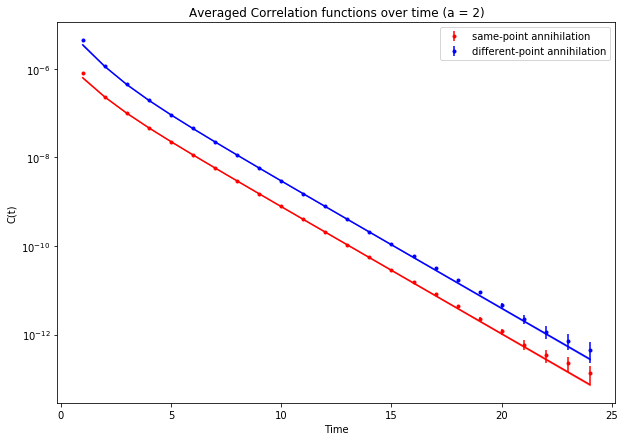

E0 =  0.6612876000254988 +/- 0.002688488010152093


In [216]:
# Plot the results of the a = 2, k = 2 fit
# Compute function output
num_zs = 3

fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[2], 22)]), np.array([proton_timeavg[l] for l in range(tmin[2],22)])), prior=priors[a_select_indices[2]][b_max_BF_a1[2][1]],fcn=C_2pt,debug=True)
print(fit_a2.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a2.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][0][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [proton_timeavg[i][1][0].mean for i in range(1,25)], yerr=[proton_timeavg[i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time (a = 2)")
plt.legend()
plt.show()

print("E0 = ", fit_a2.p['E0'].mean, "+/-", fit_a2.p['E0'].sdev)

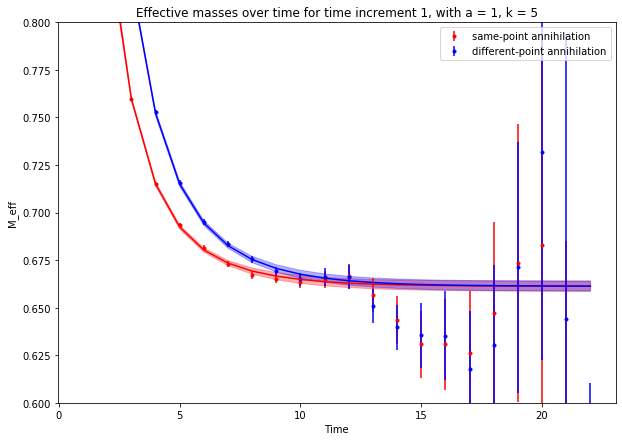

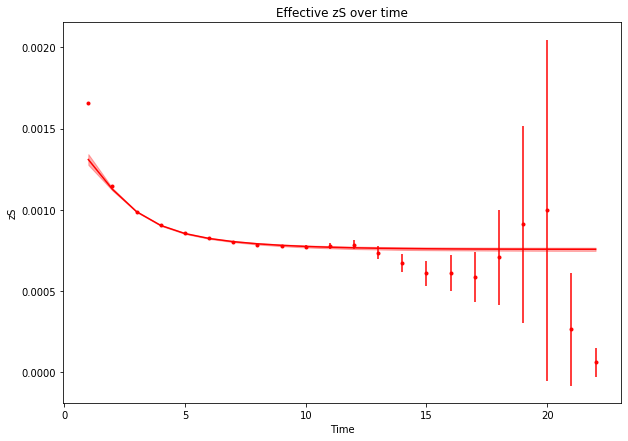

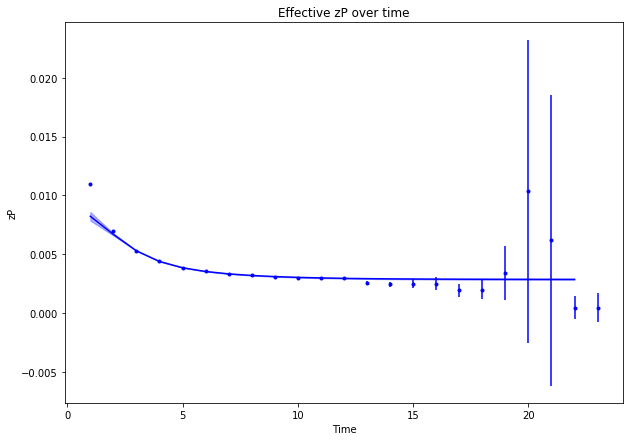

In [217]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.8)
plt.title("Effective masses over time for time increment {}, with a = 1, k = 5".format(tau))
plt.legend()
plt.show()

# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([zS_eff[i].mean for i in range(1, 23)]), np.array([zS_eff[i].sdev for i in range(1, 23)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([zP_eff[i].mean for i in range(1, 24)]), np.array([zP_eff[i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

The constant dE, 5-excited state fit is the one with the highest Bayes factor, but I will instead be choosing the fit that uses 2 excited states and either constant dE or dE~1/(# of excited states), even though its Bayes factor is 10 times less. 4 reasons: (1) Occam's razor, (2) Going off of that, Bayes Factor is vulnerable to overfitting just like frequentist fits (if we assume a Gaussian dataset, which is the case here, the probability distribution peaks are always at the means of the data points, so the highest-likelihood model (which the highest possible Bayes Factor corresponds to) would stick to the mean at every point. But that means overfitting.). The larger number of excited states suggests overfitting. (3) the 2-excited state fit produces a slightly more precise result for E0 than does the 5-excited state one.

In [158]:
# Subtract the results of the first-order fit from the main data
#num_zs = 3
#fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 22)]), np.array([proton_timeavg[l] for l in range(tmin[1],22)])), prior=priors[a_select_indices[0]][b_max_BF_a0[1][1]],fcn=C_2pt,debug=True)
print(fit1.format(pstyle='vv'))
num_zs = 1
y_original_data_fit = C_2pt(np.array([i for i in range(0,26)]), fit1.p)#{'E0':fit_a0.p['E0'], 'Z0':fit_a0.p['Z0'], 'Ztilde0':fit_a0.p['Ztilde0']})

proton_timeavg_exc = np.array([proton_timeavg[i] - y_original_data_fit[i] for i in range(0,26)])

# Effective mass data, excited state
tau = 1
eff_mass_exc = [[np.log(proton_timeavg_exc[t][0][0]/proton_timeavg_exc[t+tau][0][0])/tau for t in range(len(proton_timeavg_exc)-tau)],\
            [np.log(proton_timeavg_exc[t][1][0]/proton_timeavg_exc[t+tau][1][0])/tau for t in range(len(proton_timeavg_exc)-tau)]]

zS_eff_exc = np.array([np.sqrt(np.exp(eff_mass_exc[0][t]*t)*proton_timeavg_exc[t][0][0]) for t in range(len(proton_timeavg_exc)-tau)])
zP_eff_exc = np.array([np.exp(eff_mass_exc[0][t]*t)*proton_timeavg_exc[t][0][0]/zS_eff_exc[t] for t in range(len(proton_timeavg_exc)-tau)])

eff_mass_exc

Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 587.95

Parameters:
             E0      0.664756 +- 0.00302689            [     0.67 +- 0.02 ]  
             Z0   0.000775279 +- 1.0619e-05            [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00294875 +- 4.2447e-05            [   0.003 +- 0.003 ]  

Settings:
  svdcut/n = 1e-12/0    tol = (1e-08,1e-10,1e-10*)    (itns/time = 5/0.0)
  fitter = scipy_least_squares    method = trf



<ipython-input-158-b2b69c1ae952>:12: RuntimeWarning: invalid value encountered in log
  eff_mass_exc = [[np.log(proton_timeavg_exc[t][0][0]/proton_timeavg_exc[t+tau][0][0])/tau for t in range(len(proton_timeavg_exc)-tau)],\
<ipython-input-158-b2b69c1ae952>:13: RuntimeWarning: invalid value encountered in log
  [np.log(proton_timeavg_exc[t][1][0]/proton_timeavg_exc[t+tau][1][0])/tau for t in range(len(proton_timeavg_exc)-tau)]]


[[nan +- 0.0441907,
  1.856(29),
  1.440(39),
  1.345(55),
  1.319(78),
  1.37(12),
  1.54(24),
  1.81(53),
  1.73(76),
  1.2(2.0),
  -0.3(1.6),
  0.7(1.8),
  3(30),
  -3(30),
  -0.6(1.1),
  -0.12(37),
  0.22(22),
  0.31(22),
  0.53(31),
  0.73(56),
  0.8(1.0),
  -0.009(824),
  -0.17(71),
  0.24(36),
  0.53(49)],
 [nan +- 0.0386168,
  1.806(16),
  1.430(21),
  1.320(29),
  1.278(38),
  1.276(50),
  1.319(67),
  1.476(97),
  1.87(23),
  3.6(6.4),
  3(79),
  nan +- 85.1151,
  -0.07(1.99),
  nan +- 4.02465,
  -0.52(75),
  0.06(28),
  0.28(22),
  0.24(21),
  0.43(23),
  0.71(43),
  1.2(1.5),
  0.5(1.1),
  -0.4(1.6),
  0.14(52),
  0.49(60)]]

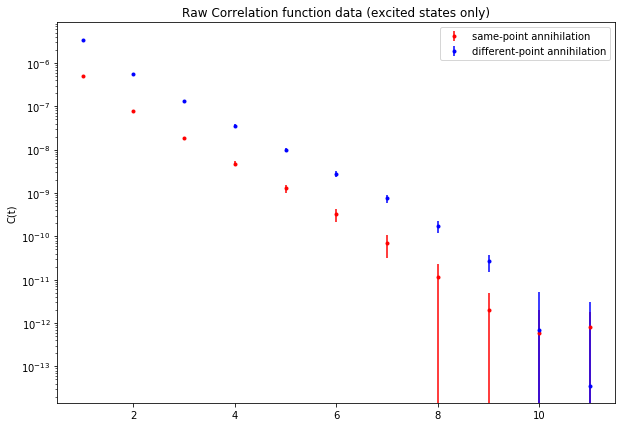

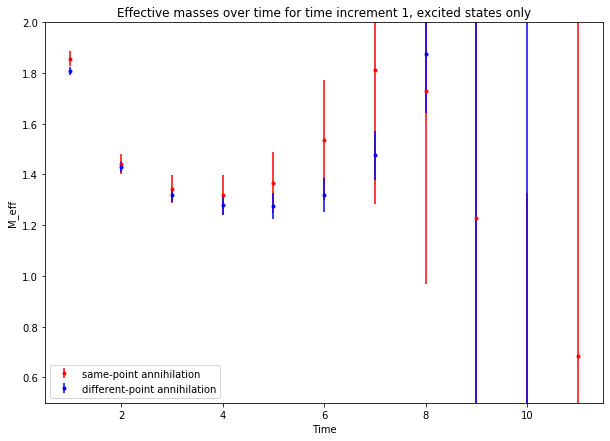

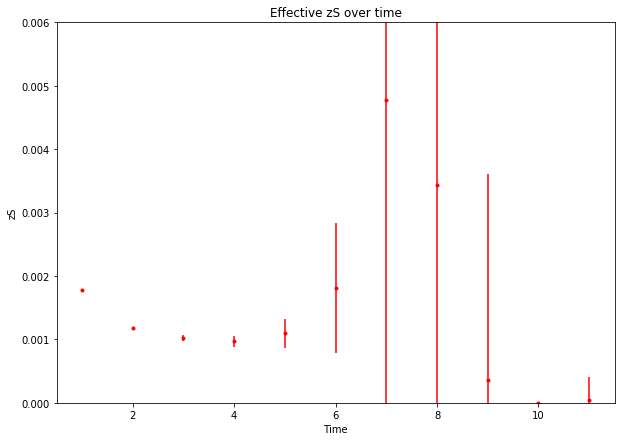

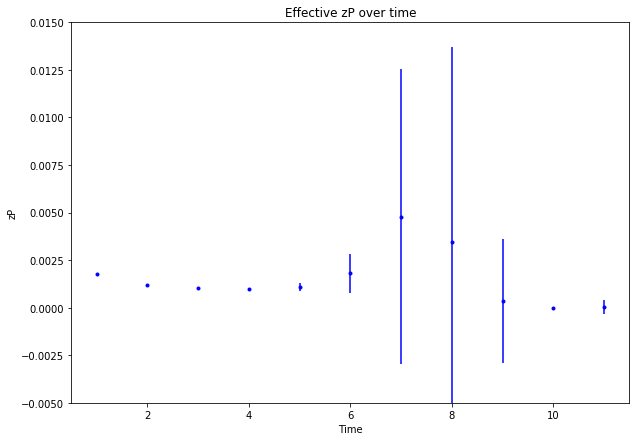

In [159]:
# Plot the first-order fit


# Plot Correlation function and effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][0][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][0][0].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][1][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][1][0].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color='blue')

plt.ylabel("C(t)")
plt.title("Raw Correlation function data (excited states only)")
plt.legend()
plt.show()


# Plot effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_exc[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_exc[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_exc[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_exc[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")



plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.5, 2)
plt.title("Effective masses over time for time increment {}, excited states only".format(tau))
plt.legend()
plt.show()

# Plot effective mass
#fig = plt.figure(figsize=(10,7))
#ax = plt.axes()
#ax.errorbar(np.array([i for i in range(7,13)]), np.array([eff_mass[0][i].mean for i in range(7,13)]), yerr=np.array([eff_mass[0][i].sdev for i in range(7,13)]), fmt='.', label="same-point annihilation", color="red")
#ax.errorbar(np.array([i for i in range(7,13)]), np.array([eff_mass[1][i].mean for i in range(7,13)]), yerr=np.array([eff_mass[1][i].sdev for i in range(7,13)]), fmt='.', label="different-point annihilation", color="blue")

#plt.xlabel("Time")
#plt.ylabel("M_eff")
##plt.ylim(0.4, 1.4)
#plt.title("Effective masses over time, with ground state".format(tau))
#plt.legend()
#plt.show()




# Plot effective zS

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zS_eff_exc[i].mean for i in range(t_min_plt,12)]), np.array([zS_eff_exc[i].sdev for i in range(t_min_plt,12)]), fmt='.', color = 'red')


plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.ylim(0, 0.006)
plt.show()


fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zP_eff_exc[i].mean for i in range(t_min_plt,12)]), np.array([zP_eff_exc[i].sdev for i in range(t_min_plt,12)]), fmt='.', color="blue")


plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.ylim(-0.005, 0.015)
plt.show()

In [160]:
# From these, find priors to the excited state energy
p_exc = gv.BufferDict()
p_exc['E0'] = gv.gvar(1.4, 0.2)
p_exc['Z0'] = gv.gvar(0.0012, 0.006)
p_exc['Ztilde0'] = gv.gvar(0.006, 0.006)

#p_exc['E0'] = gv.gvar(1.15, 0.15)
#p_exc['Z0'] = gv.gvar(0.0007, 0.0002)
#p_exc['Ztilde0'] = gv.gvar(0.009, 0.003)

#p_exc['log(E1)'] = priors[a_select_indices[0]][b_max_BF_a0[1][1]]['log(E2)']
#p_exc['Z1'] = gv.gvar(0.0007, 0.0004)
#p_exc['Ztilde1'] = gv.gvar(0, 0.015)

#p_exc['E1']

Least Square Fit:
  chi2/dof [dof] = 1.4 [6]    Q = 0.21    logGBF = 117.65

Parameters:
             E0         1.26053 +- 0.0170516             [      1.4 +- 0.2 ]  
             Z0   0.000901595 +- 1.73645e-05             [ 0.0012 +- 0.006 ]  
        Ztilde0    0.00643277 +- 0.000169581             [  0.006 +- 0.006 ]  

Settings:
  svdcut/n = 1e-12/0    tol = (1e-08,1e-10,1e-10*)    (itns/time = 7/0.0)
  fitter = scipy_least_squares    method = trf



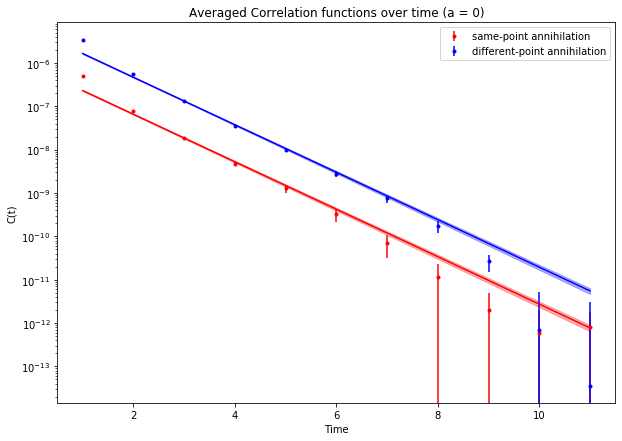

E0 =  1.2605257822402613 +/- 0.01705159059384126


In [161]:
# Do the first-order state for the 
num_zs = 1

fit_exc = lsqfit.nonlinear_fit(data=(np.array([l for l in range(4, 7)]), np.array([proton_timeavg_exc[l] for l in range(4, 7)])), prior=p_exc, fcn=C_2pt, debug=True)
print(fit_exc.format(pstyle='vv'))
y_sample_exc = C_2pt(np.array([i for i in range(0,26)]), fit_exc.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][0][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][0][0].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][1][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][1][0].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,12)],[y_sample_exc[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[y_sample_exc[i][0][0].mean + y_sample_exc[i][0][0].sdev for i in range(1,12)], [y_sample_exc[i][0][0].mean - y_sample_exc[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[y_sample_exc[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[y_sample_exc[i][1][0].mean + y_sample_exc[i][1][0].sdev for i in range(1,12)], [y_sample_exc[i][1][0].mean - y_sample_exc[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time (a = 0)")
plt.legend()
plt.show()

print("E0 = ", fit_exc.p['E0'].mean, "+/-", fit_exc.p['E0'].sdev)

In [162]:
fit1.y

array([[[7.803(58)e-10],
        [2.966(21)e-09]],

       [[4.019(38)e-10],
        [1.525(14)e-09]],

       [[2.067(25)e-10],
        [7.837(91)e-10]],

       [[1.062(17)e-10],
        [4.026(63)e-10]],

       [[5.50(12)e-11],
        [2.100(45)e-10]],

       [[2.893(89)e-11],
        [1.108(32)e-10]],

       [[1.540(65)e-11],
        [5.87(23)e-11]],

       [[8.19(48)e-12],
        [3.11(17)e-11]],

       [[4.38(35)e-12],
        [1.68(12)e-11]],

       [[2.29(25)e-12],
        [8.92(90)e-12]],

       [[1.17(19)e-12],
        [4.56(66)e-12]]], dtype=object)

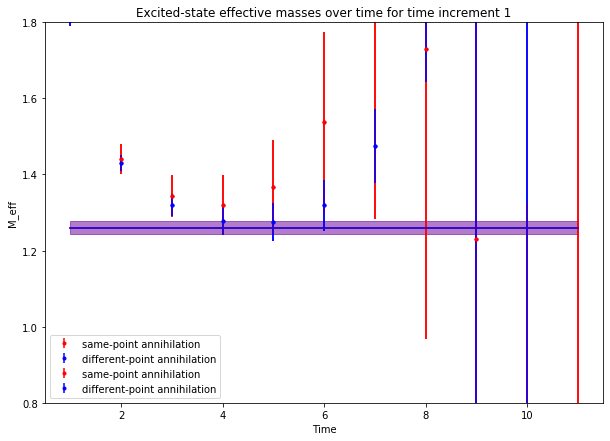

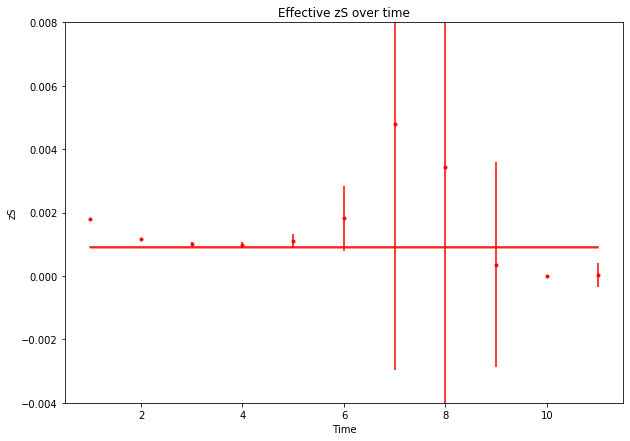

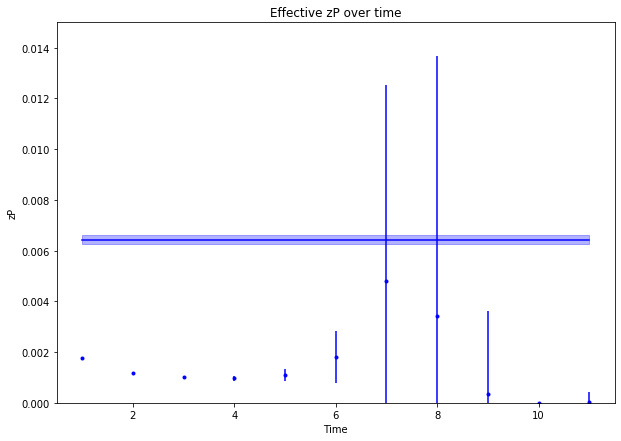

In [163]:
model_eff_mass_exc = np.array([np.log(y_sample_exc[i]/y_sample_exc[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 12)]), np.array([eff_mass_exc[0][i].mean for i in range(1, 12)]), yerr=np.array([eff_mass_exc[0][i].sdev for i in range(1, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(1, 12)]), np.array([eff_mass_exc[1][i].mean for i in range(1, 12)]), yerr=np.array([eff_mass_exc[1][i].sdev for i in range(1, 12)]), fmt='.', label="different-point annihilation", color="blue")


ax.errorbar([i for i in range(1,12)], [eff_mass_exc[0][i].mean for i in range(1,12)], yerr=[eff_mass_exc[0][i].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,12)], [eff_mass_exc[1][i].mean for i in range(1,12)], yerr=[eff_mass_exc[1][i].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,12)],[model_eff_mass_exc[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[model_eff_mass_exc[i][0][0].mean + model_eff_mass_exc[i][0][0].sdev for i in range(1,12)], [model_eff_mass_exc[i][0][0].mean - model_eff_mass_exc[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[model_eff_mass_exc[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[model_eff_mass_exc[i][1][0].mean + model_eff_mass_exc[i][1][0].sdev for i in range(1,12)], [model_eff_mass_exc[i][1][0].mean - model_eff_mass_exc[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.8, 1.8)
plt.title("Excited-state effective masses over time for time increment {}".format(tau))
plt.legend()
plt.savefig("E1_posterior.png")
plt.show()


# Plot effective zSS
model_zS_eff_exc = np.array([np.sqrt(np.exp(model_eff_mass_exc[t][0][0]*t)*y_sample_exc[t][0][0]) for t in range(0, 24)])

#y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1,12)]), np.array([zS_eff_exc[i].mean for i in range(1,12)]), np.array([zS_eff_exc[i].sdev for i in range(1,12)]), fmt='.', color = 'red')


ax.errorbar([i for i in range(1,12)],[model_zS_eff_exc[i].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[model_zS_eff_exc[i].mean + model_zS_eff_exc[i].sdev for i in range(1,12)], [model_zS_eff_exc[i].mean - model_zS_eff_exc[i].sdev for i in range(1,12)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.ylim(-0.004, 0.008)
plt.title("Effective zS over time")
plt.show()

model_zP_eff_exc = np.array([np.exp(model_eff_mass_exc[t][1][0]*t)*y_sample_exc[t][1][0]/model_zS_eff_exc[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1,12)]), np.array([zP_eff_exc[i].mean for i in range(1,12)]), np.array([zP_eff_exc[i].sdev for i in range(1,12)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,12)],[model_zP_eff_exc[i].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[model_zP_eff_exc[i].mean + model_zP_eff_exc[i].sdev for i in range(1,12)], [model_zP_eff_exc[i].mean - model_zP_eff_exc[i].sdev for i in range(1,12)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.ylim(0, 0.015)
plt.title("Effective zP over time")
plt.show()



<ipython-input-164-2bebc2b441d8>:3: RuntimeWarning: invalid value encountered in log
  eff_mass_exc2 = [[np.log(proton_timeavg_exc2[t][0][0]/proton_timeavg_exc2[t+tau][0][0])/tau for t in range(len(proton_timeavg_exc2)-tau)],\
<ipython-input-164-2bebc2b441d8>:4: RuntimeWarning: invalid value encountered in log
  [np.log(proton_timeavg_exc2[t][1][0]/proton_timeavg_exc2[t+tau][1][0])/tau for t in range(len(proton_timeavg_exc2)-tau)]]
<ipython-input-164-2bebc2b441d8>:6: RuntimeWarning: invalid value encountered in sqrt
  zS_eff_exc2 = np.array([np.sqrt(np.exp(eff_mass_exc2[0][t]*t)*proton_timeavg_exc2[t][0][0]) for t in range(len(proton_timeavg_exc2)-tau)])


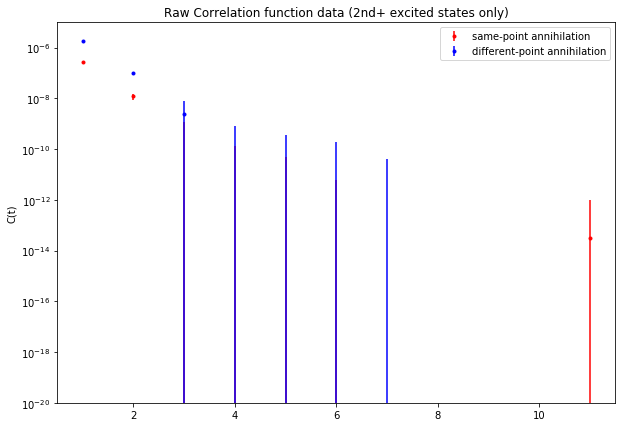

In [164]:
# subtract to the second excited state
proton_timeavg_exc2 = np.array([proton_timeavg_exc[i] - y_sample_exc[i] for i in range(0,26)])
eff_mass_exc2 = [[np.log(proton_timeavg_exc2[t][0][0]/proton_timeavg_exc2[t+tau][0][0])/tau for t in range(len(proton_timeavg_exc2)-tau)],\
            [np.log(proton_timeavg_exc2[t][1][0]/proton_timeavg_exc2[t+tau][1][0])/tau for t in range(len(proton_timeavg_exc2)-tau)]]

zS_eff_exc2 = np.array([np.sqrt(np.exp(eff_mass_exc2[0][t]*t)*proton_timeavg_exc2[t][0][0]) for t in range(len(proton_timeavg_exc2)-tau)])
zP_eff_exc2 = np.array([np.exp(eff_mass_exc2[1][t]*t)*proton_timeavg_exc2[t][1][0]/zS_eff_exc2[t] for t in range(len(proton_timeavg_exc2)-tau)])



# plot the result, effective mass, effective zS, and effective zP
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc2[i][0][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc2[i][0][0].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc2[i][1][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc2[i][1][0].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color='blue')
plt.ylim(1e-20, 1e-5)
plt.ylabel("C(t)")
plt.title("Raw Correlation function data (2nd+ excited states only)")
plt.legend()
plt.show()



In [165]:
zP_eff_exc2

array([nan +- nan, 0.01365(28), nan +- nan, nan +- nan, nan +- nan,
       nan +- nan, nan +- nan, nan +- nan, nan +- nan, nan +- nan,
       nan +- nan, -2100(370615), nan +- nan, nan +- nan, 1.2(8.1)e-07,
       0.000024(69), 0.00006(14), 0.000013(32), 0.00005(13), 0.0017(66),
       15(309), 0.02(38), 3(89)e-10, 1(11)e-06, 0.0002(14)], dtype=object)

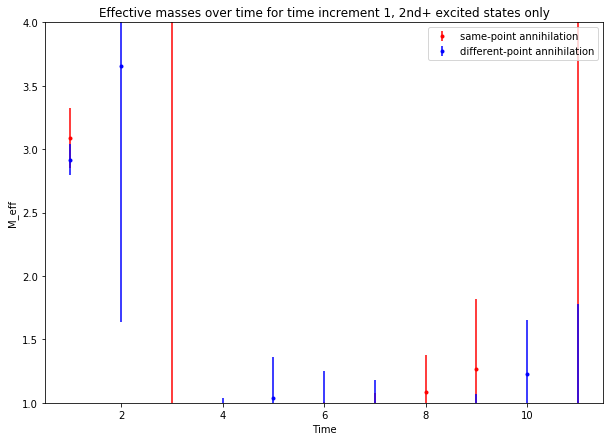

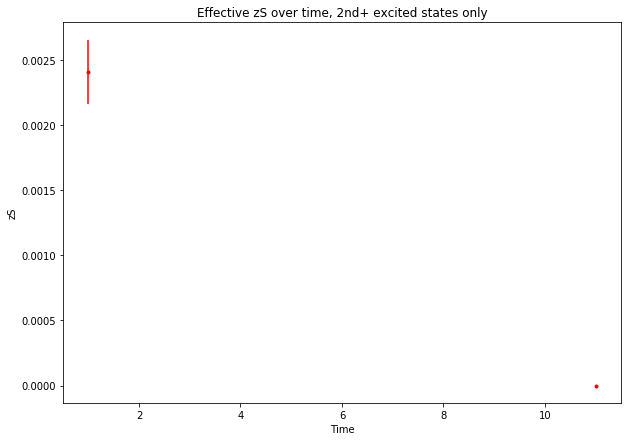

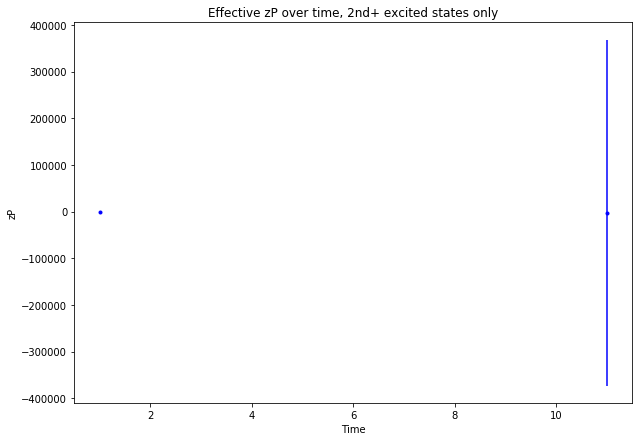

In [166]:
# Plot effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_exc2[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_exc2[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_exc2[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_exc2[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")



plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(1, 4)
plt.title("Effective masses over time for time increment {}, 2nd+ excited states only".format(tau))
plt.legend()
plt.savefig("E2_posterior.png")
plt.show()


# Plot effective zS

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zS_eff_exc2[i].mean for i in range(t_min_plt,12)]), np.array([zS_eff_exc2[i].sdev for i in range(t_min_plt,12)]), fmt='.', color = 'red')


plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time, 2nd+ excited states only")
#plt.ylim(0, 0.0005)
plt.show()


fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zP_eff_exc2[i].mean for i in range(t_min_plt,12)]), np.array([zP_eff_exc2[i].sdev for i in range(t_min_plt,12)]), fmt='.', color="blue")


plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time, 2nd+ excited states only")
#plt.ylim(0, 0.005)
plt.show()

So, I've done all I can do by subtracting out states, so I will just redo the 2-excited-state fit with priors based on the first and second excited state data.

In [167]:
num_zs = 3
priors_2pt_adjusted = gv.BufferDict()
priors_2pt_adjusted['E0'] = gv.gvar(0.665, 0.015)
priors_2pt_adjusted['Z0'] = gv.gvar(0.0008, 0.0003)
priors_2pt_adjusted['Ztilde0'] = gv.gvar(0.003, 0.002)

#p_exc['E0'] = gv.gvar(1.4, 0.25)
#p_exc['Z0'] = gv.gvar(0.0012, 0.0005)
#p_exc['Ztilde0'] = gv.gvar(0.006, 0.005)

priors_2pt_adjusted['E1'] = gv.gvar(1.4, 0.2)
priors_2pt_adjusted['Z1'] = gv.gvar(0.0012, 0.0006)
priors_2pt_adjusted['Ztilde1'] = gv.gvar(0.006, 0.005)

priors_2pt_adjusted['E2'] = gv.gvar(3, 2)
priors_2pt_adjusted['Z2'] = gv.gvar(0.0007, 0.0006)
priors_2pt_adjusted['Ztilde2'] = gv.gvar(0, 0.015)

#priors_2pt_adjusted['E1'] = gv.gvar(1.15, 0.15)
#priors_2pt_adjusted['Z1'] = gv.gvar(0.0007, 0.0002)
#priors_2pt_adjusted['Ztilde1'] = gv.gvar(0.009, 0.003)

#priors_2pt_adjusted['log(E2)'] = priors[a_select_indices[0]][b_max_BF_a0[1][1]]['log(E2)']
#priors_2pt_adjusted['Z2'] = gv.gvar(0.0007, 0.0004)
#priors_2pt_adjusted['Ztilde2'] = gv.gvar(0, 0.015)

#gv.gvar(0.0007, 0.0004)
#gv.gvar(0, 0.015)

#gv.gvar(0.0008, 0.0004)
#gv.gvar(0, 0.005)

final_fit = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2,22)]), np.array([proton_timeavg[l] for l in range(2, 22)])), prior=priors_2pt_adjusted, fcn=C_2pt, debug=True)
print(final_fit.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,t_max_plt+1)]), final_fit.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [proton_timeavg[i][0][0].mean for i in range(t_min_plt,t_max_plt)], yerr=[proton_timeavg[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [proton_timeavg[i][1][0].mean for i in range(t_min_plt,t_max_plt)], yerr=[proton_timeavg[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[y_sample[i][0][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[y_sample[i][1][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time")
plt.legend()
plt.show()

print("E0 = ", final_fit.p['E0'].mean, "+/-", final_fit.p['E0'].sdev)

KeyError: 'undefined key: dE0'

In [ ]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,t_max_plt)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [eff_mass[0][i].mean for i in range(t_min_plt,t_max_plt)], yerr=[eff_mass[0][i].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [eff_mass[1][i].mean for i in range(t_min_plt,t_max_plt)], yerr=[eff_mass[1][i].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][0][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][1][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.8)
plt.title("Effective masses over time for time increment {}".format(tau))
plt.legend()
plt.show()

# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0,t_max_plt)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0,t_max_plt)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

### Now, try the sum-subtraction procedure again, but this time, make the fit to the first order energies a log-normal distriution
This includes adding in an effective log-mass plot, shown below:

In [168]:
log_eff_mass_exc = np.log(eff_mass_exc)

<ipython-input-168-2cd0fb5f3505>:1: RuntimeWarning: invalid value encountered in log
  log_eff_mass_exc = np.log(eff_mass_exc)


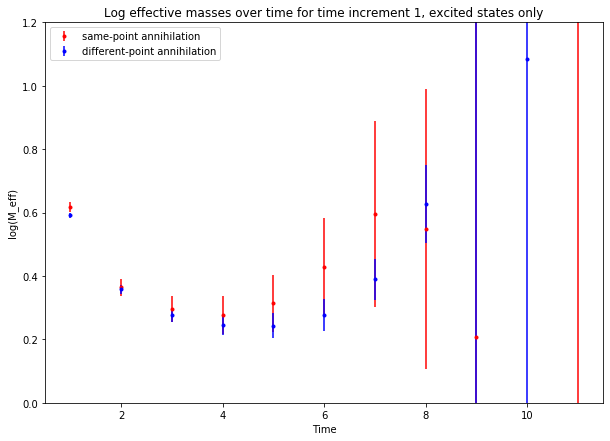

In [169]:
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_exc[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_exc[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_exc[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_exc[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")


plt.xlabel("Time")
plt.ylabel("log(M_eff)")
plt.ylim(0, 1.2)
plt.title("Log effective masses over time for time increment {}, excited states only".format(tau))
plt.legend()
plt.show()

In [170]:
# Set the priors of the first excited state again
p_exc_log = gv.BufferDict()
p_exc_log['log(E0)'] = gv.gvar(0.4, 0.22)
p_exc_log['Z0'] = gv.gvar(0.0012, 0.006)
p_exc_log['Ztilde0'] = gv.gvar(0.006, 0.005)

Least Square Fit:
  chi2/dof [dof] = 1.4 [6]    Q = 0.2    logGBF = 117.46

Parameters:
        log(E0)        0.231342 +- 0.0135438             [         0.4 +- 0.22 ]  
             Z0   0.000901427 +- 1.73634e-05             [     0.0012 +- 0.006 ]  
        Ztilde0    0.00643053 +- 0.000169648             [      0.006 +- 0.005 ]  
--------------------------------------------------------------------------------
             E0         1.26029 +- 0.0170691             [ 1.49182 +- 0.328201 ]  

Settings:
  svdcut/n = 1e-12/0    tol = (1e-08,1e-10,1e-10*)    (itns/time = 8/0.0)
  fitter = scipy_least_squares    method = trf



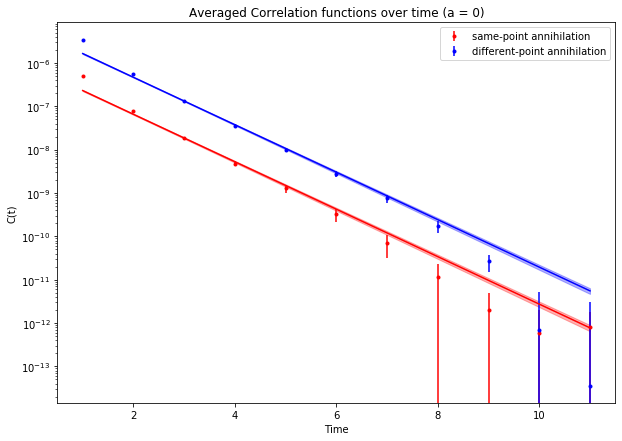

E0 =  1.2602903057073915 +/- 0.017069144613380514


In [171]:
num_zs = 1

fit_exc_log = lsqfit.nonlinear_fit(data=(np.array([l for l in range(4, 7)]), np.array([proton_timeavg_exc[l] for l in range(4, 7)])), prior=p_exc_log, fcn=C_2pt, debug=True)
print(fit_exc_log.format(pstyle='vv'))
y_sample_exc_log = C_2pt(np.array([i for i in range(0,26)]), fit_exc_log.p)

# Plot
fig = plt.figure(figsize=(10,7))

ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][0][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][0][0].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,12)], [proton_timeavg_exc[i][1][0].mean for i in range(1,12)], yerr=[proton_timeavg_exc[i][1][0].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,12)],[y_sample_exc_log[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[y_sample_exc_log[i][0][0].mean + y_sample_exc_log[i][0][0].sdev for i in range(1,12)], [y_sample_exc_log[i][0][0].mean - y_sample_exc_log[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[y_sample_exc_log[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[y_sample_exc_log[i][1][0].mean + y_sample_exc_log[i][1][0].sdev for i in range(1,12)], [y_sample_exc_log[i][1][0].mean - y_sample_exc_log[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time (a = 0)")
plt.legend()
plt.show()

print("E0 = ", fit_exc_log.p['E0'].mean, "+/-", fit_exc_log.p['E0'].sdev)

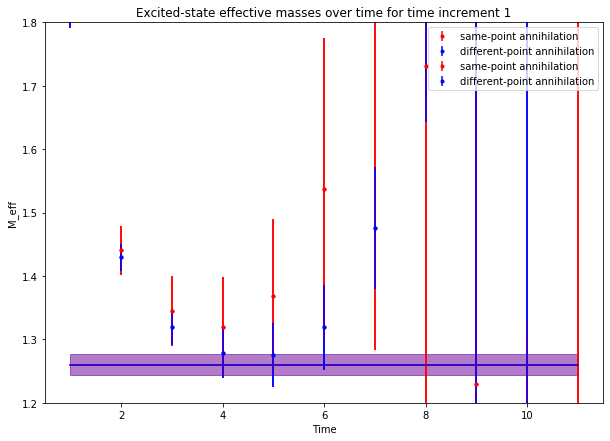

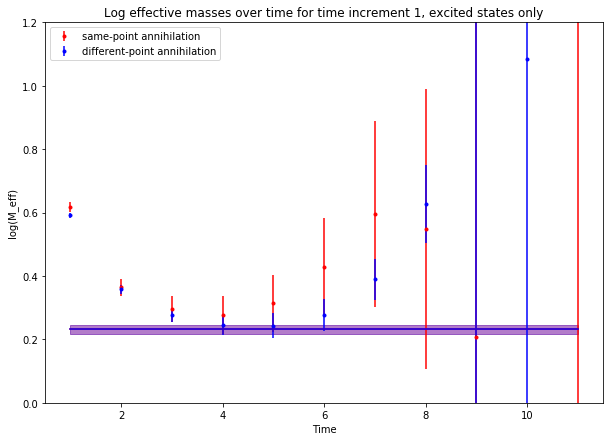

In [172]:
# Plot effective mass
logmodel_eff_mass_exc = np.array([np.log(y_sample_exc_log[i]/y_sample_exc_log[i+1]) for i in range(0,24)])
logmodel_log_eff_mass_exc = np.log(logmodel_eff_mass_exc)

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 12)]), np.array([eff_mass_exc[0][i].mean for i in range(1, 12)]), yerr=np.array([eff_mass_exc[0][i].sdev for i in range(1, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(1, 12)]), np.array([eff_mass_exc[1][i].mean for i in range(1, 12)]), yerr=np.array([eff_mass_exc[1][i].sdev for i in range(1, 12)]), fmt='.', label="different-point annihilation", color="blue")


ax.errorbar([i for i in range(1,12)], [eff_mass_exc[0][i].mean for i in range(1,12)], yerr=[eff_mass_exc[0][i].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,12)], [eff_mass_exc[1][i].mean for i in range(1,12)], yerr=[eff_mass_exc[1][i].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,12)],[logmodel_eff_mass_exc[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[logmodel_eff_mass_exc[i][0][0].mean + logmodel_eff_mass_exc[i][0][0].sdev for i in range(1,12)], [model_eff_mass_exc[i][0][0].mean - model_eff_mass_exc[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[logmodel_eff_mass_exc[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[logmodel_eff_mass_exc[i][1][0].mean + logmodel_eff_mass_exc[i][1][0].sdev for i in range(1,12)], [model_eff_mass_exc[i][1][0].mean - model_eff_mass_exc[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(1.2, 1.8)
plt.title("Excited-state effective masses over time for time increment {}".format(tau))
plt.legend()
plt.show()

# Plot log of effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_exc[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_exc[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_exc[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_exc[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,12)],[logmodel_log_eff_mass_exc[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[logmodel_log_eff_mass_exc[i][0][0].mean + logmodel_log_eff_mass_exc[i][0][0].sdev for i in range(1,12)], [logmodel_log_eff_mass_exc[i][0][0].mean - logmodel_log_eff_mass_exc[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[logmodel_log_eff_mass_exc[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[logmodel_log_eff_mass_exc[i][1][0].mean + logmodel_log_eff_mass_exc[i][1][0].sdev for i in range(1,12)], [logmodel_log_eff_mass_exc[i][1][0].mean - logmodel_log_eff_mass_exc[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("log(M_eff)")
plt.ylim(0, 1.2)
plt.title("Log effective masses over time for time increment {}, excited states only".format(tau))
plt.legend()
plt.show()



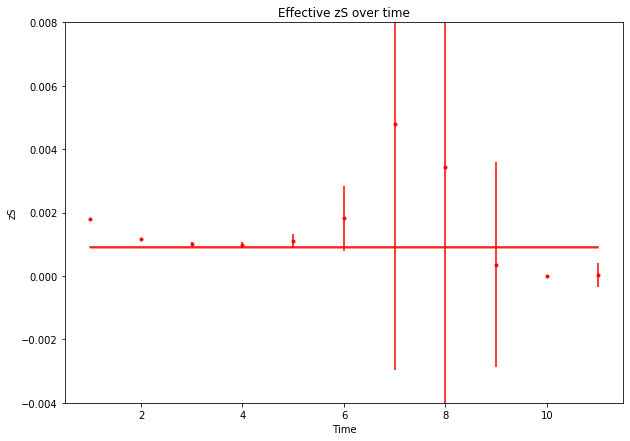

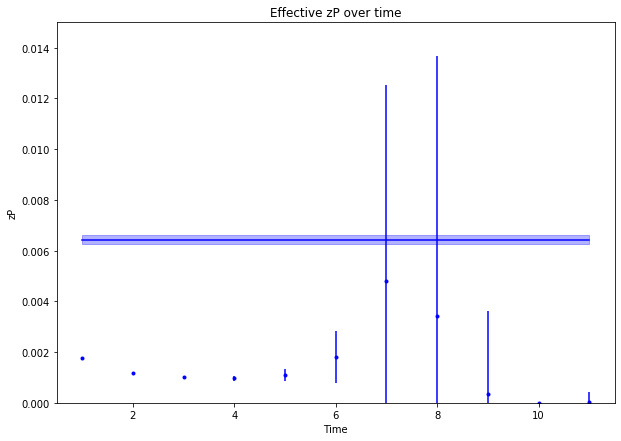

In [173]:
# Plot effective zSS
logmodel_zS_eff_exc = np.array([np.sqrt(np.exp(logmodel_eff_mass_exc[t][0][0]*t)*y_sample_exc_log[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1,12)]), np.array([zS_eff_exc[i].mean for i in range(1,12)]), np.array([zS_eff_exc[i].sdev for i in range(1,12)]), fmt='.', color = 'red')


ax.errorbar([i for i in range(1,12)],[logmodel_zS_eff_exc[i].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[logmodel_zS_eff_exc[i].mean + logmodel_zS_eff_exc[i].sdev for i in range(1,12)], [logmodel_zS_eff_exc[i].mean - logmodel_zS_eff_exc[i].sdev for i in range(1,12)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.ylim(-0.004, 0.008)
plt.title("Effective zS over time")
plt.show()

logmodel_zP_eff_exc = np.array([np.exp(logmodel_eff_mass_exc[t][1][0]*t)*y_sample_exc_log[t][1][0]/logmodel_zS_eff_exc[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1,12)]), np.array([zP_eff_exc[i].mean for i in range(1,12)]), np.array([zP_eff_exc[i].sdev for i in range(1,12)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,12)],[logmodel_zP_eff_exc[i].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[logmodel_zP_eff_exc[i].mean + logmodel_zP_eff_exc[i].sdev for i in range(1,12)], [logmodel_zP_eff_exc[i].mean - logmodel_zP_eff_exc[i].sdev for i in range(1,12)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.ylim(0, 0.015)
plt.title("Effective zP over time")
plt.show()



<ipython-input-174-0606b8a169e3>:3: RuntimeWarning: invalid value encountered in log
  eff_mass_logexc2 = [[np.log(proton_timeavg_logexc2[t][0][0]/proton_timeavg_logexc2[t+tau][0][0])/tau for t in range(len(proton_timeavg_logexc2)-tau)],\
<ipython-input-174-0606b8a169e3>:4: RuntimeWarning: invalid value encountered in log
  [np.log(proton_timeavg_logexc2[t][1][0]/proton_timeavg_logexc2[t+tau][1][0])/tau for t in range(len(proton_timeavg_logexc2)-tau)]]
<ipython-input-174-0606b8a169e3>:5: RuntimeWarning: invalid value encountered in log
  log_eff_mass_logexc2 = np.log(eff_mass_logexc2)
<ipython-input-174-0606b8a169e3>:6: RuntimeWarning: invalid value encountered in sqrt
  zS_eff_logexc2 = np.array([np.sqrt(np.exp(eff_mass_logexc2[0][t]*t)*proton_timeavg_logexc2[t][0][0]) for t in range(len(proton_timeavg_logexc2)-tau)])


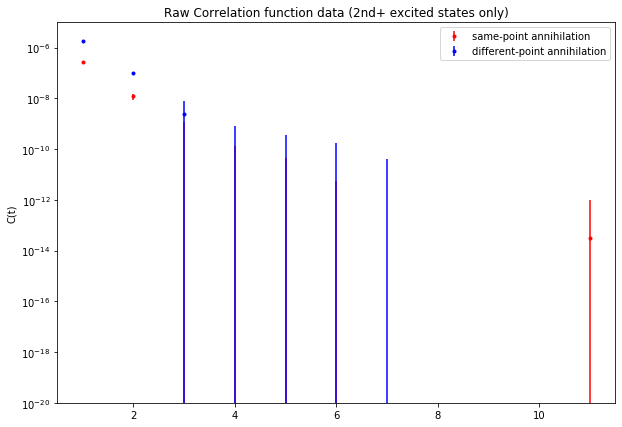

In [174]:
proton_timeavg_logexc2 = np.array([proton_timeavg_exc[i] - y_sample_exc_log[i] for i in range(0,26)])

eff_mass_logexc2 = [[np.log(proton_timeavg_logexc2[t][0][0]/proton_timeavg_logexc2[t+tau][0][0])/tau for t in range(len(proton_timeavg_logexc2)-tau)],\
            [np.log(proton_timeavg_logexc2[t][1][0]/proton_timeavg_logexc2[t+tau][1][0])/tau for t in range(len(proton_timeavg_logexc2)-tau)]]
log_eff_mass_logexc2 = np.log(eff_mass_logexc2)
zS_eff_logexc2 = np.array([np.sqrt(np.exp(eff_mass_logexc2[0][t]*t)*proton_timeavg_logexc2[t][0][0]) for t in range(len(proton_timeavg_logexc2)-tau)])
zP_eff_logexc2 = np.array([np.exp(eff_mass_logexc2[1][t]*t)*proton_timeavg_logexc2[t][1][0]/zS_eff_logexc2[t] for t in range(len(proton_timeavg_logexc2)-tau)])



# plot the result, effective mass, effective zS, and effective zP
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,12)], [proton_timeavg_logexc2[i][0][0].mean for i in range(1,12)], yerr=[proton_timeavg_logexc2[i][0][0].sdev for i in range(1,12)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,12)], [proton_timeavg_logexc2[i][1][0].mean for i in range(1,12)], yerr=[proton_timeavg_logexc2[i][1][0].sdev for i in range(1,12)], fmt='.', label="different-point annihilation", color='blue')
plt.ylim(1e-20, 1e-5)
plt.ylabel("C(t)")
plt.title("Raw Correlation function data (2nd+ excited states only)")
plt.legend()
plt.show()




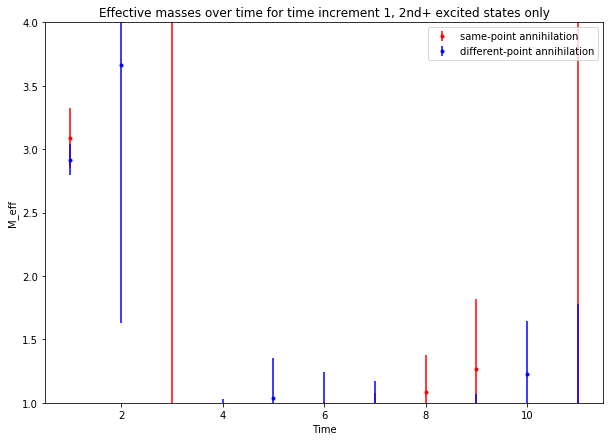

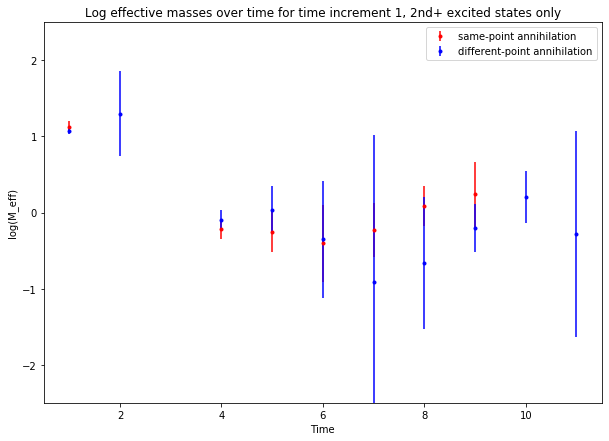

In [175]:
# Plot effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_logexc2[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_logexc2[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([eff_mass_logexc2[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([eff_mass_logexc2[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")



plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(1, 4)
plt.title("Effective masses over time for time increment {}, 2nd+ excited states only".format(tau))
plt.legend()
plt.show()

# Plot log effective mass 

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_logexc2[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_logexc2[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass_logexc2[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass_logexc2[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")


plt.xlabel("Time")
plt.ylabel("log(M_eff)")
plt.ylim(-2.5, 2.5)
plt.title("Log effective masses over time for time increment {}, 2nd+ excited states only".format(tau))
plt.legend()
plt.show()

<ipython-input-176-ebf58a1e9880>:1: RuntimeWarning: invalid value encountered in sqrt
  zS_eff_logexc2 = np.array([np.sqrt(np.exp(eff_mass_logexc2[0][t]*t)*proton_timeavg_logexc2[t][0][0]) for t in range(len(proton_timeavg_logexc2)-tau)])


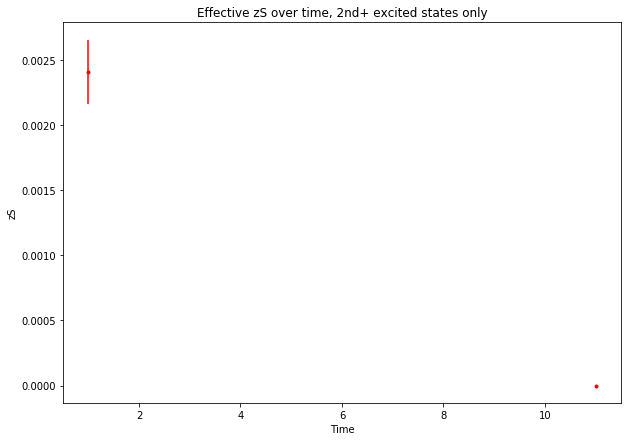

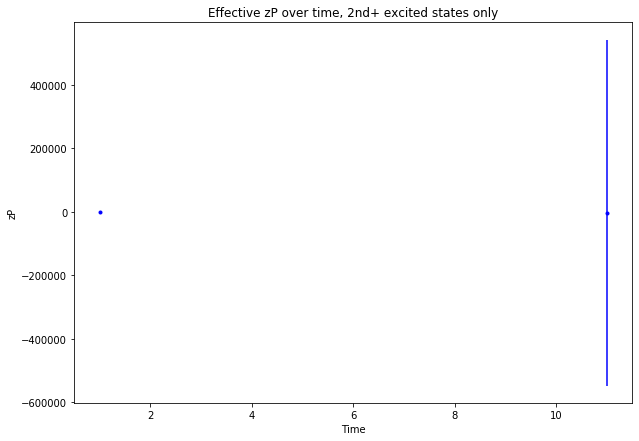

In [176]:
zS_eff_logexc2 = np.array([np.sqrt(np.exp(eff_mass_logexc2[0][t]*t)*proton_timeavg_logexc2[t][0][0]) for t in range(len(proton_timeavg_logexc2)-tau)])
zP_eff_logexc2 = np.array([np.exp(eff_mass_logexc2[1][t]*t)*proton_timeavg_logexc2[t][1][0]/zS_eff_logexc2[t] for t in range(len(proton_timeavg_logexc2)-tau)])


# Plot effective zS

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zS_eff_logexc2[i].mean for i in range(t_min_plt,12)]), np.array([zS_eff_logexc2[i].sdev for i in range(t_min_plt,12)]), fmt='.', color = 'red')


plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time, 2nd+ excited states only")
#plt.ylim(0, 0.0005)
plt.show()


fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,12)]), np.array([zP_eff_logexc2[i].mean for i in range(t_min_plt,12)]), np.array([zP_eff_logexc2[i].sdev for i in range(t_min_plt,12)]), fmt='.', color="blue")


plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time, 2nd+ excited states only")
#plt.ylim(0, 0.005)
plt.show()

## Now try re-prioring the fit on the new log-data

In [181]:
num_zs = 3
log_priors_2pt_adjusted = gv.BufferDict()
log_priors_2pt_adjusted['E0'] = gv.gvar(0.665, 0.015)
log_priors_2pt_adjusted['Z0'] = gv.gvar(0.0008, 0.0003)
log_priors_2pt_adjusted['Ztilde0'] = gv.gvar(0.003, 0.002)

#p_exc['E0'] = gv.gvar(1.4, 0.25)
#p_exc['Z0'] = gv.gvar(0.0012, 0.0005)
#p_exc['Ztilde0'] = gv.gvar(0.006, 0.005)

log_priors_2pt_adjusted['log(E1)'] = gv.gvar(0.4, 0.2)
log_priors_2pt_adjusted['Z1'] = gv.gvar(0.0012, 0.0006)
log_priors_2pt_adjusted['Ztilde1'] = gv.gvar(0.006, 0.005)

log_priors_2pt_adjusted['log(E2)'] = gv.gvar(1.2, 0.5)
log_priors_2pt_adjusted['Z2'] = gv.gvar(0.0007, 0.0006)
log_priors_2pt_adjusted['Ztilde2'] = gv.gvar(0, 0.015)

print(log_priors_2pt_adjusted['E0'])
print(log_priors_2pt_adjusted['E1'])
print(log_priors_2pt_adjusted['E2'])

#priors_2pt_adjusted['E1'] = gv.gvar(1.15, 0.15)
#priors_2pt_adjusted['Z1'] = gv.gvar(0.0007, 0.0002)
#priors_2pt_adjusted['Ztilde1'] = gv.gvar(0.009, 0.003)

#priors_2pt_adjusted['log(E2)'] = priors[a_select_indices[0]][b_max_BF_a0[1][1]]['log(E2)']
#priors_2pt_adjusted['Z2'] = gv.gvar(0.0007, 0.0004)
#priors_2pt_adjusted['Ztilde2'] = gv.gvar(0, 0.015)

#gv.gvar(0.0007, 0.0004)
#gv.gvar(0, 0.015)

#gv.gvar(0.0008, 0.0004)
#gv.gvar(0, 0.005)

final_fit_log = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2,22)]), np.array([proton_timeavg[l] for l in range(2, 22)])), prior=log_priors_2pt_adjusted, fcn=C_2pt, debug=True)
print(final_fit_log.format(pstyle='vv'))
y_sample_log = C_2pt(np.array([i for i in range(0,t_max_plt+1)]), final_fit_log.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [proton_timeavg[i][0][0].mean for i in range(t_min_plt,t_max_plt)], yerr=[proton_timeavg[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [proton_timeavg[i][1][0].mean for i in range(t_min_plt,t_max_plt)], yerr=[proton_timeavg[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[y_sample_log[i][0][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[y_sample_log[i][0][0].mean + y_sample_log[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], [y_sample_log[i][0][0].mean - y_sample_log[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[y_sample_log[i][1][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[y_sample_log[i][1][0].mean + y_sample_log[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], [y_sample_log[i][1][0].mean - y_sample_log[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("C(t)")
plt.title("Averaged Correlation functions over time")
plt.legend()
plt.show()

print("E0 = ", final_fit.p['E0'].mean, "+/-", final_fit.p['E0'].sdev)

0.665(15)
1.49(30)
3.3(1.7)


KeyError: 'undefined key: dE0'

In [ ]:
model_eff_mass = np.array([np.log(y_sample_log[i]/y_sample_log[i+1]) for i in range(0,t_max_plt)])
model_log_eff_mass = np.log(model_eff_mass)

# Plot effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [eff_mass[0][i].mean for i in range(t_min_plt,t_max_plt)], yerr=[eff_mass[0][i].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(t_min_plt,t_max_plt)], [eff_mass[1][i].mean for i in range(t_min_plt,t_max_plt)], yerr=[eff_mass[1][i].sdev for i in range(t_min_plt,t_max_plt)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][0][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)
ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][1][0].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("M_eff")
plt.ylim(0.6, 0.8)
plt.title("Effective masses over time for time increment {}".format(tau))
plt.legend()
plt.show()

# Plot log of effective mass
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass[0][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass[0][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="same-point annihilation", color="red")
ax.errorbar(np.array([i for i in range(t_min_plt, 12)]), np.array([log_eff_mass[1][i].mean for i in range(t_min_plt, 12)]), yerr=np.array([log_eff_mass[1][i].sdev for i in range(t_min_plt, 12)]), fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,12)],[model_log_eff_mass[i][0][0].mean for i in range(1,12)],ls='-',color="red")
ax.fill_between([i for i in range(1,12)],[model_log_eff_mass[i][0][0].mean + model_log_eff_mass[i][0][0].sdev for i in range(1,12)], [model_log_eff_mass[i][0][0].mean - model_log_eff_mass[i][0][0].sdev for i in range(1,12)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,12)],[model_log_eff_mass[i][1][0].mean for i in range(1,12)],ls='-',color="blue")
ax.fill_between([i for i in range(1,12)],[model_log_eff_mass[i][1][0].mean + model_log_eff_mass[i][1][0].sdev for i in range(1,12)], [model_log_eff_mass[i][1][0].mean - model_log_eff_mass[i][1][0].sdev for i in range(1,12)], color="blue",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("log(M_eff)")
#plt.ylim(0, 1.2)
plt.title("Log effective masses over time for time increment {}".format(tau))
plt.legend()
plt.show()






In [ ]:
# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample_log[t][0][0]) for t in range(0,t_max_plt)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="red")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(t_min_plt,t_max_plt)], color="red",alpha=0.3)

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.show()

model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample_log[t][1][0]/model_zS_eff[t] for t in range(0,t_max_plt)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].mean for i in range(t_min_plt,t_max_plt)]), np.array([zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', color="blue")

ax.errorbar([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff[i].mean for i in range(t_min_plt,t_max_plt)],ls='-',color="blue")
ax.fill_between([i for i in range(t_min_plt,t_max_plt)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(t_min_plt,t_max_plt)], color="blue",alpha=0.3)
plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.show()

### Now, utilize the dE obtained from the ground-subtraction to retry the whole ground state energies vs tmin plot


In [ ]:
# First set the priors for the fit
# Initialize the principal values of the excited energy-priors
dE_mod = 1.3 - p['E0'].mean
energyvals_mod = np.array([[None]*14]*len(a))
dEvals_mod = np.array([[None]*13]*len(a))



for i in range(len(a)):
    energyvals_mod[i][0] = p['E0'].mean
    for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        dEvals_mod[i][k-1] = dE_mod/np.power(k, a[i])
        energyvals_mod[i][k] = energyvals_mod[i][k-1] + dEvals_mod[i][k-1]
        

priors_mod = []

for i in range(len(a)):
    priors_mod.append([])
    
    for j in range(len(b)):
        #print("i = ", i, " j = ", j)
        priors_mod[i].append(gv.BufferDict())
        
        priors_mod[i][j]['E0'] = p['E0']
        priors_mod[i][j]['Z0'] = p['Z0']
        priors_mod[i][j]['Ztilde0'] = p['Ztilde0']
        
        for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
            #print(priors[i][j])
            #print("k = ", k)
            #print("Current last energy: ", priors[i][j]['E{}'.format(k-1)])
            #print("Change in energy: ", dE)
            err_ratio = energyvals_mod[i][k]/(energyvals_mod[i][k] - (b[j] * dEvals_mod[i][k-1]) )
            
            priors_mod[i][j]['Z{}'.format(k)] = gv.gvar(0.0008, 0.0007)
            priors_mod[i][j]['Ztilde{}'.format(k)] = gv.gvar(0, 0.01)
            priors_mod[i][j]['log(E{})'.format(k)] = gv.gvar(np.log(energyvals_mod[i][k]), np.log(err_ratio))
    #print(priors[i])
        

In [ ]:
tmin = np.arange(1,10,1)

mod_list_LogGBF_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_Q_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_E0_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

mod_list_LogGBF_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_Q_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_E0_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

mod_list_LogGBF_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_Q_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
mod_list_E0_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

In [ ]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors_mod[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors_mod[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 22)]), np.array([proton_timeavg[l] for l in range(tmin[k],22)])), prior=priors_mod[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            mod_list_LogGBF_a0[i][j][k] = fit_a0.logGBF
            mod_list_Q_a0[i][j][k] = fit_a0.Q
            mod_list_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k], " dE = 1.3-0.67")
            print("list logGBF: ", mod_list_LogGBF_a0[i][j][k])
            print("list Q: ", mod_list_Q_a0[i][j][k])
            print("list E0: ", mod_list_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            mod_list_LogGBF_a1[i][j][k] = fit_a1.logGBF
            mod_list_Q_a1[i][j][k] = fit_a1.Q
            mod_list_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k], " dE = 1.3-0.67")
            print("list logGBF: ", mod_list_LogGBF_a1[i][j][k])
            print("list Q: ", mod_list_Q_a1[i][j][k])
            print("list E0: ", mod_list_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            mod_list_LogGBF_a2[i][j][k] = fit_a2.logGBF
            mod_list_Q_a2[i][j][k] = fit_a2.Q
            mod_list_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k], " dE = 1.3-0.67")
            print("list logGBF: ", mod_list_LogGBF_a2[i][j][k])
            print("list Q: ", mod_list_Q_a2[i][j][k])
            print("list E0: ", mod_list_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))
            #print(list_LogGBF_a0)
            #a = 0, b = 0.7, k = 5 fit

In [ ]:
# Write the list_LogGBF to a file
F_logGBF_tmin_mod_a0 = open("logGBF_tmin_a0_data_modified.csv","w")
F_Q_tmin_mod_a0 = open("Q_tmin_a0_data_modified.csv","w")
F_E0_tmin_mod_a0 = open("E0_tmin_a0_data_modified.csv","w")
F_E0_tmin_err_mod_a0 = open("E0error_tmin_a0_data_modified.csv","w")

F_logGBF_tmin_mod_a1 = open("logGBF_tmin_a1_data_modified.csv","w")
F_Q_tmin_mod_a1 = open("Q_tmin_a1_data_modified.csv","w")
F_E0_tmin_mod_a1 = open("E0_tmin_a1_data_modified.csv","w")
F_E0_tmin_err_mod_a1 = open("E0error_tmin_a1_data_modified.csv","w")

F_logGBF_tmin_mod_a2 = open("logGBF_tmin_a2_data_modified.csv","w")
F_Q_tmin_mod_a2 = open("Q_tmin_a2_data_modified.csv","w")
F_E0_tmin_mod_a2 = open("E0_tmin_a2_data_modified.csv","w")
F_E0_tmin_err_mod_a2 = open("E0error_tmin_a2_data_modified.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmin_mod_a0.write("{}".format(mod_list_LogGBF_a0[i][j][0]))
        F_Q_tmin_mod_a0.write("{}".format(mod_list_Q_a0[i][j][0]))
        F_E0_tmin_mod_a0.write("{}".format(mod_list_E0_a0[i][j][0].mean))
        F_E0_tmin_err_mod_a0.write("{}".format(mod_list_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmin_mod_a1.write("{}".format(mod_list_LogGBF_a1[i][j][0]))
        F_Q_tmin_mod_a1.write("{}".format(mod_list_Q_a1[i][j][0]))
        F_E0_tmin_mod_a1.write("{}".format(mod_list_E0_a1[i][j][0].mean))
        F_E0_tmin_err_mod_a1.write("{}".format(mod_list_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmin_mod_a2.write("{}".format(mod_list_LogGBF_a2[i][j][0]))
        F_Q_tmin_mod_a2.write("{}".format(mod_list_Q_a2[i][j][0]))
        F_E0_tmin_mod_a2.write("{}".format(mod_list_E0_a2[i][j][0].mean))
        F_E0_tmin_err_mod_a2.write("{}".format(mod_list_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmin)):
            F_logGBF_tmin_mod_a0.write(", {}".format(mod_list_LogGBF_a0[i][j][k]))
            F_Q_tmin_mod_a0.write(", {}".format(mod_list_Q_a0[i][j][k]))
            F_E0_tmin_mod_a0.write(", {}".format(mod_list_E0_a0[i][j][k].mean))
            F_E0_tmin_err_mod_a0.write(", {}".format(mod_list_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmin_mod_a1.write(", {}".format(mod_list_LogGBF_a1[i][j][k]))
            F_Q_tmin_mod_a1.write(", {}".format(mod_list_Q_a1[i][j][k]))
            F_E0_tmin_mod_a1.write(", {}".format(mod_list_E0_a1[i][j][k].mean))
            F_E0_tmin_err_mod_a1.write(", {}".format(mod_list_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmin_mod_a2.write(", {}".format(mod_list_LogGBF_a2[i][j][k]))
            F_Q_tmin_mod_a2.write(", {}".format(mod_list_Q_a2[i][j][k]))
            F_E0_tmin_mod_a2.write(", {}".format(mod_list_E0_a2[i][j][k].mean))
            F_E0_tmin_err_mod_a2.write(", {}".format(mod_list_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmin_mod_a0.write("; ")
        F_Q_tmin_mod_a0.write("; ")
        F_E0_tmin_mod_a0.write("; ")
        F_E0_tmin_err_mod_a0.write("; ")
        
        F_logGBF_tmin_mod_a1.write("; ")
        F_Q_tmin_mod_a1.write("; ")
        F_E0_tmin_mod_a1.write("; ")
        F_E0_tmin_err_mod_a1.write("; ")
        
        F_logGBF_tmin_mod_a2.write("; ")
        F_Q_tmin_mod_a2.write("; ")
        F_E0_tmin_mod_a2.write("; ")
        F_E0_tmin_err_mod_a2.write("; ")
        
    F_logGBF_tmin_mod_a0.write("\n")
    F_Q_tmin_mod_a0.write("\n")
    F_E0_tmin_mod_a0.write("\n")
    F_E0_tmin_err_mod_a0.write("\n")
    
    F_logGBF_tmin_mod_a1.write("\n")
    F_Q_tmin_mod_a1.write("\n")
    F_E0_tmin_mod_a1.write("\n")
    F_E0_tmin_err_mod_a1.write("\n")
    
    F_logGBF_tmin_mod_a2.write("\n")
    F_Q_tmin_mod_a2.write("\n")
    F_E0_tmin_mod_a2.write("\n")
    F_E0_tmin_err_mod_a2.write("\n")
    

F_logGBF_tmin_mod_a0.close()
F_Q_tmin_mod_a0.close()
F_E0_tmin_mod_a0.close()
F_E0_tmin_err_mod_a0.close()

F_logGBF_tmin_mod_a1.close()
F_Q_tmin_mod_a1.close()
F_E0_tmin_mod_a1.close()
F_E0_tmin_err_mod_a1.close()

F_logGBF_tmin_mod_a2.close()
F_Q_tmin_mod_a2.close()
F_E0_tmin_mod_a2.close()
F_E0_tmin_err_mod_a2.close()

In [ ]:
# Readout test
read_F_logGBF_tmin_mod_a0 = open("logGBF_tmin_a0_data_modified.csv","r")
read_F_Q_tmin_mod_a0 = open("Q_tmin_a0_data_modified.csv","r")
read_F_E0_tmin_mod_a0 = open("E0_tmin_a0_data_modified.csv","r")
read_F_E0_tmin_err_mod_a0 = open("E0error_tmin_a0_data_modified.csv","r")

read_F_logGBF_tmin_mod_a1 = open("logGBF_tmin_a1_data_modified.csv","r")
read_F_Q_tmin_mod_a1 = open("Q_tmin_a1_data_modified.csv","r")
read_F_E0_tmin_mod_a1 = open("E0_tmin_a1_data_modified.csv","r")
read_F_E0_tmin_err_mod_a1 = open("E0error_tmin_a1_data_modified.csv","r")

read_F_logGBF_tmin_mod_a2 = open("logGBF_tmin_a2_data_modified.csv","r")
read_F_Q_tmin_mod_a2 = open("Q_tmin_a2_data_modified.csv","r")
read_F_E0_tmin_mod_a2 = open("E0_tmin_a2_data_modified.csv","r")
read_F_E0_tmin_err_mod_a2 = open("E0error_tmin_a2_data_modified.csv","r")

logGBF_tmin_mod_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_mod_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_mod_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_mod_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_mod_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_mod_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_mod_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_mod_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_mod_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_mod_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_mod_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_mod_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))


E0_tmin_mod_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mod_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mod_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmin_mod_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_mod_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_mod_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_mod_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_mod_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_mod_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmin_mod_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_mod_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_mod_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_mod_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_mod_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_mod_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmin_mod_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_mod_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_mod_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_mod_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_mod_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_mod_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmin_err_mod_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_mod_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_mod_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_mod_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_mod_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_mod_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            E0_tmin_mod_a0_readout[i][j][k] = gv.gvar(E0_tmin_mean_mod_a0_readout[i][j][k], E0_tmin_err_mod_a0_readout[i][j][k])
            E0_tmin_mod_a1_readout[i][j][k] = gv.gvar(E0_tmin_mean_mod_a1_readout[i][j][k], E0_tmin_err_mod_a1_readout[i][j][k])
            E0_tmin_mod_a2_readout[i][j][k] = gv.gvar(E0_tmin_mean_mod_a2_readout[i][j][k], E0_tmin_err_mod_a2_readout[i][j][k])

Now, find the Bayes factors

In [ ]:
# Find the max Bayes factor b-values
logGBF_tmin_mod_a0_readout_tp = np.transpose(logGBF_tmin_mod_a0_readout)
b_max_BF_mod_a0 = np.array([[np.where(logGBF_tmin_mod_a0_readout_tp[i][j] == np.amax(logGBF_tmin_mod_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_mod_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_mod_a0_readout_tp))])

logGBF_tmin_mod_a1_readout_tp = np.transpose(logGBF_tmin_mod_a1_readout)
b_max_BF_mod_a1 = np.array([[np.where(logGBF_tmin_mod_a1_readout_tp[i][j] == np.amax(logGBF_tmin_mod_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_mod_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_mod_a1_readout_tp))])

logGBF_tmin_mod_a2_readout_tp = np.transpose(logGBF_tmin_mod_a2_readout)
b_max_BF_mod_a2 = np.array([[np.where(logGBF_tmin_mod_a2_readout_tp[i][j] == np.amax(logGBF_tmin_mod_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_mod_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_mod_a2_readout_tp))])

In [178]:
log_GBF_max_mod_a0 = np.array([np.max(logGBF_tmin_mod_a0_readout_tp[i]) for i in range(len(logGBF_tmin_mod_a0_readout_tp))])

log_GBF_max_mod_a1 = np.array([np.max(logGBF_tmin_mod_a1_readout_tp[i]) for i in range(len(logGBF_tmin_mod_a1_readout_tp))])

log_GBF_max_mod_a2 = np.array([np.max(logGBF_tmin_mod_a2_readout_tp[i]) for i in range(len(logGBF_tmin_mod_a2_readout_tp))])

#log_GBF_max = np.array([np.max(np.array([log_GBF_max_a0[i], log_GBF_max_a1[i], log_GBF_max_a2[i]])) for i in range(len(log_GBF_max_a0))])
#print([np.array([log_GBF_max_a0[i], log_GBF_max_a1[i], log_GBF_max_a2[i]]) for i in range(len(log_GBF_max_a0))])
print("a0 max logGBF: ", log_GBF_max_mod_a0)
print("a1 max logGBF: ", log_GBF_max_mod_a1)
print("a2 max logGBF: ", log_GBF_max_mod_a2)
print("overall logGBF normalization: ", log_GBF_max)

NameError: name 'logGBF_tmin_mod_a0_readout_tp' is not defined

In [179]:
# Find the Bayes factors and make arrays with just the max Bayes factor locations
# In order to stay consistent, use the maximum log Bayes factors

logGBF_tmin_bmax_mod_a0 = np.array([[logGBF_tmin_mod_a0_readout[b_max_BF_mod_a0[i][j]][j][i] for i in range(len(logGBF_tmin_mod_a0_readout[0][0]))] for j in range(len(logGBF_tmin_mod_a0_readout[0]))])
BF_tmin_bmax_mod_a0 = np.exp(np.array([[logGBF_tmin_bmax_mod_a0[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_mod_a0[0])) ] for i in range(len(logGBF_tmin_bmax_mod_a0)) ])) 
Q_tmin_bmax_mod_a0 = np.array([[Q_tmin_mod_a0_readout[b_max_BF_mod_a0[i][j]][j][i] for i in range(len(Q_tmin_mod_a0_readout[0][0]))] for j in range(len(Q_tmin_mod_a0_readout[0]))])
E0_tmin_bmax_mod_a0 = np.array([[E0_tmin_mod_a0_readout[b_max_BF_mod_a0[i][j]][j][i] for i in range(len(E0_tmin_mod_a0_readout[0][0]))] for j in range(len(E0_tmin_mod_a0_readout[0]))])


logGBF_tmin_bmax_mod_a1 = np.array([[logGBF_tmin_mod_a1_readout[b_max_BF_mod_a1[i][j]][j][i] for i in range(len(logGBF_tmin_mod_a1_readout[0][0]))] for j in range(len(logGBF_tmin_mod_a1_readout[0]))])
BF_tmin_bmax_mod_a1 = np.exp(np.array([[logGBF_tmin_bmax_mod_a1[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_mod_a1[0])) ] for i in range(len(logGBF_tmin_bmax_mod_a1)) ])) 
Q_tmin_bmax_mod_a1 = np.array([[Q_tmin_mod_a1_readout[b_max_BF_mod_a1[i][j]][j][i] for i in range(len(Q_tmin_mod_a1_readout[0][0]))] for j in range(len(Q_tmin_mod_a1_readout[0]))])
E0_tmin_bmax_mod_a1 = np.array([[E0_tmin_mod_a1_readout[b_max_BF_mod_a1[i][j]][j][i] for i in range(len(E0_tmin_mod_a1_readout[0][0]))] for j in range(len(E0_tmin_mod_a1_readout[0]))])


logGBF_tmin_bmax_mod_a2 = np.array([[logGBF_tmin_mod_a2_readout[b_max_BF_mod_a2[i][j]][j][i] for i in range(len(logGBF_tmin_mod_a2_readout[0][0]))] for j in range(len(logGBF_tmin_mod_a2_readout[0]))])
BF_tmin_bmax_mod_a2 = np.exp(np.array([[logGBF_tmin_bmax_mod_a2[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_mod_a2[0])) ] for i in range(len(logGBF_tmin_bmax_mod_a2)) ])) 
Q_tmin_bmax_mod_a2 = np.array([[Q_tmin_mod_a2_readout[b_max_BF_mod_a2[i][j]][j][i] for i in range(len(Q_tmin_mod_a2_readout[0][0]))] for j in range(len(Q_tmin_mod_a2_readout[0]))])
E0_tmin_bmax_mod_a2 = np.array([[E0_tmin_mod_a2_readout[b_max_BF_mod_a2[i][j]][j][i] for i in range(len(E0_tmin_mod_a2_readout[0][0]))] for j in range(len(E0_tmin_mod_a2_readout[0]))])

NameError: name 'logGBF_tmin_mod_a0_readout' is not defined

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
#a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
#a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_mod_a0)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_mod_a0[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_mod_a0[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a0[1][1].mean + E0_tmin_bmax_mod_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a0[1][1].mean - E0_tmin_bmax_mod_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a0[1][1].mean, E0_tmin_bmax_mod_a0[1][1].sdev))
#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a0[4][1].mean + E0_tmin_bmax_mod_a0[4][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a0[4][1].mean - E0_tmin_bmax_mod_a0[4][1].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a0[4][1].mean, E0_tmin_bmax_mod_a0[4][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a0[10][0].mean + E0_tmin_bmax_mod_a0[10][0].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a0[10][0].mean - E0_tmin_bmax_mod_a0[10][0].sdev  for i in tmin_samp_line], color="brown",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a0[10][0].mean, E0_tmin_bmax_mod_a0[10][0].sdev))
plt.title("Ground state energy over tmin, dE = 1.3-0.67")
plt.xlabel("tmin")
plt.ylabel("E0")
plt.ylim(0.64,0.7)
plt.legend()
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_mod_a0)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_mod_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin")
plt.ylabel("Q")
plt.ylim(-0.05, 1.05)
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a0)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_mod_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor")
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a0)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_mod_a0[i][k] for k in range(len(tmin))], '.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.show()

In [ ]:
plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_mod_a1)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_mod_a1[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_mod_a1[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a1[1][1].mean + E0_tmin_bmax_mod_a1[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a1[1][1].mean - E0_tmin_bmax_mod_a1[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a1[1][1].mean, E0_tmin_bmax_mod_a1[1][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a1[4][1].mean + E0_tmin_bmax_mod_a1[4][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a1[4][1].mean - E0_tmin_bmax_mod_a1[4][1].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a1[4][1].mean, E0_tmin_bmax_mod_a1[4][1].sdev))
plt.title("Ground state energy over tmin, dE = (1.3-0.67)/n")
plt.xlabel("tmin")
plt.ylabel("E0")
plt.ylim(0.64,0.7)
plt.legend()
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_mod_a1)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_mod_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin")
plt.ylabel("Q")
plt.ylim(-0.05, 1.05)
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a1)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_mod_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor")
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a1)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_mod_a1[i][k] for k in range(len(tmin))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.show()

In [ ]:
plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_mod_a2)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_mod_a2[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_mod_a2[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a2[1][1].mean + E0_tmin_bmax_mod_a2[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a2[1][1].mean - E0_tmin_bmax_mod_a2[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a2[1][1].mean, E0_tmin_bmax_mod_a2[1][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_mod_a2[4][2].mean + E0_tmin_bmax_mod_a2[4][2].sdev for i in tmin_samp_line], [E0_tmin_bmax_mod_a2[4][2].mean - E0_tmin_bmax_mod_a2[4][2].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_mod_a2[4][2].mean, E0_tmin_bmax_mod_a2[4][2].sdev))
plt.title("Ground state energy over tmin, dE = (1.3-0.67)/n^2")
plt.xlabel("tmin")
plt.ylabel("E0")
plt.ylim(0.64,0.7)
plt.legend()
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_mod_a2)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_mod_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin")
plt.ylabel("Q")
plt.ylim(-0.05, 1.05)
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a2)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_mod_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor")
plt.show()

plt.clf()
plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_mod_a2)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_mod_a2[i][k] for k in range(len(tmin))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.show()

## Now, test if tmax affects any of the fit

In [40]:
# Test to see if tmax affects the fit at all
tmax = np.array([13, 15, 18, 20, 22, 25])

list_tmax_LogGBF_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

In [41]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([proton_timeavg[l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([proton_timeavg[l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([proton_timeavg[l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_tmax_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_tmax_Q_a0[i][j][k] = fit_a0.Q
            list_tmax_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmax = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a0[i][j][k])
            print("list Q: ", list_tmax_Q_a0[i][j][k])
            print("list E0: ", list_tmax_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_tmax_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_tmax_Q_a1[i][j][k] = fit_a1.Q
            list_tmax_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a1[i][j][k])
            print("list Q: ", list_tmax_Q_a1[i][j][k])
            print("list E0: ", list_tmax_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_tmax_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_tmax_Q_a2[i][j][k] = fit_a2.Q
            list_tmax_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a2[i][j][k])
            print("list Q: ", list_tmax_Q_a2[i][j][k])
            print("list E0: ", list_tmax_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))


i =  0  j =  0  k =  0 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  13
list logGBF:  243.38727506335283
list Q:  2.3374157762936801e-97
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.3e-97    logGBF = 243.39

Parameters:
             E0       0.667565 +- 0.0010806            [     0.67 +- 0.02 ]  
             Z0   0.00078576 +- 2.52295e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303828 +- 1.21843e-05            [   0.003 +- 0.003 ]  
             Z1    0.00125254 +- 3.7634e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00918085 +- 4.28628e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127863 +- 0.00678993            [  -0.97551 +- 0.3 ]  **
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 0.3            [  -0.97551 +- 0.3 ]  
             Z3            0.


i =  0  j =  0  k =  1 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  15
list logGBF:  349.71312202244593
list Q:  2.9779832951026683e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 21 [26]    Q = 3e-96    logGBF = 349.71

Parameters:
             E0       0.667545 +- 0.00107908             [     0.67 +- 0.02 ]  
             Z0   0.000785434 +- 2.51981e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303662 +- 1.21486e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125233 +- 3.74683e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917193 +- 4.25548e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.129135 +- 0.00673945             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             


i =  0  j =  0  k =  2 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  18
list logGBF:  516.4541506090527
list Q:  9.77250819602624e-94
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 9.8e-94    logGBF = 516.45

Parameters:
             E0       0.667517 +- 0.00107743             [     0.67 +- 0.02 ]  
             Z0   0.000785421 +- 2.51669e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303616 +- 1.21316e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125224 +- 3.75086e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917145 +- 4.25721e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.12838 +- 0.00674036             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             Z


i =  0  j =  0  k =  3 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  20
list logGBF:  629.8331886973074
list Q:  1.5170310908960967e-92
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 1.5e-92    logGBF = 629.83

Parameters:
             E0       0.667363 +- 0.00107305             [     0.67 +- 0.02 ]  
             Z0   0.000785039 +- 2.50517e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303473 +- 1.20961e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125291 +- 3.73541e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917236 +- 4.23377e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.12803 +- 0.00670403             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
            


i =  0  j =  0  k =  4 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  22
list logGBF:  746.5107147449512
list Q:  5.450118091513815e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 5.5e-91    logGBF = 746.51

Parameters:
             E0       0.667411 +- 0.00107212             [     0.67 +- 0.02 ]  
             Z0   0.000785098 +- 2.50338e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303492 +- 1.2079e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125263 +- 3.72373e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917145 +- 4.21995e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128577 +- 0.00669193             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             


i =  0  j =  0  k =  5 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  25
list logGBF:  923.3432907735213
list Q:  8.237209717384145e-90
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 8.2e-90    logGBF = 923.34

Parameters:
             E0       0.667319 +- 0.00106714             [     0.67 +- 0.02 ]  
             Z0   0.000784954 +- 2.49708e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303444 +- 1.20298e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125179 +- 3.69655e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00916728 +- 4.20024e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.129522 +- 0.00665551             [  -0.97551 +- 0.3 ]  **
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.3             [  -0.97551 +- 0.3 ]  
             


i =  0  j =  1  k =  0 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  13
list logGBF:  483.65082375394866
list Q:  0.08780417403608966
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 1.4 [22]    Q = 0.088    logGBF = 483.65

Parameters:
             E0       0.661473 +- 0.00189287             [     0.67 +- 0.02 ]  
             Z0   0.000758715 +- 6.03339e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286886 +- 2.88173e-05             [   0.003 +- 0.003 ]  
             Z1   0.000696584 +- 4.17609e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00477159 +- 0.000310573             [       0 +- 0.005 ]  
       log(dE0)       -0.774115 +- 0.0665186             [  -0.97551 +- 0.3 ]  
             Z2    0.00132185 +- 1.94219e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979892 +- 0.000203164             [       0 +- 0.005 ]  *
       log(dE1)       -0.124636 +- 0.0493448             [  -0.97551 +- 0.3 ]  **
             Z3


i =  0  j =  1  k =  1 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  15
list logGBF:  588.8126196106901
list Q:  0.02693832731159971
list E0:  0.6617(19)
Least Square Fit:
  chi2/dof [dof] = 1.6 [26]    Q = 0.027    logGBF = 588.81

Parameters:
             E0       0.661729 +- 0.00186657             [     0.67 +- 0.02 ]  
             Z0    0.00075954 +- 5.90098e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287422 +- 2.8106e-05             [   0.003 +- 0.003 ]  
             Z1   0.000702094 +- 4.23933e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00481894 +- 0.00031496             [       0 +- 0.005 ]  
       log(dE0)       -0.760585 +- 0.0656541             [  -0.97551 +- 0.3 ]  
             Z2    0.00132208 +- 2.00871e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979399 +- 0.000208607             [       0 +- 0.005 ]  *
       log(dE1)       -0.122993 +- 0.0511261             [  -0.97551 +- 0.3 ]  **
             Z3 


i =  0  j =  1  k =  2 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  18
list logGBF:  757.9058010764753
list Q:  0.08648819070322512
list E0:  0.6617(19)
Least Square Fit:
  chi2/dof [dof] = 1.4 [32]    Q = 0.086    logGBF = 757.91

Parameters:
             E0       0.661704 +- 0.00185839             [     0.67 +- 0.02 ]  
             Z0   0.000759482 +- 5.87854e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287391 +- 2.79939e-05             [   0.003 +- 0.003 ]  
             Z1    0.000702902 +- 4.2133e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00482454 +- 0.000313595             [       0 +- 0.005 ]  
       log(dE0)       -0.759094 +- 0.0651654             [  -0.97551 +- 0.3 ]  
             Z2    0.00132266 +- 2.02611e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979961 +- 0.000209699             [       0 +- 0.005 ]  *
       log(dE1)       -0.121368 +- 0.0512362             [  -0.97551 +- 0.3 ]  **
             Z3 


i =  0  j =  1  k =  3 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  20
list logGBF:  872.5436950120732
list Q:  0.10443189411582916
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [36]    Q = 0.1    logGBF = 872.54

Parameters:
             E0        0.661592 +- 0.0018449             [     0.67 +- 0.02 ]  
             Z0   0.000759206 +- 5.82821e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287355 +- 2.77556e-05             [   0.003 +- 0.003 ]  
             Z1   0.000706413 +- 4.22183e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00484717 +- 0.000314532             [       0 +- 0.005 ]  
       log(dE0)       -0.753872 +- 0.0646969             [  -0.97551 +- 0.3 ]  
             Z2     0.0013229 +- 2.05264e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00979537 +- 0.000211464             [       0 +- 0.005 ]  *
       log(dE1)       -0.119604 +- 0.0519216             [  -0.97551 +- 0.3 ]  **
             Z3   


i =  0  j =  1  k =  4 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  22
list logGBF:  990.0952232292781
list Q:  0.15389444584745504
list E0:  0.6616(19)
Least Square Fit:
  chi2/dof [dof] = 1.2 [40]    Q = 0.15    logGBF = 990.1

Parameters:
             E0       0.661628 +- 0.00185069             [     0.67 +- 0.02 ]  
             Z0   0.000759141 +- 5.85306e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287285 +- 2.78589e-05             [   0.003 +- 0.003 ]  
             Z1   0.000702627 +- 4.20448e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0048205 +- 0.000312342             [       0 +- 0.005 ]  
       log(dE0)       -0.759517 +- 0.0648674             [  -0.97551 +- 0.3 ]  
             Z2    0.00132147 +- 1.99405e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.0097793 +- 0.000206369             [       0 +- 0.005 ]  *
       log(dE1)       -0.123634 +- 0.0509571             [  -0.97551 +- 0.3 ]  **
             Z3   


i =  0  j =  1  k =  5 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  25
list logGBF:  1169.99238140478
list Q:  0.19931199606181416
list E0:  0.6618(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [46]    Q = 0.2    logGBF = 1170

Parameters:
             E0       0.661779 +- 0.00182427             [     0.67 +- 0.02 ]  
             Z0   0.000759785 +- 5.75036e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287593 +- 2.73471e-05             [   0.003 +- 0.003 ]  
             Z1   0.000704392 +- 4.20969e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00484648 +- 0.000312135             [       0 +- 0.005 ]  
       log(dE0)       -0.754358 +- 0.0640818             [  -0.97551 +- 0.3 ]  
             Z2    0.00132202 +- 2.02902e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00977215 +- 0.000208417             [       0 +- 0.005 ]  *
       log(dE1)       -0.122073 +- 0.0516612             [  -0.97551 +- 0.3 ]  **
             Z3      


i =  0  j =  2  k =  0 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  13
list logGBF:  486.1396828967287
list Q:  0.32081050521728344
list E0:  0.6610(29)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.32    logGBF = 486.14

Parameters:
             E0       0.661032 +- 0.00286034             [     0.67 +- 0.02 ]  
             Z0    0.000756778 +- 1.0634e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285965 +- 4.74476e-05             [   0.003 +- 0.003 ]  
             Z1   0.000661341 +- 5.93837e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0044619 +- 0.000557561             [       0 +- 0.005 ]  
       log(dE0)        -0.819228 +- 0.109833             [  -0.97551 +- 0.3 ]  
             Z2   0.000561306 +- 0.000278775             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0042848 +- 0.00207319             [       0 +- 0.005 ]  
       log(dE1)        -0.653858 +- 0.224625             [  -0.97551 +- 0.3 ]  *
             Z3     


i =  0  j =  2  k =  1 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  15
list logGBF:  591.335291651969
list Q:  0.12065556051883553
list E0:  0.6609(29)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.12    logGBF = 591.34

Parameters:
             E0       0.660931 +- 0.00286021             [     0.67 +- 0.02 ]  
             Z0   0.000756177 +- 1.06393e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285898 +- 4.73584e-05             [   0.003 +- 0.003 ]  
             Z1   0.000664976 +- 5.99049e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0044427 +- 0.000561718             [       0 +- 0.005 ]  
       log(dE0)         -0.81717 +- 0.110763             [  -0.97551 +- 0.3 ]  
             Z2   0.000555604 +- 0.000281755             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00447498 +- 0.0019897             [       0 +- 0.005 ]  
       log(dE1)        -0.651955 +- 0.225539             [  -0.97551 +- 0.3 ]  *
             Z3     0


i =  0  j =  2  k =  2 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  18
list logGBF:  760.4415310658761
list Q:  0.275764525601946
list E0:  0.6607(29)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.28    logGBF = 760.44

Parameters:
             E0       0.660706 +- 0.00287591             [     0.67 +- 0.02 ]  
             Z0    0.00075531 +- 1.07345e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285518 +- 4.77474e-05             [   0.003 +- 0.003 ]  
             Z1     0.0006644 +- 5.96413e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0044112 +- 0.000557494             [       0 +- 0.005 ]  
       log(dE0)        -0.822847 +- 0.111395             [  -0.97551 +- 0.3 ]  
             Z2   0.000552277 +- 0.000282846             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00456453 +- 0.00193693             [       0 +- 0.005 ]  
       log(dE1)        -0.651411 +- 0.226038             [  -0.97551 +- 0.3 ]  *
             Z3    0.0


i =  0  j =  2  k =  3 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  20
list logGBF:  875.0953016942617
list Q:  0.30320554339666883
list E0:  0.6606(29)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.3    logGBF = 875.1

Parameters:
             E0        0.660555 +- 0.0028628             [     0.67 +- 0.02 ]  
             Z0   0.000754896 +- 1.06678e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285428 +- 4.74459e-05             [   0.003 +- 0.003 ]  
             Z1    0.000667902 +- 5.9704e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00442824 +- 0.000558693             [       0 +- 0.005 ]  
       log(dE0)        -0.818144 +- 0.110751             [  -0.97551 +- 0.3 ]  
             Z2   0.000550378 +- 0.000283621             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00458113 +- 0.00192984             [       0 +- 0.005 ]  
       log(dE1)        -0.650603 +- 0.226268             [  -0.97551 +- 0.3 ]  *
             Z3    0.0


i =  0  j =  2  k =  4 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  22
list logGBF:  992.6403106858555
list Q:  0.3887378993409583
list E0:  0.6604(29)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.39    logGBF = 992.64

Parameters:
             E0        0.660425 +- 0.0029072             [     0.67 +- 0.02 ]  
             Z0   0.000754135 +- 1.09007e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285051 +- 4.84372e-05             [   0.003 +- 0.003 ]  
             Z1   0.000662073 +- 5.97596e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00436586 +- 0.000555779             [       0 +- 0.005 ]  
       log(dE0)        -0.831383 +- 0.112985             [  -0.97551 +- 0.3 ]  
             Z2   0.000553146 +- 0.000282699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00466888 +- 0.00187701             [       0 +- 0.005 ]  
       log(dE1)         -0.65323 +- 0.226606             [  -0.97551 +- 0.3 ]  *
             Z3    0.00


i =  0  j =  2  k =  5 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  25
list logGBF:  1172.588725252281
list Q:  0.45111806393665665
list E0:  0.6603(29)
Least Square Fit:
  chi2/dof [dof] = 1 [46]    Q = 0.45    logGBF = 1172.6

Parameters:
             E0       0.660295 +- 0.00292334             [     0.67 +- 0.02 ]  
             Z0    0.00075363 +- 1.10287e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284864 +- 4.89379e-05             [   0.003 +- 0.003 ]  
             Z1   0.000661632 +- 5.99024e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00433639 +- 0.000557455             [       0 +- 0.005 ]  
       log(dE0)        -0.836548 +- 0.114464             [  -0.97551 +- 0.3 ]  
             Z2   0.000547888 +- 0.000284424             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00479189 +- 0.00180912             [       0 +- 0.005 ]  
       log(dE1)        -0.654545 +- 0.227538             [  -0.97551 +- 0.3 ]  *
             Z3    0.0


i =  0  j =  3  k =  0 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  13
list logGBF:  487.2015714242324
list Q:  0.4876087763807453
list E0:  0.6601(35)
Least Square Fit:
  chi2/dof [dof] = 0.98 [22]    Q = 0.49    logGBF = 487.2

Parameters:
             E0       0.660146 +- 0.00347304             [     0.67 +- 0.02 ]  
             Z0   0.000752586 +- 1.40143e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284062 +- 6.10733e-05             [   0.003 +- 0.003 ]  
             Z1   0.000594614 +- 9.12231e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00382092 +- 0.000866515             [       0 +- 0.005 ]  
       log(dE0)        -0.921488 +- 0.179367             [  -0.97551 +- 0.3 ]  
             Z2    0.000580088 +- 0.00024103             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499159 +- 0.00187709             [       0 +- 0.005 ]  
       log(dE1)         -0.864913 +- 0.26706             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  3  k =  1 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  15
list logGBF:  592.4219891645226
list Q:  0.20897970637665508
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 592.42

Parameters:
             E0       0.659987 +- 0.00347479             [     0.67 +- 0.02 ]  
             Z0   0.000751767 +- 1.40309e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283934 +- 6.0931e-05             [   0.003 +- 0.003 ]  
             Z1    0.00059949 +- 9.14435e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00380364 +- 0.000866607             [       0 +- 0.005 ]  
       log(dE0)        -0.918922 +- 0.179918             [  -0.97551 +- 0.3 ]  
             Z2   0.000574494 +- 0.000242162             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510289 +- 0.00185668             [       0 +- 0.005 ]  *
       log(dE1)        -0.862523 +- 0.266661             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  3  k =  2 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  18
list logGBF:  761.5402815312967
list Q:  0.41086218989687506
list E0:  0.6597(35)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 761.54

Parameters:
             E0       0.659699 +- 0.00351597             [     0.67 +- 0.02 ]  
             Z0   0.000750596 +- 1.42877e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283431 +- 6.19342e-05             [   0.003 +- 0.003 ]  
             Z1   0.000598258 +- 9.11015e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00376052 +- 0.000860883             [       0 +- 0.005 ]  
       log(dE0)        -0.928451 +- 0.182526             [  -0.97551 +- 0.3 ]  
             Z2   0.000572198 +- 0.000241662             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517266 +- 0.00182495             [       0 +- 0.005 ]  *
       log(dE1)        -0.861013 +- 0.266202             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  3  k =  3 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  20
list logGBF:  876.2024994243337
list Q:  0.4367549247239055
list E0:  0.6595(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 876.2

Parameters:
             E0       0.659543 +- 0.00350146             [     0.67 +- 0.02 ]  
             Z0   0.000750185 +- 1.42005e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283349 +- 6.15372e-05             [   0.003 +- 0.003 ]  
             Z1   0.000601848 +- 9.14332e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00377735 +- 0.000864855             [       0 +- 0.005 ]  
       log(dE0)        -0.922653 +- 0.181493             [  -0.97551 +- 0.3 ]  
             Z2    0.00057091 +- 0.000241987             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00518749 +- 0.00182833             [       0 +- 0.005 ]  *
       log(dE1)        -0.862002 +- 0.266424             [  -0.97551 +- 0.3 ]  
             Z3     0.00


i =  0  j =  3  k =  4 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  22
list logGBF:  993.746359040403
list Q:  0.5277117069810907
list E0:  0.6594(36)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 993.75

Parameters:
             E0       0.659388 +- 0.00357027             [     0.67 +- 0.02 ]  
             Z0   0.000749261 +- 1.45967e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282903 +- 6.31558e-05             [   0.003 +- 0.003 ]  
             Z1   0.000595832 +- 9.08545e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00371438 +- 0.000854763             [       0 +- 0.005 ]  
       log(dE0)         -0.939344 +- 0.18561             [  -0.97551 +- 0.3 ]  
             Z2   0.000573684 +- 0.000240453             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522967 +- 0.00179435             [       0 +- 0.005 ]  *
       log(dE1)        -0.858443 +- 0.265447             [  -0.97551 +- 0.3 ]  
             Z3    0.


i =  0  j =  3  k =  5 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  25
list logGBF:  1173.70985478976
list Q:  0.5875779279875895
list E0:  0.6592(36)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1173.7

Parameters:
             E0       0.659177 +- 0.00362877             [     0.67 +- 0.02 ]  
             Z0   0.000748367 +- 1.49678e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282559 +- 6.45936e-05             [   0.003 +- 0.003 ]  
             Z1   0.000594707 +- 9.07167e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00367023 +- 0.000853158             [       0 +- 0.005 ]  
       log(dE0)        -0.949062 +- 0.189479             [  -0.97551 +- 0.3 ]  
             Z2   0.000570708 +- 0.000239972             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532866 +- 0.00176213             [       0 +- 0.005 ]  *
       log(dE1)        -0.857212 +- 0.264681             [  -0.97551 +- 0.3 ]  
             Z3    0.


i =  0  j =  4  k =  0 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  13
list logGBF:  487.30480768349304
list Q:  0.5273011367738325
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 487.3

Parameters:
             E0       0.659953 +- 0.00369532             [     0.67 +- 0.02 ]  
             Z0   0.000751471 +- 1.53393e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283503 +- 6.61868e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555596 +- 0.000108319             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0035185 +- 0.000980078             [       0 +- 0.005 ]  
       log(dE0)         -0.97614 +- 0.216362             [  -0.97551 +- 0.3 ]  
             Z2   0.000607541 +- 0.000221887             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503204 +- 0.00173403             [       0 +- 0.005 ]  *
       log(dE1)        -0.926867 +- 0.275276             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  4  k =  1 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  15
list logGBF:  592.5514208857376
list Q:  0.23446665273623138
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 592.55

Parameters:
             E0       0.659783 +- 0.00368366             [     0.67 +- 0.02 ]  
             Z0   0.000750628 +- 1.52825e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283386 +- 6.57208e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562559 +- 0.000107914             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0035145 +- 0.000976212             [       0 +- 0.005 ]  
       log(dE0)        -0.970567 +- 0.215259             [  -0.97551 +- 0.3 ]  
             Z2   0.000600746 +- 0.000223501             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511328 +- 0.00173296             [       0 +- 0.005 ]  *
       log(dE1)        -0.923889 +- 0.274679             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  4  k =  2 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  18
list logGBF:  761.6788819978595
list Q:  0.4458373392050434
list E0:  0.6595(37)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 761.68

Parameters:
             E0        0.65949 +- 0.00372089             [     0.67 +- 0.02 ]  
             Z0   0.000749426 +- 1.55306e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282874 +- 6.66799e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562159 +- 0.000106933             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00347785 +- 0.000963393             [       0 +- 0.005 ]  
       log(dE0)        -0.979972 +- 0.217231             [  -0.97551 +- 0.3 ]  
             Z2   0.000597505 +- 0.000223391             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0051583 +- 0.00171095             [       0 +- 0.005 ]  *
       log(dE1)        -0.921146 +- 0.273954             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  4  k =  3 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  20
list logGBF:  876.3480834048453
list Q:  0.4711581584298201
list E0:  0.6593(37)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.47    logGBF = 876.35

Parameters:
             E0       0.659328 +- 0.00370768             [     0.67 +- 0.02 ]  
             Z0   0.000748992 +- 1.54486e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282788 +- 6.62968e-05             [   0.003 +- 0.003 ]  
             Z1   0.000565553 +- 0.000107483             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00349158 +- 0.000970087             [       0 +- 0.005 ]  
       log(dE0)        -0.974051 +- 0.216425             [  -0.97551 +- 0.3 ]  
             Z2   0.000596822 +- 0.000223445             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517935 +- 0.00171291             [       0 +- 0.005 ]  *
       log(dE1)        -0.922723 +- 0.274128             [  -0.97551 +- 0.3 ]  
             Z3    0.00


i =  0  j =  4  k =  4 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  22
list logGBF:  993.8923982504829
list Q:  0.5612119644691657
list E0:  0.6592(38)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 993.89

Parameters:
             E0         0.6592 +- 0.00376532             [     0.67 +- 0.02 ]  
             Z0   0.000748173 +- 1.57917e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00282385 +- 6.7704e-05             [   0.003 +- 0.003 ]  
             Z1   0.000561018 +- 0.000106063             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00344547 +- 0.000950235             [       0 +- 0.005 ]  
       log(dE0)        -0.989244 +- 0.219087             [  -0.97551 +- 0.3 ]  
             Z2   0.000597474 +- 0.000223045             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00518326 +- 0.00169506             [       0 +- 0.005 ]  *
       log(dE1)        -0.916998 +- 0.273091             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  4  k =  5 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  25
list logGBF:  1173.8669207897346
list Q:  0.6197241386843365
list E0:  0.6590(38)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.62    logGBF = 1173.9

Parameters:
             E0       0.658987 +- 0.00381912             [     0.67 +- 0.02 ]  
             Z0   0.000747265 +- 1.61445e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282039 +- 6.90586e-05             [   0.003 +- 0.003 ]  
             Z1     0.000560818 +- 0.0001052             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00340871 +- 0.000940149             [       0 +- 0.005 ]  
       log(dE0)        -0.998539 +- 0.221991             [  -0.97551 +- 0.3 ]  
             Z2    0.00059387 +- 0.000222921             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525297 +- 0.00167381             [       0 +- 0.005 ]  *
       log(dE1)        -0.914225 +- 0.272083             [  -0.97551 +- 0.3 ]  
             Z3    


i =  0  j =  5  k =  0 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  13
list logGBF:  487.08603708162616
list Q:  0.5075783359623894
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 487.09

Parameters:
             E0        0.660069 +- 0.0036973             [     0.67 +- 0.02 ]  
             Z0   0.000751896 +- 1.53823e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283623 +- 6.62861e-05             [   0.003 +- 0.003 ]  
             Z1   0.000538268 +- 0.000116619             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342969 +- 0.00101446             [       0 +- 0.005 ]  
       log(dE0)        -0.992549 +- 0.227394             [  -0.97551 +- 0.3 ]  
             Z2   0.000624845 +- 0.000214176             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00495184 +- 0.00168451             [       0 +- 0.005 ]  
       log(dE1)        -0.947687 +- 0.278137             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  5  k =  1 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  15
list logGBF:  592.3573708784136
list Q:  0.22406164853629867
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.22    logGBF = 592.36

Parameters:
             E0         0.6599 +- 0.00367821             [     0.67 +- 0.02 ]  
             Z0   0.000751072 +- 1.52848e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283523 +- 6.56683e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054653 +- 0.000115956             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343391 +- 0.00101162             [       0 +- 0.005 ]  
       log(dE0)        -0.984866 +- 0.225614             [  -0.97551 +- 0.3 ]  
             Z2   0.000617556 +- 0.000216042             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00501998 +- 0.00169174             [       0 +- 0.005 ]  *
       log(dE1)        -0.944571 +- 0.277724             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  5  k =  2 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  18
list logGBF:  761.4890839873517
list Q:  0.43279678919609826
list E0:  0.6596(37)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.43    logGBF = 761.49

Parameters:
             E0       0.659608 +- 0.00371369             [     0.67 +- 0.02 ]  
             Z0   0.000749872 +- 1.55261e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283013 +- 6.66056e-05             [   0.003 +- 0.003 ]  
             Z1    0.000546455 +- 0.00011477             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339875 +- 0.00099742             [       0 +- 0.005 ]  
       log(dE0)         -0.994186 +- 0.22744             [  -0.97551 +- 0.3 ]  
             Z2   0.000613526 +- 0.000216292             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00505571 +- 0.0016736             [       0 +- 0.005 ]  *
       log(dE1)        -0.941958 +- 0.277078             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  5  k =  3 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  20
list logGBF:  876.165107088894
list Q:  0.4591971312728592
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 876.17

Parameters:
             E0       0.659446 +- 0.00369916             [     0.67 +- 0.02 ]  
             Z0   0.000749438 +- 1.54382e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282929 +- 6.62004e-05             [   0.003 +- 0.003 ]  
             Z1   0.000549919 +- 0.000115367             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341254 +- 0.00100512             [       0 +- 0.005 ]  
       log(dE0)        -0.987982 +- 0.226648             [  -0.97551 +- 0.3 ]  
             Z2   0.000613164 +- 0.000216242             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0050786 +- 0.00167518             [       0 +- 0.005 ]  *
       log(dE1)        -0.943433 +- 0.277254             [  -0.97551 +- 0.3 ]  
             Z3   0.0006


i =  0  j =  5  k =  4 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  22
list logGBF:  993.7076826408965
list Q:  0.5492797344628317
list E0:  0.6593(38)
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 993.71

Parameters:
             E0       0.659329 +- 0.00375343             [     0.67 +- 0.02 ]  
             Z0   0.000748673 +- 1.57617e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282546 +- 6.75336e-05             [   0.003 +- 0.003 ]  
             Z1   0.000545796 +- 0.000113725             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00337091 +- 0.000983003             [       0 +- 0.005 ]  
       log(dE0)          -1.0027 +- 0.228885             [  -0.97551 +- 0.3 ]  
             Z2    0.00061283 +- 0.000216347             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00507186 +- 0.00166305             [       0 +- 0.005 ]  *
       log(dE1)        -0.937569 +- 0.276291             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  5  k =  5 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  25
list logGBF:  1173.686885801137
list Q:  0.609199349337164
list E0:  0.6591(38)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1173.7

Parameters:
             E0       0.659118 +- 0.00380478             [     0.67 +- 0.02 ]  
             Z0   0.000747766 +- 1.61038e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282203 +- 6.88521e-05             [   0.003 +- 0.003 ]  
             Z1   0.000545884 +- 0.000112659             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00333527 +- 0.000971255             [       0 +- 0.005 ]  
       log(dE0)         -1.01197 +- 0.231636             [  -0.97551 +- 0.3 ]  
             Z2   0.000608739 +- 0.000216496             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00513287 +- 0.00164485             [       0 +- 0.005 ]  *
       log(dE1)        -0.934556 +- 0.275383             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  6  k =  0 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  13
list logGBF:  486.81771295112435
list Q:  0.4725654177927402
list E0:  0.6603(36)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 486.82

Parameters:
             E0       0.660255 +- 0.00363687             [     0.67 +- 0.02 ]  
             Z0   0.000752727 +- 1.50439e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283942 +- 6.49256e-05             [   0.003 +- 0.003 ]  
             Z1    0.000532152 +- 0.00012062             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00343073 +- 0.0010285             [       0 +- 0.005 ]  
       log(dE0)        -0.991117 +- 0.228099             [  -0.97551 +- 0.3 ]  
             Z2   0.000639291 +- 0.000209168             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00490261 +- 0.00167347             [       0 +- 0.005 ]  
       log(dE1)        -0.951072 +- 0.279315             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  6  k =  1 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  15
list logGBF:  592.1099389830989
list Q:  0.2048020266863445
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.2    logGBF = 592.11

Parameters:
             E0       0.660092 +- 0.00361399             [     0.67 +- 0.02 ]  
             Z0   0.000751933 +- 1.49258e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283857 +- 6.42416e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054109 +- 0.000119867             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343949 +- 0.00102692             [       0 +- 0.005 ]  
       log(dE0)        -0.982306 +- 0.226062             [  -0.97551 +- 0.3 ]  
             Z2   0.000631909 +- 0.000211088             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00496277 +- 0.00168437             [       0 +- 0.005 ]  
       log(dE1)        -0.947869 +- 0.279079             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  6  k =  2 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  18
list logGBF:  761.243178895711
list Q:  0.407077698880424
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 761.24

Parameters:
             E0       0.659801 +- 0.00364902             [     0.67 +- 0.02 ]  
             Z0   0.000750744 +- 1.51639e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283351 +- 6.5175e-05             [   0.003 +- 0.003 ]  
             Z1    0.000541035 +- 0.00011867             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340332 +- 0.00101331             [       0 +- 0.005 ]  
       log(dE0)        -0.991687 +- 0.228049             [  -0.97551 +- 0.3 ]  
             Z2   0.000627572 +- 0.000211527             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499769 +- 0.00166652             [       0 +- 0.005 ]  
       log(dE1)        -0.945292 +- 0.278495             [  -0.97551 +- 0.3 ]  
             Z3   0.000695


i =  0  j =  6  k =  3 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  20
list logGBF:  875.9245944306087
list Q:  0.43482214259862284
list E0:  0.6596(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.43    logGBF = 875.92

Parameters:
             E0       0.659641 +- 0.00363349             [     0.67 +- 0.02 ]  
             Z0   0.000750314 +- 1.50723e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283269 +- 6.47563e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544605 +- 0.000119285             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341783 +- 0.00102148             [       0 +- 0.005 ]  
       log(dE0)        -0.985287 +- 0.227217             [  -0.97551 +- 0.3 ]  
             Z2   0.000627154 +- 0.000211477             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00501879 +- 0.00166864             [       0 +- 0.005 ]  *
       log(dE1)        -0.946957 +- 0.278722             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  6  k =  4 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  22
list logGBF:  993.4644497932728
list Q:  0.5250126920438289
list E0:  0.6595(37)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 993.46

Parameters:
             E0        0.65953 +- 0.00368732             [     0.67 +- 0.02 ]  
             Z0   0.000749573 +- 1.53913e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282896 +- 6.60725e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540348 +- 0.000117649             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00337494 +- 0.000999345             [       0 +- 0.005 ]  
       log(dE0)         -1.00015 +- 0.229571             [  -0.97551 +- 0.3 ]  
             Z2   0.000626607 +- 0.000211746             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00501297 +- 0.00165628             [       0 +- 0.005 ]  *
       log(dE1)        -0.941155 +- 0.277746             [  -0.97551 +- 0.3 ]  
             Z3     


i =  0  j =  6  k =  5 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  25
list logGBF:  1173.4438791362406
list Q:  0.5868394735773225
list E0:  0.6593(37)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1173.4

Parameters:
             E0       0.659318 +- 0.00373903             [     0.67 +- 0.02 ]  
             Z0   0.000748665 +- 1.57367e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282551 +- 6.74094e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540284 +- 0.000116635             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00333643 +- 0.000988446             [       0 +- 0.005 ]  
       log(dE0)         -1.00988 +- 0.232681             [  -0.97551 +- 0.3 ]  
             Z2   0.000621975 +- 0.000212124             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00507251 +- 0.00163711             [       0 +- 0.005 ]  *
       log(dE1)         -0.93863 +- 0.276938             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  0  j =  7  k =  0 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  13
list logGBF:  486.61044291504777
list Q:  0.4426880970491636
list E0:  0.6604(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 486.61

Parameters:
             E0        0.660425 +- 0.0035672             [     0.67 +- 0.02 ]  
             Z0   0.000753523 +- 1.46448e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284267 +- 6.33405e-05             [   0.003 +- 0.003 ]  
             Z1   0.000531695 +- 0.000122195             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346635 +- 0.00103304             [       0 +- 0.005 ]  
       log(dE0)        -0.982941 +- 0.224816             [  -0.97551 +- 0.3 ]  
             Z2   0.000651285 +- 0.000205245             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00488065 +- 0.0016767             [       0 +- 0.005 ]  
       log(dE1)        -0.946898 +- 0.279743             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  7  k =  1 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  15
list logGBF:  591.9177022849643
list Q:  0.18887324383778673
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 591.92

Parameters:
             E0       0.660269 +- 0.00354304             [     0.67 +- 0.02 ]  
             Z0   0.000752755 +- 1.45197e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284192 +- 6.26409e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540891 +- 0.000121424             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347703 +- 0.00103212             [       0 +- 0.005 ]  
       log(dE0)        -0.973725 +- 0.222711             [  -0.97551 +- 0.3 ]  
             Z2   0.000643861 +- 0.000207182             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00493518 +- 0.00168925             [       0 +- 0.005 ]  
       log(dE1)        -0.943758 +- 0.279638             [  -0.97551 +- 0.3 ]  
             Z3    0.


i =  0  j =  7  k =  2 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  18
list logGBF:  761.0508246857783
list Q:  0.38484485297745114
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 761.05

Parameters:
             E0       0.659981 +- 0.00357813             [     0.67 +- 0.02 ]  
             Z0    0.00075158 +- 1.47564e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028369 +- 6.3576e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054069 +- 0.000120325             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00343882 +- 0.0010199             [       0 +- 0.005 ]  
       log(dE0)         -0.983246 +- 0.22497             [  -0.97551 +- 0.3 ]  
             Z2   0.000639401 +- 0.000207722             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00497205 +- 0.00167021             [       0 +- 0.005 ]  
       log(dE1)         -0.94134 +- 0.279106             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  7  k =  3 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  20
list logGBF:  875.7365020586388
list Q:  0.41356627626778153
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 875.74

Parameters:
             E0       0.659822 +- 0.00356167             [     0.67 +- 0.02 ]  
             Z0   0.000751156 +- 1.46609e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283612 +- 6.31446e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054441 +- 0.000120912             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345461 +- 0.00102802             [       0 +- 0.005 ]  
       log(dE0)        -0.976658 +- 0.224031             [  -0.97551 +- 0.3 ]  
             Z2   0.000638873 +- 0.000207699             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499064 +- 0.00167344             [       0 +- 0.005 ]  
       log(dE1)        -0.943048 +- 0.279378             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  7  k =  4 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  22
list logGBF:  993.2735128298301
list Q:  0.5035509127964858
list E0:  0.6597(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 993.27

Parameters:
             E0       0.659714 +- 0.00361582             [     0.67 +- 0.02 ]  
             Z0   0.000750428 +- 1.49799e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283242 +- 6.44605e-05             [   0.003 +- 0.003 ]  
             Z1   0.000539815 +- 0.000119393             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340848 +- 0.00100684             [       0 +- 0.005 ]  
       log(dE0)          -0.991878 +- 0.2267             [  -0.97551 +- 0.3 ]  
             Z2   0.000638505 +- 0.000207958             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0049903 +- 0.00165843             [       0 +- 0.005 ]  
       log(dE1)        -0.937301 +- 0.278357             [  -0.97551 +- 0.3 ]  
             Z3     0.


i =  0  j =  7  k =  5 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  25
list logGBF:  1173.2520539901827
list Q:  0.5667291655720494
list E0:  0.6595(37)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1173.3

Parameters:
             E0       0.659503 +- 0.00366786             [     0.67 +- 0.02 ]  
             Z0   0.000749523 +- 1.53273e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282898 +- 6.58118e-05             [   0.003 +- 0.003 ]  
             Z1   0.000539512 +- 0.000118515             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00336679 +- 0.000997631             [       0 +- 0.005 ]  
       log(dE0)           -1.002 +- 0.230242             [  -0.97551 +- 0.3 ]  
             Z2   0.000633588 +- 0.000208475             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00505227 +- 0.00163712             [       0 +- 0.005 ]  *
       log(dE1)        -0.935103 +- 0.277614             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  0  j =  8  k =  0 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  13
list logGBF:  486.4821261678229
list Q:  0.42337323068411814
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 486.48

Parameters:
             E0       0.660546 +- 0.00351347             [     0.67 +- 0.02 ]  
             Z0   0.000754094 +- 1.43358e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284507 +- 6.21141e-05             [   0.003 +- 0.003 ]  
             Z1   0.000533142 +- 0.000122551             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350366 +- 0.00103247             [       0 +- 0.005 ]  
       log(dE0)        -0.974879 +- 0.221084             [  -0.97551 +- 0.3 ]  
             Z2   0.000659619 +- 0.000202522             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00487023 +- 0.00168367             [       0 +- 0.005 ]  
       log(dE1)        -0.941474 +- 0.279843             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  8  k =  1 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  15
list logGBF:  591.798519254712
list Q:  0.17885403060005392
list E0:  0.6604(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 591.8

Parameters:
             E0        0.660394 +- 0.0034893             [     0.67 +- 0.02 ]  
             Z0   0.000753341 +- 1.42106e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284436 +- 6.14221e-05             [   0.003 +- 0.003 ]  
             Z1    0.000542377 +- 0.00012179             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00351471 +- 0.00103185             [       0 +- 0.005 ]  
       log(dE0)        -0.965636 +- 0.219008             [  -0.97551 +- 0.3 ]  
             Z2   0.000652155 +- 0.000204474             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00492146 +- 0.00169679             [       0 +- 0.005 ]  
       log(dE1)        -0.938443 +- 0.279819             [  -0.97551 +- 0.3 ]  
             Z3   0.000


i =  0  j =  8  k =  2 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  18
list logGBF:  760.9312581143895
list Q:  0.3703990066189581
list E0:  0.6601(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.37    logGBF = 760.93

Parameters:
             E0       0.660108 +- 0.00352427             [     0.67 +- 0.02 ]  
             Z0     0.00075218 +- 1.4445e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028394 +- 6.23535e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542039 +- 0.000120797             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00347493 +- 0.0010209             [       0 +- 0.005 ]  
       log(dE0)        -0.975231 +- 0.221473             [  -0.97551 +- 0.3 ]  
             Z2   0.000647691 +- 0.000205056             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00496058 +- 0.0016766             [       0 +- 0.005 ]  
       log(dE1)        -0.936125 +- 0.279324             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  8  k =  3 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  20
list logGBF:  875.6196373631303
list Q:  0.39968377873970184
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 875.62

Parameters:
             E0        0.659951 +- 0.0035073             [     0.67 +- 0.02 ]  
             Z0    0.00075176 +- 1.43476e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283863 +- 6.19158e-05             [   0.003 +- 0.003 ]  
             Z1    0.000545867 +- 0.00012135             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.0034917 +- 0.0010288             [       0 +- 0.005 ]  
       log(dE0)        -0.968538 +- 0.220448             [  -0.97551 +- 0.3 ]  
             Z2    0.000647035 +- 0.00020507             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00497694 +- 0.00168079             [       0 +- 0.005 ]  
       log(dE1)        -0.937878 +- 0.279631             [  -0.97551 +- 0.3 ]  
             Z3   0.0006


i =  0  j =  8  k =  4 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  22
list logGBF:  993.1544883179325
list Q:  0.489360909144818
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 993.15

Parameters:
             E0       0.659843 +- 0.00356179             [     0.67 +- 0.02 ]  
             Z0   0.000751038 +- 1.46671e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283495 +- 6.32344e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540961 +- 0.000119966             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00344261 +- 0.00100876             [       0 +- 0.005 ]  
       log(dE0)        -0.984063 +- 0.223409             [  -0.97551 +- 0.3 ]  
             Z2   0.000646928 +- 0.000205267             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00498213 +- 0.00166312             [       0 +- 0.005 ]  
       log(dE1)         -0.93217 +- 0.278573             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  8  k =  5 

Fit for a =  0.0 , b =  0.3 ,  9  excited states, tmax =  25
list logGBF:  1173.132143828364
list Q:  0.553275930900751
list E0:  0.6596(36)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1173.1

Parameters:
             E0       0.659634 +- 0.00361384             [     0.67 +- 0.02 ]  
             Z0    0.00075014 +- 1.50144e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283152 +- 6.45904e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540458 +- 0.000119226             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339857 +- 0.00100117             [       0 +- 0.005 ]  
       log(dE0)         -0.99443 +- 0.227283             [  -0.97551 +- 0.3 ]  
             Z2   0.000641887 +- 0.000205856             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00504695 +- 0.00163997             [       0 +- 0.005 ]  *
       log(dE1)         -0.93018 +- 0.277875             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  9  k =  0 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  13
list logGBF:  486.41168950466397
list Q:  0.41263389424597624
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.41

Parameters:
             E0       0.660617 +- 0.00348077             [     0.67 +- 0.02 ]  
             Z0    0.00075443 +- 1.41476e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028465 +- 6.13663e-05             [   0.003 +- 0.003 ]  
             Z1    0.000534525 +- 0.00012251             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352925 +- 0.00103065             [       0 +- 0.005 ]  
       log(dE0)         -0.969495 +- 0.21845             [  -0.97551 +- 0.3 ]  
             Z2   0.000664473 +- 0.000200932             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00486469 +- 0.0016893             [       0 +- 0.005 ]  
       log(dE1)        -0.937568 +- 0.279838             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  9  k =  1 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  15
list logGBF:  591.7330534778189
list Q:  0.17337512127078206
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.17    logGBF = 591.73

Parameters:
             E0       0.660467 +- 0.00345683             [     0.67 +- 0.02 ]  
             Z0   0.000753686 +- 1.40237e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284582 +- 6.06835e-05             [   0.003 +- 0.003 ]  
             Z1   0.000543741 +- 0.000121761             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354022 +- 0.00103015             [       0 +- 0.005 ]  
       log(dE0)        -0.960311 +- 0.216415             [  -0.97551 +- 0.3 ]  
             Z2   0.000656993 +- 0.000202892             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00491429 +- 0.00170256             [       0 +- 0.005 ]  
       log(dE1)        -0.934599 +- 0.279856             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  9  k =  2 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  18
list logGBF:  760.865471180267
list Q:  0.36234055289387707
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.36    logGBF = 760.87

Parameters:
             E0       0.660183 +- 0.00349166             [     0.67 +- 0.02 ]  
             Z0   0.000752533 +- 1.42563e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284088 +- 6.16111e-05             [   0.003 +- 0.003 ]  
             Z1   0.000543312 +- 0.000120842             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034995 +- 0.00102004             [       0 +- 0.005 ]  
       log(dE0)           -0.969943 +- 0.219             [  -0.97551 +- 0.3 ]  
             Z2   0.000652554 +- 0.000203486             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00495504 +- 0.00168162             [       0 +- 0.005 ]  
       log(dE1)        -0.932331 +- 0.279385             [  -0.97551 +- 0.3 ]  
             Z3    0.


i =  0  j =  9  k =  3 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  20
list logGBF:  875.5553103094114
list Q:  0.39191592381818013
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.39    logGBF = 875.56

Parameters:
             E0       0.660026 +- 0.00347449             [     0.67 +- 0.02 ]  
             Z0   0.000752115 +- 1.41583e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284012 +- 6.11719e-05             [   0.003 +- 0.003 ]  
             Z1   0.000547198 +- 0.000121371             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00351678 +- 0.00102775             [       0 +- 0.005 ]  
       log(dE0)        -0.963213 +- 0.217929             [  -0.97551 +- 0.3 ]  
             Z2   0.000651805 +- 0.000203529             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00496996 +- 0.00168641             [       0 +- 0.005 ]  
       log(dE1)         -0.934118 +- 0.27971             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  9  k =  4 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  22
list logGBF:  993.0889049307413
list Q:  0.4813575071089208
list E0:  0.6599(35)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 993.09

Parameters:
             E0       0.659919 +- 0.00352911             [     0.67 +- 0.02 ]  
             Z0   0.000751397 +- 1.44777e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283646 +- 6.24906e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542096 +- 0.000120082             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346586 +- 0.00100852             [       0 +- 0.005 ]  
       log(dE0)         -0.978908 +- 0.22107             [  -0.97551 +- 0.3 ]  
             Z2    0.000651903 +- 0.00020367             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00497892 +- 0.00166698             [       0 +- 0.005 ]  
       log(dE1)        -0.928418 +- 0.278631             [  -0.97551 +- 0.3 ]  
             Z3    0


i =  0  j =  9  k =  5 

Fit for a =  0.0 , b =  0.3 ,  10  excited states, tmax =  25
list logGBF:  1173.0660876878799
list Q:  0.5456320872126872
list E0:  0.6597(36)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1173.1

Parameters:
             E0       0.659711 +- 0.00358092             [     0.67 +- 0.02 ]  
             Z0   0.000750506 +- 1.48234e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283305 +- 6.38436e-05             [   0.003 +- 0.003 ]  
             Z1   0.000541481 +- 0.000119436             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342059 +- 0.00100203             [       0 +- 0.005 ]  
       log(dE0)          -0.98937 +- 0.22513             [  -0.97551 +- 0.3 ]  
             Z2    0.00064682 +- 0.000204291             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00504569 +- 0.00164275             [       0 +- 0.005 ]  *
       log(dE1)        -0.926534 +- 0.277964             [  -0.97551 +- 0.3 ]  
             Z3   


i =  0  j =  10  k =  0 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  13
list logGBF:  486.37551290115476
list Q:  0.407110966047261
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.38

Parameters:
             E0       0.660654 +- 0.00346321             [     0.67 +- 0.02 ]  
             Z0   0.000754608 +- 1.40467e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284727 +- 6.09647e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535406 +- 0.000122411             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354379 +- 0.00102918             [       0 +- 0.005 ]  
       log(dE0)        -0.966481 +- 0.216933             [  -0.97551 +- 0.3 ]  
             Z2   0.000667045 +- 0.000200091             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00486197 +- 0.0016927             [       0 +- 0.005 ]  
       log(dE1)        -0.935256 +- 0.279812             [  -0.97551 +- 0.3 ]  
             Z3   0.00


i =  0  j =  10  k =  1 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  15
list logGBF:  591.699404750761
list Q:  0.17058210810629806
list E0:  0.6605(34)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.17    logGBF = 591.7

Parameters:
             E0       0.660505 +- 0.00343944             [     0.67 +- 0.02 ]  
             Z0   0.000753868 +- 1.39237e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284659 +- 6.02877e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544598 +- 0.000121674             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00355464 +- 0.00102877             [       0 +- 0.005 ]  
       log(dE0)        -0.957345 +- 0.214928             [  -0.97551 +- 0.3 ]  
             Z2   0.000659544 +- 0.000202058             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00491069 +- 0.00170599             [       0 +- 0.005 ]  
       log(dE1)        -0.932353 +- 0.279853             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  10  k =  2 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  18
list logGBF:  760.831570068601
list Q:  0.35818768347113306
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.36    logGBF = 760.83

Parameters:
             E0       0.660222 +- 0.00347425             [     0.67 +- 0.02 ]  
             Z0    0.00075272 +- 1.41556e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284167 +- 6.12143e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544111 +- 0.000120798             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00351334 +- 0.00101914             [       0 +- 0.005 ]  
       log(dE0)         -0.96701 +- 0.217583             [  -0.97551 +- 0.3 ]  
             Z2   0.000655122 +- 0.000202658             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00495242 +- 0.0016846             [       0 +- 0.005 ]  
       log(dE1)        -0.930119 +- 0.279396             [  -0.97551 +- 0.3 ]  
             Z3   0.


i =  0  j =  10  k =  3 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  20
list logGBF:  875.5222624778613
list Q:  0.38790615240702714
list E0:  0.6601(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.39    logGBF = 875.52

Parameters:
             E0       0.660066 +- 0.00345686             [     0.67 +- 0.02 ]  
             Z0   0.000752304 +- 1.40566e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284092 +- 6.07716e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054804 +- 0.000121311             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00353103 +- 0.00102672             [       0 +- 0.005 ]  
       log(dE0)        -0.960233 +- 0.216474             [  -0.97551 +- 0.3 ]  
             Z2   0.000654324 +- 0.000202716             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00496643 +- 0.00168977             [       0 +- 0.005 ]  
       log(dE1)        -0.931918 +- 0.279732             [  -0.97551 +- 0.3 ]  
             Z3     0


i =  0  j =  10  k =  4 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  22
list logGBF:  993.0551058928899
list Q:  0.47720769977166466
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.48    logGBF = 993.06

Parameters:
             E0       0.659959 +- 0.00351164             [     0.67 +- 0.02 ]  
             Z0   0.000751587 +- 1.43765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283726 +- 6.20924e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542822 +- 0.000120078             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347901 +- 0.00100798             [       0 +- 0.005 ]  
       log(dE0)        -0.976041 +- 0.219724             [  -0.97551 +- 0.3 ]  
             Z2   0.000654534 +- 0.000202824             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00497757 +- 0.00166934             [       0 +- 0.005 ]  
       log(dE1)        -0.926233 +- 0.278641             [  -0.97551 +- 0.3 ]  
             Z3   0.0


i =  0  j =  10  k =  5 

Fit for a =  0.0 , b =  0.3 ,  11  excited states, tmax =  25
list logGBF:  1173.0319615570122
list Q:  0.5416523389221435
list E0:  0.6598(36)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.54    logGBF = 1173

Parameters:
             E0       0.659752 +- 0.00356336             [     0.67 +- 0.02 ]  
             Z0   0.000750699 +- 1.47214e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283386 +- 6.34444e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054214 +- 0.000119488             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343302 +- 0.00100211             [       0 +- 0.005 ]  
       log(dE0)        -0.986562 +- 0.223887             [  -0.97551 +- 0.3 ]  
             Z2   0.000649428 +- 0.000203462             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00504544 +- 0.00164451             [       0 +- 0.005 ]  *
       log(dE1)        -0.924418 +- 0.277992             [  -0.97551 +- 0.3 ]  
             Z3   0


i =  1  j =  0  k =  0 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  13
list logGBF:  245.43306145610876
list Q:  2.731787648545671e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.7e-96    logGBF = 245.43

Parameters:
             E0       0.667586 +- 0.00108052             [     0.67 +- 0.02 ]  
             Z0   0.000785814 +- 2.52267e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303857 +- 1.21835e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125267 +- 3.76637e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00918237 +- 4.2893e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127527 +- 0.00679286             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             


i =  1  j =  0  k =  1 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  15
list logGBF:  351.75121188349095
list Q:  3.394268134990194e-95
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 3.4e-95    logGBF = 351.75

Parameters:
             E0         0.667565 +- 0.001079             [     0.67 +- 0.02 ]  
             Z0   0.000785487 +- 2.51955e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0030369 +- 1.21478e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125245 +- 3.74971e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917342 +- 4.25841e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128806 +- 0.00674233             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             


i =  1  j =  0  k =  2 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  18
list logGBF:  518.4967954874687
list Q:  1.088946732237535e-92
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 1.1e-92    logGBF = 518.5

Parameters:
             E0       0.667537 +- 0.00107736             [     0.67 +- 0.02 ]  
             Z0   0.000785475 +- 2.51643e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303644 +- 1.21309e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125237 +- 3.75377e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917294 +- 4.26016e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128049 +- 0.00674323             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z3


i =  1  j =  0  k =  3 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  20
list logGBF:  631.8779216918526
list Q:  1.6650267297419003e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 1.7e-91    logGBF = 631.88

Parameters:
             E0       0.667383 +- 0.00107298             [     0.67 +- 0.02 ]  
             Z0   0.000785092 +- 2.50491e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303501 +- 1.20953e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125304 +- 3.73828e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917384 +- 4.23667e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127703 +- 0.00670685             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             


i =  1  j =  0  k =  4 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  22
list logGBF:  748.552143841273
list Q:  5.860351324536599e-90
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 5.9e-90    logGBF = 748.55

Parameters:
             E0       0.667431 +- 0.00107205             [     0.67 +- 0.02 ]  
             Z0   0.000785151 +- 2.50312e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0030352 +- 1.20782e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125275 +- 3.72657e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917292 +- 4.22283e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128251 +- 0.00669473             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z3


i =  1  j =  0  k =  5 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  25
list logGBF:  925.3790024503406
list Q:  8.603152010743766e-89
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 8.6e-89    logGBF = 925.38

Parameters:
             E0       0.667339 +- 0.00106707             [     0.67 +- 0.02 ]  
             Z0   0.000785005 +- 2.49683e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303471 +- 1.2029e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125192 +- 3.69932e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00916873 +- 4.20306e-05             [       0 +- 0.005 ]  *
       log(dE0)        -0.1292 +- 0.00665826             [  -0.97551 +- 0.5 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.5             [  -0.97551 +- 0.5 ]  
             Z


i =  1  j =  1  k =  0 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  13
list logGBF:  485.45808079077307
list Q:  0.2581302931963513
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.26    logGBF = 485.46

Parameters:
             E0       0.661386 +- 0.00187229             [     0.67 +- 0.02 ]  
             Z0   0.000758642 +- 5.93757e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286964 +- 2.84126e-05             [   0.003 +- 0.003 ]  
             Z1   0.000710742 +- 4.21408e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00486901 +- 0.000315579             [       0 +- 0.005 ]  
       log(dE0)       -0.756298 +- 0.0654555             [  -0.97551 +- 0.5 ]  
             Z2    0.00132805 +- 2.18909e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986284 +- 0.000223291             [       0 +- 0.005 ]  *
       log(dE1)       -0.106217 +- 0.0530726             [  -0.97551 +- 0.5 ]  *
             Z3   


i =  1  j =  1  k =  1 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  15
list logGBF:  590.6590980861585
list Q:  0.09232794259738036
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.4 [26]    Q = 0.092    logGBF = 590.66

Parameters:
             E0      0.661643 +- 0.00184521            [     0.67 +- 0.02 ]  
             Z0   0.00075948 +- 5.80169e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00287509 +- 2.76844e-05            [   0.003 +- 0.003 ]  
             Z1    0.0007171 +- 4.27476e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde1   0.00492269 +- 0.000319757            [       0 +- 0.005 ]  
       log(dE0)      -0.742012 +- 0.0644744            [  -0.97551 +- 0.5 ]  
             Z2   0.00132884 +- 2.28613e-05            [ 0.0008 +- 0.0004 ]  *
        Ztilde2   0.00986233 +- 0.000231012            [       0 +- 0.005 ]  *
       log(dE1)      -0.103072 +- 0.0552282            [  -0.97551 +- 0.5 ]  *
             Z3            0.0008 +


i =  1  j =  1  k =  2 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  18
list logGBF:  759.7651755598606
list Q:  0.22447559382627327
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [32]    Q = 0.22    logGBF = 759.77

Parameters:
             E0       0.661623 +- 0.00183701             [     0.67 +- 0.02 ]  
             Z0   0.000759437 +- 5.77894e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287482 +- 2.75693e-05             [   0.003 +- 0.003 ]  
             Z1   0.000717886 +- 4.24745e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00492843 +- 0.000318244             [       0 +- 0.005 ]  
       log(dE0)       -0.740545 +- 0.0639753             [  -0.97551 +- 0.5 ]  
             Z2    0.00132956 +- 2.30802e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986864 +- 0.000232333             [       0 +- 0.005 ]  *
       log(dE1)       -0.101332 +- 0.0553381             [  -0.97551 +- 0.5 ]  *
             Z3   


i =  1  j =  1  k =  3 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  20
list logGBF:  874.4261732696563
list Q:  0.25185047225595536
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.25    logGBF = 874.43

Parameters:
             E0        0.661516 +- 0.0018231             [     0.67 +- 0.02 ]  
             Z0   0.000759182 +- 5.72674e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287457 +- 2.73214e-05             [   0.003 +- 0.003 ]  
             Z1   0.000721705 +- 4.25501e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00495355 +- 0.000319075             [       0 +- 0.005 ]  
       log(dE0)       -0.735012 +- 0.0634614             [  -0.97551 +- 0.5 ]  
             Z2    0.00133005 +- 2.34921e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00986636 +- 0.00023516             [       0 +- 0.005 ]  *
       log(dE1)      -0.0989324 +- 0.0561894             [  -0.97551 +- 0.5 ]  *
             Z3   


i =  1  j =  1  k =  4 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  22
list logGBF:  991.9389113180658
list Q:  0.3271261330074176
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.33    logGBF = 991.94

Parameters:
             E0        0.661549 +- 0.0018294             [     0.67 +- 0.02 ]  
             Z0   0.000759101 +- 5.75421e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287378 +- 2.74387e-05             [   0.003 +- 0.003 ]  
             Z1   0.000717527 +- 4.23853e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00492379 +- 0.000316962             [       0 +- 0.005 ]  
       log(dE0)       -0.741064 +- 0.0636917             [  -0.97551 +- 0.5 ]  
             Z2    0.00132818 +- 2.26894e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00984658 +- 0.000228469             [       0 +- 0.005 ]  *
       log(dE1)        -0.10381 +- 0.0550193             [  -0.97551 +- 0.5 ]  *
             Z3    


i =  1  j =  1  k =  5 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  25
list logGBF:  1171.8568148810884
list Q:  0.385221779409987
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1 [46]    Q = 0.39    logGBF = 1171.9

Parameters:
             E0       0.661701 +- 0.00180284             [     0.67 +- 0.02 ]  
             Z0   0.000759747 +- 5.65088e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287689 +- 2.69228e-05             [   0.003 +- 0.003 ]  
             Z1   0.000719566 +- 4.24134e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00495172 +- 0.000316543             [       0 +- 0.005 ]  
       log(dE0)       -0.735712 +- 0.0628641             [  -0.97551 +- 0.5 ]  
             Z2    0.00132902 +- 2.31781e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00984111 +- 0.000231397             [       0 +- 0.005 ]  *
       log(dE1)         -0.10165 +- 0.055847             [  -0.97551 +- 0.5 ]  *
             Z3      


i =  1  j =  2  k =  0 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  13
list logGBF:  486.1452371474547
list Q:  0.41308086917100967
list E0:  0.6611(27)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 486.15

Parameters:
             E0       0.661094 +- 0.00273101             [     0.67 +- 0.02 ]  
             Z0   0.000757209 +- 9.99593e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286217 +- 4.51119e-05             [   0.003 +- 0.003 ]  
             Z1   0.000673955 +- 6.14945e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00456755 +- 0.000548895             [       0 +- 0.005 ]  
       log(dE0)        -0.801738 +- 0.106578             [  -0.97551 +- 0.5 ]  
             Z2   0.000753192 +- 0.000282959             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00565674 +- 0.00221645             [       0 +- 0.005 ]  *
       log(dE1)        -0.466898 +- 0.251552             [  -0.97551 +- 0.5 ]  *
             Z3    0.


i =  1  j =  2  k =  1 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  15
list logGBF:  591.3675428750644
list Q:  0.16708364109310977
list E0:  0.6610(27)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.17    logGBF = 591.37

Parameters:
             E0       0.661042 +- 0.00272237             [     0.67 +- 0.02 ]  
             Z0   0.000756822 +- 9.95992e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286238 +- 4.48653e-05             [   0.003 +- 0.003 ]  
             Z1   0.000678275 +- 6.23597e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00456378 +- 0.000558438             [       0 +- 0.005 ]  
       log(dE0)        -0.797269 +- 0.107527             [  -0.97551 +- 0.5 ]  
             Z2   0.000747242 +- 0.000285053             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0058083 +- 0.00217566             [       0 +- 0.005 ]  *
       log(dE1)        -0.465623 +- 0.253874             [  -0.97551 +- 0.5 ]  *
             Z3    


i =  1  j =  2  k =  2 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  18
list logGBF:  760.4745732094456
list Q:  0.34890775809112784
list E0:  0.6608(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.35    logGBF = 760.47

Parameters:
             E0       0.660839 +- 0.00273874             [     0.67 +- 0.02 ]  
             Z0   0.000756047 +- 1.00585e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285892 +- 4.52824e-05             [   0.003 +- 0.003 ]  
             Z1   0.000677257 +- 6.25813e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00453341 +- 0.000560142             [       0 +- 0.005 ]  
       log(dE0)        -0.802643 +- 0.108748             [  -0.97551 +- 0.5 ]  
             Z2   0.000741789 +- 0.000286255             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00586566 +- 0.00214921             [       0 +- 0.005 ]  *
       log(dE1)        -0.468458 +- 0.256492             [  -0.97551 +- 0.5 ]  *
             Z3    


i =  1  j =  2  k =  3 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  20
list logGBF:  875.1447419130682
list Q:  0.37675014097441084
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.38    logGBF = 875.14

Parameters:
             E0       0.660706 +- 0.00272088             [     0.67 +- 0.02 ]  
             Z0   0.000755708 +- 9.96937e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285836 +- 4.48792e-05             [   0.003 +- 0.003 ]  
             Z1   0.000681319 +- 6.24317e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00455691 +- 0.000559835             [       0 +- 0.005 ]  
       log(dE0)         -0.796935 +- 0.10769             [  -0.97551 +- 0.5 ]  
             Z2   0.000740851 +- 0.000286748             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00588046 +- 0.00214819             [       0 +- 0.005 ]  *
       log(dE1)        -0.465589 +- 0.256365             [  -0.97551 +- 0.5 ]  *
             Z3    


i =  1  j =  2  k =  4 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  22
list logGBF:  992.6552390127541
list Q:  0.46424919214967114
list E0:  0.6606(28)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.46    logGBF = 992.66

Parameters:
             E0       0.660565 +- 0.00277601             [     0.67 +- 0.02 ]  
             Z0   0.000754893 +- 1.02576e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285427 +- 4.61366e-05             [   0.003 +- 0.003 ]  
             Z1    0.000673665 +- 6.3924e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00448083 +- 0.000569607             [       0 +- 0.005 ]  
       log(dE0)         -0.812201 +- 0.11185             [  -0.97551 +- 0.5 ]  
             Z2   0.000736572 +- 0.000286765             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00590998 +- 0.00211112             [       0 +- 0.005 ]  *
       log(dE1)         -0.47985 +- 0.261881             [  -0.97551 +- 0.5 ]  
             Z3      0


i =  1  j =  2  k =  5 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  25
list logGBF:  1172.601477069712
list Q:  0.524671538035924
list E0:  0.6605(28)
Least Square Fit:
  chi2/dof [dof] = 0.97 [46]    Q = 0.52    logGBF = 1172.6

Parameters:
             E0       0.660463 +- 0.00279177             [     0.67 +- 0.02 ]  
             Z0   0.000754504 +- 1.03864e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285283 +- 4.66611e-05             [   0.003 +- 0.003 ]  
             Z1   0.000672562 +- 6.49997e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0044522 +- 0.000580762             [       0 +- 0.005 ]  
       log(dE0)        -0.817035 +- 0.114357             [  -0.97551 +- 0.5 ]  
             Z2   0.000726025 +- 0.000288913             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00596273 +- 0.00207793             [       0 +- 0.005 ]  *
       log(dE1)        -0.488128 +- 0.267474             [  -0.97551 +- 0.5 ]  
             Z3    0.


i =  1  j =  3  k =  0 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  13
list logGBF:  486.72834447906195
list Q:  0.5082837042702235
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.73

Parameters:
             E0       0.660317 +- 0.00344091             [     0.67 +- 0.02 ]  
             Z0   0.000753455 +- 1.38745e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284439 +- 6.15289e-05             [   0.003 +- 0.003 ]  
             Z1   0.000605288 +- 0.000108058             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00394408 +- 0.000986683             [       0 +- 0.005 ]  
       log(dE0)        -0.901799 +- 0.194962             [  -0.97551 +- 0.5 ]  
             Z2   0.000637468 +- 0.000274592             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520166 +- 0.00207378             [       0 +- 0.005 ]  *
       log(dE1)        -0.778911 +- 0.380675             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  3  k =  1 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  15
list logGBF:  591.9698691624492
list Q:  0.22188221399003832
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.22    logGBF = 591.97

Parameters:
             E0       0.660207 +- 0.00342905             [     0.67 +- 0.02 ]  
             Z0   0.000752859 +- 1.38164e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284402 +- 6.10643e-05             [   0.003 +- 0.003 ]  
             Z1    0.00061127 +- 0.000108048             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00394326 +- 0.000988948             [       0 +- 0.005 ]  
       log(dE0)        -0.896199 +- 0.194443             [  -0.97551 +- 0.5 ]  
             Z2   0.000633972 +- 0.000275549             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530749 +- 0.00205279             [       0 +- 0.005 ]  *
       log(dE1)        -0.772911 +- 0.379566             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  3  k =  2 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  18
list logGBF:  761.0801089605578
list Q:  0.4281909951041365
list E0:  0.6599(35)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.43    logGBF = 761.08

Parameters:
             E0       0.659887 +- 0.00350962             [     0.67 +- 0.02 ]  
             Z0   0.000751533 +- 1.42957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283822 +- 6.30291e-05             [   0.003 +- 0.003 ]  
             Z1   0.000607493 +- 0.000109735             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00387685 +- 0.0010054             [       0 +- 0.005 ]  
       log(dE0)        -0.909815 +- 0.202465             [  -0.97551 +- 0.5 ]  
             Z2   0.000631784 +- 0.000274045             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00538828 +- 0.00200537             [       0 +- 0.005 ]  *
       log(dE1)        -0.776922 +- 0.379694             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  3  k =  3 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  20
list logGBF:  875.7543594306643
list Q:  0.4538357101978157
list E0:  0.6598(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.45    logGBF = 875.75

Parameters:
             E0       0.659769 +- 0.00347539             [     0.67 +- 0.02 ]  
             Z0   0.000751297 +- 1.40929e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283819 +- 6.21212e-05             [   0.003 +- 0.003 ]  
             Z1   0.000612464 +- 0.000109393             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390918 +- 0.00100293             [       0 +- 0.005 ]  
       log(dE0)         -0.90108 +- 0.198844             [  -0.97551 +- 0.5 ]  
             Z2   0.000630015 +- 0.000274744             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00538373 +- 0.00201217             [       0 +- 0.005 ]  *
       log(dE1)        -0.776348 +- 0.380666             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  3  k =  4 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  22
list logGBF:  993.2732015974331
list Q:  0.5441726532680032
list E0:  0.6595(36)
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.54    logGBF = 993.27

Parameters:
             E0       0.659525 +- 0.00361112             [     0.67 +- 0.02 ]  
             Z0    0.00074995 +- 1.48791e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283177 +- 6.54381e-05             [   0.003 +- 0.003 ]  
             Z1   0.000602224 +- 0.000111555             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00380249 +- 0.00102088             [       0 +- 0.005 ]  
       log(dE0)        -0.926117 +- 0.211949             [  -0.97551 +- 0.5 ]  
             Z2    0.000634535 +- 0.00027153             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00547434 +- 0.00196319             [       0 +- 0.005 ]  *
       log(dE1)        -0.778442 +- 0.377627             [  -0.97551 +- 0.5 ]  
             Z3    0


i =  1  j =  3  k =  5 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  25
list logGBF:  1173.2226769661802
list Q:  0.6031431876678819
list E0:  0.6593(37)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.6    logGBF = 1173.2

Parameters:
             E0       0.659253 +- 0.00373952             [     0.67 +- 0.02 ]  
             Z0   0.000748762 +- 1.56545e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282697 +- 6.85886e-05             [   0.003 +- 0.003 ]  
             Z1   0.000597642 +- 0.000114036             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00372547 +- 0.00104861             [       0 +- 0.005 ]  
       log(dE0)        -0.942323 +- 0.224353             [  -0.97551 +- 0.5 ]  
             Z2   0.000630798 +- 0.000269253             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00557615 +- 0.00191006             [       0 +- 0.005 ]  *
       log(dE1)        -0.785308 +- 0.376449             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  4  k =  0 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  13
list logGBF:  486.77587929348516
list Q:  0.5309437917433706
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 486.78

Parameters:
             E0       0.659919 +- 0.00394667             [     0.67 +- 0.02 ]  
             Z0   0.000751341 +- 1.68281e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283434 +- 7.37251e-05             [   0.003 +- 0.003 ]  
             Z1   0.000559154 +- 0.000136047             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354865 +- 0.00123785             [       0 +- 0.005 ]  
       log(dE0)        -0.973994 +- 0.268516             [  -0.97551 +- 0.5 ]  
             Z2   0.000633554 +- 0.000253995             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520239 +- 0.00200445             [       0 +- 0.005 ]  *
       log(dE1)        -0.882448 +- 0.404322             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  4  k =  1 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  15
list logGBF:  592.0367399637915
list Q:  0.23694339635829195
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 592.04

Parameters:
             E0       0.659804 +- 0.00390308             [     0.67 +- 0.02 ]  
             Z0   0.000750767 +- 1.65798e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283434 +- 7.2377e-05             [   0.003 +- 0.003 ]  
             Z1    0.000568284 +- 0.00013457             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00357011 +- 0.00122665             [       0 +- 0.005 ]  
       log(dE0)        -0.963188 +- 0.262806             [  -0.97551 +- 0.5 ]  
             Z2   0.000628211 +- 0.000255785             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0052756 +- 0.00201203             [       0 +- 0.005 ]  *
       log(dE1)        -0.874953 +- 0.402648             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  4  k =  2 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  18
list logGBF:  761.1505388876493
list Q:  0.4492286061683271
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 761.15

Parameters:
             E0       0.659454 +- 0.00399406             [     0.67 +- 0.02 ]  
             Z0   0.000749286 +- 1.71538e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282794 +- 7.46869e-05             [   0.003 +- 0.003 ]  
             Z1   0.000565397 +- 0.000134582             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00350822 +- 0.0012247             [       0 +- 0.005 ]  
       log(dE0)        -0.978354 +- 0.271163             [  -0.97551 +- 0.5 ]  
             Z2   0.000626641 +- 0.000254336             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00534865 +- 0.0019767             [       0 +- 0.005 ]  *
       log(dE1)         -0.87257 +- 0.399238             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  4  k =  3 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  20
list logGBF:  875.8297845733371
list Q:  0.4743720386651519
list E0:  0.6593(40)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.47    logGBF = 875.83

Parameters:
             E0       0.659338 +- 0.00395633             [     0.67 +- 0.02 ]  
             Z0   0.000749073 +- 1.69119e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282806 +- 7.36021e-05             [   0.003 +- 0.003 ]  
             Z1   0.000570258 +- 0.000134911             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00353902 +- 0.00122933             [       0 +- 0.005 ]  
       log(dE0)        -0.968459 +- 0.266965             [  -0.97551 +- 0.5 ]  
             Z2   0.000625164 +- 0.000254771             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534837 +- 0.00198335             [       0 +- 0.005 ]  *
       log(dE1)        -0.874357 +- 0.400872             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  4  k =  4 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  22
list logGBF:  993.3526305848869
list Q:  0.5646672934597363
list E0:  0.6591(41)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 993.35

Parameters:
             E0        0.659102 +- 0.0040876             [     0.67 +- 0.02 ]  
             Z0   0.000747728 +- 1.77186e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00282166 +- 7.6991e-05             [   0.003 +- 0.003 ]  
             Z1    0.000562289 +- 0.00013411             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345416 +- 0.00121598             [       0 +- 0.005 ]  
       log(dE0)        -0.993173 +- 0.278532             [  -0.97551 +- 0.5 ]  
             Z2    0.000629023 +- 0.00025287             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541057 +- 0.00195742             [       0 +- 0.005 ]  *
       log(dE1)        -0.866166 +- 0.394415             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  4  k =  5 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  25
list logGBF:  1173.311554839856
list Q:  0.6233059253510086
list E0:  0.6588(42)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.62    logGBF = 1173.3

Parameters:
             E0       0.658817 +- 0.00421518             [     0.67 +- 0.02 ]  
             Z0    0.000746457 +- 1.8521e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00281658 +- 8.0212e-05             [   0.003 +- 0.003 ]  
             Z1   0.000559564 +- 0.000133984             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0033916 +- 0.00121553             [       0 +- 0.005 ]  
       log(dE0)         -1.00919 +- 0.289053             [  -0.97551 +- 0.5 ]  
             Z2   0.000626966 +- 0.000250998             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00550371 +- 0.00192688             [       0 +- 0.005 ]  *
       log(dE1)        -0.863758 +- 0.389303             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  5  k =  0 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  13
list logGBF:  486.5658536284183
list Q:  0.5090202872264067
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.57

Parameters:
             E0       0.659937 +- 0.00405446             [     0.67 +- 0.02 ]  
             Z0    0.000751265 +- 1.7523e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283334 +- 7.6613e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537514 +- 0.000148889             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340735 +- 0.00131855             [       0 +- 0.005 ]  
       log(dE0)         -1.00123 +- 0.296874             [  -0.97551 +- 0.5 ]  
             Z2   0.000638962 +- 0.000245229             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00509823 +- 0.00199401             [       0 +- 0.005 ]  *
       log(dE1)        -0.920222 +- 0.413066             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  5  k =  1 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  15
list logGBF:  591.8504106502544
list Q:  0.22491687318860554
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.22    logGBF = 591.85

Parameters:
             E0       0.659826 +- 0.00399267             [     0.67 +- 0.02 ]  
             Z0   0.000750736 +- 1.71633e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283368 +- 7.47885e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054878 +- 0.000146835             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00344371 +- 0.00130558             [       0 +- 0.005 ]  
       log(dE0)        -0.986554 +- 0.288231             [  -0.97551 +- 0.5 ]  
             Z2   0.000632926 +- 0.000247422             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00515824 +- 0.00201491             [       0 +- 0.005 ]  *
       log(dE1)        -0.912232 +- 0.412181             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  5  k =  2 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  18
list logGBF:  760.9684769036622
list Q:  0.4341750455689338
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.43    logGBF = 760.97

Parameters:
             E0       0.659472 +- 0.00408074             [     0.67 +- 0.02 ]  
             Z0   0.000749229 +- 1.77347e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282719 +- 7.70881e-05             [   0.003 +- 0.003 ]  
             Z1   0.000546425 +- 0.000146164             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0033846 +- 0.00129679             [       0 +- 0.005 ]  
       log(dE0)         -1.00196 +- 0.296333             [  -0.97551 +- 0.5 ]  
             Z2   0.000630621 +- 0.000246607             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00522329 +- 0.0019854             [       0 +- 0.005 ]  *
       log(dE1)        -0.908347 +- 0.408523             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  5  k =  3 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  20
list logGBF:  875.6534005381509
list Q:  0.46036560463039755
list E0:  0.6594(40)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 875.65

Parameters:
             E0       0.659355 +- 0.00404244             [     0.67 +- 0.02 ]  
             Z0   0.000749021 +- 1.74846e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282737 +- 7.59616e-05             [   0.003 +- 0.003 ]  
             Z1    0.000551331 +- 0.00014676             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341525 +- 0.00130481             [       0 +- 0.005 ]  
       log(dE0)        -0.991467 +- 0.291987             [  -0.97551 +- 0.5 ]  
             Z2   0.000629333 +- 0.000246841             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522497 +- 0.00199173             [       0 +- 0.005 ]  *
       log(dE1)         -0.91094 +- 0.410358             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  5  k =  4 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  22
list logGBF:  993.1769500468816
list Q:  0.5509218133665255
list E0:  0.6591(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [40]    Q = 0.55    logGBF = 993.18

Parameters:
             E0       0.659132 +- 0.00416482             [     0.67 +- 0.02 ]  
             Z0   0.000747724 +- 1.82529e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282115 +- 7.92058e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544203 +- 0.000145005             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00333846 +- 0.00128125             [       0 +- 0.005 ]  
       log(dE0)         -1.01579 +- 0.302577             [  -0.97551 +- 0.5 ]  
             Z2    0.000632037 +- 0.00024598             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00527305 +- 0.00197448             [       0 +- 0.005 ]  *
       log(dE1)        -0.900492 +- 0.403798             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  5  k =  5 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  25
list logGBF:  1173.1414587428599
list Q:  0.6111457841699007
list E0:  0.6588(43)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1173.1

Parameters:
             E0       0.658846 +- 0.00428767             [     0.67 +- 0.02 ]  
             Z0   0.000746437 +- 1.90426e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281602 +- 8.23812e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542029 +- 0.000144187             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00327914 +- 0.00127367             [       0 +- 0.005 ]  
       log(dE0)         -1.03193 +- 0.312679             [  -0.97551 +- 0.5 ]  
             Z2   0.000629537 +- 0.000244733             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00535799 +- 0.00195077             [       0 +- 0.005 ]  *
       log(dE1)        -0.896395 +- 0.398702             [  -0.97551 +- 0.5 ]  
             Z3    


i =  1  j =  6  k =  0 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  13
list logGBF:  486.3085956659628
list Q:  0.4734284366437377
list E0:  0.6601(40)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 486.31

Parameters:
             E0       0.660136 +- 0.00396815             [     0.67 +- 0.02 ]  
             Z0   0.000752156 +- 1.70381e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028368 +- 7.46822e-05             [   0.003 +- 0.003 ]  
             Z1   0.000531757 +- 0.000154055             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341079 +- 0.00133442             [       0 +- 0.005 ]  
       log(dE0)        -0.998976 +- 0.297007             [  -0.97551 +- 0.5 ]  
             Z2   0.000650884 +- 0.000240523             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503244 +- 0.00200659             [       0 +- 0.005 ]  *
       log(dE1)        -0.925672 +- 0.417105             [  -0.97551 +- 0.5 ]  
             Z3    0


i =  1  j =  6  k =  1 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  15
list logGBF:  591.616309434143
list Q:  0.20529973759734857
list E0:  0.6600(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 591.62

Parameters:
             E0       0.660035 +- 0.00389714             [     0.67 +- 0.02 ]  
             Z0   0.000751679 +- 1.66255e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028374 +- 7.26558e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054425 +- 0.000151647             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345654 +- 0.00132069             [       0 +- 0.005 ]  
       log(dE0)         -0.98221 +- 0.287039             [  -0.97551 +- 0.5 ]  
             Z2   0.000644931 +- 0.000242687             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00508277 +- 0.00203403             [       0 +- 0.005 ]  *
       log(dE1)        -0.916979 +- 0.416935             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  6  k =  2 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  18
list logGBF:  760.7364273262026
list Q:  0.40795867978701283
list E0:  0.6597(40)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 760.74

Parameters:
             E0       0.659683 +- 0.00398453             [     0.67 +- 0.02 ]  
             Z0   0.000750181 +- 1.71932e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283093 +- 7.49631e-05             [   0.003 +- 0.003 ]  
             Z1   0.000541686 +- 0.000151226             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339408 +- 0.00131527             [       0 +- 0.005 ]  
       log(dE0)        -0.998048 +- 0.295935             [  -0.97551 +- 0.5 ]  
             Z2   0.000641952 +- 0.000242357             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0051477 +- 0.00200321             [       0 +- 0.005 ]  *
       log(dE1)        -0.913556 +- 0.413651             [  -0.97551 +- 0.5 ]  
             Z3    0.0


i =  1  j =  6  k =  3 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  20
list logGBF:  875.4276062510453
list Q:  0.43553562865347256
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 875.43

Parameters:
             E0       0.659569 +- 0.00394373             [     0.67 +- 0.02 ]  
             Z0   0.000749985 +- 1.69314e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283118 +- 7.37881e-05             [   0.003 +- 0.003 ]  
             Z1   0.000546912 +- 0.000151711             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342756 +- 0.00132274             [       0 +- 0.005 ]  
       log(dE0)        -0.986982 +- 0.291135             [  -0.97551 +- 0.5 ]  
             Z2   0.000640773 +- 0.000242473             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00514722 +- 0.00201136             [       0 +- 0.005 ]  *
       log(dE1)         -0.916013 +- 0.41566             [  -0.97551 +- 0.5 ]  
             Z3    0.0


i =  1  j =  6  k =  4 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  22
list logGBF:  992.9479819243473
list Q:  0.5261823623352798
list E0:  0.6594(41)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 992.95

Parameters:
             E0         0.65935 +- 0.0040659             [     0.67 +- 0.02 ]  
             Z0   0.000748707 +- 1.76957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282502 +- 7.70279e-05             [   0.003 +- 0.003 ]  
             Z1   0.000539333 +- 0.000150243             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00334615 +- 0.00130167             [       0 +- 0.005 ]  
       log(dE0)         -1.01201 +- 0.302597             [  -0.97551 +- 0.5 ]  
             Z2   0.000642884 +- 0.000242102             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00519675 +- 0.00199114             [       0 +- 0.005 ]  *
       log(dE1)        -0.906105 +- 0.409131             [  -0.97551 +- 0.5 ]  
             Z3    0


i =  1  j =  6  k =  5 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  25
list logGBF:  1172.913302423498
list Q:  0.5883148480963496
list E0:  0.6591(42)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1172.9

Parameters:
             E0       0.659061 +- 0.00419027             [     0.67 +- 0.02 ]  
             Z0   0.000747407 +- 1.84996e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281982 +- 8.02841e-05             [   0.003 +- 0.003 ]  
             Z1   0.000536739 +- 0.000149766             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00328124 +- 0.00129819             [       0 +- 0.005 ]  
       log(dE0)         -1.02915 +- 0.314089             [  -0.97551 +- 0.5 ]  
             Z2   0.000639554 +- 0.000241326             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00528143 +- 0.0019648             [       0 +- 0.005 ]  *
       log(dE1)        -0.902791 +- 0.404487             [  -0.97551 +- 0.5 ]  
             Z3    0


i =  1  j =  7  k =  0 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  13
list logGBF:  486.11724109089835
list Q:  0.4440430245294093
list E0:  0.6604(38)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 486.12

Parameters:
             E0       0.660367 +- 0.00382065             [     0.67 +- 0.02 ]  
             Z0    0.000753262 +- 1.6164e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284148 +- 7.11066e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535716 +- 0.000153792             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00348736 +- 0.00131232             [       0 +- 0.005 ]  
       log(dE0)        -0.982156 +- 0.282581             [  -0.97551 +- 0.5 ]  
             Z2    0.00066571 +- 0.000236734             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00500925 +- 0.00203078             [       0 +- 0.005 ]  *
       log(dE1)         -0.913207 +- 0.41792             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  7  k =  1 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  15
list logGBF:  591.4419648789467
list Q:  0.18971874587715845
list E0:  0.6603(37)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 591.44

Parameters:
             E0       0.660275 +- 0.00374743             [     0.67 +- 0.02 ]  
             Z0   0.000752819 +- 1.57435e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028422 +- 6.90717e-05             [   0.003 +- 0.003 ]  
             Z1     0.000548595 +- 0.0001511             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00353671 +- 0.00129653             [       0 +- 0.005 ]  
       log(dE0)        -0.965061 +- 0.272456             [  -0.97551 +- 0.5 ]  
             Z2   0.000660129 +- 0.000238736             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00505283 +- 0.00206085             [       0 +- 0.005 ]  *
       log(dE1)        -0.903684 +- 0.418041             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  7  k =  2 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  18
list logGBF:  760.5641673083301
list Q:  0.38610937209531043
list E0:  0.6599(38)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 760.56

Parameters:
             E0       0.659932 +- 0.00383031             [     0.67 +- 0.02 ]  
             Z0    0.00075137 +- 1.62782e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283592 +- 7.12767e-05             [   0.003 +- 0.003 ]  
             Z1   0.000545724 +- 0.000151274             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.0034713 +- 0.0012978             [       0 +- 0.005 ]  
       log(dE0)        -0.980764 +- 0.281909             [  -0.97551 +- 0.5 ]  
             Z2   0.000657075 +- 0.000238684             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00512312 +- 0.00202652             [       0 +- 0.005 ]  *
       log(dE1)        -0.900741 +- 0.415277             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  7  k =  3 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  20
list logGBF:  875.2596480973396
list Q:  0.4147209433650232
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 875.26

Parameters:
             E0        0.65982 +- 0.00378906             [     0.67 +- 0.02 ]  
             Z0   0.000751174 +- 1.60196e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283616 +- 7.01144e-05             [   0.003 +- 0.003 ]  
             Z1   0.000551199 +- 0.000151494             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350706 +- 0.00130298             [       0 +- 0.005 ]  
       log(dE0)        -0.969592 +- 0.276858             [  -0.97551 +- 0.5 ]  
             Z2   0.000655597 +- 0.000238792             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00511674 +- 0.0020372             [       0 +- 0.005 ]  *
       log(dE1)        -0.903231 +- 0.417449             [  -0.97551 +- 0.5 ]  
             Z3   0.000


i =  1  j =  7  k =  4 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  22
list logGBF:  992.7767219730748
list Q:  0.505052919042656
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.78

Parameters:
             E0       0.659603 +- 0.00391177             [     0.67 +- 0.02 ]  
             Z0   0.000749912 +- 1.67779e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283004 +- 7.33466e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542706 +- 0.000150926             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00341693 +- 0.0012904             [       0 +- 0.005 ]  
       log(dE0)        -0.995418 +- 0.289667             [  -0.97551 +- 0.5 ]  
             Z2   0.000657936 +- 0.000238515             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517845 +- 0.00200887             [       0 +- 0.005 ]  *
       log(dE1)        -0.894341 +- 0.410942             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  7  k =  5 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  25
list logGBF:  1172.7427377029167
list Q:  0.5684005770679207
list E0:  0.6593(40)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1172.7

Parameters:
             E0       0.659319 +- 0.00403392             [     0.67 +- 0.02 ]  
             Z0   0.000748637 +- 1.75668e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282492 +- 7.65786e-05             [   0.003 +- 0.003 ]  
             Z1   0.000539557 +- 0.000151234             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00334623 +- 0.00129577             [       0 +- 0.005 ]  
       log(dE0)         -1.01307 +- 0.302564             [  -0.97551 +- 0.5 ]  
             Z2   0.000654236 +- 0.000238064             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00526999 +- 0.00197675             [       0 +- 0.005 ]  *
       log(dE1)         -0.891858 +- 0.40681             [  -0.97551 +- 0.5 ]  
             Z3    


i =  1  j =  8  k =  0 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  13
list logGBF:  486.00604264052265
list Q:  0.42654837871409185
list E0:  0.6605(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 486.01

Parameters:
             E0       0.660529 +- 0.00370637             [     0.67 +- 0.02 ]  
             Z0   0.000754051 +- 1.54833e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284494 +- 6.82818e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054165 +- 0.000151369             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00356331 +- 0.00127961             [       0 +- 0.005 ]  
       log(dE0)        -0.966492 +- 0.268125             [  -0.97551 +- 0.5 ]  
             Z2   0.000677113 +- 0.000234089             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00500137 +- 0.00205398             [       0 +- 0.005 ]  *
       log(dE1)         -0.89846 +- 0.417123             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  8  k =  1 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  15
list logGBF:  591.3399519681416
list Q:  0.18069323741653553
list E0:  0.6604(36)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 591.34

Parameters:
             E0       0.660442 +- 0.00363519             [     0.67 +- 0.02 ]  
             Z0     0.00075362 +- 1.5079e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284567 +- 6.63315e-05             [   0.003 +- 0.003 ]  
             Z1   0.000554385 +- 0.000148611             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00361198 +- 0.00126303             [       0 +- 0.005 ]  
       log(dE0)         -0.94993 +- 0.258532             [  -0.97551 +- 0.5 ]  
             Z2   0.000671716 +- 0.000235972             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00504136 +- 0.00208401             [       0 +- 0.005 ]  *
       log(dE1)        -0.888732 +- 0.417311             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  8  k =  2 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  18
list logGBF:  760.4624865377775
list Q:  0.3730170756857491
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.37    logGBF = 760.46

Parameters:
             E0       0.660105 +- 0.00371602             [     0.67 +- 0.02 ]  
             Z0   0.000752201 +- 1.55958e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283949 +- 6.84848e-05             [   0.003 +- 0.003 ]  
             Z1   0.000551075 +- 0.000149372             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354287 +- 0.00127042             [       0 +- 0.005 ]  
       log(dE0)        -0.965732 +- 0.268508             [  -0.97551 +- 0.5 ]  
             Z2     0.000668346 +- 0.0002361             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511479 +- 0.00204665             [       0 +- 0.005 ]  *
       log(dE1)        -0.886968 +- 0.415123             [  -0.97551 +- 0.5 ]  
             Z3   0.0


i =  1  j =  8  k =  3 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  20
list logGBF:  875.160980904855
list Q:  0.40220154187054036
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 875.16

Parameters:
             E0       0.659994 +- 0.00367348             [     0.67 +- 0.02 ]  
             Z0   0.000752008 +- 1.53344e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283975 +- 6.73128e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556844 +- 0.000149277             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358129 +- 0.00127271             [       0 +- 0.005 ]  
       log(dE0)        -0.954404 +- 0.263146             [  -0.97551 +- 0.5 ]  
             Z2   0.000666864 +- 0.000236212             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510514 +- 0.00205956             [       0 +- 0.005 ]  *
       log(dE1)        -0.888816 +- 0.417244             [  -0.97551 +- 0.5 ]  
             Z3   0.0007


i =  1  j =  8  k =  4 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  22
list logGBF:  992.6763281976204
list Q:  0.4921540478482984
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.68

Parameters:
             E0       0.659781 +- 0.00379468             [     0.67 +- 0.02 ]  
             Z0   0.000750771 +- 1.60751e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283372 +- 7.04857e-05             [   0.003 +- 0.003 ]  
             Z1   0.000547677 +- 0.000149512             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00348519 +- 0.00126763             [       0 +- 0.005 ]  
       log(dE0)        -0.980506 +- 0.276682             [  -0.97551 +- 0.5 ]  
             Z2   0.000669601 +- 0.000235864             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517731 +- 0.00202457             [       0 +- 0.005 ]  *
       log(dE1)        -0.880921 +- 0.410952             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  8  k =  5 

Fit for a =  0.0 , b =  0.5 ,  9  excited states, tmax =  25
list logGBF:  1172.6411238782978
list Q:  0.5560562408098944
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.56    logGBF = 1172.6

Parameters:
             E0       0.659498 +- 0.00391739             [     0.67 +- 0.02 ]  
             Z0   0.000749505 +- 1.68644e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028286 +- 7.37437e-05             [   0.003 +- 0.003 ]  
             Z1   0.000543791 +- 0.000150657             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340764 +- 0.00128176             [       0 +- 0.005 ]  
       log(dE0)        -0.998883 +- 0.290932             [  -0.97551 +- 0.5 ]  
             Z2    0.000665131 +- 0.00023567             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00527194 +- 0.0019871             [       0 +- 0.005 ]  *
       log(dE1)        -0.880346 +- 0.407508             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  9  k =  0 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  13
list logGBF:  485.9493323974442
list Q:  0.41762241510158055
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.95

Parameters:
             E0        0.66062 +- 0.00363975             [     0.67 +- 0.02 ]  
             Z0   0.000754501 +- 1.50868e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284696 +- 6.66203e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054594 +- 0.000149271             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00361282 +- 0.0012554             [       0 +- 0.005 ]  
       log(dE0)        -0.956579 +- 0.258821             [  -0.97551 +- 0.5 ]  
             Z2    0.00068374 +- 0.000232622             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499628 +- 0.00206982             [       0 +- 0.005 ]  
       log(dE1)        -0.888536 +- 0.416231             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  9  k =  1 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  15
list logGBF:  591.2856775649446
list Q:  0.17614641368009762
list E0:  0.6605(36)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.18    logGBF = 591.29

Parameters:
             E0       0.660528 +- 0.00357587             [     0.67 +- 0.02 ]  
             Z0   0.000754035 +- 1.47282e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028475 +- 6.48721e-05             [   0.003 +- 0.003 ]  
             Z1   0.000558046 +- 0.000146737             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0036557 +- 0.00124074             [       0 +- 0.005 ]  
       log(dE0)        -0.941418 +- 0.250485             [  -0.97551 +- 0.5 ]  
             Z2   0.000678096 +- 0.000234495             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503671 +- 0.00209763             [       0 +- 0.005 ]  *
       log(dE1)        -0.879424 +- 0.416422             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  9  k =  2 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  18
list logGBF:  760.4086423448416
list Q:  0.3662983709517199
list E0:  0.6602(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.37    logGBF = 760.41

Parameters:
             E0       0.660195 +- 0.00365414             [     0.67 +- 0.02 ]  
             Z0    0.00075264 +- 1.52268e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028414 +- 6.69619e-05             [   0.003 +- 0.003 ]  
             Z1   0.000554596 +- 0.000147758             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00358564 +- 0.0012508             [       0 +- 0.005 ]  
       log(dE0)         -0.957072 +- 0.26049             [  -0.97551 +- 0.5 ]  
             Z2   0.000674706 +- 0.000234694             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511245 +- 0.00205904             [       0 +- 0.005 ]  *
       log(dE1)        -0.878014 +- 0.414535             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  9  k =  3 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  20
list logGBF:  875.1083553832841
list Q:  0.3957595154154023
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 875.11

Parameters:
             E0       0.660084 +- 0.00361191             [     0.67 +- 0.02 ]  
             Z0   0.000752445 +- 1.49697e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284164 +- 6.58085e-05             [   0.003 +- 0.003 ]  
             Z1    0.000560442 +- 0.00014753             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00362475 +- 0.00125187             [       0 +- 0.005 ]  
       log(dE0)        -0.945811 +- 0.255122             [  -0.97551 +- 0.5 ]  
             Z2   0.000673098 +- 0.000234827             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510043 +- 0.00207289             [       0 +- 0.005 ]  *
       log(dE1)        -0.879751 +- 0.416641             [  -0.97551 +- 0.5 ]  
             Z3    0.00


i =  1  j =  9  k =  4 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  22
list logGBF:  992.6227103451696
list Q:  0.4854616042685944
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.62

Parameters:
             E0       0.659873 +- 0.00373205             [     0.67 +- 0.02 ]  
             Z0   0.000751218 +- 1.56995e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283565 +- 6.89435e-05             [   0.003 +- 0.003 ]  
             Z1   0.000550922 +- 0.000148201             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352548 +- 0.00125085             [       0 +- 0.005 ]  
       log(dE0)        -0.972035 +- 0.268962             [  -0.97551 +- 0.5 ]  
             Z2   0.000676095 +- 0.000234424             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517911 +- 0.00203439             [       0 +- 0.005 ]  *
       log(dE1)        -0.872349 +- 0.410495             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  9  k =  5 

Fit for a =  0.0 , b =  0.5 ,  10  excited states, tmax =  25
list logGBF:  1172.5882532835121
list Q:  0.5495964109785363
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1172.6

Parameters:
             E0       0.659597 +- 0.00385067             [     0.67 +- 0.02 ]  
             Z0   0.000749986 +- 1.64618e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283067 +- 7.21054e-05             [   0.003 +- 0.003 ]  
             Z1   0.000546877 +- 0.000149737             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00344699 +- 0.00126905             [       0 +- 0.005 ]  
       log(dE0)        -0.990164 +- 0.283365             [  -0.97551 +- 0.5 ]  
             Z2   0.000671515 +- 0.000234311             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00527558 +- 0.00199466             [       0 +- 0.005 ]  *
       log(dE1)        -0.872392 +- 0.407497             [  -0.97551 +- 0.5 ]  
             Z3   


i =  1  j =  10  k =  0 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  13
list logGBF:  485.9192205193965
list Q:  0.4132932798442071
list E0:  0.6607(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 485.92

Parameters:
             E0       0.660658 +- 0.00361237             [     0.67 +- 0.02 ]  
             Z0   0.000754684 +- 1.49242e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284778 +- 6.59363e-05             [   0.003 +- 0.003 ]  
             Z1   0.000547772 +- 0.000148295             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00363375 +- 0.00124423             [       0 +- 0.005 ]  
       log(dE0)        -0.952491 +- 0.254876             [  -0.97551 +- 0.5 ]  
             Z2   0.000686712 +- 0.000231955             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00499532 +- 0.00207643             [       0 +- 0.005 ]  
       log(dE1)        -0.883961 +- 0.415674             [  -0.97551 +- 0.5 ]  
             Z3   0.00


i =  1  j =  10  k =  1 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  15
list logGBF:  591.2585460033865
list Q:  0.173952235040471
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.17    logGBF = 591.26

Parameters:
             E0        0.66057 +- 0.00354688             [     0.67 +- 0.02 ]  
             Z0   0.000754237 +- 1.45569e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284839 +- 6.41563e-05             [   0.003 +- 0.003 ]  
             Z1     0.00055999 +- 0.00014568             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.0036781 +- 0.0012287             [       0 +- 0.005 ]  
       log(dE0)        -0.937124 +- 0.246393             [  -0.97551 +- 0.5 ]  
             Z2   0.000681298 +- 0.000233772             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00503478 +- 0.00210467             [       0 +- 0.005 ]  *
       log(dE1)        -0.874491 +- 0.415846             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  10  k =  2 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  18
list logGBF:  760.3818299551106
list Q:  0.36302715990631745
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.36    logGBF = 760.38

Parameters:
             E0        0.66024 +- 0.00362343             [     0.67 +- 0.02 ]  
             Z0   0.000752857 +- 1.50438e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284235 +- 6.62032e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556503 +- 0.000146811             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00360792 +- 0.00123988             [       0 +- 0.005 ]  
       log(dE0)        -0.952631 +- 0.256334             [  -0.97551 +- 0.5 ]  
             Z2   0.000677923 +- 0.000233999             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00511152 +- 0.0020656             [       0 +- 0.005 ]  *
       log(dE1)        -0.873218 +- 0.414115             [  -0.97551 +- 0.5 ]  
             Z3   


i =  1  j =  10  k =  3 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  20
list logGBF:  875.0821166341603
list Q:  0.39261778016468996
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.39    logGBF = 875.08

Parameters:
             E0       0.660129 +- 0.00358138             [     0.67 +- 0.02 ]  
             Z0     0.00075266 +- 1.4789e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284258 +- 6.50601e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562386 +- 0.000146515             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00364736 +- 0.00124033             [       0 +- 0.005 ]  
       log(dE0)        -0.941414 +- 0.250972             [  -0.97551 +- 0.5 ]  
             Z2   0.000676264 +- 0.000234142             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00509844 +- 0.00207989             [       0 +- 0.005 ]  *
       log(dE1)          -0.874868 +- 0.4162             [  -0.97551 +- 0.5 ]  
             Z3   0.


i =  1  j =  10  k =  4 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  22
list logGBF:  992.5963304255282
list Q:  0.4821850471836735
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.48    logGBF = 992.6

Parameters:
             E0       0.659921 +- 0.00369999             [     0.67 +- 0.02 ]  
             Z0   0.000751448 +- 1.55071e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283665 +- 6.81493e-05             [   0.003 +- 0.003 ]  
             Z1   0.000552735 +- 0.000147402             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354717 +- 0.00124126             [       0 +- 0.005 ]  
       log(dE0)        -0.967523 +- 0.264828             [  -0.97551 +- 0.5 ]  
             Z2      0.0006794 +- 0.00023369             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517945 +- 0.00203974             [       0 +- 0.005 ]  *
       log(dE1)        -0.867829 +- 0.410202             [  -0.97551 +- 0.5 ]  
             Z3   0


i =  1  j =  10  k =  5 

Fit for a =  0.0 , b =  0.5 ,  11  excited states, tmax =  25
list logGBF:  1172.5610396014151
list Q:  0.5464206448059065
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1172.6

Parameters:
             E0       0.659643 +- 0.00381954             [     0.67 +- 0.02 ]  
             Z0   0.000750211 +- 1.62741e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283164 +- 7.13374e-05             [   0.003 +- 0.003 ]  
             Z1   0.000548408 +- 0.000149207             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346604 +- 0.00126219             [       0 +- 0.005 ]  
       log(dE0)        -0.986007 +- 0.279682             [  -0.97551 +- 0.5 ]  
             Z2   0.000674513 +- 0.000233665             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0052771 +- 0.00199851             [       0 +- 0.005 ]  *
       log(dE1)        -0.868537 +- 0.407427             [  -0.97551 +- 0.5 ]  
             Z3  


i =  2  j =  0  k =  0 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  13
list logGBF:  245.80131810856386
list Q:  5.378836792356961e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 5.4e-96    logGBF = 245.8

Parameters:
             E0       0.667591 +- 0.0010805            [     0.67 +- 0.02 ]  
             Z0   0.000785829 +- 2.5226e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303865 +- 1.21832e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125271 +- 3.76719e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00918279 +- 4.29013e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127434 +- 0.00679367            [  -0.97551 +- 0.7 ]  *
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 0.7            [  -0.97551 +- 0.7 ]  
             Z3            0.000


i =  2  j =  0  k =  1 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  15
list logGBF:  352.1173409557469
list Q:  6.637012116558851e-95
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 6.6e-95    logGBF = 352.12

Parameters:
             E0       0.667571 +- 0.00107898             [     0.67 +- 0.02 ]  
             Z0   0.000785502 +- 2.51947e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303698 +- 1.21476e-05             [   0.003 +- 0.003 ]  
             Z1     0.00125249 +- 3.7505e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917383 +- 4.25922e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128715 +- 0.00674312             [  -0.97551 +- 0.7 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.7             [  -0.97551 +- 0.7 ]  
             Z


i =  2  j =  0  k =  2 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  18
list logGBF:  518.8641808095344
list Q:  2.115956743185852e-92
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 2.1e-92    logGBF = 518.86

Parameters:
             E0      0.667543 +- 0.00107734            [     0.67 +- 0.02 ]  
             Z0   0.00078549 +- 2.51635e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303652 +- 1.21307e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125241 +- 3.75457e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00917336 +- 4.26098e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127958 +- 0.00674402            [  -0.97551 +- 0.7 ]  *
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 0.7            [  -0.97551 +- 0.7 ]  
             Z3            0.000


i =  2  j =  0  k =  3 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  20
list logGBF:  632.2458788728679
list Q:  3.221784488823336e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 3.2e-91    logGBF = 632.25

Parameters:
             E0       0.667389 +- 0.00107296             [     0.67 +- 0.02 ]  
             Z0   0.000785107 +- 2.50484e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303508 +- 1.20951e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125307 +- 3.73908e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917425 +- 4.23747e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127612 +- 0.00670762             [  -0.97551 +- 0.7 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.7             [  -0.97551 +- 0.7 ]  
             Z


i =  2  j =  0  k =  4 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  22
list logGBF:  748.9191889650064
list Q:  1.1275384970004787e-89
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.1e-89    logGBF = 748.92

Parameters:
             E0       0.667437 +- 0.00107203             [     0.67 +- 0.02 ]  
             Z0   0.000785166 +- 2.50305e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303527 +- 1.2078e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125279 +- 3.72736e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917333 +- 4.22362e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128161 +- 0.00669551             [  -0.97551 +- 0.7 ]  *
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.7             [  -0.97551 +- 0.7 ]  
             


i =  2  j =  0  k =  5 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  25
list logGBF:  925.7444673979787
list Q:  1.6419724416633248e-88
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 1.6e-88    logGBF = 925.74

Parameters:
             E0      0.667344 +- 0.00106705            [     0.67 +- 0.02 ]  
             Z0   0.00078502 +- 2.49676e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303479 +- 1.20288e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125195 +- 3.70008e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00916913 +- 4.20384e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.129112 +- 0.00665901            [  -0.97551 +- 0.7 ]  *
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 0.7            [  -0.97551 +- 0.7 ]  
             Z3            0.00


i =  2  j =  1  k =  0 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  13
list logGBF:  485.59273237088314
list Q:  0.33353239612763397
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.33    logGBF = 485.59

Parameters:
             E0       0.661365 +- 0.00186573             [     0.67 +- 0.02 ]  
             Z0   0.000758645 +- 5.90659e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286999 +- 2.82781e-05             [   0.003 +- 0.003 ]  
             Z1   0.000715103 +- 4.22496e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0048995 +- 0.000316983             [       0 +- 0.005 ]  
       log(dE0)       -0.750751 +- 0.0650937             [  -0.97551 +- 0.7 ]  
             Z2    0.00133012 +- 2.27524e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988343 +- 0.000230212             [       0 +- 0.005 ]  *
       log(dE1)       -0.100396 +- 0.0543008             [  -0.97551 +- 0.7 ]  *
             Z3  


i =  2  j =  1  k =  1 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  15
list logGBF:  590.8072384803788
list Q:  0.1263685201732279
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.13    logGBF = 590.81

Parameters:
             E0       0.661624 +- 0.00183842             [     0.67 +- 0.02 ]  
             Z0   0.000759487 +- 5.76971e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287547 +- 2.7545e-05             [   0.003 +- 0.003 ]  
             Z1   0.000721736 +- 4.28471e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00495523 +- 0.000321088             [       0 +- 0.005 ]  
       log(dE0)       -0.736225 +- 0.0640774             [  -0.97551 +- 0.7 ]  
             Z2    0.00133112 +- 2.38395e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988459 +- 0.000238799             [       0 +- 0.005 ]  *
       log(dE1)      -0.0967334 +- 0.0565839             [  -0.97551 +- 0.7 ]  *
             Z3    


i =  2  j =  1  k =  2 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  18
list logGBF:  759.9170751662856
list Q:  0.28320790873069224
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.28    logGBF = 759.92

Parameters:
             E0      0.661604 +- 0.00183021            [     0.67 +- 0.02 ]  
             Z0   0.000759448 +- 5.7469e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00287522 +- 2.74293e-05            [   0.003 +- 0.003 ]  
             Z1    0.000722512 +- 4.257e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00496099 +- 0.00031953            [       0 +- 0.005 ]  
       log(dE0)       -0.73477 +- 0.0635762            [  -0.97551 +- 0.7 ]  
             Z2   0.00133187 +- 2.40728e-05            [ 0.0008 +- 0.0004 ]  *
        Ztilde2   0.00989113 +- 0.000240194            [       0 +- 0.005 ]  *
       log(dE1)      -0.094959 +- 0.0566922            [  -0.97551 +- 0.7 ]  *
             Z3            0.0008 +-


i =  2  j =  1  k =  3 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  20
list logGBF:  874.5856003933603
list Q:  0.3117875715405553
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.31    logGBF = 874.59

Parameters:
             E0      0.661499 +- 0.00181618            [     0.67 +- 0.02 ]  
             Z0    0.0007592 +- 5.69414e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.002875 +- 2.71786e-05            [   0.003 +- 0.003 ]  
             Z1   0.00072643 +- 4.26418e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.0049869 +- 0.000320323            [       0 +- 0.005 ]  
       log(dE0)       -0.729142 +- 0.063049            [  -0.97551 +- 0.7 ]  
             Z2   0.00133246 +- 2.45402e-05            [ 0.0008 +- 0.0004 ]  *
        Ztilde2   0.00988959 +- 0.000243425            [       0 +- 0.005 ]  *
       log(dE1)      -0.0923393 +- 0.057599            [  -0.97551 +- 0.7 ]  *
             Z3            0.0008 +- 


i =  2  j =  1  k =  4 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  22
list logGBF:  992.0861063726612
list Q:  0.3914330576877846
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.39    logGBF = 992.09

Parameters:
             E0       0.661532 +- 0.00182264             [     0.67 +- 0.02 ]  
             Z0   0.000759114 +- 5.72244e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287419 +- 2.73002e-05             [   0.003 +- 0.003 ]  
             Z1   0.000722128 +- 4.24806e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00495615 +- 0.000318241             [       0 +- 0.005 ]  
       log(dE0)       -0.735321 +- 0.0632975             [  -0.97551 +- 0.7 ]  
             Z2    0.00133044 +- 2.36571e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00986849 +- 0.00023614             [       0 +- 0.005 ]  *
       log(dE1)       -0.097505 +- 0.0563596             [  -0.97551 +- 0.7 ]  *
             Z3      


i =  2  j =  1  k =  5 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  25
list logGBF:  1172.0107471164822
list Q:  0.4498395359752733
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1 [46]    Q = 0.45    logGBF = 1172

Parameters:
             E0       0.661684 +- 0.00179606             [     0.67 +- 0.02 ]  
             Z0    0.00075976 +- 5.61903e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028773 +- 2.67838e-05             [   0.003 +- 0.003 ]  
             Z1   0.000724251 +- 4.25008e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00498469 +- 0.000317754             [       0 +- 0.005 ]  
       log(dE0)       -0.729913 +- 0.0624587             [  -0.97551 +- 0.7 ]  
             Z2    0.00133138 +- 2.41967e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00986365 +- 0.000239396             [       0 +- 0.005 ]  *
       log(dE1)      -0.0951432 +- 0.0572274             [  -0.97551 +- 0.7 ]  *
             Z3       


i =  2  j =  2  k =  0 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  13
list logGBF:  485.9287796474222
list Q:  0.45621471267605357
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.46    logGBF = 485.93

Parameters:
             E0       0.661118 +- 0.00262704             [     0.67 +- 0.02 ]  
             Z0   0.000757437 +- 9.47623e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286371 +- 4.29674e-05             [   0.003 +- 0.003 ]  
             Z1   0.000686788 +- 5.98573e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.0046648 +- 0.000522214             [       0 +- 0.005 ]  
       log(dE0)        -0.786575 +- 0.100291             [  -0.97551 +- 0.7 ]  
             Z2   0.000860302 +- 0.000272173             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00646502 +- 0.00219108             [       0 +- 0.005 ]  *
       log(dE1)        -0.361781 +- 0.225305             [  -0.97551 +- 0.7 ]  
             Z3    0.0


i =  2  j =  2  k =  1 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  15
list logGBF:  591.1625950865459
list Q:  0.19073138612349336
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 591.16

Parameters:
             E0        0.661102 +- 0.0026111             [     0.67 +- 0.02 ]  
             Z0   0.000757205 +- 9.40408e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286457 +- 4.25776e-05             [   0.003 +- 0.003 ]  
             Z1    0.00069174 +- 6.04983e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00467189 +- 0.00053018             [       0 +- 0.005 ]  
       log(dE0)        -0.780432 +- 0.100742             [  -0.97551 +- 0.7 ]  
             Z2   0.000856715 +- 0.000274008             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0066307 +- 0.00216134             [       0 +- 0.005 ]  *
       log(dE1)        -0.357934 +- 0.226119             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  2  k =  2 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  18
list logGBF:  760.2709047632103
list Q:  0.38298021414316064
list E0:  0.6609(26)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 760.27

Parameters:
             E0       0.660926 +- 0.00262226             [     0.67 +- 0.02 ]  
             Z0   0.000756542 +- 9.47485e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286158 +- 4.28812e-05             [   0.003 +- 0.003 ]  
             Z1   0.000691045 +- 6.06004e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00464778 +- 0.000531323             [       0 +- 0.005 ]  
       log(dE0)        -0.784625 +- 0.101621             [  -0.97551 +- 0.7 ]  
             Z2   0.000852593 +- 0.000275408             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00669471 +- 0.00214462             [       0 +- 0.005 ]  *
       log(dE1)        -0.358819 +- 0.227791             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  2  k =  3 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  20
list logGBF:  874.9495920732375
list Q:  0.410556714224267
list E0:  0.6608(26)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 874.95

Parameters:
             E0       0.660799 +- 0.00260272             [     0.67 +- 0.02 ]  
             Z0   0.000756227 +- 9.37979e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00286113 +- 4.2453e-05             [   0.003 +- 0.003 ]  
             Z1   0.000695328 +- 6.02776e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00467366 +- 0.000529692             [       0 +- 0.005 ]  
       log(dE0)        -0.778667 +- 0.100419             [  -0.97551 +- 0.7 ]  
             Z2   0.000853034 +- 0.000275543             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00671935 +- 0.00214388             [       0 +- 0.005 ]  *
       log(dE1)          -0.35449 +- 0.22678             [  -0.97551 +- 0.7 ]  
             Z3    0.001


i =  2  j =  2  k =  4 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  22
list logGBF:  992.4379246526415
list Q:  0.49732810205546807
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 992.44

Parameters:
             E0       0.660674 +- 0.00265588             [     0.67 +- 0.02 ]  
             Z0   0.000755479 +- 9.65355e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285729 +- 4.36603e-05             [   0.003 +- 0.003 ]  
             Z1   0.000687367 +- 6.23041e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00459774 +- 0.000543361             [       0 +- 0.005 ]  
       log(dE0)        -0.793528 +- 0.104785             [  -0.97551 +- 0.7 ]  
             Z2   0.000844828 +- 0.000277435             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0067144 +- 0.00212214             [       0 +- 0.005 ]  *
       log(dE1)        -0.371535 +- 0.235004             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  2  k =  5 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  25
list logGBF:  1172.3856681553302
list Q:  0.555923626940792
list E0:  0.6606(27)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.56    logGBF = 1172.4

Parameters:
             E0       0.660615 +- 0.00265783             [     0.67 +- 0.02 ]  
             Z0   0.000755275 +- 9.71062e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285665 +- 4.38855e-05             [   0.003 +- 0.003 ]  
             Z1   0.000687079 +- 6.30123e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00458143 +- 0.000551227             [       0 +- 0.005 ]  
       log(dE0)         -0.79617 +- 0.106342             [  -0.97551 +- 0.7 ]  
             Z2   0.000836532 +- 0.000280135             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00677618 +- 0.00210911             [       0 +- 0.005 ]  *
       log(dE1)        -0.375139 +- 0.238954             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  3  k =  0 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  13
list logGBF:  486.24519321322464
list Q:  0.5203829196962122
list E0:  0.6604(33)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.52    logGBF = 486.25

Parameters:
             E0       0.660443 +- 0.00331184             [     0.67 +- 0.02 ]  
             Z0    0.000754094 +- 1.3196e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284726 +- 5.91029e-05             [   0.003 +- 0.003 ]  
             Z1   0.000614795 +- 0.000120887             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00404246 +- 0.00104383             [       0 +- 0.005 ]  
       log(dE0)        -0.885819 +- 0.197106             [  -0.97551 +- 0.7 ]  
             Z2   0.000679305 +- 0.000295237             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053796 +- 0.00221377             [       0 +- 0.005 ]  *
       log(dE1)        -0.716939 +- 0.445208             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  3  k =  1 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  15
list logGBF:  591.4997541140824
list Q:  0.2296623687114483
list E0:  0.6604(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 591.5

Parameters:
             E0       0.660362 +- 0.00328898             [     0.67 +- 0.02 ]  
             Z0   0.000753627 +- 1.30829e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284742 +- 5.84237e-05             [   0.003 +- 0.003 ]  
             Z1   0.000621578 +- 0.000120296             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00405228 +- 0.00104479             [       0 +- 0.005 ]  
       log(dE0)        -0.878424 +- 0.195661             [  -0.97551 +- 0.7 ]  
             Z2   0.000678005 +- 0.000296179             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00549313 +- 0.00219693             [       0 +- 0.005 ]  *
       log(dE1)        -0.707374 +- 0.442323             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  3  k =  2 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  18
list logGBF:  760.6036114986821
list Q:  0.43831359485966687
list E0:  0.6600(34)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 760.6

Parameters:
             E0        0.660034 +- 0.0033924             [     0.67 +- 0.02 ]  
             Z0   0.000752258 +- 1.36929e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284135 +- 6.09953e-05             [   0.003 +- 0.003 ]  
             Z1   0.000615472 +- 0.000124904             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00396782 +- 0.00108905             [       0 +- 0.005 ]  
       log(dE0)        -0.894691 +- 0.208757             [  -0.97551 +- 0.7 ]  
             Z2   0.000673729 +- 0.000294295             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00555531 +- 0.00214253             [       0 +- 0.005 ]  *
       log(dE1)        -0.720642 +- 0.447878             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  3  k =  3 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  20
list logGBF:  875.2860985660591
list Q:  0.4638161818920207
list E0:  0.6599(33)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 875.29

Parameters:
             E0        0.659935 +- 0.0033441             [     0.67 +- 0.02 ]  
             Z0   0.000752108 +- 1.34122e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284172 +- 5.97396e-05             [   0.003 +- 0.003 ]  
             Z1   0.000621614 +- 0.000123423             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00401138 +- 0.00107647             [       0 +- 0.005 ]  
       log(dE0)        -0.884154 +- 0.202769             [  -0.97551 +- 0.7 ]  
             Z2   0.000672799 +- 0.000295226             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00555146 +- 0.0021531             [       0 +- 0.005 ]  *
       log(dE1)        -0.716196 +- 0.448247             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  3  k =  4 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  22
list logGBF:  992.7838796393308
list Q:  0.553605249685787
list E0:  0.6596(35)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 992.78

Parameters:
             E0       0.659644 +- 0.00353007             [     0.67 +- 0.02 ]  
             Z0   0.000750535 +- 1.44881e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283421 +- 6.43542e-05             [   0.003 +- 0.003 ]  
             Z1    0.000607204 +- 0.00012998             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00386741 +- 0.00113536             [       0 +- 0.005 ]  
       log(dE0)         -0.915337 +- 0.22514             [  -0.97551 +- 0.7 ]  
             Z2   0.000674941 +- 0.000290877             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00563302 +- 0.0020889             [       0 +- 0.005 ]  *
       log(dE1)        -0.731893 +- 0.448315             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  3  k =  5 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  25
list logGBF:  1172.7163083130547
list Q:  0.611902002480394
list E0:  0.6593(37)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1172.7

Parameters:
             E0       0.659329 +- 0.00372289             [     0.67 +- 0.02 ]  
             Z0    0.00074913 +- 1.56424e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282837 +- 6.91509e-05             [   0.003 +- 0.003 ]  
             Z1   0.000598577 +- 0.000136776             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00375526 +- 0.00120567             [       0 +- 0.005 ]  
       log(dE0)        -0.937877 +- 0.248008             [  -0.97551 +- 0.7 ]  
             Z2   0.000668327 +- 0.000286687             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00570812 +- 0.00201688             [       0 +- 0.005 ]  *
       log(dE1)        -0.751811 +- 0.451485             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  4  k =  0 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  13
list logGBF:  486.2481334386699
list Q:  0.5338726529987772
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.53    logGBF = 486.25

Parameters:
             E0         0.65992 +- 0.0040106             [     0.67 +- 0.02 ]  
             Z0    0.000751371 +- 1.7239e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028344 +- 7.6122e-05             [   0.003 +- 0.003 ]  
             Z1   0.000561795 +- 0.000159373             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00357477 +- 0.00141126             [       0 +- 0.005 ]  
       log(dE0)        -0.970752 +- 0.297433             [  -0.97551 +- 0.7 ]  
             Z2   0.000652868 +- 0.000277346             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530762 +- 0.00215655             [       0 +- 0.005 ]  *
       log(dE1)        -0.855368 +- 0.493176             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  4  k =  1 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  15
list logGBF:  591.5209182179116
list Q:  0.2389322894712489
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 591.52

Parameters:
             E0        0.659848 +- 0.0039276             [     0.67 +- 0.02 ]  
             Z0   0.000751011 +- 1.67604e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283534 +- 7.37617e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573193 +- 0.000155853             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00361989 +- 0.00138473             [       0 +- 0.005 ]  
       log(dE0)        -0.955301 +- 0.285787             [  -0.97551 +- 0.7 ]  
             Z2   0.000649171 +- 0.000279644             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00538073 +- 0.00217465             [       0 +- 0.005 ]  *
       log(dE1)          -0.84211 +- 0.48972             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  4  k =  2 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  18
list logGBF:  760.624093927182
list Q:  0.45185645343492487
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 760.62

Parameters:
             E0       0.659468 +- 0.00406499             [     0.67 +- 0.02 ]  
             Z0   0.000749379 +- 1.76131e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282824 +- 7.72631e-05             [   0.003 +- 0.003 ]  
             Z1   0.000568267 +- 0.000157493             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00353907 +- 0.00140179             [       0 +- 0.005 ]  
       log(dE0)        -0.974272 +- 0.300941             [  -0.97551 +- 0.7 ]  
             Z2   0.000647646 +- 0.000277021             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00545992 +- 0.00213305             [       0 +- 0.005 ]  *
       log(dE1)        -0.843244 +- 0.483546             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  4  k =  3 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  20
list logGBF:  875.3105939958385
list Q:  0.47690108491791805
list E0:  0.6594(40)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.48    logGBF = 875.31

Parameters:
             E0       0.659379 +- 0.00400398             [     0.67 +- 0.02 ]  
             Z0   0.000749296 +- 1.72269e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282894 +- 7.55424e-05             [   0.003 +- 0.003 ]  
             Z1   0.000574205 +- 0.000157229             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358143 +- 0.00140025             [       0 +- 0.005 ]  
       log(dE0)        -0.961874 +- 0.293251             [  -0.97551 +- 0.7 ]  
             Z2   0.000645952 +- 0.000277831             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00544984 +- 0.0021418             [       0 +- 0.005 ]  *
       log(dE1)        -0.844096 +- 0.487444             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  4  k =  4 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  22
list logGBF:  992.816137671662
list Q:  0.567229145863932
list E0:  0.6591(42)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 992.82

Parameters:
             E0        0.659083 +- 0.0041991             [     0.67 +- 0.02 ]  
             Z0   0.000747653 +- 1.84296e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282119 +- 8.06545e-05             [   0.003 +- 0.003 ]  
             Z1   0.000563731 +- 0.000157645             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034705 +- 0.00140192             [       0 +- 0.005 ]  
       log(dE0)        -0.992525 +- 0.313791             [  -0.97551 +- 0.7 ]  
             Z2    0.000651032 +- 0.00027467             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00553832 +- 0.0021133             [       0 +- 0.005 ]  *
       log(dE1)        -0.837099 +- 0.473045             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  4  k =  5 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  25
list logGBF:  1172.7581295684656
list Q:  0.6258724483799328
list E0:  0.6587(44)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1172.8

Parameters:
             E0       0.658748 +- 0.00439955             [     0.67 +- 0.02 ]  
             Z0   0.000746128 +- 1.96774e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281496 +- 8.57514e-05             [   0.003 +- 0.003 ]  
             Z1   0.000558589 +- 0.000158782             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0033849 +- 0.00141735             [       0 +- 0.005 ]  
       log(dE0)         -1.01403 +- 0.333161             [  -0.97551 +- 0.7 ]  
             Z2   0.000649025 +- 0.000270907             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00563432 +- 0.00207547             [       0 +- 0.005 ]  *
       log(dE1)         -0.83828 +- 0.462623             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  5  k =  0 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  13
list logGBF:  486.0455761530303
list Q:  0.5103172641589344
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 486.05

Parameters:
             E0       0.659864 +- 0.00422366             [     0.67 +- 0.02 ]  
             Z0   0.000750925 +- 1.85549e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283179 +- 8.16699e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537887 +- 0.000174529             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340178 +- 0.00152392             [       0 +- 0.005 ]  
       log(dE0)         -1.00485 +- 0.338881             [  -0.97551 +- 0.7 ]  
             Z2    0.000649328 +- 0.00026998             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00519287 +- 0.00219044             [       0 +- 0.005 ]  *
       log(dE1)        -0.901986 +- 0.506206             [  -0.97551 +- 0.7 ]  
             Z3    0


i =  2  j =  5  k =  1 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  15
list logGBF:  591.3399032626808
list Q:  0.22570245476003506
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 591.34

Parameters:
             E0         0.6598 +- 0.00410858             [     0.67 +- 0.02 ]  
             Z0   0.000750635 +- 1.78729e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283321 +- 7.84141e-05             [   0.003 +- 0.003 ]  
             Z1   0.000551811 +- 0.000170289             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00346534 +- 0.00149324             [       0 +- 0.005 ]  
       log(dE0)        -0.984368 +- 0.321816             [  -0.97551 +- 0.7 ]  
             Z2   0.000644723 +- 0.000272685             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525161 +- 0.00222297             [       0 +- 0.005 ]  *
       log(dE1)        -0.888619 +- 0.504892             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  5  k =  2 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  18
list logGBF:  760.4476490587209
list Q:  0.4353355151059467
list E0:  0.6594(42)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 760.45

Parameters:
             E0        0.65941 +- 0.00424434             [     0.67 +- 0.02 ]  
             Z0   0.000748947 +- 1.87425e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282589 +- 8.19832e-05             [   0.003 +- 0.003 ]  
             Z1   0.000547756 +- 0.000170585             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00338958 +- 0.00149718             [       0 +- 0.005 ]  
       log(dE0)         -1.00373 +- 0.336733             [  -0.97551 +- 0.7 ]  
             Z2   0.000643012 +- 0.000270911             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053295 +- 0.00218943             [       0 +- 0.005 ]  *
       log(dE1)        -0.885723 +- 0.496855             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  5  k =  3 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  20
list logGBF:  875.1392261685417
list Q:  0.46140221480517285
list E0:  0.6593(42)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 875.14

Parameters:
             E0       0.659323 +- 0.00417946             [     0.67 +- 0.02 ]  
             Z0   0.000748889 +- 1.83205e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282674 +- 8.00989e-05             [   0.003 +- 0.003 ]  
             Z1   0.000553732 +- 0.000170797             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343217 +- 0.00150078             [       0 +- 0.005 ]  
       log(dE0)        -0.990324 +- 0.328351             [  -0.97551 +- 0.7 ]  
             Z2   0.000641521 +- 0.000271403             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.0053206 +- 0.0021976             [       0 +- 0.005 ]  *
       log(dE1)        -0.888004 +- 0.501512             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  5  k =  4 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  22
list logGBF:  992.647549691132
list Q:  0.5521848914680432
list E0:  0.6590(44)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 992.65

Parameters:
             E0       0.659034 +- 0.00436741             [     0.67 +- 0.02 ]  
             Z0   0.000747261 +- 1.95113e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281904 +- 8.51798e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544521 +- 0.000169443             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00333214 +- 0.00148469             [       0 +- 0.005 ]  
       log(dE0)         -1.02079 +- 0.347914             [  -0.97551 +- 0.7 ]  
             Z2   0.000645444 +- 0.000269712             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00539704 +- 0.00218088             [       0 +- 0.005 ]  *
       log(dE1)        -0.876532 +- 0.485953             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  5  k =  5 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  25
list logGBF:  1172.597472865237
list Q:  0.6125588690725216
list E0:  0.6587(46)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1172.6

Parameters:
             E0       0.658697 +- 0.00456093             [     0.67 +- 0.02 ]  
             Z0   0.000745711 +- 2.07469e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281273 +- 9.02325e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540483 +- 0.000169098             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00325439 +- 0.00148559             [       0 +- 0.005 ]  
       log(dE0)         -1.04208 +- 0.366279             [  -0.97551 +- 0.7 ]  
             Z2    0.000643565 +- 0.00026697             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00549155 +- 0.00215457             [       0 +- 0.005 ]  *
       log(dE1)        -0.873434 +- 0.474518             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  6  k =  0 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  13
list logGBF:  485.794753837013
list Q:  0.47413232300446906
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 485.79

Parameters:
             E0       0.660071 +- 0.00412054             [     0.67 +- 0.02 ]  
             Z0     0.00075185 +- 1.7965e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283541 +- 7.93058e-05             [   0.003 +- 0.003 ]  
             Z1   0.000532721 +- 0.000179572             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340913 +- 0.00153254             [       0 +- 0.005 ]  
       log(dE0)         -1.00174 +- 0.336778             [  -0.97551 +- 0.7 ]  
             Z2   0.000659276 +- 0.000267068             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511785 +- 0.00222978             [       0 +- 0.005 ]  *
       log(dE1)        -0.907444 +- 0.513109             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  6  k =  1 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  15
list logGBF:  591.1126862051568
list Q:  0.20574012370750022
list E0:  0.6600(40)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 591.11

Parameters:
             E0       0.660018 +- 0.00399181             [     0.67 +- 0.02 ]  
             Z0   0.000751622 +- 1.72042e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283715 +- 7.57301e-05             [   0.003 +- 0.003 ]  
             Z1   0.000548205 +- 0.000174721             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00348497 +- 0.00149829             [       0 +- 0.005 ]  
       log(dE0)        -0.978643 +- 0.317456             [  -0.97551 +- 0.7 ]  
             Z2   0.000654996 +- 0.000269534             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00516604 +- 0.0022701             [       0 +- 0.005 ]  *
       log(dE1)        -0.892898 +- 0.513068             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  6  k =  2 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  18
list logGBF:  760.2250848465977
list Q:  0.40865253303653215
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 760.23

Parameters:
             E0       0.659633 +- 0.00412181             [     0.67 +- 0.02 ]  
             Z0   0.000749959 +- 1.80415e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00282991 +- 7.9211e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544012 +- 0.000175479             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00340658 +- 0.00150821             [       0 +- 0.005 ]  
       log(dE0)        -0.998213 +- 0.333309             [  -0.97551 +- 0.7 ]  
             Z2   0.000652712 +- 0.000268578             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00524682 +- 0.00223473             [       0 +- 0.005 ]  *
       log(dE1)        -0.889929 +- 0.505843             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  6  k =  3 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  20
list logGBF:  874.9230827437914
list Q:  0.4361406837432252
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 874.92

Parameters:
             E0       0.659551 +- 0.00405262             [     0.67 +- 0.02 ]  
             Z0    0.00074992 +- 1.75979e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283086 +- 7.72315e-05             [   0.003 +- 0.003 ]  
             Z1   0.000550503 +- 0.000175377             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034539 +- 0.00150911             [       0 +- 0.005 ]  
       log(dE0)        -0.983931 +- 0.323937             [  -0.97551 +- 0.7 ]  
             Z2   0.000651528 +- 0.000268832             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523545 +- 0.00224578             [       0 +- 0.005 ]  *
       log(dE1)        -0.891675 +- 0.510741             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  6  k =  4 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  22
list logGBF:  992.4291316415585
list Q:  0.5270240945976681
list E0:  0.6593(42)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 992.43

Parameters:
             E0       0.659264 +- 0.00424041             [     0.67 +- 0.02 ]  
             Z0    0.000748304 +- 1.8785e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282317 +- 8.23275e-05             [   0.003 +- 0.003 ]  
             Z1   0.000540564 +- 0.000174739             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00334639 +- 0.00150019             [       0 +- 0.005 ]  
       log(dE0)         -1.01553 +- 0.345318             [  -0.97551 +- 0.7 ]  
             Z2    0.00065455 +- 0.000267942             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00531492 +- 0.00222389             [       0 +- 0.005 ]  *
       log(dE1)        -0.881198 +- 0.495399             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  6  k =  5 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  25
list logGBF:  1172.381122649354
list Q:  0.5893095300431707
list E0:  0.6589(44)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1172.4

Parameters:
             E0        0.65892 +- 0.00443862             [     0.67 +- 0.02 ]  
             Z0   0.000746718 +- 2.00591e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281669 +- 8.75867e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535869 +- 0.000175117             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00326041 +- 0.00151009             [       0 +- 0.005 ]  
       log(dE0)         -1.03842 +- 0.366488             [  -0.97551 +- 0.7 ]  
             Z2      0.0006515 +- 0.00026601             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541185 +- 0.00219495             [       0 +- 0.005 ]  *
       log(dE1)         -0.87902 +- 0.484805             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  7  k =  0 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  13
list logGBF:  485.6144731763047
list Q:  0.4457394382275821
list E0:  0.6604(39)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 485.61

Parameters:
             E0       0.660372 +- 0.00386811             [     0.67 +- 0.02 ]  
             Z0   0.000753321 +- 1.64446e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028418 +- 7.29315e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542691 +- 0.000174737             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354031 +- 0.00145685             [       0 +- 0.005 ]  
       log(dE0)        -0.973863 +- 0.304289             [  -0.97551 +- 0.7 ]  
             Z2   0.000679322 +- 0.000264408             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510494 +- 0.00227644             [       0 +- 0.005 ]  *
       log(dE1)         -0.881396 +- 0.51198             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  7  k =  1 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  15
list logGBF:  590.9503786879501
list Q:  0.190794217630676
list E0:  0.6603(37)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 590.95

Parameters:
             E0       0.660329 +- 0.00374078             [     0.67 +- 0.02 ]  
             Z0     0.00075312 +- 1.5708e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028436 +- 6.95026e-05             [   0.003 +- 0.003 ]  
             Z1    0.000558658 +- 0.00016912             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00362085 +- 0.00141562             [       0 +- 0.005 ]  
       log(dE0)        -0.950973 +- 0.285588             [  -0.97551 +- 0.7 ]  
             Z2   0.000676608 +- 0.000266352             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00515031 +- 0.0023205             [       0 +- 0.005 ]  *
       log(dE1)        -0.863726 +- 0.510934             [  -0.97551 +- 0.7 ]  
             Z3    0.0


i =  2  j =  7  k =  2 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  18
list logGBF:  760.066041916293
list Q:  0.38756846650316035
list E0:  0.6600(39)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 760.07

Parameters:
             E0       0.659956 +- 0.00386402             [     0.67 +- 0.02 ]  
             Z0    0.00075152 +- 1.64914e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283658 +- 7.28207e-05             [   0.003 +- 0.003 ]  
             Z1   0.000553362 +- 0.000171614             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00353329 +- 0.0014435             [       0 +- 0.005 ]  
       log(dE0)        -0.970906 +- 0.302899             [  -0.97551 +- 0.7 ]  
             Z2    0.000672952 +- 0.00026608             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523308 +- 0.00227719             [       0 +- 0.005 ]  *
       log(dE1)         -0.864604 +- 0.50664             [  -0.97551 +- 0.7 ]  
             Z3    0.


i =  2  j =  7  k =  3 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  20
list logGBF:  874.7682416944808
list Q:  0.4161336642647377
list E0:  0.6599(38)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 874.77

Parameters:
             E0       0.659872 +- 0.00379669             [     0.67 +- 0.02 ]  
             Z0   0.000751465 +- 1.60726e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283746 +- 7.0945e-05             [   0.003 +- 0.003 ]  
             Z1   0.000560335 +- 0.000170758             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358458 +- 0.00143747             [       0 +- 0.005 ]  
       log(dE0)        -0.956686 +- 0.293322             [  -0.97551 +- 0.7 ]  
             Z2   0.000671757 +- 0.000266225             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00521609 +- 0.00229298             [       0 +- 0.005 ]  *
       log(dE1)        -0.865068 +- 0.511076             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  7  k =  4 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  22
list logGBF:  992.270233746863
list Q:  0.5065969688935912
list E0:  0.6596(40)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.27

Parameters:
             E0       0.659585 +- 0.00398709             [     0.67 +- 0.02 ]  
             Z0   0.000749856 +- 1.72531e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282975 +- 7.60493e-05             [   0.003 +- 0.003 ]  
             Z1   0.000548328 +- 0.000172582             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345824 +- 0.00145248             [       0 +- 0.005 ]  
       log(dE0)        -0.990098 +- 0.317768             [  -0.97551 +- 0.7 ]  
             Z2   0.000673925 +- 0.000265634             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530859 +- 0.00225507             [       0 +- 0.005 ]  *
       log(dE1)        -0.859484 +- 0.497513             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  7  k =  5 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  25
list logGBF:  1172.2235393094231
list Q:  0.5699045925753922
list E0:  0.6592(42)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1172.2

Parameters:
             E0       0.659246 +- 0.00418186             [     0.67 +- 0.02 ]  
             Z0   0.000748302 +- 1.85003e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282336 +- 8.12729e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542256 +- 0.000175083             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00335963 +- 0.00148485             [       0 +- 0.005 ]  
       log(dE0)         -1.01419 +- 0.342116             [  -0.97551 +- 0.7 ]  
             Z2   0.000669367 +- 0.000264457             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541075 +- 0.00221495             [       0 +- 0.005 ]  *
       log(dE1)        -0.860964 +- 0.489494             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  8  k =  0 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  13
list logGBF:  485.5161022227774
list Q:  0.430906889863237
list E0:  0.6606(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 485.52

Parameters:
             E0       0.660564 +- 0.00369327             [     0.67 +- 0.02 ]  
             Z0   0.000754276 +- 1.53928e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284611 +- 6.84324e-05             [   0.003 +- 0.003 ]  
             Z1   0.000553446 +- 0.000167594             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00365523 +- 0.00137553             [       0 +- 0.005 ]  
       log(dE0)        -0.951079 +- 0.277099             [  -0.97551 +- 0.7 ]  
             Z2   0.000694602 +- 0.000262397             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510767 +- 0.00231623             [       0 +- 0.005 ]  *
       log(dE1)         -0.85496 +- 0.506626             [  -0.97551 +- 0.7 ]  
             Z3   0.0007


i =  2  j =  8  k =  1 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  15
list logGBF:  590.857736907045
list Q:  0.18316404790973345
list E0:  0.6605(36)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 590.86

Parameters:
             E0        0.660512 +- 0.0035855             [     0.67 +- 0.02 ]  
             Z0   0.000754011 +- 1.47827e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284755 +- 6.55734e-05             [   0.003 +- 0.003 ]  
             Z1   0.000568178 +- 0.000162467             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00372485 +- 0.00133921             [       0 +- 0.005 ]  
       log(dE0)        -0.931107 +- 0.262071             [  -0.97551 +- 0.7 ]  
             Z2   0.000691866 +- 0.000264043             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00515388 +- 0.00235654             [       0 +- 0.005 ]  *
       log(dE1)        -0.838039 +- 0.504921             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  8  k =  2 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  18
list logGBF:  759.9769007689385
list Q:  0.3764170853418831
list E0:  0.6602(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.98

Parameters:
             E0       0.660157 +- 0.00369351             [     0.67 +- 0.02 ]  
             Z0   0.000752505 +- 1.54654e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284091 +- 6.85051e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562762 +- 0.000165644             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003638 +- 0.00137345             [       0 +- 0.005 ]  
       log(dE0)        -0.949909 +- 0.278348             [  -0.97551 +- 0.7 ]  
             Z2   0.000687976 +- 0.000264141             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523831 +- 0.00231057             [       0 +- 0.005 ]  *
       log(dE1)         -0.840215 +- 0.50264             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  8  k =  3 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  20
list logGBF:  874.6810235576709
list Q:  0.4055229408568085
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 874.68

Parameters:
             E0       0.660072 +- 0.00362903             [     0.67 +- 0.02 ]  
             Z0   0.000752434 +- 1.50729e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284172 +- 6.67422e-05             [   0.003 +- 0.003 ]  
             Z1    0.000569953 +- 0.00016432             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00369097 +- 0.00136317             [       0 +- 0.005 ]  
       log(dE0)           -0.936 +- 0.269048             [  -0.97551 +- 0.7 ]  
             Z2   0.000686799 +- 0.000264238             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00521778 +- 0.00232891             [       0 +- 0.005 ]  *
       log(dE1)        -0.839728 +- 0.506466             [  -0.97551 +- 0.7 ]  
             Z3    0.00


i =  2  j =  8  k =  4 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  22
list logGBF:  992.1835884486819
list Q:  0.49556681643981415
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.5    logGBF = 992.18

Parameters:
             E0       0.659799 +- 0.00380531             [     0.67 +- 0.02 ]  
             Z0   0.000750909 +- 1.61502e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283435 +- 7.1439e-05             [   0.003 +- 0.003 ]  
             Z1   0.000557271 +- 0.000167538             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00356004 +- 0.00139069             [       0 +- 0.005 ]  
       log(dE0)        -0.968653 +- 0.292992             [  -0.97551 +- 0.7 ]  
             Z2    0.00068941 +- 0.000263663             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00532128 +- 0.0022811             [       0 +- 0.005 ]  *
       log(dE1)        -0.836416 +- 0.494846             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  8  k =  5 

Fit for a =  0.0 , b =  0.7 ,  9  excited states, tmax =  25
list logGBF:  1172.1394065753784
list Q:  0.5592050765927622
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.56    logGBF = 1172.1

Parameters:
             E0       0.659478 +- 0.00398559             [     0.67 +- 0.02 ]  
             Z0   0.000749448 +- 1.73001e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282831 +- 7.63091e-05             [   0.003 +- 0.003 ]  
             Z1   0.000550445 +- 0.000171679             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00345655 +- 0.0014388             [       0 +- 0.005 ]  
       log(dE0)        -0.992323 +- 0.317879             [  -0.97551 +- 0.7 ]  
             Z2   0.000684023 +- 0.000262901             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542447 +- 0.00223197             [       0 +- 0.005 ]  *
       log(dE1)        -0.841104 +- 0.489889             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  9  k =  0 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  13
list logGBF:  485.46652617367243
list Q:  0.4241070203093399
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.47

Parameters:
             E0       0.660646 +- 0.00361817             [     0.67 +- 0.02 ]  
             Z0   0.000754687 +- 1.49431e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284799 +- 6.64877e-05             [   0.003 +- 0.003 ]  
             Z1     0.00055881 +- 0.00016371             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00370989 +- 0.00133402             [       0 +- 0.005 ]  
       log(dE0)        -0.940616 +- 0.264664             [  -0.97551 +- 0.7 ]  
             Z2   0.000701811 +- 0.000261405             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00510992 +- 0.00233645             [       0 +- 0.005 ]  *
       log(dE1)        -0.841562 +- 0.502957             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  9  k =  1 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  15
list logGBF:  590.8109672411953
list Q:  0.17968107354854623
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 590.81

Parameters:
             E0       0.660593 +- 0.00351657             [     0.67 +- 0.02 ]  
             Z0   0.000754405 +- 1.43736e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 6.38182e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573093 +- 0.000158772             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00377581 +- 0.00129941             [       0 +- 0.005 ]  
       log(dE0)        -0.921678 +- 0.250954             [  -0.97551 +- 0.7 ]  
             Z2   0.000699379 +- 0.000262904             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0051584 +- 0.00237482             [       0 +- 0.005 ]  *
       log(dE1)         -0.824528 +- 0.50082             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  9  k =  2 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  18
list logGBF:  759.9317554619029
list Q:  0.3712504098544482
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.37    logGBF = 759.93

Parameters:
             E0       0.660248 +- 0.00361614             [     0.67 +- 0.02 ]  
             Z0    0.00075295 +- 1.50015e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028429 +- 6.65328e-05             [   0.003 +- 0.003 ]  
             Z1   0.000567752 +- 0.000162119             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00369065 +- 0.00133498             [       0 +- 0.005 ]  
       log(dE0)        -0.939721 +- 0.266381             [  -0.97551 +- 0.7 ]  
             Z2   0.000695441 +- 0.000263157             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00524296 +- 0.00232835             [       0 +- 0.005 ]  *
       log(dE1)         -0.82712 +- 0.499458             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  9  k =  3 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  20
list logGBF:  874.6365408257296
list Q:  0.4005903361784397
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 874.64

Parameters:
             E0       0.660161 +- 0.00355376             [     0.67 +- 0.02 ]  
             Z0   0.000752868 +- 1.46257e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284365 +- 6.48428e-05             [   0.003 +- 0.003 ]  
             Z1   0.000574988 +- 0.000160621             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.0037438 +- 0.0013232             [       0 +- 0.005 ]  
       log(dE0)        -0.926081 +- 0.257378             [  -0.97551 +- 0.7 ]  
             Z2   0.000694267 +- 0.000263241             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522125 +- 0.00234764             [       0 +- 0.005 ]  *
       log(dE1)        -0.826187 +- 0.502912             [  -0.97551 +- 0.7 ]  
             Z3   0.000


i =  2  j =  9  k =  4 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  22
list logGBF:  992.140033510765
list Q:  0.4903997208975672
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.14

Parameters:
             E0          0.6599 +- 0.0037193             [     0.67 +- 0.02 ]  
             Z0   0.000751404 +- 1.56302e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283654 +- 6.92414e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562285 +- 0.000164261             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00361369 +- 0.00135411             [       0 +- 0.005 ]  
       log(dE0)        -0.957781 +- 0.280279             [  -0.97551 +- 0.7 ]  
             Z2   0.000697334 +- 0.000262641             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532961 +- 0.00229627             [       0 +- 0.005 ]  *
       log(dE1)        -0.823494 +- 0.492293             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  9  k =  5 

Fit for a =  0.0 , b =  0.7 ,  10  excited states, tmax =  25
list logGBF:  1172.094908304574
list Q:  0.5541540034293061
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1172.1

Parameters:
             E0       0.659576 +- 0.00390157             [     0.67 +- 0.02 ]  
             Z0    0.00074993 +- 1.67879e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283042 +- 7.41687e-05             [   0.003 +- 0.003 ]  
             Z1   0.000554608 +- 0.000169383             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350272 +- 0.00141202             [       0 +- 0.005 ]  
       log(dE0)        -0.982395 +- 0.306457             [  -0.97551 +- 0.7 ]  
             Z2     0.0006906 +- 0.000262229             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543226 +- 0.00224306             [       0 +- 0.005 ]  *
       log(dE1)         -0.830857 +- 0.48899             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  10  k =  0 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  13
list logGBF:  485.4428383701743
list Q:  0.42098702394536164
list E0:  0.6607(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 485.44

Parameters:
             E0       0.660683 +- 0.00358468             [     0.67 +- 0.02 ]  
             Z0   0.000754869 +- 1.47433e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284883 +- 6.56199e-05             [   0.003 +- 0.003 ]  
             Z1   0.000561374 +- 0.000161797             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0037354 +- 0.00131414             [       0 +- 0.005 ]  
       log(dE0)        -0.935815 +- 0.258986             [  -0.97551 +- 0.7 ]  
             Z2    0.00070521 +- 0.000260953             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00511175 +- 0.00234614             [       0 +- 0.005 ]  *
       log(dE1)        -0.835016 +- 0.500949             [  -0.97551 +- 0.7 ]  
             Z3   0.


i =  2  j =  10  k =  1 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  15
list logGBF:  590.7884028122033
list Q:  0.17808399591764898
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 590.79

Parameters:
             E0       0.660628 +- 0.00348613             [     0.67 +- 0.02 ]  
             Z0   0.000754579 +- 1.41934e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285011 +- 6.30422e-05             [   0.003 +- 0.003 ]  
             Z1   0.000575413 +- 0.000156983             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00379931 +- 0.00128065             [       0 +- 0.005 ]  
       log(dE0)        -0.917394 +- 0.245928             [  -0.97551 +- 0.7 ]  
             Z2   0.000702902 +- 0.000262382             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00516148 +- 0.00238338             [       0 +- 0.005 ]  *
       log(dE1)        -0.818019 +- 0.498643             [  -0.97551 +- 0.7 ]  
             Z3   


i =  2  j =  10  k =  2 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  18
list logGBF:  759.909957268688
list Q:  0.368867478873714
list E0:  0.6603(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.37    logGBF = 759.91

Parameters:
             E0       0.660289 +- 0.00358156             [     0.67 +- 0.02 ]  
             Z0    0.00075315 +- 1.47947e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284379 +- 6.56496e-05             [   0.003 +- 0.003 ]  
             Z1   0.000570138 +- 0.000160373             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00371528 +- 0.00131644             [       0 +- 0.005 ]  
       log(dE0)         -0.93503 +- 0.260887             [  -0.97551 +- 0.7 ]  
             Z2   0.000698956 +- 0.000262697             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00524574 +- 0.00233688             [       0 +- 0.005 ]  *
       log(dE1)        -0.820776 +- 0.497696             [  -0.97551 +- 0.7 ]  
             Z3   0.0


i =  2  j =  10  k =  3 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  20
list logGBF:  874.614902892747
list Q:  0.39831060370180627
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 874.61

Parameters:
             E0         0.6602 +- 0.00352075             [     0.67 +- 0.02 ]  
             Z0   0.000753059 +- 1.44301e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028445 +- 6.40079e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577342 +- 0.000158837             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00376803 +- 0.00130438             [       0 +- 0.005 ]  
       log(dE0)        -0.921601 +- 0.252127             [  -0.97551 +- 0.7 ]  
             Z2    0.000697729 +- 0.00026278             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00522352 +- 0.0023564             [       0 +- 0.005 ]  *
       log(dE1)        -0.819755 +- 0.501003             [  -0.97551 +- 0.7 ]  
             Z3   0.00


i =  2  j =  10  k =  4 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  22
list logGBF:  992.118327432605
list Q:  0.4880064162678076
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 992.12

Parameters:
             E0       0.659942 +- 0.00368382             [     0.67 +- 0.02 ]  
             Z0     0.00075161 +- 1.5416e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283746 +- 6.83312e-05             [   0.003 +- 0.003 ]  
             Z1   0.000564478 +- 0.000162755             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00363683 +- 0.00133769             [       0 +- 0.005 ]  
       log(dE0)        -0.953167 +- 0.274874             [  -0.97551 +- 0.7 ]  
             Z2   0.000700745 +- 0.000262184             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533324 +- 0.00230315             [       0 +- 0.005 ]  *
       log(dE1)        -0.817809 +- 0.490972             [  -0.97551 +- 0.7 ]  
             Z3   0


i =  2  j =  10  k =  5 

Fit for a =  0.0 , b =  0.7 ,  11  excited states, tmax =  25
list logGBF:  1172.0738616717902
list Q:  0.5518070490307425
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.55    logGBF = 1172.1

Parameters:
             E0       0.659623 +- 0.00386143             [     0.67 +- 0.02 ]  
             Z0   0.000750162 +- 1.65435e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283143 +- 7.31418e-05             [   0.003 +- 0.003 ]  
             Z1    0.000556738 +- 0.00016813             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00352581 +- 0.0013979             [       0 +- 0.005 ]  
       log(dE0)           -0.9775 +- 0.30081             [  -0.97551 +- 0.7 ]  
             Z2   0.000693836 +- 0.000261887             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543594 +- 0.00224872             [       0 +- 0.005 ]  *
       log(dE1)        -0.825699 +- 0.488389             [  -0.97551 +- 0.7 ]  
             Z3  


i =  3  j =  0  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  13
list logGBF:  245.84006030214147
list Q:  7.108612753982476e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 7.1e-96    logGBF = 245.84

Parameters:
             E0       0.667594 +- 0.00108049             [     0.67 +- 0.02 ]  
             Z0   0.000785835 +- 2.52257e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303868 +- 1.21832e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125272 +- 3.76753e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00918296 +- 4.29047e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127396 +- 0.00679401             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  


i =  3  j =  0  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  15
list logGBF:  352.1552067088364
list Q:  8.746341277594271e-95
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 8.7e-95    logGBF = 352.16

Parameters:
             E0       0.667573 +- 0.00107897             [     0.67 +- 0.02 ]  
             Z0   0.000785508 +- 2.51944e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303701 +- 1.21475e-05             [   0.003 +- 0.003 ]  
             Z1     0.0012525 +- 3.75083e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1      0.009174 +- 4.25955e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128677 +- 0.00674345             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  



i =  3  j =  0  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  18
list logGBF:  518.902563700587
list Q:  2.7812250669149623e-92
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 2.8e-92    logGBF = 518.9

Parameters:
             E0       0.667545 +- 0.00107733             [     0.67 +- 0.02 ]  
             Z0   0.000785496 +- 2.51632e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303655 +- 1.21306e-05             [   0.003 +- 0.003 ]  
             Z1     0.00125242 +- 3.7549e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917353 +- 4.26131e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.12792 +- 0.00674435             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  
 


i =  3  j =  0  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  20
list logGBF:  632.2844966644656
list Q:  4.22739789693103e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 4.2e-91    logGBF = 632.28

Parameters:
             E0       0.667391 +- 0.00107295             [     0.67 +- 0.02 ]  
             Z0   0.000785113 +- 2.50481e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303511 +- 1.2095e-05             [   0.003 +- 0.003 ]  
             Z1     0.00125309 +- 3.7394e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.00917441 +- 4.2378e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127575 +- 0.00670794             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  
 


i =  3  j =  0  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  22
list logGBF:  748.9574311982151
list Q:  1.4760155014410593e-89
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.5e-89    logGBF = 748.96

Parameters:
             E0       0.667439 +- 0.00107202             [     0.67 +- 0.02 ]  
             Z0   0.000785172 +- 2.50302e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303531 +- 1.2078e-05             [   0.003 +- 0.003 ]  
             Z1     0.0012528 +- 3.72768e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.0091735 +- 4.22395e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128124 +- 0.00669583             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  


i =  3  j =  0  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmax =  25
list logGBF:  925.7820587284431
list Q:  2.142314160419189e-88
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 2.1e-88    logGBF = 925.78

Parameters:
             E0       0.667346 +- 0.00106704             [     0.67 +- 0.02 ]  
             Z0   0.000785026 +- 2.49673e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303482 +- 1.20288e-05             [   0.003 +- 0.003 ]  
             Z1     0.00125196 +- 3.7004e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1     0.0091693 +- 4.20416e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.129075 +- 0.00665933             [  -0.97551 +- 0.9 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 0.9             [  -0.97551 +- 0.9 ]  



i =  3  j =  1  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  13
list logGBF:  485.42645088082236
list Q:  0.36833060448625254
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.37    logGBF = 485.43

Parameters:
             E0       0.661358 +- 0.00186291             [     0.67 +- 0.02 ]  
             Z0    0.000758649 +- 5.8932e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287016 +- 2.82194e-05             [   0.003 +- 0.003 ]  
             Z1   0.000716966 +- 4.22948e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00491258 +- 0.000317564             [       0 +- 0.005 ]  
       log(dE0)       -0.748377 +- 0.0649352             [  -0.97551 +- 0.9 ]  
             Z2    0.00133102 +- 2.31361e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.00989237 +- 0.00023328             [       0 +- 0.005 ]  *
       log(dE1)      -0.0978868 +- 0.0548367             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  1  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  15
list logGBF:  590.6469119787063
list Q:  0.14322840287787106
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.14    logGBF = 590.65

Parameters:
             E0       0.661616 +- 0.00183549             [     0.67 +- 0.02 ]  
             Z0   0.000759494 +- 5.75588e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287565 +- 2.74844e-05             [   0.003 +- 0.003 ]  
             Z1   0.000723719 +- 4.28882e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00496921 +- 0.000321636             [       0 +- 0.005 ]  
       log(dE0)       -0.733746 +- 0.0639039             [  -0.97551 +- 0.9 ]  
             Z2    0.00133212 +- 2.42766e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.0098943 +- 0.000242265             [       0 +- 0.005 ]  *
       log(dE1)       -0.093994 +- 0.0571763             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  1  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  18
list logGBF:  759.7583232382925
list Q:  0.31024275176934624
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.31    logGBF = 759.76

Parameters:
             E0       0.661598 +- 0.00182728             [     0.67 +- 0.02 ]  
             Z0   0.000759456 +- 5.73305e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028754 +- 2.73684e-05             [   0.003 +- 0.003 ]  
             Z1    0.00072449 +- 4.26094e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00497497 +- 0.000320059             [       0 +- 0.005 ]  
       log(dE0)        -0.732297 +- 0.063402             [  -0.97551 +- 0.9 ]  
             Z2    0.00133289 +- 2.45162e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00990093 +- 0.000243693             [       0 +- 0.005 ]  *
       log(dE1)       -0.092205 +- 0.0572837             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  1  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  20
list logGBF:  874.4301211709301
list Q:  0.338984650026772
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.34    logGBF = 874.43

Parameters:
             E0       0.661493 +- 0.00181319             [     0.67 +- 0.02 ]  
             Z0    0.00075921 +- 5.68006e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028752 +- 2.71166e-05             [   0.003 +- 0.003 ]  
             Z1   0.000728451 +- 4.26795e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00500122 +- 0.000320836             [       0 +- 0.005 ]  *
       log(dE0)       -0.726629 +- 0.0628691             [  -0.97551 +- 0.9 ]  
             Z2    0.00133352 +- 2.50091e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989974 +- 0.000247108             [       0 +- 0.005 ]  *
       log(dE1)      -0.0894875 +- 0.0582149             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  1  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  22
list logGBF:  991.9253634542423
list Q:  0.41974983732551313
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.42    logGBF = 991.93

Parameters:
             E0       0.661525 +- 0.00181973             [     0.67 +- 0.02 ]  
             Z0   0.000759122 +- 5.70871e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.00287437 +- 2.724e-05             [   0.003 +- 0.003 ]  
             Z1   0.000724094 +- 4.25199e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00497005 +- 0.000318767             [       0 +- 0.005 ]  
       log(dE0)       -0.732862 +- 0.0631255             [  -0.97551 +- 0.9 ]  
             Z2    0.00133143 +- 2.40895e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987804 +- 0.000239554             [       0 +- 0.005 ]  *
       log(dE1)      -0.0947803 +- 0.0569449             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  1  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmax =  25
list logGBF:  1171.8529264292129
list Q:  0.4777171670818211
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1 [46]    Q = 0.48    logGBF = 1171.9

Parameters:
             E0       0.661677 +- 0.00179314             [     0.67 +- 0.02 ]  
             Z0   0.000759768 +- 5.60528e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287748 +- 2.67234e-05             [   0.003 +- 0.003 ]  
             Z1   0.000726254 +- 4.25367e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00499884 +- 0.000318251             [       0 +- 0.005 ]  
       log(dE0)       -0.727432 +- 0.0622821             [  -0.97551 +- 0.9 ]  
             Z2     0.00133241 +- 2.4652e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987349 +- 0.000242959             [       0 +- 0.005 ]  *
       log(dE1)      -0.0923303 +- 0.0578302             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  2  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  13
list logGBF:  485.64002475171503
list Q:  0.47801750842105706
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 485.64

Parameters:
             E0        0.661118 +- 0.0025829             [     0.67 +- 0.02 ]  
             Z0   0.000757506 +- 9.25856e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286429 +- 4.20618e-05             [   0.003 +- 0.003 ]  
             Z1   0.000692791 +- 6.00475e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00470874 +- 0.000517344             [       0 +- 0.005 ]  
       log(dE0)       -0.779652 +- 0.0982502             [  -0.97551 +- 0.9 ]  
             Z2   0.000903301 +- 0.000265835             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00680041 +- 0.00216018             [       0 +- 0.005 ]  *
       log(dE1)        -0.321433 +- 0.218672             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  2  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  15
list logGBF:  590.8771286509303
list Q:  0.2032308787377406
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.2    logGBF = 590.88

Parameters:
             E0       0.661118 +- 0.00256498             [     0.67 +- 0.02 ]  
             Z0   0.000757338 +- 9.17681e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286542 +- 4.16351e-05             [   0.003 +- 0.003 ]  
             Z1   0.000697908 +- 6.06066e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00471949 +- 0.000524734             [       0 +- 0.005 ]  
       log(dE0)       -0.772938 +- 0.0985526             [  -0.97551 +- 0.9 ]  
             Z2   0.000901115 +- 0.000267836             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0069766 +- 0.00212826             [       0 +- 0.005 ]  *
       log(dE1)        -0.317007 +- 0.218459             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  2  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  18
list logGBF:  759.9847385708367
list Q:  0.4003218941144672
list E0:  0.6610(26)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.4    logGBF = 759.98

Parameters:
             E0       0.660953 +- 0.00257448             [     0.67 +- 0.02 ]  
             Z0   0.000756721 +- 9.23862e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286263 +- 4.19021e-05             [   0.003 +- 0.003 ]  
             Z1   0.000697318 +- 6.06769e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00469766 +- 0.000525687             [       0 +- 0.005 ]  
       log(dE0)       -0.776685 +- 0.0993254             [  -0.97551 +- 0.9 ]  
             Z2   0.000898107 +- 0.000269332             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0070478 +- 0.00211114             [       0 +- 0.005 ]  *
       log(dE1)        -0.317182 +- 0.219323             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  2  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  20
list logGBF:  874.667661896992
list Q:  0.42766452252010273
list E0:  0.6608(26)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.43    logGBF = 874.67

Parameters:
             E0       0.660828 +- 0.00255469             [     0.67 +- 0.02 ]  
             Z0   0.000756414 +- 9.14344e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028622 +- 4.14732e-05             [   0.003 +- 0.003 ]  
             Z1   0.000701641 +- 6.02669e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00472407 +- 0.000523468             [       0 +- 0.005 ]  
       log(dE0)       -0.770696 +- 0.0980704             [  -0.97551 +- 0.9 ]  
             Z2   0.000898832 +- 0.000269388             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0070748 +- 0.00211029             [       0 +- 0.005 ]  *
       log(dE1)        -0.312652 +- 0.218112             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  2  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  22
list logGBF:  992.1418989942935
list Q:  0.513795343171481
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 992.14

Parameters:
             E0       0.660712 +- 0.00260599             [     0.67 +- 0.02 ]  
             Z0   0.000755701 +- 9.40553e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285851 +- 4.26345e-05             [   0.003 +- 0.003 ]  
             Z1   0.000693692 +- 6.25698e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00464945 +- 0.000538646             [       0 +- 0.005 ]  
       log(dE0)        -0.785189 +- 0.102494             [  -0.97551 +- 0.9 ]  
             Z2    0.000891039 +- 0.00027194             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00706905 +- 0.00209003             [       0 +- 0.005 ]  *
       log(dE1)        -0.329389 +- 0.226047             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  2  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmax =  25
list logGBF:  1172.0899261812056
list Q:  0.5714135987950713
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1172.1

Parameters:
             E0       0.660671 +- 0.00260233             [     0.67 +- 0.02 ]  
             Z0   0.000755574 +- 9.43331e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285822 +- 4.2734e-05             [   0.003 +- 0.003 ]  
             Z1    0.00069381 +- 6.30134e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00463863 +- 0.0005442             [       0 +- 0.005 ]  
       log(dE0)        -0.786864 +- 0.103559             [  -0.97551 +- 0.9 ]  
             Z2   0.000884908 +- 0.000274671             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00714424 +- 0.00207948             [       0 +- 0.005 ]  *
       log(dE1)        -0.330666 +- 0.228209             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  3  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  13
list logGBF:  485.78939644933195
list Q:  0.527675171131919
list E0:  0.6605(32)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 485.79

Parameters:
             E0       0.660526 +- 0.00321023             [     0.67 +- 0.02 ]  
             Z0    0.000754517 +- 1.2659e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284923 +- 5.7043e-05             [   0.003 +- 0.003 ]  
             Z1   0.000621941 +- 0.000130077             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00411166 +- 0.0010815             [       0 +- 0.005 ]  
       log(dE0)        -0.874468 +- 0.198027             [  -0.97551 +- 0.9 ]  
             Z2   0.000707534 +- 0.000306274             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00551478 +- 0.00230148             [       0 +- 0.005 ]  *
       log(dE1)        -0.675199 +- 0.478225             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  3  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  15
list logGBF:  591.0506834125955
list Q:  0.23442630705179388
list E0:  0.6605(32)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 591.05

Parameters:
             E0       0.660458 +- 0.00318461             [     0.67 +- 0.02 ]  
             Z0   0.000754105 +- 1.25365e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028496 +- 5.63415e-05             [   0.003 +- 0.003 ]  
             Z1   0.000628926 +- 0.000129103             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00412504 +- 0.00108189             [       0 +- 0.005 ]  
       log(dE0)         -0.86654 +- 0.196363             [  -0.97551 +- 0.9 ]  
             Z2   0.000707651 +- 0.000307228             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00563706 +- 0.00228554             [       0 +- 0.005 ]  *
       log(dE1)        -0.664165 +- 0.473465             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  3  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  18
list logGBF:  760.146204365883
list Q:  0.4443975925921796
list E0:  0.6601(33)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 760.15

Parameters:
             E0       0.660127 +- 0.00330149             [     0.67 +- 0.02 ]  
             Z0   0.000752715 +- 1.32273e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284337 +- 5.93143e-05             [   0.003 +- 0.003 ]  
             Z1   0.000620697 +- 0.000136857             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00402513 +- 0.00115239             [       0 +- 0.005 ]  
       log(dE0)        -0.885036 +- 0.213946             [  -0.97551 +- 0.9 ]  
             Z2   0.000701306 +- 0.000305538             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00567625 +- 0.00223132             [       0 +- 0.005 ]  *
       log(dE1)         -0.686079 +- 0.48737             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  3  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  20
list logGBF:  874.8356839289847
list Q:  0.46982479543080635
list E0:  0.6600(32)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.47    logGBF = 874.84

Parameters:
             E0       0.660039 +- 0.00324398             [     0.67 +- 0.02 ]  
             Z0   0.000752613 +- 1.28956e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284396 +- 5.78243e-05             [   0.003 +- 0.003 ]  
             Z1   0.000627892 +- 0.000134068             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00407768 +- 0.00112914             [       0 +- 0.005 ]  
       log(dE0)        -0.873137 +- 0.205844             [  -0.97551 +- 0.9 ]  
             Z2   0.000701423 +- 0.000306596             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00568008 +- 0.00224454             [       0 +- 0.005 ]  *
       log(dE1)        -0.677545 +- 0.485367             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  3  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  22
list logGBF:  992.3117687302794
list Q:  0.5592083844381088
list E0:  0.6597(35)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 992.31

Parameters:
             E0       0.659718 +- 0.00346713             [     0.67 +- 0.02 ]  
             Z0   0.000750889 +- 1.41907e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283569 +- 6.34453e-05             [   0.003 +- 0.003 ]  
             Z1   0.000609417 +- 0.000145647             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390016 +- 0.00123073             [       0 +- 0.005 ]  
       log(dE0)        -0.909694 +- 0.237075             [  -0.97551 +- 0.9 ]  
             Z2   0.000700515 +- 0.000301587             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00573417 +- 0.00217018             [       0 +- 0.005 ]  *
       log(dE1)         -0.707701 +- 0.49401             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  3  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmax =  25
list logGBF:  1172.2268435672117
list Q:  0.617080153828079
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.62    logGBF = 1172.2

Parameters:
             E0        0.659371 +- 0.0037107             [     0.67 +- 0.02 ]  
             Z0   0.000749318 +- 1.56526e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282904 +- 6.96065e-05             [   0.003 +- 0.003 ]  
             Z1   0.000597055 +- 0.000157093             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00375711 +- 0.00134351             [       0 +- 0.005 ]  
       log(dE0)        -0.937784 +- 0.270106             [  -0.97551 +- 0.9 ]  
             Z2   0.000691397 +- 0.000295724             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00577966 +- 0.00208609             [       0 +- 0.005 ]  *
       log(dE1)        -0.739234 +- 0.504204             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  13
list logGBF:  485.7534571915508
list Q:  0.5361123347240928
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 485.75

Parameters:
             E0       0.659929 +- 0.00402571             [     0.67 +- 0.02 ]  
             Z0     0.000751428 +- 1.737e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028346 +- 7.70788e-05             [   0.003 +- 0.003 ]  
             Z1     0.00056264 +- 0.00017948             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358681 +- 0.00155035             [       0 +- 0.005 ]  
       log(dE0)        -0.969067 +- 0.319311             [  -0.97551 +- 0.9 ]  
             Z2   0.000666226 +- 0.000291396             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00536694 +- 0.00224021             [       0 +- 0.005 ]  *
       log(dE1)        -0.842299 +- 0.557266             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  15
list logGBF:  591.0369438514703
list Q:  0.24042977484579972
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 591.04

Parameters:
             E0       0.659888 +- 0.00390806             [     0.67 +- 0.02 ]  
             Z0   0.000751224 +- 1.66896e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283625 +- 7.38365e-05             [   0.003 +- 0.003 ]  
             Z1   0.000576209 +- 0.000173538             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00365256 +- 0.00150532             [       0 +- 0.005 ]  
       log(dE0)        -0.949675 +- 0.301701             [  -0.97551 +- 0.9 ]  
             Z2     0.0006638 +- 0.000294465             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00544286 +- 0.00226822             [       0 +- 0.005 ]  *
       log(dE1)        -0.823434 +- 0.551301             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  18
list logGBF:  760.130894087346
list Q:  0.45379414625991166
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 760.13

Parameters:
             E0       0.659492 +- 0.00407754             [     0.67 +- 0.02 ]  
             Z0    0.00074951 +- 1.77363e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282875 +- 7.81834e-05             [   0.003 +- 0.003 ]  
             Z1    0.000569758 +- 0.00017655             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00355851 +- 0.00153828             [       0 +- 0.005 ]  
       log(dE0)        -0.971164 +- 0.322175             [  -0.97551 +- 0.9 ]  
             Z2   0.000662258 +- 0.000290926             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00552209 +- 0.00222239             [       0 +- 0.005 ]  *
       log(dE1)        -0.827641 +- 0.542855             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  4  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  20
list logGBF:  874.8236975635743
list Q:  0.4787851410872439
list E0:  0.6594(40)
Least Square Fit:
  chi2/dof [dof] = 0.99 [36]    Q = 0.48    logGBF = 874.82

Parameters:
             E0       0.659419 +- 0.00399844             [     0.67 +- 0.02 ]  
             Z0     0.000749508 +- 1.724e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00282982 +- 7.5978e-05             [   0.003 +- 0.003 ]  
             Z1    0.000576555 +- 0.00017574             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00360944 +- 0.00153083             [       0 +- 0.005 ]  
       log(dE0)        -0.957027 +- 0.311608             [  -0.97551 +- 0.9 ]  
             Z2   0.000660725 +- 0.000292097             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00550882 +- 0.0022333             [       0 +- 0.005 ]  *
       log(dE1)        -0.827037 +- 0.548822             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  22
list logGBF:  992.3133667197238
list Q:  0.5690517769108734
list E0:  0.6591(42)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 992.31

Parameters:
             E0        0.659087 +- 0.0042425             [     0.67 +- 0.02 ]  
             Z0   0.000747685 +- 1.87437e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282123 +- 8.24006e-05             [   0.003 +- 0.003 ]  
             Z1   0.000564116 +- 0.000177044             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347923 +- 0.00154504             [       0 +- 0.005 ]  
       log(dE0)        -0.991753 +- 0.339302             [  -0.97551 +- 0.9 ]  
             Z2    0.000665627 +- 0.00028793             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560472 +- 0.00220073             [       0 +- 0.005 ]  *
       log(dE1)        -0.823035 +- 0.527084             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  4  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmax =  25
list logGBF:  1172.239611621201
list Q:  0.6276688467981038
list E0:  0.6587(45)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1172.2

Parameters:
             E0       0.658719 +- 0.00450176             [     0.67 +- 0.02 ]  
             Z0   0.000745985 +- 2.03532e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281422 +- 8.90309e-05             [   0.003 +- 0.003 ]  
             Z1   0.000557004 +- 0.000179207             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00337553 +- 0.00157363             [       0 +- 0.005 ]  
       log(dE0)         -1.01744 +- 0.366294             [  -0.97551 +- 0.9 ]  
             Z2   0.000663414 +- 0.000282489             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00569741 +- 0.00215499             [       0 +- 0.005 ]  *
       log(dE1)         -0.82764 +- 0.511444             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  5  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  13
list logGBF:  485.5538169666205
list Q:  0.5114509882836694
list E0:  0.6598(43)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 485.55

Parameters:
             E0       0.659821 +- 0.00431335             [     0.67 +- 0.02 ]  
             Z0   0.000750727 +- 1.91207e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028309 +- 8.44806e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537964 +- 0.000195002             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339779 +- 0.00167815             [       0 +- 0.005 ]  
       log(dE0)         -1.00694 +- 0.368573             [  -0.97551 +- 0.9 ]  
             Z2    0.000656386 +- 0.00028654             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525001 +- 0.00231015             [       0 +- 0.005 ]  *
       log(dE1)        -0.892201 +- 0.571222             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  5  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  15
list logGBF:  590.8567402443329
list Q:  0.22637619308707385
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 590.86

Parameters:
             E0       0.659791 +- 0.00415257             [     0.67 +- 0.02 ]  
             Z0   0.000750614 +- 1.81631e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283312 +- 8.00078e-05             [   0.003 +- 0.003 ]  
             Z1   0.000554032 +- 0.000188592             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034824 +- 0.00162965             [       0 +- 0.005 ]  
       log(dE0)         -0.98201 +- 0.343901             [  -0.97551 +- 0.9 ]  
             Z2   0.000652764 +- 0.000289891             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00530886 +- 0.0023521             [       0 +- 0.005 ]  *
       log(dE1)        -0.874404 +- 0.569615             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  5  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  18
list logGBF:  759.9554154881073
list Q:  0.4362841380021855
list E0:  0.6594(43)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 759.96

Parameters:
             E0       0.659381 +- 0.00432425             [     0.67 +- 0.02 ]  
             Z0   0.000748821 +- 1.92566e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282532 +- 8.45391e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054875 +- 0.000189609             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339525 +- 0.00164411             [       0 +- 0.005 ]  
       log(dE0)         -1.00392 +- 0.364178             [  -0.97551 +- 0.9 ]  
             Z2   0.000651232 +- 0.000287333             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00539153 +- 0.00231591             [       0 +- 0.005 ]  *
       log(dE1)         -0.87301 +- 0.557271             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  5  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  20
list logGBF:  874.6525789459624
list Q:  0.4622765164973056
list E0:  0.6593(42)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 874.65

Parameters:
             E0       0.659313 +- 0.00423769             [     0.67 +- 0.02 ]  
             Z0   0.000748858 +- 1.86973e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282659 +- 8.20515e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555515 +- 0.000189498             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00344623 +- 0.00164342             [       0 +- 0.005 ]  
       log(dE0)        -0.988574 +- 0.352485             [  -0.97551 +- 0.9 ]  
             Z2   0.000649858 +- 0.000288122             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00537812 +- 0.00232588             [       0 +- 0.005 ]  *
       log(dE1)        -0.874445 +- 0.564768             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  5  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  22
list logGBF:  992.1475343469298
list Q:  0.5531436273741749
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 992.15

Parameters:
             E0       0.658985 +- 0.00447663             [     0.67 +- 0.02 ]  
             Z0     0.00074703 +- 2.0214e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281798 +- 8.85509e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544829 +- 0.000188206             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00333054 +- 0.00163278             [       0 +- 0.005 ]  
       log(dE0)         -1.02299 +- 0.379016             [  -0.97551 +- 0.9 ]  
             Z2   0.000654026 +- 0.000285696             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054675 +- 0.00230816             [       0 +- 0.005 ]  *
       log(dE1)        -0.863509 +- 0.540183             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  5  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmax =  25
list logGBF:  1172.0838029098995
list Q:  0.6135903364975159
list E0:  0.6586(47)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1172.1

Parameters:
             E0       0.658613 +- 0.00472857             [     0.67 +- 0.02 ]  
             Z0   0.000745299 +- 2.18182e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281088 +- 9.51614e-05             [   0.003 +- 0.003 ]  
             Z1    0.000539339 +- 0.00018811             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032389 +- 0.00163984             [       0 +- 0.005 ]  
       log(dE0)         -1.04803 +- 0.404299             [  -0.97551 +- 0.9 ]  
             Z2   0.000652376 +- 0.000281644             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00556475 +- 0.00227753             [       0 +- 0.005 ]  *
       log(dE1)        -0.861888 +- 0.522353             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  6  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  13
list logGBF:  485.3057619295865
list Q:  0.47468972161425294
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.47    logGBF = 485.31

Parameters:
             E0       0.660038 +- 0.00419094             [     0.67 +- 0.02 ]  
             Z0    0.000751701 +- 1.8407e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283474 +- 8.15877e-05             [   0.003 +- 0.003 ]  
             Z1   0.000533766 +- 0.000199006             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00341266 +- 0.0016737             [       0 +- 0.005 ]  
       log(dE0)         -1.00235 +- 0.362687             [  -0.97551 +- 0.9 ]  
             Z2   0.000664866 +- 0.000286162             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00516998 +- 0.00237645             [       0 +- 0.005 ]  *
       log(dE1)        -0.896091 +- 0.580021             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  6  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  15
list logGBF:  590.6345625081384
list Q:  0.20609748994749402
list E0:  0.6600(40)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 590.63

Parameters:
             E0       0.660033 +- 0.00399783             [     0.67 +- 0.02 ]  
             Z0    0.00075172 +- 1.72611e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283759 +- 7.63377e-05             [   0.003 +- 0.003 ]  
             Z1   0.000552452 +- 0.000191191             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352004 +- 0.00161247             [       0 +- 0.005 ]  
       log(dE0)        -0.972876 +- 0.333012             [  -0.97551 +- 0.9 ]  
             Z2    0.000663464 +- 0.00028894             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522344 +- 0.00242864             [       0 +- 0.005 ]  *
       log(dE1)         -0.873673 +- 0.57898             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  6  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  18
list logGBF:  759.7377132189202
list Q:  0.4091715869345631
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 759.74

Parameters:
             E0       0.659617 +- 0.00417426             [     0.67 +- 0.02 ]  
             Z0   0.000749897 +- 1.83863e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282962 +- 8.10624e-05             [   0.003 +- 0.003 ]  
             Z1   0.000546227 +- 0.000193479             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342217 +- 0.00164215             [       0 +- 0.005 ]  
       log(dE0)         -0.996462 +- 0.35646             [  -0.97551 +- 0.9 ]  
             Z2   0.000659899 +- 0.000287575             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530692 +- 0.00238861             [       0 +- 0.005 ]  *
       log(dE1)        -0.874714 +- 0.568901             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  6  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  20
list logGBF:  874.4412878713549
list Q:  0.43661751933699156
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 874.44

Parameters:
             E0       0.659556 +- 0.00408091             [     0.67 +- 0.02 ]  
             Z0   0.000749964 +- 1.77915e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283105 +- 7.84179e-05             [   0.003 +- 0.003 ]  
             Z1     0.000553725 +- 0.0001928             [ 0.0008 +- 0.0004 ]  
        Ztilde1        0.00348 +- 0.00163589             [       0 +- 0.005 ]  
       log(dE0)        -0.979905 +- 0.343186             [  -0.97551 +- 0.9 ]  
             Z2   0.000659136 +- 0.000288003             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00529104 +- 0.00240242             [       0 +- 0.005 ]  *
       log(dE1)         -0.87501 +- 0.576483             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  6  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  22
list logGBF:  991.9346992137763
list Q:  0.5276042886772373
list E0:  0.6592(43)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.93

Parameters:
             E0       0.659226 +- 0.00432242             [     0.67 +- 0.02 ]  
             Z0   0.000748129 +- 1.93206e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282237 +- 8.50137e-05             [   0.003 +- 0.003 ]  
             Z1   0.000541908 +- 0.000192796             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00335282 +- 0.0016389             [       0 +- 0.005 ]  
       log(dE0)         -1.01608 +- 0.372772             [  -0.97551 +- 0.9 ]  
             Z2    0.00066184 +- 0.000286646             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00538398 +- 0.00237738             [       0 +- 0.005 ]  *
       log(dE1)        -0.866172 +- 0.552727             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  6  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmax =  25
list logGBF:  1171.874835899752
list Q:  0.5899621375670208
list E0:  0.6588(46)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1171.9

Parameters:
             E0       0.658847 +- 0.00458114             [     0.67 +- 0.02 ]  
             Z0   0.000746361 +- 2.09794e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281507 +- 9.19176e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535521 +- 0.000193954             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00325085 +- 0.00166099             [       0 +- 0.005 ]  
       log(dE0)         -1.04304 +- 0.402163             [  -0.97551 +- 0.9 ]  
             Z2   0.000658653 +- 0.000283701             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054839 +- 0.00234389             [       0 +- 0.005 ]  *
       log(dE1)        -0.866187 +- 0.536672             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  13
list logGBF:  485.13372538557667
list Q:  0.44796198501695117
list E0:  0.6604(38)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 485.13

Parameters:
             E0       0.660418 +- 0.00381431             [     0.67 +- 0.02 ]  
             Z0     0.00075359 +- 1.6122e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284311 +- 7.18529e-05             [   0.003 +- 0.003 ]  
             Z1     0.00055145 +- 0.00018702             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0036125 +- 0.00152236             [       0 +- 0.005 ]  
       log(dE0)        -0.960978 +- 0.307057             [  -0.97551 +- 0.9 ]  
             Z2   0.000691772 +- 0.000284843             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00517357 +- 0.00244785             [       0 +- 0.005 ]  *
       log(dE1)         -0.85209 +- 0.572934             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  7  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  15
list logGBF:  590.47670313636
list Q:  0.1921441541219726
list E0:  0.6604(37)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 590.48

Parameters:
             E0       0.660406 +- 0.00365124             [     0.67 +- 0.02 ]  
             Z0    0.000753535 +- 1.5185e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284555 +- 6.75499e-05             [   0.003 +- 0.003 ]  
             Z1     0.00056957 +- 0.00017848             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00371407 +- 0.00145642             [       0 +- 0.005 ]  
       log(dE0)        -0.934737 +- 0.282545             [  -0.97551 +- 0.9 ]  
             Z2   0.000692115 +- 0.000286482             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522829 +- 0.00250151             [       0 +- 0.005 ]  *
       log(dE1)         -0.826542 +- 0.56761             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  7  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  18
list logGBF:  759.5889575587552
list Q:  0.3893094152812597
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 759.59

Parameters:
             E0       0.660021 +- 0.00379798             [     0.67 +- 0.02 ]  
             Z0   0.000751876 +- 1.61104e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283821 +- 7.15394e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562303 +- 0.000183352             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00361026 +- 0.00151031             [       0 +- 0.005 ]  
       log(dE0)        -0.957192 +- 0.305528             [  -0.97551 +- 0.9 ]  
             Z2   0.000687122 +- 0.000286413             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00531283 +- 0.00245162             [       0 +- 0.005 ]  *
       log(dE1)        -0.832558 +- 0.564656             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  7  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  20
list logGBF:  874.2959480356408
list Q:  0.4178586616460917
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 874.3

Parameters:
             E0       0.659956 +- 0.00371166             [     0.67 +- 0.02 ]  
             Z0   0.000751906 +- 1.55807e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283948 +- 6.91682e-05             [   0.003 +- 0.003 ]  
             Z1   0.000570512 +- 0.000181306             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00367354 +- 0.00149169             [       0 +- 0.005 ]  
       log(dE0)        -0.941001 +- 0.292519             [  -0.97551 +- 0.9 ]  
             Z2    0.00068677 +- 0.000286534             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0052921 +- 0.00247231             [       0 +- 0.005 ]  *
       log(dE1)         -0.830015 +- 0.56996             [  -0.97551 +- 0.9 ]  
         


i =  3  j =  7  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  22
list logGBF:  991.7874704488089
list Q:  0.5083006023387815
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.79

Parameters:
             E0       0.659633 +- 0.00394474             [     0.67 +- 0.02 ]  
             Z0    0.000750127 +- 1.7019e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283097 +- 7.54448e-05             [   0.003 +- 0.003 ]  
             Z1    0.000555731 +- 0.00018563             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00352117 +- 0.00153565             [       0 +- 0.005 ]  
       log(dE0)        -0.978853 +- 0.325296             [  -0.97551 +- 0.9 ]  
             Z2    0.000687852 +- 0.00028583             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053982 +- 0.00242314             [       0 +- 0.005 ]  *
       log(dE1)         -0.830085 +- 0.55254             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  7  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmax =  25
list logGBF:  1171.7273899847667
list Q:  0.5714151817695398
list E0:  0.6592(42)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1171.7

Parameters:
             E0       0.659245 +- 0.00421212             [     0.67 +- 0.02 ]  
             Z0   0.000748322 +- 1.87183e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282341 +- 8.26454e-05             [   0.003 +- 0.003 ]  
             Z1   0.000546146 +- 0.000191267             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339014 +- 0.00160359             [       0 +- 0.005 ]  
       log(dE0)          -1.0096 +- 0.361965             [  -0.97551 +- 0.9 ]  
             Z2   0.000680674 +- 0.000284254             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00549932 +- 0.00237175             [       0 +- 0.005 ]  *
       log(dE1)        -0.839116 +- 0.543343             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  8  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  13
list logGBF:  485.0471833887523
list Q:  0.43635498501040004
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 485.05

Parameters:
             E0       0.660614 +- 0.00360999             [     0.67 +- 0.02 ]  
             Z0   0.000754576 +- 1.48927e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284767 +- 6.64972e-05             [   0.003 +- 0.003 ]  
             Z1   0.000565634 +- 0.000175347             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00375137 +- 0.00140102             [       0 +- 0.005 ]  
       log(dE0)        -0.934391 +- 0.271848             [  -0.97551 +- 0.9 ]  
             Z2    0.00070951 +- 0.000283224             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00518984 +- 0.00249895             [       0 +- 0.005 ]  *
       log(dE1)        -0.816374 +- 0.559404             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  8  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  15
list logGBF:  590.3926146933114
list Q:  0.18614145327306222
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 590.39

Parameters:
             E0       0.660583 +- 0.00348188             [     0.67 +- 0.02 ]  
             Z0   0.000754405 +- 1.41765e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028495 +- 6.31871e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581525 +- 0.000168118             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00383319 +- 0.00134849             [       0 +- 0.005 ]  
       log(dE0)        -0.912864 +- 0.253975             [  -0.97551 +- 0.9 ]  
             Z2   0.000709831 +- 0.000284311             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525096 +- 0.00254405             [       0 +- 0.005 ]  *
       log(dE1)        -0.792783 +- 0.552596             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  8  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  18
list logGBF:  759.5101289085108
list Q:  0.38045139788317117
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.51

Parameters:
             E0       0.660226 +- 0.00360273             [     0.67 +- 0.02 ]  
             Z0   0.000752886 +- 1.49344e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284274 +- 6.65023e-05             [   0.003 +- 0.003 ]  
             Z1   0.000574453 +- 0.000173506             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00373422 +- 0.00140537             [       0 +- 0.005 ]  
       log(dE0)        -0.933222 +- 0.274135             [  -0.97551 +- 0.9 ]  
             Z2    0.000704384 +- 0.00028488             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533226 +- 0.00249302             [       0 +- 0.005 ]  *
       log(dE1)         -0.800463 +- 0.55357             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  8  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  20
list logGBF:  874.2172991975133
list Q:  0.4094659525907167
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 874.22

Parameters:
             E0       0.660151 +- 0.00352708             [     0.67 +- 0.02 ]  
             Z0   0.000752864 +- 1.44803e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284377 +- 6.44573e-05             [   0.003 +- 0.003 ]  
             Z1    0.000582542 +- 0.00017113             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00379555 +- 0.00138448             [       0 +- 0.005 ]  
       log(dE0)          -0.918207 +- 0.2627             [  -0.97551 +- 0.9 ]  
             Z2   0.000703996 +- 0.000284859             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053103 +- 0.00251532             [       0 +- 0.005 ]  *
       log(dE1)        -0.797026 +- 0.557271             [  -0.97551 +- 0.9 ]  
        


i =  3  j =  8  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  22
list logGBF:  991.7101314049629
list Q:  0.49947318285747133
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.71

Parameters:
             E0       0.659847 +- 0.00374002             [     0.67 +- 0.02 ]  
             Z0   0.000751187 +- 1.57728e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283567 +- 7.01431e-05             [   0.003 +- 0.003 ]  
             Z1   0.000566846 +- 0.000177382             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00363753 +- 0.00144441             [       0 +- 0.005 ]  
       log(dE0)         -0.95508 +- 0.294126             [  -0.97551 +- 0.9 ]  
             Z2   0.000704549 +- 0.000284494             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00542062 +- 0.0024548             [       0 +- 0.005 ]  *
       log(dE1)        -0.801833 +- 0.545284             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  8  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  9  excited states, tmax =  25
list logGBF:  1171.6553203385292
list Q:  0.5627101464648891
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.56    logGBF = 1171.7

Parameters:
             E0       0.659491 +- 0.00397356             [     0.67 +- 0.02 ]  
             Z0   0.000749546 +- 1.72513e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282877 +- 7.64873e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556825 +- 0.000185017             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350595 +- 0.00152967             [       0 +- 0.005 ]  
       log(dE0)        -0.984025 +- 0.329169             [  -0.97551 +- 0.9 ]  
             Z2   0.000696487 +- 0.000283817             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00552106 +- 0.00239419             [       0 +- 0.005 ]  *
       log(dE1)        -0.814364 +- 0.542272             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  9  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  13
list logGBF:  485.00695334890787
list Q:  0.4315360706771629
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 485.01

Parameters:
             E0       0.660684 +- 0.00353753             [     0.67 +- 0.02 ]  
             Z0   0.000754928 +- 1.44604e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 6.45964e-05             [   0.003 +- 0.003 ]  
             Z1    0.000571406 +- 0.00017034             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00380585 +- 0.00135165             [       0 +- 0.005 ]  
       log(dE0)        -0.924324 +- 0.258842             [  -0.97551 +- 0.9 ]  
             Z2   0.000716767 +- 0.000282436             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00519912 +- 0.00252032             [       0 +- 0.005 ]  *
       log(dE1)        -0.801145 +- 0.552204             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  9  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  15
list logGBF:  590.3531707275993
list Q:  0.1836340390153122
list E0:  0.6606(34)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 590.35

Parameters:
             E0       0.660647 +- 0.00342025             [     0.67 +- 0.02 ]  
             Z0   0.000754723 +- 1.38121e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285096 +- 6.1597e-05             [   0.003 +- 0.003 ]  
             Z1   0.000586477 +- 0.000163663             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388073 +- 0.00130434             [       0 +- 0.005 ]  
       log(dE0)        -0.904385 +- 0.243157             [  -0.97551 +- 0.9 ]  
             Z2   0.000717272 +- 0.000283317             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00526427 +- 0.00256137             [       0 +- 0.005 ]  *
       log(dE1)        -0.778224 +- 0.544986             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  9  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  18
list logGBF:  759.4726670435806
list Q:  0.3767192739887769
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.47

Parameters:
             E0       0.660303 +- 0.00352993             [     0.67 +- 0.02 ]  
             Z0   0.000753266 +- 1.44987e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284447 +- 6.46178e-05             [   0.003 +- 0.003 ]  
             Z1   0.000579662 +- 0.000169013             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00378537 +- 0.00135996             [       0 +- 0.005 ]  
       log(dE0)        -0.923663 +- 0.261816             [  -0.97551 +- 0.9 ]  
             Z2   0.000711728 +- 0.000284112             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053434 +- 0.00251108             [       0 +- 0.005 ]  *
       log(dE1)        -0.786197 +- 0.547252             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  9  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  20
list logGBF:  874.1798206245503
list Q:  0.4059119584994355
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 874.18

Parameters:
             E0       0.660224 +- 0.00345975             [     0.67 +- 0.02 ]  
             Z0    0.00075322 +- 1.40812e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284539 +- 6.27323e-05             [   0.003 +- 0.003 ]  
             Z1   0.000587561 +- 0.000166663             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00384469 +- 0.00133974             [       0 +- 0.005 ]  
       log(dE0)        -0.909301 +- 0.251286             [  -0.97551 +- 0.9 ]  
             Z2    0.00071116 +- 0.000284054             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532069 +- 0.00253353             [       0 +- 0.005 ]  *
       log(dE1)        -0.782782 +- 0.550486             [  -0.97551 +- 0.9 ]  
       


i =  3  j =  9  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  22
list logGBF:  991.6734708935404
list Q:  0.4957189173905625
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.5    logGBF = 991.67

Parameters:
             E0       0.659931 +- 0.00366125             [     0.67 +- 0.02 ]  
             Z0     0.0007516 +- 1.52957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283753 +- 6.80928e-05             [   0.003 +- 0.003 ]  
             Z1   0.000571784 +- 0.000173389             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00368721 +- 0.00140277             [       0 +- 0.005 ]  
       log(dE0)        -0.945286 +- 0.281395             [  -0.97551 +- 0.9 ]  
             Z2   0.000711722 +- 0.000283802             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543202 +- 0.00246961             [       0 +- 0.005 ]  *
       log(dE1)        -0.789012 +- 0.540688             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  9  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  10  excited states, tmax =  25
list logGBF:  1171.6204119555111
list Q:  0.558988701570675
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.56    logGBF = 1171.6

Parameters:
             E0       0.659585 +- 0.00388236             [     0.67 +- 0.02 ]  
             Z0   0.000750016 +- 1.66929e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283085 +- 7.4118e-05             [   0.003 +- 0.003 ]  
             Z1    0.00056158 +- 0.000181713             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00355531 +- 0.00149373             [       0 +- 0.005 ]  
       log(dE0)        -0.973588 +- 0.315633             [  -0.97551 +- 0.9 ]  
             Z2   0.000702994 +- 0.000283549             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553055 +- 0.00240632             [       0 +- 0.005 ]  *
       log(dE1)        -0.803188 +- 0.540364             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  10  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  13
list logGBF:  484.98851872563944
list Q:  0.4294063058286393
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 484.99

Parameters:
             E0       0.660713 +- 0.00350715             [     0.67 +- 0.02 ]  
             Z0   0.000755075 +- 1.42799e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285002 +- 6.38011e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573958 +- 0.000168094             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00382954 +- 0.00132998             [       0 +- 0.005 ]  
       log(dE0)         -0.92001 +- 0.253336             [  -0.97551 +- 0.9 ]  
             Z2   0.000720033 +- 0.000282074             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520428 +- 0.00252972             [       0 +- 0.005 ]  *
       log(dE1)         -0.794211 +- 0.54868             [  -0.97551 +- 0.9 ]  
     


i =  3  j =  10  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  15
list logGBF:  590.3349008647837
list Q:  0.18252265795311803
list E0:  0.6607(34)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.18    logGBF = 590.33

Parameters:
             E0       0.660674 +- 0.00339523             [     0.67 +- 0.02 ]  
             Z0   0.000754853 +- 1.36645e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285156 +- 6.09515e-05             [   0.003 +- 0.003 ]  
             Z1    0.00058859 +- 0.000161745             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390074 +- 0.00128569             [       0 +- 0.005 ]  
       log(dE0)        -0.900856 +- 0.238711             [  -0.97551 +- 0.9 ]  
             Z2   0.000720493 +- 0.000282879             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00527084 +- 0.00256865             [       0 +- 0.005 ]  *
       log(dE1)        -0.771889 +- 0.541496             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  10  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  18
list logGBF:  759.4552798877795
list Q:  0.3750611496389506
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.46

Parameters:
             E0       0.660335 +- 0.00349954             [     0.67 +- 0.02 ]  
             Z0   0.000753426 +- 1.43174e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028452 +- 6.3831e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581956 +- 0.000167002             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00380757 +- 0.00134003             [       0 +- 0.005 ]  
       log(dE0)        -0.919568 +- 0.256596             [  -0.97551 +- 0.9 ]  
             Z2   0.000714999 +- 0.000283754             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053491 +- 0.00251898             [       0 +- 0.005 ]  *
       log(dE1)        -0.779788 +- 0.544181             [  -0.97551 +- 0.9 ]  
    


i =  3  j =  10  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  20
list logGBF:  874.1624285350706
list Q:  0.40432954891597506
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.4    logGBF = 874.16

Parameters:
             E0        0.660255 +- 0.0034306             [     0.67 +- 0.02 ]  
             Z0   0.000753373 +- 1.39091e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284608 +- 6.19863e-05             [   0.003 +- 0.003 ]  
             Z1   0.000589859 +- 0.000164588             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00386675 +- 0.00131939             [       0 +- 0.005 ]  
       log(dE0)        -0.905359 +- 0.246275             [  -0.97551 +- 0.9 ]  
             Z2   0.000714509 +- 0.000283678             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532688 +- 0.00254157             [       0 +- 0.005 ]  *
       log(dE1)         -0.776064 +- 0.54705             [  -0.97551 +- 0.9 ]  
      


i =  3  j =  10  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  22
list logGBF:  991.6562537159147
list Q:  0.4940456665200268
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.99 [40]    Q = 0.49    logGBF = 991.66

Parameters:
             E0       0.659964 +- 0.00362977             [     0.67 +- 0.02 ]  
             Z0   0.000751767 +- 1.51055e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283828 +- 6.72716e-05             [   0.003 +- 0.003 ]  
             Z1   0.000573869 +- 0.000171662             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00370793 +- 0.00138511             [       0 +- 0.005 ]  
       log(dE0)        -0.941252 +- 0.276199             [  -0.97551 +- 0.9 ]  
             Z2   0.000714724 +- 0.000283494             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543702 +- 0.00247601             [       0 +- 0.005 ]  *
       log(dE1)        -0.783556 +- 0.538527             [  -0.97551 +- 0.9 ]  
   


i =  3  j =  10  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  11  excited states, tmax =  25
list logGBF:  1171.6035226036834
list Q:  0.557329229085509
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.96 [46]    Q = 0.56    logGBF = 1171.6

Parameters:
             E0       0.659622 +- 0.00384775             [     0.67 +- 0.02 ]  
             Z0   0.000750198 +- 1.64811e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283166 +- 7.32149e-05             [   0.003 +- 0.003 ]  
             Z1   0.000563476 +- 0.000180339             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00357484 +- 0.00147905             [       0 +- 0.005 ]  
       log(dE0)          -0.96951 +- 0.31036             [  -0.97551 +- 0.9 ]  
             Z2   0.000705522 +- 0.000283423             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553391 +- 0.00241141             [       0 +- 0.005 ]  *
       log(dE1)        -0.798764 +- 0.539454             [  -0.97551 +- 0.9 ]  
   


i =  4  j =  0  k =  0 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  13
list logGBF:  245.78622573585096
list Q:  8.1862650419107e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 8.2e-96    logGBF = 245.79

Parameters:
             E0       0.667595 +- 0.00108049             [     0.67 +- 0.02 ]  
             Z0   0.000785839 +- 2.52255e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0030387 +- 1.21831e-05             [   0.003 +- 0.003 ]  
             Z1     0.00125273 +- 3.7677e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00918305 +- 4.29065e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127377 +- 0.00679418             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3 


i =  4  j =  0  k =  1 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  15
list logGBF:  352.1009282911577
list Q:  1.0057681673844885e-94
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 1e-94    logGBF = 352.1

Parameters:
             E0       0.667574 +- 0.00107897             [     0.67 +- 0.02 ]  
             Z0   0.000785511 +- 2.51943e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303703 +- 1.21474e-05             [   0.003 +- 0.003 ]  
             Z1      0.00125251 +- 3.751e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917408 +- 4.25972e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128658 +- 0.00674362             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3  


i =  4  j =  0  k =  2 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  18
list logGBF:  518.848547093455
list Q:  3.1940215426353425e-92
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 3.2e-92    logGBF = 518.85

Parameters:
             E0       0.667547 +- 0.00107733             [     0.67 +- 0.02 ]  
             Z0   0.000785499 +- 2.51631e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303657 +- 1.21305e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125243 +- 3.75507e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917361 +- 4.26148e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.127901 +- 0.00674452             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z3


i =  4  j =  0  k =  3 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  20
list logGBF:  632.230598867457
list Q:  4.8505772642747107e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 4.9e-91    logGBF = 632.23

Parameters:
             E0      0.667392 +- 0.00107295            [     0.67 +- 0.02 ]  
             Z0   0.000785116 +- 2.5048e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303513 +- 1.2095e-05            [   0.003 +- 0.003 ]  
             Z1    0.0012531 +- 3.73957e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.0091745 +- 4.23796e-05            [       0 +- 0.005 ]  *
       log(dE0)      -0.127556 +- 0.0067081            [  -0.97551 +- 1.1 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.1            [  -0.97551 +- 1.1 ]  
             Z3            0.0008


i =  4  j =  0  k =  4 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  22
list logGBF:  748.9033432438662
list Q:  1.6915934556266147e-89
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.7e-89    logGBF = 748.9

Parameters:
             E0       0.66744 +- 0.00107202            [     0.67 +- 0.02 ]  
             Z0    0.000785175 +- 2.503e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303532 +- 1.20779e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125281 +- 3.72784e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00917358 +- 4.22411e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.128106 +- 0.00669599            [  -0.97551 +- 1.1 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.1            [  -0.97551 +- 1.1 ]  
             Z3            0.0008


i =  4  j =  0  k =  5 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmax =  25
list logGBF:  925.7276411492973
list Q:  2.4510811929988733e-88
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 2.5e-88    logGBF = 925.73

Parameters:
             E0       0.667347 +- 0.00106704             [     0.67 +- 0.02 ]  
             Z0   0.000785029 +- 2.49671e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303484 +- 1.20287e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125197 +- 3.70056e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00916938 +- 4.20432e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.129057 +- 0.00665948             [  -0.97551 +- 1.1 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.1             [  -0.97551 +- 1.1 ]  
             Z


i =  4  j =  1  k =  0 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  13
list logGBF:  485.1962972291023
list Q:  0.38673686237178617
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.39    logGBF = 485.2

Parameters:
             E0       0.661354 +- 0.00186145             [     0.67 +- 0.02 ]  
             Z0   0.000758652 +- 5.88626e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00287025 +- 2.8189e-05             [   0.003 +- 0.003 ]  
             Z1   0.000717925 +- 4.23178e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00491932 +- 0.000317858             [       0 +- 0.005 ]  
       log(dE0)       -0.747154 +- 0.0648527             [  -0.97551 +- 1.1 ]  
             Z2    0.00133149 +- 2.33373e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989701 +- 0.000234887             [       0 +- 0.005 ]  *
       log(dE1)      -0.0965892 +- 0.0551153             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  1  k =  1 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  15
list logGBF:  590.4198684572275
list Q:  0.1524601699822978
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.15    logGBF = 590.42

Parameters:
             E0       0.661612 +- 0.00183398             [     0.67 +- 0.02 ]  
             Z0   0.000759498 +- 5.74873e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287575 +- 2.74529e-05             [   0.003 +- 0.003 ]  
             Z1    0.000724739 +- 4.2909e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00497642 +- 0.000321914             [       0 +- 0.005 ]  
       log(dE0)       -0.732469 +- 0.0638137             [  -0.97551 +- 1.1 ]  
             Z2    0.00133264 +- 2.45064e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989934 +- 0.000244083             [       0 +- 0.005 ]  *
       log(dE1)      -0.0925761 +- 0.0574844             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  1  k =  2 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  18
list logGBF:  759.5320834148205
list Q:  0.3245569192514614
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.32    logGBF = 759.53

Parameters:
             E0       0.661594 +- 0.00182577             [     0.67 +- 0.02 ]  
             Z0   0.000759461 +- 5.72589e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028755 +- 2.73368e-05             [   0.003 +- 0.003 ]  
             Z1   0.000725508 +- 4.26294e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00498219 +- 0.000320327             [       0 +- 0.005 ]  
       log(dE0)       -0.731023 +- 0.0633115             [  -0.97551 +- 1.1 ]  
             Z2    0.00133342 +- 2.47492e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00990603 +- 0.000245528             [       0 +- 0.005 ]  *
       log(dE1)      -0.0907796 +- 0.0575913             [  -0.97551 +- 1.1 ]  
             Z3     


i =  4  j =  1  k =  3 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  20
list logGBF:  874.2055784441712
list Q:  0.3532959371860644
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.35    logGBF = 874.21

Parameters:
             E0        0.66149 +- 0.00181165             [     0.67 +- 0.02 ]  
             Z0   0.000759216 +- 5.67278e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287531 +- 2.70844e-05             [   0.003 +- 0.003 ]  
             Z1   0.000729492 +- 4.26985e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00500861 +- 0.000321095             [       0 +- 0.005 ]  *
       log(dE0)       -0.725334 +- 0.0627758             [  -0.97551 +- 1.1 ]  
             Z2    0.00133408 +- 2.52556e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00990502 +- 0.000249041             [       0 +- 0.005 ]  *
       log(dE1)       -0.088011 +- 0.0585351             [  -0.97551 +- 1.1 ]  
             Z3    


i =  4  j =  1  k =  4 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  22
list logGBF:  991.6981019384438
list Q:  0.43445317424160096
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.43    logGBF = 991.7

Parameters:
             E0       0.661522 +- 0.00181823             [     0.67 +- 0.02 ]  
             Z0   0.000759128 +- 5.70161e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287447 +- 2.72088e-05             [   0.003 +- 0.003 ]  
             Z1   0.000725107 +- 4.25398e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00497722 +- 0.000319034             [       0 +- 0.005 ]  
       log(dE0)       -0.731595 +- 0.0630361             [  -0.97551 +- 1.1 ]  
             Z2    0.00133195 +- 2.43166e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2      0.009883 +- 0.000241344             [       0 +- 0.005 ]  *
       log(dE1)      -0.0933701 +- 0.0572492             [  -0.97551 +- 1.1 ]  
             Z3       


i =  4  j =  1  k =  5 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmax =  25
list logGBF:  1171.6271798802509
list Q:  0.4920644996293424
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 0.99 [46]    Q = 0.49    logGBF = 1171.6

Parameters:
             E0       0.661674 +- 0.00179163             [     0.67 +- 0.02 ]  
             Z0   0.000759773 +- 5.59818e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287759 +- 2.66921e-05             [   0.003 +- 0.003 ]  
             Z1   0.000727285 +- 4.25548e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00500614 +- 0.000318502             [       0 +- 0.005 ]  *
       log(dE0)       -0.726153 +- 0.0621904             [  -0.97551 +- 1.1 ]  
             Z2    0.00133296 +- 2.48913e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00987861 +- 0.000244828             [       0 +- 0.005 ]  *
       log(dE1)      -0.0908741 +- 0.0581436             [  -0.97551 +- 1.1 ]  
             Z3  


i =  4  j =  2  k =  0 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  13
list logGBF:  485.34916733291084
list Q:  0.4900222359146844
list E0:  0.6611(26)
Least Square Fit:
  chi2/dof [dof] = 0.98 [22]    Q = 0.49    logGBF = 485.35

Parameters:
             E0       0.661117 +- 0.00255962             [     0.67 +- 0.02 ]  
             Z0   0.000757541 +- 9.14545e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028646 +- 4.1595e-05             [   0.003 +- 0.003 ]  
             Z1   0.000696105 +- 6.10971e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00473282 +- 0.000521119             [       0 +- 0.005 ]  
       log(dE0)        -0.77585 +- 0.0978521             [  -0.97551 +- 1.1 ]  
             Z2    0.000923185 +- 0.00026357             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00695968 +- 0.00214747             [       0 +- 0.005 ]  *
       log(dE1)        -0.301447 +- 0.222005             [  -0.97551 +- 1.1 ]  
             Z3    


i =  4  j =  2  k =  1 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  15
list logGBF:  590.5852479865471
list Q:  0.21026794980792834
list E0:  0.6611(25)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 590.59

Parameters:
             E0       0.661125 +- 0.00254156             [     0.67 +- 0.02 ]  
             Z0   0.000757404 +- 9.06344e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286585 +- 4.11706e-05             [   0.003 +- 0.003 ]  
             Z1   0.000701196 +- 6.16832e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00474457 +- 0.000528807             [       0 +- 0.005 ]  
       log(dE0)       -0.768975 +- 0.0981839             [  -0.97551 +- 1.1 ]  
             Z2   0.000921744 +- 0.000266093             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00714214 +- 0.00211119             [       0 +- 0.005 ]  *
       log(dE1)        -0.297255 +- 0.221037             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  2  k =  2 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  18
list logGBF:  759.6905634239157
list Q:  0.4098893964965567
list E0:  0.6610(26)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 759.69

Parameters:
             E0       0.660965 +- 0.00255084             [     0.67 +- 0.02 ]  
             Z0   0.000756808 +- 9.12395e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286315 +- 4.14337e-05             [   0.003 +- 0.003 ]  
             Z1    0.000700588 +- 6.1807e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00472329 +- 0.00053016             [       0 +- 0.005 ]  
       log(dE0)        -0.772588 +- 0.098996             [  -0.97551 +- 1.1 ]  
             Z2   0.000919324 +- 0.000267863             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00721709 +- 0.00209227             [       0 +- 0.005 ]  *
       log(dE1)        -0.297428 +- 0.221396             [  -0.97551 +- 1.1 ]  
             Z3    0.00


i =  4  j =  2  k =  3 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  20
list logGBF:  874.3759701670019
list Q:  0.4370729407258384
list E0:  0.6608(25)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 874.38

Parameters:
             E0       0.660842 +- 0.00253096             [     0.67 +- 0.02 ]  
             Z0   0.000756505 +- 9.02891e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00286274 +- 4.1005e-05             [   0.003 +- 0.003 ]  
             Z1   0.000704923 +- 6.13143e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00474992 +- 0.000527407             [       0 +- 0.005 ]  
       log(dE0)       -0.766592 +- 0.0976804             [  -0.97551 +- 1.1 ]  
             Z2   0.000920107 +- 0.000267936             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0072448 +- 0.00209153             [       0 +- 0.005 ]  *
       log(dE1)        -0.292849 +- 0.220087             [  -0.97551 +- 1.1 ]  
             Z3    0.00


i =  4  j =  2  k =  4 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  22
list logGBF:  991.8381563986069
list Q:  0.5227841299162361
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.52    logGBF = 991.84

Parameters:
             E0       0.660728 +- 0.00258221             [     0.67 +- 0.02 ]  
             Z0   0.000755803 +- 9.28958e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285909 +- 4.21638e-05             [   0.003 +- 0.003 ]  
             Z1   0.000696864 +- 6.40075e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00467495 +- 0.000544889             [       0 +- 0.005 ]  
       log(dE0)        -0.781057 +- 0.102381             [  -0.97551 +- 1.1 ]  
             Z2   0.000912918 +- 0.000271035             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00724018 +- 0.00206923             [       0 +- 0.005 ]  *
       log(dE1)        -0.309879 +- 0.227672             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  2  k =  5 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmax =  25
list logGBF:  1171.7845320990327
list Q:  0.5798488881766825
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.58    logGBF = 1171.8

Parameters:
             E0       0.660695 +- 0.00257663             [     0.67 +- 0.02 ]  
             Z0   0.000755709 +- 9.30734e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285894 +- 4.22205e-05             [   0.003 +- 0.003 ]  
             Z1   0.000697093 +- 6.43591e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00466601 +- 0.000549594             [       0 +- 0.005 ]  
       log(dE0)         -0.782389 +- 0.10328             [  -0.97551 +- 1.1 ]  
             Z2   0.000907792 +- 0.000274041             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00732109 +- 0.00205865             [       0 +- 0.005 ]  *
       log(dE1)        -0.310494 +- 0.228868             [  -0.97551 +- 1.1 ]  
             Z3    


i =  4  j =  3  k =  0 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  13
list logGBF:  485.36873263277636
list Q:  0.5323253602145808
list E0:  0.6606(31)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 485.37

Parameters:
             E0       0.660574 +- 0.00314825             [     0.67 +- 0.02 ]  
             Z0    0.00075476 +- 1.23331e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285038 +- 5.5787e-05             [   0.003 +- 0.003 ]  
             Z1   0.000626298 +- 0.000137347             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00415278 +- 0.00111533             [       0 +- 0.005 ]  
       log(dE0)        -0.867699 +- 0.200286             [  -0.97551 +- 1.1 ]  
             Z2   0.000725847 +- 0.000312118             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560866 +- 0.00234789             [       0 +- 0.005 ]  *
       log(dE1)        -0.649996 +- 0.497821             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  3  k =  1 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  15
list logGBF:  590.6329240464505
list Q:  0.23748248095948546
list E0:  0.6605(31)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 590.63

Parameters:
             E0        0.66051 +- 0.00312375             [     0.67 +- 0.02 ]  
             Z0   0.000754366 +- 1.22213e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285081 +- 5.51444e-05             [   0.003 +- 0.003 ]  
             Z1   0.000633145 +- 0.000136264             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00416595 +- 0.00111657             [       0 +- 0.005 ]  
       log(dE0)        -0.859849 +- 0.198813             [  -0.97551 +- 1.1 ]  
             Z2   0.000726646 +- 0.000313169             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.00573581 +- 0.002331             [       0 +- 0.005 ]  *
       log(dE1)        -0.639003 +- 0.491989             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  3  k =  2 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  18
list logGBF:  759.7181843198739
list Q:  0.4482802701069151
list E0:  0.6602(32)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 759.72

Parameters:
             E0       0.660177 +- 0.00324949             [     0.67 +- 0.02 ]  
             Z0   0.000752958 +- 1.29682e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284444 +- 5.84052e-05             [   0.003 +- 0.003 ]  
             Z1   0.000623181 +- 0.000146672             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00405356 +- 0.00120797             [       0 +- 0.005 ]  
       log(dE0)         -0.88021 +- 0.220077             [  -0.97551 +- 1.1 ]  
             Z2   0.000718933 +- 0.000311789             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00575692 +- 0.00228109             [       0 +- 0.005 ]  *
       log(dE1)        -0.667423 +- 0.513152             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  3  k =  3 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  20
list logGBF:  874.4139553520612
list Q:  0.47365447775995273
list E0:  0.6601(32)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.47    logGBF = 874.41

Parameters:
             E0       0.660095 +- 0.00318584             [     0.67 +- 0.02 ]  
             Z0   0.000752886 +- 1.26013e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284518 +- 5.67486e-05             [   0.003 +- 0.003 ]  
             Z1     0.000631241 +- 0.0001427             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0041131 +- 0.00117551             [       0 +- 0.005 ]  
       log(dE0)        -0.867235 +- 0.210174             [  -0.97551 +- 1.1 ]  
             Z2   0.000719826 +- 0.000312905             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00576823 +- 0.00229469             [       0 +- 0.005 ]  *
       log(dE1)        -0.655664 +- 0.508542             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  3  k =  4 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  22
list logGBF:  991.8693534725011
list Q:  0.5627815082520642
list E0:  0.6598(34)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 991.87

Parameters:
             E0       0.659755 +- 0.00343426             [     0.67 +- 0.02 ]  
             Z0    0.00075106 +- 1.40508e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283638 +- 6.30961e-05             [   0.003 +- 0.003 ]  
             Z1    0.00060946 +- 0.000158566             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390948 +- 0.00131196             [       0 +- 0.005 ]  
       log(dE0)        -0.908044 +- 0.248724             [  -0.97551 +- 1.1 ]  
             Z2   0.000716797 +- 0.000307502             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00579729 +- 0.00221882             [       0 +- 0.005 ]  *
       log(dE1)        -0.696858 +- 0.525691             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  3  k =  5 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmax =  25
list logGBF:  1171.7706103505348
list Q:  0.6203975289928294
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.62    logGBF = 1171.8

Parameters:
             E0        0.65939 +- 0.00371127             [     0.67 +- 0.02 ]  
             Z0   0.000749389 +- 1.57234e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282924 +- 7.02068e-05             [   0.003 +- 0.003 ]  
             Z1    0.00059445 +- 0.000173551             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00374535 +- 0.00145636             [       0 +- 0.005 ]  
       log(dE0)        -0.939994 +- 0.289577             [  -0.97551 +- 1.1 ]  
             Z2   0.000706168 +- 0.000300307             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00582092 +- 0.0021301             [       0 +- 0.005 ]  *
       log(dE1)         -0.735873 +- 0.54148             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  4  k =  0 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  13
list logGBF:  485.2984532842908
list Q:  0.5378984809516365
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 485.3

Parameters:
             E0       0.659935 +- 0.00403266             [     0.67 +- 0.02 ]  
             Z0   0.000751463 +- 1.74495e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283471 +- 7.76915e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562052 +- 0.000196748             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0035868 +- 0.00166729             [       0 +- 0.005 ]  
       log(dE0)        -0.969167 +- 0.338037             [  -0.97551 +- 1.1 ]  
             Z2    0.00067588 +- 0.000299181             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00540205 +- 0.00228494             [       0 +- 0.005 ]  *
       log(dE1)         -0.837401 +- 0.60593             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  4  k =  1 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  15
list logGBF:  590.5915600573927
list Q:  0.2415939542898287
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 590.59

Parameters:
             E0       0.659916 +- 0.00388746             [     0.67 +- 0.02 ]  
             Z0    0.000751371 +- 1.6608e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283688 +- 7.37431e-05             [   0.003 +- 0.003 ]  
             Z1    0.00057756 +- 0.000188439             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0036698 +- 0.00160448             [       0 +- 0.005 ]  
       log(dE0)        -0.946507 +- 0.315031             [  -0.97551 +- 1.1 ]  
             Z2   0.000674272 +- 0.000303094             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00548116 +- 0.0023212             [       0 +- 0.005 ]  *
       log(dE1)        -0.813741 +- 0.597455             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  4  k =  2 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  18
list logGBF:  759.6775687091564
list Q:  0.45528805184980314
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.46    logGBF = 759.68

Parameters:
             E0       0.659512 +- 0.00407842             [     0.67 +- 0.02 ]  
             Z0   0.000749611 +- 1.77861e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282915 +- 7.86657e-05             [   0.003 +- 0.003 ]  
             Z1    0.000570022 +- 0.00019239             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00356669 +- 0.00164857             [       0 +- 0.005 ]  
       log(dE0)        -0.969673 +- 0.339326             [  -0.97551 +- 1.1 ]  
             Z2   0.000672562 +- 0.000298892             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00555726 +- 0.00227259             [       0 +- 0.005 ]  *
       log(dE1)        -0.820416 +- 0.587051             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  4  k =  3 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  20
list logGBF:  874.3755471896352
list Q:  0.480243038042803
list E0:  0.6594(40)
Least Square Fit:
  chi2/dof [dof] = 0.99 [36]    Q = 0.48    logGBF = 874.38

Parameters:
             E0       0.659449 +- 0.00398646             [     0.67 +- 0.02 ]  
             Z0   0.000749659 +- 1.72116e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283045 +- 7.61153e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577461 +- 0.000191194             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00362373 +- 0.00163683             [       0 +- 0.005 ]  
       log(dE0)        -0.954323 +- 0.326598             [  -0.97551 +- 1.1 ]  
             Z2   0.000671245 +- 0.000300366             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00554347 +- 0.0022854             [       0 +- 0.005 ]  *
       log(dE1)        -0.818551 +- 0.594759             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  4  k =  4 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  22
list logGBF:  991.852396862413
list Q:  0.5704227291377628
list E0:  0.6591(43)
Least Square Fit:
  chi2/dof [dof] = 0.94 [40]    Q = 0.57    logGBF = 991.85

Parameters:
             E0       0.659096 +- 0.00426287             [     0.67 +- 0.02 ]  
             Z0   0.000747731 +- 1.89157e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282138 +- 8.34173e-05             [   0.003 +- 0.003 ]  
             Z1   0.000563716 +- 0.000192783             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034812 +- 0.00165756             [       0 +- 0.005 ]  
       log(dE0)         -0.991643 +- 0.35914             [  -0.97551 +- 1.1 ]  
             Z2   0.000675949 +- 0.000295499             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0056416 +- 0.00224932             [       0 +- 0.005 ]  *
       log(dE1)        -0.816565 +- 0.566393             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  4  k =  5 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmax =  25
list logGBF:  1171.7658089072338
list Q:  0.6290098994798515
list E0:  0.6587(46)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1171.8

Parameters:
             E0       0.658706 +- 0.00456438             [     0.67 +- 0.02 ]  
             Z0   0.000745919 +- 2.07871e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281385 +- 9.11635e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555201 +- 0.000195511             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00336495 +- 0.00169451             [       0 +- 0.005 ]  
       log(dE0)          -1.02024 +- 0.39179             [  -0.97551 +- 1.1 ]  
             Z2   0.000673558 +- 0.000288743             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00572998 +- 0.00219626             [       0 +- 0.005 ]  *
       log(dE1)        -0.823574 +- 0.545769             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  5  k =  0 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  13
list logGBF:  485.0989179190951
list Q:  0.512467120112073
list E0:  0.6598(44)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 485.1

Parameters:
             E0       0.659792 +- 0.00437126             [     0.67 +- 0.02 ]  
             Z0   0.000750594 +- 1.94957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283031 +- 8.6339e-05             [   0.003 +- 0.003 ]  
             Z1   0.000537488 +- 0.000211565             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339133 +- 0.00179976             [       0 +- 0.005 ]  
       log(dE0)         -1.00885 +- 0.391606             [  -0.97551 +- 1.1 ]  
             Z2   0.000661373 +- 0.000296925             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00528499 +- 0.00238189             [       0 +- 0.005 ]  *
       log(dE1)        -0.887938 +- 0.618892             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  5  k =  1 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  15
list logGBF:  590.4094965417084
list Q:  0.22696062357549146
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 590.41

Parameters:
             E0       0.659785 +- 0.00417583             [     0.67 +- 0.02 ]  
             Z0   0.000750599 +- 1.83289e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283307 +- 8.09438e-05             [   0.003 +- 0.003 ]  
             Z1    0.000555237 +- 0.00020327             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00349166 +- 0.00173613             [       0 +- 0.005 ]  
       log(dE0)        -0.980638 +- 0.360754             [  -0.97551 +- 1.1 ]  
             Z2   0.000658326 +- 0.000300957             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534497 +- 0.00243179             [       0 +- 0.005 ]  *
       log(dE1)        -0.866583 +- 0.617183             [  -0.97551 +- 1.1 ]  
             Z3    0


i =  4  j =  5  k =  2 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  18
list logGBF:  759.5001956854784
list Q:  0.4370896120358496
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 759.5

Parameters:
             E0       0.659362 +- 0.00437265             [     0.67 +- 0.02 ]  
             Z0   0.000748744 +- 1.95798e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282497 +- 8.61528e-05             [   0.003 +- 0.003 ]  
             Z1   0.000549124 +- 0.000204614             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00339705 +- 0.00175681             [       0 +- 0.005 ]  
       log(dE0)         -1.00419 +- 0.384761             [  -0.97551 +- 1.1 ]  
             Z2   0.000656923 +- 0.000297837             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542947 +- 0.00239386             [       0 +- 0.005 ]  *
       log(dE1)        -0.866303 +- 0.600749             [  -0.97551 +- 1.1 ]  
             Z3   0.0006


i =  4  j =  5  k =  3 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  20
list logGBF:  874.2017329755511
list Q:  0.46302999574270887
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 874.2

Parameters:
             E0       0.659306 +- 0.00427114             [     0.67 +- 0.02 ]  
             Z0   0.000748839 +- 1.89255e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282651 +- 8.32461e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556396 +- 0.000204373             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345327 +- 0.00175371             [       0 +- 0.005 ]  
       log(dE0)        -0.987631 +- 0.370758             [  -0.97551 +- 1.1 ]  
             Z2   0.000655614 +- 0.000298865             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541356 +- 0.00240516             [       0 +- 0.005 ]  *
       log(dE1)        -0.867209 +- 0.610865             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  5  k =  4 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  22
list logGBF:  991.6855654838813
list Q:  0.5539172736490416
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 991.69

Parameters:
             E0       0.658953 +- 0.00454653             [     0.67 +- 0.02 ]  
             Z0   0.000746886 +- 2.06752e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281734 +- 9.07613e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544753 +- 0.000202718             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332761 +- 0.00174434             [       0 +- 0.005 ]  
       log(dE0)         -1.02457 +- 0.402052             [  -0.97551 +- 1.1 ]  
             Z2   0.000659775 +- 0.000295941             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00550951 +- 0.00238649             [       0 +- 0.005 ]  *
       log(dE1)        -0.856736 +- 0.578193             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  5  k =  5 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmax =  25
list logGBF:  1171.6100483696464
list Q:  0.6144033357143678
list E0:  0.6586(48)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.61    logGBF = 1171.6

Parameters:
             E0       0.658559 +- 0.00484253             [     0.67 +- 0.02 ]  
             Z0   0.000745035 +- 2.25578e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280969 +- 9.85486e-05             [   0.003 +- 0.003 ]  
             Z1   0.000538195 +- 0.000202623             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00322605 +- 0.0017544             [       0 +- 0.005 ]  
       log(dE0)         -1.05227 +- 0.432495             [  -0.97551 +- 1.1 ]  
             Z2   0.000658269 +- 0.000290874             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560658 +- 0.00235092             [       0 +- 0.005 ]  *
       log(dE1)        -0.856405 +- 0.554585             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  6  k =  0 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  13
list logGBF:  484.85025381717446
list Q:  0.47515671141494786
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 484.85

Parameters:
             E0       0.660018 +- 0.00422901             [     0.67 +- 0.02 ]  
             Z0   0.000751615 +- 1.86549e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283436 +- 8.28994e-05             [   0.003 +- 0.003 ]  
             Z1    0.000534418 +- 0.00021409             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00341508 +- 0.00178011             [       0 +- 0.005 ]  
       log(dE0)         -1.00257 +- 0.381384             [  -0.97551 +- 1.1 ]  
             Z2   0.000668577 +- 0.000299269             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00520266 +- 0.00247337             [       0 +- 0.005 ]  *
       log(dE1)        -0.889462 +- 0.628835             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  6  k =  1 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  15
list logGBF:  590.1867263847445
list Q:  0.20639410183316667
list E0:  0.6600(40)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 590.19

Parameters:
             E0       0.660044 +- 0.00399144             [     0.67 +- 0.02 ]  
             Z0   0.000751787 +- 1.72434e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028379 +- 7.64854e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555301 +- 0.000203845             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00354335 +- 0.00169738             [       0 +- 0.005 ]  
       log(dE0)        -0.968941 +- 0.344046             [  -0.97551 +- 1.1 ]  
             Z2   0.000668721 +- 0.000302385             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00525923 +- 0.00253452             [       0 +- 0.005 ]  *
       log(dE1)        -0.861752 +- 0.626781             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  6  k =  2 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  18
list logGBF:  759.2837652433726
list Q:  0.4095799519297321
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 759.28

Parameters:
             E0       0.659614 +- 0.00419372             [     0.67 +- 0.02 ]  
             Z0   0.000749896 +- 1.85306e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282962 +- 8.19262e-05             [   0.003 +- 0.003 ]  
             Z1    0.00054796 +- 0.000207059             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343553 +- 0.00173961             [       0 +- 0.005 ]  
       log(dE0)        -0.994488 +- 0.372121             [  -0.97551 +- 1.1 ]  
             Z2   0.000664878 +- 0.000300748             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00534497 +- 0.0024918             [       0 +- 0.005 ]  *
       log(dE1)         -0.86486 +- 0.614193             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  6  k =  3 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  20
list logGBF:  873.9917990698076
list Q:  0.4370053848736101
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 873.99

Parameters:
             E0       0.659568 +- 0.00408166             [     0.67 +- 0.02 ]  
             Z0   0.000750037 +- 1.78198e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283137 +- 7.87728e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556236 +- 0.000205932             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00350128 +- 0.00172734             [       0 +- 0.005 ]  
       log(dE0)        -0.976294 +- 0.355819             [  -0.97551 +- 1.1 ]  
             Z2   0.000664618 +- 0.000301313             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00532726 +- 0.00250787             [       0 +- 0.005 ]  *
       log(dE1)        -0.863734 +- 0.623954             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  6  k =  4 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  22
list logGBF:  991.472795045035
list Q:  0.528029508482988
list E0:  0.6592(44)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.47

Parameters:
             E0       0.659197 +- 0.00437726             [     0.67 +- 0.02 ]  
             Z0   0.000747998 +- 1.96881e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282178 +- 8.68327e-05             [   0.003 +- 0.003 ]  
             Z1   0.000542458 +- 0.000206531             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00335389 +- 0.00174268             [       0 +- 0.005 ]  
       log(dE0)         -1.01694 +- 0.393242             [  -0.97551 +- 1.1 ]  
             Z2   0.000665666 +- 0.000299629             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542345 +- 0.00247963             [       0 +- 0.005 ]  *
       log(dE1)        -0.858382 +- 0.593363             [  -0.97551 +- 1.1 ]  
             Z3    0.0


i =  4  j =  6  k =  5 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmax =  25
list logGBF:  1171.4021241818155
list Q:  0.5904255750651364
list E0:  0.6588(47)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1171.4

Parameters:
             E0       0.658791 +- 0.00468456             [     0.67 +- 0.02 ]  
             Z0   0.000746087 +- 2.16565e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281384 +- 9.50593e-05             [   0.003 +- 0.003 ]  
             Z1   0.000534856 +- 0.000207989             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0032402 +- 0.00177186             [       0 +- 0.005 ]  
       log(dE0)         -1.04698 +- 0.428946             [  -0.97551 +- 1.1 ]  
             Z2   0.000662362 +- 0.000295954             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00552536 +- 0.00244279             [       0 +- 0.005 ]  *
       log(dE1)        -0.859817 +- 0.571965             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  7  k =  0 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  13
list logGBF:  484.6887919194732
list Q:  0.45110910861127246
list E0:  0.6605(37)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.69

Parameters:
             E0         0.6605 +- 0.00369546             [     0.67 +- 0.02 ]  
             Z0   0.000754041 +- 1.54106e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284533 +- 6.89212e-05             [   0.003 +- 0.003 ]  
             Z1   0.000563105 +- 0.000191412             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00371078 +- 0.00152295             [       0 +- 0.005 ]  
       log(dE0)         -0.94287 +- 0.295522             [  -0.97551 +- 1.1 ]  
             Z2   0.000705407 +- 0.000298737             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00523317 +- 0.00257187             [       0 +- 0.005 ]  *
       log(dE1)         -0.819479 +- 0.60955             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  7  k =  1 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  15
list logGBF:  590.0342357251478
list Q:  0.19392663870956972
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 590.03

Parameters:
             E0        0.66049 +- 0.00353559             [     0.67 +- 0.02 ]  
             Z0   0.000753984 +- 1.45079e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028477 +- 6.47766e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581009 +- 0.000181652             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00381116 +- 0.00145011             [       0 +- 0.005 ]  
       log(dE0)        -0.917724 +- 0.271687             [  -0.97551 +- 1.1 ]  
             Z2     0.0007071 +- 0.000299841             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00529861 +- 0.00262528             [       0 +- 0.005 ]  *
       log(dE1)         -0.79082 +- 0.598926             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  7  k =  2 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  18
list logGBF:  759.1449605271871
list Q:  0.39156930639228515
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.39    logGBF = 759.14

Parameters:
             E0          0.660107 +- 0.00369             [     0.67 +- 0.02 ]  
             Z0   0.000752332 +- 1.54753e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284034 +- 6.90035e-05             [   0.003 +- 0.003 ]  
             Z1    0.00057227 +- 0.000188629             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00369685 +- 0.00152451             [       0 +- 0.005 ]  
       log(dE0)        -0.941316 +- 0.297673             [  -0.97551 +- 1.1 ]  
             Z2   0.000700633 +- 0.000300384             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00537812 +- 0.00257197             [       0 +- 0.005 ]  *
       log(dE1)        -0.802115 +- 0.600241             [  -0.97551 +- 1.1 ]  
             Z3   0.00


i =  4  j =  7  k =  3 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  20
list logGBF:  873.8542026713341
list Q:  0.4200928035933706
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 873.85

Parameters:
             E0       0.660044 +- 0.00360073             [     0.67 +- 0.02 ]  
             Z0   0.000752371 +- 1.49341e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284164 +- 6.65696e-05             [   0.003 +- 0.003 ]  
             Z1   0.000580908 +- 0.000185873             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0037638 +- 0.00149896             [       0 +- 0.005 ]  
       log(dE0)        -0.924956 +- 0.283843             [  -0.97551 +- 1.1 ]  
             Z2   0.000700637 +- 0.000300369             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00535667 +- 0.00259514             [       0 +- 0.005 ]  *
       log(dE1)        -0.797665 +- 0.605065             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  7  k =  4 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  22
list logGBF:  991.3370927883747
list Q:  0.5104116221500219
list E0:  0.6597(39)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 991.34

Parameters:
             E0       0.659702 +- 0.00385974             [     0.67 +- 0.02 ]  
             Z0     0.0007505 +- 1.65206e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283268 +- 7.35364e-05             [   0.003 +- 0.003 ]  
             Z1    0.000563697 +- 0.00019277             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00359019 +- 0.0015703             [       0 +- 0.005 ]  
       log(dE0)        -0.965785 +- 0.322269             [  -0.97551 +- 1.1 ]  
             Z2   0.000699942 +- 0.000300026             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00546543 +- 0.00253579             [       0 +- 0.005 ]  *
       log(dE1)         -0.80483 +- 0.588478             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  7  k =  5 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmax =  25
list logGBF:  1171.2685261521485
list Q:  0.5732221425447335
list E0:  0.6593(42)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1171.3

Parameters:
             E0       0.659297 +- 0.00416311             [     0.67 +- 0.02 ]  
             Z0     0.000748607 +- 1.844e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282468 +- 8.17426e-05             [   0.003 +- 0.003 ]  
             Z1   0.000551755 +- 0.000201344             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00343944 +- 0.00166885             [       0 +- 0.005 ]  
       log(dE0)        -0.999859 +- 0.366546             [  -0.97551 +- 1.1 ]  
             Z2   0.000691179 +- 0.000298478             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00556341 +- 0.00247467             [       0 +- 0.005 ]  *
       log(dE1)        -0.819979 +- 0.581226             [  -0.97551 +- 1.1 ]  
             Z3    


i =  4  j =  8  k =  0 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  13
list logGBF:  484.6162001285561
list Q:  0.44290177269138536
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.62

Parameters:
             E0       0.660659 +- 0.00351352             [     0.67 +- 0.02 ]  
             Z0   0.000754855 +- 1.43228e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284918 +- 6.41275e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577358 +- 0.000178264             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00384207 +- 0.00139611             [       0 +- 0.005 ]  
       log(dE0)        -0.918562 +- 0.262314             [  -0.97551 +- 1.1 ]  
             Z2   0.000722154 +- 0.000297199             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00526283 +- 0.00261798             [       0 +- 0.005 ]  *
       log(dE1)        -0.782163 +- 0.588866             [  -0.97551 +- 1.1 ]  
             Z3    0.0


i =  4  j =  8  k =  1 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  15
list logGBF:  589.9613348351635
list Q:  0.18958164475536315
list E0:  0.6606(34)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.96

Parameters:
             E0        0.660634 +- 0.0033869             [     0.67 +- 0.02 ]  
             Z0   0.000754699 +- 1.36273e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285102 +- 6.09249e-05             [   0.003 +- 0.003 ]  
             Z1   0.000592864 +- 0.000170214             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00392226 +- 0.00133955             [       0 +- 0.005 ]  
       log(dE0)         -0.89794 +- 0.245061             [  -0.97551 +- 1.1 ]  
             Z2   0.000724312 +- 0.000297685             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533864 +- 0.00266031             [       0 +- 0.005 ]  *
       log(dE1)         -0.75581 +- 0.576934             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  8  k =  2 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  18
list logGBF:  759.0775455020007
list Q:  0.3850925233879396
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 759.08

Parameters:
             E0       0.660284 +- 0.00350916             [     0.67 +- 0.02 ]  
             Z0   0.000753213 +- 1.43896e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284436 +- 6.42978e-05             [   0.003 +- 0.003 ]  
             Z1    0.00058487 +- 0.000177094             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00381815 +- 0.00140957             [       0 +- 0.005 ]  
       log(dE0)         -0.918568 +- 0.26661             [  -0.97551 +- 1.1 ]  
             Z2   0.000717614 +- 0.000298901             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00541108 +- 0.0026091             [       0 +- 0.005 ]  *
       log(dE1)        -0.767926 +- 0.582599             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  8  k =  3 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  20
list logGBF:  873.7862933798494
list Q:  0.4139674141325293
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 873.79

Parameters:
             E0       0.660215 +- 0.00342797             [     0.67 +- 0.02 ]  
             Z0   0.000753213 +- 1.39085e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284549 +- 6.21286e-05             [   0.003 +- 0.003 ]  
             Z1   0.000593556 +- 0.000173849             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388469 +- 0.00138064             [       0 +- 0.005 ]  
       log(dE0)        -0.903066 +- 0.254083             [  -0.97551 +- 1.1 ]  
             Z2   0.000718254 +- 0.000298636             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00539274 +- 0.00263328             [       0 +- 0.005 ]  *
       log(dE1)        -0.761531 +- 0.584537             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  8  k =  4 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  22
list logGBF:  991.2711605791204
list Q:  0.5038784522303326
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.27

Parameters:
             E0       0.659891 +- 0.00366599             [     0.67 +- 0.02 ]  
             Z0   0.000751443 +- 1.53415e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283693 +- 6.84624e-05             [   0.003 +- 0.003 ]  
             Z1   0.000575297 +- 0.000182985             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00370497 +- 0.00146866             [       0 +- 0.005 ]  
       log(dE0)        -0.942934 +- 0.290708             [  -0.97551 +- 1.1 ]  
             Z2   0.000715975 +- 0.000298942             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00549595 +- 0.00256443             [       0 +- 0.005 ]  *
       log(dE1)        -0.775439 +- 0.577038             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  8  k =  5 

Fit for a =  0.0 , b =  1.1 ,  9  excited states, tmax =  25
list logGBF:  1171.2065632379147
list Q:  0.5666567173960996
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1171.2

Parameters:
             E0       0.659512 +- 0.00393624             [     0.67 +- 0.02 ]  
             Z0   0.000749689 +- 1.70418e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282947 +- 7.58108e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562712 +- 0.000193812             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00355176 +- 0.00158548             [       0 +- 0.005 ]  
       log(dE0)        -0.975586 +- 0.333111             [  -0.97551 +- 1.1 ]  
             Z2   0.000705439 +- 0.000298605             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00558802 +- 0.0024955             [       0 +- 0.005 ]  *
       log(dE1)         -0.795397 +- 0.57864             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  9  k =  0 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  13
list logGBF:  484.5852546883397
list Q:  0.43970832667614385
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.59

Parameters:
             E0       0.660706 +- 0.00346075             [     0.67 +- 0.02 ]  
             Z0   0.000755092 +- 1.40105e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285033 +- 6.27442e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581994 +- 0.000173855             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388353 +- 0.00135563             [       0 +- 0.005 ]  
       log(dE0)        -0.911109 +- 0.252476             [  -0.97551 +- 1.1 ]  
             Z2   0.000727832 +- 0.000296604             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00527639 +- 0.00263253             [       0 +- 0.005 ]  *
       log(dE1)        -0.769262 +- 0.580571             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  9  k =  1 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  15
list logGBF:  589.9300157487551
list Q:  0.18786637230824899
list E0:  0.6607(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.93

Parameters:
             E0       0.660677 +- 0.00334259             [     0.67 +- 0.02 ]  
             Z0   0.000754913 +- 1.33671e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285203 +- 5.97808e-05             [   0.003 +- 0.003 ]  
             Z1   0.000596795 +- 0.000166343             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00395808 +- 0.0013038             [       0 +- 0.005 ]  
       log(dE0)        -0.891711 +- 0.236942             [  -0.97551 +- 1.1 ]  
             Z2   0.000730246 +- 0.000296899             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00535602 +- 0.00267124             [       0 +- 0.005 ]  *
       log(dE1)        -0.743622 +- 0.568449             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  9  k =  2 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  18
list logGBF:  759.0477677049435
list Q:  0.3825396751573398
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.05

Parameters:
             E0       0.660339 +- 0.00345347             [     0.67 +- 0.02 ]  
             Z0    0.000753488 +- 1.4058e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284564 +- 6.28502e-05             [   0.003 +- 0.003 ]  
             Z1   0.000589239 +- 0.000172945             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00385901 +- 0.00137012             [       0 +- 0.005 ]  
       log(dE0)        -0.911125 +- 0.256729             [  -0.97551 +- 1.1 ]  
             Z2    0.00072366 +- 0.000298281             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542613 +- 0.00262162             [       0 +- 0.005 ]  *
       log(dE1)        -0.755476 +- 0.575005             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  9  k =  3 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  20
list logGBF:  873.756251151017
list Q:  0.4115349459215374
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 873.76

Parameters:
             E0       0.660268 +- 0.00337482             [     0.67 +- 0.02 ]  
             Z0   0.000753475 +- 1.35956e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028467 +- 6.07648e-05             [   0.003 +- 0.003 ]  
             Z1    0.00059793 +- 0.000169554             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00392527 +- 0.00134033             [       0 +- 0.005 ]  
       log(dE0)        -0.895921 +- 0.244644             [  -0.97551 +- 1.1 ]  
             Z2   0.000724586 +- 0.000297935             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054098 +- 0.00264592             [       0 +- 0.005 ]  *
       log(dE1)        -0.748327 +- 0.575866             [  -0.97551 +- 1.1 ]  
             Z3   0.000


i =  4  j =  9  k =  4 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  22
list logGBF:  991.2419319379513
list Q:  0.5012914969696473
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.24

Parameters:
             E0       0.659953 +- 0.00360395             [     0.67 +- 0.02 ]  
             Z0    0.00075175 +- 1.49665e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283833 +- 6.68357e-05             [   0.003 +- 0.003 ]  
             Z1   0.000579499 +- 0.000179248             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00374534 +- 0.00143167             [       0 +- 0.005 ]  
       log(dE0)        -0.935144 +- 0.280181             [  -0.97551 +- 1.1 ]  
             Z2   0.000721776 +- 0.000298451             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0055093 +- 0.00257495             [       0 +- 0.005 ]  *
       log(dE1)         -0.76439 +- 0.571569             [  -0.97551 +- 1.1 ]  
             Z3   0.


i =  4  j =  9  k =  5 

Fit for a =  0.0 , b =  1.1 ,  10  excited states, tmax =  25
list logGBF:  1171.1789664041094
list Q:  0.5640645770295518
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.56    logGBF = 1171.2

Parameters:
             E0       0.659585 +- 0.00386074             [     0.67 +- 0.02 ]  
             Z0   0.000750054 +- 1.65787e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283111 +- 7.3829e-05             [   0.003 +- 0.003 ]  
             Z1   0.000566861 +- 0.000190641             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00359298 +- 0.00155236             [       0 +- 0.005 ]  
       log(dE0)        -0.966992 +- 0.321357             [  -0.97551 +- 1.1 ]  
             Z2    0.00071059 +- 0.000298548             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00559767 +- 0.00250438             [       0 +- 0.005 ]  *
       log(dE1)        -0.785902 +- 0.576391             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  10  k =  0 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  13
list logGBF:  484.5714458093232
list Q:  0.4383195297250617
list E0:  0.6607(34)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.44    logGBF = 484.57

Parameters:
             E0       0.660723 +- 0.00344093             [     0.67 +- 0.02 ]  
             Z0   0.000755181 +- 1.38937e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285076 +- 6.2226e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583808 +- 0.000172115             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00389959 +- 0.00133997             [       0 +- 0.005 ]  
       log(dE0)        -0.908251 +- 0.248754             [  -0.97551 +- 1.1 ]  
             Z2   0.000730083 +- 0.000296368             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00528232 +- 0.00263809             [       0 +- 0.005 ]  *
       log(dE1)         -0.764105 +- 0.57712             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  10  k =  1 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  15
list logGBF:  589.9160292669646
list Q:  0.18711748968062672
list E0:  0.6607(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.92

Parameters:
             E0       0.660694 +- 0.00332516             [     0.67 +- 0.02 ]  
             Z0    0.000754998 +- 1.3265e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285243 +- 5.93314e-05             [   0.003 +- 0.003 ]  
             Z1   0.000598402 +- 0.000164758             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00397257 +- 0.00128942             [       0 +- 0.005 ]  
       log(dE0)        -0.889208 +- 0.233727             [  -0.97551 +- 1.1 ]  
             Z2   0.000732692 +- 0.000296576             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00536372 +- 0.00267552             [       0 +- 0.005 ]  *
       log(dE1)        -0.738573 +- 0.564838             [  -0.97551 +- 1.1 ]  
             Z3   


i =  4  j =  10  k =  2 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  18
list logGBF:  759.0342925172145
list Q:  0.3814265872688094
list E0:  0.6604(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.38    logGBF = 759.03

Parameters:
             E0       0.660361 +- 0.00343227             [     0.67 +- 0.02 ]  
             Z0    0.000753594 +- 1.3932e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284613 +- 6.22993e-05             [   0.003 +- 0.003 ]  
             Z1   0.000590974 +- 0.000171283             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00387508 +- 0.00135457             [       0 +- 0.005 ]  
       log(dE0)        -0.908224 +- 0.252926             [  -0.97551 +- 1.1 ]  
             Z2   0.000726101 +- 0.000298022             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543276 +- 0.00262647             [       0 +- 0.005 ]  *
       log(dE1)        -0.750435 +- 0.571781             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  10  k =  3 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  20
list logGBF:  873.7426450674348
list Q:  0.4104710700905989
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.41    logGBF = 873.74

Parameters:
             E0       0.660288 +- 0.00335487             [     0.67 +- 0.02 ]  
             Z0   0.000753575 +- 1.34785e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284717 +- 6.0253e-05             [   0.003 +- 0.003 ]  
             Z1   0.000599642 +- 0.000167863             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003941 +- 0.00132472             [       0 +- 0.005 ]  
       log(dE0)        -0.893172 +- 0.241063             [  -0.97551 +- 1.1 ]  
             Z2   0.000727104 +- 0.000297648             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541713 +- 0.00265072             [       0 +- 0.005 ]  *
       log(dE1)        -0.743073 +- 0.572281             [  -0.97551 +- 1.1 ]  
             Z3   0.0


i =  4  j =  10  k =  4 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  22
list logGBF:  991.2286305718102
list Q:  0.5001630470627108
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.5    logGBF = 991.23

Parameters:
             E0        0.659976 +- 0.0035804             [     0.67 +- 0.02 ]  
             Z0   0.000751868 +- 1.48244e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00283887 +- 6.6218e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581169 +- 0.000177738             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00376121 +- 0.00141699             [       0 +- 0.005 ]  
       log(dE0)        -0.932113 +- 0.276127             [  -0.97551 +- 1.1 ]  
             Z2   0.000724096 +- 0.000298247             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00551512 +- 0.00257909             [       0 +- 0.005 ]  *
       log(dE1)         -0.759915 +- 0.56919             [  -0.97551 +- 1.1 ]  
             Z3   0


i =  4  j =  10  k =  5 

Fit for a =  0.0 , b =  1.1 ,  11  excited states, tmax =  25
list logGBF:  1171.1660899868227
list Q:  0.5629373177940774
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.56    logGBF = 1171.2

Parameters:
             E0       0.659611 +- 0.00383353             [     0.67 +- 0.02 ]  
             Z0    0.000750187 +- 1.6412e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283171 +- 7.31131e-05             [   0.003 +- 0.003 ]  
             Z1   0.000568436 +- 0.000189397             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00360846 +- 0.00153966             [       0 +- 0.005 ]  
       log(dE0)        -0.963803 +- 0.317023             [  -0.97551 +- 1.1 ]  
             Z2   0.000712497 +- 0.000298526             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00560144 +- 0.00250788             [       0 +- 0.005 ]  *
       log(dE1)        -0.782263 +- 0.575363             [  -0.97551 +- 1.1 ]  
             Z3  


i =  5  j =  0  k =  0 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  13
list logGBF:  245.70362717556628
list Q:  8.87858081854858e-96
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 8.9e-96    logGBF = 245.7

Parameters:
             E0      0.667596 +- 0.00108049            [     0.67 +- 0.02 ]  
             Z0   0.00078584 +- 2.52254e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303871 +- 1.21831e-05            [   0.003 +- 0.003 ]  
             Z1    0.00125273 +- 3.7678e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.0091831 +- 4.29075e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127366 +- 0.00679427            [  -0.97551 +- 1.3 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.3            [  -0.97551 +- 1.3 ]  
             Z3            0.0008 


i =  5  j =  0  k =  1 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  15
list logGBF:  352.018074390229
list Q:  1.0899170868267173e-94
list E0:  0.6676(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 1.1e-94    logGBF = 352.02

Parameters:
             E0       0.667575 +- 0.00107897             [     0.67 +- 0.02 ]  
             Z0   0.000785513 +- 2.51942e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303704 +- 1.21474e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125251 +- 3.75109e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917413 +- 4.25982e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128647 +- 0.00674371             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3


i =  5  j =  0  k =  2 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  18
list logGBF:  518.765843783329
list Q:  3.458641499253417e-92
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 3.5e-92    logGBF = 518.77

Parameters:
             E0      0.667547 +- 0.00107732            [     0.67 +- 0.02 ]  
             Z0     0.0007855 +- 2.5163e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303658 +- 1.21305e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125243 +- 3.75517e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00917366 +- 4.26158e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.127891 +- 0.00674461            [  -0.97551 +- 1.3 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.3            [  -0.97551 +- 1.3 ]  
             Z3            0.0008 


i =  5  j =  0  k =  3 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  20
list logGBF:  632.1479638614187
list Q:  5.249786615333788e-91
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 5.2e-91    logGBF = 632.15

Parameters:
             E0       0.667393 +- 0.00107295             [     0.67 +- 0.02 ]  
             Z0   0.000785117 +- 2.50479e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00303514 +- 1.2095e-05             [   0.003 +- 0.003 ]  
             Z1     0.0012531 +- 3.73966e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917455 +- 4.23806e-05             [       0 +- 0.005 ]  *
       log(dE0)       -0.127546 +- 0.0067082             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3


i =  5  j =  0  k =  4 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  22
list logGBF:  748.8205988539488
list Q:  1.829564732104065e-89
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.8e-89    logGBF = 748.82

Parameters:
             E0       0.667441 +- 0.00107201             [     0.67 +- 0.02 ]  
             Z0   0.000785176 +- 2.50299e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00303533 +- 1.20779e-05             [   0.003 +- 0.003 ]  
             Z1    0.00125281 +- 3.72794e-06             [ 0.0008 +- 0.0004 ]  *
        Ztilde1    0.00917363 +- 4.22421e-05             [       0 +- 0.005 ]  *
       log(dE0)      -0.128095 +- 0.00669608             [  -0.97551 +- 1.3 ]  
             Z2             0.0008 +- 0.0004             [ 0.0008 +- 0.0004 ]  
        Ztilde2                   0 +- 0.005             [       0 +- 0.005 ]  
       log(dE1)              -0.97551 +- 1.3             [  -0.97551 +- 1.3 ]  
             Z3


i =  5  j =  0  k =  5 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmax =  25
list logGBF:  925.6447071340052
list Q:  2.6484340840204e-88
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 2.6e-88    logGBF = 925.64

Parameters:
             E0      0.667348 +- 0.00106703            [     0.67 +- 0.02 ]  
             Z0    0.00078503 +- 2.4967e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0   0.00303484 +- 1.20287e-05            [   0.003 +- 0.003 ]  
             Z1   0.00125197 +- 3.70065e-06            [ 0.0008 +- 0.0004 ]  *
        Ztilde1   0.00916943 +- 4.20441e-05            [       0 +- 0.005 ]  *
       log(dE0)     -0.129046 +- 0.00665957            [  -0.97551 +- 1.3 ]  
             Z2            0.0008 +- 0.0004            [ 0.0008 +- 0.0004 ]  
        Ztilde2                  0 +- 0.005            [       0 +- 0.005 ]  
       log(dE1)             -0.97551 +- 1.3            [  -0.97551 +- 1.3 ]  
             Z3            0.0008 +


i =  5  j =  1  k =  0 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  13
list logGBF:  484.9609360377221
list Q:  0.3975536516739968
list E0:  0.6614(19)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.4    logGBF = 484.96

Parameters:
             E0        0.661352 +- 0.0018606             [     0.67 +- 0.02 ]  
             Z0   0.000758654 +- 5.88223e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028703 +- 2.81712e-05             [   0.003 +- 0.003 ]  
             Z1    0.000718481 +- 4.2331e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00492324 +- 0.000318028             [       0 +- 0.005 ]  
       log(dE0)       -0.746444 +- 0.0648046             [  -0.97551 +- 1.3 ]  
             Z2    0.00133177 +- 2.34553e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00989972 +- 0.000235828             [       0 +- 0.005 ]  *
       log(dE1)      -0.0958343 +- 0.0552778             [  -0.97551 +- 1.3 ]  
             Z3        


i =  5  j =  1  k =  1 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  15
list logGBF:  590.1863261611471
list Q:  0.157990640830176
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.16    logGBF = 590.19

Parameters:
             E0        0.66161 +- 0.0018331            [     0.67 +- 0.02 ]  
             Z0    0.0007595 +- 5.74457e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.0028758 +- 2.74346e-05            [   0.003 +- 0.003 ]  
             Z1   0.000725332 +- 4.2921e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde1   0.00498061 +- 0.000322074            [       0 +- 0.005 ]  
       log(dE0)      -0.731727 +- 0.0637611            [  -0.97551 +- 1.3 ]  
             Z2   0.00133294 +- 2.46412e-05            [ 0.0008 +- 0.0004 ]  *
        Ztilde2   0.00990228 +- 0.000245149            [       0 +- 0.005 ]  *
       log(dE1)     -0.0917507 +- 0.0576642            [  -0.97551 +- 1.3 ]  
             Z3            0.0008 +- 0.


i =  5  j =  1  k =  2 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  18
list logGBF:  759.2990046642685
list Q:  0.3329783366958305
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.33    logGBF = 759.3

Parameters:
             E0       0.661592 +- 0.00182489             [     0.67 +- 0.02 ]  
             Z0   0.000759464 +- 5.72172e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287556 +- 2.73184e-05             [   0.003 +- 0.003 ]  
             Z1     0.0007261 +- 4.26408e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00498638 +- 0.000320481             [       0 +- 0.005 ]  
       log(dE0)       -0.730284 +- 0.0632588             [  -0.97551 +- 1.3 ]  
             Z2    0.00133373 +- 2.48859e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2      0.009909 +- 0.000246603             [       0 +- 0.005 ]  *
       log(dE1)        -0.08995 +- 0.0577707             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  1  k =  3 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  20
list logGBF:  873.9734894973286
list Q:  0.3616884736135627
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.36    logGBF = 873.97

Parameters:
             E0       0.661488 +- 0.00181076             [     0.67 +- 0.02 ]  
             Z0    0.00075922 +- 5.66854e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287537 +- 2.70657e-05             [   0.003 +- 0.003 ]  
             Z1   0.000730096 +- 4.27095e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00501291 +- 0.000321244             [       0 +- 0.005 ]  *
       log(dE0)       -0.724583 +- 0.0627213             [  -0.97551 +- 1.3 ]  
             Z2     0.0013344 +- 2.54003e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.0099081 +- 0.000250174             [       0 +- 0.005 ]  *
       log(dE1)       -0.0871513 +- 0.058722             [  -0.97551 +- 1.3 ]  
             Z3    


i =  5  j =  1  k =  4 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  22
list logGBF:  991.4644325435917
list Q:  0.44301491132217974
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 991.46

Parameters:
             E0        0.66152 +- 0.00181735             [     0.67 +- 0.02 ]  
             Z0   0.000759131 +- 5.69748e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287453 +- 2.71906e-05             [   0.003 +- 0.003 ]  
             Z1   0.000725695 +- 4.25512e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00498138 +- 0.000319187             [       0 +- 0.005 ]  
       log(dE0)        -0.730859 +- 0.062984             [  -0.97551 +- 1.3 ]  
             Z2    0.00133225 +- 2.44499e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2     0.0098859 +- 0.000242393             [       0 +- 0.005 ]  *
       log(dE1)      -0.0925493 +- 0.0574267             [  -0.97551 +- 1.3 ]  
             Z3      


i =  5  j =  1  k =  5 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmax =  25
list logGBF:  1171.3943923408076
list Q:  0.5003800631590734
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 0.99 [46]    Q = 0.5    logGBF = 1171.4

Parameters:
             E0       0.661672 +- 0.00179076             [     0.67 +- 0.02 ]  
             Z0   0.000759776 +- 5.59405e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00287764 +- 2.66739e-05             [   0.003 +- 0.003 ]  
             Z1   0.000727884 +- 4.25652e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00501039 +- 0.000318647             [       0 +- 0.005 ]  *
       log(dE0)        -0.725411 +- 0.062137             [  -0.97551 +- 1.3 ]  
             Z2    0.00133327 +- 2.50317e-05             [ 0.0008 +- 0.0004 ]  *
        Ztilde2    0.00988159 +- 0.000245924             [       0 +- 0.005 ]  *
       log(dE1)      -0.0900264 +- 0.0583264             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  2  k =  0 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  13
list logGBF:  485.07700169652355
list Q:  0.4972461726172587
list E0:  0.6611(25)
Least Square Fit:
  chi2/dof [dof] = 0.97 [22]    Q = 0.5    logGBF = 485.08

Parameters:
             E0       0.661118 +- 0.00254469             [     0.67 +- 0.02 ]  
             Z0   0.000757567 +- 9.07411e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286482 +- 4.13044e-05             [   0.003 +- 0.003 ]  
             Z1    0.000698276 +- 6.2461e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00474863 +- 0.000528188             [       0 +- 0.005 ]  
       log(dE0)       -0.773358 +- 0.0981043             [  -0.97551 +- 1.3 ]  
             Z2   0.000933769 +- 0.000263249             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00704694 +- 0.00214465             [       0 +- 0.005 ]  *
       log(dE1)        -0.289257 +- 0.229825             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  2  k =  1 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  15
list logGBF:  590.3095182764529
list Q:  0.21454906868151705
list E0:  0.6611(25)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 590.31

Parameters:
             E0        0.66113 +- 0.00252723             [     0.67 +- 0.02 ]  
             Z0    0.000757446 +- 8.9955e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286614 +- 4.08982e-05             [   0.003 +- 0.003 ]  
             Z1    0.00070327 +- 6.31341e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00476039 +- 0.000536646             [       0 +- 0.005 ]  
       log(dE0)       -0.766477 +- 0.0985502             [  -0.97551 +- 1.3 ]  
             Z2   0.000932821 +- 0.000266482             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00723399 +- 0.00210355             [       0 +- 0.005 ]  *
       log(dE1)        -0.285585 +- 0.228079             [  -0.97551 +- 1.3 ]  
             Z3    0


i =  5  j =  2  k =  2 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  18
list logGBF:  759.411495076585
list Q:  0.4156381637506358
list E0:  0.6610(25)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.42    logGBF = 759.41

Parameters:
             E0        0.660973 +- 0.0025368             [     0.67 +- 0.02 ]  
             Z0   0.000756861 +- 9.05746e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286347 +- 4.11694e-05             [   0.003 +- 0.003 ]  
             Z1   0.000702602 +- 6.33464e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00473903 +- 0.00053864             [       0 +- 0.005 ]  
       log(dE0)       -0.770071 +- 0.0994579             [  -0.97551 +- 1.3 ]  
             Z2   0.000930777 +- 0.000268627             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00731132 +- 0.00208263             [       0 +- 0.005 ]  *
       log(dE1)         -0.28599 +- 0.227951             [  -0.97551 +- 1.3 ]  
             Z3    0.001


i =  5  j =  2  k =  3 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  20
list logGBF:  874.0985805282859
list Q:  0.44271625148330995
list E0:  0.6609(25)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 874.1

Parameters:
             E0        0.66085 +- 0.00251689             [     0.67 +- 0.02 ]  
             Z0   0.000756561 +- 8.96252e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00286308 +- 4.07406e-05             [   0.003 +- 0.003 ]  
             Z1   0.000706942 +- 6.27726e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00476578 +- 0.000535364             [       0 +- 0.005 ]  
       log(dE0)       -0.764075 +- 0.0980761             [  -0.97551 +- 1.3 ]  
             Z2   0.000931568 +- 0.000268747             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00733936 +- 0.00208209             [       0 +- 0.005 ]  *
       log(dE1)        -0.281387 +- 0.226566             [  -0.97551 +- 1.3 ]  
             Z3    0.00


i =  5  j =  2  k =  4 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  22
list logGBF:  991.5490646450477
list Q:  0.5281469183596622
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.55

Parameters:
             E0        0.660737 +- 0.0025688             [     0.67 +- 0.02 ]  
             Z0   0.000755861 +- 9.22589e-06             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285943 +- 4.19145e-05             [   0.003 +- 0.003 ]  
             Z1    0.00069872 +- 6.59053e-05             [ 0.0008 +- 0.0004 ]  
        Ztilde1    0.00468976 +- 0.000555501             [       0 +- 0.005 ]  
       log(dE0)        -0.778653 +- 0.103148             [  -0.97551 +- 1.3 ]  
             Z2    0.00092488 +- 0.000272432             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00733538 +- 0.00205695             [       0 +- 0.005 ]  *
       log(dE1)        -0.299031 +- 0.233662             [  -0.97551 +- 1.3 ]  
             Z3    0


i =  5  j =  2  k =  5 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmax =  25
list logGBF:  1171.492668062183
list Q:  0.584872076005748
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.58    logGBF = 1171.5

Parameters:
             E0      0.660708 +- 0.00256253            [     0.67 +- 0.02 ]  
             Z0     0.000755782 +- 9.24e-06            [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285934 +- 4.1956e-05            [   0.003 +- 0.003 ]  
             Z1   0.00069896 +- 6.62187e-05            [ 0.0008 +- 0.0004 ]  
        Ztilde1   0.00468145 +- 0.000559812            [       0 +- 0.005 ]  
       log(dE0)       -0.779861 +- 0.103988            [  -0.97551 +- 1.3 ]  
             Z2   0.00092031 +- 0.000275835            [ 0.0008 +- 0.0004 ]  
        Ztilde2    0.00741906 +- 0.00204593            [       0 +- 0.005 ]  *
       log(dE1)        -0.29951 +- 0.234087            [  -0.97551 +- 1.3 ]  
             Z3   0.00104537 +- 0.00023


i =  5  j =  3  k =  0 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  13
list logGBF:  484.9813075002751
list Q:  0.535471416508569
list E0:  0.6606(31)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 484.98

Parameters:
             E0       0.660597 +- 0.00311515             [     0.67 +- 0.02 ]  
             Z0   0.000754883 +- 1.21628e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00285096 +- 5.5158e-05             [   0.003 +- 0.003 ]  
             Z1   0.000628292 +- 0.000144034             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00417223 +- 0.00115171             [       0 +- 0.005 ]  
       log(dE0)        -0.864466 +- 0.204243             [  -0.97551 +- 1.3 ]  
             Z2   0.000737522 +- 0.000315463             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00566922 +- 0.00237109             [       0 +- 0.005 ]  *
       log(dE1)         -0.63695 +- 0.513524             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  3  k =  1 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  15
list logGBF:  590.2467777434886
list Q:  0.23955332752845093
list E0:  0.6605(31)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 590.25

Parameters:
             E0       0.660535 +- 0.00309184             [     0.67 +- 0.02 ]  
             Z0   0.000754495 +- 1.20609e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028514 +- 5.45658e-05             [   0.003 +- 0.003 ]  
             Z1   0.000635014 +- 0.000142839             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00418483 +- 0.00115334             [       0 +- 0.005 ]  
       log(dE0)         -0.85673 +- 0.202882             [  -0.97551 +- 1.3 ]  
             Z2    0.000738699 +- 0.00031668             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00579876 +- 0.00235351             [       0 +- 0.005 ]  *
       log(dE1)        -0.626142 +- 0.506809             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  3  k =  2 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  18
list logGBF:  759.3216666359126
list Q:  0.45091915557268597
list E0:  0.6602(32)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 759.32

Parameters:
             E0       0.660201 +- 0.00322382             [     0.67 +- 0.02 ]  
             Z0    0.000753071 +- 1.2849e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284492 +- 5.8039e-05             [   0.003 +- 0.003 ]  
             Z1   0.000623728 +- 0.000155123             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00406293 +- 0.00125934             [       0 +- 0.005 ]  
       log(dE0)        -0.878572 +- 0.226923             [  -0.97551 +- 1.3 ]  
             Z2    0.000730257 +- 0.00031542             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00580755 +- 0.0023087             [       0 +- 0.005 ]  *
       log(dE1)        -0.658996 +- 0.532818             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  3  k =  3 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  20
list logGBF:  874.0228341710138
list Q:  0.47624794993321373
list E0:  0.6601(32)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.48    logGBF = 874.02

Parameters:
             E0       0.660123 +- 0.00315618             [     0.67 +- 0.02 ]  
             Z0   0.000753018 +- 1.24583e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284577 +- 5.62665e-05             [   0.003 +- 0.003 ]  
             Z1   0.000632438 +- 0.000150283             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00412754 +- 0.00122027             [       0 +- 0.005 ]  
       log(dE0)         -0.864786 +- 0.21564             [  -0.97551 +- 1.3 ]  
             Z2   0.000731598 +- 0.000316609             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00582418 +- 0.00232148             [       0 +- 0.005 ]  *
       log(dE1)         -0.64505 +- 0.526313             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  3  k =  4 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  22
list logGBF:  991.4614710914603
list Q:  0.5652218122443587
list E0:  0.6598(34)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 991.46

Parameters:
             E0       0.659772 +- 0.00341915             [     0.67 +- 0.02 ]  
             Z0   0.000751136 +- 1.40014e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283666 +- 6.30661e-05             [   0.003 +- 0.003 ]  
             Z1   0.000608426 +- 0.000168908             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390697 +- 0.00137884             [       0 +- 0.005 ]  
       log(dE0)        -0.908435 +- 0.259201             [  -0.97551 +- 1.3 ]  
             Z2   0.000727535 +- 0.000310873             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00583687 +- 0.0022488             [       0 +- 0.005 ]  *
       log(dE1)        -0.692867 +- 0.548748             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  3  k =  5 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmax =  25
list logGBF:  1171.3541122714848
list Q:  0.6226752555065913
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.62    logGBF = 1171.4

Parameters:
             E0         0.6594 +- 0.00371453             [     0.67 +- 0.02 ]  
             Z0   0.000749419 +- 1.57957e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00282927 +- 7.0736e-05             [   0.003 +- 0.003 ]  
             Z1   0.000591891 +- 0.000186016             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00373135 +- 0.00154235             [       0 +- 0.005 ]  
       log(dE0)         -0.942559 +- 0.30507             [  -0.97551 +- 1.3 ]  
             Z2   0.000716173 +- 0.000302714             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00584681 +- 0.00215944             [       0 +- 0.005 ]  *
       log(dE1)        -0.735666 +- 0.567697             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  4  k =  0 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  13
list logGBF:  484.8825462690488
list Q:  0.53938802121506
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 484.88

Parameters:
             E0       0.659939 +- 0.00403801             [     0.67 +- 0.02 ]  
             Z0   0.000751481 +- 1.75138e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283475 +- 7.81669e-05             [   0.003 +- 0.003 ]  
             Z1   0.000560674 +- 0.000211349             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358001 +- 0.00176525             [       0 +- 0.005 ]  
       log(dE0)         -0.970333 +- 0.35417             [  -0.97551 +- 1.3 ]  
             Z2   0.000683283 +- 0.000303227             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542448 +- 0.00230781             [       0 +- 0.005 ]  *
       log(dE1)         -0.836687 +- 0.64372             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  4  k =  1 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  15
list logGBF:  590.1836306269158
list Q:  0.24253999668317738
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 590.18

Parameters:
             E0       0.659935 +- 0.00387207             [     0.67 +- 0.02 ]  
             Z0   0.000751466 +- 1.65508e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283728 +- 7.36848e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577789 +- 0.000201038             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00367667 +- 0.00168766             [       0 +- 0.005 ]  
       log(dE0)        -0.945091 +- 0.326704             [  -0.97551 +- 1.3 ]  
             Z2    0.000682338 +- 0.00030791             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0055072 +- 0.00235017             [       0 +- 0.005 ]  *
       log(dE1)         -0.809112 +- 0.63322             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  4  k =  2 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  18
list logGBF:  759.2639452965605
list Q:  0.45649776345397436
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.46    logGBF = 759.26

Parameters:
             E0       0.659527 +- 0.00407568             [     0.67 +- 0.02 ]  
             Z0   0.000749686 +- 1.78076e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282944 +- 7.89546e-05             [   0.003 +- 0.003 ]  
             Z1   0.000569629 +- 0.000205405             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0035686 +- 0.00173782             [       0 +- 0.005 ]  
       log(dE0)         -0.969164 +- 0.35335             [  -0.97551 +- 1.3 ]  
             Z2   0.000680368 +- 0.000303289             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00557926 +- 0.00230048             [       0 +- 0.005 ]  *
       log(dE1)        -0.817307 +- 0.620862             [  -0.97551 +- 1.3 ]  
             Z3    0.0


i =  5  j =  4  k =  3 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  20
list logGBF:  873.9657988359586
list Q:  0.4814240237423455
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.99 [36]    Q = 0.48    logGBF = 873.97

Parameters:
             E0        0.65947 +- 0.00397451             [     0.67 +- 0.02 ]  
             Z0   0.000749766 +- 1.71775e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283089 +- 7.61598e-05             [   0.003 +- 0.003 ]  
             Z1   0.000577521 +- 0.000203967             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00362987 +- 0.00172311             [       0 +- 0.005 ]  
       log(dE0)        -0.952989 +- 0.339055             [  -0.97551 +- 1.3 ]  
             Z2   0.000679425 +- 0.000304981             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00556683 +- 0.00231457             [       0 +- 0.005 ]  *
       log(dE1)        -0.814316 +- 0.629866             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  4  k =  4 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  22
list logGBF:  991.4330203044389
list Q:  0.571513494160006
list E0:  0.6591(43)
Least Square Fit:
  chi2/dof [dof] = 0.94 [40]    Q = 0.57    logGBF = 991.43

Parameters:
             E0        0.659106 +- 0.0042718             [     0.67 +- 0.02 ]  
             Z0    0.00074778 +- 1.90117e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282155 +- 8.40352e-05             [   0.003 +- 0.003 ]  
             Z1   0.000562971 +- 0.000205435             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00347989 +- 0.00174622             [       0 +- 0.005 ]  
       log(dE0)        -0.991882 +- 0.374698             [  -0.97551 +- 1.3 ]  
             Z2   0.000683759 +- 0.000299676             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.00566406 +- 0.002276             [       0 +- 0.005 ]  *
       log(dE1)        -0.813692 +- 0.595924             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  4  k =  5 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmax =  25
list logGBF:  1171.3368138878127
list Q:  0.6300696906385173
list E0:  0.6587(46)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1171.3

Parameters:
             E0       0.658704 +- 0.00460187             [     0.67 +- 0.02 ]  
             Z0   0.000745899 +- 2.10618e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028137 +- 9.25457e-05             [   0.003 +- 0.003 ]  
             Z1   0.000553526 +- 0.000208337             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00335555 +- 0.00178756             [       0 +- 0.005 ]  
       log(dE0)          -1.02237 +- 0.41124             [  -0.97551 +- 1.3 ]  
             Z2    0.000681243 +- 0.00029195             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00574864 +- 0.00221658             [       0 +- 0.005 ]  *
       log(dE1)        -0.822187 +- 0.570703             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  5  k =  0 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  13
list logGBF:  484.6808977818365
list Q:  0.5133952788926461
list E0:  0.6598(44)
Least Square Fit:
  chi2/dof [dof] = 0.96 [22]    Q = 0.51    logGBF = 484.68

Parameters:
             E0       0.659771 +- 0.00441366             [     0.67 +- 0.02 ]  
             Z0   0.000750493 +- 1.97743e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282986 +- 8.77068e-05             [   0.003 +- 0.003 ]  
             Z1    0.000536648 +- 0.00022511             [ 0.0008 +- 0.0004 ]  
        Ztilde1       0.003383 +- 0.00189768             [       0 +- 0.005 ]  
       log(dE0)         -1.01079 +- 0.410199             [  -0.97551 +- 1.3 ]  
             Z2   0.000665302 +- 0.000303279             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530862 +- 0.00242437             [       0 +- 0.005 ]  *
       log(dE1)        -0.886528 +- 0.655129             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  5  k =  1 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  15
list logGBF:  589.9981665314997
list Q:  0.22747890230998394
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 590

Parameters:
             E0       0.659777 +- 0.00419382             [     0.67 +- 0.02 ]  
             Z0   0.000750575 +- 1.84595e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283297 +- 8.16558e-05             [   0.003 +- 0.003 ]  
             Z1   0.000555664 +- 0.000215342             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00349464 +- 0.00182285             [       0 +- 0.005 ]  
       log(dE0)        -0.980221 +- 0.374645             [  -0.97551 +- 1.3 ]  
             Z2   0.000662385 +- 0.000307965             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00536919 +- 0.0024812             [       0 +- 0.005 ]  *
       log(dE1)        -0.862669 +- 0.653873             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  5  k =  2 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  18
list logGBF:  759.082004706838
list Q:  0.4377973319682355
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 759.08

Parameters:
             E0        0.659348 +- 0.0044078             [     0.67 +- 0.02 ]  
             Z0   0.000748681 +- 1.98185e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028247 +- 8.73305e-05             [   0.003 +- 0.003 ]  
             Z1   0.000549022 +- 0.000216664             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0033954 +- 0.00184598             [       0 +- 0.005 ]  
       log(dE0)         -1.00483 +- 0.401085             [  -0.97551 +- 1.3 ]  
             Z2     0.00066112 +- 0.00030447             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.0054544 +- 0.0024423             [       0 +- 0.005 ]  *
       log(dE1)           -0.863 +- 0.633477             [  -0.97551 +- 1.3 ]  
             Z3   0.0006


i =  5  j =  5  k =  3 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  20
list logGBF:  873.7871364556004
list Q:  0.4636962422000744
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.46    logGBF = 873.79

Parameters:
             E0       0.659299 +- 0.00429524             [     0.67 +- 0.02 ]  
             Z0   0.000748817 +- 1.90939e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282642 +- 8.41141e-05             [   0.003 +- 0.003 ]  
             Z1   0.000556641 +- 0.000216434             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00345521 +- 0.00184183             [       0 +- 0.005 ]  
       log(dE0)         -0.987411 +- 0.38542             [  -0.97551 +- 1.3 ]  
             Z2   0.000659914 +- 0.000305668             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543716 +- 0.00245448             [       0 +- 0.005 ]  *
       log(dE1)        -0.863544 +- 0.645926             [  -0.97551 +- 1.3 ]  
             Z3     0.0


i =  5  j =  5  k =  4 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  22
list logGBF:  991.2619394054799
list Q:  0.5545753172378933
list E0:  0.6589(46)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.55    logGBF = 991.26

Parameters:
             E0       0.658931 +- 0.00459599             [     0.67 +- 0.02 ]  
             Z0   0.000746784 +- 2.10066e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281688 +- 9.23418e-05             [   0.003 +- 0.003 ]  
             Z1   0.000544423 +- 0.000214125             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00332352 +- 0.00183052             [       0 +- 0.005 ]  
       log(dE0)         -1.02595 +- 0.419801             [  -0.97551 +- 1.3 ]  
             Z2   0.000664018 +- 0.000302492             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00553702 +- 0.00243575             [       0 +- 0.005 ]  *
       log(dE1)        -0.853121 +- 0.606185             [  -0.97551 +- 1.3 ]  
             Z3    0


i =  5  j =  5  k =  5 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmax =  25
list logGBF:  1171.1773602617352
list Q:  0.6150846152210904
list E0:  0.6585(49)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.62    logGBF = 1171.2

Parameters:
             E0       0.658524 +- 0.00492076             [     0.67 +- 0.02 ]  
             Z0   0.000744865 +- 2.30726e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00280893 +- 0.000100909             [   0.003 +- 0.003 ]  
             Z1   0.000537227 +- 0.000213752             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00321632 +- 0.00184034             [       0 +- 0.005 ]  
       log(dE0)         -1.05525 +- 0.453509             [  -0.97551 +- 1.3 ]  
             Z2    0.00066287 +- 0.000296739             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00563435 +- 0.00239579             [       0 +- 0.005 ]  *
       log(dE1)        -0.853251 +- 0.577285             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  6  k =  0 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  13
list logGBF:  484.4306732478663
list Q:  0.47557525830436664
list E0:  0.6600(42)
Least Square Fit:
  chi2/dof [dof] = 0.99 [22]    Q = 0.48    logGBF = 484.43

Parameters:
             E0       0.660021 +- 0.00423214             [     0.67 +- 0.02 ]  
             Z0   0.000751641 +- 1.86881e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283449 +- 8.32169e-05             [   0.003 +- 0.003 ]  
             Z1   0.000535672 +- 0.000225514             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00342548 +- 0.00185607             [       0 +- 0.005 ]  
       log(dE0)         -1.00074 +- 0.392624             [  -0.97551 +- 1.3 ]  
             Z2   0.000672534 +- 0.000308349             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00522744 +- 0.00253997             [       0 +- 0.005 ]  *
       log(dE1)        -0.883364 +- 0.666144             [  -0.97551 +- 1.3 ]  
             Z3    


i =  5  j =  6  k =  1 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  15
list logGBF:  589.77334246643
list Q:  0.2066604710305602
list E0:  0.6601(40)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.21    logGBF = 589.77

Parameters:
             E0       0.660065 +- 0.00396709             [     0.67 +- 0.02 ]  
             Z0   0.000751904 +- 1.71143e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283844 +- 7.60888e-05             [   0.003 +- 0.003 ]  
             Z1   0.000558046 +- 0.000213342             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00356745 +- 0.00175703             [       0 +- 0.005 ]  
       log(dE0)         -0.964554 +- 0.35018             [  -0.97551 +- 1.3 ]  
             Z2   0.000673569 +- 0.000311655             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00528606 +- 0.00260797             [       0 +- 0.005 ]  *
       log(dE1)        -0.851852 +- 0.663035             [  -0.97551 +- 1.3 ]  
             Z3   0.000


i =  5  j =  6  k =  2 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  18
list logGBF:  758.8638064139604
list Q:  0.40992833893393305
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.41    logGBF = 758.86

Parameters:
             E0       0.659616 +- 0.00420059             [     0.67 +- 0.02 ]  
             Z0   0.000749914 +- 1.85944e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028297 +- 8.23695e-05             [   0.003 +- 0.003 ]  
             Z1   0.000549232 +- 0.000217641             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00344579 +- 0.00181381             [       0 +- 0.005 ]  
       log(dE0)        -0.992803 +- 0.383508             [  -0.97551 +- 1.3 ]  
             Z2   0.000668508 +- 0.000309912             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0053709 +- 0.00256292             [       0 +- 0.005 ]  *
       log(dE1)          -0.8583 +- 0.648642             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  6  k =  3 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  20
list logGBF:  873.5758534905052
list Q:  0.43734498777685027
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.44    logGBF = 873.58

Parameters:
             E0       0.659583 +- 0.00407083             [     0.67 +- 0.02 ]  
             Z0    0.000750122 +- 1.7775e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283175 +- 7.87445e-05             [   0.003 +- 0.003 ]  
             Z1   0.000558273 +- 0.000216068             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00351923 +- 0.00179549             [       0 +- 0.005 ]  
       log(dE0)        -0.973059 +- 0.364398             [  -0.97551 +- 1.3 ]  
             Z2   0.000668933 +- 0.000310577             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00535291 +- 0.00258095             [       0 +- 0.005 ]  *
       log(dE1)        -0.855533 +- 0.660096             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  6  k =  4 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  22
list logGBF:  991.0491921668053
list Q:  0.5283779978089383
list E0:  0.6592(44)
Least Square Fit:
  chi2/dof [dof] = 0.97 [40]    Q = 0.53    logGBF = 991.05

Parameters:
             E0         0.6592 +- 0.00438813             [     0.67 +- 0.02 ]  
             Z0   0.000748019 +- 1.97818e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282186 +- 8.74287e-05             [   0.003 +- 0.003 ]  
             Z1   0.000543728 +- 0.000216592             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00336446 +- 0.00181485             [       0 +- 0.005 ]  
       log(dE0)         -1.01524 +- 0.405274             [  -0.97551 +- 1.3 ]  
             Z2   0.000670012 +- 0.000308821             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.0054553 +- 0.00255092             [       0 +- 0.005 ]  *
       log(dE1)        -0.850764 +- 0.623435             [  -0.97551 +- 1.3 ]  
             Z3     


i =  5  j =  6  k =  5 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmax =  25
list logGBF:  1170.967068801598
list Q:  0.5907871157167512
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.94 [46]    Q = 0.59    logGBF = 1171

Parameters:
             E0        0.658758 +- 0.0047525             [     0.67 +- 0.02 ]  
             Z0   0.000745925 +- 2.21086e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00281311 +- 9.71679e-05             [   0.003 +- 0.003 ]  
             Z1    0.000534411 +- 0.00021862             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00323368 +- 0.00185418             [       0 +- 0.005 ]  
       log(dE0)         -1.04938 +- 0.448361             [  -0.97551 +- 1.3 ]  
             Z2   0.000665199 +- 0.000304547             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00555328 +- 0.00251051             [       0 +- 0.005 ]  *
       log(dE1)        -0.855662 +- 0.597591             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  7  k =  0 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  13
list logGBF:  484.2796074992391
list Q:  0.455934210878594
list E0:  0.6606(36)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.46    logGBF = 484.28

Parameters:
             E0       0.660578 +- 0.00355921             [     0.67 +- 0.02 ]  
             Z0    0.000754488 +- 1.4602e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284762 +- 6.54701e-05             [   0.003 +- 0.003 ]  
             Z1   0.000576586 +- 0.000190639             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00381986 +- 0.0014888             [       0 +- 0.005 ]  
       log(dE0)         -0.923005 +- 0.27827             [  -0.97551 +- 1.3 ]  
             Z2   0.000719344 +- 0.000307644             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00530238 +- 0.00264972             [       0 +- 0.005 ]  *
       log(dE1)        -0.784117 +- 0.628162             [  -0.97551 +- 1.3 ]  
             Z3   0.0007


i =  5  j =  7  k =  1 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  15
list logGBF:  589.6261629753114
list Q:  0.1964204565566233
list E0:  0.6606(34)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.2    logGBF = 589.63

Parameters:
             E0       0.660565 +- 0.00341851             [     0.67 +- 0.02 ]  
             Z0   0.000754393 +- 1.38259e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284974 +- 6.19026e-05             [   0.003 +- 0.003 ]  
             Z1   0.000592841 +- 0.000181018             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00390799 +- 0.00142039             [       0 +- 0.005 ]  
       log(dE0)        -0.900903 +- 0.258092             [  -0.97551 +- 1.3 ]  
             Z2   0.000722034 +- 0.000308276             [ 0.0008 +- 0.0004 ]  
        Ztilde2       0.005379 +- 0.00269864             [       0 +- 0.005 ]  *
       log(dE1)        -0.755255 +- 0.612694             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  7  k =  2 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  18
list logGBF:  758.7360931639803
list Q:  0.39473546511199004
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.39    logGBF = 758.74

Parameters:
             E0       0.660197 +- 0.00356523             [     0.67 +- 0.02 ]  
             Z0   0.000752814 +- 1.47391e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284266 +- 6.5933e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583401 +- 0.000189385             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00379131 +- 0.00150516             [       0 +- 0.005 ]  
       log(dE0)        -0.924027 +- 0.284033             [  -0.97551 +- 1.3 ]  
             Z2   0.000714604 +- 0.000309402             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00544716 +- 0.00264742             [       0 +- 0.005 ]  *
       log(dE1)        -0.770824 +- 0.619877             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  7  k =  3 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  20
list logGBF:  873.4471169392
list Q:  0.4231742830255369
list E0:  0.6601(35)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 873.45

Parameters:
             E0       0.660136 +- 0.00347437             [     0.67 +- 0.02 ]  
             Z0   0.000752857 +- 1.41969e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284397 +- 6.34919e-05             [   0.003 +- 0.003 ]  
             Z1   0.000592497 +- 0.000185749             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00386201 +- 0.00147197             [       0 +- 0.005 ]  
       log(dE0)        -0.907594 +- 0.269738             [  -0.97551 +- 1.3 ]  
             Z2   0.000715541 +- 0.000309182             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00542994 +- 0.00267225             [       0 +- 0.005 ]  *
       log(dE1)        -0.763441 +- 0.622082             [  -0.97551 +- 1.3 ]  
             Z3    0.00074


i =  5  j =  7  k =  4 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  22
list logGBF:  990.9225596431621
list Q:  0.5132817790634642
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.92

Parameters:
             E0       0.659784 +- 0.00374752             [     0.67 +- 0.02 ]  
             Z0   0.000750943 +- 1.58518e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283478 +- 7.07909e-05             [   0.003 +- 0.003 ]  
             Z1   0.000572978 +- 0.000195598             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00366973 +- 0.00157046             [       0 +- 0.005 ]  
       log(dE0)          -0.950462 +- 0.3118             [  -0.97551 +- 1.3 ]  
             Z2   0.000712381 +- 0.000309467             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00552976 +- 0.00260572             [       0 +- 0.005 ]  *
       log(dE1)         -0.779633 +- 0.61204             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  7  k =  5 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmax =  25
list logGBF:  1170.8443770557067
list Q:  0.5756486064839432
list E0:  0.6594(41)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.58    logGBF = 1170.8

Parameters:
             E0       0.659352 +- 0.00409312             [     0.67 +- 0.02 ]  
             Z0   0.000748913 +- 1.80225e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0      0.0028261 +- 8.0127e-05             [   0.003 +- 0.003 ]  
             Z1   0.000557786 +- 0.000207904             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0034912 +- 0.00170578             [       0 +- 0.005 ]  
       log(dE0)        -0.989249 +- 0.364543             [  -0.97551 +- 1.3 ]  
             Z2   0.000700264 +- 0.000308255             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00561571 +- 0.00253732             [       0 +- 0.005 ]  *
       log(dE1)        -0.803832 +- 0.610211             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  8  k =  0 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  13
list logGBF:  484.22196368507593
list Q:  0.4510392851033449
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.22

Parameters:
             E0       0.660632 +- 0.00348656             [     0.67 +- 0.02 ]  
             Z0   0.000754772 +- 1.41716e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284905 +- 6.35706e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583675 +- 0.000184046             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00387896 +- 0.00143267             [       0 +- 0.005 ]  
       log(dE0)        -0.912338 +- 0.264277             [  -0.97551 +- 1.3 ]  
             Z2   0.000726395 +- 0.000307413             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00533269 +- 0.00265721             [       0 +- 0.005 ]  *
       log(dE1)        -0.765309 +- 0.615642             [  -0.97551 +- 1.3 ]  
             Z3    0.0


i =  5  j =  8  k =  1 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  15
list logGBF:  589.5681106509462
list Q:  0.19361902575719023
list E0:  0.6606(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.57

Parameters:
             E0       0.660631 +- 0.00334334             [     0.67 +- 0.02 ]  
             Z0   0.000754728 +- 1.33844e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285134 +- 5.99645e-05             [   0.003 +- 0.003 ]  
             Z1   0.000599926 +- 0.000173912             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00396965 +- 0.00135803             [       0 +- 0.005 ]  
       log(dE0)        -0.890184 +- 0.243919             [  -0.97551 +- 1.3 ]  
             Z2   0.000731639 +- 0.000307421             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00541859 +- 0.00270757             [       0 +- 0.005 ]  *
       log(dE1)        -0.733657 +- 0.596239             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  8  k =  2 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  18
list logGBF:  758.6788028234731
list Q:  0.39058820306868847
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.39    logGBF = 758.68

Parameters:
             E0        0.660289 +- 0.0034637             [     0.67 +- 0.02 ]  
             Z0    0.00075328 +- 1.41326e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284484 +- 6.32881e-05             [   0.003 +- 0.003 ]  
             Z1   0.000591706 +- 0.000181504             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00386582 +- 0.00143291             [       0 +- 0.005 ]  
       log(dE0)        -0.910394 +- 0.265637             [  -0.97551 +- 1.3 ]  
             Z2    0.000725007 +- 0.00030872             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00548447 +- 0.00265853             [       0 +- 0.005 ]  *
       log(dE1)        -0.747836 +- 0.605032             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  8  k =  3 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  20
list logGBF:  873.3897507135833
list Q:  0.41920096523953043
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 873.39

Parameters:
             E0       0.660225 +- 0.00337744             [     0.67 +- 0.02 ]  
             Z0   0.000753304 +- 1.36249e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284607 +- 6.10003e-05             [   0.003 +- 0.003 ]  
             Z1   0.000600781 +- 0.000177509             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0039361 +- 0.00139732             [       0 +- 0.005 ]  
       log(dE0)        -0.894512 +- 0.252122             [  -0.97551 +- 1.3 ]  
             Z2   0.000726518 +- 0.000308338             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00547038 +- 0.00268452             [       0 +- 0.005 ]  *
       log(dE1)        -0.738991 +- 0.604714             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  8  k =  4 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  22
list logGBF:  990.864529642313
list Q:  0.5090512310021377
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.86

Parameters:
             E0       0.659893 +- 0.00362708             [     0.67 +- 0.02 ]  
             Z0   0.000751496 +- 1.51201e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283733 +- 6.76196e-05             [   0.003 +- 0.003 ]  
             Z1   0.000581354 +- 0.000188352             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00374701 +- 0.00150044             [       0 +- 0.005 ]  
       log(dE0)        -0.935417 +- 0.291138             [  -0.97551 +- 1.3 ]  
             Z2   0.000723077 +- 0.000308864             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00556499 +- 0.00261325             [       0 +- 0.005 ]  *
       log(dE1)        -0.758478 +- 0.601649             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  8  k =  5 

Fit for a =  0.0 , b =  1.3 ,  9  excited states, tmax =  25
list logGBF:  1170.788015218388
list Q:  0.5713507658425896
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1170.8

Parameters:
             E0       0.659505 +- 0.00391728             [     0.67 +- 0.02 ]  
             Z0   0.000749696 +- 1.69355e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00282964 +- 7.54781e-05             [   0.003 +- 0.003 ]  
             Z1   0.000567451 +- 0.000201218             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00358355 +- 0.00163582             [       0 +- 0.005 ]  
       log(dE0)        -0.969605 +- 0.337267             [  -0.97551 +- 1.3 ]  
             Z2   0.000711544 +- 0.000308183             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00564678 +- 0.00254051             [       0 +- 0.005 ]  *
       log(dE1)        -0.783247 +- 0.607618             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  9  k =  0 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  13
list logGBF:  484.1993138222731
list Q:  0.44914469362109305
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.2

Parameters:
             E0       0.660638 +- 0.00347569             [     0.67 +- 0.02 ]  
             Z0   0.000754811 +- 1.41072e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284926 +- 6.32864e-05             [   0.003 +- 0.003 ]  
             Z1   0.000585056 +- 0.000182813             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388962 +- 0.00142334             [       0 +- 0.005 ]  
       log(dE0)        -0.910442 +- 0.261979             [  -0.97551 +- 1.3 ]  
             Z2   0.000727585 +- 0.000307492             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534098 +- 0.00265629             [       0 +- 0.005 ]  *
       log(dE1)        -0.761619 +- 0.613136             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  9  k =  1 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  15
list logGBF:  589.5451109774006
list Q:  0.1925249336586756
list E0:  0.6606(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.55

Parameters:
             E0       0.660644 +- 0.00332809             [     0.67 +- 0.02 ]  
             Z0   0.000754796 +- 1.32949e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00285168 +- 5.95708e-05             [   0.003 +- 0.003 ]  
             Z1    0.00060161 +- 0.000172241             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0039837 +- 0.00134431             [       0 +- 0.005 ]  
       log(dE0)         -0.88777 +- 0.240874             [  -0.97551 +- 1.3 ]  
             Z2   0.000733817 +- 0.000307321             [ 0.0008 +- 0.0004 ]  
        Ztilde2      0.00543008 +- 0.0027081             [       0 +- 0.005 ]  *
       log(dE1)        -0.728449 +- 0.592138             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  9  k =  2 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  18
list logGBF:  758.6553819689258
list Q:  0.38899612792582605
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 758.66

Parameters:
             E0       0.660306 +- 0.00344448             [     0.67 +- 0.02 ]  
             Z0    0.000753367 +- 1.4018e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284526 +- 6.27865e-05             [   0.003 +- 0.003 ]  
             Z1   0.000593591 +- 0.000179721             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388188 +- 0.00141779             [       0 +- 0.005 ]  
       log(dE0)        -0.907511 +- 0.261923             [  -0.97551 +- 1.3 ]  
             Z2   0.000727242 +- 0.000308673             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00549573 +- 0.00265901             [       0 +- 0.005 ]  *
       log(dE1)        -0.742482 +- 0.601325             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  9  k =  3 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  20
list logGBF:  873.3665918622818
list Q:  0.4176578554800208
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 873.37

Parameters:
             E0        0.660244 +- 0.0033577             [     0.67 +- 0.02 ]  
             Z0   0.000753396 +- 1.35087e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.00284651 +- 6.0492e-05             [   0.003 +- 0.003 ]  
             Z1   0.000602734 +- 0.000175563             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.00395293 +- 0.0013807             [       0 +- 0.005 ]  
       log(dE0)        -0.891587 +- 0.248338             [  -0.97551 +- 1.3 ]  
             Z2   0.000729056 +- 0.000308219             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00548241 +- 0.00268589             [       0 +- 0.005 ]  *
       log(dE1)        -0.733059 +- 0.600234             [  -0.97551 +- 1.3 ]  
             Z3   0.00


i =  5  j =  9  k =  4 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  22
list logGBF:  990.840310903024
list Q:  0.507447365181181
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.84

Parameters:
             E0       0.659913 +- 0.00360526             [     0.67 +- 0.02 ]  
             Z0   0.000751596 +- 1.49874e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028378 +- 6.70414e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583199 +- 0.000186754             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00376311 +- 0.00148622             [       0 +- 0.005 ]  
       log(dE0)        -0.932352 +- 0.287118             [  -0.97551 +- 1.3 ]  
             Z2   0.000725317 +- 0.000308805             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00557564 +- 0.00261279             [       0 +- 0.005 ]  *
       log(dE1)        -0.753683 +- 0.598989             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  9  k =  5 

Fit for a =  0.0 , b =  1.3 ,  10  excited states, tmax =  25
list logGBF:  1170.761667838893
list Q:  0.5697757281034987
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1170.8

Parameters:
             E0       0.659526 +- 0.00389121             [     0.67 +- 0.02 ]  
             Z0    0.00074981 +- 1.67729e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283018 +- 7.47753e-05             [   0.003 +- 0.003 ]  
             Z1   0.000569359 +- 0.000199909             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00360021 +- 0.00162373             [       0 +- 0.005 ]  
       log(dE0)        -0.966164 +- 0.332759             [  -0.97551 +- 1.3 ]  
             Z2   0.000713545 +- 0.000308134             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00565655 +- 0.00253732             [       0 +- 0.005 ]  *
       log(dE1)        -0.779176 +- 0.606731             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  10  k =  0 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  13
list logGBF:  484.1894202723566
list Q:  0.44831753843017186
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 484.19

Parameters:
             E0        0.66064 +- 0.00347253             [     0.67 +- 0.02 ]  
             Z0   0.000754823 +- 1.40883e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284933 +- 6.32028e-05             [   0.003 +- 0.003 ]  
             Z1   0.000585518 +- 0.000182416             [ 0.0008 +- 0.0004 ]  
        Ztilde1      0.0038931 +- 0.00142049             [       0 +- 0.005 ]  
       log(dE0)        -0.909821 +- 0.261265             [  -0.97551 +- 1.3 ]  
             Z2   0.000727956 +- 0.000307532             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00534399 +- 0.00265561             [       0 +- 0.005 ]  *
       log(dE1)        -0.760411 +- 0.612329             [  -0.97551 +- 1.3 ]  
             Z3   0.


i =  5  j =  10  k =  1 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  15
list logGBF:  589.5352312775767
list Q:  0.1920467154167709
list E0:  0.6606(33)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.19    logGBF = 589.54

Parameters:
             E0       0.660649 +- 0.00332272             [     0.67 +- 0.02 ]  
             Z0   0.000754821 +- 1.32634e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0     0.0028518 +- 5.94318e-05             [   0.003 +- 0.003 ]  
             Z1   0.000602227 +- 0.000171615             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00398884 +- 0.00133925             [       0 +- 0.005 ]  
       log(dE0)        -0.886892 +- 0.239766             [  -0.97551 +- 1.3 ]  
             Z2    0.000734614 +- 0.00030729             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00543435 +- 0.00270842             [       0 +- 0.005 ]  *
       log(dE1)         -0.726504 +- 0.59057             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  10  k =  2 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  18
list logGBF:  758.6447884448123
list Q:  0.3883039512923641
list E0:  0.6603(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.39    logGBF = 758.64

Parameters:
             E0       0.660311 +- 0.00343883             [     0.67 +- 0.02 ]  
             Z0   0.000753393 +- 1.39842e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284539 +- 6.26385e-05             [   0.003 +- 0.003 ]  
             Z1    0.000594225 +- 0.00017915             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00388706 +- 0.00141319             [       0 +- 0.005 ]  
       log(dE0)        -0.906583 +- 0.260784             [  -0.97551 +- 1.3 ]  
             Z2   0.000727963 +- 0.000308686             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00550032 +- 0.00265829             [       0 +- 0.005 ]  *
       log(dE1)        -0.740699 +- 0.600109             [  -0.97551 +- 1.3 ]  
             Z3   0


i =  5  j =  10  k =  3 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  20
list logGBF:  873.3561094915849
list Q:  0.4169849085081221
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.42    logGBF = 873.36

Parameters:
             E0       0.660249 +- 0.00335113             [     0.67 +- 0.02 ]  
             Z0     0.000753426 +- 1.347e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00284665 +- 6.03232e-05             [   0.003 +- 0.003 ]  
             Z1    0.00060346 +- 0.000174863             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00395895 +- 0.00137501             [       0 +- 0.005 ]  
       log(dE0)        -0.890547 +- 0.247041             [  -0.97551 +- 1.3 ]  
             Z2   0.000729953 +- 0.000308217             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00548769 +- 0.00268555             [       0 +- 0.005 ]  *
       log(dE1)        -0.730866 +- 0.598587             [  -0.97551 +- 1.3 ]  
             Z3   0.0


i =  5  j =  10  k =  4 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  22
list logGBF:  990.8291227782971
list Q:  0.5067533358130752
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 0.98 [40]    Q = 0.51    logGBF = 990.83

Parameters:
             E0       0.659918 +- 0.00359914             [     0.67 +- 0.02 ]  
             Z0     0.000751623 +- 1.495e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283793 +- 6.68778e-05             [   0.003 +- 0.003 ]  
             Z1   0.000583823 +- 0.000186258             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00376822 +- 0.00148212             [       0 +- 0.005 ]  
       log(dE0)         -0.93138 +- 0.285923             [  -0.97551 +- 1.3 ]  
             Z2   0.000726008 +- 0.000308812             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00558008 +- 0.00261144             [       0 +- 0.005 ]  *
       log(dE1)        -0.752127 +- 0.598174             [  -0.97551 +- 1.3 ]  
             Z3   


i =  5  j =  10  k =  5 

Fit for a =  0.0 , b =  1.3 ,  11  excited states, tmax =  25
list logGBF:  1170.7510424205846
list Q:  0.5690999967589444
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.95 [46]    Q = 0.57    logGBF = 1170.8

Parameters:
             E0        0.659533 +- 0.0038832             [     0.67 +- 0.02 ]  
             Z0   0.000749847 +- 1.67229e-05             [ 0.0008 +- 0.0003 ]  
        Ztilde0    0.00283035 +- 7.45596e-05             [   0.003 +- 0.003 ]  
             Z1   0.000569953 +- 0.000199456             [ 0.0008 +- 0.0004 ]  
        Ztilde1     0.00360545 +- 0.00161961             [       0 +- 0.005 ]  
       log(dE0)        -0.965099 +- 0.331332             [  -0.97551 +- 1.3 ]  
             Z2    0.000714197 +- 0.00030814             [ 0.0008 +- 0.0004 ]  
        Ztilde2     0.00565983 +- 0.00253687             [       0 +- 0.005 ]  *
       log(dE1)        -0.777782 +- 0.606272             [  -0.97551 +- 1.3 ]  
             Z3  

In [42]:
max_tmax_logGBF_a0 = np.array([np.max(list_tmax_LogGBF_a0[:,:,i]) for i in range(len(list_tmax_LogGBF_a0[0][0]))])
max_tmax_logGBF_a1 = np.array([np.max(list_tmax_LogGBF_a1[:,:,i]) for i in range(len(list_tmax_LogGBF_a1[0][0]))])
max_tmax_logGBF_a2 = np.array([np.max(list_tmax_LogGBF_a2[:,:,i]) for i in range(len(list_tmax_LogGBF_a2[0][0]))])

In [43]:
# Write the list_LogGBF to a file
F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data_oldprior.csv","w")
F_Q_tmax_a0 = open("Q_tmax_a0_data_oldprior.csv","w")
F_E0_tmax_a0 = open("E0_tmax_a0_data_oldprior.csv","w")
F_E0_tmax_err_a0 = open("E0error_tmax_a0_data_oldprior.csv","w")

F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data_oldprior.csv","w")
F_Q_tmax_a1 = open("Q_tmax_a1_data_oldprior.csv","w")
F_E0_tmax_a1 = open("E0_tmax_a1_data_oldprior.csv","w")
F_E0_tmax_err_a1 = open("E0error_tmax_a1_data_oldprior.csv","w")

F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data_oldprior.csv","w")
F_Q_tmax_a2 = open("Q_tmax_a2_data_oldprior.csv","w")
F_E0_tmax_a2 = open("E0_tmax_a2_data_oldprior.csv","w")
F_E0_tmax_err_a2 = open("E0error_tmax_a2_data_oldprior.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmax_a0.write("{}".format(list_tmax_LogGBF_a0[i][j][0]))
        F_Q_tmax_a0.write("{}".format(list_tmax_Q_a0[i][j][0]))
        F_E0_tmax_a0.write("{}".format(list_tmax_E0_a0[i][j][0].mean))
        F_E0_tmax_err_a0.write("{}".format(list_tmax_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmax_a1.write("{}".format(list_tmax_LogGBF_a1[i][j][0]))
        F_Q_tmax_a1.write("{}".format(list_tmax_Q_a1[i][j][0]))
        F_E0_tmax_a1.write("{}".format(list_tmax_E0_a1[i][j][0].mean))
        F_E0_tmax_err_a1.write("{}".format(list_tmax_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmax_a2.write("{}".format(list_tmax_LogGBF_a2[i][j][0]))
        F_Q_tmax_a2.write("{}".format(list_tmax_Q_a2[i][j][0]))
        F_E0_tmax_a2.write("{}".format(list_tmax_E0_a2[i][j][0].mean))
        F_E0_tmax_err_a2.write("{}".format(list_tmax_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmax)):
            F_logGBF_tmax_a0.write(", {}".format(list_tmax_LogGBF_a0[i][j][k]))
            F_Q_tmax_a0.write(", {}".format(list_tmax_Q_a0[i][j][k]))
            F_E0_tmax_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].mean))
            F_E0_tmax_err_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmax_a1.write(", {}".format(list_tmax_LogGBF_a1[i][j][k]))
            F_Q_tmax_a1.write(", {}".format(list_tmax_Q_a1[i][j][k]))
            F_E0_tmax_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].mean))
            F_E0_tmax_err_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmax_a2.write(", {}".format(list_tmax_LogGBF_a2[i][j][k]))
            F_Q_tmax_a2.write(", {}".format(list_tmax_Q_a2[i][j][k]))
            F_E0_tmax_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].mean))
            F_E0_tmax_err_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmax_a0.write("; ")
        F_Q_tmax_a0.write("; ")
        F_E0_tmax_a0.write("; ")
        F_E0_tmax_err_a0.write("; ")
        
        F_logGBF_tmax_a1.write("; ")
        F_Q_tmax_a1.write("; ")
        F_E0_tmax_a1.write("; ")
        F_E0_tmax_err_a1.write("; ")
        
        F_logGBF_tmax_a2.write("; ")
        F_Q_tmax_a2.write("; ")
        F_E0_tmax_a2.write("; ")
        F_E0_tmax_err_a2.write("; ")
        
    F_logGBF_tmax_a0.write("\n")
    F_Q_tmax_a0.write("\n")
    F_E0_tmax_a0.write("\n")
    F_E0_tmax_err_a0.write("\n")
    
    F_logGBF_tmax_a1.write("\n")
    F_Q_tmax_a1.write("\n")
    F_E0_tmax_a1.write("\n")
    F_E0_tmax_err_a1.write("\n")
    
    F_logGBF_tmax_a2.write("\n")
    F_Q_tmax_a2.write("\n")
    F_E0_tmax_a2.write("\n")
    F_E0_tmax_err_a2.write("\n")
    

F_logGBF_tmax_a0.close()
F_Q_tmax_a0.close()
F_E0_tmax_a0.close()
F_E0_tmax_err_a0.close()

F_logGBF_tmax_a1.close()
F_Q_tmax_a1.close()
F_E0_tmax_a1.close()
F_E0_tmax_err_a1.close()

F_logGBF_tmax_a2.close()
F_Q_tmax_a2.close()
F_E0_tmax_a2.close()
F_E0_tmax_err_a2.close()

In [83]:
tmax = np.array([13, 15, 18, 20, 22, 25])
# Readout test
read_F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data_oldprior.csv","r")
read_F_Q_tmax_a0 = open("Q_tmax_a0_data_oldprior.csv","r")
read_F_E0_tmax_a0 = open("E0_tmax_a0_data_oldprior.csv","r")
read_F_E0_tmax_err_a0 = open("E0error_tmax_a0_data_oldprior.csv","r")

read_F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data_oldprior.csv","r")
read_F_Q_tmax_a1 = open("Q_tmax_a1_data_oldprior.csv","r")
read_F_E0_tmax_a1 = open("E0_tmax_a1_data_oldprior.csv","r")
read_F_E0_tmax_err_a1 = open("E0error_tmax_a1_data_oldprior.csv","r")

read_F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data_oldprior.csv","r")
read_F_Q_tmax_a2 = open("Q_tmax_a2_data_oldprior.csv","r")
read_F_E0_tmax_a2 = open("E0_tmax_a2_data_oldprior.csv","r")
read_F_E0_tmax_err_a2 = open("E0error_tmax_a2_data_oldprior.csv","r")

logGBF_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))


E0_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmax_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            E0_tmax_a0_readout[i][j][k] = gv.gvar(E0_tmax_mean_a0_readout[i][j][k], E0_tmax_err_a0_readout[i][j][k])
            E0_tmax_a1_readout[i][j][k] = gv.gvar(E0_tmax_mean_a1_readout[i][j][k], E0_tmax_err_a1_readout[i][j][k])
            E0_tmax_a2_readout[i][j][k] = gv.gvar(E0_tmax_mean_a2_readout[i][j][k], E0_tmax_err_a2_readout[i][j][k])

In [84]:
# Find the max Bayes factor b-values
logGBF_tmax_a0_readout_tp = np.transpose(logGBF_tmax_a0_readout)
tmax_b_max_BF_a0 = np.array([[np.where(logGBF_tmax_a0_readout_tp[i][j] == np.amax(logGBF_tmax_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])

logGBF_tmax_a1_readout_tp = np.transpose(logGBF_tmax_a1_readout)
tmax_b_max_BF_a1 = np.array([[np.where(logGBF_tmax_a1_readout_tp[i][j] == np.amax(logGBF_tmax_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])

logGBF_tmax_a2_readout_tp = np.transpose(logGBF_tmax_a2_readout)
tmax_b_max_BF_a2 = np.array([[np.where(logGBF_tmax_a2_readout_tp[i][j] == np.amax(logGBF_tmax_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])

In [85]:
tmax_log_GBF_max_a0 = np.array([np.max(logGBF_tmax_a0_readout_tp[i]) for i in range(len(logGBF_tmax_a0_readout_tp))])

tmax_log_GBF_max_a1 = np.array([np.max(logGBF_tmax_a1_readout_tp[i]) for i in range(len(logGBF_tmax_a1_readout_tp))])

tmax_log_GBF_max_a2 = np.array([np.max(logGBF_tmax_a2_readout_tp[i]) for i in range(len(logGBF_tmax_a2_readout_tp))])

tmax_log_GBF_max = np.array([np.max(np.array([tmax_log_GBF_max_a0[i], tmax_log_GBF_max_a1[i], tmax_log_GBF_max_a2[i]])) for i in range(len(tmax_log_GBF_max_a0))])
print([np.array([tmax_log_GBF_max_a0[i], tmax_log_GBF_max_a1[i], tmax_log_GBF_max_a2[i]]) for i in range(len(tmax_log_GBF_max_a0))])
print("a0 max logGBF: ", tmax_log_GBF_max_a0)
print("a1 max logGBF: ", tmax_log_GBF_max_a1)
print("a2 max logGBF: ", tmax_log_GBF_max_a2)
print("overall max logGBF: ", tmax_log_GBF_max)

[array([487.30480768, 485.20683763, 484.44720387]), array([592.55142089, 590.44243703, 589.67373547]), array([761.678882  , 759.55048623, 758.78671471]), array([876.3480834 , 874.2308677 , 873.46099392]), array([993.89239825, 991.70243359, 990.9512145 ]), array([1173.86692079, 1171.63922572, 1170.09819344])]
a0 max logGBF:  [ 487.30480768  592.55142089  761.678882    876.3480834   993.89239825
 1173.86692079]
a1 max logGBF:  [ 485.20683763  590.44243703  759.55048623  874.2308677   991.70243359
 1171.63922572]
a2 max logGBF:  [ 484.44720387  589.67373547  758.78671471  873.46099392  990.9512145
 1170.09819344]
overall max logGBF:  [ 487.30480768  592.55142089  761.678882    876.3480834   993.89239825
 1173.86692079]


In [86]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
tmax_choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])
tmax_choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])
tmax_choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmax_bmax_a0 = np.array([[logGBF_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmax_a0_readout[0][0]))] for j in range(len(logGBF_tmax_a0_readout[0]))])
BF_tmax_bmax_a0 = np.exp(np.array([[logGBF_tmax_bmax_a0[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a0[0])) ] for i in range(len(logGBF_tmax_bmax_a0)) ])) 
Q_tmax_bmax_a0 = np.array([[Q_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(Q_tmax_a0_readout[0][0]))] for j in range(len(Q_tmax_a0_readout[0]))])
E0_tmax_bmax_a0 = np.array([[E0_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(E0_tmax_a0_readout[0][0]))] for j in range(len(E0_tmax_a0_readout[0]))])


logGBF_tmax_bmax_a1 = np.array([[logGBF_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmax_a1_readout[0][0]))] for j in range(len(logGBF_tmax_a1_readout[0]))])
BF_tmax_bmax_a1 = np.exp(np.array([[logGBF_tmax_bmax_a1[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a1[0])) ] for i in range(len(logGBF_tmax_bmax_a1)) ])) 
Q_tmax_bmax_a1 = np.array([[Q_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(Q_tmax_a1_readout[0][0]))] for j in range(len(Q_tmax_a1_readout[0]))])
E0_tmax_bmax_a1 = np.array([[E0_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(E0_tmax_a1_readout[0][0]))] for j in range(len(E0_tmax_a1_readout[0]))])

logGBF_tmax_bmax_a2 = np.array([[logGBF_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmax_a2_readout[0][0]))] for j in range(len(logGBF_tmax_a2_readout[0]))])
BF_tmax_bmax_a2 = np.exp(np.array([[logGBF_tmax_bmax_a2[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a2[0])) ] for i in range(len(logGBF_tmax_bmax_a2)) ])) 
Q_tmax_bmax_a2 = np.array([[Q_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(Q_tmax_a2_readout[0][0]))] for j in range(len(Q_tmax_a2_readout[0]))])
E0_tmax_bmax_a2 = np.array([[E0_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(E0_tmax_a2_readout[0][0]))] for j in range(len(E0_tmax_a2_readout[0]))])


In [87]:
tmax_samp_line = np.linspace(12.9,25.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)

#num_states_cap = 8


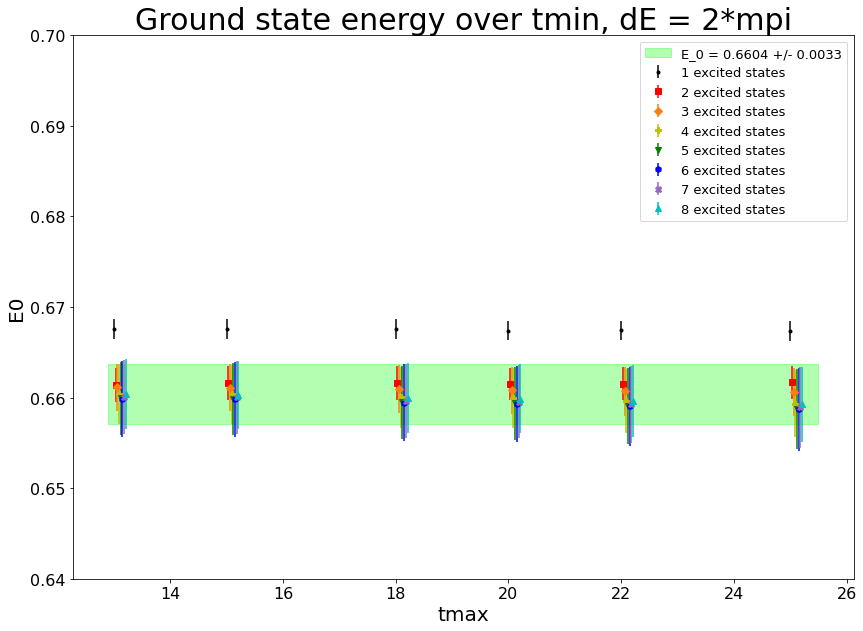

<Figure size 432x288 with 0 Axes>

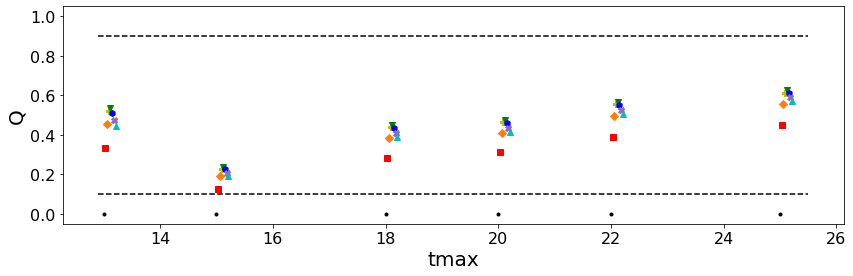

<Figure size 432x288 with 0 Axes>

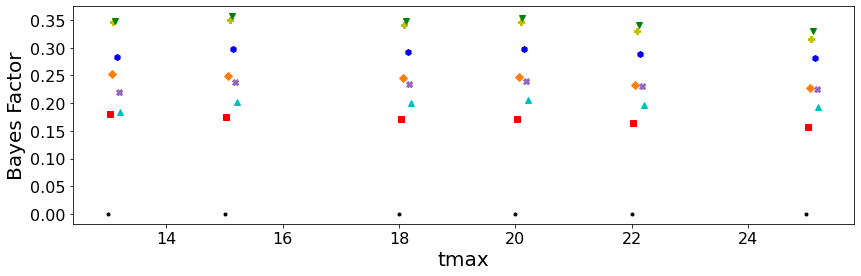

<Figure size 432x288 with 0 Axes>

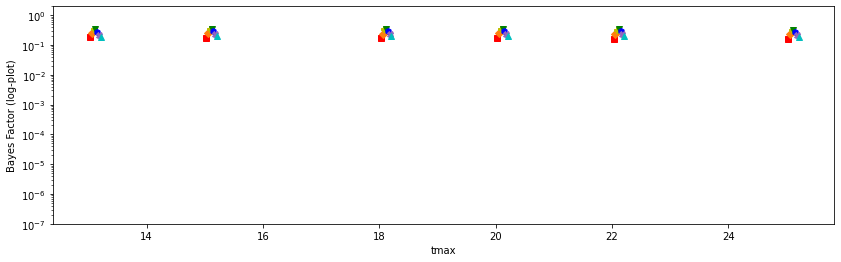

In [88]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a0[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a0[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmax_samp_line, [E0_tmax_bmax_a0[3][0].mean + E0_tmax_bmax_a0[3][0].sdev for i in tmax_samp_line], [E0_tmax_bmax_a0[3][0].mean - E0_tmax_bmax_a0[3][0].sdev  for i in tmax_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmax_bmax_a0[3][0].mean, E0_tmax_bmax_a0[3][0].sdev))
plt.title("Ground state energy over tmin, dE = 2*mpi", fontsize = 30)
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("E0", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize = 13)
fig.savefig("E0_tmax_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Q", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmax_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmax_dEconst_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], '.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.savefig('logBFa0.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

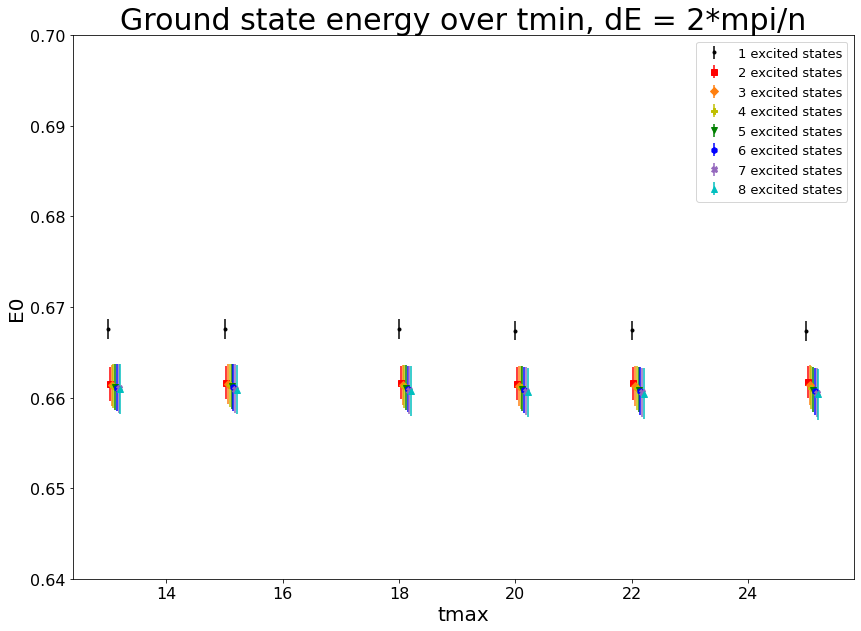

<Figure size 432x288 with 0 Axes>

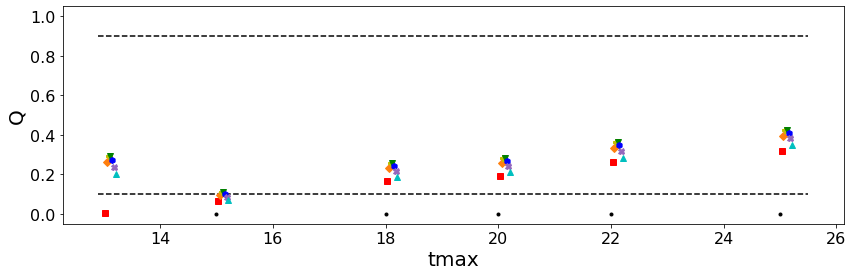

<Figure size 432x288 with 0 Axes>

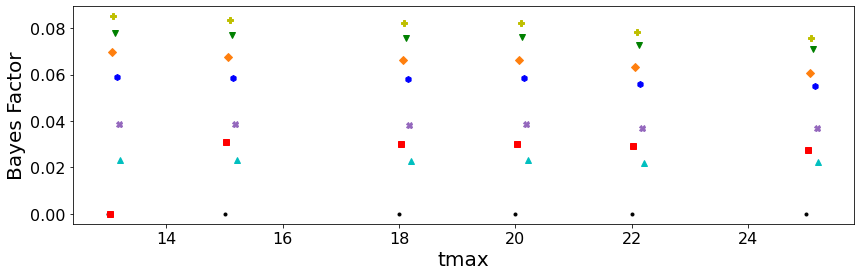

<Figure size 432x288 with 0 Axes>

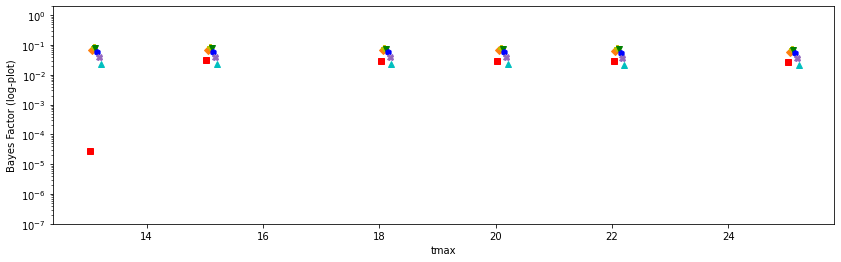

In [89]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a1[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a1[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmin, dE = 2*mpi/n", fontsize = 30)
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("E0", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize = 13)
fig.savefig("E0_tmax_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Q", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmax_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmax_dE1overn_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.savefig('logBFa1.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

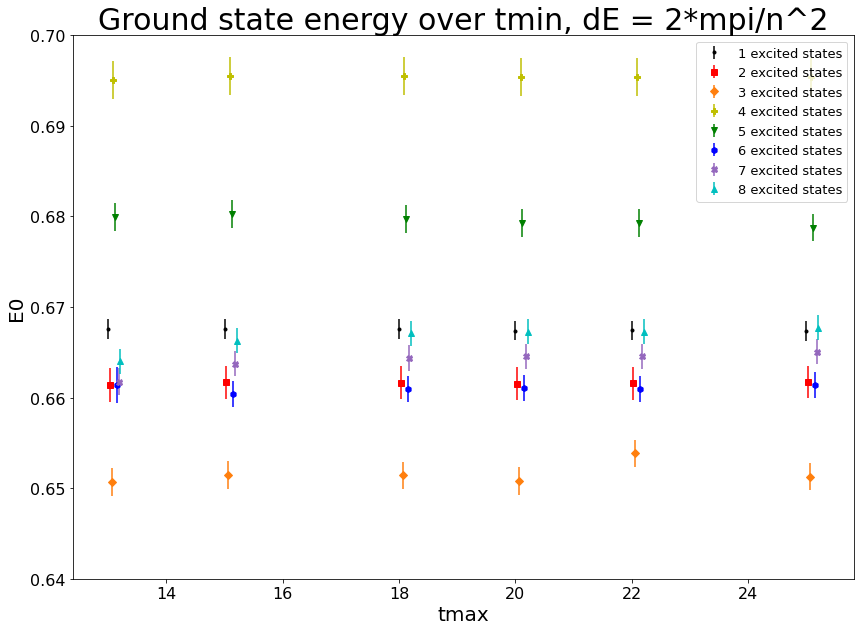

<Figure size 432x288 with 0 Axes>

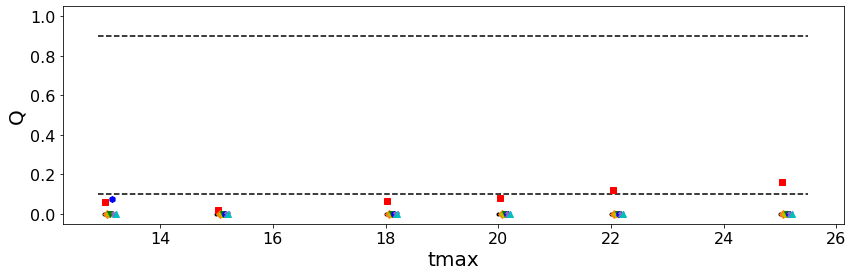

<Figure size 432x288 with 0 Axes>

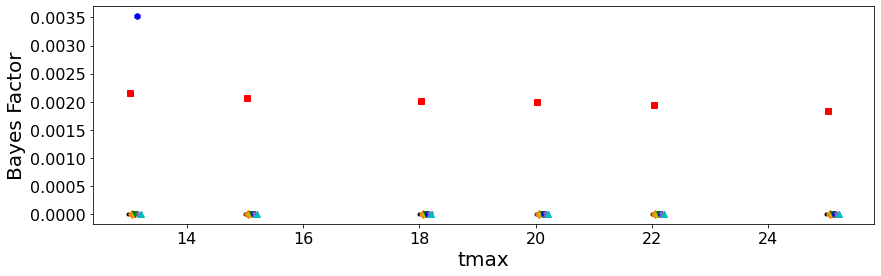

<Figure size 432x288 with 0 Axes>

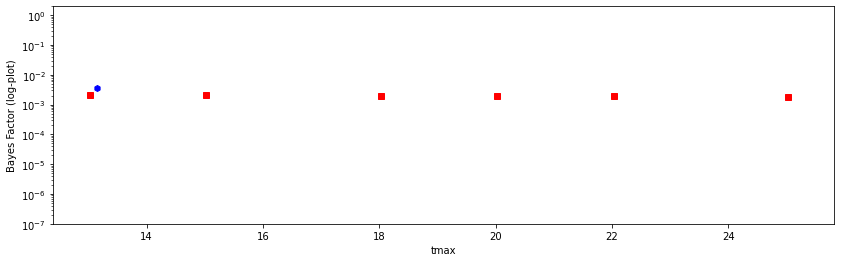

In [90]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(num_states_cap):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a2[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a2[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmin, dE = 2*mpi/n^2", fontsize = 30)
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("E0", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize = 13)
fig.savefig("E0_tmax_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Q", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_tmax_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_tmax_dE1overn2_oldprior_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(num_states_cap):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax")
plt.ylabel("Bayes Factor (log-plot)")
plt.ylim(1e-7, 2)
plt.savefig('logBFa2.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])